# IMPORT NECESSARY LIBRARIES

In [2]:
import pandas as pd
import numpy as np
from itertools import combinations

# READ LEGITIMATE_USER DATA WITH SOME SPECIFIC COLUMNS

In [6]:
legit_data = pd.read_csv("tweets.csv", usecols=[3,6,8])

C:\Users\HP\AppData\Local\Temp\ipykernel_12048\470999462.py:1: DtypeWarning: Columns (3,6,8) have mixed types. Specify dtype option on import or set low_memory=False.
  legit_data = pd.read_csv("tweets.csv", usecols=[3,6,8])


# STORE THE MODIFIED DATA INTO ANOTHER FILE

In [7]:
legit_data

,678033,0.1,593932168524533760
0,678033,0,0
1,678033,0,0
2,678033,0,0
3,678033,0,0
4,678033,0,0
...,...,...,...
9827735,147900782,0,582446466494414848
9827736,147900782,0,582444592366153728
9827737,147900782,0,0
9827738,147900782,0,0


In [8]:
legit_data.to_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/legit_b3_type", header=['user_id', 'in_reply_to_user_id', 'retweeted_status_id'])
data = pd.read_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/legit_b3_type", usecols = ["user_id", "in_reply_to_user_id", "retweeted_status_id"])
print(data.head())

  user_id in_reply_to_user_id retweeted_status_id
0  678033                   0                   0
1  678033                   0                   0
2  678033                   0                   0
3  678033                   0                   0
4  678033                   0                   0


In [14]:
data.shape

(8263129, 3)

# REPLACE THE NON-NUMERIC DATA WITH NaN

In [9]:
for i in data.columns:
    data[i] = pd.to_numeric(data[i], errors='coerce')

In [10]:
data.to_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/legit_b3_type")
data = data.dropna()

In [11]:
print(data.head())

    user_id  in_reply_to_user_id  retweeted_status_id
0  678033.0                  0.0                  0.0
1  678033.0                  0.0                  0.0
2  678033.0                  0.0                  0.0
3  678033.0                  0.0                  0.0
4  678033.0                  0.0                  0.0


In [13]:
data.shape

(8263129, 3)

# GROUPING OF SAME USER_ID

In [15]:
unique_user = data['user_id'].nunique()
print("Number of unique user :", unique_user)
user_group = data.groupby(['user_id'])


Number of unique user : 3418


# CREATE LIST TO STORE THE GENERATED DNA SEQUENCE

In [16]:
generated_sequence = []
dna_seq_arr = []
user_id_arr = data['user_id'].unique()

# GENERATING DNA SEQUENCE USING B3_TYPE METHOD

In [17]:
for i in range(0,unique_user):
    seq = ""
    curr_user_grp = user_group.get_group(user_id_arr[i])
    for value in curr_user_grp.itertuples():
       # print(value.user_id)
        if value.in_reply_to_user_id != 0.0:
            seq = seq + "C"
        elif value.retweeted_status_id != 0.0:
            seq = seq + "T"
        else:
            seq = seq + "A"
    print("user_id : ", value.user_id)
    print(seq)
    print("*********Next Sequence**********")
    dna_seq_arr.append((user_id_arr[i], seq))
    #generated_sequence.append(seq)

user_id :  678033.0
AAAAATTCTCCCACCATCTAAACAAAACCTTATTTCTATAATATCCCCCCCACCCAAAACCACCCCCTACCACTAAACACCTTACCCCCCCCACCCTCCCCCCCCCCCCTCCATTCCTCCCATTAAAATAAAAATACCCCCCTAAATCAATCCCCAACCCCAACATAACATCTTTTCCTAATACCTAATAAAAAAAAAAAAAAAAAAAAAAAACTCTAAAACAAAAAATATATACAAATTATCTCCTTATAATTTACATCTTCCCCATTACACTACCCCCTACTCTCTACCCCACCCCTCTTTTTTATATTAACAAACCAAATTTTCTTTACTAACTTACATCATTAACAAATTTTAAAAAACCCCAACCAACCCCCCCCCCCTCTCCTCACTCTCCAATCCACAAACCATCACAAATTTTTTCCTACTTATCTTATTCTACCAAAACAAAAAAAAAACCCCATATTATTTTAATTAAACCACAATCCTCCAAAAATTTTCCCCCCCCAATCCCCAAAACTACCCACACCAAAAACCCCCAAAAAAAAAAAAAACACAAAATTAAAAATCCAAAACCCCAAACATTACCCCAACCCCAAATAAAAACCATTTTAAACACTACACACACACAATAAACCCCCCCCCTCCCCCTACACCCATAAATAAACCCCTTATATTTTTTCTTAACTTATACATTCTACAACTAAACAATATAATACCCCCCTTTTTTTTTAATCCACTATATTTCCCCCCCCCCCCCCCCCCCCCCCCCTAAAAAAAATACAATTACTTAATTTTTTTTTTTATAAATCTACTTTAATACTAAATCTCCATTCAATATAACACCAACATAAAATAATCTACCAATACTCTAAAATTTCATAAATTTATTTAATTCTATAATTTAAACTAACCCAAAATTTCAAAACAAAATTTACTATCTATTTTTTTCCCCCCACAACCCCCCCCCATTTTAATCT

user_id :  1382561.0
AACACAAAAAACACCTCATATAACCAACTATCAACCCCCCCAATAAAAACAAAAAAAAAATCAAAACCCACACAATATTTCAAACCCCCCAACCAACCAAAAAAAACCAAAAAAAATCTACTAAAACTATAAACAAAACTAAAAAATCCTAATAAAAAAAAAAAACTAAAAATTCTTTACAACTCAACCTTTAAAATAACCACCCCCTACAAATAAAAAAAAAAAAAAACCATCTCAAATAACCCAAAAAAAAAAAACCCTACAACCACAACAAAAAAAATTCCAACAACCACAACCACAACTACAAAAAAAAAAATACCCCCCCACTTTCCAAAATACAAAACCAAAACCTATCTTAAATCTTAATAAACACCCAATAATCTCTACTAATTCACCTACTTAACACTTAAAAACTTTTCCAACTTATAACAATAAACCTTCCCCCCCCTCCACCCACAACCCCTATCAACACCCATACTCTCTCAACAAAATCAAAAATTTCCCCAAAAATCTCCCAAAACCAACAACATCCCCCCAACAACCCCCCCCAACTTTCCAAAAAAAAAATTTTCATACTCAAAACACCTCACCCAACCCTATACAAAAAAAACAAACTACCTAAACTAAACAACAATACTTATACTATACAACCAAAACACCCAAAAAACCCCCTTTTTAAAAAAAAACTCTCCCCCCCAATCATTCTCCCCCCCAACATAATTATACCCCCCCCCACAACCCCTACTCCAACCATTCCCCCCTTCCAACAATTCCCCCCATCCAAAACAAAAAACAAAAAATTCTTAAAAAATATAATCCCACACCTTTTTTACCAACCCCAAAAAACACACAAACTATACAATTAAACCCAAACCCCCACAACTCCTACCCACTCCCCCTCCCCTCACCCCTACCAACCCTACCCCCCATTCACCAAACCCACCCCACCATACAATAAAAATACTTTAAATTAAACTAA

user_id :  5812422.0
ACTCCCCATACATCACAAAAATATTAAAATACCACAATAAAAATTAACTAAAATATAAATATAATACTAAAATCACAATTCAATTACAACCAATATAAAATCAACTCCCTCACTCTTAAATTTCCAACATCCAACATTACCCCCCCTAACTCCCACCCCTTCCCTATCTACACACATCAACCTCTCCAATCCATCACAACCCCCCCCCCCCCCCCCCCCTCCCTACACTTCCTTTATCAATCTTCCCCACTTTTCACCCCACACCCAACCTCACTAAACCACCTCCCTCTCAATTCATTAACAAAAATATTTTATTCCTCATTCTACCCTTAATCACATACACCTTCTCCCTCTAAACCCTCTCAAATAAAACCCACAAAACCCAACATATCTCCACTCCACATCAAAACATACAACCAATCCCCACACAACACACCCCACAAAACATTCCCAATCTATCTTCAACCTCAAAAACCCCACAAAAAATTAAACATAACCCACCCCCCACACAATCACCTCTCCCCATACCATTTTAAATCCTAACCCTAACCTACCTATAACTTCCCAACCACAATCTAATCTATCACAAAAAAAATTCTCCCCCCCCCACCCCTTCCCCAAACTACTCAACTTCATTAAACCAAACCCTTCCCTACAAACACAATTTATAAAATTACCCAACTTAAAACCTACCTCTCACTATCCTAATCTCTAAAAAACAATCCATCTATAAAAAAAAAAAACCCATACTTCTCCCTTACCCAATTTAACAACTCTTCCTTCCTATCCCCAAACACACTCAATCCCCACTCTTTTCACATCCACAAAATCAACCTAATCTCCCTCCCATCCTCCTTTCTAACCCCCCCCCATCTCCCCACCCAACTCCCCTTCCTTCCACCCCTTTTTTTTACCCCCCCCCCCCCCTTCATTTTAATTTCTCCCCCCTTTCCCCTCTCCCAATCTCCCACTCCCCCCA

user_id :  1670962238.0
CCACCAACAACCACCCACCCACCAACACAACAACCCACACCCCCACACCCACACCCCACCAACAACACACCCACACAACCCCCACACACCCCCACCACACCCAACACCCACCACCCCCCCAAACCCCCCCAACACCCAACAAAAACAACACAAAAAAACCAAACCCAAAAAAAACCACCAAACCCAAACAAAAAAACACCACCAACACCCAAAACCCCCCCCAACAACACCCAACACCAACCCCCCCAAAACCCCCCCCCCCCCCAACCCCAACCCCACACCCCCCCACCCCACACCACACCACCCCCCAAACCCCCACCCCCCCCCCCCCAAAACACAACACCCCAAAAAACAAACACCCAAAACCCACCCACACAAACCCCCCACCCCCACCAAAACCCCCCAACAAACCCCACCCAAACAACCCACCCACCCCACCAACCACAACACAAACCCCAAACCACCCCCCCAACCCAAAACAACCCCCCAACCCCCCCAAAAAACCCCAAACCCACCCACAACCACCAACACCACCACACAACCCCCCCCCCAACCCACCACCCCCCAACCCCAACCCACCCCCACACAAAAAAAAAAAAAACCCACCCACCCCCCCCCTCCACACCACAACAAACCACCCCACAAACAAACACCCACCCCCACCCCAACCCCCCAAAAACACCACACCCACCCCCCCCCCCCCCACACAACCCCAAACAACACCCCCCCCCAAACAACACCCCAACCCAACCCCCAAACCCCCCCACCCACAAAAAAAAACCCCCCCCCCCCCCCCCCCACCAACAAAAAAACCCACCAACCCCAACCCCCACCACACCCACCCCAACCCCCAAACCCCCCACCAAAACCCCAAACCCCCCAAACCCCCCCCCTCACAAAACAAACCCAACCAACAAAAAAACACCCCCCCCCCAACCAAAACCCAACCAACCCACCCAACAACACAAACCAAACC

user_id :  151855545.0
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACACACCACACCACACCACACCACCAAAAAAAACCACACCCACCACACACACAAAACAATAAAAAACACAAAAAAAAACCAACACACCACCCAACCCACCACCACCACAAAAAAAACACACACACACCACACCAACCAACCCACACACACACCAACCACCCCACACCACACCACCACACACCACCCACCACCACACACCACACAAACCACACCCACCACACCACCCACCACCACCCACCACCCACCACCACCACCCACCACCCACCACCACCACCCACCACCACCACCCACCACCACCCACCACCCACAAACACCAACACACCACCAAACACCACCACAACCACACACCACCACACACCACACCACCCACCACCAACACCACACCCACCACCACCCACCACCACCACCCACCACCACCCACCACACAAACACCACCCACACCACCACACCACACCACCACCCACCACCACCACACCCACCACCACCAAAAAAAAAAAAAAAAAACCACAAAAAAAACACCACCACCAACACCCACACACACCAAAAAAAAAAAACCACCACCCACCACCACCAACCACCACCACCCACCACACACCCACCACCACACAAAAAAAAAAAAAAAAAAAAAAACACACACACCACCACACCACCACCACCACAAACACCACCACCACCACCCAACCACCCACCACCACACCACCACACCACCACCACCACCACCACCAAAAAAAAAAAACACCACCACACACCACACCACCACACCACCCACACCACCACCACCACCCACCACACACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACACCACCAACCCACCACACCCACCACCACACCACACACACACACACCACACCACCAAACACCAACCACCACCACACCACCCACCACCAAAAAAATAAAAAAAACCACACACCCAC

user_id :  152232092.0
AACAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAACAACACCTCTACCTCTAACTAAAAAATAAAAAAAAACAAAAAAATAAAAAAAAAAAAAAACCCCCCCAAAAAAAAAACAAAAAAAAAAAACAAAACAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAACACAAAAAAAACAAAAAAAAAAAACCAAAAAAAAAAAACACTCACCCACCAATAAAAACCAACACAAAACTCCCCCCCCACCAAAAAAAAAAAAAAAACACCAAAAATTAAACCCAAAATCCAAAAAAAACACAAAAAAAAACAACAACCACCCACACAAAAAAAAAAAATTCAACCACCCCCCCCACCAAAAAAAAATAAAAAAAACAAACACCAAAAAACACAATAAAAAAAAAAAATATCCCACCCCCCAATAAAAAATCTAACCTATCCAAAAATTAAAAAAAAAAAAAAATAACAAAACCAACACCACCCCCAAAAAACAATACACAAAAAAAAAAAACAAAAAAAAACAAAACAAAATTAAACACCCCAATATTCTTATTTTTTTTTTTTTTTTCTCCCTCCACCCCCTTTAAACATCACAAAAAACAAAAAAACAAACAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAACAAAAAACCAAAAAAAAAAAACAAAAAAACACCAAAAAAAAAAAAAAAAAAATAAACAACAAAAAAAAAAAACAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAACCAAACACAAAACAACCAAAAACAAAAAAAAACAATCCCCCCCCCCCCCCCCCACCCCCCCCCAAACAAACCCCCCAACAAACAAAAACAAAAAAAAAAAAAAAAAAAAAACACCACCAAACAAAAAAAAAAAAAACAAAAAAAAAAACAAAAAAAACCAAAAAAAAAAAACACAAAAATAAAAAAAAAAAAAAAAAACAAAAACAAAAAAAACAAA

user_id :  11174562.0
ACACACCAACCCCAAAAACAACTATTACAACAACCATTAATACACCCCCCCACCAACCCCAATCCTAACATCCCCAACCCACAAATCACCCCCCAAAAAAACACCCAAACAAATAAACCCCCCCAAAACACAAACCCCCAACACAAATCCCACCACCATACACCCATAAAACAATAAAAAACCACCCCCATAAACCCAAAAAAAAAAAACCAAAACCAAATCCAAAACCAAAAACCAAAAAAAAAAAACAAAAAAAAATCCCACCCCCCCCCCAAAAAAACAAAAAAAAACCCACCAACAAAAAAAAAAACAAAAAAAAACACCCACCCCCCCCCCCCCCACCACCCCCCCCCCCCCCCCAAACCACCAAAAACACAACTAAAAAAACCAATAAAAATCACACACCAAAAAAAAAACACAAAAAAAATACAAAACAAAAAAAACAAAAAAAAACTAAAAAAAAAACCCAAAAAAACAAAAAAAAAAATAAATAAAAAAAACAAAAAAAAATATAAAAAAAAAAAACCAAAAAAAACAAAAAAACAAAAATAACCAAAAAAAAAAACAAAACAAAATAAACCAAAACCCACCCAAAACACAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAACAAAAAAAAACAACAACAAAAATAAATAAAAACAAAAACCCAAACCAAAATAAAAAAAAAAAAAAAAAAAAACAAAATCCAACCAAAAAAATAAAAAAAAAAAAAAAAAAAACAACCCCTTCAAAAAAAACCAAAACAACCCAAAAAAAAAAACATCCAAAACAAAAACCATAACACAAAAACACCAAAAAACATCAAAAAAACAAAAACAAACCCCAAAAAAAAATCACAACAAAACAAAAAAAAAAAAAAAAAAAAACAAAAAAACACCCAAACAAAAAAAAAAAAAAATAAAAAACAAAAAAAAAAAACATTACAAAAAAAAAAACAAAAAACAACACCACCAA

user_id :  12922462.0
ATTATTTTTATCCACTATAATTTTCTCCACATCTTTTTCCACTCTTCCTTTTTTTACTCATTTTTTTCTATTTAAACATTAAAAAATCCCATTTTTCATTACCCAACCCCTTCACTCCCCCCCCTTCCCCTCCTTCTCCATCCCATATTCCTTATTCAATCTAATTTTATTCATCTTTATTCTCACCCCCCTCTTTACAACTAATCCAAACCCCCATTTTTTTTATTCCCATTCCAACCCTTTTTTCTACTCTCCACCCCCTTCCCCAATTTATTTTCTCACCCCCAATCCACCCCCCTCCCCTTTTTTCCCTATTTTTCCCAATCCCACTTCTTTACCTCATCCCCTCTTTTTTACCTACACTTCTCCCTCCCCACCCCATATAACTACTTCATTCTCCCCCCCTTTTTTATATCTTTTTTTTTCCCCCTATTTCCCCCCCACCCCCCCCCCCCCCCCCCCCCCCCCCACCCCCATCCACCCTTCTTTTATTTTCTTTTTTTTTCTTTTCCCTTTACCACCTTCCCAACTTATATTCACATTCTTTTTTTCCCAAACTTAATCACACCCCCCAATCATCATTAATATCCACCCATTTCCATTCTTATTTCACCCTCATTTAAATACACCCATCCTTAACCTCCCCCCTAATATATTTATATTACTTATTTTTTTCCCCACCTTATATTTACACCAATCACCTTTCCTTATTTATATTTCAATTTCTTTCACTTTATTTCCTACCTCCATTAATCTATTCCCATCCTTCTACTTTTCCCATACTCACTTTTTCCCATTCAAATTAATTTCCCCTCAAATTATCATAATTTCCATTTTTTTTATACCTTCATAAAATAAATTACACCCTTCAAAAAATCCTCCATCCCCCCATCAAAAACTATCTCCCCCCCTTCTTTAACTTTTCCCATAACTTTCTCTTCCCCATCTCTTCCTTTTTCAATTATTCCTCTTCCCTTT

user_id :  157683018.0
AACCAATTTTTTCATTACAAAAACAATTAAAACACTCAAACCAAAAATAAATTAAAAAAAAAATTATTTAAAACAATTTTTTTTTTCTTTAAAAAATAAATACACCAAAATTAAAACCACTTTTTAAAAAAAAAAAAAAAAAATTTTTTTAAAAAAAAAAAAAAAAAAAAAAAAAAAATTTTTTTTAAAAATAAATTAAAACCCACTCCACAAAAAAAACCCCCCCCCCCCAAAAAACCCACCACTACCCCACCTCAAAATTAAAATACCCCCTTTTTACCAAACAAAAAAAATTAAAAAAAAAATTAATTATAACTTTATTTCACAAATTTTTTTAAAAATTTTTTATTTTTCTAATTTTTAACCCTCACCAAAAAAATAATCATAAAAAAAATTTTTTTATTTTTTTTTTTTTTTTTTTTTTTTTAAATAAATCCACCCCCACAAAAATTTAATATATAAAAAAAAAACTCTTTTTCTTTTTTTTTTTCCTTTTTAAATATTTTTTTTTTTTTTTTTTTTTTTCTTTATTTTTTTAAAATACTTTCACAACCCCCTTCCCCCCCCCTATAATTTTTTTTAAACCCCCAACCAACCCCCACCCTTCCCTTTTTTCCTCCTACACAAATTTTATTCCCCCCTTTTTTACCACCCCCAAAAAAAAAAAATAACCTTTTTTTTTTTTTTAATTATTTCCCTTTCCCACATTTTTTTATTCTACTTTTTTTTTTTTTTTTTTTTTCCCAACTTAAAAAAACCCACCCCCCCAAACCACCCCCCAACAAAAAACAAAAAAATATTAAATCTCCCCTCCCAACCCCTAAAAAAAAAAAAAACAACCTTCTCCTCTTTCCACCCCCCCCCACCACCCCCCCACCCACCATTTAAATATTTCTTTTTTTTTTTTTATAAAAATAAAAAATCATTTTTTCCTACCCCCACACAACCAACCCCCCCCCTCCCCACAATCCTTAAAA

user_id :  493739792.0
TTTTATTATTAAAATTTTCCCAAATAATTATTTTTTACATACCCAATTTTTATCTAATAAAATTTTTATTACTTTATTACTAATCCTAAATATATATTAATTTAATAATAAAAATATTAAATACCCCAATATTCAAAAATTCATCACTAACTATAAATACATAAAACCAAACCACACCCAACATCATTAAAAACCTTTCTTAAAATCAATTATTTACCCTCTATTTCCAAAAAACCACATTCAATAAACATTTACACACCCTCAAATAAATTAATATATAAATACATTATTTATAATAATTACACATCTAATTATTTTATTAATATCTAAAATAATTAAAAATAAAAAATCAAATAAACAACAATATAAATAACACCCCCCCACCTAATAAATACTCACAACCCATTTTTTATATTTAAAAACTTTTTAAATATTTTATATTAATTTTAAAATAATATTACTAATTTTCTTATCCCTAATTAAATACTAACTTTAATTTTAACAAAATCAAATCAATAAATTTAACTAATTTTTAATTAATTATAAAAAAAACAATAACAAAACCACCACTAAAAAAATACATAAAAACTACACAAAAAAATACAAATAAATTAATAAATAAAAATTACCAAAAATCAATTACAAAAACAAAAATCATATAAACATTAACAAAAAAATTTATAAAAAAATATTTAAAAAAAAAATATTCATTAATACATTAATTTAAACACTCAAATTCACAATTAAATTTTAATATTTTAATAACATTAAAAATTCACTTTTATTATTATAAATACAACATTAATAAACAAAAATCTACTCCATATTAAAATAAATTAAAAACCCACCATCATTATTAATAAAATTTACAAATATTTTATACAAATAAACACACAAAAAATCTAATAACAATAAATAATAAAAACAAATATAAAAAATAAACAATAACAAAATAAACAAAAAATTTAAAAAAATTA

user_id :  14391111.0
AAAAAAAAAAAAAAAAAAAAAAAAAACACCAAAAAAAAAAAAACACCAAAAAAAAAAAAAATAAATAAAAAAAATCAAAAAAAAAAAAATTAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAATTAAAAAAAAAAAAAAAAAAAAAAACCACTCCAAAAAAAAAAAAAAAAAAAAAAACAACAAAAAAAAAAATAACAAAAAAAAATAAAAAATAATAAAAACAAAAATAAACAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAACAAAAAAAAAAAACAAAAAAAAAATAACCCAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAACTAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATACTCAAACAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAATAACCAAAAAAAAAAAACTAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAACAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  1852825657.0
AATATTATTTTTTTTTTTTTTTTTCTTATTATCTACTTTTTAAATTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTATCTCCTTTTTTTATTTTTTTCTTAAATAAATTTATTTTAATCCCCAATTTTACCTTTTCCAACCCTATTTTATCCCTTTATTTTCCCATCCCCCCCTAAATTAACATTTTTTAATTTATTTTTTATTTTCCTTTACCTAATTAATTATAAATTTTTTTTTCTTTCTTTTTATCTTTCTTCTTTATCCTATTAATTCTTACTTATATTTTAAATACTTTATTCAATCATAATTTTTAAAATCCCTACTTTTTTTTAATTTTTTTTTTTTATTTTATTCTATTTTCTACCTTCTTTCTCACTATACTAAAACATTTTTATTTTTTTTTCTTCCTATTCCTAAATAAAAAATATTTTTATTTTTTTTCTTTAATATTATCTTATATTCTCTATTTCCCTAACCTTTAAATCTTTTTCTTCTCTCCTTTTTTTTTTTTATCTCTATTTTTTTTATATCCTCTTCTTTCCTTTACCTCCTCTATACTCTTTCTTCTCTTCCATAATTAATCTTATCCCTATCTTTTATTAATTTAATTTATTATTTTAATTTTAATTTTAAAATATTATTTTTTTTTTTTAATCAAAAATTTTTTTTTTTTTTTATTTTTATAATTCTTTTTTAATTTTTTTATATTTTTTATTTTTTATTTTATTTTATACAAATACTTTTATTTAAATTTTTTTTTCCTTTATCTCTTTTTTATTAAACATTAATAATCCTTTTTTATCTACTAATTATATATTTTAATTTAAATACTCTTTTTTTTTTATTTTATTTTTTTTTTTTTTTTTTATTTTTATACCTTTTTTTTACTTCACTTAAATCCTCTTTCCTCTCTTCATCTTTTTTTTTTTATTTTTTTCTTCTCTCCACTTCTTTTATTTTTATTTTTTCTTTTTATT

user_id :  14716324.0
ACAAAAAAAAAAAAAAACACCCAAAAAAAAACAAAAACACCAAAACCTACCTCCCCAAAAAAAAAACACCACCAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACCAAACCCCCCCACAATAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAACAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACCCAAACAAAAAAAAAAAAAAAAAAAACAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAATATCAAAATTCAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAACACAACACAAAAAAAATAAAAAAAAAAAAAAAAAAAAATAAAATAAAAAAAAAAAAACAAAAAAAACAAAAAAAAAAAAAAATAAAAAAAAATTAAAAAAAAAAAAAAAAAAAAAACAAAAAACACACAAAAAAAAAAAAAAAAAAAAAATAAAAAATAAAAAAAAAAAAAAAAAAACCAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATACCCAAAAAAAAAAACCCACACAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAATTAAAAAAAAAAAAAAAAAAAATTAAAAAATACCCAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAATAAACCCAAAAAAAAAAAAAAAAAAAAAAACTAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACCCAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

*********Next Sequence**********
user_id :  505959713.0
ACCCAACCTCCAAATTTTCTAAACAAAACCCAACCCCCCAAAAAATCAACCTCCCCCCCACCCCCCATTTTTCCAAAATTAAATCAACTCCCTCCCCTCCCCCCCCCAACAAACAAAACAAAAAAAACAACAAAAAAATTTTTAAAAAAAAATCAATTTTTTCCCTTATATTTTTTTTATAACTATTTTTTTTTTTATTAAAATTCTCCCTCTCTCTCTTTCCTTTTTTATTTTTTTTTTATTTTTTTTTTTTTTAATTTTTTTTTTTTTTTTTTTTTTATAAATTTTTATTTAATCTTATATTTTTTTTCTTTTTTTTTAAAAAATTTTTTTTTTTCTTTTTTAAATAAAAAAAAATTACTCCAAATTTTATTTTTTTTTTTTTTTTTTTTCCAAAAAAAAAAAAAAAAAAAAAAAAAATCAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACCCCAAACAAAAAAAAAAAAAAAAACAAACCAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACCCTTTCAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACCCAAAAAAAACCCCAAAAAAAAAAAAAAAAAAAAAAAAACCCAAAAAAAATTCAAAACCAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  1888349131.0
TCCCTAAAACCATTCCCCCCCCAACCCCCCCCCCCTTCCCCCCCCCCCCCCTTCCACCCCCCCTCCCCCCCCCCCATACCCACATTTTTTTCCATCTCCTCCCCCTCAATAACTCTTCCCCCCCACCCCCAACCCCATCATTTTTTTTTCCCTTTTTTATCTCACACTCCTTCTAACAAAAACCACTACTTCCCCATAACCCAACTATCCCCATTTTTTCACATCCACCCTCCCCCTCCACATTATTTTATCCACCCCCCCCCTACTCCTCACCAACCCAACCCAAAACCTCCTCTCCCAACCCCCCATCCCACACCCTTCCTCACCACCCCACCACCCAATCTCAAACCCTTAACTCCCATCTTCCCCCCCCCCCCCAAATCCCTATCCCTTCTACAACCACCCTCCCCCCCCACCCCTCCCAATTTTCCACCCCCCCCAAAAAAAACCATAAACCACCCCCCACCCCCCCCCCCCCCCACCCCCCTCAACAACCCAACCCCTACCTACTTCATCCTTTTTTAATACTCATCCCCCCCACTCCATCCAATTATCCCCTCTATTACCTACCCCCCCCCAACACTTTCCACTCCACCCTTATACCCATTCCCCCCCACTTCCCCCCCACTCACTCCCAACTACCCCCCCCCCCCCCCCCCCCCCCCCCCCAACCCCCCAACACACCCCCCATCCACCACCACATTCCTCTCCCCCCTCCCCAAAACCCATCCATAAACATCCCCCCCCTATCTTCCCCTAAACCACTCCTCACATTCACCCTCCCCCCCCCCCCCCTCAACCTCACCCCCACCCCCCCTCCTCCCCCCCCCCCCCCACCCCTTTCCCCCTCTCCCTCCCCACCCACCCATAACCCACCCCATCCTCCCCCCCCCCCCTCCCACCCCCCACCCCTTCCCCCCTTACCTACCACCACACAAAATCCCAACAACCATACCACCCAAACACTTTCCCATTC

user_id :  1894751762.0
TAAATTTTATATAAAAATCTTATCAAAAAAATTTAATTTTTAATTAAAAATAATATATAATTCTAATTAATTATTTTAAATTCCAAATTAAAATTTCCAATTTTATCAACTTAAAATAAATTCACACTTTTTATTTAAAAAAAAATTTTTTATTTATTTTATTAAAATAAATAAATTTATATTTTAAAAATTTTCTAAATATAACCATTTTTTCTTTTAACTATATTTCTAAAAATTTTTTTTTAAATTTAAAATTAATAATTATTTTTCAATTTTTTTCACCTTTCATTTTTAATAAATACTTATTTTAAAATTCATTTAAAATTTTACCCATTATCCCTATCATTTTCCTTAAAATATTTTATTTTATATATATCATAATTTACCTTTATTTAACTAAAAATTTTATTTTTTACACAATTTTAAAATAATCTACATTTTTTTTTAATTTAATTATAAAAAATAAAAAATTTAATATAATTTAAAATTAACATCACAAATATCCCACTTCTAAAATTCACAAATAATTTTTCTTATAAAAATTTTATAAAACTTTTAATAAATTTTCCATTACATTTAACTCTCTTTTTTCTATAAATAAACTAAAACATATATAATATTCATTATAATTTTAAAAAAAATTTTATTAATTAAAAACTAACATTCTCTATACTAATAATCTTTTTTATTATTTTTTAATTAATTATTCAATTTATTTAAAAATATATCCCCCAAATTTAAAATTTTTTTTTTTTCTTTTTTTTTTTTTTATAATATATAATAAATTTTTTTTATTTTCTCACTATTTATTTAATATTTTTAATTTAAAATTTTTCAAATTAAAATAAAAACAAATAACCCCCATTTTTTTTTATTATAAATCTATTTAAAAAAATTTTTACTAAAATCCTAATATTTAATTAATAAACCAAAATTATTAATCCAATACTCAACCATTATAAACTTCCAAAAATAA

user_id :  169476725.0
CCTCTTAATTTTATATCCTTTCTTCCCCCCAACCTTTTACTACCCCCCTAACCAATTTACAACCCTTACCCCACCACCTCTTCTACACCACCTCCCAACCTTCAATTCCCCCCCTTACTCATCCTTTTCCACAATCTTCTCCTCATATCTATTATATTCTTTCTCCCCCCCTCCTCCCTCCCCTTCCCCCCCCCCCCCCAACCACTCCATCCCCCACACCTCATCCCCTACCTCCCCTATCTCATTTTAATTTTTTATCACCCCCCATCAATCACCCTCCCCCCCACTACCCCTTCCCCTTTTCCCTTTTCTCCCACCTCCCCTACCTCACATCCCCCCCCCCTTAACCCCACCTCCACCCACTCCCCCCCCCCCCTCACCCCCTACCCCCTCCCCCCTCCCCCCCACCACCCCTTCTTTTCCCCCTCCCCCCCCCCCCTCCACATCCCCCCCCACACCTCCCCCCTTCCACCCACCCTCCTTCCCTCCCCCCCACACTACCCCCAACCTCTCCCCTTCACCCCCCCCACCCCCACCCCCCACCCACCTACCCAAAACCTTCCCCCCCACCTCCCCATTCTCCCTTCCTCTCTCCACCCTCCCCTTTCCCCCACCACCTTCCCCAACTTTACCCATTTTCCCAATCTCTCCCTACATTCCTCTACCCACATACACAACACTATCCCCAACCCTCCACCCCCCCCTTCTTTTTCCCCCTTATCTCCCTCCCCCCCCCCCCCCCACCCTTCCCTCCCCTCTTCCCCCCCCCCCCCCTTCTTTCCACTCCATCCCTTCCCTTACCAATTTTTTAACCCTTCTTTACCCCCCAAACCCACCTCCCCCATATCCCCTTCACCCCCACATCCACATACAACTCACCCCCCCCCCCCTCCCTCCCCATCCAACCCCAACTACATCCACCACCCCCTCCATCCACAACCCCTTCCCTCCTCCACCAACCCCCACCCATCCACAAC

user_id :  1926394171.0
AAAAAAAAATATTAAAAAAAAAAAAATAAAACTAAAAACAAATTCCCCAAAAAAAAACACTAACCACATCACTCATTTAAATACAAAATAACTAAAAAAAAAAATAACCAAAAACAAACTAACAACATAAATCAATAAAAAAAAAAAAAAAAAACAAATAAACAAACCTATAAAAAATAAACAAACACATAAAAAAAAAAATAAAAAATAAATATAAAACAATTTAAAAAAATTAACAAAAAATTTACTCAAATCAATAAAACAACATATAAAAAAAACTATATTAACTATTAACCCAAACAAAAAAAAAAAATTTATATACTCTAAACTACTCACAAAAACAAAAAAAATATCTACCAACCCCCAAACCCTCCCCCCTTTTCAACCCCCTTAAACCTAAAAAAAAAACAACACATTTCCCCCTACACAAATCACTCACCAAAAAAAAAAAACTAAACATCTTATAAAAAAATAACTTAAAATAAAACAAAAAAATTAATAAAAAAAAAAATAATACCATAAAACTATTCCCAAATAAAAACCACCCCCCACCACTAAAATATCAAATAAATCCCCAAAAAACCAAAATTACCTCCACCTATTCCATTCAAACCACAAATAAAAAACAACCCCCCCACCACCCCAACAACACAAACACCAAAAAAAAATTACACCCCACCTCTAATAAAAAACCCACTCTTTCCTCTTTACTAAACAACTAAAAAAAAAAACTACCCACTCCCTTCCAATAAAAAAAAAAAAAAACCCAAATTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTAACAAAAAAAATTACACCCATAAAATTAAAAAATCCCCCCCCCCAAATATTCCCCCCCACACACCAAATCCTCAACCCAACACCCAAAAAAACACCCAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAATTAAATAAACCACCAATTTTTTTTTCTC

user_id :  174256925.0
AAAACAAAAAACATCATATATAATAAAAACAAAAACCAAAAAAATAAAAAATAAAAAAAAACTAAAAATTTAAAAAAAAAAATAATTTTAATTTTTAAAAATAAAAATAATATTTTAAATCAATAAAATATATTTTTTAAAAAAAAATCTTACTTTATATTTTAATTTTCTTTCAAAATTTTTTTAATAAAAAAATTAAAAAAATTAAAAATTTTAAAAATTTTAACTATTTTAATTAACTTAATATTTTTTTAAAAAAATATATTTAAAAAAAAATTTTTAAATTTTCAATAATTTAATTTTTTTTAAAACATTTATTTTAAAAATTTATTTAAAAATTATTTAATTAAAAAATAATTAACAATATTAATACAAAAAATTAAAATAATTATATAAAATAAAAAAAAATAAAACCCCAAAAATTCTTTTCTAATAAATTAAATTTTAAATTTAATTCTAAACAAAATAAAAAAAAAATTTAAAAATTTTAAATTAAATCCAATAAATTAATAAAAACAAATTAAAAAAAAAATAAATTAAATTTAACTATATTAAACTTAAAAACTTTTTTTAAAAAAAAAAAAATTAAAAAAAAAAAATTATTATTTTTAATTAATTTATTTTTAATTTACTTTACCCTTTTTTTTTTTTCTTTATTAAAAAAATTTTATATAAAATTAAATTTACAAATAAAATTATAAATATTAATCATTTTTTTTATAATTATAATTAAATAAAAAAAAAAATAAAACTATAATAAATTTTTTTTTTTTTAAAAATTCCTATATTCTTAATTATTTTTTATATTCTTATTAAAATATTTATTTTAAATTCCTTACATTAATTTTAAAAAAATAAAAAATAAAAAAAAAAAAAAAATAAATTAAAAAAAATTTTAAAAAAAATTTTTTATTATAAATTAAAATTTTTATTTATTAAATATTATTTTAAAATATTTTTTTTAAATAAATTTTTCA

user_id :  16496132.0
CCCCACCCCACCACACACCCACCCCCACCACCCCCCCACACAACACCCAACACCCACCCCCCCCCTACCAACCTTCCAATCCCATCCCACACCCCCACCTAACCCACAACCCCCCCCCCACCACCTAAACAACCCCACAACCCCACCACAAACACTAAACAAAAACACACCCCCCCCAACCCCCCCCCAAAACCCCACCACCCTCCCCCCCCCCCCTACCCACCCACCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCAACACCTCCCAACCCCCTCCCAACCAACATCAACCCCCCCCCCCACACACTCCCCAACCCCCCCCCCTCTCCAAAAATCCCACCCAAAACACTCCCACCCCCACAACTAATCTTCCCCCAAAATCCCCACCCCCACCCCCCCCACACCTCCCACCCCCACCTTCCTTCACACATACCCCCCCCCCCCCACAAATCTTAATTATCCCTAAATCCCATACTCCCACTACCCCCCCCCCAACCCCCACACAACCACTAATCCTACCCCCACCCCCAACCACACCCCACCCACTCCCACCACCAATAAACCCCACCCACCCCCCACCCATCACCCCAACACACCCACCACTCCCACACCCACCCACCCCCCAACAAAAAAACCCCACACCCCCTCTAACCCCCCCACCCACCACACCCACCCCCCAAACCCACCCACCACCCAAACCACCCCACAAACACCCCTACAACTCCCCACCCCCCACCCCCCCCCCCCACCCCCCCCCCCCCCCCCACCCCCCACCCCTTCCCCAACCCCAACCCTCAAACCCACCAACCCCACACACCCACCACACCCCTAATACCCTCCTACCCCCCCCCCAAAACCACCCTCACCACCCACCCCCCACCCAATCAATCCAACACCCACCACCTAAATCCCCCACAACAAACTCCCCAACCTACCCCCAACTCCCTCCCCCCCCCCACACCCATA

user_id :  176688197.0
AAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAACAAACAAAAAATAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACACAAAAAACTTCAAAAAAAAAAAAAAATAACAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAATAAAAAAAACAAAACAAACAACAAAAAAAAACAACACAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAATAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAACAAAACAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAACAAAAAAAACAAAAAAAAAAATACAAAAAAAAAAAAAAAACAAAAAAAAAAAACAAAAAAAAAAACACTAAACAAAAAAAACAAAAAAAACAAAAAAAAAAAACAAAAAACATAACAAAAAAAAACAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAACAACAAAAAAAAAAAAAAAAAAAAAA

user_id :  1967918335.0
CAATTTATATTTTTAACAATTTTTTTTTTTTTAAATTATTTTTTTTTTATATTTTTATTTATATTTATAATAATATTTTTTTTTTTTCTAAAAATTTATTTTTATTTTTTCTTTTATTTTTTTTATTTTTAATATAAAATTTTTTATTTTAATTATAATTAAAAAAATTTTTTTTTTATAAAATTTTTTTTTTTTTTTTTTTAAAAAACAAATTTAATTTTTATTTTTTTATTACTTACTATTTTTTTTTAATTAAAATTTTTTTTTTTTTTTTTTTTATTTTTTTTTCTTTTTTTTTAATTTTATTTATTTTAAATTTAAAAAACTATTTAAACACCAAAACACCATTCCTTTTTTAAACAAAACCAAATTAAATTTTTACTTTTTTTTTTTTTTTTTTTTTTTAAAAATTCTTTCTATTTTTCTTTTTTTATCAAAACTTTCTTTTTTTTTTAATTTTTTATTTTATTTTTTTTTTTTTAAATTCTCATTTTTTATTTTCTTTTTAACAATTTTTTTTTTTAATTCCTTTTTTTTTTTTTTTTTTTTAATTTTTTTTTTTTTTTTTTTCTTTTTTTATTCTTTTTTTTTTTCTTTCTTTCATTATTCAACCTACTTCTTTTTTTCCTTTTTTTTTTTTTTTTTTTTCTTTTTTCTTTTTTTTTTTTTTTTTTTTTTTTTTTTCCCCTTTTATTTTTTTTTTTATTTTTCTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTAACCATTATTTTTTTTTTCCATTTTCTATCATTATTTTTTTTATTATTTTTTTTCCCTTTTTTCAATATTATTACAAAAAATTTTTTTCATCTTTTTATTTTCTTTTTTTATTTTCTTTAAATTTTTAATTTTCCTTTTTTTTTATTTTTTATATTTTTTTTCTTTTTTTTTTTTCTATTTTATACTATATTTTTTTCTTCATTATATTTTTTATTATT

user_id :  1978992043.0
TAATTCCCCCCCATTTCATCCCCCCCCAACTTATCTCCCCCCCCCCCTAAAACCCATAAAAAAAAAAAACCCCATTTAAATTTATACTTCCCCTCCCACCCACATTCTCCCCCCCCCAAAACTATTTTTCAAAATATCTCCTCACCCCCTCCCCCCCCCCAAATCCCCCAACCAATTACCCCCCCCACCCCCACCCACCCCACAAATCAACCCCTACCCCTCCTCCCTTCCCCCCCTTTTTCCACTCCCTCCCTCCCTATCTCCTCTCCCCACCCCCTCCCCAAAATCCCCATTCCATCCCCCCCCCACCCTACAAAAAAAACTCTACTTACCACCCCTTTCACTCATTCTCCCCCCCCCCCCCCCCCCCCCCTCTTTTCCCCCCATTTACATCCCACCCCCACCCACCACCCCCTCAAACCCCCCCCCCCCCCCCTCCCTTTTTCTTTTTTCATAACCCCCCCCACCTCCCCCCCCCCCCCCCTTTTTTCTCCCACCCCCCCCCCTCCCCCCTTATCCCCTACCACCCCCCCACATACCCCCCAAACAACCACCCCAAACCCACCCCCCCTCACCCCCCCCCCCCCAACCACAACCATACCCTCACAACAAACCCCTAAAAAAAAAACCCCCCCCCCCCCCCCTTCACCCCCCTTCCCCTTCCCCCCCCCCCCCACCCCCCCCCTCAAAAAACTTCTTTCCATAATCCCCCTCCCCCCACCCCTCCCCACCCACTCCCCCCTCTTTCTTCAAAAAACCTTTCCTTACCTTTCCCCAAACCTCCCCCATCCCCCCCCCCCATTTCCCCATTTTTTAATCACCCCCCCCTCCCTCCCCCCCCACACCCCCCTTTTCCACCTCCCCACCCTCTCCCCCCCAACAAACCCCCCACCCCCAATTTATTTCCCTCCCCAACCACAACACCACCCCCCACCCCCTCACCTTCACCCCCACACAAACCCCCCATCCCTAAAAA

user_id :  17520304.0
TTTTTTTTTTCTTTTTTTTTTTTTTTTTTTTTATTTTTTTTTTTTTTTCATTTTATTTAAATTTTTTTTTTTATTTTAATTTTTTTTCTATTTTTTTTTAAATTTTTATTTTATTTTACCTTTTTTTTATTACTTTTTTTATTTTCATTTTTTTTTTCTATTTTTTTTTTTTATTTTTTTAAATTAAAAAAAAATAAAATTTTCTATATCAAAAACCTTCATACTACAAAATCATAAACAAATTATATTAATTAAAAAAAAAAAAAAAAAAATAATAAACTAAAAATTATCATATAAATTTTAAAATAAAAAAAAAATAAAATAATTAATAAAAATAAAAAAAATAAACCCAACCATTAATACAACAATTTTTATACACCAAAATAAAAATTCATTTATTTTAACAAATATACATTTATTAATAATTATATTTTTTTTTTATTTTTTAAAAAAAAAATATTTTTAAAAAAATAAAAATTTAAACCAAATAATATATCAATTTTTAAAAAAAAATATTTTAACAATCCCTAACTTTTTAAATTATTAAACCCCATAATAATCCCCCCCCTTTAAAAAAACCTCAAATAAACTAAAAAAAAAAAAAATTAAAAAAATTAAATAATCCCAAATTTTTCTAATAAAAATAATCTTATTTTAAAAAATAATTAAATTAATTCACAAATTACTTAATAATTTTAATAAATAATTTAAAAAAAATAAAAAAATTAAATTCAAAAATATTTTTTTTTTTTTTATTTAAAAAATTTTTTTTTTTATTTTTTTTTATTTATTTATTAAATACAAAATCAATTTATAAATATTATATTCAATAAATTTTTTTAAAATAACCCAAAATCAAATTTTTTCCCTATCACAAACTATATAAAACAATATTATTTTTTTTTAAAAAAATTATTCACAATTTACTCTTTAAAAAATAAAAAAAACAAAATATTTCACCCAAAAATTAACAACAAA

user_id :  185914183.0
ACCCCCCAACACCCAACCCCCCAAAATAAACAAAAAAACCCCCCCCAACAAAAACAAAAAAAAAACCACAACAAAAACAACCCCACCCAACCACACAAACACCAAAAAAAAAAAAAAAAAAAAACCCAACAACAAAACCACACAAAAAACCCAAAAAACCAAAAAAACAAAAAAAAATAACAAAAAACAAACAAAAAAACATTCAACACCCAACCCCCACCCAAATCAAAAAATACCCCCCCAAAAAACAAAAAAAACCCCAAAACAAACAAACAAAAAACAAACAAAAAACCAAACCCACAACAAACACCCCAAAAAAACAACAAAAACAAAACACAAACCAAAAAAAAACAAAAACCACAAAAAAAAAAAAACCCCCCCAAAAAAAAAACAACAACAACAAACCAAACCAAAAACAAAACCAACACCCCCCCCCACCACACAACAAAAAAAAAAAAAAAAAAAAAAACAAAATAAAAAAAACAAAAAAAAACAAACCACACCAAAAAAAAAACCAAAACCAACAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAACAAAAAACCACCAAACACCCAAACCAAAAAAACCCAAAAAAAAACAAAAAAACAAACACAACCAAAACCCAAAAACCCCCCCCAAAAAAAAACCACAACAAACCCCCAACCCAACAAACCCACCCCCCAAACCCCCCCCCCAACAAACACCCCCCCCCCCACTACCTACAACAAACCAAAAAACAAACAAACCAAAAAAAAAAAACCCAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAACTAAAACCAAAACCCAACCCCAAAAAACCCAAACCACCCCAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAACCACAAACAAAAAACCACAAACACAACTACCCCCACCAAAAACAAACAAAAAAAAAAAAACAAAAAAAAA

user_id :  17890482.0
CCCAACCAAATCACCACCCCAACCCCCCAACCCACCCCACCCACCCCCTTAAAACCCCACCCCCCCTACCCCCAAACCTCCCCCACACTTCCCCCCCCCCTCACCCCACCCCCCAAACCACCCACACCAAAATACCCACAACATCCCAACCACAATCCACACCCCCCCCAACCACCCACCCCCCCCCCCCATTCCCACAACCCTTCTCCCCCAACCCCCAATTCCTCCACTCCTCCCCCCACACTTCAAACCCCCACCCAAACTTACCCCCCCCAACCACAACCTCCAAAACTATCACCCCTCCACACCCCCCCCCCCACCCACCACAAACATCCAAACACCCCCACCCCACCCCAAAAAAAAACCAATCCTCCACAACAAAAAACCCCCCCCCCCCCCCCCCCCAACCCAAACCCAACCCAAAAACCCCACCCCCCCCCCACCCCCCCCCCCCCCACCTCCACCCCACCCCCCCCCCCCCCCCCCCCCTCATTCCCCCCCTCCCCACCCCCCCCCCCCCAACATCCACCCCCCCCCACCACCCCACCACCCCCACACCTCACAAATACTCCTCACCCCCCACCACCACCTTAATCCCCCCCCCACAAATATATACACACCCCACTTCCCATAATAAAACACCACCACCAACCCCCCCCCCCCACAAAAACCCACAACCCACCCCAACACACCCAACCCACCCCCCCCCACAATTCATAATCATAATCTTCCACCCCCCCCAACCCTTCAACCAACCCTCCCCACCCCACCCATTTACACTCCCCACCCCCATCCCCCCCCCCCCCACCCCACAAACCCACCCCCACCCCATACCCCACCCCCCCCCCCCCCCCCACCCCCCCCCCCACCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCAACCCCACCCACTCTACTCCACCAACCCCCCCCCCACCAAACCCCCCACCCCCCAACCCCCCCCCCCCCCCC

user_id :  18378944.0
CTCACCCCTCTTCTTTCCTCATCATACCACATTCTCATCCTTCCTATTCTTTCCTCCTCTTCCTCTTAAAAACCCCCTCTCAACTACCCTATCATCCCCTCCCCCTTTATTTTCCCATATAATCCCTTTCTATACTTATCCTCACCCCCCTCACATCTTTATTTCTCCATTTCTTTCTCCCCTTCTTTCTTATCCCCCCTCTTTTTCCAACCCCCCTATCTTATCCCCCACTCTTCTCCCCCCAAACTATTCCTCTCTTTATTAATCATTACATCTTCCAAATAACCATCCATAATTCCAAAAACCCCCACCCTCCTTTTTTACCCCCCCTTACATATTTTTCCTCCATTTTTCTTTATAATTTTTTAAATCTAATTCCCCTACATTTTTAAATTATTTTTTCCTATTCCTTTTAATTATTCCCCCCTTTCCCCTCCTCCCCCCCCCAAATTCCCCCCTTCCATTTTTTTTTCCCCCTTTTTCCACACCCTACTTTTTTTACCTTTTTCTTTCATTTTCTTCTTTCTTATTTTCTTTTAATATTTCTTTTTTTTCTTTTTCTTTTCCATTTTTCATCTCTCCCTTTCTTTTTTCTTTTTCTTCCTTTTCACCCCTTTTTTTTTTTTTTAACATCTTATTTCCTACTCCCACTTTCTTTTATTCAACACTACTTTCTCTCCTTTTTTTATTTTCCCCCCCCTTTATATCCCTTAATCCTCTAATATTTTTCCTATTTATCCCTCACATTTTTTCCTACCACTATTCCATCACCCCCACTTTTCTTTTTCACTCTTTTTCATCATCTTATTTTATCTTCTTTCATTTTATATTTTTCCCCCCTCCCATTCTATATTAAATCTTTTCATATTTCATCTACACTTTTTTTCCTAAATACTCATTATTTTTTTCTTTTTTCTCACTTTCTTCTTATCATAAAAAATCACACTTTTTTTCTCCATTTTTAAATCATTTCCAAAC

user_id :  18510639.0
AAAATAAAAAAAAAAAAAAAAAAACAAAAAAAAAAACAAAAAAAAAAAAAAAAACAAAAAACAAAAACAAAAACAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAACAAAAAAAAAAAACAAAAAAAACAAAAACAAAAAAAAAAAACACAAAAAAAAAAACAACAAAAAAAAAAACAAAAAACCCCAAAAAACAAAAAAAAAAAAACAAAAACAACCCAACAAAAAAAAAAAAAAAAAACAAAAAAAACCCAAAAACAACCAACAAACACACAAAAAAAAAAACCAAAAAAAAAAAAAACCAAAAAAAACCACCACAAAAAAAACCACAAAACAAAAAAAAAAAAAAAAAAAAACAAAAAACAACAAAAAAAAAAAAAAAACAAACAACAAAAAAACAAACAAACAAAAAAAACAAAAAAAAACAAAAAAAAACCAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAACAACAAAACAAAAACCACAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAACACCAAATAAAAAAAAACCAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAACACAAAAAAAAAAAAAACAAAAAAATAAAAAAAAAAAAAAAAAACAAATAAAACAAAAAAAAAAAAACAAAAAAAAAAAAAATAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAATATAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAACAATAATAAAAAAAAAAAAAAAAACAAAAAAAAAATT

user_id :  2193685661.0
TTACCCATTTTCATTTCACTCAAAAAAAACAATCCTTTCTTACTTTAAAACCCCCTCAAAACCATCATCCACCCCCCAACCTCATACCAATTTTTTAACAACTCTTTTCCCCCTTTAACCTCCTTCCAAACCTAATCTCCTAAATTTCCCATATTTTTTTTTATTTTTTTATCACAAATCTCCAAATTTATAAACAAATTTTTACACCAAAAAAACCCCCCCCAAAATTAATCCACCACACAATATTCATTCTCTTTTATCCCCTCCCCCTCCACTATTCCTTTTCCCCCCTTTCATACTCCCAATAATAAACCCCCTTCTATTACATCTATTATATTAAATTTAAATATCCCCTAATATTAATTAATTTTTTATTTTAAATCCCAAATAAAAACCCCCCTACAAAATAATAACAAAAATTATTTACCCAACATCCATCCCCCCCCCACCCAAAAATCAAATTACCCCCCATAATCAAATATATACTCCCTCCAATTAAACACCCCAACAATATACATACAACCCCCACCCCCCCCCCCCCCATCAAACCACTAATATCCAAATCAAAAATTAAAAATAAAAATTTAAAAAAATTCTCCCCCCTCAACCCCTTATCAACCCTAAAATACCAAATAATCATTATACTAAAAAAAAAAAATATAAAAATTATAACATCCACCAAAAAACACAATCAACATTTTAAAATAATTTACACCCCTCACCCTTCAAAATAATATTTAAATACCATTAAATATCCCCTTCCCCCTACAAACCCCATTTTTTTTTTTACCTCCCCCTACAAAAAAAAAAACACAAAATCACCTTAAAATCCCCAAAAATACAAATAAAAATTACCCCCACCCCCCCCCCCAAACACACCAAAACCAACCCCACCCCAACCTCCCCCCCCCCCAAATATACCCCCCCCACCATCAACATAAAAAAAATACCCCCAAAAAACCCTCTCCCCCCACCC

user_id :  197679939.0
ATAATTTATTTATAACAATCTTTATTACTCCTTTTATCTCAATTTTTATTTCTCCCAAAAACCCAAACCATCTTATAAAATTCACAATCTCATTTTACTCATTATTTCCAATCTCTCCCTTTTCTTTTTTTTATTTTTTTTTATAATCTTCTTTTTTTCCTTTAATCAAACACCTTCCAATTTTTTTTTTTTTATTACAATCTTTCTACCCCAAAAAAACATACACACATATCAAAACCCTTCAAATTACCCAACACCAACACTCCCAAACTTAACCCCTAAAACTAAATTTTTACAAACCCCCCCCCCCCCCCAACTCACAACAAACCAACTCTTACCACCCCTCCATCCAACCCTCTCTCAAATTATCCCTTCAACCCCATATTATTTATACAATTACAAACACATCATAATCTCAATACACAACACACAAATAACATTTATTATAAAATTAAACACCCTCCAACACATAAACCCAAACAACTTCTCACTTAAAAAAATTTCCCAACTTCTCTTACAAACTCCCCATTTCAAAAACCCCCCAACCCCCATCAAACCTACCCCCCCCTCCCCTCCCCCCCCCTCTCTTTCTCACTCCTATTACATTACCATCCATCTCCTCCCCCCTCTCCCCACAACTTCCCTCATTCTTTTTTTTTTTCACCCCTTCTTCATCTCACAAACCATCCCCCATCACTTTACTCCCCTCAACTACTCTAAATCCCCCTACCTAAAACCCCACCAACTACTAAATCATCCACCCCACATTCTTCTTTCCCCTTCCCCCCCCCCCCCTCCCCCCCCCACCCCCCTATTCCCATAACCCCAACCCCCCCAACCCCCACCCCCTTTTCTCCACCCCATCCCACACTATTTTTTAATATAATTATCAATTTATCCCCCCCCTCCCTTTCCATCCTTCAAACTTACCTCTTTTTTTCTACAAACCCCCCCCACTACCCCCTCTCACTTTTTTT

user_id :  19600027.0
AAAAAAAACAACCCCCCACCTAAAAAACACAAAAAAAATACCAATAAAACAAAAAAAAACAACCCATACCATCCAACCCCCAAAAACCAACCAAAATAATTCACTCCATACACATAATAACATATCCCCCCACCCAACTACAATCAAAATCACCCCCAACCAAACAAAACCAAACCCCCACACAAAAAAAAACACCCAAAAAAAACCCCCAAAACAAACCACACACCAACCCACAAAAAACAAAAAAAAACTAATACAAAACAAAAAAACAACAAAAAACCCAACACCCACCTCCAAAAACAAAACAACTCCCAAAAACACAAAACACCACAAATCAAAAACCCAAACAACAAAAAACCATAATAATAACAATCCCCCCCCCCCCCCCCCCCCCCAACCCAACTCAAAACAAACATCAATATAAATACAAAAAAAAATACCAACAACATCCCAACCAATAACACACCCCCCCCACCCCAAACTAATCAAAACAACCCCATAAAAAAACACACCCCAAAAACCCCCTACACCAAAAAAAAAACCAAAACCCACCAAAAAACACAAAAACATAAAATCAAAAAAACTCAAAAACAACCCCCCTCCCAAAAACCAAAAAATCACAAAAACAAATCAACAACCATCAAAAAAACACCCCCCCCCCCCAAAAACCAAAACCCCCTCACTAACCCAAAACCACACCAAACCAAAACAACAACAATAACCCTACAAAACCAAAAAAAACTCAAATCCAAAAAAAAACCCCCCAAAACCCCCAAAACAAAAACAACCAACTAATAACACACAAAAACACAACACCACAAATCCCCAACCCTACCCCCCCCCCCCAACCCAAACTCCAAAAAAAACAAAAAAAAACCCCCAACTAACAAAAAAACCACAAACACAACAACAAAAAACTAAAACTACCAAAAAAAAAAAAAACTCACCACCAAAAAAACAAACCACCTCACAAAAAAA

user_id :  563781857.0
ATCAAACAAACCCACATAAACAAAAACCAAACCCCCACCTTCCAATACATTACAACACTCCCCCACCTCCCTCCACCCCTCCTCCACTCCTTACACCATCCAATAATACCAAAAATAAACTTCCAAACATCACCCCCAACCACTCCTTTATTCCTATAACACCCCCTACCCACCATCTATCACACCTTCACAATTCACACACCCTCACCCCCTCCACATTTAACTCCTACTACTCCTCACTCCCCACTCACTCTCCCATTTATAATCATAAACTACACCATTAACTCACTCCACTAATTCCATCTCACCTAAATTCTCTAATTAACTCCTACCATCACCACCCCCTTCTATCCCCAAAAACCCTCATACACACTCCTTCTTCCCCTAAAACTATTCCCCTCCTCCTTCTCAAATAAACAAAAACACCAAAATATTATCCCACTACTAAAAAATAAATCTACCACAACTACACCATCAAAACATAAAATTCTTCCTACAAACTATCAACTTACACCCTCAACTCAAATATCACCCAAAACCCATACATAACTTTCCTCCT
*********Next Sequence**********
user_id :  2223611410.0
CTCCCTTATTTTTCCACCTATTTATATCTCCTCTTATACCAATATCATCCCCCTTATATTTTTTTTTCTTTTTAATCTCAATATATAAACCTCTTACATCACTAATCCTAATTCTTTTTTTTTTCATATTTTTTTTCCTTATATTTCCCTCTTTTTTTTTATTTTTATTTTTCTCATTTTTTATTTTCATATTCACCCCTTTTAACTCCTCATTATATTTTTTTCCTTCACACTATTTTTAATTTTAATTTACTAAATCATATTCTCAAAAAATTCTCCAACTCTCATAATACATTACATACTCCTAACCATCCTCCACACTCACTCTCCACCTCTTCCTCTACCACCCATTAACACCCC

user_id :  2234848961.0
AAAATTTTTTTTTTAAAAAAAAAAAAAAAAAAAAAAAAACAATAAAATAAAATTTTAAAAAAAAAAAATTAAAAACCCCCCCCCCCCCCCCCAAAAAAAAATTAAAAAATAAAAAAACCCCCCCCCCCCCCCCAATAACCTCATATAAAAATAAATACTAATAAAAAAAATAAAAAAAACCCCCCAAAAAAACCCCCCACTAAACCCCCACAAAACACACCCCACCCCCCCCCACCAAACCCAAACCCCTAAAAATTTTTACCCATTAAAAAAAAAAAATATAATAAAAATTAAAATAAAAAAAAAATAAAAACCCCACAAAAAACTTAAAACATTAAAAAAAAAAAAAAAATTTTTAATATAAAAAAAAAAAAAAAAATAAAAAAACCCCCCCCCCCACCCACCCCCCCCCCCCCCCCTCCCCCCCCCAAAAATAAAAAAATTTTTAAAATTAAAAAAAAAAAAAAAAAAATTATTTTTTTTTATTTTTTTCCACCCCCCACCCCCCACCCAAACCTCATTTTTTCTTTTAAAAAAAAATTAAAAAACATCTTACCCCACCCCACCCCCAAACCACCCCAAAAAAATAAAAATTATTTATATACCCCCACAACCCCCACCCCCCCCCAAAAAAATCCCCCAAACAAAAAAATAACAAAAAAAAAAAATTTTAAAATAAAAAAATATAAAAAATATTTTACAAAAACACACCTAAACACAAAACCAAACAAAACAAAAAAAAAAAAACACCCCCCCCCCCCCCAAAAAAAAAAAAAAAAAAACAAAAACCAAAAAAAAAAAAAAAAATAAACCCCCATACCCCACAATCCCCCCCATACCCCCACCCCACACCCACACCCACCTTCCCCCCCCCCCCCCCCCCCCTCCCCCCCCCCCCCCCCCCCCCCCCACTACCCCCCACCCCCCCAAAAAACCCAACCAAACCTAAAACCAACTCAAAAAAAAAACACAAAAC

user_id :  20773759.0
CCCAAAATCAAACCAACCTCCCACAAACACCAATTCCAAACAAACAAAACCCCTAAAAACATAAAAACCCAAAAAACAAAACAACCCACAACCCCCACTTTTCCAACCCCCCCCCCCACCACTCCCCCACCTCCCCCTCACCCCCCTCCAACCTTCCCCCCATCCCCCCCAAAACCCAAAACAAAACCACAAACACACCCCCCCCCCCCAAACACCCCACAAAAAAACCCAAACCCAAACTCCATTCCAACCCCACAAAACCCCCCCCCACCACCCCCCCCAACCCCCACCCCAAACAAACAACACCCCCCCCACAACCCCTCAACCCCCCCCACCCCATCCACCAACCCCACAAACCCCCCCCCCCCCCCCCCCCCCCCACCACCCCCCCCCCCCCCCCCCACCCACACCACCCCCCCACAAAAAACCAAAAAAACCCCAACCACCCCCCCCCCACCCCCCCACACACCCCAACCCCCCACACCCAACCCCACCCACCAACAAAACAAAAAAACCCCCCCCCCCCAAACACAAACCCACCCCCAAAAACCCCACACAAAAAACCCCCCCACAAACACAACAAACACCACAAAACCCACCACCACACCACAACACCCACCACCCCCCCAACCAACCCCCCCCCAAACCCCCAAACCCAACCCCCCCCACCCCACACACCCCACCACAAACAACCCACCCCACCCCCAAACACACCCCCCCCATAACACCAACCCCACCCACCCACCCCCATCCCCACCCCCCCCCCAAAAAACCCACACACAACAAACAAAAATACCAAAAACACACACCCCCCCCCCCCCACCCAACCCCACACCCCCCCACCCACACCCCCAACCCAACCCCACCACAACCCCCCCCAACCCCCCACACAAACCACCCACCCAAACCCACAACCAACACCTCCCCACACCCCCCATTACCAACCCCCACACCCCCAAACCAAACCCCCATATCCCC

user_id :  571602303.0
ACAAAAAAACACAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAACCAAAAAAAAAAACAAAAAAAACCAAAACCAAAAAAAAAAAAAAAAAAAAAAACCAAA
*********Next Sequence**********
user_id :  571771309.0
CCAATCACACCACAAACACCCACCACCTCACCACAATCAAACCCCACACACAATAACTTAATCTCCCCCCCACCCCAACCCCCCCCCCCCACCCCCTCCTTATCCCATTTTCCCTTCACCCCCCCCAACCCCCCCCCCCTCCTCCCCAAATCTAAACTCCCACCCCCCCTACTCTCCCCCCCAACACACCCCCCCAAACCCCCCCCCTCTCCCCCACCCCCCCCCCCCCCCCCCCCCAAACCTACCCCTCCCCACCCCCCAACAAAACCCCACCTTTTTCCCCCCACCCACCCCCCCCCTCCCCCCCACCCCCACCCCCCTCCTCCCCTCTCCCCCCACCACCCCAACCCCCCAACCCCTCCCCCCCACAAAACCCCATCCCCCCCCCCCACCCCCACCCCCCAAACTCCACCCCCCCCCCCAATCCCCCCCCCACTCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCAACCCCCCCCACCCCCCCTCCCCCCCACCCCCACCTAAACCCCCCCACCCCACCACCACCCCCCCCTACCCCCCCACCCCCCAAACCCCCCCAACCCCACCCCCCCCCCCCCCACACCCCCCCTCCCCCCCCTACCCCCCCCCCCCAACCCCCCCCCACCCCCCCCCACCCCCAACCCACCCTCCTCCCCCCCCCCCCCCCCCCCCCCCACCCACCACACACCCAACAACCCCCCACAAAAACACTCCCCCAACCCACCCCACACCCAAAAACACCTCCCCCCCCCCACCCCCCCCCCCAAAACCAACCCCC
**

user_id :  21289751.0
CCCCAAACCCCCCCACCCCCCCCCCCCCACCCCCCCTCCCCAACCCCCCCCCACAAACCCAACCACCACCCCTCCCCCCCCTCCCCACCCACAAAACCTCACTTAACCCACAAAATCCAAATACCACCCAACCACCCCCCCACACCCCCCCCACCTCCCCCCCCACCACCCCCCCCATCCACCCCCCCCCACCCCCACCCCCCCCCCACCCACACCACCCACCTACACCACCCCCCACCCCCTCACCCCCAAACTCAACCAACAACCAATCACCCCCCCACCCCAACCCCCCTCCCCACCAAACCCCTATCACCCCCAACCCCCCAACCATCACACCAACAAAAACCCACCACCCCCACCCCCCCCAAATTCCCCCCACACCAACCCCCCCCCCTCCCCCCCCCTCCCACCCCCCCCCAACCCCCTACTCCCCCCCCCCCCCCTCCCCCACCCCCACCATTTCTTCCCCAAAACCCCCCCCCCCAAAAACAACCCCCCACCACCCCCCCAACCAACCAACACACCAAACCACCCACCCCCCCCCACATCCCCCCTCTTTAATATAACCCCCCACCCAAAACCACCTCCCCACACACCCCCACCACCTACCCACCCACACCTATATCTCTCCTCCCACCCCAACCCCCCACCCCCAACCTTAACCACCACCACCCCTCCCTCCCACCACACCCCCACCAATCAACCCACCCCCCCCCACACCCCCAACCCCCTCACACCACACCACAAACCCACCACCAACACACCACCACCCCCCCACCCACCAACCCCAACCAAACCCAACCCCCACACAAAACAACCCACCCCCCCCCCCAACAAACCCCCACAAAACCCAAAACACCCCCAAACCACCCCCCACACAAACCCCCCCACAAACACCCCCCCCCCACACCCACACCCCAACAACCCACCACCCACTCCCACACACCCCCACCCACCCACCCACACTCCCCCCCCCCC

user_id :  2263565293.0
AAAAATTTTTTTTTTTTTTTTTTTTTTTAATTATATTTATTTTTTTTTCATTTTTTTTTTTTTTTTTTAATTTTTTTTTTTTTTTTTATATTTAAAATTTAAATAAAAAAAAATTTTTTTTACTAACTTATAAATTTTTTTAAAAAAAAAATAATAACCCCATACAACTATTAAAAAATAATTTTTTTTCTTTTTATATTTCATACCCAAATA
*********Next Sequence**********
user_id :  2263714776.0
ACCCCCACCCCCCTAAAAAAAACCCCCAAATATAACCCCACCCCCCACCCACCAACTACTCTCCTATTCATACTTTTCATATAAAAAAACAATTCCACCCTACCCTCCCCATACTAACATACCCAAATACCCCAAAAAATTACAATATCTACAAATAAAAACAATAAAAACAAACCCCAACAAACCAAACACAAACAACTATAAAACAAATAAAAAAAAACAACAAAAAAACTAAACACCAACAACTATTAACAACCACCCAAATCCAACCACCACATAAACAAACATTCATCATACCTAAACCACTCCCCCCCACTAAACACACACCACCAACCACCCCCACTACACCCACCCAATCCCACCCAACTAAAAAAACTTTAATAAATTTACTATACCTATCCCAACTACAAAACCACTAATTAACAAACACCTAACATAAATCAACAACAACCCCCCTTCTAAATATATCCTTTCCCATACTTTCCAAATAAATCCCCATTCAAAAAAAAAAACTAAACCTAACCCCACCTCAAACACAACACCCACCCCCTTTTTTTCAAAATTCAACCCCATCTTTAAAATCCTTACTCAAAAACCATTACTAATTTCATATTTATTAACTCCCCAAACCCCAAACATCTTCACACTCTCCCCCCACAACAAAAACAATCTATCACAAAATAATTTTCTTAACTTCCCCCACAT

user_id :  215545290.0
AAAACCCACCACAACAAACAACCAAACACCCAAAACAAAAAAAAACCAAAAAAACCAAAAACCCAAAAAAACACACACCAACCCCACCCCACAACCAAACAAACCCAAACCCAAACAAACAAACCAAAAAAACCCCCACAAAAACACCACAAAAACCAACCCCCCCCCCCAACAAACACACCCACCCAAAACCAACACACCCACCCCCCCCAAAAACAACCAACCCCAAAACCACCAATACCCCCAACAAAAACTCTCCAACAAAAAAAAAAACCCCAAAACAACCCAAACAAAAACCCCCAAAAACCCCCCACAAAAAAAACAAAACCAAAAAAACCCAAACCCCCCCCAAAAAAACAAAAAAAAAAACACCCACCAAACCAAAAAACAAAAAACAAAAAAACCACCAACCCAACCAAAAATACCCCAACAAAAAATAAACCACCCAAAAAAAAAAAAAAACAAAACCCAAAAAAAAAACACCACAACAACAAATAAAAAAAAAAACAAAAACCACAAACCAAAAACAAAACAAAAAAAAAAACAACCACAACCAAAAAAACAAAAAAAACAAACCAAAAACCCAAAAAAAACCAAAAACCAAAACCCCAAACATACCCCAAAAAAAAACAACCACAACAAAAAACAACAACAACCCAAAATAACAAAACACCCAACCAAAAAAAAAAAAAACAAAAAAAAACAACACAAAACCCAAAACAAAATAACAAAAAATCACAAACCAAAAAAAAAAAACAAAAACCCACACCCCCACCAAAAAAAAAAAAAAAACCAACAAAAAAAAAACACACAAAAAAAAACCACCACAAAAAAAAAAACCCAAAAAAACAAAAAAAAAAAAAAACCACCCCAAAAACCCAAAAAAAAACAAAAACAAAAAAAAAAAAACAAAACAAAAAAAAAAAAAACAAAAAAAAAAAAAACAAAAAAAAACCCAACCCCCCCCCAACCCAAAA

user_id :  216305430.0
AAAAATACCTCTAACCAATCACAAAAAAATTACCTTCAAAAATACAATTTTTTCTACATAAATTCAACATTATTCATTATAAATATTTTACTAAATAATATTTTCTAAATACAATAATTATATACTATTAAAACAAAAAAATTTTTATACTTCAAATAAACAAATAATTTATATAAAATTCAAATTTTTATCCAACAAAATACACTTATACAACAACAATTTAAAATATAAAACAAATAAAACATCATAAAAAAACCAAAACCAAAATATAATAATAAATTATTACACAATATTAATTAAAATTTTAAATAAAATCATATTATATTACATTATTCAATAACATTATCAAATCAAAACACCAAAACCCACCAAAAATTACTTTTATAACATAATTTTATAATTCAAAAAAAAATAAAAATTTAAAAAAAAATTAAAAAAATATATTATCATTATAAAATACAATTAATAAAAATCACAAAAAAATAAAAAACAAAAAAAAATTCAAAACCATAATAAAATCCAAAAACAAAAATAATAATAAATAAATTAAAAATATCATAATTAAAAAATCACAACCCAACAAAAAAAACAAATACAAAAAAAAAATATAAATAAAACAAAACAAAACAAATAACAAACAAAAATCCAAAAATAAAAAACAATAAAACAATACCAATAAAAAACTTAAACAAACAAACCAACCCCACAAAAAACAAAAAAAAAATACACAATCTTCAATAAATAAAAAAAAAATCAAAAATACAAAAAACAACATTCACACAACAAAAATCAATTAACATACCCTCAAAACAAAAAAAATATATAAAAAAAAAAAAACATAAAAAAAAAAAAAAAACAAAAAAAATAACCCCAAACCAAAAAATAACCCCAAATAACAAATATACCAAACAAAACAAAACTAACCTTACCAACAAACAAATAAAAAAAAAAAAAACAAAAATAAAAAAAACACTCAA

user_id :  22936398.0
CTCATTATAAAAAATAAACACCAATCTAAAATAATTAATTAAAAATCATCCCAAAATTAAACAACCATCCAATATACACAAAAAAAAAACCTAATATAAAAAATTATAAAACTCAATTTCATTCTAAACATATTAAACAAAATTCAAACATTTAATATATATTATAAATTTTTTTTTTTCTCTTTTTATTTTCTTCATTTTTAAACATCAAAAATAATTTTTTATTTCTTTATCACTTTCCCACACCACCAAAACTACCCCCCACAAATCAAATAAAAACCAAACTAAAACCCCCCACCTCCACAACACCCCCCCCCCCTTAAAAACCAAAACCCATTAAAATCAAATCTTAAAAAAACCAAATTATCAAAAAACCCACAAAAATACTATAAAATAAAAAAAACCACCCCAAAATACTATACCAAAATAAAAAAAACCCAACACCCCCCAAAACCACAAAAATATAAAAATAAAAAACATCAAAATCTCCACAAAAATTAACATAAAACTAAAAAAAAAAACCCCAAACAAAAAAAAAAAAATATCCCAAAAAAAAAAAAACACCAAACAAAAAAAAAAAAAAAAAAACAAAACAAAAAACAAACACAAAAAAACCAAACAAACCTAAAAAAACAAAAAAAAACACAAAACCACAAACACCACATAAATACCACCACAATTCTTCACATCCCACCCTAACCATTTCCTTTATTCCTTTCTTTCCTTTTTTTCTCTCCCTACCTTTACACATTTCAACTTTTCATCTTTTTTATTTTTTTTATTAATTTTTTTAATATTTTTATTTTTTATTTTTTTTTTTTTTTTTTTTTTATCCCTCTCCCCTCCTTTCCTTATTTTCTACCTAATAAACCTTTCTTTATTAATTCAATCATTAAATTTTATTTAAATTTTTAATTTTAAAAAAAAAACTAAATTTACTAACCCTTCCCCCTTTTTAAAAAAAAAAAAACAAATAAA

user_id :  592252867.0
TCCCAAAAACCCCCCTTTTATCTCTTTTCATAATCCAACATTCTATTTTTCCAACTATCCTAATCAATTAACTATTTTTACACACTTTACTATCTTCTTCCCCCATTCATCTTCTCATCCCTTCAAATCCAATTCTCATCTATTTACATACAAAAAAAACAAAAAATTTTCCTTTAACCCCCCCCCCATTTTCAAATTCCACCCACATTTTCCCCCCCCCACACCTCCATCCAATCACTAAAATCTTTCCTTTTACATATCCTATCCCATATATCAATAATAACTACAACCAATATATCCCCTCCACCATAAATAATATTTCTCTTACTCTTAATTCTCCCACTCCCCCCCACAATTACTATAATCTTTTTTTCCTCAACTAACATTCCTATTTTCCCCTTTTCTTCTCTATTACACCTCAACTCTAACCTTATTTTATCCCTTCTCTACCACCATTTCCATCACTTTTTTTTTTTTTTTTCACCCCCCTACCCCCCCACTTTCACATATCCCCAATTATTTAAAAAACTTCTAAAAAAATCTCCAAAATAAAAAAAAAAATATATTAATCTTAAATCCCTCAATATCCCTCTTCCCACCCACCTACCATCTCCTAAACATCACCTAATCTCTTACCAATCCTATTTTCCCCCTTTTTTTTTCTAAACCCATCCTTCAATCTCCCCTCCCCCAAATCCACCATACCCCAAATTCTCTCAATCCACCCACATCCCCCCCTCTCCCCTCAAACCTTAACCACCCACCCCCACCTCCCCCCCCCCTCCATTATCCCCTACTATAACACTCACCTAACCAAATCCAATCCCATACCTCCCCCCTCTCTTCCCCCCATCTAATCCCCCAACATTCTCCCATCCCTAAACCAAAACCCCCCATCCACCTCTTTCTTTCCTCACTTACCTAAATCTCAACCAATTCTTAATTCCCCATATTATTCTATCCTATCCTTACCACCC

user_id :  23567222.0
TTAATATTTTTTTTAAATTCTTTAAAAAAAAAAAAAAAAAAAAAAATTTCAAATTAAAATTATAAATTAAAATAAAAATATTTAAAAAAAAAAAAATTAAATTATTTTTTTATCACAAAAAAAAAAAAAAAAAAAAATAAAATTTAATAAAATTAAATAACAAAAAAAATAATAAAAAATTAAAATAAAATATTTTATAAAATAATTTAATTAAAAAAATTAATTATAAAATCTAAAACCACTAAAAAAAAATATTACCAAAATTAAAACAAAAAAAAAAATAAAAAAAAAATTTATTAAAAAATTTTTTTTTATCCTTTTCCCTAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAACCAACTAAAAAAAAAAAAAAAAAAAAAAAAAAAAATTTAAAAACAATAATAAAAAACAAAAAAAAAAAACAAAAAAAAATTTTATAAACAAAAAAAAAAAATAATAAAATTTCCAAAAAAAAAAAAAAATTTTAAACTTTAAAAAAAAAAAAAAAAAAAAATTATTTCTAAATTTCTTTATCATCTAAAAAAATTTTTAAAAAAAAAAAAAAAAAAACAAAAACAAAAACAAAAAAAAACACACAAAAAACTTAATAAAAAAATAAAAAAAAAACAAAAAAAAAAACCAACAACAAAAAAAAAAAACCCAAAAAAAAAAAAAAAAAAAATTTCAAAAAAAAAAAAAACAAACAACCATAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAACAAAAAAAAAAAAAAAACCAAATAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAATAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAA

user_id :  2293511256.0
AAAAAAACAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAATATAATAAATTAACAAAAATCAATAAAATTAAAAAAAAAAAA
*********Next Sequence**********
user_id :  599736873.0
AAAAACCAAACTAAAAAAAAAAAATAAATAAAATTT
*********Next Sequence**********
user_id :  2294138446.0
ATACCCAATTTTTCACATATATTTAACATTTTATTTTTTCATTTCCCCCCCCATATTATAATACATCCCCCCCCCCTTAATAAATTTTTATATATATTTTCCCCACTTAATTTTATTTATAATCTTTTCTTTTTTTAATTTTTTTTCATTATTTTTTTTTTTTTAATTTTTTTTCTATTTTTATAAATTCCTTTTTTAATTCCTTTATCATTTTTCTATTATTATTTTAATTATATATTATTTTTTTATATTATTATTCATTATATTTTTTTCATTATTATATTTAAAACACATAATCCTTAAAATAAATATAATAATTTAATTTTATAAACTAAAACTACATAATCCCCCAAAAAAATAATACATCTCACCACATACATAAATACAAAAATAAACTAAATAAATAAATACTAAAAATTATAAACATATCCCCACACAAACCCCCACAATAATCATACTAAAAAACACAAAATTATATTAATATA
*********Next Sequence**********
user_id :  24104971.0
AACACCTCCCCCACCTCCTACCCAACCCTAATCTCTTTTACCTCTTTACTACCCTTCACCATCCCTTTTTTTCTTCTCCCCCCACCCCCCCACCCCCCCCCAACCATCCCCCCTACCCATATTTTTTTTTAACCCCCACCACCCCCACAACCCCTCCCACCATTATATAATATTTTTTACTACCCCCCCCCCCCCC

user_id :  24295753.0
CCCAACAAAACCCAAAATAAACCCAACAACACCACAACCAACAACCCCCCCAAAAACACAAACCAAACCCAAAAAACCCCCAAACATCCTAAAAAAAAACAAACCAACCCACACAAACAAAAAAACACCCACCCCACCCCAAAAAAATAAAAAAAAAAAAAAAAAAAAACAACAAAATACAAAACCCTTCCCAAAAATAACAAATACCACACAACAAACACAACAAAAAACACAAAAAAAACAAAAACCACACCACCACAACCCACTCACAACAAAACAACCCAACCCCCCAAATCCAACAAATAAAAAACAACCAAAAAATCAAAATAAATTCACCACACCACATAAACCCCAACAAACACAACCAATAAATTTCACCCCAACAAATAATATTTAACAAAAAAAACCAAAAAACAACAACCCACAAAACTAAACCAAAAAACAATAAAAAAATAAACACAACCCACAAACAAAAAACAAAACACCCCAACACAACACCCAAAAACCAAAATAAAATAAAAAAAAAAAAAACCCCCACCCCCCAAAACAAATAAAAAATAAAAAATAAAAAACCAAACAAAAAAACCAAACCTAAAATAAAAACAAAAAAACCCAACATCCCAAAAAAAACCCAAAAAAACCCCACCCCCACACAACCAACCCAAATCAAAATATAAATCAAAAAAAACCCCCATAACAATCATTAAAAACATAAAACATCCAAATCCCACAAAACACCAAAAAAAAAAACCAACCAAAAAAAATCAAACCACCCCCCCCACCCCCCACCACCCCCCAAAATCCAAAACCACCCAAAAACCCCCATCCCATACCAACCCCCTAACCCCCACCTCAAAAAATAAAATTTCACCACTCTTTAACTATAAACCAAAACTATCACACTAATACAATAATAAAAAAAATTAAAAACCAACAAAAAATAAAACCAACCATCATACCAAAACAAATTAAACAACC

user_id :  2316340358.0
AAAAAAAAAAAAAAAAAAAAAAAATAAAAACATCAAACCCCCTAAAACAAAAAAAATATAATAAAAAAACTTAAAAAATTCACATCTTTAATAACTAAACTTTAAAAAAAAAAAAAAAAAAAAAAATAAAATAACCAACAAAATATAACAAAAAAAAAAAAAATAATAAAAAAAAACCAACAAAACAAAAAAAAAAAAAAAACCCCCCCCAATATAATAACTCCACAAAAACAAAAAAAAAAAAATAAAACCAACAAAATCCCAAAACCAAAATAAAAAAATAAAAAATAAAAAAAAAAATAAAAAAAACCACCAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAACCTTAAAAAAAAAAAAAAAAAACCCCACCCCCCCCCCAAAAAAAAAAAAAAAAATAAAAAAAACAAAAAAACAAAAAACAAAAAACAACCAAAAACAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAATAAAAAAACAAAAAACTAATTAAAAACAAACCCCCCCCCCCCCCAAATAAAAAAAAAAAAAAAAAAAAAACCCCACAATCCCCAAAAACCAAAAAACAAAATCCCCCCCCCCCCCCAAAAATAAAACAACACCCAAAAAAAAAACCAAAAAAAAAAAAAACCCCCCAAAAACCAACCCACTCTCCCAATTTTCAACCCAAAAAATTTTTTCCAAAAATCCCCCCCCCCCCCCCTTAAACAACCCCATTCCAACCCCCCCCCCCCCATCCCATCCAAAAAAACAATCAAAAAACCCCCAAAAAAAACAACAAAAACACTTTACACAAAAAACAAAAAAACTCAACCTTAAAACCAAAAAAAAACAAAAACAACCAAAAAAACACAAAAAACAAAACCCACCCCCCCCCAAACCCCCCCCCAAACCCCCCCCCACCACCCCCCCAAAAAAAAAACCCAAACCAAACCACCCACCCCCCCCCCCCTACCAACCCCC

user_id :  25711830.0
AATAATACCCCAAAACAAATAAAACAAAAAAAAATAAAAAAAATAAAAAAAAAAAAACATAACAAAATAACAAATAACATCAAAAAATTACAAAAAAAACTAAAAAAAAAATAATTTAAAAATAAAACAAAAAAAAAAATTAAAAAAAAAAAAAAAAAAAAACAAAAAATAAAAATAATCAAACATAAAAAACAAAAAAAAACCCCAAAAAAAAAAAAAAAATAAAAAAAACCCACAACAAAATACAAAAAAAAAAATAAAAAAAATTAAATTATCAAATAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAACAATTAAAAAAAAAACTAAAATAAAAAAAAATAAAAAAATACAATAATAAAAACAATAAAAAAAAAAAAAAACAATAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAACTATTAACAAAAAAAAAAAAAAAAATAAAAAAAAAACTCAAAAAAAAAAAAAACAAAAATAAAAAAAAAATTTTTAATAAATTAATAAACCATAACCAAATCAAATTTTTATTAAATAATTTAAAAATAAAAATTTCACTAAAAAATAAAAATCTCAAATTTAAAAAAATAATTTAATATAAAAAAAAAAAAATAAAATTACAATATAATAAACATACAACAATCCAATTCAATAAAATCAAAAAATTCATTACAAAAATTCAAATAAAAAAAAAAAAAAAAAAATTTTAAAAAAAATTATTATAAATAAAATAATTAAAAAATAAAAAAAAAATAAAAAAAATTAAAAATAAAAAAACCACAAAAAAATTTATAAATATAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAACCAAAAAAACAAAAAAAAAATAAAAACTATTTTTTTTTTTTTAAAAAAAAAAAAAAAAAAAACAAACCAAAAAAAAAAAAAAAACAAAAAAAAAACATA

user_id :  233032914.0
ATAAAATATCTAAAACCCCCACAAAAAATCTCAAAATTTAATTTTAAAATATCAATTTTAATAATTCCTAAATCACTCATTTATCAAAAATATTTAAATAATATCATAATTAAAATAAATAAAAAAAATTTTATAAAAAAAAAAAAAAAAAAAAAATATAAACAAATATATTAAATTAACATAAATCACATAAAAATATCAAAAAAAATAAATATATTTAAATATTAACCAAAACATACCAAAATTAAAAATAATAATAAAAAATAATAAAATCATAAAAAAAAAAATTTAAAAAACATACTAACACTAAATATAAATATAATAAAACATATACCAAATACTACCCTAATACCACATCCAAAAATTAAAAACAAATACAATAATCAAAAATATACAAACAAAATTTAAATTTTTAACAAACCCCCTCAAAAAAAAATTAAAATAAATAAAAAACCAATAAAAACTAACAAAAATAATATAAAATTCTAATTATTATAAATAAAATATAATTAAATAAAAATTAAAAAAAATATAAAAAAAATAATATAATAATTAAAATCCCACAACACCAAAACAACATTATCCATTTTTATTTAAAATTTATAAATAAAAAATCCAAAAAATTATATTAAAAAAAAAAATTAAAAAAATAATATAAAAATTTTAAAAAATTTTTAAATAATAATTAAAAAAAAAATCCAAAATAATCTTAAAAAATATTTAAAATAAAAAAATCTCAACCTAAATAAAAAAAAAAAAAAAAAAAATCCCATAACACAAATTATATAAAAAAAAAAAAAAAAAAATAAACAAAATATAAAAAATAAAAAAAAAAAATTAAATAAATATAACCAAAAATTATAAAAAAATTAATAAAAAAAAATAAAATTTTTAATATATTTAAAATAAATTTAACTAATAAAATTAATTAATAAAATAACATTAAACAAAATAAATAAAACTATAAAAAAAAAAAA

user_id :  236449587.0
AACACAAAACAAAAATTAACATTTATCAACTCCATAAATCCCACCAACAATCCCCTAACAACATTTTTCAATTATTAATACCACCAATATACATACACCTACTTACATCCACCACACAAACCTCTATATATACTTAATTCTAAACACTTAACATATACAATTATATTTAAAACTAACCAATCTCTCTTTTCCTATTCCCTTTCTATTACTCCTATCCCATATAAAACCTCCAAAACAAAAACCTCCCACTCTCCCACTTCCCCCACTCCCCCATAATACCCTTTCCCTCCAAACCCTACTCCCTTAACTACACTTACACCCCCCCACCTTATCCCTCACCCCTCACCCCCATACCCCAACCACCATTCATCCTAACTTATCTTTTACCCATTACTCCCAAATTTATAATACCAATAATAATCTCATTACATCAATTACTCCAATACTATAAAAAAAAAAATCCCTCAATACCCCTCCTACATCCCAAAACCACCCATAAACCCAAAAACAAAACTAACAACCATATACTCCACAATAAACCTTCCTTACCTCTTAAACCTACTACCTTCACCCACCCCTTCCCCTTTACACCCCTCCTACTAACTAAAACTAACATAAATCCTCAACAATCAACAAAATTTCTAAAAAATACATCAAAACCAACCAACCACCCTTCAACACCACAACAAAAAACAAAAAAACAAATTTTAACCAAACCACATCACCCACATTCCACCTCAAAACAAACAACCAACAACACACAACAAACCACACCCACCCCACAACACAAACAAATCCTAACCACAACCCCCCCTCACACCACAAATCTCTAACCTACTCCCATCCCCCCATTACTCATAATATAATTATTAACTTTTACTCATTATCCATCCATAATCTTACTATTTCCCCCCTCAATTAAACTTACACTACCCCCCAAAACCCCCCCCCACTAAACCCACCAACCCCCCACTAAT

user_id :  613345676.0
AAAATAAAAAATATAAATACCTAAAAATATAAAATAAAAAAATATAAAAAAATAAACAATAAAAATAAATAATATTTAAATATTAAATAAAATAAAATAAAAAAAAACAATAAACCTATAAAAACCAAAAAAAAAAAATTAAAAAACAAACAACAAAAAAAAAACAAATTAAAAAAAAAAAAAAAAATTACTTAAACCCTAAAAACACAAAAAAATTATAAAACAAACAAACCCACACCCCCCCCACACAAACAATTAACCACACAACTCCCCCCCCACCCCCCAAAACAACAATCATAAAAAATAAAACTAAAAAAAAAAAAACACACATAACAAAAACACTAAAAAAAAAAAAAAAAATAAAAAAACAAAAAAAAAAACCCATAAAAATCAATAATAAAAAAAAAAAAAAAACAACAAAAAAAAAAAAAAAAAAAAAATAACCAAAAAAAACAATAAAAAAAAAAAAAAAAAAAATAACAAACTAAAATTAAAAATAAAACCAAAAAAATAAAAAAAAAAAAAAAACACACAAAAAAAAAAAAAAATAAAAAAAAAAAAACAACAAAAAAAAAAACAAAAAAAAAAAATAAAAACCACAAATAAAAAAAAAACTTAACCCAAACTAAAAATAAATAAACAACAAAAAATATCTAATAAACCCACAAAAAAAACAAAAACAACACCAAACCATAAAAAAAAAAAATAAAACCCCAAATAAAAAATAAATATAAATAAAAAAAACCATTACCACCAACTATAACACCAAAAAAACAAAAAAATTATAAAAATAAAATAATTTAAAAATAAAAAATAAAATAAAAAAAAAACCACAAAAAAAAAAAAAAAAACACTAAAAAAAAACATAAAAATAAAAATAAAAAAAAAAAAAAAAATAAAATTAAAAAAAAAAATACCCACCCCTCCCCAACCCAAAAAAAAAAAAAAAAAAAATAATAAAAAAAACAAAAAATAAT

user_id :  618739366.0
AATTCTTATATATATCTCCATCACCACCTACCACCAACCACTAAAACCCCCCAACCACTACCCATACACCCACCTCACCACACACACCCAACCATCTAACCATTCCCAAACACACCACACATTAACAAACTACTCCCCAAATACTAAAAACCCCCCCACCCCTACAAACAACAACTCACCCACCACTAAACCCCCACACACCCCACCAAATCACCAACCCCCACCCCACATCTCTCCCACCTCCCATACCCCAACCCCCACACAACAAACCAAAACCCCTACCCCCCCCCCCCACACCCCACACCCATACCCCCCCCCCCTCACACCCCCCACCACCCACAAAATCCCCCCCCTACACATTCTCCCCCCACCCAAACCCCCACTAACAACCCACTAAAAATCCTCACTACCCCACCCACCCCCCCACCCCCAACACCCAAACACCCCTAAACCTCCCCAACCCCCACCCATCACACACCACAACCCCCCACCCACCATTCAAAATCTCCAAAACACCCCCACCCCACCATAAACAACACATCCCCCAAAACAAACCCACATACACCAAAACCACTCACCCCCCCACCATCCAAAAACAAACAACAACACCACCAACCCCCCCCCACCCACACTCACATCCACTCCTCACAAAAACCAATCAAAAATACATCACAACCACAAACACCCTAAACCACTCACCCCCACCCCAAAAACACCCACCCAACACCTACCCACTAACCCCCAAACCCACCCCCACACACCAAAACCACAAAATCCCTCCACCCACCACCCACCCCCCAAACAACTACCCAAACCCTCACACAACAAAATCATAAAAAAAAAAAAAACCATCACAACATAAACTTCAAAACAACAACCTCAAACCACCCACCACCCCCCAAACCAAAACCCCCCCCCACACAAACCCCCACATACCCCCCCCAACCACCCCCAAACCCCCCCCACCCCTCCCCCAA

user_id :  2360728478.0
TATCCCCTCCCCCCCCCCTCCCCCCCCCCTCCCCCCCTCCCCCCCCCCCCCCCCCCCCCCCTCCTCCCTCCCTCCTTCTTCCCCCCCCCTCCTCCCCCCCCCCCCCCCTCCCCCCCCCTCCCCCCCCCTCTTCCACTCCCCCTCCCCTCCTCCCCCCTTTCTTTCACCCCTTCCCCCCC
*********Next Sequence**********
user_id :  621615487.0
TACACAACCACCCCCCCCATTTAAATATTTTTCATTTTATACATAAATCACCCACAATAACTAAATACTTCTTCCCTCCCCCACCCACCAAAACAATATCTATAATCTACATAAATTATACCCCTTCTCCCACTCTAACCCCCCCCCCACACCTCCCCCTAATCAAAAAAATACCAAAACAATAATCCCATCTACTTCCACACTATTCTCCACATACCCACCATACCTCCAAAATTACCAACTCACCCAACACTTTCCCCTCTCACCACTAATTTCCCACTCTACAATCCACTCCAACCATATTCTTATAACCCCAATAAATTTACCCTACCACTCTCACAACCCAATTCCCCTACAAATACTTTACTTCATCTCTCCACCCCTATTACAACTATCCCTAATTTTTACCTCTAATTATAATTTCAACACATAATCTTTATCTTAAAATTTTTACTTCAACTACCATCATAACTCCATCCCATCTTTTACAAACACCCCATCTCCCTACACACAAAACTTATAATACTCTAATTTATAATCTTTAAACCTAATAAACCTACCCAAACCTTAAAACCCTAATCCATCTTTTTAAAAAAATAACAATAATAAATTAAAAAATTTCTCTACTCCCACACCCATCAATACTACCAAACCTACCTTAATTCTACTACCATTCATAAACTTCCACTTCCCACAATTAAAATAAAATCACCAACTCATTAATATTTATCTAATCATCC

user_id :  2368935961.0
ATCAAAATTTTTTTTATAATAATTCTTACAAAAAACTTAAAATTTCAAAAATTTTAAAATAATTTATAAAATCATAAACTTTCTTATAAAATAAAACATATTTCCATTTATTAAAAATCAACTTATATATTTTCAAATAAAAAAACATTATAATTAATACAAAAAAAAAAAAAAAATCTAAATTTTTTTTATCACATTAAAAAAATAAACTCTAAAATTAATTATTTTTATATATTTATTTTTTTCATTAAAATAAATTTTTTAAAAAAATTTAAAAAAAATTTTCAAATTAATCCCAAACCAATTACTCCAACCTAATATAAAAAAAATACCAAAATCACCCTCCTCCTCTCTTACCCCCCTCATTCTTTAATTAACTCTTTCTCTCCCCTAACACTCCTCCAAAAACAAAAAACCTATATATTTTCTTTATTCTCTCCTATTTTATTTTATTATTTATTAAATTATCTCCTCCAACATACTATAAATTTTAATTAAAATATTTTTTTAAAATAACAATTTTTCAAATTATTTTTCCTCCTCCAAACAAAATAAAAAATTTAACCATATATTACCCCCTCTCTTCTAAACTAACTAAAAATTTCAAAAAATTCAAAAAAAATTTAAAAAAATATTAATAAATAATAAAAAATTAAAAAAAAAAAAAACAAATAATTAAAAAATTCAAAATCAAATATAATATAAAACAAAAAACCAATTAAATATTAACCCAAAAATTAACACCCCAATTTAAAAAAAAAATTCATTCAAATCAAAAAAAAAATATAAAACACCCTAA
*********Next Sequence**********
user_id :  243060684.0
ATTAAAATAATTAATTTACACAATAACACATAATTAAAATAAATTTTTCAATTTAATTTTATTTAATAAAATAAATATAAATAATTAAATACAAAAAAAAACACTAATACTAATATAAAA

user_id :  630467723.0
ACTCACCATTCCAATTAATTTTATACCTCCCCAATCAAACCACATTTCATACAATTCCAACCATTTCAAATTCACCTTCAATTTACTACCCTATCTTACCATCCCTCTTACATAAACTAAAACCTAATAAACCAACAAAATCCCACCAAATAATATTTATTCCCCTTTAACCCAACTCCTCTCACCCATAACAATCACCAAAATTAAATAACCACTTCCCCCCATTCCAACTTACTTTTCCCCCACCCCCCCTCCATCACTCCCTACCCCCCCCATTCAATAACACCAAATATCCCACCCCCCTTATACCCAACCACACTTACAACCCCACCCCACCCTTTCACCTTTTTCCCCAAATATTAAAATTACACTTAAACCCCCCACCAAACATACTTCAACACACACCAATCTTCTTTAAAAACTAATCATTATCCAACTTACCCCCCCCACCTCTATTTCCAACTTATCCACAAAACTCCCATCCATTTCCCCCCCCTTCACTATTAAAACTTTCACCCCCCCCACCCACCATTTACTATATTACCTATTCCATTACCAACCCCTTACCACAACAAATTTTCCACCCACTACTCCCCAAACATCAACCTCATAAACCCCAACCCCTCACCCCCACCTCCCATATTAATTCCCAATCCCCACCCCTAAAATACAACCTTTAACACTTACCCCCTTTTTATATTAAAAAAACCCCAAACCACCTCCATATTTTACTACTAATACCAACCTCATCCTCCCCACCTCAAAACCCCCCAATATATATCTTCTCCAATTTACTATCCCCCTATTATCATTACCAACAAAATTAAACCCCCATACCCACTTTAACAAACCCCAAATTCACCAAACACCAATATTCCCAATATTCTTTTAACATCAATACCATATCCACCCAACACCAAAATTCACCACCAAAAACCATATCTACATACCACCATCTCACCTATAAAATAACCAAA

user_id :  632368135.0
AATTTTTTTTTAATCTAAAAAAAATAAAAATTATACTTTCATAAATTTAAAATAAATAAAAATTTCCTAATTTATAATAAAATATAAAATAAAAAAACTTTAAAACATTTAAAACACTAAACCAAAAATAAAAAAAAAATCAATCCTAAAAAAAAATAAACCCCAAAAAATTAAAAAAACAATAAAAAATCAATACAAAATAAAAATAAAAAAACTAAAAAAAAACAAAAATACTCTAACTTTTCTAAAAATCAATAACTCCAACCCCTAAACTTACACAAAAAAAACAAATAAATAATAAAAATTAAAATTTACCCCTATATTAATAAATTCACAACACATATAATTCACTCCCCCCCCCTTTCACTCTCACCCCCTTCAAATAAAAAACTAAAAATTAAACCATATTCAAACATCTTTTTATTTCTACCTTATTAATTTTTACTACCCCCACTCACTCCCCCCTCCCTCAACTACCCCCTCATCACTACCATTAAATATTCCTTAATTTACTATAATATCCCCCTATAATCCTATTTCACAAAAAAAAATACTAAACTACCCCAAATATATATCCCACCCCCTCTCCCTCCACCAAAACACTTATTAAAAAATTATTTTTAAAAAAACAAAAAACCAATAAAAAAAAAAAAAACCATAACATAAAACAAAAAAACAAAACAAAAACAAAACAACCAAAAACAAAATCTAAATTCTTACAATTTCTTATTTAAATTCAAATAAACCAAAAAAAAAAACTATATACAACCCAACAATTACATAATCTAAAAAATACTTAAAAAACAAAAAAAAACCAAAAAAATTTAATCTCAAACTATCCCCCATCTCCAATACCCCCCCCCTCCCCATCCCTCCAACCCCCCCCCCACTTCTTTTTCTCCCCTCACATCACACCCCCACTCACCCTCTCCAATACTTACCCCTCTTCCCCTATTTTCCTTCCTCCCTCTTCCCAC

user_id :  633602151.0
ACTCTCCCTTTTTTTAAACTATAAAATCACCCCTCCCCACAATCCCCCCCCACAAATTACTATTTATTACTTATATTATATAAACTATTTATTTTTTTTCAACTTCATTCCCTTTATCTACTCCCCCTTTAAATAAATAACAAAAACTCTTCTAAAATTATTATTCAATAATTATAATTATCCCTCCTCCTAAATTTATAATTTATTTTCTCTTTAATTAAAATACTTATAACTCAAAAAATTTTATCCTATATTATCTATCTTCCAATACTCTCTCCCCAATATTTTTTCATTTTTTTACCTAACCCCCTAAATAACCCTCCCACTAAACCAAAAACATTAATACCCCCACCTACCCCAACCTTCACCCTCACAAATCATACATTACCTTCTCTTTTAACCCCCCCCATCCCATTATCATAATAAAAATTTTACAAAACAATATATACCCCCTCCACCTTATCCCCCCCCCTACCCCTACCCCAACTCTCAAAACTTTCCCAACTAATTAATTACCAAATTACTTAAAACCACTAAAAATTTATAAAATTATTAATTCTATAAACATATTTTTATACTCTCCCATTATTTAATTCCTTCCCTCCCCAATACTTCTTTTATTTATAACAATTAAACCACAACCCTTTTTTCACTTTTTCCCATTAACACACATCCAAATTTAAAATTACTCTATTTCTATACAAATTTAATAAACCCACCAAACTCCCTCTCCTCTCTCCTACTCTCTCTTCTCTCTTACTCTCTCTACTTCTCATCTCTCCTCTCTCTCTCCTCCTCCCTCTCTCTCTCTCTCTCTCCCCCTCTCTCTCTCTCTCCTCTCTCCCCCTTTTTTCCCCTATCCCTCCTCTCCTCTCTCTTCCTCCTATTCTCCCTCTTTATAAAATCTCTCCCTACTCTCCCCAACTCATTCTCCATCCTACCTATTTTTCATCTATTATAATTTTAATATCCCACCT

user_id :  2402142792.0
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACTTTTTTAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAATTATTAAAAAAAAAAATTTTTTATAATTTTTATATTTTTTAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATATCAAAAAATTTATTTTTTTTTTACATTTTATTTAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATTAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATTATTTCACCAAAACCTTTATTTAAAAAATTAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAATTTTTTAAAAAAACTTTTTTTAATTAAA
*********Next Sequence**********
user_id :  250207934.0
AACCCCACCATCCCAACCAACCAACATCCATTAATACCCCCCCTAAACCATATACAACCATTTTCTATCTCCACTCCTTCCCACCATATTTATCCCACCCATTTTTTTTTTTTTAATTTTTTAAAAACCATTTCACTTCCACCCATTAATCTTAAACATCATTAACCCAAACCACCCCCCACACCCCCCCCCCCCCCCCTTATCACAATACCCAACAAAATAACCCCCCCCACCAATACCCCCCCACAACACATCAAATTTATACACCCCTCTTCAACAAAACCCACCCCACCCCTTTTTTTACCAACCCTC

user_id :  636764655.0
CAAATAATAAAAATTCAATACCACTAATCCTTTTTTTACCATTACATACTTTAAATTTATAATATCAACAAATAATTAAAATTTTTTAAAATAAATATATATTTAAATAAAAAATAAAATAAAATTTTTATTTATTAATATCTCAAAATTAAATTTAATAAAAACCTAAACAACTCTATCAATTCAATATATAAAATAAAAAACCTTAATAAATATTTATAAAAATTTTTTAAATAATAAAAACCAAAAAAAATTAAAATAAACTCTCTTTAATTATTTAATATTTTTATTATTTTTCTTTTTTTACTATAATTTAAAAATAAACCATTTTATATACCAACTACATTTTTCAAATTAAAATTTTTCTTTTATTTTTTAATTATAATTTAATCTCCTCATATAATTTTATAACTTATCCTATCTTAATTCCCATAAAAATATATTTTTTTTACCCCAAATCAATTAATTAAAAAATTATAAAAATTTTTCAAATTTAAATTAATATATACAAAAAATATAAATCTTATTAAAAAAAAAACACAAAAAAATATAATTTCCTCTCCTATAAAATATAATTATAAATTCACTCCTCTATCACATATAATATACTATCCCCTCCCTTTTATAATTTTTTTATAAATCTAATAAAAAAAACCCAAAATTTACTAACACTAAAATAAAAAAATTTCATCTATTTCTTTCCATAAAAAATATATTAACATTTCTTACTACCTCCCCCCTATATTCTTCAACACCAAATTCTTTTTATCCAATAATTTATTTAATATTACCCAATTAATATCTTTATAAATAAAAATTTATATTATAATATAAATCCTCCCTCCCAATTCTCCTTTTTTACCCCCCTTCCCCCCACCTCCCTCCCCCATTCCTAACTATTATTAAAATATCTCAAAATCCTTATCTCTCTTTCCAAAAAATAATAAATTTTAAATCTATTCCCCCCCCCTCCCAAA

user_id :  252882696.0
ATAAAAAAAAAATTTATCAAAAAAAAATAAAATATCAAAAAACCCAACAAAAAAATATAAAATAAATATAAAAAATAAAAAAAAAAAAAATTAATAAAAAAAAAAATTTAAAAAAAAAAAACTAACTCCAAAAAAAATAATAAAAATATCAAAAAAAAAAAATTAAAAAATCTCAAACCTAAAATATCCCAAATAATATTTAAAAAATTAAAATAATAACAAAAAAAAAAAATTTAAACAAAAAAAAAAATTTCTCTAAAAAATAAAAAACCATATAATTTAAATAAAAAAAACAAAAAAAAAAAAAAATATATAACCATTTTTTTTAAATAAAAAAAAAAAACCCTAAACAAAAACCAAAAAAAAAAATAAAAAAATTTTTTAATTAAAACCTCACACAACACAAAAAAAAAAAATAAAAAAAAAACACCCCAAATTTAAAACCCAAAAAAAAAATACAATAACCCCAAACCCAAAATAAAAAAAAATACCAAAAAAAAAAAAAAAAAATTCAAAAAACCAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACCCCACAAAAAAAAATAATTTTATTTTAAAAAAAAAAAACAATTTAAACATAAAAAAAAAACAATACCACAACCTACCCAAACCAACAATTTTATATTAACAATCAAAAAAAAAATACCCCCCCCTAACACCAAAAAAAACCTAAAAAAAAACCCTCTACAATAAAAACCCCATTAAATTTAAATATTAATATTTACCATAATAAAAATTAAAAATAAAATAATAATTCTTAAATAAATAAAAAAAAAAAAAATTTCCCACCCACAACCCCCAAAAAAAAATTAAAAAATCCCAAAATTAAAAATTTAAATACACCCACCCCTCAATCTCCCTCACCCCTACAATTCTCTAAAAAAAAACCCCCCCCCCACACCCCACCCCAACCATTAATTTAACAAAAATTACCCACTACCACTTAAAAAACC

user_id :  708035550.0
TATTTTCATATTTTTTTTTTTCCTCCTTTTTTTTTTTCTTTTTTTCCCTCCACCCTTTTTTTTTTTATTTTTTTTCTTTTTTATTTTTTTACTTACCTTCTTAAATTTTTTTTTCCAACCCCATCTCTTTTTATCTATAAATTTTTTTCAAATCAAAATTAACTTTCCATTTTTTTTCTACCCTCTTAAATTATACACCCCCACTTTAAAATTATCCCCACCCCAAAACCCATCCCCCCAAACTTAATTTTTTTCATTTTTTCCTTACTTTTCTATTCATTTCATATTTTTTACCACTTACTTACCCCATTTTCATTTTAATTTATTTTTTTTTTCAATTTTTTATTAAATCTTTATTTTATTAATATTTAAATCTATTTTCAATTTTCCTTTAAATAACCTCCTTATCTTTTCCAAACTTACTCTTCCAATTTTTCAACACAAAAATTTTTCACTCACCCTAATAAATTAAAAAACACCCCCAATAAATCAAATTTTTTTTTCTTTTTCATTTAATTTTACCCCATACCCTATTTTTATTCTTCTACCCCTTTTATTTTTTACTCTATTCATTTTTTTTTTTTCCATAATATTTTTTCTTTTTTTTCTTTCTATTTTTCTTTTACTTTAACAATTTTTTTTTTTTTTTTTTTTTTTCTCATTTTCTATCCTATTTTTTTTCTTTATCTTTTTTTATTTTATTTTCTCCTTCTTACCCTTATCCCTTATTTTCAAAATCCATCCCTAACCCTTCTTTCCCCTACCTTCTACTACATTTTCTTTATCTTCTTTTTTTTTTTCTTAACCCACCAATCCCATATTTTTTTTTTTTTTTATATTTACCCCATACATAATCACCCTTTATTCCCCCCCCAACACACCCCCCCCTTCTTTTTTTCTTTTTCTATTTTTTTCCATTTTTCCCCTATATTCCCTTTATTTATTCTAATATCTTTTTTCTTTTTTTTTTTTTTTCA

user_id :  709885621.0
AAATAAAAAAAAAAAAATAAAAATACTCATAATATATAAAAAAAACCCCCAAAATAAAAAAAAAATTTATAAACTTATTTAACCCCTCTAATACAAAATATTAAAAAATAAAAAAAAAAAAAACTAAAAAAAAAACTATCATAAAATAAAAAAAAATTATAAAATTAATAAATTAATATAATAATAAAAATATCTATCTCTCCAAATCATTAAAACAAATAATAATATATACTCAAAAAATTTAAAAAAAAAAATATTTATAAAAATCATAACAAAATAAAAATTTCTATACAAATAATTTTCTCCTCCAAAATAATAATTCCAATAAAAAATAATAAATATATCCATATTACATAATATCATCCTAAAAAATAAACCCAAACTTTTCAATAAAATTTAAAAAAAATTTTTAAAACCAAAAAATAAAATAAATAACTTTAAAACAAAAAAATAAAATTAATATCTATAAACCAAAAAAAAATAAAAAAAAAAAAACTAAACATTTATAATCAAATTTCCTTAAAAAAAAAAAAATATTCCCTCTCTCATAAAAAACTCAAATAAAAAAAAAAAAAATCTTAAAAAACTATATCTCCAAATAAAACTAATATTTCAATTATATAAAAAAAAACTTTAAAAAAAAAAAAATTAAAAAAAAAAAAAAAAATATATTAATAAAAAATAAAAAAAATAAATAAAATAAAAAAAAAAAAATTCTATCCTTTTCAACCAAAAAATAAAAAAACTCCCTTTTATATCCTCTTAAAAATAAAAAATAAAACAAATTAATAAATAAATAAAAAATAAAAAAAATTCATTTAAAATATAAAATATAAACCATAAAAAAAAAATAACTAAAAAAAAACCTCCTACAAAAAAAATTATATACAAAAAAAAAAAAAAACCCCCATTAATACCCAAACAAAAACAACAAAAAAAAATAAAAAAAAAATATCATAATACAACTATCCCCTTAA

user_id :  713834868.0
ATTAACCCAAAAAATTAAACATTAAAAAAAAATAAAACTCACAAATTTATTTCAATAAATATAAAAACATCCCAAAAATATAAATAATCCACCCTCAATATATAAATTAAAAAATATAAATTAAAAAAACTTAATAAATATAATTCATTTTTTTTTAATATTAAAAATATAATCATCTATCTACTTTAATAACAATAATCTACTTAAAAATCACTTCTACTAAAAAAATATTAAAAAATCAAATAAAAAATTAATTAAAAATAAATCAAATTATAATTAATTTCCTAAATATTTTTTAAAATTTCTTTTTTAAACTTTTATTTATTTTATATTATCTAAAAAAATAAATTTTTTTTTTATTATAAATTTAATTTAAATAACTTATATTTTTTTTTTTTAATTTATTTTCATAAATTAATTTTAATTATAAATTTTTACACTATTTAAATAAATAATTAAATATTTAATAATTCAATAATATTAAAAATTTATACCAAAATAATATAAATTTAATAAATAAATCAATTATTTTTTTATTTAATTTAAATAATTAAAAATTATATCCAAATCCACATAATAATAAAATCCAAAAAAATTATTTAATTAAAATAAATCATTAAAAAAATATTATATTTTACAATTTAAAACTTAATTAAAACACAAATTTTCAAAATATTTTTTTTTTTTAAATTTATTTATTATATAACTATTAAATTTTTAATTAAATACATATTTTAAAAATATTATTTAATTAATTACCAAAAAATAATAACTAAAATTAAAAAAAAATAATTAAATTTATTATATTTATAATATTAAAATTTAAATTTTTTTTTTATATTACATTATATATTTATTAATATTTTATTTCCATTTTAATATTTTATATATTATTATCAAAAAATTAAATTTAATTATTTAAATTAAAAACCATCAAAAAAAAACAAAACTAAATCCTAAATAAAATAATCTTTTAA

user_id :  261200361.0
CTCCCCCCCTCATACACCCAACTCAACACAACATAACAAAATACAACACTATACCCCTCACATACAAAAATAAAATAAAACCTTCCCAAACAAAAACCAATTAAATACTAACTAAAAACCTACAAAATAAAAATAACTCACAAAAATCCATAAACCCAATCCCAACAAATCCAACCACCACAAAAAACTCCCCTACCAACACAATATTATCACCACATAAAAAACAACCCCAACACAAATAAAATACTAAAATAAAAATAAAAAACCATCAAAAAACTAACAAAAAAACATACAAAAAAAAAAACAAAAAAAAAAATAACCAAAAAAAACAAAAACAAAAAAAAACACCTTCCAATACAAAAATAAAATAATAAAAACCCAACAAACAATAAACAACCCTAAAATATTAAACAAAAAACAAAATCTAAAATAAATACCAACACAAATATTTACCACCAACCCCACATCCCCTAAAAAAAACAACAAAATCCCACCCCAATAAAACCAAATACACAAAACCCAAAAAATAAAAAACCCAATTACCACACAAACTAACAAATTCAAACAAATAAAAAAAAACTAACACACCATCCCAACCAAAACAACACAACATCAAAAACACCAACAAAAAAAATAAAAAACAACAAAAAACATACACCAAAAAATATAAAAAAATTTACCAAAAAAAAAAATCACAAAACAACCAACACAAACCAACACCCAAAATCAACCCCCTAAAAAACAAACAATCCCTATCCAACAAAAATAAAACAAAAAAATAAATAACATAATTAAAAACCCCAACCCCAATAACCCAAAAAATCCCCACAAAAAAAAAAAATTATAAACTCTAAAATAATAATAAAACCAAAAAAACAACTCAACAATACCTATCCCAAAACAAACCCCAAAAAAAAAAAAAAAAAATACAAACAAAAATCCTCCCCCATCCATCCAACCAAAAACCCAACACCCCA

user_id :  35377886.0
AAAAATACTAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAACAAAAAAATCCAAAAAATAATAAACCCCAAAAACTAATAAAAAAAAAATATAAATAAACATTATTAACATACACCCCCCCCCCCACCATAAAAAAAAAAATCAAAAAAAAAAAAAATTAAAAAAAAAAAAAAAAAAAAAAAATATCAAAACCCAAAAAAAAAAAAAAATATAAAACCTACTAAATAACCCAAAAACAAAAAAAAAAAATCAAACAACTAAAATCAAAAAACAAAAAAAAAAAAAAAATAAAAAAAAAAAAACAAAAAAAAAAAAAAATAATAAAACAAAATAAAAAATTAAAAATTAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAACTACTAAAAAAAAAAAAAAAAAACAAAAAAAAATAAAAAATCAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAACCAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAATAATAACCAACAAAAAAAAAAATAAAAACCTAAAAAAAAAAAACCCCAAAAACACAAAAAAAAAAAAAACTACTAAAAAAAAAACAAAAAAAAAAAACACAAAATAAAAAAAAACCCAATAAAAAAAAAAACCAAACTCCCAAAATATACCAAAAATAAAAAAAAAAATAAAAATTTTCTCAAAAAAAAAAAACAAAAAAAAAAAAAAAAACTAAATACAAAAATATAACACAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAATAAAAAAAAAAAATAAAACCTAAAATTAAAATAAAACAAAAAAAAAAAAAAATTTTTTTTCCAATATAATTAAAAAAAAATAAAAAAAAAAAAAATAATAAAACCCATACAAAAAAAAAATAATAACAATAATTACCACAAAAATAAATAAAAAAATA

user_id :  727975226.0
ACAATTACAAATAAAATTTTAAAAAAAAAAAAAATTACACTATCTCAACAAAAAAAACTTTAAAACACTCAAATACCCCATCCTCATAACAACCCCTAAAAAAAATCTTTCTATACAAAATAATCAAATTCCATAAAAAAAACCCACAAAATAATCTCTACAAATAAAAAAACCTCAAACTCCCAAAAAAACACACACATATACACTAACCACTACCACTAAAACACCCACAACAAACAAAAAAAAAAACTAAATAAAAAATCATAAAATCAAAAATACACCTCAAAACTACTACAATTCCTATACCAACAATAATATAAAACAAAATCAAAAAAAATAAATAAAAAAAAAATCAAAACAAAAAAAAAAAAAAATAAAAATTAAAATAAAAAAACTAAATAAACAACTCCTTAAATAAAAAAAAAAAAACAACTACCATTCACAACAACCTAAACCCACCAAAAATAAACAAAAAAACCACTAAAAAAAAAAAAATAAAACAAAATCCAAAAAAACCAAATACAACATAAAAATAACTCTAACAAAACCCAAATAACTAAATTAAAAATAAACAAAAACTAATAACCAACAAAAAAATAATAAAAAACAAAAAAATAAAACCTAAAAATACAAAAAAAATAAAAAACCAAAAAAATAAAAATTAAAAAAAAAAAAAAAATAAAAAACAACAAAATAATAAAAAAAAAAAATAAAAAAAATACAATAAACAACAAACCCACAACAAACAATAAATTATAAAAAAATAAATAAAAAAAAAAAAAAAAAAAACCAAAAAAAAAAACAAAACTTAAACAAAAAAATAAAAAAAAAAAAAAAAAAAAACCAACAAAAAAAAAAAATAAACAATAAACAAACAACAAAAAAATTAAAACAAAACAAAAAAAATAAATACCCAAAAAAAACATAAAAAACAAAAAAAAAAAATAAAAAAAAAAAAAAAATAAAAAAAAAAAAAT

user_id :  2481200448.0
ATTAAAACAAATTTTACATTTTTTTTTTTAATCAAAAATTTTTTTAAATTTTTTTTTTTTTAATTTTTTTTTTTTTTTAATTTTTTTTATTTATTTAATTTATTTTTTTTATTTTTTTAATATTTTTTTTTTATTTTTTTTTTTTTTTTTTTTTTATTTCTTTTTTTTATTTAATTTTTTTTTTCATTTTTATATAATTTTTTTTATTTTTATTTTAATTTCTTTTTTTATTTTTTTAATTTTAAATTATTTATTAACACCCCCAA
*********Next Sequence**********
user_id :  2482076730.0
TAACTTAATACAAATATTTTTTTTTTCTCCTCTTTTAAAACTTAAACTCAAAAACTTTTTAAATTTTTATAATCCCTCATTTTTTTATTAATTTATATACTTCCCTCTTCCTTTTTATTTTTTTTTATTTTTTTTCTTCTTTTATTTAAACCATTTTCCCAATTTTTTTTTTTTTTTTTTCCTTTATCCCTTTCTTCTTCTTTTTATTTATTTTACACATTTTATTTTTTTTTTTTCTCCCCCCCCCCATCTTCTTTAAAAAAATATTTTTTTTTCTATTTATATTATTTTTATATTATTTTCTATAACTTTATATTATCTTCCTATTTTTCCCCCTTTAAATATTTAATAACTCCACACAATTCAAATATTTTCACTTTAACTCCCTAAATAATAATTTTTTTTTTCCCCCCCATTTTTAACATTAATACTAAAAAAAAAATAATTCTCATCTCATCTTATATTTTTTTTCTCATTTCCTTACTTTTTTTAATTTTATAAAAATTTATCTTTATCAAATTTATATTTTATTCTTTACATCACTTTACAATTCTCTTTTTTCAAACAAAATAAAAAATAAAATTAAAAACTCCACTTCCCCCTTCTAAACTCATATCCCCCCTCCATTACATTTTTTTTTTCCAATACTATC

user_id :  36666899.0
AAACTTAAAAAAAAAAATAAAACCCAACTACAAAACTAATCAAAAACATACCTCCATAAACATTATAATAAACCCCTAACCAAAAATTATTAAAAAAACAAAAAAACCATAAAAACTAACTAAAAAAACCACAAAAAAAAAAACTAAAAACTCAAAAAAAATAAAAATTAATAAAAACTACCCAAAAAAATCAAATAAAAAAACAATAAAAAAAAAAAAATAAATAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAATCAACACAAAAAAAAACTAAAAATACAAAAAAAAAAACAACAAACCCACCACAAACAATTCCCTATACCAAACTTAAAATTAAACAATTAAATATAAAATAAAATCAACAAAACCTTAAAAAACCCCCCAATTCCAAAATTTCTAAAAAAAAAACAAAAAAAAAAAATTCAACCAACTAAAAAATAATAACCAAAAACAAAATCACCAAATATAACCACTCCCCCAAAACCACTAAAATCATCCCAAAAAAAAAAAAAAAACCTAATCCCCCCCACTAAACAACCTTCAAAACAAAACCCACACCTATCAATCCCCACCCAAAAACCTAAACCCTAAAATCAAAACAAAAATTATACCACCCCCCAACCAATTCTCCAACTAAATAACTAAAATTAATAAAAACTCTCCACACATTAACAACAACAATCTCCAACATAACCTACAAAATCATAACTACCACAAATCCCCACCAATCACACTACATCAACCTAATCACAAATTCAAAAACAAAAACCAAACAAACAACAAACCAACAAAAAAAACAAACAAAAACTCCAAAAAACAAAATTACAAAAAAAAAAAAAAAAAAATAATAAAACAAACACCCCCATAACTCAATAAAAATCAAACCCTCCAACTCAAACAACCAATTCTTCAACCTAAAACACAAATACCACAACACAACAAAACTCAAACACTCCCAAAAAAACCACTAA

user_id :  2495558156.0
TTAATTCCCCATCATAACATTCAAAATTTATCAAAAACCCCCCATACCCATCAAACCCCCCACAAAACCCCTTCCCCTCCACACTAACACTCCCCCCCATCATCCATCTCACCACCCCACCACACCCCTTTTTCCCCAACTCCCCCATCTCCCCCCACTCCCCCCTCCCCCCCCACCCTCCCCTTTAATCTCCCCCTCCCCTTCCCCCCCCCCCCCCTAATCCCCTCCCCCCCTTTCCTTTCTCCCCCTCCCTCCTTTCCTTTTTTCCCCTCTCTCCCCTCCCCCCCATCTCTTTTATTCCCTTACACCAATTTATAACTCCCACCAATCTCCCCCCCCTCTACTTTCCTTCCTTCTTTATCTTCCCTATACAATTTTCTTTCTCCCCTTCCCCCTAACATCCCCCCCCTTCCCCCTATTTTTCTACTCTCCTCCTCCCCCCCTTCCCTAAAACCCCATTCTCCCCCCCCCCCCTTCCCATTTCCCCCTCCCCCCCCATTTTCAACCCCCCCCCCCAATTCCCCTCCTACTCCCCCTCAAAAAAAACTCCCCTCCTCCCAATCACCTCCCCCCTTTTCCCCCACTTCTCCCCCTCCCAATTCCCTCACCATATCACCCCCCCCCCCCCCCTCCCCCTACCTATTATTTCCTCCCTCCATATTCTTATTAAAATTTTATTTTTTCTTTATTTTTAATCATATTTTTCAACCA
*********Next Sequence**********
user_id :  267708547.0
AAAACCAAAAACCAAAAATAATAAAAAAACAAAAAACACCCAAACAAACAAAAAAAATCACCAAAAAAAAAATTCAAAATAAAACCAAAATAAAAAAAAAAACACAAAAATAAAAAAAAAAAAAAAAATAACAAAAAAAAAAAAAAATTCAAAAACAAAAAAAAAAACAAAACCAACAAAAAAAAACTTAAAACAAAAAAATAAAAAA

user_id :  37407255.0
ATATAAAATCCAAAATTTATTTTTAAATTTATACTAATTTTTAACTACCCCTAATTTATTAAAATATAATTTAACAAAATAATTATTAAAATTTTATAATCATTTTATATAACATTTAAATAAACTTTAAACTATAATAAAAAAAAAATAATAATAAAATAAAAAAAATCTTAAAACAAAAAATATTAATTACAAAAACAAATTTTAAAATATTAAAAACAAAAAATTATATTAAAAAAAATTTAAAATAAATTATTAATTTACCAAAAATTAAAATTTTTTTTTTTTTTTTATAACCACTAATAACTTACAAACTTAATTATTAAAAATAACCAAAAACCTTACATTATAAAATTTTATTTATTTAAATACTTTTTTTCCATAAAACAAAACCCCAAACCTTAACAAAAAAAAAAAAAAAAACAAACTCAAAATTAAAAAACAAATTTTTTTTTTTTTTTTTTTCATTTCCAATACCTTATTATTAACACATAAAAAAAAACTTTAATTCAATTTAAATAAAAAAAACACAAACATTATATAAACCTTACTACTATTAATTATAAAATTACAAAAAAAAAAATATATCATAATTTTAAAAAAAACCCCCCAATAATAAACCATCCATTTTTAATACTTTTTTTTTTTTTTTTTAAAATACCTCCCCTTTCTAAAATAAAAATTACCTCTCATTTTTAAAAAAAAAAAATAAAATAAAAATAAAATTTTCAATAAAACAAATAAAAATCAACCCCCCAATATTTTAATTATTAAACATCCCCCTCTTAAAACTAAATTATTTTTTTTTAAATATCTTATCACTTCATAAATTTAAATATACATTATTCAATCAACACCATTCATAAATTAAAAATTTACCATACCAAATAATAAATTAAAAAAAAAAATCAATACAAAAAAAAACTAAAAAAAAAATAAAAAAAAATAAATTTTTTCAATAATAAATAATTAATAACC

user_id :  753906162.0
AAAAAAAAAAATCAAATTAAATAAAACTATTTATATTTCTAATAATAAAAAACCCCCAAAAATTAAAAAATAAAAAATTAAATTAAAATTTAAACCAAAACTAACAACCATAACAAACCTAAAAAACATAAAATAAATCCACAACCCTTAAAACCAAAAAAAAACTCAACATAAAACACAAACAAAACAATAAACAAAACAACAAAAATACCATAAAAAATAAATAAAAAACCCCATAAAAACAACCAAACCTATCAAAAAAAAAAAAAAAAAAAAACCAAAAAAAAATAAAAAAAAAATAAAAAACCCAAACCATAATAAATACTATAAAAAATCCCCATCAAAATCAATAAAAATAAAAAAAAAAAAAAAAAAAAACTCCCCCCCATAAATAAAAAAAAAAAAAATATTTTACAATTAAAAAACCAAAATTACTAAATAAATAATTATAAAAAATAATTCTCATATCTAATTAAAAAAAATTAAAAAAAAATATAATAAAAAATAAAAATTACAAAAAAAATATAAAAAACCCAAAAAAAAATAAAACTAAAACATAAAATAATTCAAAAAATCCATATAAAAACAACCCCCCCCCACAATCCAAAAAACAATAAAAAAAATCTATAAAAACAACCCCCCCCCCCCCAAAAAAAAAAAAAACTAAAAAAATATTTACCCCAATAAAAAAAATCATAAAAAAAACTAAATAAAAAAATTCCCTTAAAAAAACCCCAAATAAAAAAAAAACCCCCTAACTTAAAACCATAAAATTAAAAAATATAAATAAAATAAATATAAAATAATAAAAAAATAAAAAAAAAAAAAATAAAAAACAAAAAACAAATAAATAAAAAATAAAAATAAATAACAAATATAAATAAAATAAACAAAATAAAAATAAAAAAAACATAACCCCCCAAAAAAATCAACAAAAAAAACAACCCCAAAAAAAAATCTCAACAAAAAAAAATCCA

user_id :  39232035.0
CAAAATATCACAAACAAAAATATAAAAAAACAAAAACAACACTAACAAAAAAACCCCCATAAAAAACCCACCATAAACAACCAAACATCAACAAACAAATAACCAAAAAAACACTACAATAAAACAACCCATCACAAAAAACCAAAACAAACACAAAAAAAACTAATCTAAAAACAACTCCAAACCAAACCCACAATACATCACAAATAACAAATACAAAAAAAATACAAAAAAAAAAAAACCAAAATACACAAAAAAAAAAACCAAAAAAAAACAAAATAAAAAAAACCCCCCCCCACAAAAAAAAAAAACAAACCATCCCACCAAAAAAACAAAAAAAAAAAAAAACAACACAACACAAACCAAAACACCAAAAAAACTAAAAAACAAACTCCAAAAAAAAAAAAAATAAAACAAAAAAAAAACAAATACAAATATACAAAACTAAAAAAATAAAAAAAAAACCAAAAATCAAAAAAAAAAAAAAAAAAAAAAACAAAAAAACAAAAAAAATAAAAAAAATATCCAAATCAACACCAAAAAAATCAAAAAAAAAAAAAACAACCAAAAAAAAAAAAAAAAAAAACAAAAACCAAAACCCAAACCATAAACAAAAATAAAAAAAAACAAAAACAAAAAAAAATACCAAACAACAAAAAAAAACAAAAAAAAATAAAAAATCTCACAAATAAATATAAAAAAAAACTAAAAAAAAAAATAAAAAAAAAAAAATAACAAAAACCCCCCAAAACCATAAAAACACCAACAAAAAAAAAACTAAACTAATTAAAAAAAAAAAATAAACAACAAACTAAAAAAAACAAAATAAAAACCAAAAAAACAAAAAACAAAAACAAAAAAAAAAAAATAAACAAAAAAAAAAAAAAAAAATCATCCAAATAAAAAAAAACAAAAAAAAAAATAAAAAAAACCAAAAAAAAAAAAAACAAAAAAAACCAAAAAAAAAAAAAAAAAAAA

user_id :  2544880153.0
AAAACCCTTACATAAAAAAAACAAAAAACACCCAAACAAAACAAAAAAAAAAAATCTAAAAACCCAAAAATCAACACAACCAAAAATATCCCCCCCCCCAAAAAACCACAAAAAAAAAAAACTACCAAAAAAAAAAAAAAACACATAAATACCCCCCCACTCCTTTAAAAACACAAAAAAAAACTAACCAACCACAAAACACCCCCCCCTTACAAAAAAAAAACCCACAAAAACCAACAAAAAATCTAATAAACACCCAAAAAAAAAAAACACATAAAAAAAACCCTAAAATAACTCACCAAAAACACTCAACTATAAAAACAAAAACTAAACCCACACAATAAATTAACTAAATCCTAATACCAACAAACCACCAACCCCCCCCCCCACCCCAAAAAAACTCCCCCACATTATAACCCCATTAAACCACACTACCCACACCAACCCACTCCAACCAAAAAAACCACATAAAATACACCCCCAACAATCCATATTAAAAATCTCAATTTAAAACAACCTAAAAAAAAATTAAAAAAAAATCACACAAAACCCCATAAACCCAAAAACCACTCACAACCCCAAAACTTTCTTCCCCACCACAAACAAACCCAACACAACCCCCCCCCCCCCCAAACCCCCAACCTACCAACTAAACCCCCTCAACAACAACAAACCAACACATCACCCCACAACAAACCCCCCCCCATCAAAACACAAAAAAAAAAAAACCCAAAAAAAAAAAAAAAACAAACCACCACTAAACAAAACACCATAATAAACCAAAAAATAAAAAAAACCAAAATCCCTTAAACCATAATCCCCCAAATCACACAACCATATCAAAAACCAAACAAAAAAAAACAAAAACTCAACACAACTTAACATACACAAACTCCATAAATTAAAAAATATAAAAAAAAAAAACCAAACACAAAAACAATTACCCACAACTCCCTCCTCCTTACCTTTTTTAAAA

user_id :  2557136665.0
AACACCCACCAATAACACCAAACCCCAACCCCAACCCCCCCCCCCCCCCCCCCCACCCCCCCCCACACCCCACACACCCCAAACCCCACCCCCCCCCCAAAACACCCCACCCAACCCCCCAAACCAAACCCACTCCACAACCAAACACAACCACCCACCCCCCCCCCACCCCCCCCCCCCCCCACTACCAACCAACCCCACACCCCCCAAACACCAAAAACCCCCACCCCCCCCCACAACAAACCAAAAAAAAAAACCAAAAATCCACCCCCAAACAAAAAACACCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCACCACACCCCACCAAAAAAAAAAAAATACACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACACTTTCCAAAACCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCAACCCAAAACAAAAAAAAAAACCCCATCCCCAAAACAAACAAAAAACCACAACACTATCACCCACAAAACCTACCATACCCCCCCCCCCCCCCCATTCCCCCCCCAACCTCCCCCCCCCCCCCACTCAAAACCACCACCCCATAAACTACCCCCCCCCCACCACAACCACTCCACCCACACCCTTCCATCACACCCCCCCCCCCAATCAAAACTCTACCCTTTATTCCCCACCAAACCATAACCAAAACCCTCAACAACCAACATAACAAACAAAAAAAAACCTCATAAATCACTCCAATTAAAAATAACCTACATTACCTAACAATATATAATAAAAAAAAAACTAAAAAAAAAAAAAACAATTACAAATACTAAATACTCAAAACCCACACAAACTTTTCCAAACCCCCCCCCCCCCCAC
*********Next Sequence**********
user_id :  40812882.0
TTTATACTTTTTTTTATTATATATAAACTCAACCAAACCCTTAA

user_id :  41171426.0
TTTAAAAACAACATCTATCAAAAAATAACCAATAAACTTAACTCCTATTATTAACCAACAAACAACAAACAACCATAAAACATACATCTATAACCACTCAAAAACAATAAATAAAAAAAATTTCCAAACCCCTCCCAATTATCACTCACACAAAAATACCCAACCTCACTAAACAACTAAATCAAAATCTCCAATAACACTAAAATTATACCCCATTATTCTCCCCACATTTTAAAACCAATATAATATATTAACCCCTAAATAAATAAATTCTACTTCAAATACAAATCATAAAATAAAAATAAAACATAAAAAAACAAAAATTATCATAAAAAATATATTATTAATATAAACAAATTTATAATAAAAACAAATTTAAAATAAATTTTTATTTAATAATAAATAAAACATAAATTAATAATTAAAAATAACATACTACCCCACTACAAAAAAATACACCCTCCACAAAAAACACAAAAAAAAACACACACACACCCACAAAAAAAAAAACCCAAACAAAAAAAAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  41216470.0
CAAATCTCAATAAAAATCCCTCCAAATTATCACAATACATTATTCTAACCAACACAACCCTCTTCTCCCCCTATTCCATTTCTAACTCTAATTAAAACCATTTATCAAAATACCAAACATAAATAATCTCAAATATTCCTATATTAAAACTTATAATTATTTTATCAATAATTTATTTTTTCCTTAATTTATTCAAAAAAAACAATCAAATTCAATTTATTAATAAAAAATTACAATTTCATCATTTCCTAATCCACCAACCATACTAACTTCAATTTCTTCAAATTTCCCCCCAACCTATCCCAAACTCAATTCCTCAATCTTTTTCTCCCCCCAATATAAACCAATTAATTAAAAATTCATAATTAATCAAAATACC

user_id :  282464049.0
AAAAACCACTCCACCTCCCATACCCCCCCCAACTCTCCTTCCCCCTCTACCACCCCCCCCCTTCCTATACCCCCCCTATCTCCCTTAACCTTCCTCCCCCCTCCAACCTAAAACTCAACCACCCCTCCTACCCCTCCTCCTCCCCCCCAATCCCTCAACAACCCCACACCATCTCCCATAATCACCTTCCCTTCAAATCCATATCCCCTCCCTCCCTCCCCTCCCCTTCCCACCCACCCCCCATACTTCCTCTCCACCCCCAACCCATTCCAACTATTTCCCAATATACATCTCCCCTCCATACCCACCCCCTATTCTTTTTTCAATTTTATATCATTCCCTAACCACCCCCCACTCCTACTCTCCCTAATTTACTCCCCCAACCATCCCTACCACCAACCACCTAAACCCACTCCCCCCACCACCACCACCCACTTCCCTCCACCCCCCAAATATATAAATCCACAACCACCTCTTTACTTCTCCTTTCTTCACTCCCCCAATCCCTCAAACAATCACATCCTCCCTCCATCCCCCCCCCCTCTTCCAAAAACCCATTCCCCTTCCCCACCCTTATTACCTCCCCCCTCCTCTCCATTCAAATTATTCCCCCCCCTAAACACTTCCCATATTAAACACCTCCTCCCCCCAAACCTCCCCTCCAAATTAAATCTCCCACTCCCTCCTATACCCCCACTAACTATTTTACTCCACTCTCACCAACCAACCCACTCCCCCCTCTCCCCTTCTTCCCTCCCCTATCCCCCTTCCCCTCTTTCTTCCCCACCCCCACTCCCTCACACTCTTACAAACTTAATACCTTATTAATTACCCCTCATCCATCCCCAAAACCCAACCCCTTTCTCACTTCTACCTTCCACCATTCCACCACTACTCTCACATTCAACTTCTCCCATCCACTAACTTTCCAACCCACCTTTCCATTCCTCTCAAAACCCATCACCACCTTACCTACC

user_id :  284320970.0
AAAAACACCACCAAAAAACCCCAAAACAAAAAAAACCAAAAAAACCCAAAAACCAAAAAAAAAAAAAAAAAAAAAACCCCCCAAAAAAAATAACCAAAACCAATCAAAACAAAAACAACCAACACCACCCAAACACCACAACAAAATCCCCAACAAAAAAAAAATATCAACAAAAAAAATAAAATACATCAAAAAAATAATCAACCTCAAAAACAAAAAAAAAACAAAACAAAACCCCCACAACCTCCACACAAAATAACATCCCCCCATCACCCCAACAAATCCCCCCCAAAATTTAACAAAAATAACCTACCCCCAAAATCAAAAAAAATCCACAAACATACCACACACAACACAAAAATAAAACTAAAAAATCAATAAAAAAACACTTAACAATATATATTCCCAAAAAAACACCCCCCACCCCCCTACCACACCCACTAAAAAAAAATCAACAAAAACAATAAAAACCAATAAAAACCACACCCCAAAAACCCAAAAATAATACAAAATAAACAAAAATACAAAAAAAAAAAATACTCACAAAATAAAACATCACACCCAAAAACCAAATAATATAAAAAAAAAAAACAAAACAAAAAAACCCACAAAAAAAACAACCCACATTACCAAAAATAAAACAACACTATCAAAAAAAAACAATCACCCTATAACAAAACCAATAAACCCCCCAAACCCCACCCCCCCACCCAACAAAAAAAAAAACAATTCAAAAAATAAACCCCATTTATAAAAAAAAATAAAAAAAATTTCCCACACACCCAAACCTAAAACCACCCAATCAATCACCACACTCAACCAACCAACATACCCTCCTACAAAAACAACAAAACAACACCCACCTTCATATCAAACCAACCAAAACAAACAAAATAACCCACAACATACCAATCTCCCAAAACTAAACACAATTCCCCCCACAAAAAACACATACAAAAAAAACCCCCCAAAAAAAT

user_id :  288923751.0
CACAACAAAAAAAAAATAACATAAATCAAACTAAAACAAAACAATAAACCTACAAAAACCCAACAACCACAAAAAAAACAAAAAAAAAATAAAAAAAAACATAAAAAAACAAAAAAAAAAATAAAAAAAAAAAACAAAAAACACTACAAAAAAAAAAAAAAAACAAAAAAACCAACACAAAAAAAAAAACCCCCACACCAAACAACACAAAATTAAAAAAAAACTACCAACAAAACCAAAACCTAAACAAAACAACCAAAATCAAACAAAAAAAAAAAATAAAAAATAAAAAAAAAATAACAAAACAAAACCAAAAAAATTTAAAAAAAAACTAAAAAACAATAAAAAACCCAATAAAAAAAAAAAAACAAACTAAAAACAAACACAAATACAACAAAAAAAAACAAAAAACAACAAAAAAAACAAAACAAAAATCATAAAAAAAACAAAACAAAACAAAACCCAAATAAAATAAAAAACAAAAAAAACTACCACAAACACAAAAAAAAAATAAACAAAACCAAAAAATAAACAAAAAAAAAAAACAAACAAACCAAAAAAACAACACCACAAAACAAAACCCAAAAAAAAAAAATCAAAACAACCCACAAACAACAAACAACCACCAAAACCCAAAAAACAAAACAAAAAAAAAAAACAAAACCAAAACAAAAAAAATAAAAAAAAATCCACCCCCCACCAAAAAAACACCAAAAAAACAAAAACAAACTTTCACCCAATAAAAACACTAACCAACAACAAAAAAACCAAAAACACAAACAACAACAAAAAAAAAAAAAAAAACAAACCCACACTATAACACTAAAAACATACAACACAAAACACTAAACAAAACCCAAAAAAACAAAAAACAAACAACCAAAACACAAAAAAAAAAAAAACAATAAAAACACAAAAAAACAAACAAAACAAACAAAACCAAACAACAAACAAAAAAAACAAAAACAAAAACAAAA

user_id :  839486461.0
CATTTCTCACACCCCTCATCCTTCCCTCCCTCCTCCCCTTAACTTACCTTCCTTCATTTTCCTCCCCATCCCATTTTCCCTCTTTTTTTCTTTTTTTTTTTTACATTCCTTTTTACCATCCACTTCTCTCCCCCAACCCTCCTATTTTATTTTTCCCCTCTCCCTCCCCTTAATTCATCACCCCTCTCCTTTTTCCCCATCTACTCCTATACCTTCCCTATCCTCCCACCCCCATTCTCCCAACCTTCTTCCCTCCCTTCATCTTTCCTTAATATTTCCTTCCCTTATCCTCTTTTTTCTTCTTACCCACCCCCTTTATATTATTAAATCCTTCACTTTTCTACCACCCCCTAAACCATTACCATTTTTAAACTAACTTCATACCTATTCCCTTTTCACCCCTTAACATCCTCACATCTCCCCCCTACCTATCTTTTCCCCTTCCAAAATCCCTTCTTCTCCCCCCTCTATCTCTCTACATTCCACCTTCACCCTTCCCACCCCCACCCCCTTATTCCTACAAACCCTTCCCAACCATACCAAAACAATCCAAAACCCCCCCCCCCCAACCCATATCCCCCTACCACCACCACCCCCCCCCCATCCCTCATCCCCCAACCCTTCTTCTCTCTCCCCCCTAACCCCCCCACCTCCACCC
*********Next Sequence**********
user_id :  839648852.0
TTTATATCCCCCCCATAAATTTTCCCAATTTTTTTTATTATTAATTTTTTTTATTTTTTTTTATTTTTTTTAATTTTTTAATTTATATTTTTTTTATTATTTAATTTTTTTTTTAAATTAAAATTCCAACCCCCCTTTAAAAAAAATTTTATTTCCCCCCCCCCCCCCCCCTTCACTCCTTTTTTTTCTTCTTTCTACCACCATAATTATTTTTTTATTCCCCTTCCCCTACCCCCAAAAAAAAATATTAATAAAACCCCCT

user_id :  292074926.0
ACAAAAAACCACAAAAAAAAAACAAAAAACCAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAATATATAAAAATTAAAAAAATAAAAAAAAACAAAAAAAACTATTAAAAATAAAAAAAAAAAAAAAAACCAAATAAAAAATAAAAAAAAAACCCCAAAAAAAATCAACAAAAAAAAAATTTTTTAAAAAAAATCAACAAAACACCACAAAATTACCACATAATTAAATAAAACACATAAAACCAACATTTTAAATAAAAAAAAAATTTATTCAAAAATTTTTTTTTTTTATTTACTTAAAAAAAAAAAAAACAAAAACAAAAATTAAAAAAACAAAAAACTAAAAAATCTCACTTAAAATTTAAAAAAAACAAAAAACACATAAAAAAAAAACTATAATCTAAAAAAAACTTAAAAAAAAAAAAAAAAAACTCAAATCAAAACAATAAAATTAAAAACCTTAAACCCCACCTAACCTTTTAACATAACATATATTTAATACAATAACATCCACCACCAAAAAATAAACAAAAAAATTTAAAATCAACAAAAAAAATAAAAAAAAAAAACAACAAAAAAACAACAACAAAATCATATTCAAACACCTCCAAAAAACATTTTTAAAAAAAAAAAATTTAACTATAAATCATTAAATAAAACAAAAAATTTAAAAAAAAACTAAAAAAAAAAAAAATAAAAAACTATACACAAATACTATAAAAAATAAAAAATAAAAAACATACAAAAAAATTCCATACAATCATAACCTAAAAAAAATTAAAAAAAATCAACATCAAAAAAAATAAAAAAAATAACATTATATTACCTAATAACAATCCCTTCTACAAAATATAAAAAAACAATAATAAATAAAAAAACAACAAAAATTTAAAATTATTATACAAATAAAAAACAAACCACAAAAAATTAAAAAAATTCAAATCATAAACTTAACAAAAAAAAAAAAACCAAAAAA

user_id :  44306351.0
ATACAAAAATAAAAATAAAAAAATAAAAATTTAAAAATAATTAAATTATTAAAAAAAAATAAAAAATAAATCAATATAAATATAAACAAATTTAAAAAAAATCAAATAAAAAACAACCATTTAAAAAAATATTACCAATAAATATAAATATAAAAAATAAAAAAATAATAAATAAAAAAAAAAAAATAAAAAAATTATCTAAAACAAAATATAAAATAAAATAAAAAAAAAAAAAAAAATAAAAATAACACAAAAATCTAAAAAAAAAAATAAAAAAAACAAATAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAACAAAATTAAAAAAATAAAAAAAATAAATATACAAAACAAAACAACCCCCCTATAAAAAAAAAAAAAAAAAAAATAAAATAAAAAAAAAATAATAAAAATAAAAAAAAAAAAAACTCTAATAATAAAAACAAAAAACACAAAAAAAAAAATAAATAAAAAAAAAACAAAAAACTAAAAAACAAAATAAAAAAAACACCAAACCAACACAAAAAAAAAACAACCTAAAAAAAAAACAAAAACCATAAAATAAAAAAAAAAAAATAAAACAACACACCCCAAATAAAACAAAAAATAAAACCCAAACACCCCAACAAATAAACACAAAAAATAAACAAAATTAAAAAAAAAAATAAATAAAAAAAAACAATTAAAAAAAAAATCAAAAAACATAATAATACTTAAAAAAAAAAAAAACAAAAAACAACAAAATAAAACACAAATCATCAAAAAAAAATCAAAACAAAAAAACTCAAAAACAAAAAAAAAACATATAAAATAAATAAAAAAATAAAATAAAAAAAAAAATAAAAATATCTTTAAAAAATAAAAAATAAAATAAAAATAATAAAAAACAATCCAATAAACAAAAATACAAAAACAAAACATAATATAAAAAAAA

user_id :  2613161077.0
TTTCAATTTTACTTATTCCTTCCCCCCCATCTTTCCCACCACTCACCCACCTCACATTCCTATTTTATTTAACCTTTTTTTCCTCCACCATTCAATCTAACACCACTCCTCCTCTCCCCTCCACCCACCCTAATACCCCTCCTCTTTTATTTAATCCACCTCTCCCCTCCCCATAACTCAAATCCCCCTAAATTCACCAATCCTACTCCCCCCCCCCCCTTACTTTATCCTTTTTCATCCCTCCTCACCACCCCTTTATTTCTTTCCTATCAACATCCTATTCTATACAACCTTTCCCCCCCCACCAAAAATTACCCCACCCTACCTCCTCCTACACATTACCCTTCCCACCCAACCCCCCCCCACCCAACCCATAAAATAAAAATAAAAATCACCACCCCCAAAATTCCCCCCTTACCACCCTCTATAATCCCCCACACCCCCCACCTTCCCCCCCCCCCCCTATCCAACCCTAACCTCTTAACCCCCCAATAACCACCCCACTCACCCCCCCCAATTAACCTCCCCCCCCAAACCCCCATCCCCAACATAACACCCAAAATAAAAACATTATAACCTTTCAATATATATTATCATTACCAATTATATAATTTAATCAACTATCCTCCACCCTTCCACACACAAATATCCCACCAACCATAAATAACCATCCCCTCACTTTTCCCATACTAACATAAACACTCCCATTCA
*********Next Sequence**********
user_id :  44850701.0
CAACACCCCCAAAACCCCCACCCCCCCCCCCAACCACCACAACACAACACACCCCCCCCACCCCCAAACACCAACCCCCCCCCCCCCACCCCCCCCCACCAAACACCCAACAACAAACACAACCACACACAACACACCAACCCCCACAACACCACCACACCCCCCCCCCACTTCACACCCCCCCCCCCAACACCAAAAAAAACACACCC

user_id :  297808691.0
ATTCCAACATCCCCCCCCACTAACACTTTCAATTCACTACCCTTTAAAATAAAACCTCCTCCCCTCCTATCAAAAAATCCCCCCCATTTCAATACCCCATTACACCACCCCCACCCCTAACTTCCCCATTACCCCATCCAAATCCAACATTTACAAATTACAAAAACTCCTCCCCACCAATTACCCTATCTCTTACCACTACCCCCAATCCCAATTCCTTTAATTAAAATTAAAAATTCCAACCCCCCCCCCCCCACCATCAATTAAAAACAATTTTTAACCACCCCCCAAATCTAATTTCCATAATTCTTATCTTCTCCCCCCCACACCCCTCACTAACTAAACTATCATCATACTATAAAACCTTAATCTCAATAATCTAACCTAACCACCCCCCCCCCCCCCCACCCCTCCCAACCACCACCCTCCTCAAAAACTCCATTATCCCCCCCCAATCATTTACCCCCAAATATCACCCCCCCCAAACAACATCCAAATAACAAAATTAATCCACACCCCCACAAATCTACTTTCATTCCCATTATCCCCCCCCCAACAATTATATTATCCTATAAAATTCTTTTTTTTTAACATTCCCCTCCCCCTTACAATTAAAAAAAATAACTCATCTTCCCCACCAAAAATACCCCAATCCAACAACTCACTATTAACTCACCCTCAAAACCTACAACATCCCTCACCAAAAACCTCTCCCCCCCCCCCCCCCACCCCCCACCACTAAACAAAATAACCCCCCCTAAACAACCCCCCCCACTCTTACTACCCTCTCTTTCTTTCTTTCCTCTCCTCTCTCTCTCTCTCTCCCCTCTCCTTCTCTCCCTCTCCTTCTTCCCCCTCCCCTCTCCCCTCTCCCCTCCTTTCCTCTCTCCTCCTCCTTCCTCCCTCCCTCCCCCCCTCCCCCTCCTCCCCCTCTCCCCCCCTCCCTTTTCTCCTTCCTCTCCTCTCTCCTCTCTCCA

user_id :  2647632340.0
CCACTCTTTTTCCCCCCCACTCTTCAAACACCACCCCCACCTCCCCATTCCCCCCCCCCCCCCCACAACACCCCCCCCCCCCAACTCCCACCCCCCCCCCTTCCCCCCCTCCCTCACCCCCCCCCCCCAATCAAAAATTCTATTTTTTTTTTTCCTCAACACCCAACCCCCCAACAACCCACCACAACCAAAAAAACAATCACTCACAATCAACACCATACCCCCACCCAATTCCCTTAAAACCCCCAAACCCACCCAACCAACTTTTTAATTCCCCCTTTTTTTTTTTAACCACTCCACCCCAAACACCCCCAACCCCCCCCCATTAAATCCCCCACAACCCCCTTCACAAATTCCCCTTACTCCATTATACCAAACCAAAACCAAACACCCCACCCCCTCCCATATTAAACCCCCCCCCCCCCAACCCCAATCCCCCCCCCACCCCCCCCC
*********Next Sequence**********
user_id :  2649554102.0
AATAAATTTTTCAATAAAAAAAAAAAAACACACTAAAAAAAAAAAAAAAACTAAAAAACAACACATTTTAACAAAAAAAACCAAAACAAAAAAAATAAAAAATTTATCTAATCACACTCCTAACAAAAAAAAAAAAAAAAAAAAAACCAAAAAAAAAACTACCAAAACAAAAAAACAACAATACTCACAATTTTATAAACTAAACAACACACAAAAAACTAATACTTTAAAAAAAAAATTAAAATTACCAAACTCTAACAACTAATAAAAAAAATAAAATTACAACACCCTATCACAAAAAATTTCCAAATATTCTTTTTTTTCCCTCTCATATTTTAACCTAACTCCCACTCCAACCAACCCCTCTTTCTCAATCTCTCCTAACAAAAAATCATAATCAAATAAAATTACTTTTCATTCTCAATAAATTTAAATAAAAAAAAAAAAACCCAAATTACTCAAAAC

user_id :  887636821.0
ATCTTACTTTTTTCAAATTTACCTTTCAATCTTCATTTAACCTTATATCAAACCTCTCCCCCCTTTAAATTTTACCATAACCCCAACCAAACAACATTACAAAAACCACATTAACAACCTTAACAAAATTATTTTTTCACTCTTAACTTTATTATAATTATTTTTCTTTTAATTTTTTTTCTATAACACAAACTCTAATTAATATATAATCCTTACAAAACCCTTTTTCCCCTCCCTTTCACTTTTCCCCTTCTTTTTTCAATAATTTTTTACATTAATACCCTTCAAAATAAACATTTTTCAAAAATTCTTTAAATATATAATTTTAATTTAAATAATTTAACTTTTCTATTCCCAACTATCCTCCACATCAATTCTATCCATATTTATTTTTATATTATAACAATTCACTTCAAAAATCTTAATAACAATCCCCCCAAATTAAAATATTTTAAATCCCATAAATCCTTTCTTTAATTAAATTCAATAAAACCCTACCTAATAATCACAATACTATTCTTTTTCAAATTTAAATTTTTAAACCATATTTCTCTTTTTATAATTTTACTTTTTTCTCCTTTCTTTAATTTACTACTCTTATTTTATATTTTAAAAAACATAATAATATTCTCTATACAATCACCCCCCCCTCCCTTAACAATAAACTCAACTCCTACTTCTAAAACCTTTCAAACCAAATTTATATATTTTATTCAATATTTTCAACTTACTCTCTAATTAAAAAATTTTATTTTTTTTTTTTTTATTTTTTCTTTTTCAATACTTATATCCAATAATAAATTAAAAACTAAAAATAATCTCCCTTTCAATTCACTCTTTTTTCTCATCTTAAAATCTAAAATAACTTATTATTACTAATTCTACTATTAAATAAATTTTTTTATATTAATTTATTTTCTCTCTATTACATATTTTTAAAACCAATAATTTTTTATTTTTTTTTTAAATTATATTAA

user_id :  303899090.0
CACCTTCTAATCACATCCCTCCCCCCCCACCTCAAACCCCCCCCTTTAATTCCCACCAACTCCTCAATCCAAAATTTTCTCCTCAACCCTCTCAAAACTAAACACTCCTACTAATTCACCCACTATATTTTACTCCTCTCACCTCCCACTCACCTAACTAAACCATCACCCCCCCTCTCATCCCAACCCCTATACAATTCTTTCTATTTCTTCACTTTATCTTTCATCACCCCCTCCCCCCCCACTCCCTCCCCACCTCCCCCCCTAATCCCTTTTCACCATCACCTTCTCCACCAACTCCCCTCCCCTAAAAACCCCCCCACCCCACTTCCCCCCCTTTTCATCCACCACCTTCTCCCTCTTCCACCTCCATACCCTCCAATATCCCTTCCACCCCAATACCCCCCTCCCAAAATAACAACCCCTCCTTATTTTCACTCCCACACTATTTATACCCCCCTCCCACCCACCCCCTTTTTATTTTCCTTCCCCTTTCTACCCCCTCTACCCTCACCCCACCCCTCCAACACCTCCTCCCCCCCCCCCCCCCTTCCCCTTAAACTATATATCCCCCCAAATTCATCTTCTCATATAATCCCCACCCACCTCCTCCCTCACACAACATACAACCCAACCCCCCATATTACTTCCACAACCAAAAAACACCCTTATCCCCTAAACAAACAAACCCTTACCCCCCCTTCAATAATTTCACCTCCCCCACTCTATCAAAACCCCAACAACTTTAACCCACTTATTCTCCCCCCCTTCTCTCTTCCCCCTACCCATCCTAAACCAAATCACAAAATCCCCCCCAATCCACCCCCTAAACCCCCCATTCCCACACAATCTCCATATTTATCCCCACATCTAATATCAAAAATTACAATCACTAATTTCCCAACACCTAACTTAATACATATCTCCACAAAATTTACCTACACCTCTCCCCCTAATCCTCACTAAAATTCAAATCA

user_id :  48515636.0
AATTTTTAATCAATCTTTTTTATTTTTTTTTCTAATTTTTTTTTTTTTATCCCCACCACCCAACCCTACCATTATTTCTTTTTTTTTTTTTTTATTTCATATATTTTTTTCTATTTTTTTTTTAATTTATAATCTTATTTCCCTTTTTTAATCCATTTATTCCTTTTTTTTTTTTTTTTATATTATTCCCTTTCTTTCATTTTTATTCTTAATCCCCTCCCTATTTTTTAAACTTTTCATTACTCTATTTTACCTTCCCCTAAATCCTTCCTCCTTTTTTTTTTTTTTCTTTTTTTTCCTCTTTTATTTTTCTCCTTCTCTTCTTTTTAATCTCTTTTTAACTTTTCATAAATTTTCTTATTTCTTCATCCCTTTTTCTCATCTAATTTTCCCTTCTCTCATTTTTTTCACATATTTTTTTTTTTTTTTCCCCTCACTTTTTTCCCCTTTTTTTTCTCTTTTCCCCATTCCTTTTTATTTTTTTTATCTCTTTCCCACTCTTCTCTTTTTCTTTTAATTTCTTTTTTTTTTTTTTTTTTTTATTATTTTTTTTACTATACCTTTTTCCCTTCCTTTTTTTCCTTTTACTCTCCCTTTAATTTACTTATTAACCTCCATTCCAATTTTTTTATTTTTTTTTTCTTTTCCCCCAACTCTCTAATATCTTCATCCTAACTCCTCTTTCTACCTCTATTTTTTCCTAATTTACCTACTTCTCTCTTCTTTTTCTTTTTTTTTTTCTTTTCAATTAACTTCATAATTCAATTTCTCATTTATTAATTTTCTCCTTTTTTTTTCAACCACCTTTTTTTATTCCCTATTTTACCTTCCATCCATTCCCCAATTTTTTTTTTATTACATCTTTTTCCTTCCTCCTTATTTCTTTTTTTTTTTTTTCCTTTTTCATTATTCTTCTAATCTTTTTTTCTTTTTTTTTTTTTTTTTCCTTATATTTTCCTCTTTTTTTACAAATCATTT

user_id :  2719281767.0
TATCACAATAAAACAAAAAAACACAAATCTCCAACAAACAACTAACAAAAACCCCAAAAAAACCAATAAAAAAAACAAAAAAAACCCTAAAAAAATATAATAAAAAAAACCAATAATACATAAAAAATAAAAATACAAAAAACAAACCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCAAAAAAAAATCACAACAAAAAAAAAAAACCAAAAAACCAAAAAACAATATCTAAAATCCAAAATAAACAAAAAAACAAAAACACAAACAAACACACCACAACACACAAAAAAACACCAAATTCAAAACAACAAAAACAACCAACCAACCCAACAAAAAACAACAACCAAACACCAAACAAAAAAAATCCAAAAAAAACAAACAAAAAAAAATAACAAACAAAAACACAACAAACAAAAAAATCCCAAAAAACCAAACCCCCCCACCCAAACCCAAACCCCCACCACTCCACATCACAAATCCCAACCTCAAACAAATCAAACCCCCCCACCTCAACACAACACCAAACCAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAATATCAACCAAAAATAAATCCTACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATCTCAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

CACCTATTTTCCCCCCCCATCCTTTATTCATTTAAAAAATTCCATTTTTTCCAATCCATTTTTTTTCCTCCTTATTTCCTTCCCCCCCCAATACCCCCTTTTCTAAAAACCAAAAACTAATATTACTTCTTCCCCCCCTCACCACCTAAAATTTTTTTTTATCTTTCTCTCCTATTTCATTTTCTCCCTATATTTTAACTATCTTTTCCTAAAACCAATCTTTTTTCCTTATTTAAATTTTTTTACCCCATTTATTTTTTTTATTTTTTAATAAAAATTAATTTTCTTATTTTTTTTTTTTTTTTTTCCTTCCAAACTCTTTCTCCTCCCTATTTTTTTTTTCTTTTTTCTTCCCTTTTCCCATTTTTTTTTTTCCCCCACTTCAATTTACTTAATTCTCATTTTATCTAAATTACTAACATTTATATATTTATTATTTCCTTTCCCCCTTATATTATTATATATAAATATAAAATATTTTATTTTTTATTTTTTTTTTTATTCTTTTTTTTTATCCTACTATTTTTTCAAATAATATATTTCCCCCCATTCCCATAATTTATTAACCCCCATACTTCTACTCCCATCCACCCAATAACAAAAAACCACATTTATTAAATATTTCCTATTTTCTATATTCTCTTTTTTTCTCATTTTTCCACCCAATAATTTTTTTTATTTTCCTCCACACAAAAATATATATTTCCTCCCCCCACCCCCCCAATATTTTATAATTATATTTTTTTATATTTCTCCCTTAAACATTTTCTACCAATAACATCTCCCCCATTCCCACTCTTCCTACTATTTATTTTTATTTTTTAAATTTCCCACATCCCCCCCCCCCCCCCCCCCCCCCCCCTCCCCACACTCCAATTTTTTAACAAATAATCATTTTCACCTAAAATAATAATTTAATATTTTCAATTAATTATTATATTAACTTTAACCCATTCTATTAAATTTATATTTTTCTCCCCCTTCTCTCTTTTCCCCCCCA

user_id :  50034798.0
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACCAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACCCCCAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAATACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAATAAAAAAAAAATAAAACAAAAAAAAAAAAAAAAAAAAAACAAATTAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAACTAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  2744811814.0
AAAACCCCAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACACACCAAAAAAAAAAACAAAAACACAAACAAAAAAACACAAAAAACAAAACCCCACAACCCCCCACAAAAAAAAAAACAAACCCCCAACAAAAAAAAAAAAAAACACCAAAAAAAAAACAAAACAAACAAAACACAAAAAAAAAAACAACAAAAAAAAACACAAATATATCACAATAACAAAAAAAATTTTTCAAATAAAATATCTTTTATACTTACATACAATAACTTCTACAACTTTAAAAATTTTAAATCCATCCTATAATCAACATCCTCAATTCTACAAAAATTATCTATTTTTTTCTTTTATTTTCATTCAATTATCATTCAATAAAACCTATTACATATATATAATAAAAACAAACTAATTACACCACAAAAACTACAATCCTCTCAAAAATAAAAAATCTTTATTTCCTCTACCTTCCCATTAAAAAACAATAAAACCCAAAATACCCCACCCAACCCCCTCCTAACTCATAATTCCTATTTCCCAACTTATCAAACTTCTTCAAAAAACAAATCTATTAATTCAAAAAAAAAATTTCTCAAAAAATCTAATATATCATATTTCCTATAAAAACACTAAACATCAAAATCTTTATTACCCTTCTTTAATATAAACCATATCCCTTTCATTTTTAAATCTTTAAATATTTATAATTTCATTAATTTTTTAACATCCTTTCTCAAATTTCCTACTCATCATATTAATCCTATCAAACAAATTTTCCTAAAATTTAAACACTAAAAAAAATAAAATACTAATTTATATACCAATAACCTACATTAATTCCAAATACACTATTTTTTTCCTCATTACAAATCCAATTATCTTTATAATTTTTTAATCATCTCATATTCTTCATTCTCTTAAAAATATTTTTTTATTTATTATATACTTTTTATTATACCCTATAA

user_id :  967352869.0
AAATACAACAAAAATTAAAAAAAAAAAAAAAAACAAAAAAAAAAAAACAAAAAAAAAAAAATAAAAAACAAACAAAACATCAAAAAAATTAAAAAAAAAAATATCCAACCCTAAAAAAATAAAAACAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAATAAAAAAAAACAACAAAAAAAACAAAAAAAACCCAAAAAAACTAAAAAAATAAAAAACATATACTTAATCTAATAAAAATAACAAAAAAAAACAATAACAAAAAAAATTTAAACCTCATAAAAAAAACAAAACAAAAAATAAATAAACAACTAAAAAAATAATATCAAAAAAAAAAAAAAAATAAAAAAAAAACAAAAAACAAAAAAAAAAAAACATCTAAATAAAAATTAAATATCTAATATAATTAATAAAACTCCAAATCTCCAAATAAATCAACCCTCTCCTCTACTTCATAATTTTAAAACATCACCCCACATCTTAATTTTATAATTTATAACCAATCTATATTAAAAATCATATAATAATTAATTTTAAAAAATTACAAAAAAACAAATTTAAAAAATAAAATATAAAACAAAATAATTAATATTATTATAACAAAAACAAAATCAAAAACAAATACATTAAAATATTATAAAATAAAATTTACATAAAAAAAAAAAAAATACAAATAATACCTAAAAAAAATAAAAATAAAATTTAAACAAAAAAAAAAAAACCCAAAACTATTATAAATAAATTTACAAACAAACTATAAAAAAAAACTAAAAAACTAAATAAAACCCCCACTCCCATCAAATAAAAAATAAAAAAAAAAAAAACTAAAAAAAATATAATAAAAAAAAACATAAACCTAAAAAATAATAAAATACCTCTCAAAATTAATTTAATAAAATATTAAAAATCATACCTCCCAATACTTCAAAAAAAACATACCTTACACTAACCAAAAAAAAAAAAAAAAA

user_id :  2762247044.0
TTTTTTTTTTCCCCCACTCATTATACTTCCCCATTTTTTTATTTTTATTTTTTTTTTCCCCCCCCCTTTATCCCCCACCCATCTCCTTATTCATTTTTTTTCATCCCTTTTTCCTCCCCACACTCCCCCCCCCCCCAC
*********Next Sequence**********
user_id :  2762444463.0
TCCTTAAAACCAAAACCAAAAAAAACCCAAAAACTCCCCCTAAAAAAAAACCCAATTACACCCATAAAATCTCATCCATTCTTCACTAAACATATAACACCATAATACAAACAACCCCCCTTAAAAAAAATCCCATTCCACCCCACCCCCATCATTATTCCCTCAAACTTAAATCTCCCTCCCACACATTAAACAATTCAAACCTCCTACTACCATCCCCCCCAACAAACCCACTTCCCTACCCCCAAAAACCCACCAAACCCCCCCTACCACAAAACAAATCCCCCTACCCCCCCTCTT
*********Next Sequence**********
user_id :  2765166293.0
AATCTTTACAAACACTACTTTTTTATAATCATTTTAATATCTTTTCCTTTTCACTCCTTCTCACCCCCTTTCCTATTTACACCCTTCTTTTCCTTTTTTCTTTTTTACCTTTTTTCATTTATTTCACCTCTTCCTTCTTATCCCCCCACCCTTTTCACATTCCATACCCCCTCATTCCAACCTAATAAATAATTTTATTCATAAAATTCTTAATTTTAATATATAAATATATAATTATTAAAAATTTTTATTATATTTTTAATTCACTCATATTCTTAATTTTTACCATATTTATATTTTAATTATTACCTCCCTATATTTTTATTTTTTAAAATCCCATTTTTTTTTTCTTTTACCTTACTA
*********Next Sequence**********
user_id :  973118684.0
TC

user_id :  2774497975.0
CCCACCCCACCCACACCCTAACCACCCCCACCCCCACCCACCCCAACACCCTCTTACACCCTAACTCCCACACCCTCCCC
*********Next Sequence**********
user_id :  2778387798.0
AAAAACAACAACCCCCAACAAACCAACCCCAAAAAAAAAAACAAATTTAATAAAAAAAAAAAAATTCTAAAAAAAAAAAAAAAAAAAAAAAAATACCTCCAAACACTACACCTATAAAAACAAAAAAACTAAAAACAAAAAAAAACAAAACCACCCCATCCTCCCACCCAAAAAAACCATATCAAAAACAACCAAAAAAAAAAAAATCCAAAAAATTCAAAACAAAAAAAAAAAAAAAAAACCAAAAAAACACCAAAAAAAAAAAAAATAACCATCTCCAAATACAAAAAAAAAAAT
*********Next Sequence**********
user_id :  323258441.0
AAATAATTTAAAAAAAAAATCTCCTAATACTTTTTATTTTTTATAAATTAACAATAATATTTTTAATATATTTAATATTTATTTATCTTTAATTATCCTTTCATTACCTAATTTTTTTTTTTTATATATTTTTTTAATATTATATATTTTTTTTTTAAACTTTTATAAAAAAATTAAAAAATCATATTTTTTTTTTTTTACATTATTTTACTCCTACATCTCTTCTTACTCATATTTCTTAAATAATTATTTATAAATTCTTATTTCCCATATAATAAAATATAAATTTATATCTCTATTTTATTATATATTTAATATTTATAAAAACAAACTAAAATTTAAAATCATATTTTTTAAAAAAAAACTAACATTTAATTTTTAATATTAAACATACTACTCATAATCTTATTCTTTATTTAATTTATTTTCACATAATATTTATTTTTTTTTCTTTAATTTTCTAAATCCCCCAAAACCAAAATAA

user_id :  986137579.0
TAATTTTTCCTTATCTTTAATCCCTTATAACCTCCACAAATCTCCAATTTTCCCATTTTTTTTTTTCTTTTTTTTTTTTTTTTATTACTTTATTTTAATTATTTCTACATTTCTTTTTATTTTTTTTTTTTTTCTTCCCCATTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTCCATTATAAACACCCCAATTTTCATTATTACTTATACTATTTTTTTTTTTTTTTTTTTTTTTTCTAATTACCCTCCAAAATATTTCCTTTTTTATTTATTTATTTCCCTTCTCACAATTCCCTAATTTACTTATTTTATTTTTCTATTTTTCCCCCTTTCTACTCTTTACATCTCTTCCATTTATTCTTATTTACCCATCACCCCCCCTAAATCCCAAAAACCATTTATCCCCCCATCCTTTCCATTTTACCACACCCCCACTTAATTTTTTCTTTCAACCCCACATTCCACCCTTTTTTTTTTTTCCCCACCCTTCCCCAATTCCATCCACTCCTCCCCCCACAAACCCCCATTTTCCTCCCCCCCCCCCTCTAAATTATTTTTTTTAATTCCCACCCTTCTTTTTTTATATTTAACCCCACCCCCCCACTCCCATTTTTTTTTTTTTTTTTTTTTCTTTTTTTTTTTTAACATTTTTTCTTATTTTTTTTTTTTTTTTTATTTTTTTTATTTTTTAAATAAATTATAATCTCATATTATTTTATTTTCCCACCCCCCCTCAATTACTCCCCCCACCCTCCCACCCCCCATTCTTTTTAATTTTCTTTTTTCCCCTTTTTCAATTCTACTTAATTCCCTTTTTTTAACCCCCTCCCCATCCCCCCCCCAATTACTTTTTTTATCAATTATCCCCCTCATTTCTTTTCTTTCCCCAATTCAACCAATCCCACCCCCCCACCCATTTACTTTCTTTACTATATTTTTTTTTTAATTTTTTTTACTCCCACATTTCATACCACTA

user_id :  992557464.0
TTAACTTTCTAAAAAACAAAAACACCCCCCAACAAACAAAACATTCAAAAAAAAAAAAAAAACAAACCAAAAAAAAAAAAAATATAAAAAATACACAAAACACAAAAAAAAAAAAAAAAAAAAAAAAAACCCAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAACATAAAAAAAAAAACAAAAAAAAAAAACAAAAAAAAAAAAAAAACACAAAAAAAAACAAAAAAAACCCAAAAACAAAACAAAAAACAAACCCCCCCCCCAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAACATAACTAAAAACAAACACAAAAAAAAAAAACAAAAAAAAAAAACAAAAAACCCAAACACACAAAAACACCAAAACAAAAAACAAAAAAAAAAAAAAAAAAACCCCCAAACCACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAACAAAAAAAAAAAAAAAAAACAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAACCCAACACACCCCCCCCCCAACACCACCCCCCAAAATTAACAAAAACAAACCTAAACCCCAAAAAACCTACACAAACCACCAAAACCCCCCCCCCCAAAAACAAAAACCCCACCACCCCCCCCCAATACCCAACTAATAAAATAATAATTAAAAACCCCACACTACAACATTCAATTCAAAAACCCCAACACAAAAACAAAACCCCCAACAAAACACCCATAATAAACAATAAATAAAACAAACCCTCAAACCCCACAACCAAACACCCATCACCAAACAAACCCACATCCCACCAAAAAAAACCACCAACCCCCCACTAAAAACTTAAAAACAAAACCCTAAAAATTAAAATCCAAACAAACACAACCCCCCAAAACTCAAAAAAAACACAAACACAAAAAAAAAAAAAAACCCAAAAAATAAAAAA

user_id :  1012081039.0
TAAATTTTTTTATAATATTAATTTTTTTTTTCTTTTTTTTTCATATTTTCTTTTTCCATATTTTTTTAAATAATTTTTATAAATCTTTATTTATTATTATTCTAATATTATCTATTTTTTAATAAAATTTTTCTTTTATATTTTTATATTATATTTTTTACTTATAAATAAACAAATTAAACATAAAATAAAATATTAATTAATTAATAATTTTTAATTTTTTCTTAAATTATAATAATCTTATTTTCTTATTTATTTTCAAATTAATTTTTAATTTATCCTTTTTTCTTTTCTAAATTTTTATTTTATTTATAATAAATAATATTTTTTTTTTTTTTTATTTTTTTTTTAAAAAATTTCTTTTTATTTTTCTTACCTATTCTCTATTTTTTTTTTATCATTTTTTTTTATTATCCATTTTTTTTTTAAAAAATAAAAATAATTTATTAAAATTATATTTAATATTATTTAAAATATAAAAAAAATAATAAAATACTTCTTAATATTATATTTTTATATTATTAACCTTTAAAAAAAAAATTTAATTAAAAATATTTAAAATTAAATTATATAATCTATAAATTTTTCATAATAAAAAAAATTATAAATTAAATTTTTTTTTTCTAACAAATCCCTTTTTTTTTTTTTATCTAAAAATAATTTTCTTTTTTTACTTAAAAAAATTAATAATTAAATATTAAATAAAAATTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTATTTTTTTTTTTTTTTATTTATTTTCACTTTTTTCCTCCTCTCTCCCTCTCTCTATTTATTTTATAAAAAAAAATATTACTAATTTTAATAAAAAATTTATAATATATATAAATAAAAAATTAAATATTTTTTAAATTATAAATTTTAAAAAATCATTAAAAAACACAACTTTAATTAACCAATAAAAATTAAAAATTTTTAATTATCTTATTTAAATTATATTTATTAATAAT

user_id :  331418316.0
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAACCCCCCCAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACCAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAACAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACACACAAAAAAAAAACCCAAAAAAACCCCCCCCCCCCCAAAAAAAAAAAAAAAAAAAAAAAACACACCCAAAAAAACCCAAAAAAAAAAAACCAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAACCAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  57572464.0
ACCCCAAACAAAAACCCCCCAAAATACCACCTCCCAATCTTCTTTCACATTACCAACCCCAAAACCTACCCCACCATCAAACATCCCCCAAACCACAAACCCCATTTTTATCAAAAACACACAACCACCACTTTATTACAATATATAAAATCACAAAACATCAAACCATCCCCCACACCCCACACTAAATAAAACCAACTTACCCCCACCACCAACACCAATAAATTATATATACCCATCCACAATTCCTCAAACCACATTTACCTCACCACCCCCCCCCAACTCACTCCATCCATAAACCCCCCACCCCCCCCACACCAAATCAATCTCCACACAACTCAACCCCAAAAAATAAAACCCTTTCAAATAACACATCAATAACACTACCCACACCTAAATCCATCCAACAAATCATCCCACCCATCCCCAACCCCCCCCATCATCAACTACAACCACCCACCCCAAATAAACTCCCCAACCCCAAAAAAAACCCTCTTCAACCCCCCCACCCCCCAAACCCACACCTACCCACAACAACCATACCCTTTACTTCTCTTATAATTCAAAACCCACACTACAACCCAAACACCACCACCAACCATAACACAAACATACAAATTCCAACAAAAAAATCCACATACCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCACCACCAACACCACACCCAAATCCCAAAATTCAACCCACAAACAAAACCCCCACAACCAACCAATCAAACCCCCCTCCCCTAAACCCCCAACACACCAATACCCCAACACTAATTTCCCCACATTAACCCACCCCCCAAAACCAACAAATATACCCCCACCCAACAACAACCCAACACAAACCACCCCCCCAACCCTTCCCCCCCCCCACCCCAACCCCATTCCCACAACCCCCAACCCCAACTCTTCAACCCTAAACTCCCCCAACCAAACAAACACAAAAAACAA

user_id :  335080094.0
AAAAAAATAAAATTATTATTTCAATCATCATCCCTATAAATCAAAAAATTTTCCCTCTTCCCCACATACACCCCCCCACTTATTTCAATTTTTTTTAATTTCCTTATCCAAATAAATATTTAAACTACCCCTAAAAAAACTTAAAAAAATCAACTAAAAAAAATTCAAAAACCTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTAAACATTTTACTTCAAATAAAAAAAAACAACTTAAAATATTTATACATTATAATTACAAAACCACCCAATAAACATACATAAAAAATCTTTTAATTATTATCAATCCCCCCTAACACAATAAAAATTCCAAAAAACACATCAAAACACCTTTTTTTTCTTTTTTTATTTTTATTATATATATAAATAATTATCCAATAACAACTCAAATACAAAAAACCCAACTAAAAATCTTATTTACCCCAATTTACAAACCACCCTAACATAAAAAAAAAATAAATAATAAATTAACCCTAAAAATTATAAATAAAAAAAAATATTTTATTTTAACCACCCCCCCAATATATTTTAAAAATTTCTTTTCTTTTTTTTTTTACAAAAATTCAAAATAACATTTATAATATTTTTTATTTTTATTTTTTTCTATTTCCCCTACTTTTAATATTTATTATAATATATTCAAAAATAAAAAAAAAATCTAAAAAAAAAAATATTTTTTTTTTAATTAACCTCTTATCTATTATTAATAATATCCTATTCTAACATATACAATATTCATTTTAATATAATTCTTAAAAATTTTTTTTTTTCACCTATATTTTAAATTTATTTTTTTATTTAAATTATTTTTTACTTATATTTAAATTATATATATAATTTTAATATTTCTATTATTAAATTATTAAATATAAAAATAATAAAAAAAAAAAAAAAAAAAAAATTAAAAAAAAATTAAATTATAACCATCTAATAAAAAAAAAAAAAAAAAACCC

user_id :  337602566.0
ATCATAATTAATATTTTTAATTAACTTTATTTTATAAATTAATTTTTTATAATTTTAATTTTTCCTTTTCTTTATTTTAACTTTATCTTAAATTTTTTTTTTCCCTCCTAATTAAACATACCATAACCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCTAATTCTTTTTTAATTTTTTCTTTTTAACTCTCATACTCCTTTTAATTCTTTTTTTTTTTTCAATTTAATCTACTACAAAAAAATTTCCATTATTCAATCCTTCTTCAACAATCTAAATTATTTCTTTTTAAACAAAAAAAATAATATTTTTTTTTATTTTTATTCCTTTTTAATACACTTTAACCTCAAATCCCAAAATTTCTTCACAAATTTCTTACATTCATCAAATAATATCAAAATTTTTAATTAAAAAAAAAACCTTCCCACCACTCCTACTCTTTCATTAAAAACCCTAATTATAAAAAAATATTATAATCCTATTTTCATTTTATATTTTAATTTCAATACTCTTTTTAAATATTATATATATTTATTAAATCACTTATTTATTTTTAATTATTTTTCTAATTAATATTTTATATTTTTTAAAAATTAAATATATTTATAATTTTATTAATTTATCTTAAAAACCTATTAAAACTAAATAAACTAACAAATTAATCTATTATTAAAAATCATTTCCACCACTAATCTTCACATTAAAAACACAATTCAAATCTACTTAAAAACACATAAAATTTACTTACACTCTCTATTTTTTTACAAATTTAATCCTACCATTTCACACAACCAACTCCTAACCCCTTAAAAAATTTAAACAAACTTCATCTTAACAAAATTCAAAACCCCCAAATAAAACTTATCTTTTTTTTACAAAAAAAAAATATTATAACAAAAACAACATTAAAAAACAAAAAAAAAAATTCATAAACCAATCACATATTTTTTTTTAAATAAATTTTAAATAAATAATTT

user_id :  2903346739.0
ACAACCCATTCAATTACACAAAAAACCACAACAATTTCATAACAACCAAACAATTAAAAAAAAAACACAAAAAATACCCCCAAAAAATAATTAAAAACTTATATATACAAATAAATAAAAAAAAACCCACAAAAACAAACCACAAAAAAAAAACAACAAAAAAAAAAAAACCACAACAACCAATTTATAAACTAATACAAATATTCAAAAATAACCCCCCCCAATATTCCCCCCAAAAATAACCCAAAATATCATAATACATAAATAACAAAAAAATTACCCAAAACCTAACCAAACTAACCCAATTAACAATTCCCCAAAAAAAAATAAATCCATAATAAAAAAAACATATAAAAAAAACAAAAAAAAAAAAAAAAAAAAACAACCCAACAACAAAAACCTAAATAAAA
*********Next Sequence**********
user_id :  59230786.0
AAAAAAACAAACCCAAATAAACCAATATAAAAAATTAAAAAAATCAACCCCACACCCCCCACACTAAACAAAAACAAACAAAAAAATTAAAACAACCACTAACCCTCCTTACTACCCCAAAAAAACTCATACAACAAAATAAAAACAAACAAAAACCAAAACCCCAAAAACACTAAAAAACCAAAAAAAAAATAAATCAAAAAAACCCACAAACCACAACAAACTACAACCTAAAAAACAAAACACATAAACAAACACCCACATCCCACCAACTCAAAACAAAACCAAAACCACCCCACCACAAAAAAAACAAATAAAACACCAACCCCCCCCAAAAAACCACAACTCCACACCACACAAAAACAACCCCAACAAACAAAAACTCAACACCAACCCCTAACACAAAAAACAACCAAAATATCTCCACCCTATCCCTTACTACCATATCAAAAACAACCCCCCCCACACAAACAACCCACCACCACAAAAAACCACACCCCCACAAAAAAA

user_id :  341409781.0
AACCCAAAAACCCCAAAAAAAAAAACAACAACCCAAACCACCCCAAAAAAAAAAAACCAAAAAAAAACAAAAAACCCACAAAAAAAAAAAACCACCCCAAAACACCAAAAACCCACAAAACAAAAAAAACAAAAAAAAAAAAAAAAAAAACCAACAACAAAAAAAAAAAACACCACCCCAAAAAAAAACAACCCACCCCCCACCAAAAAAAACCAAACAAAAAAAAAACAACCAACACAAAAAAAAAAACAAAAAACCCCCAAACAAAAAAAAACCCCACCCCACCAACCCCCACCACCCACCACACCCAACAAAAAACCCCACCCAAACACAAAACCAACAAACACCCACAAAACACACAAAAAAAAAAAAACAAAAAACCCCAACCAACCAACCCCCCCAAAAACAAAAACACACCCACCCCAAAAAACAAACAACAACACAAACCACCCCCAACCCCAAAAAAAAAAAAAAAAAAACAAAAACCAAAAAAAAAAAAAACCCAACAAAAACCACACACAAACACAAAAAAAAAACAAACAAAACCAAAAAAAAAAAACCCCCCCAACACCACAAAAAAAAAAAACCCACAAACCCCAAAAAAAAAAAAACCCCAAAAACAAACCCAAAAAAAAACCACACCAAAAACCCCACAAAAAAAAAAACAAAACCCAAAAAACACACAACCCCAACACACCCCCCAAAACCCAAACCCAAAAACCCCAAACCACCCCCCAAAAAAAACAAAAACCAACCCCCCCCAAAAAAAAAAAAACAAAAAACAAACCCCCCCCCAAACCACCCCACAAAAAAAAAAAAAAAAACAAACCCCCACCCCCCCCCCCCCCCCCCCCAAACAAAAAAAAAACCCCCCCAAAAAAAAAAAAAAAAAAAAAAACCACCCCCCCCACACCCCACCCCACCCCCCAAAAAAAAAACAAAAAAAACACCCAACACACACAAAAAAAACAAAAAAA

user_id :  2914171005.0
TTTATTACTAAAAAAAAAATAAATAAATAAAACAACAAAAATATTAATTATTCACATTAAAATATAAAAAAAAATTATTTCCAAACTTCCTACCCTTAAAAATAAAATAAAAAATCTAAAATTATTAAATATAAATTAATCATAAAAAAAAACAAAATAATCCCATATATTAAATTAAAAAAAAAATAAATTTATTATATAAAAATTATATTTTAAATAAAAAAAAATCTAAAAAAAAATCAAATCAAAATAATAAAAATCAATATTAAAATTATAAAATAAAAATCTATTAAAAAATACAAAAACTTAAAATAATCCATACAAAAAAAAAATAAATTAAAATAACAAAAAAAAAAAAAAAAATATTCAATAAATTAAAAAATTAAAATAAAAAAAATATTAAAAAAATATTAAATTCAAATAAACAAAAATTTAAAAAAATACCCCAAA
*********Next Sequence**********
user_id :  2914705158.0
AAAAAAAAAACAAAAAAAAAAAAACAAAACCAAAAAAAAAAAAACAAACAAAAATAAACCCCCAAAACCAAAAAAAAATAAAAAACACACAAAAAAACAAAACCAAAAAAAACCCACAAAAACCAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAACAAACAAAAAACCCAAAACCAACCCAATAAAAAACCCACCAAACAACACAAAAAAACACCAAAAACCAAAAACAAACAAAAACAAAAAACAACAATAATACCAAAAAAAATCCCATTAAAAATAAAAAAAATAAAAATCCCAAAAAAAACAAAAACCCACAAAAACCCCAACCCACCAATCCCCCCCAAAAAACCCCTAACCAAAAAACAAACCAAAAAAACCACCCCCCAAACCCCCAACAAAAAAAACAACCAACCACACCAAAAAAAAAAAAAATAAAAAAAAAAAAATAA
*

user_id :  1088449490.0
TTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTCTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTCTTTAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTATTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTATTTTTTTTTTTTTTTTTTTTTTTTCTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTCTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTCTTTTTTTTTTTTTTTTTTTTTTTTTTCTTTTTTTTACTCTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTCTTTTTCTTTTTTTTTTTCTCTTTTTTTTTTTTTTTTTAATTATTTTTCTTTTTTCTTTCTTCTCTCTTTTTTTTTTTTTTTTTTTTTAAAAAAAAATTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTCTTTTTCTCTTTTTTTTTTTTTTTTTTATTTTTTTTCTTTTTTTTTTTTTTTTTTTTTTTTTCTTTTTTTTTTTAATTTTATTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTATTTTTCTTTTTTTTTTTTTTTTTTTTTTTTAAAAAATAAAAAATAAAATTAAAAAATTTTTAAAAAAATTTTTTTTTTTTTTTTTTTTTTTTTTTTTAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAA

user_id :  1093647505.0
CTCACCACACTCTCCTTTATCCCCTTCCCCCTTCCTCCCCCCCTTAATTCCTTATTCTTTTTCTCTATTTCCCCCCCTCTCCTCCCCCCTCTCACCCCCCCCCCTCTCTTCTCCTTTTCTCCCCCATCCTATCATTCTCTCTTCTTTCTTTTCCTCCTTTACAATCCTTTCAATCCCCCCCTCCTTTTCACTACACTTCTTTTCCCACTCTTCTTTATCTTTCTTTCTTTCTCCTCATCCTCTCTTTTTCTTCTTAACCTATCCATTTTTCCAATCCCCTCTCCCCCCCCTCCCCTACCCACCCCCCCCCCCCCCTCCACACCATCCCCCACCCCCAAATCCATACCTTCACCACCTTACCCCCCCACCCCCCCACCTCCCCCCCACCCACCCCCACCACTCATTTTAAAAATAAACACCCCCACTCCACAACACACCCCCCACCCCTACCCTCCCAACACCCAACCCTTCCACCCAACCAAACTTTCCCTTAATACCCTCCCCTCTCCATTCCTCCCCCCCTCCCCTCCCTCAATCCCCTCCCCACCTCTCTACTCCCTCCCCCCCCCAATCCTTTTAATTCCCTCCTATTCTTCCTCTCCCCACCTCCTACCCTACCCTTCCCCCCACATTTTCCCTCCCTCCTCCCCTCCCCCCATCCCCCTTTTTTTTCTACCTTTTCACCTCCTAACCCCCACTCCACTTTTTCTCTCTTTCTTTCTCTATCTTTTTTACCTCTCCCTCCTTTTTTTCCCTCTCCCTCCTTCTTCCCCCCCTCCTTTTTCTTTTTTTTTTTTCCTCTCCCCTTCCACCCCCCCTAACTCCTTATTCTTTTTACCCCTTTTCCCTTTTCTCTATTTTTTCTAATCCACTCTCTTCTTTATTCTTTCCTTCTCCCACTTCCTTTCCTTTATTTCATCTTTCCTCCTCCCTCTTATCCCCCCACCTCTCTTTTCCCTCCCTCCTCTTTTTTTAT

user_id :  2952182278.0
TTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTAAATTTTTTTTTATTATTTTTTTTATTTTATTTTAATTTTTTTTTTTTTTTTTATTTAAATATTTTATATTTATATTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTCCTTTATTTTATTTTTTTTTTTTTTTTTATTTAATTTTTTTTTTTTTTTTTTATTTATTTTTTATTTTTTATTTTATATTTATATTTTTATTTTTATTCTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTCTCAATTTTTTTTACTTTTTTTTTTTCCCCTTCTCATCTCACCCCTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTATAAATATTAAATTTTATAATATTAAAAAAAATTAAACAAAAATATTTTTTTTTTTTTTTTTCCTTTTTTTTTTTATTTTTTTTTTTTTTTATTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTATTTTTTTCCCTTTCTTTTTTTTTTCTTTTTTTTTTTCTTCTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTAAAAAATTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTCAAAATTTATTTTTTTTTTTTAAAAAATTTTTTTTTTTTTTTTTTAAAATTTTTTTTTTTTTATTTTTTTTTTTTTTTTTATTTTTTTTTATTTAATTTATTTTTTTTTTTTTTTTTTTTTTTTTTTATTTTTTTTTTTTTTTTATTTTTTTTATTTTTTTTTTTTTTTTTTTTATTATTTTTTTTTTTTTATTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTATTTTTAATTTTTTTTTTATTTTATATTATTTTAT

user_id :  348885670.0
ATCTTTTTCTTCCTATTTTTTTTTTCCTTACCTTTTCTTTTTTTTTTTTTATTCTTTTTTTTTCCCCCTCATCCCCATCATTAATCTCTCTCATTTATTTTTTTTTTTTTTTTTATTCTATTAATATTTTTTTTTTTTTTTATTTTTTATATATTCTATTTTTACATTTTTTATTAATTTTTCTATTTATATTATTACTTATTTTTTTTTAATTTTTTAATTTTATAATTATTTTTTTATTTATAATTTTTCTTTCTTCTATTCCTTATTTTTTTCTTTTTTATTTTTTTCTTATCAATTTATTTTTTTTTTTTTTCTTTTAATTCTTTTTATTTCTTTTTATTTCTTTTTATTTTTTTCTCCCTTTTTTTTTTTTTAATCTTCTTTTTCTCCCCTTTCCTCCTCCTACCTATTCCCCCTCATTTACCCTCTCTTTTTTTTTTTTTTCTTCAAAAACTTTTTCTTTTTATTTTCCTTCTCCCTCTCCATTTTCTTTCTCCCCTTCCCCCCCCCTCCCCTCTTCTCCCCCCCCTCCCCTCCTCTCCCTTCCCCTCTCTTATCCTTTTTCTTTCAATTTTCTCCCCCCTTTTTTTATTATTCTATTTATTTCCTATTTTTTATTTTTTTTTCCCCTTATCCCATTTATTTTTCCTAATATCCCCCCTCACTCCCCAATTCACTTTATAACAAATCCCCAACACACTACAAAAAACTTCATTTATTCTTTTTTTATTATCAACAACCTCCACCCCCCCCCCCCCTCCCCCTCCCTCCCCCATATTTATACCCCACAACCCACAAAAATTTTTCCCCCCTCCAAATTTATTCCCCCTTTTTCTTTATCTATCACATTTTTTTTTCCCTAAACTCCATTTTTATTTTTTTTAAATTTTTTATCCCCTTACAAATAAAAAAAAAATATTTACTATTTTCTCTTTTTTTTTTTAATCCCACCTAAATTTTTTTTTTTTTTCCCC

user_id :  2969720312.0
ATCATTTTTTTTTCCCCCATTTTAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATTTTATTTAATTTTTATATTAAATTTTTATTTCCCATTTATATTTAATTTTTTTTCCAATCCCCATTTTCTACAACACAATTAATTAAATTTATTTTATAATTTTATTTTTTTTTTAAATTTTTTATCTTTCTTTATTTATTATATATCTTCATAATTTTTTTATTTTTATTTTTTATTCCTTTTTTTTTTCCCCCATTTTTTTATTTTTTTTTTTTTTTTTTCCCCCCATTCCATTTTATTTTTTATTTTTAATTTTTTTTTTTTTTAATTTTTCCTCAACTTTTCATTTTTTATTTTTTATTTTTTTTTTTTTTATTTTATTTTTCACCCCCATTTTTTTTTTATTTTTTTCACTATTATTTTTTTTTTAAATAATTTTTTTTTTTTACATATTTATTTATTATTATTTAATATTTTTTTTTTTATATTTTTTTTTTTTTTTAAATATTTCTTCATAAATTTTTTTTTTCCTCCTTTTAATTTTTTTATATAACCCCACATACCCCTATTTTTTTCTTTTTTTTTTTAATTTATTTTATTAAATCCTTTTTTTTTATTTATTTTATTTTTTTTTTTTTTTAAACCATATTATAAAATTTTTTTATTTTTTTTTTTAACCCCATACCCCCCACATTTCCTTTAATTCCCAATTTTATCACTACCAACAAATTAAATCCCATTTTATTTAAATATCATAAAAATTTTTTTATAAAAAAAAAAACCCCCCCCCCCAAATAAAAAAAATCCTCATTTTTTTTATTTATTTTTATTTTTTTAAATTTTTTTATTATATTTTATTATATTTTTATTTTATACCATACACTTTTTTTTTTTTTTTTTATTATTTTTTTATAATTATATTTTTTACATATTTTCCCCTTCCCACTTTTTAATTTTATCC

user_id :  2977924797.0
ATTTTCATTTCTTATTTTTTTTTTTTTATCTAAATTATCTTCTTTCTTTTTTCTTTTAACCTTCCTCTTTTTTTTATTATTTTTATTTATTAAACCCTTTACAACTTACTAAACTAACTTAACTTAATCTAACCACATTTTATTACAACTCTAAACCTTCCTTTTTTTTTCCTCTACTCTTTTTTCCTATAACTCCTTTAAATTAATTTTTTTAAAAAAAAAAAAATTTTTAAAAATAAA
*********Next Sequence**********
user_id :  2978113041.0
TTTTAACCCAAATAAAAAACTATTAAATTTCAAATAAATCTTAAAAAAATCTCATTACCCCCACAACCCAATATTAACACAAAAAAATAAACACAAAAACAATCTAATAAAACAACAAAATCAAAAACACAAAAAAAAAAAAAAAACATAATTTAAATTATTAAATCCAAACTCCCAAACACCCATCAATAACAATACACAATATTCAACAATCAAAAAAACTAAAATTAAAAACAAATACTTAAATAACCAAAAAACTCACAAAAAAAACCAATCAAAACAAAATCTCAATCTCACCAATAAAATA
*********Next Sequence**********
user_id :  2980901837.0
TTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTATTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTATTTTTTTTTTTTTTTTTTTTTCTTAATTTTTTTTCATTTTTTTTTTTTTATTTTTTTTTTTTTTTTTTTTCTTTT
*********Next Sequence**********
user_id :  2982524516.0
TAATCAATTTAATTTAAAAATCTCTTTAAAACCTCCCCACCCCCCCCCCCCTAAAAAAAC

user_id :  355393230.0
CCCCCCCCCCCCTAAATTTTTTTTTTACCCAATAAACCCATACAAAAAAAAAAAAAATAAAAAAAAAATTTATTTATATTTTAAAAAATATTTCTACTTTTTTTTTTTTAAAAAACAATCCAAAAAAAAAAAAAAAAATAAAATTTTCATTTTTATCAAATTCCTTCTTAATTTTTTTTTTTTACTCTTTTTTTATTTTTTTTAATTATCCTCATTAACAAAACTCTTTTAACCTCTAACCCCCCCCCCCTCCCCCCCACTTTCTCCCCCCCCCTCAAAAAAATAAAAAAAACAAAAATATTCCTTACTAAAAAAAAAAAACTTCACCCAAATAAAAAAATTTTTAAAAAAAAAATACTTACTCTTTTTTTTTACCCCAAAATAAATTTTTTTCCCCCCAAATAATTTTTATATTTTTTTTTTTTTATTTTTCTATATTCTTCTTTTTTTTTATAAATAAAAAATTTTTTACCAACATCCCTTTCACTCCCCCTTTTCTCTTCCTTTTATTTTTTAATTTTTATTTTTTTTATTTTTTCTTTTCTATTTTCAAAAAATAAAAAATTTCCTTTTTTTACCCCCAATTTTTCTTTACCATCTCTTCCCTTATACCAAAATAACCACTTCCAATTCCCTAAAAATAAAATTTTTTTTATTCCACTATCCCCCCCATCCCTTTTATTCTATTTTTTTCAAAACATAAACAATATCACTCACTTTTTACTTTATCTTCTCATTTTTTTTTTTCCCTTTCTTCCTTTTTTCTTAAAAACAAATATAAAAAAAAAAAAAACCCAAACCCATAAAAAAAAAAAAAAAAATTATATACTCTCCCCCCTTCTTTTTTCCTCCCAATTCTTTTTTTTTCCCTTTCTTAAATTATAATTTTTTAATACTTATATTAATAATTCTTTTTTTTTTTTTTCCAAATTAAAAATAAACCCCTCTAATCTCACTTTAAAAAATCCCCCCATAAC

user_id :  3005062355.0
AATTTTTCTCATTTATAACTTTTTTTTTCCCTACAATATTATTTTTCAATATTTTTCCCTCACCTCAATTATTCTTAAAATTTTTTATTATAACCCATCCCTTTATCCTTTTTATTTACCAAATTAACAATTACCATTTTTTATAATACTACTAATCATATACAATTTATTAAAAACACCCTCCCCAAACATATTTATCCAAATACCCATTCATTTTTTTAACTTTTTTACCAATTTAATTTCTTCATTCATATTTTAAACCCATATTTTTATTCATTAAAAACAATACTTACCTTTTAATATTTCTTTTCTCATAACATCCCATTATTTTTTTTTTTCCCCCCATTTAACAATTTTTTTTTTCTTTACCCTCTCAATTTCCAACCCATATTTAATTTTTTTTTTCCTTCCTTTTCCAAATTTTCTTCCAACCCCCACTTCACCTACATTTTATCATATAACAAATTTCTCTTTCTCCTCATCTATTACAAAATCTCACTTCCATTCTTTATCTTCAATATTCTAACTCAATATTCTTTACCTTACCACTCCCCCTAACAAAATTTTTCTCCCCATCATTTTTATCCCTCCTCTTTTTATCCTTTAACCAAATTTTTTCAAATTTTCCAATTTTTTCATCAACCATTTCATTTTCTTTTTCACTTCAACATTCAATATTATACACCCATTCTTTCACCAAATTAATTTTTTTAA
*********Next Sequence**********
user_id :  1165440415.0
TTTTTTTATTTATATTATTTTTTTTAATTACCCCACCCTTTATTAAATTTTTATAAAAAAAAACACCCCCTTTACATAACCCTAAAACCCCACCAAACAATTCCCTCCCCTATCCCCCTCCCCCTTCCAATCCTCCCCCCCCCTTCCTTTTTATTTCAACTTAAAAAAACCCCTTATATATTTTATTTAATTTTTATATAATTC

user_id :  360135769.0
AAATCACACCCACAAAACAAAAACCACCCCCCCACACCCAACAACCCCCACCCACCACCACCCACAACCACACACCCCAACCAACCCCACACACCAATCCCACAAAAAACCCACCACCACCACCCAACACCCCCAACAAACAAACCCACAAACATACAAAAAACAAAAACACAAAAACCAAAAAACCCCCACCACCCAAAAACAAAACCAAAAAACAAAAAAAAAACACAAAAAAAAACATCCACCACCCAACCCCCCCCCACCCCCCAACAACCCAAAAAAAACCAACACCCCCCACACCAACCACAAACCACCCACCAACACACCCCCCCCCATCCACACCACCCCCCCCCCCCACCAAACCCCACCCACACAAAAACCAACAAAAAAAATAACACAAAAACCCCACACCCTCCCACCCCCCCACCCAACCAAACCCACACCCCCAAATCCAACCACCCAAAACCCCCCACACCCCAACCAAACCACACCACACCCAAAAACAAAACCCACCAACCCTCCCCACCCACACACAAACCCCCCCCAACCCAACAACCCAAAACCACCACCAAAAAAAAAAAAAAAAAACCCAACCCACACACCCAAACATTCCACCCAAACCACCCCCACACATCCCACCCACTCACCAACACAACCACACAACCCAACCCCAACCCCCACAATCCCAAAAAAAAACCCACACCAAAAAAAACAAACACAAACCCCCAAACCCCCCCCCCCCCCCACCCCTAAAACACCCACCCCCACCACTCACACCCCAATAAACCCATCCATCAAACCTAAATAAACAACCAAAACCACACAACCACCAACACCCCAACCCCCCCCCCAACCCCCCCCCCCCCACACACAAATCACCCCCCCCCCCACCCACACCAACCCCACAACACCATCCCACCATAAACCACCAACCCCCCCAACCAAACACCATACCACCCCCCACCCAAACCCCCCCA

user_id :  3027734638.0
TTAAAACCCTATTTACTCTTTCATAAAAATCTCACCCAACAAACCCCCTCTTTACCCAAAATTTTCCCATTTCATTCCCAACTATTCCCCAACTTCCTTTAAATCAATTTCTCCTCCTCCATCCTCAACATCTCAAATCCAATAATTTAAATTCCCAATCTCTAAACTCCCACACCCATACTCTCTTCTTATTTTTCCTCCTAATTTCCATTCCACCATTTTTCCCATCACCCCTCCTCTCATCTCCCCTTACTAAACTACTCACCAACCACCCCCTTCAACATCCCTAAATTATATCTTTATAAATTAACACAATCCAACCCCCCAAAATTTTTCACAACTATAACAAACTATCCTCTAAAATCCTCCCTCCCTCTATTAAATTCAACTTTATCACTACCCCCTATCATAATTCCCATCTACTCAAACTAAATTCACAAAACCCATAAAAAAACTCCTACTCTTCAAACCATTCCAATACTAAATCCACCCCCCCCACATACCCACCAATCTTCCTTAATAAACTCCAATTACCCCATATTCCTTTCATCCCCATTTACATTATCAAAAAAACACTCATCCAACAAACCAAAAAATAAACATCACAAAACCCCCCCACACAACCCCAATAACTTTAATAACATAAATCACAAACCCACCCCAACCTTCCTACACCACCTCCACAATCTTCCCACAACCCTAAACCACCCCCCTCTATTACCCTAAAAAAACAAAAATCATTAAAAACTACAATCTATCTCCCCCCCCAAAAACAACCTATAAATCAAACAAATTACAACCTTCACACTTAAATCAAAATCTTATCAATTATATCATATAACCAATTTACTCCCCTCCCTTAATAACTTATAATAAAAAATCCACACTC
*********Next Sequence**********
user_id :  3027846710.0
TAAAAAAATAAAAAAATTCATCAATAAAT

user_id :  3061358054.0
CACAAAAAACCCCCCCCAAACAAAAACAAAAACAACCACCAAAAAACCACCCCCAAACCAAAAAAAAAAACCCCACCACCCCCACCCCAAAAACACAAAACACCCCAACAAACCCACCACCACAACCCCAACCCAAACCAAAACAAAAAAACAAAAACCAAAAAAAAAAAAACAAAAAAAAAAACACCCACAAACCAACCCCCCCCCAAACCACCCACCCCACACCACAAAAACCCCCCCCAAACCAACCCAAAACCCCAAAACAACAAAAAAAAAAAAAAAACACACAACAAAAAAAAAAAAACAACCAAAAAAAACCAAAAAAAACCAAAAACCCAACAAACAAAAAAACCAACAACAAAAACCAACCAACAAAAAAACCCACCCAAAACACAAAACAAACAAAAAAC
*********Next Sequence**********
user_id :  3061549116.0
CATTCCCCCCCCCATTCCCTCTTCTTTTTAACCCTATTTTACTATCCCCACCACCCTCTCCCTCTAAAATTCCTTTCATATTAATATCCTTTTTATTTTTACCTCTAATATCCCTCCTTCTTACCTTACATATAAAAATTTCTCCTTCCTAAATAACTTATCTACTAACACACTTCTATACTTCCTCAACTATCCAAAAAAATTAAACCCCCTTCTTCCAACCTCTCCCACCCTCTCCCTCCTCTTCCTTCCCTCCCCCCTACCCCTTTAACCACAATCACCCCCCCCTCCCCCCCCCACCCCCACCTCCCTCCCCCCCCTACCAACCAACCCCCCCCCCCCCAACCCCCCCCCCCCCCCCCAACCCCTTCCACCCCCTTACTATACCCCCCCATACCACACAACAACTTACCCCATTAAAAAAAAAACATCACCAACACCCATTTTTAAAAAAACCAAAAAAAAAAAAA
*********Next Sequence**********
user

user_id :  366407174.0
TATTATATTTTATTAATAATTTTTATTTTTTTAATTTTTTTTTTATATTAATTTTATTTTTTTTATATTTATTTTTTATTTTATATTTCAATTTTTTTTTTATTTTATTTCAATTTAATAATTATTATATTTTTTTTATTTTATTTAAATAATTTATTTAATTTTTATTTATTATATTTTTATTATTTTAAATTAATTAATTATTTTTTAATTAATTTATTTTTTTTTTTTTATTTTTTTTTTATTTTTTTTTTTTTATCTTTTTATTTTTATTAATATTTTTTTTAAAATTTTTATATAATTTATTTTTTTTTTAATTTATATTTTATTTTTTTATTTATAATATATTTTAATTTAATATTTTTTTTTAAATATATAATTATTATTTTTTTTTTTATAATTTTATTATTTTAAATTCTATCTTTTTTTATATTTTTATTTTTTTTAATATAATTTTAATTATATTTTTTTATTTTTTTTTTATTATAATTTTATTTTTTTTTTTATTTTTTATATTTATTAAATATTTTATTATTTTATTAATTTTTTTTTTTAATTTTTTTTATTATTATTTTAATTTAAAAATAAAAATTTATCAAATTTAATTTTATTATTTTTATTTAATTTTTTTTTTTTATTTTTATTTTTTACCTTTTTAATTTTTTTTTTTTTTTTTATTTTTATATTAATTTTTTTTTTATTTTTTTTTTCTTTTTTATTACTTTTTTTTTTTTTTATTTTTTATATTTATTTTTTTTTATATTTTTTATTTATTTTTAAATTTAACTAATTTTTTATTATTTATTTTTTAATTTTTTTAATTTTTTTATTTTTTTTTAATAATTATAATTATTTTTTAATTTTTTTTAATTATTTTTTTTTTTTTTTTTATTTTTTATTTTATTAATTTTTATTATTTTTTATTTTTTTATAATTTTATATTTTTAATTTTTTATATAATTTTTTTTTATTTTTTT

user_id :  1223669587.0
TTTTTTTATTTTTTTTTATTTTTTTTTTTTATTTAATTTTTTTTTTTCCCCCCCCCCCCCTTTTTTTTTTTTTTTTTTTTTTTTTTATTTTTTTTTTTTTTTTTTTTATTTTTTATATTCATTTTTTTTATCTCTTTTTTTTTTTTTTTTTTCTTTTTTATTAACTACCCCCTATATCTTATCTTTCTATTTTTTTTTTTTTTTTTTTTTTTTCTTTCTTCTTCTACTAACTTTTATTTTTTTTTTTTTTTTTTTTATTATTTTATTTTCTTCATTTTTTTTTTATTTATTATTCTCTTATCTTTTTTTATTTTTCTTTCTTTTTCCTTCTTCCTTCTTCTTCTTCTCTTTCACTTTTATTCCCCTCTCTCTCTCTCTACTATTTTTTCCCTACTTTATTACATATTCTTTTACTATTTTCTTTCCCTCTCCCCCCCCCTTTTTTTTTTTTTTATTTTTTTTTTTTTTTAATTTTTTTTTTTCAATAAATATCTCTCTTTAATCTTCCCCTCTAAATCTATATTATTTTTTTTTTTATTTTATCTTTCTTTTTTTTTTATTTTTTTTTTCTTTTTAAAATCTATTAATCTATATTATTTTTTTTTTAACCCCCATATATTTTAATTTTTTTTTTTTTTTTTTTTATTTTTTCTTTTTTTCTCTTTTTTCTTTATTTTTTTATTATTATTTTTTTTTTTTAATTTTTCTCTAAAACACTCTCTATTTTTTTTTTTTTTTTTTTCATTTTTATTAATTTTTTCATTTTTTTATCTTCTATCTTCCCTTCTTTTTATTTTTTTTTTTAATTTTTTTTTTATTTTTTTTTAATTTTTTTTCTTTTATTTTTTTTTTTTTTTTTCTCATTATTACTTTCTTTAAATTTTTATCTTTTCATTTTTTTTTTATTTTTTTATAATCCATCTTTTAATTTATATAACCCTCTCTATTATATAAAAAAAAATTTTTTCCCCTCATT

user_id :  372589032.0
TTCTTCTCTCTCCCCCCCCCCCCCCCCCCTCCCCCCTCCCCCCCCCCTCCCCCCCCTCCCCTCCCCCCCCCCCCCCCCCTCCCCCCCCCCCCCCCCCCCCCTCCCCCCCCCACCCTCCTCCCTCCTCCCCCCCCCCCCCCTCCCCCCACTCCAACCTTCTCCCCCTCCTCCCCTCCCCCCCCCCCCCCCCCCCCTTCCCTCATTTCTTCCTCCCCCCCCCCACCCCACCACCCCCCCCCTTCCCCCCCCCCCCCCCCCACAAAAAAACACACCCCCCCACAACCCACCCCACCACCCCCCCCTCCCCCCCCCCCTCCCCCACCCCCCCCCCCCCCCCCCCCCACATCAACAAAACCAACCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCTACCCCCCCCCCCCCCCCCCCCCCCCCCACCCCTCCCCCCCCCCCCCCCCCCCTCCCAACCCCCCCCCCCCCCCCATCCCCTTCCCCCCCCCCCCCCCCCCATCCCCCCCACCCCCCCCCCCCCCCCCCCCCCCACCCCCCCCACCCCCCCCCCAAACCCCCCCACACCCCCCCCCCCCCCCCCCCCCCCCCCCCCCTCCCACCCCCCCCCCAATCCCCACCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCACCCCCCCCCCCCCCCAACCCCCCCCCCCACCCCCCCCCCCCCCCCTTCCCCCCCCCCTCCCCCCCCCCCCCCCCTCCCCCCCCCTCCCCTAAACCCCCCCTCCCAACCCCATACAAATCCACCAACCCCCAACTAAACCCCAACCACTCATCACAACAAAAAAAACCCACACCACCCAACCCAATAAAAATTACAAATATCATTACCCCAAACCCCCCCCATACACCCCCAAAAAACACACCAAACAACCCCAACCACCAAACAACCCCAAAA

user_id :  81959485.0
AAACCAATTTCCAAACCCCATCCCCAAACATCAACACCAACATAATAAACAAAAAAAATCTCTTTCACACTCATAACCAAAACACAAAAAAAAATAATAAAAACAACCCTAACAACAAAAACCAACCAAAAAACAATAACAACACCACAATTTTAACCCTCACCTAAAAATACCCAAACAACAACCACAAACACCAAATACCCTAATAAACAACAAAACAAAACAACAAATAAACATACCACAAACCCAACAACAACCATACCCCACCCCCAAAACAAAAAATTTCCCAAAAAATCTTAAAAATAAAAAACAAAACAAATAAAAACCACACACCCTCCCAAAAAAAAATAAAAACACACTCCCCAAAAAAAAATATACCAAATAACAAATACAAAAATCCAACACCAAAACAACCAAACCAACCACCCAATAAAACATATTCCAAACCAAAAAATTACCAACACACTAAACACAAACACAAAACTAACTTTTTTCACCCAAAAACAACAAAAATCACTCAATCACAAAATAAACAAAACAAATTCAAAACAACCTCAACACCACAAAATAACAATTCTAAAATACAACAAAAATACACCCCCTAAAACAAATACTCCCTATATAAAAAACCCAACATTCACACCCACCAACACAACCACCCCACAATAAACATAATAAAATACCCTCTTCCCTTAACCATCTCCCCCCATCCCTAACCAAATACACACCCTCATAATAATATCCATAATCATACACCACAACAACCTTAAATAAACACCCCACAACACAAAAAAAACAAAAAAACAAACACCCCCTAAACACAAACACCAACCTACAAAACACACAACAACTCCAAAACCACACCACACCACCCATAAACATAAATCCCCCCACATATAAACCCACCACTTAACCACCACCCAACCACCACCCTACAAAACAACCCACAACCCAAACCAATCAACACACAACCCCAAC

user_id :  376821900.0
ATCTAAAAACAAAAATTTTTTTTTTTAAAATAAAAAAAAAAAAAAAAACAATAAAAAAAAAAAACCAAAACAAACCAACACAAACCAATATCAAAATAAAAAACAATAAAAAAATAAAAAAAAAAAAAACCCAAACACCAACCCCACCCATACACCCCCCACACCCCACCCCCCCACAACAAAAACTATAACTACAAAAAAATAAAAAATTAAATTAAAAAAAAATAAAAAA
*********Next Sequence**********
user_id :  1279603333.0
ATTTTTTAAAAAAAAAAATTTAAATAAATCTTTTCTTATTCACTTCATTAATTTTTTTTTTTTTTATTTTTTTTTTTTTTTATTTATTATTTTTTTTTTTTATCTTTAATTTATTTTTTATAACCTTAATATTTTTTTTTTTTATATTAAAATTAAAAATTTTTTTTTTTTTTTATTTAATTTTTTTTTTTTATTTATTTTATATAAATTTATATATTTTACTATAACAAAAAATTTATATTTAATTATTTATAAAATAAAAAAATTAAATAATCTTATTTATTACAAAATTCAAATAATTAATTTTTTAATTTTATTTTTTTTTTTAATTTATATTATTATATTTTTTTTATTTTAAAATATTTTTTTTTTATATTTTTTTTTATATTTTTTTTTTTTAAAAAATTATTTATATTTTAATAAATTTTTTTTTATCTTAAAAAATTAATTAATTTTTAAAAAATTTTATTAAAAATTTCTTATAATTTATTATATTTCTTTATAAAAATAATATACCAATAAATAATATTTTTTTTTTTTTATATATTTTTTTAAATTATTTTATATTTTAATTTTATTATTTATAATATTATTTTATTATTTTATTTTACATTTTTTTTTAATTTAACTAAAATAATAAATTTTATTATATATAACTAATAATATTATTTTTTTTTTTTTATTAAA

user_id :  84464758.0
ATTATTATATTCATTTTCCAAATATTAATAATCCTTTTTTTAATTACCTAAATAAAAAAATCCAAATCACTACCTATAAATTTTATCACCCATCTACAAAATTCCTTACTATTTTTCATTTTAACATAAATAATCTCCTACCTACCTCTAACCACACCACCCCTCTAAAAACTCAAACCCAATTAATTATTTCCCTTAATCTTTTTTCTTTTATTTTTCCCATTTATCTTTATCTTAATATTTTTAATTACCTTAAATTTTTCCCTAATTTTTATCATTCCTTATAATCTTATATCTTTTTTCATAATCTTTTATCCCTCATATTTAATTTTTATCTTATTCCTCTTAATTATTATTACCTTTTTTATTAAATCAACCAAATTCAAATTTATTATTATTTATTTCCCTTCCTAAAATACTTTTTAATTCTTATATTAACTAAATTTAAAATATAACCCAATTTTTATTTTTAATCATAAAAAAAAAATTATTTTAATTTATTTAATTTTATTCTTTTTTTTTCTATCTATTCTTATAATCATTATACCCACTTAAACTAATATAATACAAAAAAAAAAAAAAATTTCTAATTATATTTTTTATTCATTAATCCTATTTAATTATCATAATTATCCCAATTTTATTTACACTCACCTACAAAAAATCCTTTACATAAAACTAATCTAAAACAAAATAATTATATCACATAACAAAAATAAATAAATCTACTTTTAATACCCTATTAATTTAAAAAAATATCCTATAAAATCTTATAAACCTCCTCTTAAAATCATATATTTTTATTAATCCAATATCCAACTCCTCATAATACATAATCTAAAAAACTTTCAACTTCAATATAATAACATTTTTAACTTATTATATAAATACCCATTTTAAAAATTATTAATATAAATTTTATCATATTTTTCCTATTAAATCCAATTCAACACCTAATTATTAATAAAAATATTATTA

user_id :  85841150.0
TATTTTAAAAAAATAAATTTAATCAACATCCCCCCAAAATATAAATAAAATATAAAAAAAAAAAATTATAAACCCCCACTAAAAAAAAAATTTAACCTTAAAAAAAAATTAATAAAAATTTCACAATTAACAATAACACCTTTACAAAAAAAAATAAAAACAATAAAAAAAATAATCCAAAAAATTTACAAAATTTATCATAAACCTAAAACTTATTTATACAAACATAAAAAATTTAAAATATTAATAATCTTCCAAAAACCAACCACTAAATTTTTATAATTTTTAAACCTTTATAAAAACACTAAAAAATATAATAATAAAAAATTTTAAAAAAATCATATATCAAAACAAATAATTAAAAAATTTTAAAATATTTTCTTATTCAAAAAAAAAAAAAAAAAAAAAATCTACACTAAAATTCAAAAATTATATCCCTTTTTAAAAAAAAAAAAAATATAACCATAAAAAATAATTAAAAATAATACTTAATCCACAAAAAAATAAACCTAACTAAAATTAATCCCACAAAAACAAAAAAAAAAAAAAAAAACAAATTATAACCAAAAATAAAATCAAAAAAAAATAAATTACACAAAAACTAAACAATTCAAATTATACCTAAAAAATCAAAAATTCAATAAAAAACAATTTTTAAAAAAATAAAAATAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAACTCCTCAAAAACCAAATCAAAAAAAATATTAAAAAAAAAACAAAAAAAAAAAAAATTCTACAAAAAAAAAACTCAATAAAAAACAAACTTTATCATAAAAATTTTCCAAAATAATTTTTTATAATAAAATAAAACTTAAAAAATATAAAATAATTACCATTACCTTTATTTAAACAAAATAAATCCTATAAACAAAAAAAAAAATAATAACCAAAAAAATACAAATAAAAAAAAAAATTAAAAAACACAATAAAATATTTAATTAAAATATCTAA

user_id :  382089157.0
TAAAAAAAAAATAAACTTCTCAAATTCTTAATTCTAACAAAAAAAAAAAAAATAATTTTCTATCCTTCTTATTTTCTCACATTAACATCATTTTATTTATAAAAAAAAAAAAAAAAAACAATATCCATTTTCCCCCCTTATAAAATCTTAAAAACAAATTATTACAAAAAAATTTTTTTTTCCCCAAACAAATAAATAATTCAAATAAAATCTCTAAAAAAAAATTAATAACAATTTTCAAACTATTAAAAAAAAAAAACAAAAAATTTAAAAAAAACTATTCTACCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCAATACACTTACTACAAACATATAACCCCCCCCCAATAAATTTTTTTTTATAAATTCCTCTCTTTACACTCATCTACTTCCCCCACTTCTTCTTATCCTAATTTTTTTTTCTCCCCTAAAAAAACCCCCCCCCACCCCCCTACTCTCTCATCTACCCCTACTCTCCCATCCCAATTAATTTTTTTTTTTTTTTTTTATAAACCAATTCCATATATAACCAAAATAAAATTCTCTTCTCCCCTCTCCTTTAAAAAAAAAAAAAACTTTCCCAAACAATCAAAAAATTACTCTTCTCTTCTAAAAAATACTTAAAATATTCTAAAAAACTTCAAATTCAAAATAAAACTTTTCTCTTTATTTATTAATTTATTTACCTATCTCATCCTCTACCTTTCTCCTCTCAAACCCACCCTCACCTTTAAAATTTAAATATTCATCTCTACCAACCAAAAAAAAAAAAAATACTCCCCCTTTTAAAAAAAAATATTATCTTTTTACTCTCCACACAAATTTAAAAAAAAAATCCTTTTTTTCTAATACATCACTACCCCCCCCTTTCTATAATTTTTTATAACAAACCCACCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC

user_id :  384049728.0
AAATAAAAATATTAAAAAAAATATAATTTAAAAAAAAACAATTTAAAACTTAAAATAAAATATAAATATATTAAAATATTATAATATAAAATAAAAAAAAATTTATAAATTTAAATTTATTAATTAAATTAAAAAATAAAAATTAAATATATAAACAAAATAAAAATTTATAAAAATAAAAAAAAAAAAAAAAACAAAAAAAAATTAATAAAAATATTATAATTAAATTAACTAAAAAAAAAAATTTATCATAAATTATTTTAAAAAAAAAAAAAACTTCTCTATCCACTCTAAACTATTTAAAAATTTTTAATTTAACAAAAAAAAAAAACTCTACTTTAAATCAAACTAAAAATTTTATTACATAAAAAAAAAAATAAAAAAAAAAAAATTATTTTTTCATTTCTAAAATATTTAAAAAAAATCAAAAAAAAAAAAATTTCCAAATAAAACATAACTTAAAAAAAAAAAATAAACTTAAAACACTATATCAAAAAAAAAAAAACTCTCAAAAAAAAACAAAATACCCCCCTTTTTTTTACTATATTAAAAAAAAACTATACAAAAAAAAACAATTAAACAAAAAAAACTACCTTCTTCTAACAAAAAAAAATAATACTAAAATAAATCATACTATATTTTAATCTTTAATTAAATTTTAACCTCCCACCACCACTACCTCTTTTCATAATAAAAATATTTTTAAAACTTTTTTTTTATTAAAACTAATATTTTAAAAAAAATCAATTTAAATACATAAAAAAATTTTTTACTATAAAATAATAATCTTTCTTTTTTTTCTTCTTTTTTTATTTCACTCTACCTTAAATATTAACAATCTTCCTCCCTCTATAACTTTTATTTTAAATCATAAAAATTTTATACCAAAATTTCTAAACTTCTCTCTCACTCAAAATAAATAAAACCTTCCAATTAAAAAATAAAAATTCAAATACTCTTCTACCTCCCTAAATCTA

user_id :  92999280.0
CCCCACAAAAAAAACCCCAAAAATACCCCCCCCCCCCCTCCCAATAAACTCCCCACCCCCCCCCCCCCCCCCCCCCCCCCCCCCACCCCCCCCCCCCCCCCCCCCCACCCCCCCACCCCCACCAAAAAAACACCCCCCCCCCCCCCAACCCCCCACTAACCCAAACAACCCACCCCACTCTCCAAAAAAACCAAACCCCCCCCCCACCCCACCACCCCCCCCACCCCCCCCATTCTACCCAAAACCCCCAAAAAACAAACCCCCCACCCCCAAACCCCCCCCCCCCCACCCCCCCATTCCCCCCCACCCTCCCTCCCCCCCCTCCTCCCCCCCCCCCCCCCCTCCCCCCCCACCCAAAAACACCCCCCAACCCCTCCTACCCCCCCCAACCTCCCCCCCACCCCCCCCCCCCCCCACCCCCCCCCCCCCCACCCCTCCCCCCACCCCCCACCCCCCACCCAACATCCCCCCCCCAAACACCCCCCCCACCCTCAAAACCCAATTCCACAACCACCCCCACCCCCCCCTAACCCCCCCCCCCCCCCCCCCCTCCCTACCCCCCCACAAAAAAACCAAACCCCCCCCCCACCTCACCCCCCCCCCCCAACCCCCCCCCCCCCCCCCCCCCCCCCCCACCCACTTCCCCCTCTCCTCCCCCCCTTACCCCCCCCACCCCCCCCCCCCCCATTTACCCCCCCCAAAAACCCCCCCCCACCACCACCCTCCACCTTCTCCCACCCACCAACCCCCCACCTCCCCCTCCCCCCCCCCCCCCCCCCCCCCCCCCCACAAACCCCACCCCTCACCCCCCCACCAAAACCCCACCACCCCCCACCCCCACCCCCCCCACCCAACACCACCCCCCCAACCACACACCCCCAAAAAACACCCCCAACCCCCCAAACCCACCCCCCCCACCCCACCAACCCCCCCCCCCCCCCCCCCCCCCTCCCACCCCCCACTCCCCTCCAAAACAAT

user_id :  391650964.0
TTAACAAATACTAATAACTCTATTTATTTCAATTTATATATAAATATAACAATTTAATTATAAAAAAATCTTTTTATAAATATAATAAATTATTTTTTATTTATAATTTATTATAAAATATATTAATTTATATTTACTTTAAAATTAATAAAAAATTATAAAAAAAAAAAATAAAAAAAAAAATATATTTTTTTTTTTTTTATAATATTTTTTAATATTTAAATTATTACAAATATAATTATAAATAATTTTAAAAAAATAATATTATTTTTTAATTTTTTTTTATTACTAAAAATTTTTTTTTTAAATAAAATTTTTTTTATTTTTTATTTAATCAAATTTTTATCCAACAAAAACAATATTTTAATAATCAATAACCCTCCTTTCCAAATTAATTTCAAAAAATTATTTAAACACTTAATCCCTAAATATTAATAATAAAAATTCTTTCAAACAATTTTTTTTTATAATTATTTAAAATATCACAAAACTTAATTTTATAATATAAACATATTATTTTATTTATTTTTAAAAAAAAAAAATTTTTTAAATTTAAAAAAATTTATTATTATTAACATATTTTTAAACTAAACTCTCATATACTATAATATTATTATTTTATAATTAAAATTAATTTTCCAACATACAATTTATTTTTTTTCTTTTTTTTTTTTTTTTTTTATATTTCATTTTATATTATTTTTTTTTTTTAATTTCTTTTTTTTTTAATTTTTATTTCTATTTTCTTAATTTATATATATTAAAAAAATTCAATTTTAATATATTTTTATTTATTTATTATTTTTTTTTCATCCTTTATTTTTATCCTATAAAAAAAATAAAAAAAAAAAAAAAAAACATAATTTTTTAATTTAATTTATATTCATTTTATATTTATAACTACTAATCCAATATTCTAACAAATTTTTTATTATTAAAAATATTCTTTTAATATATTATATTATTTTATTTATTTT

user_id :  1373517728.0
AAATCCCAAAAAACAATTTTTTATAAATCAAATAAACCCAACAAAAAAAAAAACCCATTTAAAAAAAAATAAATACAAAACAACAACAAAATACAACCACCCCCACCCAAAAAAACCACCAAAATTAAAATAAAAAAAAAAAAAAATCTTAAAAAAAATAAACCAAAAACCCAAAAACCCCAATCACAAAATCACCCAAAAAACAAACCCCCCCCCCCAACAAAACTTTAAAAAAAACAAATTTTTTAAAAAAAATAAAAATAAAAAAAAATTAAAAAAAAATAAAAAAAAAAAACAATAAATAAAAAAAAACATCTAAAAAAAAAAAAAATAACAAATCCCATAATTTAATATCAAAAAAAAACAAAAAAAACCCCCAACCCAAAACAACACCCAACAACCCCCCACCCAACACCCCACACACTCCCCCCCCCAACCCACCCCTCACCCTCCAAAATACCATCTTTAAACATCAAAACAACAAAACAAAATAATTTTAACAACATAAAACTAAAAAAACCCTATCTTACCATAAAAATATAAAAAAAATCCAAAAAACACACAAAAATACAAAAACAAAAAAATCCACCCATTATTCTCCTAACAAAAAAAAAAAAATTTTTTTAATTAAATAAAAAAATAATAAAACCATAAAAAAATACTAAAATAAATTAAAAAAAAAAAAATAAAACACCACAAAAAAAAAAAAAACCAATAAAATAAAAATTTACACCACAAAAAAACAACCCCCAAAACAAATTAAACAATAAAAAAAAAAAAAAACAAACAAAAATCATACAATACTAAAAAACCACCAACCATACCCACCACATACAACAACCCTCTAACAAACAAAAAACTAAATCAAAATTCCCCCCATAACCAAAAAAAAAAAACCCAACAAAAAAAAAACAATCAACCCAAAAAAAACCCAAAACAAAACTAACCAAAAAATAAACAAAATCAAATTCATTTA

user_id :  396166599.0
CATTAAAATTTTTTTTTTAAAAAAAACATAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAATTATAACAAAACCATTTTAAAATATAAAAAATTTTTATTTTTTTATAAAAAAAAAAAATATAAAAATTAATAAAAAAAAATTAATAAAAAAAAATTTTTTTTTCTTTTTTTTTTTTTTTTTTTTTTTTTTTTCCAAAAATTATTAATAAAAAATAAAATTAAAAAAAAAAATTTTTTAATAAAAAAAAAAAAAAAATTAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAATTAAAAAAAAAAAAAAAAAATTTTTTTAAAAAAATAACACTTTATAAAAAATTTAAAAATAAAAAAAATTAAAAAAAAAAAAAAAAAAATTATAAAATTTAAAAAAAATTATATATTAAATTCAAATAAAAAATTCTATTAAAACTTTTATTTTAAAATTTAAAAAAATAAAATTTTTTAAAAATAAATTATTTTTTTACCCTCTCTAATTTAAAATTTATTTAAAATCTATAAAAAAAAAAAATTAAAAAAAAAAAAAAAAACTAAAAAAAAAAAAAATAAATAATAAAAAATATATATAAATAAAAAAATAAAAATAAAATAAATAAATAAAATTTTAAAACATAAAAAAAAAAAAAAATACACTATTTTAAAAATTTAACTATTTTTTAATACTAAATAATAAAAATTATATATTAAAATATAAAAAAAAAAACTATCATTTTTAAAAAAAATTACATTTTTTTCCTCTCTTTTTTTTTTTTCCCCCCCCTCCCTTTCTCCCCCTTTCTTTTCCCCTTCTTTCTCCTTTCCCCCTTTTTTCCTTTTTTTTCCCCCCCTTTTTTTTTTTTCCCCCCCCCTTTCTCCCTTCTTTCTCCCTTTTTTCCCCCCCTAAATAAAACAAAAAAAAACCTTACTATTTTTAAAAAAAAATT

user_id :  1403557327.0
CCCCATATTTACTAACCCCCCCCTCTTTTTTAACCTCATCCAAATCATCCTTTTTTCAACCCTATTTTCCATACACCCCTTTACAAATTATTACCACCCCCCTCACATTTAAATAACATATTCTCCTCTTCTCACTCTCTTCCAACTCCCTCTCCCCACCAATCATCTTTATTAATCTCCTTTTCCATCACTTAATCTTAAATAATATTCAAAACTCCATTCCAAACTCATCCATTCCCCTCCCACTCCCTCTTTACTTACCTAAACAATTTCAACAATAATTTCCCAAACAACTTTTTATTTTACCCAAAATCCCCACATCACCCCATATATAATTAATATTACCCTTAAAACATCCATCCCCTTTTTTTTTATATACCAATTAAACCAAATTCTATCCCCCTCATCCAACTATTAATTTACTAATCATCTATAACTTACAATCCTCACCCCCTTAATTTCCTCATCTCCCTATTCATCCACCTCCCCATTTATCATATTATTACATATCAACCATTCCCAATATTTCCCTACCACCCAACCATAAACAACCTCCTCCATCATTCCCCACTAAAACTACATTTTTACTTTTCCTCCTAACATTCTATATTTACTCTTTTCTTTTTTATCACTATATTTTTTTTACCAAATCCCTAATTATTTATTTTCCCACCTAAAAAAATCTACCTAACAATCTTCACACATTTTCCTATATTATTTTTATTTTTCAATTTTTTTTTTTTCAAAAAATCTCACATCTTCCCCCCCTTACTATATTACTCATTCCAATAATTTTTCCCCAAAAATCATATTATTACATCATTTTCCCCTTATAATATATCAAACCCCCTCTTTTTTTTTTTTATACCACTACCATTTTATTTCCATACACTATTATTCATTTATATTATTAACTACTTCCATCCCTTTTATTTCCTTCAAATCCATTCAAACTTAATTATACTTAAATTAATAA

user_id :  400939896.0
CCCCCCCCCCCCTATTTTCCCACCATCCATCTACATCACACCCAAAACCCCCACCACACCCCACTCCAACTATATCCTAATCAAATCTTTCCCCACCCCCCCTTTATCCCCCCCCCCCTCCCTTATTTCCCTAAAATCATTTTTTCCTCTCCTATTTTTCTCTATTCACCTAAATACATCTCCCCCTCCCCCCCTCACCTCTATTTTTTCCCTTTCCTTAATTTTTTCCTCCCCCTTCCCAAAAAAATCTTCTCCCTTTTTTCCCCACCAATTTTTCCCAACAATATCCCCCCAAAACCTACTATAATAACCCTTTTTTTTCATCTACCACCCCCCCCTTCCCCCCTCCTTTACACACCCCAACACCAAAACCATCCCCCCCCTTCCCCCCCCATTCCCCCATCCTTCTTTCCACCCTCCCTAAACTCCTTCACCCACCCCCCCCCCTCCCCCCACACCACCCTTTTTCACCAACCCCCCCCCCCCCCCCTTACCCCCTCCCCCCCCTTCTTCCTCCCCACCCATCCCCCCCTTATTCCTCTCCCACCCTCCCCCTCCACCCTCCCCCCCCCCCCCCTCCCCACCCCTTCCCCTTCCTTCCCACACACCCCTCCCCCCCCCCCCCCCCCCTTCCCCCCTCCCCCCCCACATACATTTTCCCCTCCCCCCTCTCCCCCTCCTCCCATTTACCCCATCCACTACCCAACCTCCCCCCCAAACATTCATACCCCACCCCACCAACTAATCAACACCTCCACCTCCCTCCCCCCTACCAATAACCCCATTATTTCCCCCATCACAATCTCATCCACCAATATTTTTACTAAAAACACTCCCCCCACCATCATTACCCTCCATCCATCTCATTTCCACCCCATTATACAACTACCACCCCCCACCCACCACCCATTACCACCCACTCATTAATACTAAAACCACAAATCTAACCCCCCCACCCTCCCCCACCCCACTACAAA

user_id :  402694459.0
AAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAACCAAAAATTAAACAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATATATTAAAAAAAAATTTATAAAAAAATATAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAATAAAAAAAATAAAAAAAAAAAAAAAAATAAAAAATTTAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAACAACAAACAAAACAAAAAAACCAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAACAAAAATATTAAAAAAAACACCACAAACAAAAAAAAAAAAAAACAATTAACCAAAAAAAAAAAAAACAAAAAATTTAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACCCCAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAATTTTTAAAAAAAAAAAAAACAAAAAAACAAAATAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACCCCAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACCCAATTAAAACAAAAAAAAAAAAAAAACCCTTTCCAAAAAAAAAAAAAATAAAAAAAATAATTAAATAATAAAAAAAAAATTTAAAAATAAAAATTTAATTATTAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAATAAAAATATAAAAAAAAAAAAAAAAAAAAATTATAATTAAAAAAAAAAAAAAAAAAACTTTTTCCCCAATAAAAAATATTTTTAATTTTTTTTACAAAACCACCCCAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATCAAATAAAAAAAAAAAAAAAATTAATAAAAAATA

user_id :  104465372.0
TTCACCTCCCCCCCTTTTCTCACCCCCCCCCATTTTCAACTACCAATTAACACTATATTCTTACTTTCAATATTTATCTAATTTATTCTTATCTCCTTCACTAATATTATTATCTACTATTCACCTCCCCTCTACCATATCAAAATTCCCTAACTTCACCCATTATAATTTCCCTTACCCATATACCCCCAATTTTTACCTTCCTATTCTCTTAATACCTCACTTCTCCTTATAATAAACTTAATTATTCCTATCTATTCAATTATCTCATATACAAAAACCATTCCCCTCATTTACTCAAACCATTACACAAAACTCCCCCCCAACCCATACTCCCCCAATTATTCCACCCCTTCCTTTTACATACCCTTACCTATATTATTTAATTTTACTTCCATACCTCCCTCCCCTAACCCCCATTCTATCCACCTCCAAAACCCCCACACAACCCAAAAAAATCTCCACTTCATCTATCCTTATTCCAATCCCCATCTCATTAACTTTATTATCCTCTCTCTTCAAACTACATATTTTTTTATAACAAAATTCCACCTTTTCCTTTTCCTACTTTCTTACTTACATAATATTTTCCCACACAATTAATTTTCCCTTTATTTATTTCACCCAACAACCCATACACAAACAACACATCTTTAATTTCCTAAACATAATAAACAAATTAATAATACTTTACTCTATTATCACCTTCCATTTTCCATATATCTTTCCCTCTTTCCCCTATTTTCCCCCCACCCACCATTTTTTCTTATCCACACACAATCCAAACCATTATTTATACCAACCTAACCAATCACCACACTCTATTTTTCCCTTTAATTTACATTAAATAATTTATCAATAACTATTTTTATCAATATTCCTCCCCTAATCTCAAATAAAACCCATCATTCCACATACATAACTAAAATCCCCCCCCATCCATTACCACCAACCCACATACCATCCATCCCTACTTT

user_id :  107719682.0
ATTCAAAAACAACCACCCCACCCCTAAAAAAAAAACTCAACCCCCCCCACCTCCCAACTTCTTATTCAATTATAATTATAATCAAAAAAAAAATATTAATCCAAAAATCATCAACATAAACAACACCACAACCAAAACAAATTCTATCTAATCACAAATATTTCCCCCAATATAACAAATACCCCCCCCCCCCCATACAAATTCCAATACCAAACCCATCAAATATAAATATACTCCAAAAAAAAATCATTTAAATTTATATACCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCATCATTCATCACATATCATTCACCCCTCCTAACAAAAAAAAATTCACATATTTTATTATTTTTTAAATTATAATAAAAACCCACATCCCCCCCCCCCCCCATCTCCTCCCCATCATCCCAATATATCTTTCAACATATACCCCCATCACCCCCCCCCCCCAAAATTATATCAATTCCATAATCCCCCCCCCCCCCCCCATCCATCATCCCAACAATAATACACAAATATTTAAAAACCAAAAATATATAATATTTAAAAATCATACTCTCAATATAATCCCATCCTATCCATAAACCCCCCATTATCAATAATTATAAATAAAAAACATAAATTAACCTCAATCCCAAAAAAACCATAACAAAAAACACTCCATCCAAATATAAATAACCAAACAATAAATATATAAAAAATAATAAAAATCACAACCACCATATAAAAACAATATAAAAAATAAAATATAAATAAAATAAATCAAATACCCAAAAATTAAAAAATTCAAAAATAACCTCTACATTCCTCAAAACAAAAATAAATAATATTCCCCCATCAAATCAAAAATAAACAATCTAACATTATAAATTATAAATAAATAATTAAACTAACCAAAAAACTCAACCCCCACACAACACCAACACACAATCACAAAATAAAAATAATAAAAATAAAAATCAAACCA

user_id :  108701807.0
ATATAAAAATTTAAAAAATTCCCCCCCCATATTTCACCCAAAAAAACTCAATTTTTTTTTAAATTTTACACAAACAAATTTTTTTACCCCCCACCCCCCCCCCCCCCCCACCCCCCCCCCCCCACTCACCCTCCCATCTAAAAATTCCCAAAAAAACCCCCCTTTTAAAACAATTTAATATTCCTCCAAAAATTTTTCAAAAACATTATCCCCCCCACAAATTTTCCCATCCTAAACAATCCCCCATTACCAATAAAAAAAAAAACTAAAAAAAAAAAAAAAAACCTAATCCAAACATACCAACCCCACAAACCATCCTCCCCCCATAACCAAACCCATCAACCCCCCCCCCCCCCCCACTCCCCTCACCACAATATTTCCCCCACACAATTAAAAAACCTCTAAAAACCCCCCCCCCCAACAAAAAAAAAAAAAAAATATTAATACAACAATCAATATTAATTATTATACCAAAACACCCTCTACACCCAAAAAATCCAATAAAAAAAAAATACCCAAAAAACTCACCAACAAAAAAAAAATAAAAAAAAATCCCCACTCTCCTTTATCCTCCCCCCAAAATATCCCCCCTCCTCATCCACCCTCAATAACCCCAATTTCCACCCCTCCCCATCCTCCCCTTTAAAAATAATTCAATTAAAATACCCCTCTCCCCTCCTTTTTCAAAAAATTATAACTCCTAACTTTAAAAAACCAATTCAACCCCCCCCACCTCAAAAACAAAAATAAAAACCAAAATCATTTTTTCCCCCCCCACAAAAAATTTTTCCCACCCAACACCCCCCAAAATTTTTCTCTCCCACAATCTAAAATTTTTTTCCCCAATAATTCCTTCCACTATACATTCCCCCCCCATAATACCAACCCCTACTTACAATCCCACAACACAATTTCCCCATCCAAAAATCTTCCCACTCTTAATTCTTTAACTCACAACTCTAACCCATCCCACACTC

user_id :  415482571.0
CCACCCACCCCCCCCAAACACCCCACAAAACAAATCACCCACCCCAACACCAAAAAAAAATCTCAAACACCCCACCCACCACCCACCCCCCCCCACCCCCCCCCCCCAACCCAAAAACACACCCCCCCCAACTCATAAACCCACACAATCCCCACCAACCCCCTCCACACCCCAAAACCCCCAACCCCAAACCCACCCAACACCCCACAAACCCCCACCCCCACCACACACCCCCACCACCCACCCCCAAACCAACCACCCCAACACCCCAACCCCCCCCCCCCCCAACCTCCCCACAACCCCCCCAAAACAAACAACAACCACACCAACCACCCCACCACCCCCCCCACCCCCACACAACCCCCCACCCCAACCCCCCCCCCCACCCCCACCCCCCCCAACAAACCCCAACCACCACACCACTCCCCCCACCCCCCCCCCACCACCCCCCCCCCCCCCCACCCCACCCCCCCATCCCCAACCCACACCACCCCAAACCCACAAAACCCCACCCCCCCCCCCCTCCCACCACACACCCCCCCACAAAAAAAACAACAACCCAAAAACCAACCAACAAATAACCCACCCACCCAATCCTCCCCCCCCAACAACAAACTCCTCCCCCTCCCCCTCCCTACTCCCCACCACCTTCCAACCCCAAAAAAAAAAAAACAAACACAACACAACCCCACCCCACAAAAAACTACCCACCACCCCCACCACAACCCCACCCCCCCCCCCACCAAACAAAAAACCCCCAACAAAACCCCACACCCCACAACCCCCCCCCACCAAACCCACCCCCCAACCCACCAACAATACCAACCAAAACCAACCCACACCACCACACAAACCAAAAAACCCACCAACACCCACCCAACCCCCCCCCCCCCCCAACAACAAACACCAAACCACCCACCCAAAAACAACCACCAACCCACCCAACCACACCCCCCAACCCCCCCCACCCCCCCCCA

user_id :  423893707.0
ATAAAATTAAATCACATTTTTAAAATTTTTTAATAAATCAATAATATATTTTTTTTTTTTTAATAATAATATACTCTCAACCACTATTATTTCTTTTTCTATTCTACTTTTTTATTTCTTCATTACAATATTATTTTCTAAATCACTCTCCTATTTTCATATTATTATTTATATCCACTTAACATAAAAAATATTTTTTATTTCTACTTATAAAATTTTATAATTTATTTTTTATAAATTATCAATTTATCAATAAATAATAAAAATAATAAAAATTCTTTTAATTTATTTTAATTAAACATCCAAAAATCTCTATCATCAAAAATCCATTCTTATAATAAATTTACTAATTCATATTAATCTTTTCTTATAATCCTTCTCTCCTCATCTCAATACATCAAAATTTTTCCCCCTTACTCTTCCCTTCTTAAATATATTATCTATTTTCCCACTTAAAACACCCTTATCCCCCCTACACTTTCTCTTTACCAAAATTATTCTCCACCCTCATTTTTAATTTAATATTTCCATCCTCCCCATTCTTTTATATTTATTATCATATTTTTTATTTTCTATATTTTTCAATTCCATTCCTTTCCCCTCTACTATCCTCAATCACCCTTCTTTTATTTCTCAAAAATCTTTTCCTCCACCTTCTTCTCTTTAATTACTCTAATTCCTACTTAATTTTTTTTTTCCATCCTTTCCTCAACATTCTTTCTAAATATCAATCCCTTCCTCCATTACCAACTCCATTTTTACATTTCTTAAACTTTATATACTTCATAATCTACTAATATCTCCCAAATCAACTCTTCTCCCTCATTCACTATTTATCCTTTCTATTACCTTCTCTAATCACTTTTTTCTCTTCCTATTCTATTTAATCCTACCCCCTCATCCAAAACTTACTATAAATCACTTTCTCCTTTTCATCACATTCTTTACTCCTATCCTCCATCACTATACCCTAAAAT

user_id :  432074602.0
CCCAACCCCAAAAACACCACCCACCCACACTACTATCTCCACCCCCCCCACTAAAACCACCCCCACCCCCCCATCACACCCCTCCCCAAAAAAAACACAAAAAAAAAAAAACCACACCCCCCCCCCATCCACTCCACAAACCATCCCACCCCCCACCCACCCCAAAAACAAAAAACTCCACATACCACCCCCCCCCCACCCCAAACCCACATCCATAACACAAACAAAAAAAAAAAAAAATACCCAAAAAAAAAAAAAAAAAAACCACCCCCCCCCCCCCCCCCCAAACCACCCCATCCACCCAACCCCATCACACACACACCCCCCTCCCCCTCACCCCCCAAAACAATAAAAAAAAAAACAAACCAAAACAAAATCACCCAAAAAAAAAAAAAAAAAAAATATCTAACCCCCCCCTTACCCAACACCAAACCAAAACACTCCAAAAAAAAAATACAATCCAAAAAAAAAAACCACCACCCCCTTAAACCCACAATCCCAAAACCCCAAAACCTCCCCCAACATCCCCCATTCACACTCCCCCCCATCCCAACCCCCCACCCCCTTCCCCCCCTTACCCCCAAACCCCACCCCACCCCCCCCCCAAAAAAAAAAACCCCCCCCCCCCTCAACCCCAAACCAACCCCACCCCCCCTCCCCAACCCCCCCACACACCTCCAACACAACACCCCCCAACACCCCCCCAACACCACTCCATTACTCCCATCCATCAACCCAATCACACCAACCTCCAAACCCCCACCCAACACCCCCCCCCCAAACCCACCTCCTAAACCCCATAATAACCCCCCCATCTCTCCCCCCCCCCTCCACACATAAAAAAAAAAACCCAACCCACCAAACACAAACCAACCAACAAAACAACCCACTAAACCCTCTCCCCCTTACCTCCCCTTCTCCCTCTCCCCCACCCACCCCCCCCCTTTTTCACTAACTACACCCCCACCCACACAATT

user_id :  1616084173.0
AAACAACAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAATAAAAAAATAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAATACTAAAAAAAAAACCAATAAAAAAAATAAAAAAAAAAAAAAATAAAAAATCAACACAAAAAACTAAAATAAAAAAAAAACCAACCTACAAAAAATAAAATAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAATTAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAATAAAAAACCAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAATAAAAAAAAAAAAAAAAAAATAAAAAAAAAAACAAAAAAAATAAAAAAAAATAAAAAAAAAAAAAAACAAAAAAAATAAAAAAAAAAAAAAAAATAAAAATATAAAAATAAAAAAACAAAAAAAAATCTAAAAAAAAAAACAAAAAAACCCAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAACAAATTAATATTAAAAAAAAAAAAAAAAAAAAAATTTAATAAAAAAAAAATAAAAAATTAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAATTAATATTAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAACACCCTCAAAATAAAAAAACAATATAAAAATAAAAATAAAAAAAATATAAAACTACAAATAAAAATAAAACAAATAAATAATAAAATACAAAAAAAAAAAAAAAAATAAAAAAATCACAAAAATTAATTTAAAAAAAATCTACAAAAAAAATTATAAAAAATAAAAAACTAATCAAAAAAATAAAAAACTAAAAAAAAAAAAAAAAAAAACCAAAAA

user_id :  1656192235.0
CTCTAAATACAAAACTAAACCCACCAAAAAAACATCACCAAAAATACCTATCCATAAATCACACCTTCCCCAACCATAAAAAAAACCACACAAAATTTCCCCATACCCCATACTTCAAAAAACTTCTCCTAACATTACAATAACTTAAAAAATAAACAAAAAAATTTATCCCAATAAAAAACAATATACATTCATATACAATCCTCCCCCACTCTACCCCCCACAATTCAAAAATCATAAACTCAAAAAATAAAAAAAAACAAACACCTACACCCATACTCACTAAAAACCAACCCCTAACCAACCCCAACTCTCTAAACACAAATACAATACAAAACTCTAATAAACAACAACCCATTAAAAATACAACAACTCCCTCACAAACTCCTAACACTTCTCACCATCCCACTTCCAACATCACATATAACCTAACCCCCCATCAAACACACTAACCAAAACAAAATCCAAAAAAAAACCCTAACATACAAACCCAATAAAAAACCCACTACACACAACCCCCAATAAATCCAATTACAACCACCACCCCCACACAAACAACCTCCCAAATACCCACACCCCCAACCCCTCTCCATCCACACCCTCACTCAAAACCCTCACACCCCATCCCCACCCAACTCCTCCCACCCCCCCCCCTACCACACCTAACACCCATATCACTTCCTCAACTATTATATCTCCCAATAACAAAAACTCAACAAAAAAAAAAAAAAAAAAAAAAATAATTCCCTCCACCCTAACCCCCACACCCCAACAACAACAACACAAATTAACCCAATACCCCAACCACCCCCCCCCCCCCCCCACCAATCCCCCCCACAAAAAACCCCACTACCACACTCACTACCCAAACCCCAACATCTAAACCACAACAATATACACAAAACCCACCCACTCCCCTCCCACCCAACTACATAAACAACCTCCCAAACCCCTACACCTATCCACAAAAACCCAC

user_id :  464728189.0
AAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAATAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAATAATAAAAAAAAAAAAAAAAAAAAAAAAAATTAAAAAAAACCAAAAAAAAAAAAAACCAAAAAAAAAAAAAATAAAAAAAAAAAAAAAACAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAATTAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAACAACAACACCAAACAAAAAATAAACCAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACCAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAA

user_id :  474513196.0
ATTCTATAAAACAATTAATCATCTTCAACCCATAATAATCCCAAATCCATAAATAAAATATTAAAAAAAATATCCCAATACAATTACATACACTTAAATTAAAAAAAAATAAAACAACAAAAAACATAACAAATAATCAACAAAAAAATAAATATATTTACAAAAACAATTTAAAAATCTTTAAATAACATAAAAATAAAAATTAAAACTAACAATAACATAAAAAAAAAATTATAAATACCATTAAAATAATATAATTCATTATATATTATTTCAATAACAAATTTACATAAAACATAAAATAAAAACAATATAATTATTTTACATAATAAACACAAAAAAAAAACAAAAAACTAAATATAATAAAAAAAAAAAAAATATATCCAAAAAAAACCAAACAATACTCAAAATCTAAACTATCAAATATCATCTTACAAAAACCCCCCTATATCTTAAATTTTAATAAACTTTTTACAAATTCTATTTAATAATATTAAAAAAAATTTAATAAAATAAAACAAAAAAAAAAAAAAAAAAAAAAATATAACCTATAATACAATAAACAAATCAAAACAAACTTTTAAAAAATTTAAATTAATATTAATAACATACCCCCATTAAAAAAACTCCTCCATTAATTCAAACATAAACCAACACCTAAAATAATAACCTTTTTTTTTATACTCATCATTTTAAAAATAAAATCAATTTAAATAAATTCACTACTAAATAAATAAACACCTCAAATAACACATAAAACAATATAACCAAAACAAAATACCAACACAAAAACAAACAAACAATCAAACACTATTATCACCAACTTTTTTTTTATTTTATTAATATTTTCAAATACAAAATTAACCATAAAAAACAATACTAAAAAAAAAAAAAAAACAAACAAAAAAAAAAAAAAAAAAAAAAAAACAAAACAAATTCTCCCCCATCCCTAAACAAAACACTCTACAATTTAAAAC

# DISPLAYING USER_ID WITH THEIR DNA_SEQUENCE AND STORE THEM IN NEW FILE

In [18]:
sequence_dataset = pd.DataFrame( dna_seq_arr, columns =['user_id', 'sequence'])
sequence_dataset.to_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/legit_b3_type_seq")
print(sequence_dataset)

          user_id                                           sequence
0        678033.0  AAAAATTCTCCCACCATCTAAACAAAACCTTATTTCTATAATATCC...
1        722623.0  CCAAATCCACTCCAAAAACAAATAAACCCACAAAATCTCATAACAC...
2        755116.0  ACATCAAAAAAAAAAATCCCCAACCCCCAAAAACCCCAAAAAAAAA...
3        755746.0  AAAAACTCACCCCCCCATCTAAAAACCCCTCCCAACCCCAACAACC...
4        785080.0  TAAAACCCAAAAAAAAAAAAAAAAAACAACACCTCTCAAAAAAAAA...
...           ...                                                ...
3413  147453955.0  AAAAAAATATAATATATTTTATTAATTTTTATATTTTTATAATATT...
3414  147474106.0  ACCACACCACAAAAAAACAAAACAAACTCAAATCCAAAAAATAAAA...
3415  147528665.0  TTCATTTTATAAAAAATTTAAAACAAAATATAATTAATTTATTTAT...
3416  147630373.0  ACAAATACCATAAAAAAAACAATAAACCTAAAAACCCCCAATTAAA...
3417  147900782.0                          AACCCCCACATATAAAAAAATTAAC

[3418 rows x 2 columns]


# FINDING LONGEST COMMON SUBSTRING OF GENERATED SEQUENCE BY B3_TYPE METHOD FOR LEGITIMATE ACCOUNT

In [19]:
def LCS(X, Y, m, n):
 
    maxLength = 0           
    endingIndex = m        
    lookup = [[0 for x in range(n + 1)] for y in range(m + 1)]
    for i in range(1, m + 1):
        for j in range(1, n + 1):
            if X[i - 1] == Y[j - 1]:
                lookup[i][j] = lookup[i - 1][j - 1] + 1
                if lookup[i][j] > maxLength:
                    maxLength = lookup[i][j]
                    endingIndex = i
    return X[endingIndex - maxLength: endingIndex]

In [20]:
def lcsProcessHandler(source_file_path, save_lcs_data_file_name):
    column_name = ["sequence"]
    seq_df = pd.read_csv(source_file_path, usecols = column_name)
    seq_list = seq_df['sequence'].tolist()
    seq_list.sort(key = len, reverse=True)
    p=len(seq_list)
    #print(p)
    j = 1;
    X = seq_list[0]
    Y = seq_list[j]
    k = 2
    lcs_data = []
    
    while j < p:
        Y = seq_list[j]
        xlen = len(X)
        ylen = len(Y)
        xySubStr = LCS(X,Y,xlen,ylen)
        lcs_data.append((k, len(xySubStr)))
        print("\t\t k = %d length of lcs = %d" %(k, len(xySubStr)))
        #print(xySubStr)
        k = k+1
        j = j+1
        X = xySubStr

    print("================ Findins LCS data for "+source_file_path+" ================")
    lcs_data_list = lcs_data
    lcs_data_list_df = pd.DataFrame(lcs_data_list, columns =['num_of_strings', 'lcs_length'])
    lcs_data_list_df.to_csv(save_lcs_data_file_name)
    print("LCS process complete for "+source_file_path)

In [21]:
lcsProcessHandler("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/legit_b3_type_seq", "C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/legit_b3_type_lcs")

		 k = 2 length of lcs = 17
		 k = 3 length of lcs = 16
		 k = 4 length of lcs = 16
		 k = 5 length of lcs = 16
		 k = 6 length of lcs = 16
		 k = 7 length of lcs = 16
		 k = 8 length of lcs = 16
		 k = 9 length of lcs = 16
		 k = 10 length of lcs = 16
		 k = 11 length of lcs = 14
		 k = 12 length of lcs = 10
		 k = 13 length of lcs = 10
		 k = 14 length of lcs = 7
		 k = 15 length of lcs = 7
		 k = 16 length of lcs = 7
		 k = 17 length of lcs = 7
		 k = 18 length of lcs = 6
		 k = 19 length of lcs = 6
		 k = 20 length of lcs = 6
		 k = 21 length of lcs = 6
		 k = 22 length of lcs = 6
		 k = 23 length of lcs = 6
		 k = 24 length of lcs = 6
		 k = 25 length of lcs = 6
		 k = 26 length of lcs = 3
		 k = 27 length of lcs = 3
		 k = 28 length of lcs = 3
		 k = 29 length of lcs = 3
		 k = 30 length of lcs = 3
		 k = 31 length of lcs = 3
		 k = 32 length of lcs = 3
		 k = 33 length of lcs = 3
		 k = 34 length of lcs = 3
		 k = 35 length of lcs = 3
		 k = 36 length of lcs = 3
		 k = 37 length

		 k = 289 length of lcs = 3
		 k = 290 length of lcs = 3
		 k = 291 length of lcs = 3
		 k = 292 length of lcs = 3
		 k = 293 length of lcs = 3
		 k = 294 length of lcs = 3
		 k = 295 length of lcs = 3
		 k = 296 length of lcs = 3
		 k = 297 length of lcs = 3
		 k = 298 length of lcs = 3
		 k = 299 length of lcs = 3
		 k = 300 length of lcs = 3
		 k = 301 length of lcs = 3
		 k = 302 length of lcs = 3
		 k = 303 length of lcs = 3
		 k = 304 length of lcs = 3
		 k = 305 length of lcs = 3
		 k = 306 length of lcs = 3
		 k = 307 length of lcs = 3
		 k = 308 length of lcs = 3
		 k = 309 length of lcs = 3
		 k = 310 length of lcs = 3
		 k = 311 length of lcs = 3
		 k = 312 length of lcs = 3
		 k = 313 length of lcs = 3
		 k = 314 length of lcs = 3
		 k = 315 length of lcs = 3
		 k = 316 length of lcs = 3
		 k = 317 length of lcs = 3
		 k = 318 length of lcs = 3
		 k = 319 length of lcs = 3
		 k = 320 length of lcs = 3
		 k = 321 length of lcs = 3
		 k = 322 length of lcs = 3
		 k = 323 len

		 k = 603 length of lcs = 2
		 k = 604 length of lcs = 2
		 k = 605 length of lcs = 2
		 k = 606 length of lcs = 2
		 k = 607 length of lcs = 2
		 k = 608 length of lcs = 2
		 k = 609 length of lcs = 2
		 k = 610 length of lcs = 2
		 k = 611 length of lcs = 2
		 k = 612 length of lcs = 2
		 k = 613 length of lcs = 2
		 k = 614 length of lcs = 2
		 k = 615 length of lcs = 2
		 k = 616 length of lcs = 2
		 k = 617 length of lcs = 2
		 k = 618 length of lcs = 2
		 k = 619 length of lcs = 2
		 k = 620 length of lcs = 2
		 k = 621 length of lcs = 2
		 k = 622 length of lcs = 2
		 k = 623 length of lcs = 2
		 k = 624 length of lcs = 2
		 k = 625 length of lcs = 2
		 k = 626 length of lcs = 2
		 k = 627 length of lcs = 2
		 k = 628 length of lcs = 2
		 k = 629 length of lcs = 2
		 k = 630 length of lcs = 2
		 k = 631 length of lcs = 2
		 k = 632 length of lcs = 2
		 k = 633 length of lcs = 2
		 k = 634 length of lcs = 2
		 k = 635 length of lcs = 2
		 k = 636 length of lcs = 2
		 k = 637 len

		 k = 902 length of lcs = 2
		 k = 903 length of lcs = 2
		 k = 904 length of lcs = 2
		 k = 905 length of lcs = 2
		 k = 906 length of lcs = 2
		 k = 907 length of lcs = 2
		 k = 908 length of lcs = 2
		 k = 909 length of lcs = 2
		 k = 910 length of lcs = 2
		 k = 911 length of lcs = 2
		 k = 912 length of lcs = 2
		 k = 913 length of lcs = 2
		 k = 914 length of lcs = 2
		 k = 915 length of lcs = 2
		 k = 916 length of lcs = 2
		 k = 917 length of lcs = 2
		 k = 918 length of lcs = 2
		 k = 919 length of lcs = 2
		 k = 920 length of lcs = 2
		 k = 921 length of lcs = 2
		 k = 922 length of lcs = 2
		 k = 923 length of lcs = 2
		 k = 924 length of lcs = 2
		 k = 925 length of lcs = 2
		 k = 926 length of lcs = 2
		 k = 927 length of lcs = 2
		 k = 928 length of lcs = 2
		 k = 929 length of lcs = 2
		 k = 930 length of lcs = 2
		 k = 931 length of lcs = 2
		 k = 932 length of lcs = 2
		 k = 933 length of lcs = 2
		 k = 934 length of lcs = 2
		 k = 935 length of lcs = 2
		 k = 936 len

		 k = 1194 length of lcs = 2
		 k = 1195 length of lcs = 2
		 k = 1196 length of lcs = 2
		 k = 1197 length of lcs = 2
		 k = 1198 length of lcs = 2
		 k = 1199 length of lcs = 2
		 k = 1200 length of lcs = 2
		 k = 1201 length of lcs = 2
		 k = 1202 length of lcs = 2
		 k = 1203 length of lcs = 2
		 k = 1204 length of lcs = 2
		 k = 1205 length of lcs = 2
		 k = 1206 length of lcs = 2
		 k = 1207 length of lcs = 2
		 k = 1208 length of lcs = 2
		 k = 1209 length of lcs = 2
		 k = 1210 length of lcs = 2
		 k = 1211 length of lcs = 2
		 k = 1212 length of lcs = 2
		 k = 1213 length of lcs = 2
		 k = 1214 length of lcs = 2
		 k = 1215 length of lcs = 2
		 k = 1216 length of lcs = 2
		 k = 1217 length of lcs = 2
		 k = 1218 length of lcs = 2
		 k = 1219 length of lcs = 2
		 k = 1220 length of lcs = 2
		 k = 1221 length of lcs = 2
		 k = 1222 length of lcs = 2
		 k = 1223 length of lcs = 2
		 k = 1224 length of lcs = 2
		 k = 1225 length of lcs = 2
		 k = 1226 length of lcs = 2
		 k = 122

		 k = 1485 length of lcs = 2
		 k = 1486 length of lcs = 2
		 k = 1487 length of lcs = 2
		 k = 1488 length of lcs = 2
		 k = 1489 length of lcs = 2
		 k = 1490 length of lcs = 2
		 k = 1491 length of lcs = 2
		 k = 1492 length of lcs = 2
		 k = 1493 length of lcs = 2
		 k = 1494 length of lcs = 2
		 k = 1495 length of lcs = 2
		 k = 1496 length of lcs = 2
		 k = 1497 length of lcs = 2
		 k = 1498 length of lcs = 2
		 k = 1499 length of lcs = 2
		 k = 1500 length of lcs = 2
		 k = 1501 length of lcs = 2
		 k = 1502 length of lcs = 2
		 k = 1503 length of lcs = 2
		 k = 1504 length of lcs = 2
		 k = 1505 length of lcs = 2
		 k = 1506 length of lcs = 2
		 k = 1507 length of lcs = 2
		 k = 1508 length of lcs = 2
		 k = 1509 length of lcs = 2
		 k = 1510 length of lcs = 2
		 k = 1511 length of lcs = 2
		 k = 1512 length of lcs = 2
		 k = 1513 length of lcs = 2
		 k = 1514 length of lcs = 2
		 k = 1515 length of lcs = 2
		 k = 1516 length of lcs = 2
		 k = 1517 length of lcs = 2
		 k = 151

		 k = 1781 length of lcs = 2
		 k = 1782 length of lcs = 2
		 k = 1783 length of lcs = 2
		 k = 1784 length of lcs = 2
		 k = 1785 length of lcs = 2
		 k = 1786 length of lcs = 2
		 k = 1787 length of lcs = 2
		 k = 1788 length of lcs = 2
		 k = 1789 length of lcs = 2
		 k = 1790 length of lcs = 2
		 k = 1791 length of lcs = 2
		 k = 1792 length of lcs = 2
		 k = 1793 length of lcs = 2
		 k = 1794 length of lcs = 2
		 k = 1795 length of lcs = 2
		 k = 1796 length of lcs = 2
		 k = 1797 length of lcs = 2
		 k = 1798 length of lcs = 2
		 k = 1799 length of lcs = 2
		 k = 1800 length of lcs = 2
		 k = 1801 length of lcs = 2
		 k = 1802 length of lcs = 2
		 k = 1803 length of lcs = 2
		 k = 1804 length of lcs = 2
		 k = 1805 length of lcs = 2
		 k = 1806 length of lcs = 2
		 k = 1807 length of lcs = 2
		 k = 1808 length of lcs = 2
		 k = 1809 length of lcs = 2
		 k = 1810 length of lcs = 2
		 k = 1811 length of lcs = 2
		 k = 1812 length of lcs = 2
		 k = 1813 length of lcs = 2
		 k = 181

		 k = 2091 length of lcs = 2
		 k = 2092 length of lcs = 2
		 k = 2093 length of lcs = 2
		 k = 2094 length of lcs = 2
		 k = 2095 length of lcs = 2
		 k = 2096 length of lcs = 2
		 k = 2097 length of lcs = 2
		 k = 2098 length of lcs = 2
		 k = 2099 length of lcs = 2
		 k = 2100 length of lcs = 2
		 k = 2101 length of lcs = 2
		 k = 2102 length of lcs = 2
		 k = 2103 length of lcs = 2
		 k = 2104 length of lcs = 2
		 k = 2105 length of lcs = 2
		 k = 2106 length of lcs = 2
		 k = 2107 length of lcs = 2
		 k = 2108 length of lcs = 2
		 k = 2109 length of lcs = 2
		 k = 2110 length of lcs = 2
		 k = 2111 length of lcs = 2
		 k = 2112 length of lcs = 2
		 k = 2113 length of lcs = 2
		 k = 2114 length of lcs = 2
		 k = 2115 length of lcs = 2
		 k = 2116 length of lcs = 2
		 k = 2117 length of lcs = 2
		 k = 2118 length of lcs = 2
		 k = 2119 length of lcs = 2
		 k = 2120 length of lcs = 2
		 k = 2121 length of lcs = 2
		 k = 2122 length of lcs = 2
		 k = 2123 length of lcs = 2
		 k = 212

		 k = 2377 length of lcs = 2
		 k = 2378 length of lcs = 2
		 k = 2379 length of lcs = 2
		 k = 2380 length of lcs = 2
		 k = 2381 length of lcs = 2
		 k = 2382 length of lcs = 2
		 k = 2383 length of lcs = 2
		 k = 2384 length of lcs = 2
		 k = 2385 length of lcs = 2
		 k = 2386 length of lcs = 2
		 k = 2387 length of lcs = 2
		 k = 2388 length of lcs = 2
		 k = 2389 length of lcs = 2
		 k = 2390 length of lcs = 2
		 k = 2391 length of lcs = 2
		 k = 2392 length of lcs = 2
		 k = 2393 length of lcs = 2
		 k = 2394 length of lcs = 2
		 k = 2395 length of lcs = 2
		 k = 2396 length of lcs = 2
		 k = 2397 length of lcs = 2
		 k = 2398 length of lcs = 2
		 k = 2399 length of lcs = 2
		 k = 2400 length of lcs = 2
		 k = 2401 length of lcs = 2
		 k = 2402 length of lcs = 2
		 k = 2403 length of lcs = 2
		 k = 2404 length of lcs = 2
		 k = 2405 length of lcs = 2
		 k = 2406 length of lcs = 2
		 k = 2407 length of lcs = 2
		 k = 2408 length of lcs = 2
		 k = 2409 length of lcs = 2
		 k = 241

		 k = 2694 length of lcs = 2
		 k = 2695 length of lcs = 2
		 k = 2696 length of lcs = 2
		 k = 2697 length of lcs = 2
		 k = 2698 length of lcs = 2
		 k = 2699 length of lcs = 2
		 k = 2700 length of lcs = 2
		 k = 2701 length of lcs = 2
		 k = 2702 length of lcs = 2
		 k = 2703 length of lcs = 2
		 k = 2704 length of lcs = 2
		 k = 2705 length of lcs = 2
		 k = 2706 length of lcs = 2
		 k = 2707 length of lcs = 2
		 k = 2708 length of lcs = 2
		 k = 2709 length of lcs = 2
		 k = 2710 length of lcs = 2
		 k = 2711 length of lcs = 2
		 k = 2712 length of lcs = 2
		 k = 2713 length of lcs = 2
		 k = 2714 length of lcs = 2
		 k = 2715 length of lcs = 2
		 k = 2716 length of lcs = 2
		 k = 2717 length of lcs = 2
		 k = 2718 length of lcs = 2
		 k = 2719 length of lcs = 2
		 k = 2720 length of lcs = 2
		 k = 2721 length of lcs = 2
		 k = 2722 length of lcs = 2
		 k = 2723 length of lcs = 2
		 k = 2724 length of lcs = 2
		 k = 2725 length of lcs = 2
		 k = 2726 length of lcs = 2
		 k = 272

		 k = 3064 length of lcs = 1
		 k = 3065 length of lcs = 1
		 k = 3066 length of lcs = 1
		 k = 3067 length of lcs = 1
		 k = 3068 length of lcs = 1
		 k = 3069 length of lcs = 1
		 k = 3070 length of lcs = 1
		 k = 3071 length of lcs = 1
		 k = 3072 length of lcs = 1
		 k = 3073 length of lcs = 1
		 k = 3074 length of lcs = 1
		 k = 3075 length of lcs = 1
		 k = 3076 length of lcs = 1
		 k = 3077 length of lcs = 1
		 k = 3078 length of lcs = 1
		 k = 3079 length of lcs = 1
		 k = 3080 length of lcs = 1
		 k = 3081 length of lcs = 1
		 k = 3082 length of lcs = 1
		 k = 3083 length of lcs = 1
		 k = 3084 length of lcs = 1
		 k = 3085 length of lcs = 1
		 k = 3086 length of lcs = 1
		 k = 3087 length of lcs = 1
		 k = 3088 length of lcs = 1
		 k = 3089 length of lcs = 1
		 k = 3090 length of lcs = 1
		 k = 3091 length of lcs = 1
		 k = 3092 length of lcs = 1
		 k = 3093 length of lcs = 1
		 k = 3094 length of lcs = 1
		 k = 3095 length of lcs = 1
		 k = 3096 length of lcs = 1
		 k = 309

# B3_CONTENT

In [22]:
legit_b3_content_data = pd.read_csv("tweets.csv", usecols = [3,18,19,20])
legit_b3_content_data.to_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/legit_b3_content", header=['user_id', 'num_hashtags', 'num_urls', 'num_mentions'])

C:\Users\HP\AppData\Local\Temp\ipykernel_12048\3585057607.py:1: DtypeWarning: Columns (3,18,19,20) have mixed types. Specify dtype option on import or set low_memory=False.
  legit_b3_content_data = pd.read_csv("tweets.csv", usecols = [3,18,19,20])


# STORE THE MODIFIED DATA INTO ANOTHER FILE

In [23]:
data = pd.read_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/legit_b3_content", usecols = ["user_id", "num_hashtags", "num_urls", "num_mentions"])
print(data.head())

C:\Users\HP\AppData\Local\Temp\ipykernel_12048\3189735747.py:1: DtypeWarning: Columns (4) have mixed types. Specify dtype option on import or set low_memory=False.
  data = pd.read_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/legit_b3_content", usecols = ["user_id", "num_hashtags", "num_urls", "num_mentions"])


  user_id num_hashtags num_urls num_mentions
0  678033           \N        0            0
1  678033           \N        2            0
2  678033           \N        2            0
3  678033           \N        0            0
4  678033          NaN        0            1


In [24]:
for i in data.columns:
   data[i] = pd.to_numeric(data[i], errors='coerce')
data['num_hashtags'].fillna(0, inplace=True)
data['num_urls'].fillna(0, inplace=True)
data['num_mentions'].fillna(0, inplace=True)

data.to_csv("genuine_user_content_data.csv")
data = data.dropna()


print(data)

             user_id  num_hashtags  num_urls  num_mentions
0           678033.0           0.0       0.0           0.0
1           678033.0           0.0       2.0           0.0
2           678033.0           0.0       2.0           0.0
3           678033.0           0.0       0.0           0.0
4           678033.0           0.0       0.0           1.0
...              ...           ...       ...           ...
9827735  147900782.0           0.0       1.0           0.0
9827736  147900782.0           0.0       0.0           0.0
9827737  147900782.0           0.0       1.0           0.0
9827738  147900782.0           0.0       0.0           0.0
9827739  147900782.0           0.0       0.0           0.0

[8263894 rows x 4 columns]


# CREATE LIST TO STORE THE GENERATED DNA SEQUENCE

In [25]:
generated_sequence = []
dna_seq_arr = []
user_id_arr = data['user_id'].unique()
print(user_id_arr)

[6.78033000e+05 7.22623000e+05 7.55116000e+05 ... 1.47528665e+08
 1.47630373e+08 1.47900782e+08]


# GROUPING OF SAME USER_ID

In [26]:
unique_users = data['user_id'].nunique()
print("number of unique users : ", unique_users)
user_group = data.groupby(['user_id'])

number of unique users :  3479


# GENERATING DNA SEQUENCE USING B3_CONTENT METHOD

In [27]:
for i in range(0,unique_users):
    seq = ""
    curr_user_grp = user_group.get_group(user_id_arr[i])
    for row in curr_user_grp.itertuples():
       # print(row.user_id)
        if row.num_hashtags == 0.0 and row.num_urls == 0.0 and row.num_mentions == 0.0:
            seq = seq + "N"
        elif row.num_hashtags != 0.0 and row.num_urls == 0.0 and row.num_mentions == 0.0:
            seq = seq + "E"
        elif row.num_hashtags == 0.0 and row.num_urls != 0.0 and row.num_mentions == 0.0:
            seq = seq + "E"
        elif row.num_hashtags == 0.0 and row.num_urls == 0.0 and row.num_mentions != 0.0:
            seq = seq + "E"
        else:
            seq = seq + "X"
    print("User_Id : ",row.user_id)    
    print(seq)
    print("*********Next Sequence**********")
    dna_seq_arr.append((user_id_arr[i], seq))
    generated_sequence.append(seq)

User_Id :  678033.0
NEENEXENENNEXXEXXNEXXXNNNNXEEENEENENEXENNXENNNNNNNNNNNNEEEENNNNNNNNNENNENENENNENNEXENNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNEEENNENENNEEEEENNNNNNEXXEENEENNNNNEXNNNNXENEEXENXENENNENNEEEEEEENEEXENEEXXEEENNEXEXENEEEEXEENNNNEENXNEEENENNENNNENEXNEXXXXXENEEXENXXXEENEENENNNNNNEEENNNNXNNNNNNENNNXNEENNNNNNNNNENNNENNNEENENNENNEENNNEXEEEENEEEENEENEEXENXENXENNNEEEEEXEENNEEEENNNNEXENXENNNNNNNNNNNNNENNEEXNNNENENEXXNEEXNENNENNENEEEENEENENNNENNENXNXNENENEENNEEEENEENEEEEEENNNNNXEEEXNNXEEXXEENNENNEEENXNNNNNNNNNNEEEENNNNNNNNNNENNNENEENEENNNEENNNNNNNNNNNNNNNNNNNNNENNNNNNNEEXENEEXNNEXENNNNXNNNNNNEXXENEEENNNNNNNNNNEENEXNEEENNEENEEXENNXNNENENEEENNNEEEXENNNNNNNNNNENENNEEXNXNNNNEXXEEEEENNENENEXNENEEEENXEEENXEEENNENNNEENENNNNEENEEEEENNEENNNNNNEEEXNEXNEEENNNENENEEEEENNNNNNNNNNENNNENNNNNNNNNNNENEEENNNENEEEXXENEXEENEEEEEEEENEXENEEENENNXNENNEXNNXEENNNNNNENNEEEENXENXNNXENENXENNENEENEENNNNXXNENEEENXEEENEEXEXEENEEEEEXXENXENNNEXEENENXENENNENEXENENNNNENNNENEEEENENENNXEEENEEENNNNNNEEXENNENNNNNNNNNEEENENE

User_Id :  0.0
ENNNNNNENENENNEENENNNXNNNENNNNENNNENEEENNENNEEEEENENENNEEEEEEEEEEENEEEEEENNNEENNNEEEENNNEXEENNXXEEENNEEENNENNENNNNEENENXEENNEEXNNNNNNEEXEEEEEENNNNNNENENNEEEXXNEENNNNENEENNENNENENEENEEEENEEEEENNNNNENEENNNEEEEXNNNNEXEENEENNNXNNEEENENNNNXEEEENEEENNNNEEEEENEEEEEEENNNNEEENENNEEENENNNENNNNNNENENENEEENNNNXNEEEEEEEEEEENNNNNNNNXNENENNNNNNENNNNNNENNEEXXEEEENNENNEXNEENNNENNEENNNENENEXEENNEENNNNNEEEEXNENNENNNEEEEEEEEEENNEEENNENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNENEEEXEENENNENENEEEEXNNNNNNNEENNENENNNNNEXXXEXENNEEEXEEEEEEENNNNNNNNNNNNEEEXEEEENNNEEXXNEENNEEEXENENENENEEXEENENNXENXNNEEEXENNNEXENNNNNNNNNNNNNNNNNNNNNNNNEEEEEXEEEEEEENEEENNEEEENNNEEENEENEENEEENNENNNXNEENNNEEEEEENEENEENEEEXXEEEEENNEENXNENNEEEXENEEEENNNENENNEEENENENNNNXEXEENENNXEEENENENEEXXEXEEENX
*********Next Sequence**********
User_Id :  3888491.0
NNNXXEXXEEENEEEENXEXNEEEEEXEXXXEEXXXEEXXXXNXXXEEXEEXENEENNNXNNEXXEXXXXEXXXEEEEEEXXXXXNNNNXEEXNNEXXNNNEEXXEXEENXNNNEEXXEEXEEXEXXXEXEXXXXXXXEEXXEEEXXXEEXENXXNNENNNN

User_Id :  481913106.0
EEENNNNNNNNNNNNNENEXNENEENEENNENENEEEEEEEENNNNNNNEEEEEENEEEEEENENNNNENNEENNNNEEEENENNNNNNNNNNNNNENNNNNNNEEENNENNNNNNNEENENNNNENNENNENNEENNNNNNNNNNENEEENENNNEEENEEEEEENENNEENEENNNNEENEEENENNNENNENENNNNNNNNNNNNNENNNNENNNNNNNENNNNEENNNNENNNNNNNNNNNEENNNNNNNNNNNNNNNEENNNNNNNNENNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENEEEEEEEEEEEEENEENNXNNNNEEENENNNENNNNNNNNNENNNNNENNNNNEEEENNNNNNENNENNENNNENNNNNNENENNNNNNNNNNNNNNNNNNENNNNNNNNNENNENNENENNNNNNNENENNNNNNNNENNENNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNENNNEENNNNENXNNNNNENNENNNNNNEEEEEENNNNNNNNNEENNNNNNNENNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNEENNENEEEEEENEEENNNNENEENNNNNNNNNNEENENNNNNEEEEEENNNNNNNNNNNNNNEENNEENEENNNENNEENNEENNNEENENNNEENNNNNNNNNNNNNENENNNXEENNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNEEENNNNENEEEEENEEEEEEEEEENEEENNNNNNNNNNEEEEENNEEEEEEEEENNENNNNNENNENENNNEEENNEEN

User_Id :  1676579581.0
NNNEEENNENNEENNEEEENNENNNEEEEEEENNENNENENNEEENNNEEEENEENENENEEENNNNNENENNENENENNENENNNNENEEEENNNEENEEEEENEEENENNEENENEEENENENENENEENNNNNNNNNNNNNNNNNNNNNNNNNNNNEENENNNNNNNNENNNNNNNNNNNNNEENENNNNNNNENNNNNEEENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNEENNNNENNNENEEEEEEEEEENEENNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNENNEENNENNNNNNEENNNEENENNNNNN
*********Next Sequence**********
User_Id :  7004532.0
NNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNENNNNENENNNNNNNNNEENNNENENNNNNNNNNNNNNENNENNNNNENENNNNNNNNNNENENENEENNNNNNNNNNNNNEEENNENNNENNNNNNNNNNNENNNNENENENNNNNNNNNENNNNNNENNNNNNNNNNNNNNENNNEEENNENNNNNNENNEENEENENNNNENNNENENNNENNNNENNNNNEXXXNNENNNNNNNNNNENNEENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNEEEENENEENENEENNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNENNNNNNENNNENNNNNNNNENNNEXNNNNNNENNENNENNNNENNENNNNEEEENNNNNNNENNENNNENNNENNNNNNNEENEENNENNEENNEENNNNNXNXNNNNEENNNNENNNNNNNNENENNNEENEEENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNXNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNENNNNEENNNNENNN

User_Id :  152194153.0
NNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNENNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNEENNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNENNNNNNNNNNNENNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNENNNNNNNENNNNNNNNENNNNNNNNENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

User_Id :  486111271.0
NEEENNNNEEEEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNEENNENNNNNNENNENENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNENNNNNNNNNNNNNNNENENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEEEEEEEEENNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNXNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENENNENNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNXNNNNNNNEEENNEENNNNNNNNNNNNNNENNNNNNNNNNENENNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEEEENNNNNNNENNNNNNNNNXNNNNNNNN

User_Id :  12287842.0
NEENNENNNNNNNENNENEEENXNNNNNNNNNXNNNNNNNNNENNENNNNNNNNNNEENEENENENNENNNNNNNNNENNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNENNEEENNNNNNNNNNNNENNNNNNENNNNNNNNENNNEENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNEENENNNNNNNNXENNNENNENEEEENENNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNENNXNNNNNNENENNNNNNNNNENNNNNENNNNNNENNNNNNEENNNNNNENEENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNENENNNNNNNNENNNENNNENNENNNNENNNNNNNNENNNNNNNNNNNNNNENNNNENENEENNENNNNNNNNNENNNNNENNNENNNNNNNNEENNNEENNNNNNNNNENNNNEENENNENNNNNNNNNNNNNNNNNNNNNNNNENENNENNNNNNNNNNNNNNNNNNNNNENNENNENNNNNNNNNNNENNENNNNNENNNNNNNNNNNNNNNNENNNNNNNNNENNNNNNNNXNNNNNNNENNENNNNNNNNNNNNENNNENNNNNNENNNNNXNNNNNNNNNNNNNNNNNNNENNNNNNNNNNENNNENNNNEEENENENEENEENNENNNNNNENNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENENNNNNNNNNNNNNNNEENNNNNNNNNNNENNNNNNNNNENNENNNNNENNENENNNNNNNNNNNNNNNNNNENNNENNNENNNNENNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNENENNNNNENNNNNNENNNNNNNNNNEENNNNNNENNNENNNNNNNNNNNENNNNNNNNENNNEENEENNNNENNNNNNNNNENNNENNENENNNNNNNNNNEENN

User_Id :  1723943414.0
NNEXXENEXEENXNNNNENNXNNNNNEEEXENXNENNNNNNNNNNNNNNNNNNEENNXNENEEEENNENNENENNNNNNNNNNENNNNNNNENNENNNEENEENNEEEEEXNNNNNNNNNNNENNNNNNNNNNNNNNNNNNEENNNEEENENNENEENENNNNNNNNEENENNNNNNNENNNENNNNNNNNNNNNNNNENENNNNNNENNEEENEEENNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENXNEENNNENNNENNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEXEEENEEEENNEENNNNNENNENNNNEENNNNNNNENENNENXEEEXXNENNEENNNNNNNNNNNNENENNENNNENNNNNNNNNNENNNEENNNEENNNNNEEEEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNEENNNNENNENEENNNNEEEEEEEEEEENXNNNNNNNNNNNNNNNNENNNNNNENNNNEENNEEEEENNNNXNNEXNNNNNNENNENNNEENEEEENNNNNEEXNEEEEEEEEEENENEXNNENXXEENEENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNENNNNNNNNNNNENNENNXNNNNNNNENEEEXEEEEXEEENNEEENENEENENNENENEEENNNEENEENNEENENNNNNNENENNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNENNNNNNNNNNENNNNNNENNNENENEENNNNNNNNNENNNNNNNNEXNENNNNEXNNXENENENENNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNENNNNNNNNNNNNNNENEENNENENENENENNEEEXNNEEEEENNENNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNENEEENNNENNNENNNXNNNX

User_Id :  1730251326.0
NNENENNNNEEENNNNNNEEENNEENNENNNNNNNNNNNNNENNNEENNNNNNNNNNNNNNNNNENENEENNNEENNEEEENENENEEEENENNNNENNEEENNEENNNNNENNNNNENNENENNNNNNEENNNENNNNNNEENXENNNNNEENNENNNNNNXNNXNNNNNNNEENNEEEENENNENNNNNNENNENNNNNNNNNNNNENNNNNNNENNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEEENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNEENNNXENNNNNNNENNENENNNNNNNNNENNNNXNNNNNNNNNEEENENNNNNNNNENNNNNNENNXNENNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNNNNNEENNEENNNENENNNNNNENNENNNNNENNNNNNNENNNNNNNNNNNNNENNNNNNNNENXNNNEENNENNEENNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNENNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNENEENENNNNNNNNNNEENEEEEEEENNENNNNENNNNENNNNNNNNXNNNNNENNNENNNNNNNNNNNNNNNNNENNNENNNNNNNNNENNENNNNEENNNNNNNXNENENNNNNENENNNENNNNNNENNENNNNNNENNENNNEENNEEXXNENNNENNNENNNNNNNNENNENNNNENNNNNNNNENNNNNENNENNNENENNNNNNNNENNENNEEEENNNNNNNNNENNNNNNENNNNNNNNNNNN

User_Id :  159209237.0
NNNNNEEENENNNNNNNENNNNNENNNNNNNNNNNNNNNNNEEEENNNNENNEENNNNNENNNNNNNNNNXNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNEENNNNNENNENNNNNNNNNNNNNNNNNNEENNNNNNNNNENENNEENNNNNNNNNNEEEENENNENNNNNNNNNNNNENNEENNNNNNENNNNNNNNNNEENENNNENNNNENNNNNNENNNNNNNEEENNNENNNNNNEENNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNENNNNNNNNENNNENNNNNNNNNNNNNNNNNNNENENNNNENNNNNNENNNENENNNNENNNNNNNNNNENENNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNENNNNENNNNNNNENNNNNNNNEENENNNNNNENNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNEENENNNNNNNNEENNNEEEENNNNENNNNNNNNNNNNNNNNENNEEEENNEEENNNENEENEENNNNEEEEEXEEENNNNNNNNNNNNNNENNNNNNEENNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNENNNENEEEEEEENEEENEEXENNNNNEENNEEEEEEEENENNNNNNEEEENNNENENNEENNNEENNEENENNEEEENNEEENEENENEEEEEEEEENENEEEEEEEEEEEEEEEEEEEEEEEEEEEENEEEEXNEENENNENENEEENNEEEENENEENENNNNENNEEEENNNNEENNEEEEENEEENEEEEEEENNENNNENXNEENNNNNNNNENEENNEENNNENNNEEEENENENENEEEEEEEEEENNEEXNNNNEENENENNENEEEEENEEXENNNNNEENEEEEEEENEEEEEEEEENEEEEEE

User_Id :  161096641.0
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNNNENENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNENNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

User_Id :  162663466.0
NXEENNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNENNENNNNNEXENNNNENNNNENNENNNNNNNNNNNENNENNNNNNNNNEENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNENNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNEENNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNEEXNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENENNENENNENNXNNNNNENNNNNNNNNNENNNNNENENENNNNNNNNNNNNNNENNNNENNNNENNNNNNNNXNNNNNNNNNENNNNNNNENNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNENNNNNENENNNNNNNNNNNNNNNENNNNNNNNNEEENNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNENNNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNENNNNNNNNENXENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENN

User_Id :  508355849.0
ENNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNEEEEENNNNNXNNNNENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNEENEENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNENNNNNNNNNNNNNENENNNENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNENNNNNNNNNNNNNEEEENNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEEEEEEEEEEEEENENEEENNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNXENNNNNNNENNNNNNNNEEEEEENNENNNNENNNNNNNNNNNNNEEEEEEEEEEEEENNNEEEEEEEEEENEEEEEEEEEEEEEEEENNNENNNNNENNNNNNNNNNNNNNNNNNEENNNNNNNNNNEEENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNEENEEENNENNNNNNENNENNEENEEEEEEEEXEXXXXXXEXENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNEENNNNNNNNNENNNNENNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNN

User_Id :  14980820.0
EEENXNNXEEEENNNEXEEXXEEEEXEXNNENEEENEENNEENNNEEEEEEENXNNNNEXENEEEEEENEEEEXENEENEENENXEXENEEEXEENEXEEEEEXEENXEENNEXNEEEENXNENENXEENENEXNXEXEEXXENXEXXXNEEEEEXNEEXEXNXXEXXNXENEENEENNNNENNNNNNENNEXNXENEXENNEEEXENEENEEENNEXEENENXEXENEXENENEENEEEEEEEXNNENNEEXENNEEENNEXNENEXXXXEXXNXXXXEENEEEEXEEEENEEEENENENNENENENNEEEEEEEXNNNEEENNXENNEEEEXNEEENXEENEEENNNEEENENENNEXNNNNEXXENNNNEENEENEEEXXEEXXNXEEENNEXEEEXNNENEENXEEEEEEEEENNEEEEXNEEENEEENXNEEEEEXEXEEENEXEEEXNNXEEEEXEEEENENXNNNNEEXNNNXENNENENEXNXEENNNNENNNEENENXNXNENENXXNNXEXENEEEEEXXXNENEXENNXNNXNNXNEXNXNENNNNEENEENNNNNNNEEEEXXNNNEENNENENNEEEENXNXXNNXNEENNEEXEEEEEXNENEEEXNEXNNEXEXXEENEEXEEEEENEEEXEXXNENNNEEEENNNENXXNEXNENXNEEENENEEXNXEEXEEENXEEXEENEEEXNEEEEEEEEEEEEEEEEEEENEXEEEEEXEEENEXNNXEENENXXEEEEEEEEENNEEEEENEEEEEEEEXEEEEEEEEEENEEXENEEEEEXEEXNXNXEENENNNEENEEEENXNNEEEEXXXNNEEENEEEEEEEEXEEEENENENNNEEENNNXEEENNEENNNEEEEXEXEXXEEXXXXENEXENNNNENENXNNEXEEENENNENEEEENENENXNXEENEEEEEENEEEEENEEEXENENNEEEEEEXNEEENENNEEENENENNNNEE

User_Id :  169035705.0
NNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

User_Id :  169325249.0
EEXXEEXXXEEEEEXENXEXXEXNXNNEXXEEEXXXEXXXEEEXXXXXEXXXXXXXEEXXXXXXXXXXXXXXXXXEEEXXXXEXXXEEXXEXEXXEXEEEEXXXXEXXEEEXXEXXXXXXXXEEEXEXXEXEENXXXXNNEXXXEEXXEEXXXXEXEEEXEXXEXXXXXXXXXXXXXXXEXEXXXEEXEEEEXXXNEEXXEXXXEXXEEEXXEXNEEEEEEXEENNNEEXEEEEEEXEXEEXXEEEXEXXEXNXENNXXEXXXEXXEXXEEEEXXNEEXNEXNNEEENEXNNEXEXEXEEXXEXEEXEXXEEEEEEXEEEEENXEEENNNNEXXXEXEEEXXXEEEEXXNEEEXEXEEEXEEEEEEENXEEEXXEXENXNNXXNEEENEEEENNEEXXXEEXEXEEENXEXEEEXXXXXXEXEXEEEXXXNXXEEEEEXXXEXEEENEXEXXXEENEEEXEXNEXENXEXXEEEEEEXEXEEEEENEEXXXEXEEXEXENXNNXEXXXEEXXNEXNEEXNEXXXXXXEXXEEXEEEEXXEEXEEEXNEXXEXXEXEXXEEEEEEEEXEXXEEXXEXEXEXXXXXEXEEXEXXXXXEEENENNXXXEEEEXXXNEXXXXXEEXEXXXXXEEEXNEXNENEEEEEXXEENXEEEEEEEEENNEXEXXEXXXEXNXEXXXXXEEXXEEXENXEEXXXXXXXEXXXXXXXXXXXEXXXXXXXXXEXXXXXXXXXXXXXXXXXXXEXXEXXXXXXXXXXEEEXXXXEEEEEEEENXEEEEXEEEXEEXEEEEEEEENXXEXXXXEXXXXXEXEEEXXXXNXEEXXENXXENENXXNNEXXXEEXEXEXEEXEXXXEEEEEEEXXEXEXEXXXXEXNEXEEXEEEEXNEEEXEXXEEEEEEEEEEEEXEXEEXEEXEXEXEEEXEEEEEXXXXEEXNEEEXEEXEEEEEEEEXEEXEXXXXXXXXXEXXEXXXXXEXEENNXX

User_Id :  15595027.0
NENNNNNENNNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENENNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENXNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNENNNEENNNEENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

User_Id :  15871870.0
EEEEENEENNENNNENNNEENEENNNEENNENENNNEEENNNNNNNNNEXNENENENNNNENNNNEEEEENENENNNNNNENENNNNNNNNNNNNNENNNNNXNNNNNNNNNNNNNNNENEEENXENENNNNENEENNNENNNNNEENNNNNNNNNNEEEENENEEEENNXNNENENENNNENNXENNNNNNNENNEEENNNNNNEENNNNXNENNNNENNNNENNENNNNNNNENNENNNNNNENNXNNEXNNNNNEENNENNEEXNNNNNENNNNNNENEENNNENXEENXNNNNENNNEENXXNENEENNEENNNNNNEENNNENNNNNNNNNNNNNNENNNEXENNNENNNEEEENEENNNEENENENNNNNNENENEENNNNNNNENEEENEENNNENNNNENNNNENNNEXNNNXXNNNNENNNNNEENENNNNNNENNNNNENENNNNNNNENNNNNNNXNNNNNENNENXEEENNNNNNNNNNENENNNNNNNNEXENNNNEENNNNNNNNNNNNNENNENNNNNNENENNNNNNNNNENNNNNNNNENNNNNNNENNEEENNENXNNNENNENNNNNNXNNNNNNNNEEEENEEEENENEEEEEEEEENEEEEEEEENNNNNNNEXNEENNNNNEEENNNNNNNENENENNENNNNNNENNNNNNNNNNNNENNNENNNNNNENENNENNENNNEENENNENNNNENNNEENNNNEENNNENNNNNNENNENEEENNNNNNNNNNENENNNNNNNNNENNENNENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNXNNNNNNNNXNNENEENNENNNNENEEXNNXEEENNNNNENNNENNNNNNNEENNNENNENNEEENNNNNNENNNNNNNNNNNNNNNNNNNENNNNENNNNENEEENNNENNEEENNNNEEENNNNNNNNENENNNNNNNNNENNENNNNENNNNN

User_Id :  528891726.0
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNEEEENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNENNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNENNNNENENNNNNNNNNENNEENNNNNENNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNXENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNENNNNNENNEENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNENNNENNNNEENNNNNNNNENNNNNNNEENENNNENNNNNNNNNNENNNNENNENNNNNNNNENNNNNNENNNNNNNNXNNNENENXXNENNNNNENNNNNNNNNENNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNENNNNNENNNNNENEENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENXNEENNENNNNNNXNNNNNENNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNEENNNNNNNENNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNEEENNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNENNNNNNNENNENEEEENNNNNNNNNNENEENNNNENNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENEEEEEEEEEEEEEEENE

User_Id :  16484437.0
NENNNNNNNENENNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNENNNNENNNNNENNNENNNNNNNNEENENNENNNNNENNNNENENNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNNENNENEENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENENNNNENNNNNNNENNNNNNNNNNNNNNNNNNENENNNENNENNENNENNENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNNNNENNNNENNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNEENNENNNENNNNNNENNNNNNNENNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNENNENENNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNENNNNNNNNNNNNNNNNNENNNNEENNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNNNNEENNENNNNNNEENNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNENNNNNNNENNNENNENNNNNNNNNNN

User_Id :  176387861.0
ENNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNENNNNNNNNEEEENNNNNNNEENENENENNNNENNNNNENNNNXNNENNNNNNNNNNNENNNNNNNENNNENNNNNENNNNNNENNNENNNNENNENNNNNNNNNNNNNNNENNENNNNNXNNNNNNNNNNEENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNEENNNENNNNNNNNNNNNNNNNNNNNENNNENNNNNNNEENNENENEEENNNNNNNNNNEENNNNENNNENNNNNNNNXEEENNNNNENNNENNNNNNNNNNNNNNNENNNNENNNNNNNNNENNNEENEENENNEENNENNNNNNENEENXNEEEEEENNNNNNEXENNNNNENEENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNEENNENNNNNNNNNNNNXENNNNENNENNNNNNENNNNNNNNENNENENNEENNNENENEEENENNNEENNNNENNNEEEEENNNNNNEENNNENNNNNNENEENNENNNNNNNNENNENNNNNNNNNNNNNNNNNNNNEEENNXNNENENNNNNENNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNEEEEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNENEENENENNNNNENNNNNNNNNNNENNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNENNNNNENENNNNNNNENNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNENNNNNNNNNNNNNNNNNNENNNNNNNENNNENNNENNNNNENNNNENNNNNNNNNNNNNNENENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNN

User_Id :  1965789655.0
NNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNENNNNENNNENNENENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNENNNNNNNNNNNNNNNNNNENNNNENNNNEENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNENNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNENNXNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

User_Id :  538794415.0
NENNNENEEENNENEEENEENENENENEEEENNNNENENENENNENNNNNENNNENNNNENNENENNENEEXENNNNENNNENNNNNENNNEENEENNNNNENNNNNNNNEENENNNNNNNENNNENENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENENEENENENNNNNENNNNNXEEEENNXENNNENNNNNENNNEEENEENNNENNENNNNNEENNNNNNNENEEEEENENXEXEENNNNNNEENNNNNNNNNENNNNNNNNNNENENNENENNNNNNNNENNENNNNENNNENENNEENNNEEEEENNNNEENNENENEENNNNNNENEEENNENEENNNEXEEENNNENNNNNEENNNENEEENEENNENNENNNNNNNNNENNNENNNNNNENNNNNNEEENNNNENNNNNNNNNNENNENNNENNNNNNENNNNNNNNNNENNNNNNNNNNNEENNNENNNNNNNNNENNNNNNNNNNNNNENEENNNNNNNNEENNENNENNNNNENNNNNNNNNNENNNNENNNEENNNNNNNENENNNNNENNNNNNNNNNNNNNENNNNNNNENENNNNNNNNNNNNEENNNNNNNNENNNEENNNNNNNNNNNNNENXNNENNENNNNENNENNNNNNNNNNENXENNNENNNNNNNEENENNNNNNENENNEENEENNNNNNEENNNNNENNNENNNNNNENNNNENENNNEENNENNEENNNNNENNNNNENENNNNNNNNNNNNEXNEEXNENENNENENNEENNNNNNNNNNNENENNNNNNENNENENNENNNNNNENNNNNNNENNNNNNNNNENEENENNNENNENNNNENNNEXENEEEENNNNNNNNNNNENNENNNENNENNENNNNNNNNNENXXNENNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNENNNXNENENNNNNNNNNNENNNNN

User_Id :  182276961.0
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNENEENNNNNNNEENNNNEENNNNNNNNNNNNENNNNNNNNNNNENXNNNNXNENENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNN

User_Id :  17523808.0
EEEEEEEEXEEXEEEEENXEEXENEEENNNEENEEEXXNXNXEXNEEEXXEEEXXEEEEEXXEEXXXENEXXXXXNEEXENNENEEENXEEEXXEXXXNEEEXNEEEXNNXXENXEENEXENENEENENNEENNXENEXXEEXEEXNENXEEEXEXENNEEXNNNXXNXNNXENXEEEXNENEEENEEXXENXNXXXNXXNEENNNENNENEEEEENNENEEENNENNNENXXNEXXEEEEEEEEEXEXEENEENEENNNXNEEEEEENEEEXNNEEEXXEEXNEXENXNXNXXENENEENENENEENNEEXENENEENEENENNXXXXXEXNXXXXXEENXXENNEEEEENXEXNEEXNEEXEENENNENEEXEENEEEXNEXEXXEEENENNNXNXNNNNNEEENXEENEEXXNXEEEENXEENXNENEENNNEEEEEEEEEEXXNEXXXNENNNENNNEEXXXEXNEXNEEEXENEEEXXNNNENEEXEEXENNNEEEEXNNENEEXENEEENNNNENNNEEENEXNEENXXXNNXNNNXNXNNNEEXEXXENENNEEEENNNENEENNEEEEEEENXEENXEENNNXNNEEXNXEEEEXEEENEEEEEEEEENEEEEEENEENNEXXXXXEXNEEENXEXENEENENEEXNNNEEEEEEEENNENEEEENEXEXENXNEEENXNEENEENNNNNNENEXEENNNXENEEXXNENNNEENNNNNNNNNNENNEEEENEXENEEEEENXEENEXEENENEEENENXENEENENNNENENNEXNEENENNNEENNXEENNNNNEEEEEEEEENEEENNNENENEENNXEEENEXENNNXENXNEEEENEENNENEEXNNENNEXNENEEENEEEEENEEENEEEENEXEENENNENXEEENXEXENEEEEEEEENENNNENNNNENENEEENNNNENNEEEENNEEEXEENENEENNNNNENNEEEEEENNEEEENE

User_Id :  17748368.0
NNEEENENNNXNNNNENNENEENNENXNNNNNNEENNXENNNNENNEENNNEXENNNENNNNNNXEEENNENEENXEENENEEEEENNNNNNNEEENNNNNNXEENENNEXNXXXENENNNNNNENNNNEENNNNXNENXNNNNNNNENNENNEEEENNNNNNNENENNNNNNNNENENENNNEXNNNEXNEXXNNNNNNXNXNNENNNXENNEENNNNNNNNNNNNEENEENEEENNNNNNNNNEEENNNNNNNENENNNXNXXXNEEENNNNNNNNNENNNEEXEXENNNXXXEENENNNENXEXNNXXENNNNNNNXEXNNNNEENNNNNNEENNNNENNNNNNNNNNENNENNNNNENNENNNXNNNNNNNNNNNNENNNNNNNNEENNENENNNENNNEEXXNNENNNNNNEEXNNEXNNNEENNNNNNNNENENNEENNNNNNEEEEENNNNNNNNENNNNNNENEENNNXXNNEEENNXNNEXNNNNEEENNNNNNNNNNNENEENNNEENEEENENNNNNNNNNNENNNEEENENNNNNENNNEXXEXXNENNEENENNNNENNNNNNNNNNNENNNXXXNNEENXNNNNNNENNNNNNNNNNNENENNEENENNNEENNNEENNEEEEENNNNNNNENNEEEEEENNENXNENENNNNENNNNNNNXXNXNNNNENXENEENNENXENNNNNNENNNENNNEENNXENNNNNNNNNNNNNNNNNNNENXNEENNNNNENNNNENENNENNENNEENNENENNNNNENNNENENNNENNENENNNNNEENEEENNNNENENEXNEXENEENNNNNNNENNEEXNNNNNXNEEENNENNXXNXENXEENXEENNENEXNNNNNNNNENNENNXENEENNNNNNNENNNENNNNNNNNEENENEENNNENNNENNENNNNNEENNENNNXNEXXEENENNNNENNNNENNENNNXNNNNNEENNEEENEENE

User_Id :  187248137.0
NNNNNNNNNNEENNNNNNNNNNNNENNNENNNNNNNNNENENNNXNNNNNNNENNNNNNEXNENNNENNNNNNNNNNNNNNNNNNNNNXENNNENNENNNNNNNNENNNEENENENEEEENNNNNNENNNENNNENENNNNEEENNNNNENNENNENNNEENNNNNNNEENNNNNNNNNNNENNNENNXNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNNNNNENNNNENNNNNNNNENNNNNEENNENXNENNNNENNNENENENENNNNENNNNNNNENNXNXXENNENNNENNNNNENNNNNNNNNNNNNNNNNNNENXNNNNNNNNNNNNENNENNNNNNNNNNNNNEENNNNNEENNNNNNXNNNNNNNENNNNENNEXNNNNENENNNNNNNNNNNNNNNNNENNENNNNNNNENEEEEENNNEENNNNNNNNNNNNNNNNNNNENNENNNNXEEENNNNNEENNNNNNNNNNNNNNNNNNNNNENNNNNEXNNEENNNNNNENNNENEEENENNNNNNNNNNNNNNXNEEENEENNENNENNENNNENNNENNNNNENENNNEENNNNNENNNNNNNNNNENNNNNNENNNNNNNNNNNNENNNEENNENNNNNNNNNNNNNNEEEEENNNNNNNNNNNNNENNNNNENEENNNNNNNENEEENENENNNNNNNNNNNNNNNNNNNNNNNENNNNEENNNEEEEEENNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNENNXNNNNNNNNNNNNNNENNNNNNNNNNNNEENNENNENNNNNNENENNNNNNNNNNNNNNNEENENEENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNNNN

User_Id :  2175037701.0
NEEEENNNNEENNNNEENNENEENENENNNNNNNNENNNNNNNNNENEENNNNNEENNNNNNNNNENENNNNNENNNNNENENENNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNENNNNEENNNNEEENNNNNNNNENEENNENENNNEEEEEENNXEENNNNNNNNEENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNXNNNNNENXNNNNNNNNNENENNNNNENNNENNNEENNNNNNNNNEEENNNNNNENNNNNENNEENENENNEEEEEEEENENNENNNXEEEENNNENNNNENNNNNNNNNNNNENNNNNNNEENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNNNNNNENNNNNNNNNNNNNNNNNENNENNNNNNNENNNNNNNNNNNNNNNNNENENNNNNNNNNNNNENNENNNNNNNNNNNXNNNNNNENENNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNENNNNENNNNNEENNNNNENNNNNNNNNNNNEENNNNNNNNNNENNEEXNNEENNNNEENENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNXNNNNNENNNNENNNNNNNNNNENNNNNENNNNNNNNNNNNNNNENENEENNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNEEEEEENNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNENNNNNNNNNNNEENNNNNNNNNNNENENNNNNNNNENNNNNNNNNNNEENEEEEENNNENNEEENENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENEEENNEEENNNNNNEENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNN

User_Id :  2184985344.0
EEEEEEXXNEEXEXEEEXNEEEXNXNNXEENEEXEXENXENXXNXXXXEEEXEXENEEXNEENXXEEXEEXEEEEEEEENNEENNEXNEEEENEEEEXEEENXEENNENNEXNNXEXEENEXNENEEXEEEENEENNENEXXXNEEEEEENEENEXEEEEEXEXEEEXNEEEEXENNNNEEEXXEEEENENEEENEXNNEENXNEEEEEEXNNXENXEEENEENXEENXXXEEEEXXXEEXEEEENEEEEXXNNEXNNEENNXENENEEEENEEENXEEEEENNXXXEENEEXEXEEEEEENXEENENEEEXXENEEXXXNNXXEENXEXXNEEENEEEEEXXEXEEEXEXXXEEEEXEEEEEEEXNEEENXEENEXEEXEXEEEXXNEEEEXENNXENEXEEENXXXXEEXXNEXNEEEEXXXEEXENEXEEXEEXXXXXEEEEXEEXXXEXEENXXNXEXXNEXNEEXNEEEENEEXEXNEXEXEEEEEENNENENEXEEEEEEEEEEEENEEENEENEXENENEEEEXENNENEXEEEEENNENENEEEEXXEEEEEENEENNEEEEENEEEEEEEXEEEENNEEXNNEXEEENEEEXENNNEEEEXXEEXEXENNEENEEEXNXENNNEEEEENNEEEXEEEENEXXNXXEEEEENEEENEXEEXENEXXNENEEEENEXNNXNNXNEEENEEXEENEEEEENENNNEEENNEEEEXXXEXNXEXEEEENENEXENNNNENEEEENEEEXEEXENEXNENNENEEEENEEEXENEEXEXNNNXEXEEEXEEEEENEEXNNXNEEEEXNNEENENEEEEXXEEEEXENEEEENNENNEEEXNNENENNEEEEEENXXEEENXEXNEEXEENEEENNENNNNEEEEEXENXNNNENNNNEEEEENENEEEEENNEEEEEEEEXNNEEEEEXEXEENNNEENEEEENXNENEEEEENXNEXEENXEEEENEEENE

User_Id :  18917949.0
EXEEEENNNNEXEEEEEEEEEEEEXXXEEENEXEXEXEEEEEENNENNXEEENNNNXNEEXNXXENEXNEEEXEXEEXNEEEEXEXNENEXXEENXXNXENEXNXEEENXXEXXEXXXEXEXXEXXXEEEXEXEEXEEEEEEEEEXEEEEEEEEEENXEEEEXXXEEEEXXENXXEXEXXEENEEEENENEEEXNEEENEENEEEXXXNEEXNEEEXEEEEEEEXNXNEEENEEEEXEEXEXEEEEEENXEEEXXXEXXXEXXEEEEEEEXEEEENNENEEEEEEEEXEXEEEEEEEENXNNNXEEEEXEEEEXENENEXEXXEXXXXXNEXEXEXEEEEEEENEEEEXEEEEEEXNEEEEEEEENNNXNEEEEEXEEXXXXEEENNXEEENEENEENENEEENENEEXXXEEXEXEEEEXEXXEENXENXEEENEEEXEENEEEEXEEEEEEEENEEXEEEEEEEEENEEEEEEEEENENEENNNEEENEENENENENNEEEEEEEEEENEEEEEEEEENEEEEEEEEEEEEEEEEEEEEEEEENEEEEEEEEEEEENEENNNENNNEENNEENNNNNNEEEENEEEEEEEEENEENENNNNNEENEEEEEEEEENNNENEEEEEEENNNEENEEENNENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNEENNNENNEEEEEEEEEEENEEEENEEEEENEEEEEENEEEEEEEEEEENNNNNENEEEEEEEEEENEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENNENNNNNENNENNNNEENNNEEEEEEEEEENNNNNEEEENENEEEEEEEEEEEEEENENNNNENENNNEEEENEEEENENNNNEENNENEENENNNNNNNNNNENNENENNNENNNNNNNENNENNEEEEEEEEEEEENNNNENNNENNENEEEEEEEEENEEEEEEEEEENEEEEEEEEEEEEEEEEEEE

User_Id :  2199062688.0
NNNNNNNNNNNNNNNEENNNNNNNNNNNNEENNNNNNNNNNNNNNENNNNNNNNNNENNNENNNNNNENNNNNNNENNNNENNENNNENENNNNNENNNNNNNNNNNNNNNNNNENNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNENNNENNNNNNNENNNNNNNNNNNENNENNNNNNENNNNNNENNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNEENNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNENNENNNNNNNNNNNNNENNNNENNNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

User_Id :  558782771.0
NNNNNNENNNNNNNNNNNENNNENNXNNNNNNNNNXENNXNNNNENNNNNNNEENNNNNNNNNNENNNNXEENNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNENENNNEEEENENNNNENNNNNNEENENNNNNNNNNNNNNNNNNNNENNNNENNNNNNNENNNNENEENXENNNNEENNENNNENEXENNNNNNENNNNNNNNNEEENNNNNXNNNEENNXNNNNNNNENENNNNNNEENNNNENNNNNENNNXENENNNNNENNENNNENEENNNENENEENENNNNNNNNNEXNNNNENNEXNNENNNNENNNNNNNENEEXEENNNNNNENNNNNNNNNENNNNNNNNNNEXENENNXEENNEXENNNNNNNNEEEENNNNNNNNNXENNNNXENNNENNNENENNNENNNNNEENNENEXXNNNEENNEENENNNNENNEENENNNNNNENNNENNNXENNNNNEENNNEENNNNENNENNNNNNNNNENNXNNNNNNNNNNENENNNNENENEENENNNNNNNNNNNXNNENNNNEENNNNNENNNNNENNNNEENNNNNNENNENXNEEEENNENNENENNNXNENNNNNNNNEENNNNENNNEEENENENNNENNEENNNEENENXEEEXEENNNNEENENNENNNEENENNNNNNNNNNNNNNNENNENNNNNNENNNNENNNNNEENNNNNNNNENNENNNENNNENNENENNENNEENNNNNNNNNNNNNNNNNNNNNNNENEENXNNNNENNNNENNNNNEENNENNNNNNNNNNNENNNNNNNNNNEEENNNENNNEEENENNNENNENNNENNNNNENNNNNNNNENNNNNNNNNNENNNNNNNNNNEEENENNNNENNNNNNNNNNNENNNNNNNNNNNNNENNNNNENNNNNNNNNNENNNNNNNXNEENNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNN

User_Id :  562035970.0
EEEEEEEEEEEEENNEENEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENEEEEEEEEEEEEEEEEEEEEENENENEEEENEEEEEEEEEEEEEEEEEEENEEEEENEENNEEEEEENEEENEEEEEEEEEEEEEEXEEEEEEEEEEEEENNEENEEENEEEEEENEEEEEEEEEEEEEEEEEEEEEENEEEEENEEEEEEEEEEEEEEEEXEEENENEEEEEEEEEEEEEEENEEEEENEEEXEEEEEEEEEEEEEEEEEEEEEEEEEEEEENEENNNEEEEENENEEEENNEEENEENEEEEEEEEENEEXNEEEEEENEEEEEEEEEEEEEEEEEEEENENEENEENEENNEEEEEEEEEEENEEENEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEXNEEEEEENEEEEENEEENNEENNEENENEENEEEEEENNEEEEEEEEEEEEEEEEENENENEEEENNNEEEENEEEEEENNEXEENEEEEEEEEENEEEEEEEENEEEEEENEXXEEEEEXXXNEENNEEEXXEENNNNNENENNNENNNNNENENENEENENNNNN
*********Next Sequence**********
User_Id :  2214453095.0
NNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNNEENNNNENNNNNNNNNNNNNNNENNNNENNNNNNNENNNNNNNNNNNNENNNNNENENNNENNNNNENNNNENENNNNNNNNNNNNNNNNNENNNNNENNNENNNNNNNNNNNENNNNNNNENNNNENNNNNNEENNNNEENNEXNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNN

User_Id :  2223611410.0
NNNNNNNNNNENENNENNNNNNENNNNNENNNNNENNENNNNNNENEENNNNNNNNENNEENEENENNNNNENNNENENNNNNNNNNNNNNNENXNNNENNNNNNNNNENNNNNENNENNNEENNNNNEXXEXXNXNNNENENEENNNNXXENENNEEEXEXXEEXNNENNNNENNNNENNNNENNNNNENENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEEEENNNNEXNNNNENNNNNNNNNNNNNNNNNNENNNNXNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNNNNNNXNNNNNNNNNNNNNNNNNNENNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNENNNNNNNNENNNNNNENNNNNNNNNNNNENNNNNNNNNEENNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNEENNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNN

User_Id :  20307019.0
NENEENXNXEEEXXEEXXNNEEEXEEEXEEEENNENNNXNNNNNEEEEEEEENEEENNENEEENEXNEENENXEEEXNNNEEEEEXENNNNNNNENENEEEEENNNNNNNNNEEEENXENXNNEEXEENENEENENNNENEXENNNNXXXNEEEEEEENEEEEEXNENEEXNEXEXNNNENENNNEXXNNNNNEEENNEEEXEEEEEEEXNEENEENENEXEEEEENEXEXNNXNNNENNNNNNNNNNNNXEEEEEENNEEEEEENNENNXNNEEEEEEEEEEEXXEXXNXXNXENEEXNXNENEXEEEEENENEEENEEEEXNXEEENNXNNNEEXEEXXNNEEEEEENENENXXXNNNNNNXEEENNXNEXENXXNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENEENNNNNNNNNNNNNXEEXNNENENXXXXEEENNNEENNNEENXEEXNNNNEEEXEEEEEENEEEENXNXENENXEXNEENNNEENEENEENNNNNNEEEEEEEEEEEENENEENENXEEXEEEENNEXEENXENNEEENEEENEEEEEEXXEEEXENEEEENNEEEEEEENEENENNNXXXXNEEEENEEENEEEEEEEEEXNEEEEEENEEEEEEEEEEEEENEEEEEEEEEEEEEENXXEEEEXNNEEEEEEEXEEEEEENEEEEEEEENEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENENXNXEXXENNNENNNEEXNENNEEEENEXNXNNEEEEENNNNNNNNNNXEEEEENEXEENNNEENEEEEEENNENEEEEEEENNEXNNXNNNEEENNNNNXEENNEENNNNNENNNNNENNEEEEEEEEEEEEEEENNEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENENXNNEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENNENNNENENEEEEEENEEEEEEEEE

User_Id :  20773759.0
NNNENEXENNENNEEXENNENNNNXXNENNNNXXENEEEXNNNENNNNEEENNENEEEENXXEEXEENENEXXENNNEEENNEENNNENEENNNNNENENEENNXENNNNNNNNNNNNNNNEENNNNNNNNNNENNNENNNNNNNNNNENNNNEEENNNNNNNNNNNENNNNNNNENNNNEEENNEENENNEENNNEEENNNNNNENENENENEEEEEENNNNNNNNNENNNNNNNNNENXNNNEENNNNNEENXNNNNNNNNNNENNNNNNENNNNNNNNENNNNENEENNNNENENEENNNEENNNNNNNNENENNNNNEEXENNNNNNNNNNNENEENNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNENENENNENNNENNNNNENNNNNENNNNNNNENNNENNXXXXEXEENENXXNNNNNNNNNNNNEEENNNNNNNNENNENNNNNNNNNNNENEEENENNNNENNNNENNEEEENNXEXNEENEEENNNENNNNENNEENNNNNNXENNNNNNNNEENNXNEENENNNENNEENENENNENNNEEXNENNENXXENENNEEEEENNNNNNNNNEENNNNNEEXEENNNENNENNNNNNNXXNEXENNNNNNNNNNENNNNENENENNNNENNENNEEEENNNNENNNNNNNNNNNXNNENNEXENNNEENNEEENNNEXNNNNNNNNNNENENENENENENXXXXXNNENENNNXNENNNNNNNNEXNNNNNNNNNENENNENENNNENNENENENNNNNNNENNNNNEEEEENNNENNENNNNNNNNNENEENENNENNNNENNNNNEENNENENENNNNENNEEENENEENNNXNNENEXNNENENNNNNNNNNENEENNNNNNNNNENNNNNNEENNEENENNNENNNNNEENENXEENENNENNEEENNEEENEENENNNNENNNNNNNNNEENNEENNEENNEN

User_Id :  2244691130.0
EEEEEEEENEXXEXXXXENEEENNNEEEENXEENXEENNEEENXEXEXEEXXEEXEEENEXENEEEEXEEEEXXEXEEENEEEEEEENNNNXXXXXXNXXXXXNENNNEEXEEEXNEXEXEEEEEEENNNNNNEEENNENEENEEEEEEEEEEXEEEEEEEEEXXEEXEEXXEEEXENNNNEEXNXXENNENEEXEEENENNEEEEXEEEXEXXEEXEEEEEEEEEEEEEEEXEXXEXXXEXNEXEXXXXNNEENENEEENEENXEEEEEENEEEXXEEENNENXEEXEXNNEXNEEXEEXEENEXEXNXXNEEEEEEEEXXXEEEEXEEEENEENEEEEEENEEEEEXEEXEEXNNEXNEEEEEENNNNEXEEENXNNNEEEXEEXEXXXEEEEEENEXEEEEENNENNNNEENNEEEENNEEXEEEEENEXEEXXXNEEXXXXXXXENEXEXXEXEEEEXNEEENEEXNENENXEEEXEEEEENXEXEXXEXXEEEENXNEEEEXXNXXEXEXXEXXEEEEEXXXEXNXXXEEXEEXNXEENEEENEEEEEENEEEEEXXEEEEXXEXEXEEXEXXXEEXEXEEEEEEEXXEXEEXEEXEEXEEEEENXXEXNNNEENNXEEXENXEXEEEEEEEEEXXEXEXXENEEEEXEEXNEEXEEEEEEEEXNXNENEEEEXEEEEEXXEEEEEEEXENEEEEENENXEEXEEEENEEXXEEEENEEENEEXENENXEEEXEXEENXXEEEEEEEEEENEEXEXXXXNXXXXXEXXXXEXXXXXEEEEEEEEEEEXXNEEEEEEEEEEEEXEEEXXXEXEEEEEEEEEEEEEEEEXENXEXEEXXEEEEXEXEEEEXXEEEEEEXEXEEEEXENXEEXEEEXEEEEXEEEEEXEXXEEEEEEENNEEEEEXEEENNEXEENEXEENNEEXEEEEEEEEEEEEENEEEEEXEEEEEEXEEENEEENEXEXNXEEXEEEEE

User_Id :  21281949.0
NNNNNENNNNENNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNEEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNXNNNNENNNNNNNNENNENNNNENNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEEEENNNNNNNNENNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNENENNEENNNNNNNNENXNNNNNNNNNNNENNNENNNNENNNNNEENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNXNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNEENEENNNNNENNNNENNNNNNENNNNNNNENNNNNENNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNENNNNNNNEXNNNNNNNNNNENNNNNNNNNNNEENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENEENENNNNNNNNXNNNNNNNNNNNNNNNNNNNNENNNNNNENENNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNENENNNNNNNNNNENNNNNNENNNNNNNNNNNNNEENNNNNNNENNNXXNNNEENXXNNNNN

User_Id :  212634789.0
NNNNNNENNNNENNNNNNENNNNNNNNNNENNENNNNNNNNNNEENNENXNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNENNNEENNNNNXXENNENNNNNNNNNNNNNNNNNENNNNNNNNENNEENNNNNNNNNNNNNNNNENENXNNNNNNNENNNNENENNNNNNNNNNNNNENNNNNNNEENNNENNNNNNNNNNNENNNENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNENNNNNNNNNNNNENNNENNNNENNNNNNNENNNNNNNNNNNENENNNNNNNNNNEENEEXNNENENNNNENNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNENNNNNNNNNNENNNNENNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNENNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNENNNNNENNNNNEXNENNNNNNNENNNNNNNNNNNNNENXNNNNNNENNNNEENENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNNENNNNENNNNNNNNNENNEENEENNNENNN

User_Id :  2265815350.0
NNNEEEXEEXXEXEEEEEEEEENNXNEEEEEEEEEEEEEEEEEENNNNNNEXEEEEEEEEEEEEEEXENNENNNEEENNXNNNNNNNNNNNNNNNNNNNNNNEEENNNNNNEENNNNEENXNNNNNNNEXEEENNNNNNNEENNNNNEENNNNNENNXNXXNNEENEENNNENENNNNENNNNNEENNEENNENNENXEENENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENEENNNNNNNENNNNNNENEEENNNNNEEENNEXENNNNNNENENXENNEEEENNEXXXXNNXNENNENXEXNXEEENENEEENNNNNNNNNNNNEEEENENNNXEEEEXNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNEXXXEEXNXXXXXENNENNNNNENNNNXNNENNENNNEENNNENNNNNNNENNNNNNNNNNNNNENNENNNEENEEENNNNNNNNEENNEENNNNNNNNNNNNENEENNNNNNNNNENNNNEENNNNNENNNEEENNNNNNNNNENNNENNENENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNEXNNNEENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNENENNNENEENNNNNENNNNXNNENNNNNNENNNENNNNNNNENNNNNNNNEENENNNNNNNNXNENEEEENNNENNENNEEENNNNXNNNXNNEEENNXNEXNNNNNNENENNNNENNNNNNNNNENENNNNEENNEENENEEEEEEENNNNNNNNNNEENNNNNNNNNNNNNNENNNNNNNNNNNNNENNEENNNNENNENNNNNNENNNNNEXXEXXXXXNNENNNNENNNNNNNNNNNXENXNNNNXNNNNEENNNNNNNNNNNNNNENNNNNNENEENNNNEEENXXENEEEENNEEENNNENNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNXNNNNNEENNNNN

User_Id :  2268198534.0
ENNNNNNNNEENNNNNNNNXNNNNNNEXNENNNEEENNNNNNNNNNNNNNNENNNENENNNNNNNEEEENNNNEEENNNNNNNNNNNENNEEEENNNNNNNNNNNNNNNNNNENNENNNNNEENNNENNNNENNNNNENENNNNNNNNNNENNNEENNNNNNNNNNNNNNNNENENNNNNNNNNNENNNENNNENNNNNNENNNNNNENNNNNENNENNNNNNNNNNNENNNNNNNNNENNNNNNENNNNEENENNNENENNNNNNNNNNNNNNNNNNNNNNNNNNEEENNNNNNNNNNNEENNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNEENNEEEEENNNEENNNNNNNNNNENNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNEEENNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENENENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNENNNNNNENNENNNNNNNNENNNNNNNNNNENNNNNEENNEENNNNNNENENNNNNNNNNNENNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNENENNENNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNENENNENNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENEXNNNNNNNEEENNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNENNNENNNNNNNNNNNNNNNNNNNNN

User_Id :  22652455.0
NNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNN

User_Id :  2275838882.0
NNNNNENNENENNNNNNNNNNNENNENENNNNNNENNENNENNENENNNNNNNNENNNNNNNNENNNNNNNNNNNNEENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNNENENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNENNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNENNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNENNNENNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNENNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNENNNNNNNNNNNNENNNNNNEEENNNNNEENN
*********Next Sequence**********
User_

User_Id :  592252867.0
ENNNNNNNNNNNNNNNXNNNNNNNENNNNNNNENNNNENNNNNENNNNEENNNNNNNNNNNNNNNNEENNNNENENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNNNXNNNNNNENNNNNNNENNNNEXNNNNNNNNNENNNNNNNNNNNNNNNNNEEENNNNNENNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNXENNNNNNNNNNNNNNNXNNENNNNNENNNNNNNNNNEEENNNNNENNNXNNNNNNXNNNNNNNNNNNNNNNXNNNXNNNNNNNNEENNNNNNNNNENNNNNNNNENNNNNNNNENNNENENNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNEEEEEEEEXNNNENNNNNNNNNXNNENEENNNNNNENNNNNENNNNENNNNNNNENNNNENNNNNENNENNNNNNNNNNNNNNNNNNNEENNEEENNNNNNEEENNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNXXNXEXNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNNENNNNNNNNNNNNXNNNNNNNNNNNNNNNXNNNNNNNNENNNNNNENNENNNNNNNNNNEENNNNNNNNNNNNXXNNNNXNNNNNNNNNNNENNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNENENNNNNENNNNNNNNNNNNNNNNNNNENNNNNNEEENNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNENNNNXNNNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNXNNNNNENENENNNNNNXNNNENNNNNNNNNNENNNNENNEENNNNNNNNNNNNENNNNENNENENNNNNNNNXNNNNNNE

User_Id :  23567222.0
NNEEEENEXEEXEXNEEENNENEENEEEEEEEEEEEEENEEEEEEEEEXNNEEXEEEEENEEEENEEEEEEEEEEENEEXEEEEEEEEEEEEEEEEXEEEEEEEEEXXEEEENENNEEEEEEEEENEENEEEEEEEENNEENXEEEEEEENEEEEEEEEENEEEEEEEEEEEEEEEEEEXEEXEENEEEEEENENEEXEEEEEEENEEEEEENEENEEEXEEENEEEEEEEENNEEEENNENNNEEEEEEEEXEEEENNEEEEXEEEEEEENNNNNENEEEEEEEENNNEEEENXEEENEENEEEEEEENNEXEXNEEENENNNENEEEEENNEEEEENNNNNNNNNXEXEEEEXENEEXEEEENENNEENNNENNNNEEEEEEXEEEENNNNNNNNENNENENNNEENEENEEEENEENENNEENENEENNNEENNNNEENEXNEENNENNEENNENNXXENNEEEENEEEEEEXEEEEEEEEEXEENNENNNNNENNNNENEENNNNENNNNNNNNNENNNNNNNNNNENEEEEENEEENNNNENENEEENNENEEEEEEENNENEEEENENEEEEEXXNXEXEEXEEXEEENEENEXENEEEEEENNNEEEEEENENXNENNNXEENEEENENNENNNEENENNEEEEEENNNNNNENXXEENEEENENNNEENNXEXEXNEEXXEEEENNNNNNNNNNNNNXENNNNEENEEEEEEENEEEEEEXENNENENNNNENNEEEEENNEEEENNEENEENNNNEEEEEEEEEEEEEEEXEXNEEENNNXXNNENNNNEENEEEENENNNNNXXXXENENNEENNNNNNNNEENNENNNNNNENNNNEEEEEEENENENEENNNENNXNNNNNENNNNEENNNEXENNNNNNNNNNNNENNNENNNENENNXXEEEENENEEENNNEEEEENNNNENNENENNEEEXEENNNNNNNENNNEEENEENNNNNNNNEENN

User_Id :  2292414091.0
NNENENNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNXNNNNNNXNNENXNNENNNXNNNNNNNNNNNNENNNNXNNNNXENNEEENNNNNNNNENNENNNNNNNNNENNENNENNNNNNNNNNNNNNNNEENNNNNEENNNENNNNENNNNNNNNNENENNNNNENNNNXEEEEENENENNNNNNNNENNNXNNNNNNNNNNXEENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNNENXNNEENNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNEEXNNNNNXNENNNNNNEENNNNNNENENNNENENNNNNNNNNENNNENNNNNNNNNNNNNNNNENNNNNNNNNNNEENNNNNENNNNNNNENNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNEENNNNNENNXNENNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNXNNNNNNNEXNNNNNNENNNNNNNNNNNNNNNNNXNNNXNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNXNNNXNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNENNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNNNEENNNNXENENN

User_Id :  2295289836.0
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENENNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNXNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNXNENNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNENNNNNENENENNNNNNNNNNNNNNENNNNNENENNNXNNNNNNNNNNNNNNNNN

User_Id :  24984561.0
NNNENENNXXNNNNNNNNNXENEEEEENXEEEENENEEENNNXEEENNNNENENXEXNNEEXENNEEXXNNNNEENEEENEEEEENNENNNEEEEENNEEENENENENNNNENNNNNNNNNNENEENNNNENNEENENNNNENNXNNEENENNEENXEENENNNENXNNENNEENEXEEENEEEEENENEEEEEENEEEEENEENEEENENNENNEEEENNEEEENEEEEEEENNEENNNNNNNNNENNENNNEEEENNNNEEENEEENXNENNNNNNNNNNNNNNNNEENNNENENNNNNNNNNNNNNNNNNEENENNNENENNENNNNNNENNNNENENENNNEENENNENNNNNNNEEXXXXNNNXXNXNNXNXNNNNNNEENNXNNNNEENNNNEENENXXNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNENNNNNNNNNNNNNNXNNNNNNNENNNNEEEEEEEEEEEEEEEEEEEEENNNENNEEEEEEEEEEEENNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNNEXNNNNNNNXNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNEENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNEXXXENNNNNNNNNNNNNNNNNNNENNNNNNNENNEENENNNNNNNNNNNNNNNNNNNNNNNEENNNNNNXNNNNNNNNNNNNNNNNNENENNNNNN

User_Id :  25578056.0
EENENENNXNNEEXNNENEENENEXEEEEEEENNNENNNNEENNENNNNNEEEEENNNNNNNENNEEEENNEEENNENNENNNNEXNNNNNEEEXEEEEEEEEENNNEENNNNNNNNNENEENEENNEEEENNNENEENNENENNENNNNNNNNEEEEXEXNNNNNXENENXNNEEXNEENNNENNNNEEENEXXNEEEXNENEENNENEENXENENNNNNNNNENNEEENEEENEEENEENNENEEENNEENNENNEEENEENEEEENENEEENNEEEXNNENNNNNXEEXXXXNENNEEENEEENENNNNNNNEXNNNENXNNNNNEEEEENENNNNNEENNNEENNNNNNNNENNNNNXNNEEENEENNEENNNNNEEEENNNEENENNENENXENEEENEENEXNNEEXEENEXENEEXENNEENNEENENNENEENENNNEEENNNNNNNNEEEEEENNEXNNENXNNNNNNENNNNNENEEEEEEEEENNENNNEENXEXEEEEEEEENEENNENEENNNNNNNEEEEEENXNEEENNENNENEENNNNNNNEEEEEEENENNNEEEENNENENNEEENNENENEENEENEEENNENNNENENEENEENNEENNNEEEEEEEEENNENNEXNNNENNNNNNNENEENENNNNNNNNEENENEEENNNNNNNXXENNNNEEENNEENNNNNNNNNNNEENXENNNNENNENENEENENEEENNEEEEENEEEEENNEEEEENNNNEEEENEEENNNNNXNEENNEENXEENNNNXENNNNENNNNNNENNNENNENNNNNEENNNNNEEEEENNNEENNNNENNNNNNNNENNNNNNENNNNNNXNNXENEEEEEXENNNNENNNNNENNNEENNNNNNNEENNNNNENNNNNNNENNNNNNNENNXNNENNNNNNNNNNENNNNNENEEENNNNNNENENNXEENENNXENNNNNNNNENNNNNENENENNN

User_Id :  232547074.0
NNNENNNNNNNNNENNNNNEEENNNXNNNNNNNNNNNXNNNNNNNNEEEENNNNEENNNNNNNNNNNNNNNENENEEEEEENNNNNNNNNNNNNNNNEEENNNNNNNNNNNENENNNNNNNNNNENNNNNEEEENEEEEEEEEEEEEEEXEEEEENNEENNNENNENNNNNNNNNNNENNENXNNNNENEXNNNNNNNNEENENNNNNNNENNNNNENNNNNNENEEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNENNNNENNNNNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNNENNNENENNNNNEENENNNNNNNNNEEEEEENNNEENNNNNEEEEEENNNNNNNENENNNNNNNNNNNENNENNEENNNNNNNNNENENNNNNNENNNNNNNENNNENNNNNNNNENNEEEEEEEEEEEENNNNNENNNNNENNNNNNNNENNNEENENNNEEEEXEEENNEEENNNNNNNNNNENEENNNNNNNNNNNNNENNENNNNEXNXNXNEENENEENNNNEEENXXNEEENENNNNNNXNNNNXNNNENXNNXEXXEXNNNENNNNNEEENNNNEEEEXNNNENNNNNEEENENNENENEEEEEEXNEENNENNNNXEEEEEENNENNENNNEEEEENNNNNENNNNNNNNXNENEENENNNNNEENNNNENNNNENNNNENNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNENNNENEENNNEEEENNNENEENNNEENNNNNNNNNNEENEXXNNNNNNNENNNENENENNNNNNNNEENNNXNNNNNNXXNEENNEEEENNNNNENNNNNNNNXNNNEEENENNNXNNEXNENNNNNNXNNNNNNNENNNENENNNENNNNNENENNEEENNNNNNENNNNEENNENNNNNNENNXXNNNNENNNNENNNNNNNENNENENNENNNEENNNNNNNENNNNNNNNNNEEENE

User_Id :  26152572.0
NNNNENENENNNNNNENEEENENENEENNEENNEENNNNNNNNXEENENEEEXNNENENENENNEENEXNEEEENEENNEENNXNNNNNNEENEENXNNNNNNEENEEENNENEENNNEXNNNENXXNXNNENENNNEEENNXEENEEEEEEEEENNXNENENNNNNNNNNENEENNENENEENNNNNEENNENENNNNENNEXNNNNXEENENEENEEEEEEEXNNXNNENNNNENNNNNNNNENNNNNENNENNNENNNNNNNNNXNNNNNEENEXNNNNNNNNNNXENNEXNXENNEEEENNNXEEEXEEEEEENEENEENENEEXENNNEEENNNEEEEEXXEXEENNNNNNXXEEEXENNNNNNNNENEENEENNNNNNNNNEEENEEENXENNXEENNNNENNEENEEXNEENNEENXENENNEEENNEEEEEEXXNNNENENEXXEENENNNNNEEENNEENNNNNNNNENXNNNENENENEENNNXNENNENENNEENEEXEEXXNEENENNEENEEENNNXNENXNNXEENNENNEEEEEENNNNNNNXNEXNNNEENNNENXXNEENNEEEEEEXENENNXEEENNNNEEENNNNNXENENNNENNNEENENEENXENEEEENEEXEENNEXENNNNNEENENNXNXENNENNENNNEEEENNNNENEXEEENEEEXNNNNEENENNNNNENNNEENNENENENENEXNENNNENENNEENENNNEEEENNXNENNENNENENENENNENNEENNNXNENNNNNNNEEEENNNEXEXNEENNENEEEEEEENNEENEENNNNENNENENNENNEEEENENNNNNEEEXEEEENNXNNENNEEEEENNNNNEEEEEEEEENNNENEENEEENEEXEENNNXENNENNNNNENNEENNNNNNNEENNXNEEENEEEEENNENNNNNENENNENENNNEEEEEENNNNNENENNNEEEEEENNENXNNNNN

User_Id :  2339482580.0
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNEEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNNNXNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNXNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNENNENNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNENENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNENNENNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNEENNNNNNNNNNNNNEEENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNEENENNNNNNNNNNNNNNNNNNNNNNNN

User_Id :  2347977979.0
NNNNEEENNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNENNNNNNNNNNNNNEEENNNNNNNNNNNNNNENNNNNNENNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNEENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNENENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNENNN

User_Id :  2355847777.0
NNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNENNNNNNNENNNNNNNENNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNNENNNNNNNNNNNNNNENNNNNNNNNNNNXENNNENNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNENENNNENENNNNNNNNNNNNENENNNNENENEENNNNNNNNNNNNNNNNNENNNNNNNENNNNENNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNENNNNNNNNNEENNNNNNNNNNNNENNNNNNNNNNENNNNNNNNNENNNNNNNNNNNNNENNNNEEENNNNNNNNNNNNNNNNNNNNNNNNEXNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNENNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNXEENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNENNNNNNNNENNNNNNNNNNNNENNNNENNNNNNNNENNENENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNENNNNNNNENNNNNNNNNNNNNEENNNENNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNEENNNNNNNNNNN

User_Id :  241375986.0
NEENNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNENNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNEEENNNNNNNNNENNNNNNNNNNNNNNNNNEEENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNNNNNENNEENNNNNNNENNNNNNNNNNNNNNNNENNNEENNNNNNNENNNNNNNENNNNEEENNNENNNENENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNEENNNEENEENNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNENNNNNENENNNNEENNEEEENNNNNNNNNNNNNNNENNNNNNNNNNENNNEENNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNEEXNNNNENNENNNNENNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNENNNNNENEEEEXXEXEEEENNNENNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNXNENNNNNNNNENNNNNNENNNNENNNNNNNNNNNNNNNENNENNNNNNNNNNNEENEEENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNXXEXENNENEEENNNNNNNNENENEEEEEEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXEXENNNNNNNNNNNNNNNNNNEENNNENNNEENNNNNNNNNNNNXNXNNNNNNNNNNEEEEEEEEEEEEEEEEEENNEEENNNNNNEEEEEEEEEEEEEEEENNNNEEEEENNENNNNENENNEENENNNNNNNENNNEEEXEENNNNNEEENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENX

User_Id :  2371328420.0
NNENNNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNENNNNEENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNENNNNENENNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNENNNEENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNENNXENNNNNEENXNNNNNNNNNNNNNNNNEENNENNNNNXNNNNNNNNNNNNNNNEENNNNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNENNNENNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNENXNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNENEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNXNNNNNNENNNNENNNNNNNNNNNNNNNNNNNN

User_Id :  630467723.0
ENNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNXNNNNNENNNNNNENNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNENNENNNNENNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNEENNEEENNENNNNNENNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNENNNNNENNNNNNNNNNNNNNNNENNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNNNENENNNNNENNNNNNENNNNNNNNNNNEENNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENENNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNENNNNNENNNNNNNXNNNNNNEENNENNNNNNNNNENEENNENNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNENNNNNENNNNNENNNNENNNNNNENNNNNNNNNNNNNNNNNNNNENEENNNNNNNNNNNNNNNNNNENNNNNEENNNXNENNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNENEENNNNNNNNNNNNNNNNNEEEEENNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENENENNNNNNNNNNNNENNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNENEENNNNNNNNNNXEENENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNNNENNNEN

User_Id :  29293281.0
NNNNNEENEENNNNNNNNEEEEEENNNNNNNNNNNNENNNNENENXNENNNNNNNNNNEENNNNNNENNNENNNNNNNEEEEENENNNNENEEENNNNENEEENNENNNNENNNENNNNNENNENENNNNNENNNNNNNEENNNENNNNNNNENNNENEEENNEENNNNENNNENENNNNNNENNENNXEENNNNNNNNNNNNNNNEENNENNENNNNENXENNNENNENENENNNNNNNNNENNNNNENNENNENNNNNNNNNNNNENNNENXENNENENEENNNNNNNNNNNNNNNENNNXEENEENENNNNNEENNENNENNNNEEEENNEENNENNNNNNENNNNNENNENNNNNNENNNNENNENNNNENNNNNENNNNNNNXNNEENENEENNNENENNENENNNNNENNNNNNEEEENNNNNNENENEEEENNNNEENENNNNNNNNNNNNNEENENNEXNNNNNNNENNNNNNNNEEEENNENNNNNNENNNNNNNNNNNNNNNNNENNENNNNENNEEENNNEENNNNNNNNNNNNNNNNENNNENNXXEXENENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENENNNNNEENENXNNENNNNNEENNNNNENNNNNNENENNNNNNENNNEENNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNNNNNNNENNNENENNNENNNNNNENENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNENENNNNENNENNNNNNNNNNNNNNNNNNNNNEENENNENNNENNNNNNNNNNNNNNNENNENNNNNENNNNNNNNNNNENNNNNNNNENNNNNENNEEENNNNNNNNNNNNNNNNNNNNENNEENNNNNNENNEENNNNNNNNNNNENNNNENNNNNENNNNNNNNNNNNENENNNENNNNNENXNENNNNNNNN

User_Id :  2388698077.0
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENENNNENNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNENENNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNENENNNNNNNNENENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNENNNNNNNNNNNNENNNNNNNENNENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

User_Id :  634641130.0
NNNNNNNNNNNNNNNNNNNNNNNNNNNEENENNNNNNNNNNEEENEEXNNNNNENNNNEXNNNNNNNNNNNEEXENENNNNNNNNNNNENNNNNENNNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENEXENENNENNNNNNNNNNNNNNNNNNENNNENEEENNNNNNXNENNENNNNNNNNNNNNNENNNNENNNNNNNNXENNXNNNNNNNNNNNNNNNNNNNNNENENNEEEENNNENNENNNNNNNENNEENEENEEENXEENNNNNNEENNENNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNENEENNNNNEENNNENEENNNNNENENNNNNEENEEEENNNEEEEEEEENEENENNEEEEENENEEEEENNNNEEEEEEEEEEEENEEEEEEEENEEEEEEEEEENEEEEEENEEENEEEENNEENEEEEENNNNNNNNNNENNNNEEENNNNNNNNNEXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNEENENNENNNNNNNNNNNNNNNNENENEEENNNNNNNNXENNNNNNNNEENNEENNNNNNNNNEEEENEENNNNEENNNNEENNNNNNNENENENNEEENNNNNNNNNENNNEENNNEEEENNXNEEEENNNENENNNNEEXNENNNNNNEEEEENNNEENNNEENEEXNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNENENNEENNNNNNNNNNNNNNXENNNNNNEENNNNNNNNNNNNNENENNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNEEENENNNNNENEEEENENNNNNNNNNNNNNNNNNNEEXEXEENNNNNNNNEENNNNNNNNNNNNNNENNNNNNN

User_Id :  30429133.0
NENNNNNNNNNNNNENNENENNNEENNNNNNNNNNENNNNNNNENNEEXENNEENENEENNENNNNENENENNNNNNNNNNNENNNENNNNNEENNEENNENNNNNNNENNNENNNENNNNNNNNNEENNNENNNNNNEENENENNNNNNNNNNNEXNNNNNNNNNEEENXNNENNENNNNNNNNEENNENNNNNNNNENNEENEENNNNNNNNNNENNNNNNNNNNNNNENNNNNNENENNNNNNENNNNNNNNNNENNNNNNENNNNNNNNXNNEENNENNNENNNNNNENNNENNNNENENNENNNNNENNEENENNNNNNNEENNNNNNNEENNNENNNNNNNNNENNNNNXNNNNENNNNNNNNNENNNNEEEENNNNNENNNNNNNNNNNENNENNNNXNNNENENENEENNNNNENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNEENNENNENNNNENNNNNNNNNNNNNNNEENNENNNENNNEENNNNNNNNNNENNNENNNNNNNNNEENNNNNENNNNNENENNNNEENNNNNNNENENNNNNENNNNNNEENNNNNNENNNNNNNNNENENNNNEENENNNNNNNNNNNNNNNNNNNENNENNNNNNNNNNNENNENNNNENNEENNENNNNNENENEENENEENNEENNEENENNNEENENNEENENEENNNENEENEENNEENNNNNENNNENNNNNNENNNEENNENEENNENNENNNNEEEENENEENENNNNNEENNEENNEENNNNNNNNNNNEENNNNENENNNENNNEENENEENNNNNENENNENNENNEEENNENENNEENNENEENENNNNNNNNNNEENENNNNNNENENNENENNNNNNNNNNNNENNNNENNNNENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNENNNNENNENN

User_Id :  2408316429.0
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENEEEEEENNNEEEEEEEEENENNEEEEENEEEEEEEEEEEEEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNENNNNNNNNNENNNNENNNNNNNNNNNNNENNNENNNNXNENNNNNENNENNNNNENNENENNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN
*********Next Sequence**********
User_Id :  30759478.0
NNNNNNNNNNNENENNNNNNNNEENNENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNNENNENNNNNNNNNNNNNEENEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

User_Id :  31393396.0
NNNNENENNNNNNNNNNNNNNNNNNNNENNENNNNENNNNNNENNNNNNENNENNNENNNNNNEEXNNENNNNEEENENENNNENNNNNNNNNNEENENNENEENNNNNNENNENEEEXEENNNNNENNNNNENEEENNNNNNNNNNNNNXXNXNENENNNNENNNNNNNNNNNENNNNNNNENNNNNENNNNNNNENNNEENENNNNNNEEEENENNNNNEENNNENENENEENNENENNNENENNNNNNNNNNNNNENNNENNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNENENNNENNNNNNENNNNNENNENNNENNNENNNNNNNNENNNEENENNENNNNENNNNNNNNENNXNNNEENEENNNNXXNNNNNNNEENNNENXNENNNNNENEEENNNENNNNXEENNNNNENNNNNNNENNNEENNNNNNNNNENNENENNEENENNNNNENNEEENNNNNNNNNNNNNNNNNNNNNNENNNNNNNEENNNENNENNNNNEEENNNNENNEENNNNNNNNNNNNNNNNNNNNNNNNENENNNNENNENNNNNNNENNNNNEENENNNNNENNNNNNNNNNNNNENNEENENENNEENNNNNEENNNEENNNNENENNNNNXENNNNNNENNNNNNNNNNNNNNNENNNENNNNNNNNNNNENNNNNENENNNNNXNEENNNNNNNENNNNNNENNENNNEEENNNNEEEENNNNNNNENNENNNNNNNNNNEENNNENNNNNENNXNEEENNENENNNNNNNNNENNENNNNNNNNNNNENNNXNENENEENNNEEEEENENNNEXNNNNNNNNNEENEENENNNNNNENNENNNNNXENNNXENENNNNNNEENNNNNNNNNENNNNNNNNNNNENNXENENNNNXNNNNNENNNNNNNENNNNENENNEEXNENEXNENENNNNNNNNNEENENNENNENENNENNNNNNNENNNENNENEENEN

User_Id :  32628646.0
XEENEENEENENENNEEEEEENENNNNENEEEEXNENNEEENNNENEENENENEXXEEEEEEEXENNNNNEENENNEENENNENENNNEEEXEEENEENEEXNENNNENENNEENENEEXEENEEEEENEENENEEEENNEXENNNNNNNEXNNNNNENNNNNENEEEEENNENENNENNNNNNNENNEENNNNEENNNNNXNNENNNEXNENNENNNEENNNNENEEEEEEENNNEENENNNENENEENNNNNNNNENENENEXNENEXNNNNNENENNENENNNNNEENNENENNNNENNEENNXNNXNEENNEEENNENNNNNNNNNNNENEENNENNNNNNNNNENNEENENNEEENNENNNNNNNNEENENNENNNNEENNENEEXNENENEENEEENENNENENEEENNNENEEEEENNNENENXEEENNNNNEENXNENENNEEENNXEEENEEEXENENNENNENNEEEEEEENNNNEENNEEXENNENNNENENNEXNNEEEEENEEEEEENNNNNNNNNNENEEEENENNENENEEEENENENEEENEEENNXNEEXXENENEEEEEEENEENENENENNEENXEEEENEEEENNEEEEENEXEEENNNNEEEENNNEEXNNNENNNENEEENEEEEENNNXEXEXXXNEEEEEENENEENNENNNNNEEEEEEEENNNNXNNNNENEENENNNNNEXEENNENNENNNEEEENNNNXENNNENNNNNNNNNNENEEEENNEXNNENEENNENENENNNENNEENENENENNNEENNEENNEENNEEEEENNENNNNNEENEENENENNENNEEEEEENNNENNXNXNENNNNEEENNNEENNNEENENEEENENEENNNENEEENNENEENNEEENENNNNENNENENNENENENNEENNENEEENXNENNNNNNNNNENNEEEENNNENNEEEEXNNEXNNENNNNNNNEENNEENNXNXNNENNN

User_Id :  709885621.0
NNNNNENNNNEENNNNNENNENNNNNENNNNNNNENNNNNNNNNNNNEENENNENNNNENEXNNNNNNEENEXXXENXEENNNNNNENNNNENNNNNENENNNNNNNNENNNNNNNNNNNEENNNENNNNNENNNNENNEEENNNEENENNNNEEENNNNNNNNNEEEEEEENNNNXNNNNENEENNNNNNNEENENNNNENEEEENNNEENNENXNNNNNNNNNNEENXNEENNNENNNNNENNNENNENNNNNEEEEEEEEEEEEEEEEEEENNNENNNNNEEXNNENNNNENNENXNEXNNNNNNNNNNNNENNNNNEENNNNNEENEENEEEEEEEEENNNNENNNENENEENEEENNENNNENNNNENNNXNNNNNNNNEXENNNXEENNENENNNNNNNEEXENENNNENNNNENNNNNNENNNNNNNNNNNNEENNNEEENENNENNNNNNEXNEENNNNEENEENNNNNENEENNNNNNNNNNNNNNEEEEXEEEEXNNNNNNENNNNENNNXNNNENNNNNNENNNENENNENNNNNNNEENNNEEEEENEENNENNNNNNNNNNENENENNNNNNENNNEEENNEENNNEEENEEEENNNEENNNNNNNNNNNENEEEEENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNEEEENNNNENNNNEEEENNNNNNENNNNNNEENNENNEENNNNNENNENNNNENENNNNNNNENNNNNNNNNNNNNNNNNNENENNENNNENNNNENNNNNENENNNEEENENNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNENNNNENENXENNXXNNNNNNNNENNNENNNNEENNNNXENNNNNEENNENEENNNNNENNNNNNNNNNEEEEEENNNNNNNNNNNNNNNNNNNNNNEENEENNNNNENNNENNNENNNNNNNENNNEENENNNNNNNENEENNNNNXNNN

User_Id :  2444483352.0
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNENNNNNNNENNNNNNNENNNNNNNNENNNNNNNENNNENENNNNNNNNENNENNNNENNNENNENNNNNNENNNENNENENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNENNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNEEEENNEEEENNENNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNENNNNNNNNEENNNNNNNNENNNENNNNNNNENNNNNNNNNNNNNNENENNENNNNNNNNNNNNNNNNNENENNNNENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNN
*********Next Sequence**********
User_Id :  713804306.0
NNNNNNNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNENNNNNNENENNNNNNEENNNNNNNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNENNNENENNNNNNNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNX

User_Id :  715457424.0
NNNNNNNNNNNNNENNENNNNENENNNNNNNNEENNNNNNNENENNNEENENNNNNNNENNNNNNNNNNNNENNNNNXEENNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNENNNNNNNNNNNNEENNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNENEENNNNNENNNNENNNNNNNNNNNNNXNENENNNNNNNNNNNNNXENNNNNNNNNNNNNNENNNNNNNNNENNNNNNNNNNNNNNNNNNNNEEENNEENNNNENNENENNNNNNNNNNNNNNNNENENNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNENXNENNNNENNNNNNNNEENNNNNNNENNNNNNNNNNNNNENNENNNENNENNNEENENEENNNNNNNENEEEEENNNENNNNENXNNNNNENNNNNNNENNNNNNNENENNNNENNENNENNNNNNNEEEXNENNNNNENNNENNNNENNNNNNNENNNNNNNENNNNNNEENNNNNENNNEENNNENNEENNNNNNNEENNNNENNNNENNENNNNENEENENEENNNNENNNNNNENNNNNNNNEENENNNENNNNNNNENNENNNNENNNNNNNNEENNNNNNNNNEENNNNNEEEEEEEEEENEENNNNNNNNENNNNEEXNNENNNNNNNNNNENNNNEEEEENNENNENENNENNNENNNEENNEENENNNNEEENNNNNNNNENNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNENNNNENENNNNNEENNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNENNNNENNNENNNNNNNNNNNXENNNEEENNNNENNNNNNNNNNNNNNNNNNNEEENNNNNEEEN

User_Id :  2462247966.0
NNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNENNNNNNNNENNNNNNNNNNNENNENNNNNNNNNNNENNENNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENEENNNNNNNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNENNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNENNNNNNNNENNNNNNNNNNNNENNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNENENNNNNNNNNNEEENNNNNNNNNNNNNNNNNNNEEENNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNENNNNNNNEEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNNENNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNEENNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNENNNNENNNENNNNNENNENEEEENNNNXNNNNENNNENNNENNNNNNNNNNXNNNNNNEENNNNNNENNNNNNNNNENNNNNNNNNNNNNNNNNEEEEEENNNENENNNNNNNNNNXNNNNNNNNNNEENNNNNNENNEEEENNENNNNNNENNNENNNNNNNNNNNNNNEENNNENNNNNNNNNNNNENNEENNNNNNNNNNNNNNNNNNNNNNNNNEENNEN

User_Id :  2471671369.0
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

User_Id :  733923254.0
NNNEEENNNNNENNNNNNNNEEEENNENENNNNNNNNNNNENNNNNNEENNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNENNENNNNNEEEEENNNNNENNNNENNNNNENEENNNNNNNNNENENNNENNNNNNNNNENNNNNNNNENNNNNNENNNNNNNNENNNNNNNNNENNNNNNNNNENNNNNENNNNEENNNNNNNNNNNNNXXENNNNNNNNNNEENEEENNNENNEENENENENENNENENNENNENNEEENNNNNNNNNNNEENENXNNNNNNNNNNNNEENNEENNNNNNNNNENNENNNNNENNNNNNNNNNNNEEENNNNENEENNNNENNEENNNNNNNNNNNNEXENEENENNNNNNNNENNNNNNNNNENNEENNNNNNENNXNNNNNNNNENNNNNNENNNNNNENNNNEENNENNNNNNENNNNNENENNNENNENENNNNNNNNNNENEENEEENENENNNEENNENNNEEEEEEXEENEXNNNNNNENEENNNNENNENNNNNNNXNNNNNNNNENNNNNNENNENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNEENNNNNENNENNNNNNNNNNNNNNEENNNNNNNNNNNNXNNNNNENNNNNNNNENNNNNEENNEENNNENNNNNNENNENNNNNENNNNNNNNNNXNNEENENNENNNNNENNENNNENNNNNENNENENNNNNNNNNNNNNNNNNNNNNNNNNENNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNEENNNENNENNNENNNENEEENNNNNNNNENNNENNNEENNENENNNNENNEENENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNENNNENENNNNNNNNNNNNNNNNNNNNENENENNNNNNNNNENNNNNNNNNNNNNNNENENENNNNN

User_Id :  36897295.0
NNNNXEEXXEEEENNENNEENNEENENNEEENNNNEEEEENENNEENENNENNEEENNNEEEENNENNNEENNNNNEENEEEENNNEEXNEEENENEEENNNNNNNNNNNNNNNNEEEENNNNNNENNNNEENNNENNENNENNENENNEENNNNNEENEEENNENENNNEEENNNNENNNEEENNNNEEENNNNNNNENENNENNEENNNNNNNEENEEEENENEENENENNNNNENENNNNNNNENNNENNEENEEENEENENNNXEENEENEENNEENNNENNNNNNNENENNEENEENNNNEENNENNENNNENENENNENENENNNNNNENNENNNENEEEENNNNNENEEEENNENENNNNEEEENNNNNENENNNNNENNNENENENNNNENNNEEENNNEEENEENNENEEENNENNENNENNENNNNNENNNNNNNNEEENNNNNNNENNNNNNNEENEENNEEENEEEENEENNENNENNNENNENENNNNNNNNNNENNNNNENNEEEEEENENENNENEEENNENEEENNENNNNNNENNNENENENNNNNENENNNNNNEENNNNEENNNNEENNENNNNNEENNEENNNEENNNNENENNNENNNENNENNNNNNNNNNNEENNNNNNEENNNNNEEENENENNNNNEENNENNNNNENNNNNNNNNEEEENNNEENNNNENENENNENENENNENNNNNNNEEENNNEENNNENNNNNNEENNNNENNNNNNEENNNNNNNNNNENENNNENNNNNNNNNNNNENNNNNNNNENNNNENNNNENNNNNENNNENNNNNNNNNNNNNENNENEENNENNNNNNNENNNNNNENENNNENENNNNNNNNNNNNNENNENNEENNEENNNENENNNNNNNNNENNNNNEEEEEENNEENNNNNNNENNNNNNEENNNNNEEENNNNNNENNNNNNENNNNNENNENNNENENNNNNNNNNEEENNN

User_Id :  268745865.0
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNENNENNNNNNNNNNEENNNNNNENNENNNENENENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNNNNNNENNNNNNNNENNNNNENENEEEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNEEENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNENNNNNEEENNNNNNNNEENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEEENNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNENNNENNNNENNNNNNNNNNNNENNNNNNNNEEENNNNNNNNNNNNENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNEENNNNNNNNNEEENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNN

User_Id :  38199599.0
NNNNNENNENENENNNNXNNEENNXNNEENNENNNNNNNNNNNNENNNNNEENNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNENNNNNNNXXXEENNEEEEENNENNNNNNNENNENNENENNNENENNNNENNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNENNEEEEEEENEEXEENEXNNENNNNNNNNNNNNEEENEENNEEENENNEEXEEEXXENENEEEEEEEEEEENNXENNEEEEEEEENNEEEEENEEEENNNNNXEENEXNENNEENNEENNNEEENNNNENEEENNNXNENNNNEENNNNNNNNNNENNEENNENNNNENNXNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNEEEEEENEEEEEEEEEEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN
*********Next Sequence**********
User_Id :  270646246.0
NNNNNNNNNNNNNNNNENNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNENNNNENNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNENNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNNNNNENNNNNENNNNNNNNNNNNNNNNNNENNNNNNENNNNNENNNNNNNNNNNENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

User_Id :  2527442282.0
EENNNEEENENEENNENENNNNNNNNENNENNNNNENNNENNNNNNNNNNNNNNENNENNENENNNNEENEEENEENENNENENENNEENNENEEEENEENNNNEXNNEEENNNNNNEEENEENENENNNNNENENENNNNNENNNNNNEENNNNNEENNEENNEENEENEENNNNNEEEEEEEEEEENNNNNNNEENNNEEENNENNNNNNNNNNEENEENNEEEEEEEEEEEEEEEEEEEENEENN
*********Next Sequence**********
User_Id :  763095612.0
EXXENEEEEEXNNNNXXNNNXNXEEEENEXNEEENENENXEENNXENXNXENNNXNNENEXXEXEXEEEEXEEXEENNEEENEENENNN
*********Next Sequence**********
User_Id :  271277112.0
NNEENNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNENNNNNNENNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNENENNNNENNNNNNNNNNENNNEENNNNNNNNNENNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNENNNENNNNNNNNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNEENNNNNNNNNNNENNNNNENNENNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNENNENNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNN

User_Id :  767682734.0
NNNNEEEEENNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNENNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNEEENNENNNEEEENNNNNNNNNNENNNNNNNNEENNNNNNNENNNNNNEEENNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNNNNNENNENNNNENNNNNNNNNNNNNNNNNNNNENNNNENNNNNNENNNNNNNNNNNNNNNNNNNNNEE

User_Id :  40247721.0
NNXEXEXEENEXEENNNNNNXNEENNEEEENNEENEEXEENNNEENNNXXEXXEEENEXEXNNNNEEEEXEXEEEXEEEXXENNXNNXEENNNNEXXEXXXXXENEXXXNXXEXXNXNXXEENXEENEEEXNNENENNNEEXNNNNENNENNEENENEEXNNENENXNNNNNEENXEXXXNNNEEEEEXXXXEXXEXENEEXNENEEEENENEENEEENEXENEXENNNNEENNNNENNXNENEEXNNEEEXXENNXXEEEXNNNNENENEENENNXXXEXXENNENNNNNENNXEEXNEEXNENENNENXXXXNNNNNNNNNNENENEXXNNNNNNEEENNXEEXNNNEENNENEXXXXEEXXNNEENNNEENEEEEENEEEEENEENNNENNNXXENNNNENNNEENENENEXNNEXNEEENNENXNEENNNENEENNENEXEENNNEENEEEENEENEEEEXNNENEEEENENNNNEEEXEXNNNENEEEEXXNENNXNNENNNNNNNENEEENNNNNNENNENNENNNENNNEEEEENEENNENNNNENNNXNENNNENXXXEEENNEXEEENEENNENEEEEENENXEEEENENEXNNNNENXNNEEEEEENEENENENNNNEEENNENNXEENNNENENEEEEEEEENNNEEENENXXEEXXEENNNENNENEEENNNEEENEENNXNXNNXEXEXXXXENEXEENEXEXEENEENEEENENENXNNXXXEEXNXNXEXEEXXXENNNENEEEXXEXXEEXXXXEXXNNNNNXEXXXENXXXENENXXXEEEEEENENEEEEEEEXXXEXEEEENNNNNXXXXEEXNEENNEENENNNNENXNNENNENEEENNNEENNNNNNENNNNNENNENNNNNEXNENNENEENEEENNENNNEEEENNEEENNNNNNNENNNENNNNEENEEEEXXNNNENXXEENEENNNNEENNNNEENEEEXEENNXNEENEE

User_Id :  2556806512.0
NNENNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNENNNNNNNNNNENNNNNNNNNNNNNNNEENNNENNNNNNNENENNNNENENENNNNNNNNNNNNNNNNNNNNENNNNNNENNEENNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNENNNNNNNNNENENNNNNNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNENENNNNNENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNEENNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEEENENNNNEEENNNNNENNNNNNNNNNNNNNENENNNENNENNNNENNNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNNNNNENENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNXNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNENNNNNNNENEENNNENNNNNENNNEENNNNNNXNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNN

User_Id :  41216470.0
NNNNXNNNNENNEEENNNNNNNNNNNNENENNNENNNNNNENENNNNNNNXNNNNNENNNENEENNNNNNNENNENNNEEENENNNENENNEENNNNNNNEEENENNNENEENNNNENNENNNXENNNENNNNNNNXNNEEENXENENNNNNNXNNEENXNNNNENENENNEEENXNENEXNNNENNEEXNEENNXXENNEENNNXNEENNNNNNNENNNNNNNNNNNNNNNNNNEENNNNENNEENNNEENNNNNNNNNNNNXNNNNNNXXNNNEXNNNENNNNENENNNNNNNNNNENNNNNNNNNXNNNNENNNNNNENNENENNXNNNNNNNNNENNENNNNENXNNENNEENNEENENNNEXENNNNNNEENNNNNNENXEENENEENENNNNENNNENENENNEENNNNNNNNNENNNNENNXNENNNNNNNENNNNNNNNNNNNNNNNNEENEXNNEEENNENNNEENNNNNNNNNENNNNENENNEENENNNNNENNENNNNNNNENNENNNNNNNEEXENNNNNXNNNNNNNEENNNNNNNNEEEEENEXENNNNENNNNNNXNNXNENNENENNNNNENNNENNNNNNNNENNNEEENNNEENENNNNNNEXENNEEEENNEEENNNNNNNNNNNENNNNNNENNNXNENXEENNNNNNNNNNNNNNNNNNNXNNNNNENNNNNNXEENENEENNNNENENEENNEEEENXNNNXENNNNNNNENNNNNNNNNNNNNNNNNENENEENNNNNNNNEENENNEEENNENNNENNNNNNNNENNNNNNNNNNENENNENNNNNNNENEXNENNNNNNNNXENNNNNNNNXENNENNNNXNNNNNNNNNNENNNNNNNENXNNNNNNNEENXENNENNNENNNNNXNEENNNNNNNNNENNNNNNNNNNNENNNNNNNNNNEEXNNNNENNNNNNNEXNNNENNNNNXNNNNNNEXNNENNNNNNNNNNNN

User_Id :  799379688.0
NNNNNNNNEEXENENNENNNNNNNENNNEENNNEEENXNNNNNENENNNENNNNEENENNNNENENNNNENEEEENNENEENNNEXNNENEEENNNNNNNNNNENNEENEEEEEEEEEEEEEEEEENENNEEEENNNNNXNNNNNENENEENNENENENNEENENNENNENNNNEENENNNNNENNNNNEEENXNNNNNNNNENNNNNNNNENNENNENENNNNNEENENNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNEENEEENNNNENNNNNNNNNNNNNNNNNNNNNNXNENNNNNNNNNENENNNNNENNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNENNENNEEEEEEEENNNNENENNNENNNNNNENEEEEENNNNNENXENNNNNNNNNNNXNENNNNNNNNNENNNENNNNNENNENNENNENNNNNNNNENNNNNNNNNNNNNNNENNNENNENNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNEENNNNNNNNNNNNNNNNNNNNNENNEEENNNNNXNNNNNNNNNNNNNNNNNNNENNNNENNNNENENNNNENNNNNNNNNNNNNNNENNNNENNNNNNNNENNNNNNNNNNNNENNNNENNXNENNNNNENNNENENNNNNNNNNNENNNNNENNENENNNEENNNNENNNNNNNNNNNNENNNNNNENXNNNEENNEENEENNNNNENNEEENNNNENNNENENNNNNNNNNNNNNNXENNNNNNNNNNNNENNNNNNNNNEENNNNNNNNNNNNNNNENNNNNNNNNNNENNXNNNNENNNNNENNNNEENNENEEXNNENNENNNNNNNNNNNNNNNNNNNENENEENNENNEENEEEEEEXEEENNNNNENNENNNNEEEENNENNNENEENNNNNNNNNENNNNNNNNNNNNNNNNEEENNNNNNNENNNENNNXNENNNN

User_Id :  816352328.0
NNNNNENEXENNNEENNXNNXNNNENNNNNNNNNNNNNNNNNENNNNNNNEENNNENNEENENEEEENNENNEEEENENNNEEEENNEENENNNENXXNNNNNNNNNNNNNNXXNNNENNENNEXXXEEEEEENEEENNNEENXEENNENNNNNNNNNNNENNNNEENNNENNNENNNEENXENNEENENNNNNNEEEEEENNNNENNNNNNNNNENNNNNNNX
*********Next Sequence**********
User_Id :  2572457298.0
NNNNNNENNNNNENNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNENNENNNENNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNNEEENNNNNNNNXNNNNNNNENNNNNNNNNNEENNNNNNNEEENENNNEENNEENNNENNENEENEENEEEEENEENENNENNEENNNNNEENNEENEEENNENENNNENEENEENNNENENNNNNEEENEENEEEENENNNNNEENEENENEEEENENENEEEENNEENNENNEEENEEENENNEENNEENENNNNNEEENNENENNENNNNNNENNNEEEENEEENEEENENNNNNNNNEEENNEEEENNNNNNNNNNEEENNNNNNEEENENENEEEENNNENNEEENNNNNNNNENNNNNNNENNNNNNNNNNNNNNEENENNNNNNNNENEEENNNNNNNENNNNNNENNNENNNNENNNENNNENNNEENENNNENENENNNNENNNNNENNNNENNENENNNNNNEENENNNENEEEEEEEENEEENNNENNNENEENEENNNNNENNENNNNNNNNNNNNNENNNNNENNNNNNNNNNNNNNNNENNNNENENNNNNNNENENEEEENNNNENNEEEENNNENNENENNNNNNNNNNENN

User_Id :  2574353410.0
NNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNXNNEENNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNENNNENNNNNENNNNNNNNNNNNXNNNNENNENNNNNNNNNNENNNNNNNNEEEEENNEXNNENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEXNNENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNEEENNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNXENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNN

User_Id :  290054590.0
NNNNNNNNNNNNNEENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNENNEENNNEENNNENNNNNNENNNNENNNNNNNNNENNNNNNNNNNNNNNNENENNNENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENENNENNNNNNNNENNNNNNEENNNENNNNNNNNEEEENNNENNENNENNNNEENNNNENEEENNNNNNNENNXNNENENNNENNNNNXNNNNNNNENNNNNNXNNNNNNNNEEENENNNNNNNXNNNNNENNNNNNNENNNNNNNNNNNEENNNNNENNNXNNNNNNNNNNNENNNNNNEENNNENNNNNNENNNEEEENNEEEENXNEENNEEENNENENENNNENNNNNNNNENNNNNNNNNNENNNNEENEENNNNNNENENNNNNNNEEXNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNENNNNEEEXNNNNEEEENNNNEENEENENENEENNEEENENNNENNNEENEEXNEEEEENNEEEEXEEENEEEEEEXEEEENEENEENEENNNNNNNEEENENNNENNNNENNEEENNNNENNNNNENNNENNENXNNENNEENNENNNENNNNNNNENEENNEENNNENEEEEENNENEENNNEENNNEEEEENEENEEENNENEEEENNXEENNENNENNNNNNNNENNNNNENNNNNEENNNNNNENNENNENENEEENXEENEENNXEEENNNEEENENNENEEEEENNEEENEEEEEEENNNEENNEENNEEENNENNNNEEENNNEEENXENEEEENNNNNENEEEENEEEEEEEEEEEEEEEEEEEEEEEENEEEEEEEEEENENEEEENEEEEENNNNEENNNNNNENNENEXENNNNXNNNNENNNNENENNNENEENEXNNENNNNNNNNNNNNNNNEEENEEENNNXNNEXEEEENNXNEENEENNNNEEENNN

User_Id :  291594394.0
NNNNNENNNNNNNENENNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNEENNNNENNNEEEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNEENENNNNNNNNNNENENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNXENNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNEXNNNNENNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNENNENNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNENNNNNNEENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNENNENNNNNENNNNNENENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNENNNEEEENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNENNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNEENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNEENNNENNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNN

User_Id :  853279890.0
NENNENNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENEENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNENNNNNNNEENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNENENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNENNNNNNNNNNENNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNENNEENENNNNNNNNNNNNNNNENNENNENNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNENNNNNNNNENNNNNNNNNNNNNENNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNEENNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

User_Id :  2601649933.0
NNNNNNNNNNNNENNXNNXNNXNNENNNENNNNNNENNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNEEEEEEENENENNNNNNNNENNNNNNNNNNXEENNEENNEENNNENNNXNNENNNEEXENENNENNNENNNNNENNNNNNENEEEENNNNNNNNNNNNENNNENNNNNNNNNENNNXENNNNNNNNNNNNNNNNNNXNNNNNENNNNNNNNENNNNNNNNNNNNNEENNNNNNNNNENNNNENENNNNNNNNNNNNNNEENNNENNNNNNNNNNNNNNNNNNNNXNNNNNENNENNENNNNNNNNNEENNNNNNNNNNNNNEENNENENNNNNNNNNNNNNNNNEEEENNNNNENNNENNNNNNNNENNNNNNENENNNNNNNNNNNNXENNENENNNNNNENNNNNENNNNNNNNNENEENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNEENNNENEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNENNEEEEENENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEEXEEEEENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNXNEENNNNNNNNNN

User_Id :  870952818.0
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNEENNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNXNNNNNNNNNNNNNNEEEEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENENNENNENNNNENNNNNEENNNNNNENENNENNNNNNEENNNNNNNNNNNNNEEEEENEEEENNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNENNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNENNNNNNNNNEENNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNEEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNENNNNNNXNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNENNNNNNENNNNNNNNNNNNNNNNNNNNNEEENEN

User_Id :  298752527.0
NENNNNNNNNNENNNNNNNNENNNNENNNENNENNENNNNNNNNEENNNNNNNNNNENNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNENNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNENNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

User_Id :  46841328.0
EEEEENEEXEEEEEEEENEEEEEEEEEENEEENNENEEENNEEENNEEEEENNENNEEEEEEEEENNNENEEEEEEEEENEENNENEENEEEEEENNENEENXENNEEENEEENNENEEEENENEEEXNEENEEXNEEENENEENNEXEEEEENEEEEENNEENNEXEEEEEENNEEEEEEEEEENEEEENEEEEEENNENEEEXEENEEEEEENNEEEEEENENEEEEEEENNNNNNEEENNEEENNNEENEEEEENEEEENNNNNENNEENEEEEENEEEEENEEENEENNNNNENEEENNNNENNNEEENNENEEEENEENEENNNNENEEENNNNNNNNEEEEEEEEEEEEEEEEEEXNENNEEEEEEEENEEENENEXEEEEENNEENXENXENENEEXNEENXENENNEEEENNEEENENEXXNNNXNEENENNEENNEEEEENNEXEENNNNEXEEENXXNNEENNNNEEEENENEEEEENNNEENEENNNEEEENNEEEEEEEEEEEEEEEEEENEEEEEEEEEEEEENNEEENNENNNEEEENEXENEEEEEEXEEEEEXEENEEEEEENXEEEEEENEEENNENNENEEEEEXNEENEEEENEEXEENEEEENEENENNNNNEENEEENNNNNEEEXNEEENEEEENENEEEEENNEENENXENNNNEEEEEEEEEEEEEXENEEEEEEEENENNNEEENEXEEEENEEXNENNNEENNNNEENNNNEEENNNNEEENEEEEENEEXEEEENNNNNEEEEEEXNENNNEEEEENNNNNNEEENNNEENNNNNEEEEEENNNNNNENEEENNNNNNEEEEEEEEXNENEEENEEEENNNNNNNENEEEEENEEEEEXENNNEEEEEENEXNNNXENNEENNNNNNEEEEENNNNENNNNENENENEEEEENNNENNNNEEEEEEEENEENEEENNNNNXENNENNNNNNEXNNNEEEEXEEENEEEEEE

User_Id :  302428298.0
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNENNNNNNNNNNNNNNNNENNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEEENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNENENENNNNNNNNNNNNNNNNNEXEENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNENNNNNNNNNNNNENENNNNNNNNNNNNENNNNNENNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNNXNNNENNNNNENNNNNNNNNENNNNNNENNNNNENNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNEENNNNNNNNNNNNNXNNNNNNNNNNNENNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

User_Id :  304137811.0
NNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNXNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNEENNNNNNNNENNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNENNNENNNNNNENNNNNNNENNNNNNNNNNNNNENNNNENNNNENNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNEENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNEEENNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNNENNNNNENNNNNNNNNNNNNNNNNNNENNNNNNENNNNENNNNEENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNEENNNNNNNNENNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNENNNNNNNNNNNENNNNENNNENENNNENNENNNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNENNENNNENNNNNENNNNNNNENNNNNNNENNNNNNNNENNEENNNNNNNNNNNNNNNNNNENENENNNNNNNNNXNNNNNNNENNENENNNNNNENNNENNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNXNNNENNNNNENNNEENNENNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNENEENNENNNNNNEXNNNNNNNNNENENNNNNENNNNNNNNNENNNNNENNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNN

User_Id :  2711204644.0
NNNENNNNNNNNNNNNNENNNXEEENEEENNNNENENNNNNEENNNNNNXNNNNNNNNNNNEEENNENNNNNNENNNNNNNNENNNNNNNNNNNNNNNNEEEXNNNNNNNNNEENNNNNNNNEENENNNNENNNNNEENEEENNENENNNXENNNNENEENNNNNEEENNNNNNNNNNEEEXNNNNNNNNNNENXNNNEXNNNXNNNNNNEXNENENNNENNNNNENNNNENNNNNNEENNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENNEENEEENNENEENEENNEXNEEENNNNENNNENNNNNNNNNNNNNNNNNNENNNNEEEENNNNNNNNNENNNNNEENEEENNNNNNNNNNNNNNNNEEENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNENNNNENNNNNNNEXEEXNNNENENNNNNNNNEENENNNNNNNNNNNENNNNNEENNNNENENEEEENENNNEEENNNENNNNNNNNNEEEEENNNNNNNNNNNNNNNNNNNNENXNENNNNNNENNNNNNNNNNNEENEENNNNNNNNNNNNNENNENENNNEEENEEENNEENNNNNNNNNNENENNEEENNNNEENNEENNENENNNNEENENNNENNEEENNNNNNNNNNNNNNNNNENNEENNNENNNNNNNENNNEENNNNNNENNEENENNNNNEENNNNEENNNNNXEEENENENNNNNNNNNNNENNENNNNNEXEXNEENNEENNNNXNENNNNNNNNNNNNNNNNENNEXNENNNEEENNNXNENNNNNNNENNENNNNNNEENENENNXENENNNNNNNNNNENNEENNENXXENNNNNNNNNNNNNNEXNENNNNEXNNEENNNNNNNNNNNNENNNNEENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNXNNENNNNNNNNNNNNNEENNXEXNNNNNNX

User_Id :  48928145.0
EENNENNEEXNENEEENNNNNNNEENENNEEENNNNNNENENNNNNEENNNNNNNNNNNNEEEEEEENEEEEEEEEEEEENEEEEEEEENXEEENEENNEEENEEEENNENEEEXEXENNNNNENENNNNENNNEEXNEENNENNNNNEEENNEEEEEEENNEEEENEEENNENNENNNENEENNEEENNNENEENNNNNEENXNNNNXNNNNNEENENNENNENNNNNENNEENNNEEENNEEENNENNNNXNENNENNENNNNNEENNNNNNNEEEEENEENNENNENNEEEEEEEENNNNNNNNENEEENNEENEENNNNNNEENNNNNNNNNNENNENNNENEXNNNENNNNNNENNEEENNNNNNNNNNNNNNNNNENENNNNNENNNNNEENNENENEEENNNNNENENENNNENNNNEEXENNEENNNNNENNNNNNNNENENXNEEEEEEEENNNNNENNEENNNNEENEENEEENNNNNENEEEEEEEEEEEENEEENNNNNNEEEEEEEEEEEEEENENENNNNNXNNNNXEENENENNNNEENENNENEENENENENNNENEEEENNNNNNENNEENNENNNNNNNEEEEEEENNEEEEENNNEENENENEXENENNEENNNENNNNEENEEENNENNENENENNNEEEENNNNNNNEEEEEEEENEENXENEENNENXEENNENNNNENENNNNEENNXNNNNNENENNENENEENEEEEEENNNEENNNNENENNNNENNENNNNNNNNXNNENNNNNNNNNEENNNENNNNNNNNNNENNNNNENNEENENENEENEEEEENENENNNNNNNNNNNNENEENEENEENEENNXNEEENEENENNNNNENNEENNNEXXNEENNNXENNNNNENNENEENNNNNNNENNNNENNNXNNNNEEXENNNNENNNNNNNNENNENNNNNXNNNNENNNENNENNNENNNNNNNNNNENNNNEENNNNE

User_Id :  311262395.0
NNNNNNNNNNENENNNENNNNXNNENNNNNNNNENNNNNENNNENNNNNNENNENNNNNNNNNNNNNEENNNNNNNENNENNENENNNNNNNNNNNEENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNNENNNNNNNNNNNNNNNNNEXNNNNNNNENNNNNNNNNNNNNENENNENNNENNNNENNENNEXNNNNENNNNNNNNNNNNNNENENENNNNEENNNNENXEENNNENNNEEXENNNENNENNNEENNNENNNENNENNNNNNNNNNNNNNNNENEENNNNNNNNNENEENNEEEENNNEENNNNNNENNNNNNNNNNENENNEEENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNENNNNNENNNNNNNNNNNNNNEENNNNNNENNNNNNNNNNNNNNNNEEENNNENNNENNENNENNNENNNNNNNNNNNNNNENNNNENNNNENNNNNEXNNNNNENNNNNNENNNNNNENNNNEENNNNNNNNNNNNNNENNNNNNNEXENXNNNNNNNNNNNENNNNNNNNNNNNNNNNNEEENEEENNENEXNNNNNNNNNNNNNNNENNNNNNNNNNNEENNNNENNNENNENNENNNNNNNNNNNNNNNNENNNENNNNENNNENNNNNNENEENNEENNNNENNNNNNNNNNNNNENNNENNNNNNNNNENNNEENNNNEENENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNENNNNNNNNNNNNNEEEEENEENNENNENNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNENNNXNNNNNNNNENNENENNNNNNNNNNNNNENNNNNNNNENNNNNNNENNNEENNNNNENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNX

User_Id :  949432574.0
NNENNNNENNNNNENNNNNENENNNNNENNNNNENNNNNNENENNNNNEENNNNNNNENENENNNNNNNNNNNNNNEEEEENNNEENENNNEENENNENNNNNNNENNNNENNNNENNNENNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNEXNNNENNENNNNNNNNNNNNNENENNNNNNNNNENEEENNNNNNNNNNNNNNENEENEENNNNENENNNNENENNNNNENNEENNNNNNNNNNNNEENNENNNNNENNNNENNENNNNNEEEENXXNEENENENENENENENENNNNNNNEENNNNNENNNENNNNNNNNNENNNNNNENNNENNNNNENNNNNNNNNNENNNNNNNNNNEENNEENENNNENNENNNNNNNNNNNNNEENNNNNNNNENNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNNNENNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNENNNENNNNNENEENXNNENNNENNENNNNNNNNXNNNNENNNNEEENENNNNNNNNENNNNNNNNNENNNNNENNNNEENNENNENNNENNNENNNNNNNNNEENNNNNNNNNNNNNNNENNNNXNNNNNNNNNNNEENNNNNNNENNNNNENNENNNNNNNNNNNNNNNNNNNNNNENNEEEENEEENNNENNNNNNNNEENNNNNNENENEENNENNNEENENNENXEEENEEEEEEEENNEEEEEEEEEEEEEEEEEEEENENENNNNNENNNNNNEEEENNNENNNNNNNENNNNNXNNENNXXEENXNNNNNNNENNNNNENNEENNNNNNEEENNNNNNNNNNEENNNENNNNENENNNNEEENNNNNNNNNNNENNENNNNEEEEENNENNNNNNNNNNNNNNNNNNNNNENNNNNNEN

User_Id :  2741318910.0
XNNEENNEENNNENENXNNEENNENENNNNNNNNNXNNNNNEENEXNNNENEENEEXNNXXNNNNNXEENXXNEXEXNXEEENEEXENNEXXNNNEENNENNXEENNNNNNNNNEXNENNNNENEENNNNXNNXXNENXENXENEEXNNXNENNNEENNNXENNXXNNNXXNNXNENXENNNNNXNEXNNXNNNNNENNNEEXNNEXNXENNNEXEEEENNNNEENEXEEENENEEXEENEENEXXXXXXENXNNNEXEEEEEENXNEEEEEENEEENEEEEXXXXNENEEEEXENXEEEENNNXXENNNENEEXNNEEXNNXXXNEXXNNEENEEEEEEXNNXXXNNNXNNENEXEXENEENEENENEEENNEXNEEEEXENNNXNNENEEXEXNEXEEEENNNNXXNNNXNENNXEENNNNENENNEENENNXENNNXNNNNNNNEXNXENXXNNENNEENNNNEXENENNENNEEXENNEENXEENENENNEEEEEEENNNXNNNENNNNNNNNXEEEXEEENENNNNNNNXENNXEEEXEXXENXEXEENNEENENEEEXEEEENNNEEXEENEEXNEEENNNEXEEXXEENNNEEENNXXXEXNNNNENXNENNE
*********Next Sequence**********
User_Id :  50688407.0
NEEEEEEEEEEEEEEEENNENENNEEENNXNNXEEXEENEXXEXEXEXEXXEEENNEENEEEENENEEEEEEEEENXNXNEXEEEEEEENXEEEEEEEEEEEENEEXEEEEXEXENEEEEEEEENXEEEEEEEEEXNNEENNEENEXEXNXEEEEEEEENEEEEEEEENENXEXXEEEXENEEEENNEXNNEEEEEENEEEEEENNENXNXENNENNNXNENNEXENEEEEXNEEEEEEXXXNEEEENNNEEEEXNEXEENENEEEEEENNENNEEEEXEXXEEEEEEEENEENEEEEXE

User_Id :  969049261.0
NNENNNNNNNEENENNNNENENNNNNNNNNNNNNNNNENENNNENNNNNNNNNNNNNNENNNNNNENNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEEENNEEEEENEEEENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNNENNNENEEENNENNNNNNNENNNNNNNNNNNENNNENNNNEEEEEEENENNNNNNNEENEEEEEENEENENEEEEEEEEEEENEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENEEEENNNNENNENNEEENNEEEEENNNNENNNNNNNENNNENNNNNNENENEEEEEENNENNNEEEEENNNENENEENENNNNNNNNNNNNNNNNNNNNNNENENNENNNNNNNENNNNENXNNEENNNEEEENNEENEEEENENEENENEENNXEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEXEEEEEEEEEEEEEEEEEEEEEEEEEEEENEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENEENEEENNEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENENENNEEEEEENNNNNNNNNNENEEENEEEENENEENEEEEEENNENNNENNNNNNNEEE

User_Id :  2765167353.0
NNNNNNENEENNENNNNNENEENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEEENENNEEENEEEEENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENENNNNNNNNNNNNEEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEEEEENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNEEEEEEEEEEEEEEEENEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEXXXEEEXEEXXXXXXNXXXXXXXXXXXXNNNNNEEEEEEEENNENNNNNNNNNNNNNENXNNNNNNNNNNNNNNNNENNNENNENNNNNNNNNENNNNNNNNNNEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENEEENNNNENEEEEEEEEEEENENENNNNENNNNENNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNEENNNNNNENNENEENENEENNNNNENNNNNEEEEENNNENNNNNNNNNNNNNNNNNENNEEENEEEEEEEEENEEEEENEEEEEEEENNNEEEENEEEEEXEXNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNXENNNNNNNNNNNNNNNNNNNNNNNNNNNNN

User_Id :  2774497975.0
NNNENNNNNENNENNNNNENEENEENNNNXNNNNNENNNENNNNNENNNNNENEENNEENNNEENNNNNENNNNNNNNNN
*********Next Sequence**********
User_Id :  2778387798.0
NEEEENXENEENNNNNEXNEEENNEENNNNEENNEEXNNEENXEEXXNXXNXXXEENXXXEXEEXXEXNXEXEXEEXXEXXXEEEXXXEXXEEENNNXNNEENNENXENENXEEEEENNENNENEENENNNNNEXNXEXEXXXXXEXXXENXNENNNEEENENENENNNNNNEENENEXXEXNENEXXNXXXNEEEEXNXENEEEEXNEEXNENNXXNNXXXNXXEENEEEXXXEEEENEENNEXNNNEENEENEEXXXEXXNEXXXXNXXENENNNNNEEXNXNXXXXXNEEEEEE
*********Next Sequence**********
User_Id :  323258441.0
ENNNNNNNNNNNNNENEEEENNNNNNENENNNEENEENNNNNNNNNNENNNNNNNNNENNNNNNENEENNEENNNNNNNNENENNNNNNNNEENNNNNNNNNNENNNNNENNNENNNNNNNEENNNNNNEENNNNNNENNNEENENNNNNNNNENEENNNNNENENNNNNNNNENNENNNNNNNNNEEEEEEEENENNNNENENNNNENNNNNNNEENNNNNNNNNNNNNNNNNNNENNNNNNNNNENNNNNENNNNNENNNNNNNNNNNNNNENNENNNEENEXXNNENNNNNNNNNENNENNXNENNNNNNNNNNNNENENNNNNNNNNNNNNENNENNNNNENNNNNNNNNENENNNNNNNENNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNENNNNNXNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNE

User_Id :  2784353065.0
NNNNNNNNNNNNNNNNNNNNNNENNNNNNNEENNNNNNNNNNNNNNNNNNXNNNNEENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNXNNNNNNNENNNENNNNENNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNENENNNNNNNEENNNNEEEEENNEEENENNENNENNNENNENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNENNNNNNNENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNXNNNNNEEEEEEENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNENNNNENNNXNNNNNNNNNNNNNNNNNNNNNNNNNNEENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNN

User_Id :  2793337203.0
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENENNEENNNNNNENENNNENNNNNNNNNNENNNNENENNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNNNEENNNNNEENENENNEXNNENNENEEENNNNNNNNXEENNNNENNNNNNNNNNNNNNENENNNNNNNENNNNNEENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNEENNENNNENNNNENNNENNENNNNNNNNNNNNNNENNNNNENENNNNNNNENNNNENNNNNNNNEENNNNNNNNNENENNNNNNEENNNNNXNENNXNNNNNNNNNNEXNNNNNNNNNNNNNNNNNNNNNNNNNENNNEENENNNNNNNNNNENNNNNNENNNNNENEENNNNNNNNNENNNNNNNNNNNNNENNENNNNENNNNNNENNNNNNNNNNNEENNNNNNNNNNENNNEENNNNEENNNNEEEENENNNNENNNNNNNENNNNENNNNENENXEENNENENNNNNNNENEENNNNNNNNNENENNNNNNENNNENNNNNNNNNNNNENNNNENNNNNNNEENEENENNNEEEENEENNNNEENNNNNNNNEEENNENEENNNNENNNNNNNNNNNNXENEENNNENNENENNNEENNXNNNNENNNNEENENNNXENENNNNNNENNNNNNNNNNENEEEEENNNENNNNNNNNENNENNNNNNENENNNNXENNNENENENNNNNNNENNNEEENNNENENNNNNNNNENNNNNNNNNNNNNNNNEENXNEENENENNENNNNNNNEENENNNNEENNNNNNNEENNENNENXEXNNENNNNENNNNNNENNNNNNNNNNNNNENNENENENNNNNNNNENNNEENNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNENNNNNNNNNENEENEENNNNNNNNNNNNNNNNNNNENNNNNNN

User_Id :  2807953832.0
NNNNNNENNNNNNNNNNNNNENNENNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNEENNNNNENNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNENNNNNNNENNNENNNNNNENNNNNNNNNNNNNNNNEEENNNNNNNNNNNNNNNNNNNNNEENNENENNNNNNNNENNNNNNNNENNENNNNNEEENENNENENNNNNNNEENNEEENNNNNNENNEENNENNNNNNXENNNNENNENNNNNNNNNEENNNNNNNNENNNNNNNNEENNNNNNNNNNNNNNNEEEEENENNNNEEEENNNNNNNNNNNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEEENNNEENNNNNNNNNNNENNENNNNNNNNNNNNNNNNNENNNNNNEENNXNNNNNNNXNENNNNNNNNNNNNNNNNNEENNNNNEEENNNNEENNNNNNEEEEENNNNNENNNNNNNNEENNNNNNNNNNNNNENNNENNNNENNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNENNNNNNNNNNENNNNNEENNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNENNNNNNNNNENNNNNENNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNENNNNNNENNNNNNNNNNNEENNENNNNNNNENEEEENNNNNNNNNNNNNNNNNNNNNNENNNNENNNNNEEEEEENNENNNNENNNNNNENNNNNNNNNENNENNNNNNNNEEENNNNENENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNEEENNNNEENNENEEEEENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNXNNNNNNNNNNN

User_Id :  2823645935.0
NNNENEEEXENNEEEEENENXEEXNEEEEEXEEEEEEEXEENNEEEENEEEEXENEEEEENEEENNNNNNEEEEENEXENNXEEENENENNNNNNEXENXEENEEEXNEEEENNEEEXENNNNEEEEXNENNXNXNENNNNXNNNXENXENNENENENEEENNNNNENEEXENENENEEEEXEEEXENENXNEXEENEENENEEENENNENNEEENEEENNNNNENNNNENNEEENNENEENXNENEXEXEENEXNENEEEXNNNEXEENEEEEENEXXNNEEENEXEENEENNNNNEEENENNENEEEEENENENNENNENNNNXXNNXENNNNEENNNNNNNNNNNENNNNNENEENNNNNENNXENNNNNNNENENNNNNNEENNNNNNNNENNNNNNENENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNXNNENNNNNNNNENENNNXEEXNNNNENNNNNNNNNNNNNNNEEENNENNNENENEENEEENXEE
*********Next Sequence**********
User_Id :  2825955758.0
NNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNENNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENENNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNNEEENENNENEENENNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNN

User_Id :  56477010.0
NNNNNNNNXXENNNNNENXNNENNEEEEENNNENNNENNEEEEEEEENENNNNENENENNNNNNNNNNNENNENNNNNNNEEENNNENNNNNNNNNXNENNNNNNNXENNNNNNNNNNENNNNNNENENENEENEEEXEEENNENEEEENENENNEENNEEEEENENNNENEEEENENNNNNNNEENNNNNNNNEEEENEEEEEEEEEENNNNNNENNNNEENNNNNNNNNNNNNNNNNENENNEENENEEENNEEEEEEEEENEENNNNNNNNNNNNNNNNENNEENNNNNENENENNENNNNNNNNNNXXNNNNNEEENNNNEEEENENEEXNNNNENNNNNNENENNNNNNNNNENNNNNENNENNNNNEXENNNNEEEENENEENEEENENNEENNNNNNNNNNNNNNENEENNNEEENNENNEENXENNNXXNNNNXNENNXNNNXENENNEENNNNNNENENNNNNENEENENNNNNNNNNENNNENENNENNNNNENNEENENNNNNNNNNENNNENNNNNXEENENENNNNNXNENNNNNNNNNNNNENNNNNNNXEENNNNNNNNNNNNNNNNNNNNNNNNEEXNENNNNNNNNNXNNENNEEENNNNNNNNNNNNENENXNNXXNNNNNNENNNNNNNNNNNNNNNNNNEENNNNNENNENNNNNNNNNNNNNNNNNNNENNNNNNNNXNNNNNNENNNNNNNNNNNENNNNNNNNNNNXXNNNNNNNNNNNNNXENEEEENNNNENNNNNNNNNNNNNNNNNNNXNNXNNNNNNNNNNNNNNNNXNNNENNNNNNNEXNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNNENNNNXNNNNNNEENNNNNNNENNXXNNNEENNNNNNNNNNNENNENENNNNNNNNNNNENNNNNNNNXNNNNNNNNNNNENNNNENNNNNNNNNEENNNENENNNENNNNNEENXNNNNNNNENNNNNN

User_Id :  57572464.0
NNNNNNNNNNNNNENNNNNNNNNNENNNNNNENNNNNNNENNENXNNNNEENNNNNNNNNNENNNNNNNNNNNNNEEXNENNNENNNNNNNENNNNNNNNNNNNNENXNNNNNNNNNNEENNNNNNNNNNNEEENNNNNNNNNNNENNENENNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNEENENNEEENNNNNNNENNENNNNENNENNNENNNNNEEENNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNNNNNNNNNENNNNENNNNNNNEEENNNNENNNNNNNNNNNNNNENEENNNENNNNENNNNNNNENNNNNEENXNENNNNNNNNNXNNNNNNNENNNNNNNENNENEENEENNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNENNNNNNNNNNNNENENNNNNNNNNNEEXENNNNENNNNNNNNNENNNNNNNNNNNNNNNNNNENNNNNNEENNNENNNNENNNNNNNNNNNNNENNNNNNNNNNNXENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNENNNNNENENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNENNNNENNENNNEXXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEEXNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENXENNNEENNNNNNNNNNNNNNNNNNNNNNNNN

User_Id :  2877874706.0
EEEEEENENEENEEEENNXEXNNNENXEEXEENEXEEENEENNNENEEENNNENEEEENEEEEEENNNNEXEEENNEENNNNXEENNENNNNXEENEEENNNXNENNEEEEEEEEENEEEEEENNXEEEEEEEEEEENNEENEEENEXEN
*********Next Sequence**********
User_Id :  2881123344.0
EEEEENNNEEEEENENNNNNENNEEENEXNNNNNNENENXEENNNNENXEENNENNEEEENEXENNENNNNNNNNNNNNEENNNEENNENXENNNNENNNNNNEXXNNENENNNNNNNNNENNNNNNNNNNNNNNNNNNENNNEEENENNNNEENNNNNNNEEENNNNNEENEENNNNNNNNNXNENNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNENEEEXNNNNNEENEEXNNEEENNNEXNEXNNNEEXNEEENNENNNNENEENENNNENENENNNENENNNEEENNNNNNNNNEEEEEEXEEEEEENNENNNNEENNNNNNNEENNENNENNNNNENNNNNENNNNENNNNNNEENNNNNNXNNENENXNNENNNEENNEENEEENNNEEENNEEENEENNEEEENNNENNNNNNNNEEENEEEEEENNEENNNNENEENNNNNNNNNEENEEEENENNENNENENENNENNNENENENEEENNNEENEEENENNEEEEEEEENEENNNEEENNNXEEXENNNNNEENENEEENENEENNENENENEENEEEEENENEEEEEEENENNEEEEEENEENENEENENEXNNENENEEENENENEEEEEEEENEEEEEEEENEEEEENEENEEXENEEEEEEEEEEEEEEENENEENNNENEEENNEEEENEEENEEEEEEEEEENEEEEEENNNENENEEENNENNNEEENNENENNEENEEEEEEEENNEENNENNNNNNEEENEEEEENX

User_Id :  335821350.0
ENENEEENEXNENNNENEEENEEEEENNEEEEENENNEEENXNNEEENEEENENENNEENNEEENEEEEEEENNNEEEEEEENEEEENEENEEENEEEEEEEENNEENEEEEEEEEEEENEEEEEEEENENNNNEEEENEEENEEENENENEENEEEEEENEEENEEEEEEEEENENNNNNNNNNEENEEEENNNEEENEEENEENNEEEEEEEENENNNENNEENNEEEEEENNENENNENEENEENNEEENNNENEENEENEEEEENNNNNENNENEENNENNEEEEEEENNEENNNNNEEENNNNEENNXENEEENENENENNNENENENNNEEEEEEENNENNNNNNEEENNNEEEENNNEENEENNEENEENEENNEENEENEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENEENNEEENEENNNNNNEEENNENNENNNEEEXNENNEEENNNNNEENENNNNEENNNXNEENNENENENENENENNENEENENNNEEEEEEEENEENNEENEENNEENEEENNEEENNNNENEEENNEEEEEENEEENENNEEEEENNEEENEEENNEEEEEEENNNEXENEENENNENEEENEEENNEENNEENNNEEENEEENEENENNNNNENNNNENNEEEENEENNEEENEEEEEEENENNENNEEENNEXEXENNEEEEEENEENNENNENEEEENNEENNNNEEENNNEENNEENNEEEEEENNNNENNENEEEENNENEEEEENNNNEEEEENENENNEEEENNNEEEEEEEEEEEEENENNNENNEEEEEEEENEENEEENEEEEEEEENEEENEEENENEEEEEENEEEEENEEENENEENEEEEEENEEEEEENENEEEENEEEEENEENEEEEEENENEEEENEENEEENNXNNNXNEEEEENEENEEENEEEEENNEEEENNEEEENEENENNENEENEEEEEEEEEEEEXENEEEEEXEENE

User_Id :  2894287633.0
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEEENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNNENNNNNNENNNNENNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNEEENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNEN

User_Id :  59689509.0
NNXNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNENNNNNNNNNNNNEXEEENENNNENEEENENNNNNNNNEEEXEEEEENNNNEENEENEEEEENEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNENENNNENNNENNNNNNNNNNNNNNNENNNNNNENXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENEENNNENNNNNEENNNNNENNNNNNNNNNNNENNNNNNNNNNNNENENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENENNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNENEENNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNEENENENNNNNNNENNNENNNENNNEENNNNNNNNNNNNNNENNENNNNNNNNNNNNENNENNNNEENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNN

User_Id :  341900539.0
NNNNNNNENNNNNNENENNNNNNNNNNENNNNNNENNENNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNEENENENNNNEENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNEEEENNNNENNNNNNNNNNNNENNNNNNNNNENNNNENNENNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNENNENNNENNEENNNEENNNNNNENNNNNNNNNENENENNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNENNNNNNNENNNNNNNEENNENNNENNNNNNNNNENNNNNNNNENNNNNNNNNEENNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNENNNNNNNNNNEENNNNNENNNNNNENNENNNNNENENNENNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENENNNENNNNENNNENNNENNENNENNENNNNNNNNENNNNENNNNNNNENNNNNNENNNNNNENENNENNNNNNNNNNNNNNNNNNNNNNENNENNNNNENNEENNNENNNNNNNENNNNNNNNNNEENENNNNNNNNNNNNNNEEENNNNNNNNNNEEENNNNEENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNEENNNNNNNNNNNENNNNNNNNNENEENENNNNNNEEENNENNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNEEENN

User_Id :  2914171005.0
NNNNENENNNNNNNNENNNNENNNNNNNNNNNNNNNENNNNNNXENENNNENNENNXNNNNNNNENNNNNNNNNENNXNENNEEEENNENENNENNNNNNNXXEEENNNNNNNNNNENNNNENNNNNNENNNNNNXNNNENENNNNNNNNNXNXNNEENNNNNNNNNENNEENNENEENNNNNNNNXNNNENNNNENNNNNEENNNNNENNNENNNNENNNNNNNEEEEENNNNNNNNNNNNENNENNNNNNENNNNNNNNNENNNNNNNNEXNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNEXNNNENNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENENNNNNNNNNNNNNNNN
*********Next Sequence**********
User_Id :  2914705158.0
NNENNNXNNNNNNNXNNNNNNENNNNNNNNNNXENXNNNNNNENNNNNNNENNNNNENNNNNNNNNNNNNENNNENNXNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNENNNNXNNNNNENNNNENNNNNNNNNNNENNNNNNNNNENNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNEENNNNNNNNNENNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNEENNNNNENNNNENNNNNEEENNNNNNNN
*

User_Id :  62739096.0
XXNEEEENXEEEEEEEEENENNNNEEEXXENNEEEEEXEXXEEEEEEEXNEEEEEXENNENXEEXXEEEXXNEEEENNNNNNNNNNENEEEEEENNNNNNNNENEENNNNENENNNEEENNEEEEENENEEENEEEEEEEENNNEEENNNNNNNNNNNNNENNNNENEENNENNNNNNNNNNNNNNNENENNNNNNNNNNNNNENNNNNNNNNNN
*********Next Sequence**********
User_Id :  63195881.0
NEEXNXEXENEEEXEENEXEEEEEEENEXEXEXXXXEEEEEEEEEEEEEEEEEEEEENEENEEEEEXEXEXEXXXEXEXEEXEXEXENXXXNNENNEEEXEXXXXENNENEEEEEEEXNEEEEXEENEENEENNXXXXEEXEXXXEXEEXEEEENEEXXXEENEEXXEEEEEEXEXXEEEXEXEEEXNXEEEEEEXNEENENEENEEEEXEEEEEXNENENENNXENEEXENXEEEXENEENNNEEXEXXNEEEEEXEEENNNNNNNEEENNNNNNEEEEENNENNNNENENNENXEXEEENNEEXXXNEEXXEEXXNXEEXEEEEEENNXEXEXNEXEXXNXEENXNNNEEXENXENNNNXXNNNNNXXNNNNNNNENXNNNNNNNNNENNEEEXNNNXEEEEENEEEXNEEEENNNEEENEEENEEEXEEENXXNNENEEEEEEEXEEXEEXNNNNEEEEXEEEEENNXEENXEENNNENNNNXEEEXEEXNNENNNXXXEEENNENXXENXXEXXEENEXENENNEENNNENEENNENNEEEXEXENNNEXXENXXEEEEEEEEENEEENNNENNXNENEEEENXENEEEENEENNNEEEEEENNXXEENNNNEENNNNEEEXNXEEXXEENNNEEXXXENEXEENNNEXEEENEXEXXXXNXEEENXXNEEXEXNNNNNNNNNNNNNNNNNNNNNNNNNNNNE

User_Id :  2943587680.0
NNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNEENNNENNNNNNNNNNXNNNNNNEENNEENNNNNENNEENNNNNNENNNEEEEEENNNNNNNNNENNNNNNEENNNNENENNNNNNNNNNENNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNEEEEEEEEEEEEENNNNNNNNNNNNNENNNNENNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNEEEEEEEEEEEENNNEEEEEEEEEEEEEEEEEENEEEEEEEEEEEEEEEEEENEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXNNNNNNNENNNNNENNNNNNNNENEEEEEEEEEEEEEEEEEEEENNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNNNEEEEEEEEENNNNNNNNNNNNNENENNNNNEEEEEEEEEEEEEEEEENEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENNNNNNNNNENENENXENNNNNNNNNNNNNNNNNNNNNNNNNNNNEXNNNNENNNNENNNNNENNNNNNNNNNNNEENENNNNNNNXXXXXXXXXXXXXXXXXXXXNXNNENNENNNNNNNNNEENNNNENNNNNNNNNNNNNNEENNNNNNNNNNNNNNN
*********Next Sequence

User_Id :  1109943607.0
NNENNENNEEEENNEENXENEEENNNENEEENNNNNNNEENEENENXNNNEENNNNXENXNNNNNNNNNNENNNEENNEEENENEEXEEENENNNXENNEEEENEENNNNEENENENENENEENNENNNNENNNEXEEENEEEENNNNEEEENNENENNNNNNNEENNNEENEENNENEENNNNEEEEEEEEEENNEENEENNEEENEXEEEEENNNEEEENENENENENEENNNENEEEENNNENNEENNNEENNNNEEENENNENENENNEENNNEXENNEEEEEENENNEEEEEEENNEEEENNNEEENEENNEENNEENENEENNNNNNNENENENNEEEENNNENNEEENNNNEEEEENENENNNNNEENNNNENENNNNNNNNNNNNNNNEENEENENNNNEENNNNNEEEEENENNNNNENNNNNEENENNNENNNNENENNNNNNNNXENENNEENEEEEEENNNNENNNNENENNNNENNNNEENENEEEENEENEEENNENNNNENEEEENEEEENNNNNEEEEEEEEENNENNNENEEENENNEEEENNEEEENNNENXNEEENEEENNENENNENNENNENEEEENNNEENNNENENEENEENNNNNNNNENNENNENENENEEEENEENNENEEEEENNENNNENNENENNNENNNNNEENNEEENNEEENNENNNNEENNEEEEXENNNENEEEENENENNNEENNEENENEEENNENNNNEEEENNNNENEENEEEENNNNNNNNNNNENXNEEEENNNNEXXEENEEENXEEENNEXNENEEENENEENENENNEEEEENNNNENEEENEXEEXNENNNNNNEENNNNNNNNNENNENNNXNNNNENNNEEENENENNEENNNNEENEEEEENNEEENNNNNNNNEEEENNNENNNNNNENENEEENNNNNENNNEENNNENNEEEXNNNNEENNNXXXNNEENNNNNNEENNNNENEEN

User_Id :  68079069.0
EEENNNNNNNNENNNNNNNNNNEEEENNNNNNNNNNNNNNNENNNNNNXENNENNNNNENNNNNENNNNEENNNNEENNNNNNNNENNNNNNNNENNNNENNENNNENNNNENNNENNENNNENENENEENNNNNENNNNNNNENENENNNENNXNENEEENENNENEEEEEEENNNNNNXNNEEENENEEENNNNNEENNENNENXEEENENNNENNNNNENNNNENNEEENNENNENNNNNNNNNNNENNNNNNENNNENENNNNNEENNNNNNENNEENENNEENNENNNENNNNNNNNNNEENENNEEENNNNNNENEEENNNENNNNNEXNNNNENEEEENNEENNNNNENNNEEENEEENEEENNEEEEXEEENNNENEXNENEENNNEEEENNEXENNNNNNXENENXENEEENNEEEEEXNNNNNNNNENNENEENNNNNNXNNNENNNNNNNNNNEENNENXENEEXEEEEEEXEEXNNNEEXNNNENENNNNNNNNNEXNNNNNENEEENNNNNNNENNNNENEXNNENNENEENNNNEENNNENEENEENENNNEXXNNNNNNNNNNNNNNNNNEEENNNNENEENNNNNNNNNNEEEENNNNNNNNNNNEEENNENNNNENNENNENNNNNNNNNNNNNNNENNNNNENNNNNNNNNNENNNNNNNNNNEENENNNNNNNNNENEENNNENNNENEEENNNNEENNNNNNEENNNENNNNNNNNENNNEENENNNNNNENNNEEENENENNNENNNENNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENEENNNNENNNENENNEENNNNNNNENNNNNNNNEEENEENEEEENEEEEENNEEEXENNNNNNNNNNNNNNNNNENNNENENENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNEENNENNNNNNNNNNNNNNNNNNNNNNNENNENNNENNNNNNENNNNNNNENNE

User_Id :  69124342.0
EENEEXXEEEEXXXNNEEENENENEENEENEEEEEENXEEENNNNEEEEEEEEEEXEXXNNEXXENNEXXXEEENNXEXXXNNXNNNEENNNXNNNNENENXENNNNNNENNNNNNNEEXEENEXXEXEEXEEEXXEEEXNENEEEEEEEXXEEXXEEXXEEXXEEEXEXNXNXNEEEENEXEEXEXXENNXXXEEENENEEXEXXXXXEXXEXNNNNENXEXNENENENEEEXNNXXEEEENNNENNEXXENEEEENXXEENNNNENNNNNNENNNEENEEEEEEEEXXEEENENEEXXXXXNXNNNNXENNNNENENNNNNEEEEENEXNEEEEEEEEEENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENEEXEEENNNNEENNNNNXNXNNNNNNNNNNNNNNEEEENEEXXEEEEXNEENNNNENXNEEEEXEEEXEEEEEEEEEEENNNEEENEXNNNNNNNNNNNXNENNNNNNENNNXXNXNEENXXXNEEEENNNNNNNNXNNNNNNNNNENNENEENEEEXNNNNENENENEEEEENEENENNNNNNXEEEEXNNENNENNEENNNNXENXEEEEEEEXXEEEEXEEENENNXXXEEENEEEENEEEEEEEEEEEEEXEEXEEEEXEEEEEEEEEENEEEEEEEXEXEXEXEEENNEENXEEEEEXEENNENENNNEEXNNNNEEEEEEEEENNNNNNNNNNEEENXXEENNNEEEEXEEEEXEEENNEEENNENEEENENENXNENENENXNENNNNENNNNNEENNENEENNEEEENENNENNEEEENNEENEEEEEEEEEXNXEEXXENEEEEEEEEEEEENENNEEEENEEEENENENNEEEEENNNNXNNENNEEEEXENNENEXEEEEENNNNNNNNNNNNENNNNEEEEEEEEEEXEEENEXEXEENNENNNNNNNXXXENXENNNNEEENNNEEEX

User_Id :  70797051.0
NNXEENXENXNNNNXEXEENNEENENNNNNENNNEENNNNNNENNNNNNENENENNNNNNENNNNXNNNNNNNENNNNNNNNNNNNENNNENNNNNNEEENEENNNENNNNNNNNNNNNNNENENNENENNNENNNENNNENNNNNENNENEEENENENNEEEENNXNNNEENNNENNENNNNENENNEENNNNNNNENNNNNNNNEENNNENNNEEENNNNNENNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENEENNNNENNNNNNNNNNNNNNNNNNNNNENNENENNNNNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNENEENENNENENNNNNNENXNNNNNNNNNNNXENENEXEENNXNNNNNNNNNNNNNNNNNNNNNNENNENNENEENENNNENNNNNNNNNENNNXENNENNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNENNNNNNEXNNNNENNNNNNNNENNNNNNNNNNXNNNNNNNNNNNNNNNNNENNNEEENNNNNNNNNENENNNNNENNNNNNNXNNNENNXEENENNNEENENNEEEENNENNNNNNENNENNNNNNNNNNNNNNNNNEENNNNNNNNNNNENNNEEENNEENNNNNENNNNXNNNNENNENNNNNNNEENENNNNNNNNNENNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNENXNNNNNNNNNNNNNNNNNNENNNNNNNEENNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNENENNNNNNEENNNNNNNNNNENNENNNEEENNNNENXNNNENENNNXEENEENNENENNNNNNNNNNNEENENNEENNNNNNEENNENNEENXNNENNNNEENEEENNNNNNNEENENNNNNNNNNNNNNNNNNNNNNNENNNNNENN

User_Id :  3018260990.0
NNNNNNNNNNNNNNNNNENNNNNNNNNNNNNXNNNNNNNNNNENENNNNNNNNNNENNENNENNNNNNNNNNNNNNNNNNNXNNNNXNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNENNNNNNNNNNNNENENNNNNNNNNNNNNNNNENNNENNEENNNNNNNNNNNNNNNNNNNXNNNNXNENNNNNNNNNNNNNNNNNNNNNENENXNENENNNNNNNNNNNNNNNXNENXNNXNNNXNENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENENNNNENNNNNENNNXNENENNNNENENNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNENNENNNENNENNNNNXNNENNNENNNNXNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNXNNNNNNNNNNENNNNNNNNNNNNNNNNNNXNNXNNNNXNNNENNNNENNNENNNENENNNNNNNNNNNNENNNENXNNNNNNNNXNNNNENENXNNNENENNXNNNNENENENNNNENNNXNENENNNNNENENNNENNNNXENENENNENNENNNNNNNNXNENENNNNEENENENENENENNNNXNENENENENENNNNNNNNNNNNNNNENENENNNNNNNNNENNNXNENNENNNNNNNNENNNENNENNXNNNEENNNNNNNNNNNNNNNNNNNNXNNNNNNENEEXENENNENNNNNNNNENENNNXNNNNNNNNXNNENENNNNNNNENENNNNNNENNNNNNNNNNNNENNNEENNNNNNXNENNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNEENNENNNENEEXENNNNNEENXNXENNNNE

User_Id :  1182170533.0
EEEEENEEEEEEENEENENNNNNNNNNENNNNNNENENNNNNNNXENNENNNNEENENNNNEENNENEEEENNEEEEEEEEEENNEEEEENEXNENNEEEEEEEEEEEEEEEEEEEEEEEENEEEENEEEEENENNNNEEEENENEEXENXNNXNNEENNEENENNXXNXEEENNNNEEEEXNNNNNNNNENNNNXNNENENNENNNNNNNENNEENNNNNNEEENNENNNNNNNNENENEENNNEENNNNNENNNNNNNENENENNNNNNNNNNNNNNNNNNNNNNNNNNNENENEENNNENNNNNENNNNENNNNNNNNNNNENENNEENENNNNNNNNNNEENNNENNNNNNNNNNNENEENENNNNNNNNEENNNNEEXENNNENNNNNNNNENNNNNENNNNNNNENNNEENNENNNNNXNXNXNNNNEENNNNNNNNNENNNNNNNENNNNNNNNNNENNNENNEENXNNNEXNNXNNENXNNENNENNENEEEENENENNNNNNNNNNNXENNNENNNENNNEENNNENNNNXNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNEXNNXNNENNXNNNNEEENNNENNENNNNNNENNEEEEENEENEENNNXNNNNNNNNNNNXNNNNNNNNNNNNNNNNNEENNNNNNNNNENEEENEENENEENENNNNXENNNNNNNENNENEXENXNEEEEXNEXXENNNNNNEENNNNEEXENNENENNNNNNEEENNNEXNEEENNNNENEXNENXEEEENENENNNNNNENENNNENNNENNNNNNNNNNEEENNENNNNNNEENNNNNNENNEXEEENEXEENNNENEENNEEEEEENXXNEENNNNNNNNNXEEENNNEEENNNNNNENNNNNEENNNENNNNNNENNNNNNEENNNNNNNNNNNNNENEXXENNXENEENNNXNNNNNENNNNNNEXEXE

User_Id :  75528474.0
NNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNEENNNNNNENNNENEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNENNNNNNNNNNNENNENNNNENNNNNNENNXNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNNENNNNNNNNNNNNNNNNNNNEENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNENEENENNNNNNENNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNENEENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENXNNNNNNENNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNENNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNNNNNENNNNN

User_Id :  3084357732.0
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNEENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNEENNNNNNNNNNNNNNENNNENNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNX

User_Id :  3130618992.0
EENNNNENNNNNNNNENNNNNNNENNNNNNENNNNNNNENEEENNNNEEENNNNNNNNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNENNXENNNNNEEEEEENNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNENNNNNNNNNENENENNNNNENNNNNNENNNNNNNENNNNNNNNENNNNENNNNNNNNNNNNNNNENNNXEENENNNEEENNXEXEEEEEEEEEEEEENNEENEEEEEEEEEEENEEENEEEENEEENEEENEENNEEEEENEEENNNNENNNNNEENNENNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNENNEENNNNNNNNNNNNNNNNNNNNNNNNEEEXXNEEEXEXNNENNXEEEEEEEEEXEEEEEEEEEEEEEEEEEEEEEEEEXEEEEEEEEEEEEEEEEEEEEENNNNNNENNNNNNENNNNNNNNNNENNNNNNNNNNNNNNNNNENNENNNNNNNNNENNNNNNNNNNNNNNEENNENNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNENENNNEEEENEEENNENNENNEEEEEEEEEEEEEEEXEEEEEEEEEENENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNEEEEEEEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNEENNNNEENNENNNNNNEENNNENNNNNNNNNXNNNNNNNNNNNNNNNNNN

User_Id :  369285103.0
NNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNNNNNNENNNENNNNNNNENNNNNNNNNNENNENEENNENNNNNNENNNENNNEENNNNEENNNNNNNNENNNNNNNENNNENNNNNNNENNNNEENENNNNNNNENNNNNNNNNNNNENNNNNENNNNNNNNENEENNNNNNNNNNNNNNENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNENNNNNNNNNNNNNNENNNNENNNNNNNNENNENNNNNNNENENEEENNNNNNNNNNNNNENNNNENNNNNNNNENNENNNEENNNNNNNNNNENNNEENENNNNNENNNENNNNNENNNNNNENENNNNNNENNNENEENNNNNNENNEENENENNNNEENNENNNNNNNENNNENNNNENNNNNNNNENNNNNNENENNNNNNNENNNNNNENENENNENNNENNNEENNNNENENENEENNEENENNNEENNEEENNNEEENENENNENENENENNNNNNNENNNEENNENENNNNNNNNENNNNNENNNNNENNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNENENENNNNNNENENENNNNNENEENENNNNEENNNNNNEENNNNNNNNENNNNNENNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNEEENNNNNENENNNNNNNNNNNNNNNNNNNNNENNENNNNNNNENNNNENNNENENNNNNNNNNNNNNNEENNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNEENNNENNNENNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNENNNNEXNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNN

User_Id :  1260499758.0
NNNNNEENNNNNNNNNNNENNNXNNNNNENNNNENNENNNNNNNENNNNNNXENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNEENNNXNNNNNNEEENNNEENXNNEENNNNNNENENENNNNNENNNNNNNNNNNNNEENENNNNNNNNNNNNNNENNNNNNNNNNNNNNNEENNNNNNNNNNNNENENNNENNNNNNENNNNNNNNNENNNNNNENNNNNNNNENNNNNNNNENENNEENENNNNNENNNNNNNNNNEENNENEENNNNNNNENNNNNNNNNNNNENNNNEENNNENENNENNNNNNNENXENENNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENENENENNNNNNENENNENNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNENENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNENNNEENNNENNNNNNNNNNNNNENNENNNNNENNNNNNENNENNNNNNNNENENNNNNNNNNNENNNNNNNNNNNNNNNNENNNNENNNNNNENNNNNNNNNNNEENNNNNNNNNNEEEENNENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNENENNNENNNNNNNNNNNNNNNNNNNNNNEENNNNENNNNNNNNNNNNNENNNNENNENNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNENNNNNENNNNNNNNNNNENNNNNNNNNNENNNNNNENNNNNXNNENNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNENXNNNNNENENNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNENEEEEEEENNNNNENNNNENNNNENNENNN

User_Id :  375202148.0
NNNNNNENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNXNXNNNNNNNNNNNNNNNNNNNNNNNNNNENNNEEENNENNENNNNNNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNNNNENNNNNNNNENNEENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNENNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNEXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNEN

User_Id :  83296294.0
EEEEEEXEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENEEEEEEEEEEEEEEEXEEEEEEXEEENEEXEEEEEEEXEEEEXEEEXEXEEXEEEEEXEEEXEEEXEEEEXEEEXEEEEEEEEEEEEEEEEEEXEEEEEEEEEEEEEEENEEEEXEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEXXEEEEEEEEEEEEEEEEEEENNEEEEENEEENEEEXEEEXEEEEEEEEEEEEEEEEEEEXEEEEEXEEEEEEEEEEEEEEEEEEXEXXXEEEEEEEXEEXNXEEEEEEEXEEEXEEEEXEEEXEEEEEEEEEEEEEEEEEEEEEEEEEXEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEXEEXEEEEEEEEEEEEXEXXEEEEXEEEEEEEXEEEEEEEEEEEXEEEXXEEEEEEXEEEEEEEXEEEEEEXEXEEEEEXEEEEEEEEXEEEEEEEXXEEEEEEEEEEEEEEEEEEEEEEEEXEEEEEEEEEEEEEEEENEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEXEEEEEEEEEEEEXEEXEEEEEEEXEEEEEEEEEXEEEEEEEEEXEEEEEEEEEEXEEEEEEEXEXEEEEEEEEEXEEEEEEEEEEXEEEEEEEEEXEEEEEEEXEEEEEEEEEEXEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEXEEEEEEEEEEEEEXEEEEEXEEEXEEXEEEEEEXEEEXEEEEEEEXEEEEEEEEEEEXEENEEEEEEEEEEEEEEEEEEXEEEEEEEEXEEEEEXEEEEXEEEEEEEEXEEEEEEEEEEEEEEEEEEXEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEXEEEEEEEEEEEEEEEEENEENEEEEEEEEEEEE

User_Id :  84302853.0
NEXXNXNEENNNNNNEENENENEEENNENENENNENNNNNNNN
*********Next Sequence**********
User_Id :  379121297.0
NENENXNENENNNEEENENNENNNNENEEEXNEEENENNNNNENNENNENNNNENENNNNNENENNNNENNNENNNNNEEENNNENNNNNNNNNNNNNNNEENEEENNNNENNENEEENENNNNEENNNNNNNENENNNNNENEEENENENNNNNENNNNEENNNENNNNNNNNNNNNNNENEENNNNNNEENNNNNNENNNNNNNNNNNNENNNENNNNNEEENENNENNNNNNENNNNNNENNNNNNNNNENNNNENEENENNNNENNENENNNNNNENENNNENNNENNNEEENENENNNNNNNNXXNNNNNNNNENNNENEEENENNNNNNENNNNNNNENNENNNENNNNENNENNNNNNNNNNNNNEENNNNENNNEENENNENEENNNNNEEENENEENNENNNNNNNENEENNNNNNNNNNNNENNEENNNEEENNNNNNNENNEENNNEENENNNNNXXENNNNNENNNNNNNNNNNENENENENNNNENNENNNNNEENNNEENENXENNNNNNNEENNNNNNNNNNNNNNNEENENNENENEENEEENNENENNXEENNENNNNNNNNNNNENENEEENNNNNNNNNENNNXNNNNNEENNNENNENNNNNNENNNNNNNNNNNNNNNNENNNNNNNENENEEENNNENNNNENENENNNEENNNNNNNNNNNNNENEEENNNENENNNENNENENNNNEENENNEEENNENNNNNENNENNNNNNENNENENENEENNNNEENNNNNNNENNNNNNEEENNNNNENNENNNNENNENXXENNNNENENEENNNNNNNNNENNENNNNNENNNEEENNNNNNNNNENNNNNNNNNNENENNNNNNNNNNENENNENNNNENNNENNE

User_Id :  1307962584.0
EENEXNENENEXNNEEEENNNNNNNEENNNNNNNNNENNENNENNNENNENNNENNNNENNNEENEEEEEEEEENNENNNENNXNNNNNNNNNNXENEEEENNNNNNNNNNNNXENNNNNNNNNNXNEEEEENNNNENNXNNNNNNNENNNNNNNNENNNNNNNNNENNENNNNNNNENNNNNNNNXNNEENNNNNNXNNNNENNNNNNNNENNNNNNNXNNNEENNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNEENNNEEEEEEENNEENENENNNNNNNXNEEENNNENENNXEENNNENNNNENNNNNNNNNNNNNXNXNNNNNEXNNENNNNEXNXNNENNEXNNXNNEENNNNENNENENENNENNENENNENNNEEENNNNNENNEENNNNNNNNXNNNNNNNXNNNNNEXNNNNNNNNXEXEENEEENNNNEXNNEENNENNNEEEEEXXXENNEEEXEENEEEEEEEEEENNENEEENEENXNENXENEEEXNENEXEEENEEEEEEEEENEEEEXEENEEEXNEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENEEEEEEEEEEEEEEEEEEEEEEEEXEEEEEEXEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENEEXEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENEENENNNNNENNNNNNNENNNNNNNNNNNENNNNNNXNXENNENNXNNNENNEEEEEEEEEEENNNXNEENEEXEEEEEXNEEXENNNNNENENNXNXENXNNNXNXEXXEEEEXXNEEENEEXENENENENEEEENXNEEXEEEXNEEENNNNEEEEEXENEEENEEEEEEEENEEEEENEENEENNEENENEEEEENENENNNNNEEEENNENNENNNENNNNNENNNNEEEEEEEEENNNNNNEEENNNNNNN

User_Id :  1319639179.0
NENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNENNNNNNNNENNENNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNENNENNNNNNNENNNNNXENENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNXNNNNENNNNENNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNXNENNENNNNNNNNNNNNNNNNENNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNENNNNNNNNNENNNNENNNNNNNNNNNNNNNENNENNENNNNNNNNENNENNNNNNNNEENNNNNNNNENNNNNNNNNNNNNENNEENXNNNNNNENNNNNENNNNEEENNNNNNNENNNNNNENNNNNNXNENNNENENNNNNNNNNNNNNNNNNNNNNNNNENNEENNNNNNENNNNNNNNNENNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNEENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNNNNEXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNXNNNNNNNNENNEENNNNNNENENNNNENNEENNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNN

User_Id :  1324796791.0
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNEENNNNNNNNNNNNNNNNNNNEENENNENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENXEENNNXNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNEEEEENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNENNNNNNNNNNNEEXEEENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNXNNNNENNNNNNNNXNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNXNNNNENNNNEENENNENNNNNNENNNNNNNNNNNNNNNNNNNNNNNNENNNXEEENNNNNNNNEEENNNNNNNNNNNNNEENNENEENNNNNENEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNENEEEENNNNNNXNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNENNNNNNNNNNNNNNNNNNNXXNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENEEENNNNNNNNNNEEENNNNNNNNENNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXXENNNNNNNNNNNENNNNNEENNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNXENNNNEXNNNNNNNENNNNNNNNNNNNNNNNNNNNNENENENENNNEENNENNNENNENNNNNNNNNNENNNNNNNNNNNNNNNNNNENXNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNN

User_Id :  91101811.0
XXENXENXNNEEEEEEEENXEXNNNNEENEEEXNXNEEEEEXXXNNNENNNNNNXXXNNNNEXNEXNNEXXEXENNNNNEENENNNNEENNNENNNNNENNENNEENNEEENNNNNNNNEXNNNNNENEEEEEXENEEEEXENNENNEEENNNNNNNENNENEXNXNNNEENXNXXENNNENENEEEEEENEEENEEENXXENNENXENXXEXNNNXNNNNNENNNENNNNNNNEEENNNNXENXNENNNXNNNNNNEEEENNNNEEENENNNXXXENNENNEEEXNEENNXNNNENNNNXEENNNENNENENNNEENNEXNEENENXNXNNNNXNNNNNNNENNNNNNXENNNNNNNNNNENNENNNNNNENNNNNNNNNNNNEEENENNNNNNNNEEEXENNEEEEEEENNNEENENNNENNEENNENENENNXNNNENNNNNNNENEEENNNNNNNNNEXNNEXNNNNNNEENENNEEENNNNNENNEEXNNNEXNEEEEENEENNENENEXXNNEENNNNEEXEEEEEEENENEEEEEEEEENEENEEXNENEEENNNEENNNEEENENEEEEEXNEEEXXEEXENENNXENENNEXNNNEXNNXENNNNNNNENXEXNENNNEXNNNNXEXEEEEEEEEEXXENNENENEXENXXXNEENENXNENNNENEXXNNNXXENNEXEEENNEXEEENNEENXEEXNNNNENXNXNXNNEEENNEENEENENENENNNENNNENENEENEENENEEEEEENNNEEENEENXENEEEEEEENEENNEENNENNNNEEENENNENNENNNEEENNEENENNNEENEEEEXNEXEENNENNNNNENNNNNENNENNNEXXNEXXENXXEXEEXENXNNENXENEENNEEEENENNXXNNNENEXNNNNENEXNNNNNNNNNENNXENNNEENNNEEEEXEXENNNXXENNENXXNENNNENNXNENEXNXEEXENENNNN

User_Id :  387345665.0
EEEEENNEEXNNEEEEENEEENEEEEXENNXNNENNEEENENNXNEEENNENENNNNXEENNEENEENENENNEEENNEENNEENEENNNNXNEXNNNNNNNNEEXEXEENXEEXEXNEEEEEENEEEXXEENNEENXEXNENXNENEXENNEEEENENXNENXXXXNNEEEEENNENEEEEENNENNENENEEEEENNNNXNENEEEENXNEEEEEEENEEXEEEEENNNENNXEENENNENEXNENNNEENENNNEENENNNNEENNNEEEEEEEXEENENNNENENENNNENNENEENENNNNNENEEENEXNNENEENEXEENNEEEEXEEEEEENEXENNNNNNNNENNNEEENNEENXEEEXENENNEENENEENNEEXEXEENNNENEENENENEENNEXEENNENXXNXEEEEENNEENEEENXEXEEENNNXEEEEXNNNNNEEEXEENNNNNEENEENNXNNNNNNEEEEENNEENEEEEEEEEEEEEEXEEXEEENNNNXNNNEEEEENXEENXNEEEXNENEXXEEEEEXNNEENEXEENENNXNNEENNNNENNNNEENEENENNNENNEXNNENEXENNEXXNEEXENENXNNXNENNENNNNEXENEXNNNEEXEXEEEXENNXEEENEEXNXXNEEENEEENNNEEEENEEEEENENNENXNNNEEENENNNNNNNEEEEEEEEEEEEEXNNEEXENNEEXNNEEEENXEEEEEXNNENENNNEXNNENENNNNEENNXNNEXEEENENNNNENNNNNEEXNEEENENENENEEEXEEENEEEEEEXENNNNNENNENENNNENENEEENEENNEEXENENENNNNNNNNENNNNENENEENNEEENNEXNXNENNNNNNENEEEEXNXENNNNNNNEEEENNENNENNNNEEXEXNNNNNNNNNNNNNNNEENNNEENNEENNNNENEEXNNNEEEENENNEEEEEEEEEXXNEEEEEXN

User_Id :  391792169.0
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNENNNNNNNNNNNNNNNNENNENNNNNNNXNNNNNENNNNNNNENNNNNNNNNNEENNNNNNXNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNEENNNNNNEENNNNENNNNNNNNNNNNNNNENNNENNNEENNNNNNNNNNNENNENNNNNNNNNNEENNNNNNNNENNENNENNNNNNNNENNNNEENNNNNNNNNNNNNNXENENNNNENNENEXNNNNNNENNNNNNNNNNNN
*********Next Sequence**********
User_Id :  95129903.0
EXXXEEEEEENENNNNEEEEEEEEEXNNEEEENEENNEEEXNXNEENXEXEEENEXEXEEEENXEEEXNXNNXNEEEXEEENNEEXXXEEXXXEEXENXNEEXNEEXEXNEEEEENEENENXENENXEENEEENEEEXXNXNXNXXENEEXXEEXEXXEXEXEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENXXNXNNXNEEEENEXEXEEEEEXXXEXEEXXNXXXNNEENEEEEENNENNEEEEEEEENENENNNNENEENNEENENENNEEENNENEEENNEEENEENEENENENENNNNNEEEENNNNNNENENNNXEEEEENEEEENEENNEENNNEEENNENEEENENENEENEENENNNNNXNNNENEEENEENNNNENNENENNENEENNNNNNEEENENNNENNNEEENNNNNENENEENEENEENNEENNENEEEENEENNEEEENNE

User_Id :  392963387.0
NENNNNNNNENNEENENNNNENNNENENNNEENNNNNNNENNNNNNNNNENNNNNNNNNNEENNNENENENNENNNENNEENNNNNNNNNNNNNNENEENENNNENNENNENNNNNENENNNEENENNNNNNNNNNNNNNNNNEENNNENNNNNENNENENNNNNNNENNNNNNENNNNENENNNENNNNNNNNNNNNNNNNNENNNNNNENNNNENENNNENENNNNNNNNNNENNEENNNNENENNNENNNNENNNNNEENNNNENENNENNENNENNNNNNEENENNNENNNNNEENNENNENNNNNNENNNNNENNENNNNENNNNNNNNENNNNNNNENENNNNNNNENNNNNENEEXENNNNNNNNNENNNNNNNNENNNNNNNNNNNNNENNENNNNNENNNNNNNNNNNNNNEENNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNEENNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNEEEENNEENNENNNNNNNNEEENNNNNNXNNNNNENNNENNNENNNNNNENNNNNNNNNEENNNNNENNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNENNNEENNNNNNNNNNNNNNNENENNEENNENNNNNENNENNNNNENNNNNEENNNNNNNNNNENNNNNNNNNNENNNNNNNNNNENNNNNENNEENEENNNNENNNENNNNNNNENENNNNNNNNEENNNNNNNENNNNENNENNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNENNNENNENNNNNEXNNNNNNNNENENNNENNNNNENNNNNNNNNNNNEENNNENENNNNNNEXNNNNENNNNNNNNENNNENNNNNNNNNNNNNENNNNNNNNNNN

User_Id :  395041407.0
NNNNNENNXNNNEENENENNNNENNNNNNNNNNNENNENENENNNNNENNNEENNNNNNNNENEENENNNNENNNNNEEXNENNNNEENNNNNNNNNNNNNNNNNNXNNNNNNNNEENNNENNENNNNNENNNENENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNEENNNENEXNNENNNNNNNNNNNNEENNNNNNNNNEENNNNENNNENNNENNNENNNENNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNEENNENNNNNNNNNNNNNNENNNNNNNENENNNNNNENNNNNNNNNENNNNNENNNNENNNNNNNNNNNNENENEEENNNNNNNNENENNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNENNNNNNNNNNNXNENNNNNENNNNNNNENNNNEENNNNNNNNNENNENNNNNNNNNNNNNNXNNNNNNNNEEENNNENNNNENENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNEENNNNNNENNNNNNENNNNNNNNNNNENNNNNENNNEENNNENNEENNNNNNNXNNNNNNNNNNNNNENNNNNNNNNNENNNNENNENNNNNEENEEENNEEEENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNENENNENNNNNNNNNENNNNNNNENNNNNNNNENNNNENNNENNNNNNNNNNEENENNNNENENEENENENNNENNNENENNNNENNNNNENNNENNNNNNNNNNNNNNNENNENNNNNNNENNENNNENNEEENNNNNNENNNENEENNNNNNNNNNEENNNNNNNNNNENENNNNNNNEENNNENNENNNNNNNNNNNENNNNENNNNNNNENNNNNNNNNENNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNENNENNNEENE

User_Id :  1395374546.0
NNNNNENNNNNNENNNNNNNNNNXNNNNNNNNNENNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNENENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENEENNNNEENEENNNNNNENNNNNENNNENNENNNNNNNENENNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNEEEENNNNENNNNNNNNNNNNEENNNN
*********Next Sequence**********
User_Id :  398297815.0
EXNNNEENNNNNNNNENNNNNEENNNNNNXNNNNNNENNENNNNNNNNNNNNNNNNENENNEENNNNNNENNNENENNNEENNNNNNNNENNXNNNNNNNNENNENNNNEENENNNNEENENNNNENNNNEENENENENEENEENNNNENNNNNNNNNNNNNNNNNNNEENNNNNNENENNNENNNNNNNNENNNNENNEENENNNENENENNNNENNNNNEEEEENENNNENNNNNNNENNNEXENNENNXNEENNNNENNNENNNENENNNNENNNNEENEENNNNNEENNNXNNNEENNNNNNNEENNNENNNNNENNNNEEENNNNENNNNEENNENNNNENENNNNENNNEENNNENNENNENNNENNNENNNNNNNNNEENENEEEEENNENENNENNNEENNNENEEENNNNENENNNENNENNNEENNNNNENEENNENNNNEEENENENENENNENEEEENNEEEEXNNNEEENNNENNNEENEEEENEEEEEEEXEENENNNNNEEEENNNNNNENEEEENNNEEENNEENNENNENENNNNNNENNNNEENNNNNNNNENNNNNNNNNEENN

User_Id :  400896343.0
NNENENENNNNENEENNNNNNNNNENNNENNEEENNNNNNENNENNNNNXENNNNENNNEENNNENEEXNNNNNNEXEEENNNEENNENNNNNNNENNNNNNNNNNNNNNXNENNNNNNNNNNNNNEENNNNNNNNNENNENENNENNENNNNNNENNNNNENNNNNEENNNNEENNNNNNNNNNNNNNENENEEEENNENNNNNENNNNNNNNENNNNNEENNNNNNNNNNEENNEENNNNEEENEENENNNNNNNNNNENENNNNNENNNNNNNNNNEENNNNNNENNNNNNNNNNNENNEXEENNNNNNNNNNNNNNNXNNNNNENNNNNNNNNENNENNNNNNNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNENENEXNNENNNNNNNNNNNENNNNNNNENNNNENNNNNNNNNNEENENNNENNENNENNNNENNNNNNNNNENNENNNNNNNNNNNNENNNNNNNNNNNNNENENENNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNENNNEENNNNNNNENNNNNENEENEXNEEEENNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNEENENNNNNNNNENNNNNNNNNENENNXNNENNNENNNNNNENNNNNNEENNNNNENNENENNNNNNEENNNNNEENNNNENNNNNNNENNENENNNNNNNENNNNNNNNNNEEENNNNNNNNNNNNNNNNNNNNNEENENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNNENENNENNENNNNNNNNNEEENNENNNENNNNENNENENNNNNNNENNNNNNENNNNNNNENNNNEENNEEENENNENNNNNNEEENNNNNNEENENNNNNNNNNNNNNNENNNNNNNEENNNNEEXNNNENNNNNNNNNNNNNNNENNNNNNNNNNENNEEENNNNNNNNNEEENNEN

User_Id :  1419791899.0
NNNNNNNNNNNNENNENNNENNNENNNEENNNNENNNNNNNENNNNENNNNNNNNNENNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNEEENEEENNNNNNENNENNNNNNNENENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNENEENNENENNNNNNNNNNNNNEENNNENNENNNNNENNXNENNNNNNNNENENNNNNNNENNNNNNNENNNNNNNNNNENNNNNNNNNNNNNNNNNNENNENNNNEENNNNNENNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNEENENNNNNNNNNNENNNNNNENENENNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNENNENNNNXNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENEXNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNNENNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNEXNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNXNNNENNNENNENENNNENNNNNNENNNNNNNNNNNENNNNENNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNXNNENENENNNNNNNNNNNNENNNNNNNNNNENNNNNNNEENNNNNEEENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNENEENNNENNNNNNNNNENNENNNNNNNNNNNNNNENNNNNENNNNNNNNNNNENNN

User_Id :  104322119.0
NNEENNENNNNENNNNNNNNEEENNNENNENNNENNENNNNNNNNNNNNEENNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNENNNNNEENENNNNNNNNNNNNNNENNNNNNNNNNNNEENNNNEENENNNNNENNEENNNENNNNNXNNNENNENENNNNNNNNEENNENNENNENNNENENNNNNNNNNNENNNENNNNNNNENNNNNEENNXNNNNNNNNNNENNNNNENNENENNNNNNNNNNNNNNNNNNNNENNNENNEENNNNENNENEEENENNNNNNNNENENENNNNNNNNNNNNNNNNNENNENNNNNNENNNNENNNNNEENNNNNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNENENNNEEENNNNNNNNNNNENENNNNNENXNNNNENNNNNNNNNNNNNNNNENNNNNNXNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNNENNENNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNNENNNNNENNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNXNNNNNNNNNNNENNNNNNENEENEENNNNNNNENNNNXNNNNNNEENNNNNNNNNNNNEENNNENNNNNNENNENNNNENNENENNNNNNNEEEENNEEENNNNNENEENNNNNNENENNNNNNNNNNNNNNNNNNNNNEENNENEENNNNNEXENNNNENENNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNENNNNNNNENNNNEEENNNNNNNNENNNNNNNNNNNNNEN

User_Id :  1461381691.0
NNNNNNNNNNNNNNENNNNNENNNNENNNNNNNNENNNNNNNNNNNNENNNENNNNNNNNNNNNEEENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNEN
*********Next Sequence**********
User_Id :  406826769.0
NEXENNNNNEXENNXNEENNEEEENENEENXEEEXENEEEEENNEENEEEEEEEENNNEEEENNEENENNNENXNXENNEXNNNNNNENNENEENNEEENEENEENNEEEXNXNNEEENNXENENNNNENNNNNNNXNNEENENNEEENNNNNNENEXNNEENNNENEENEXXENEEEENNEENENXNEEENXENNEENEXNXENXXEXNENEENEXNNNNNNNEENENENNENNNNNNEENNENENNNNENNNNNEENNNNNNNENNEEENEENEENENNNNXNNNNNNENENENEENENNNNNENNNENENENNNNNEEEENNNNNNENNNENNNNNNNNNNNNNXNNEENENENNNEENNNNNNNNNENENNNNNEENNNNEXNEEENNNNENNNNENNNNEEENNNNENNENENNNNNNEEEXENXEENNENNNXXENNNNENENENXNNNXEXEEENNENENNNNENNNENEEENNXNEEXNNNNNXEEXNENENXNNNENXEEENNNNENENNNNNNNNNEENEEEXNNNNNEENEXNEEXEXNNNNNENEXENNNNEENENXENEENXEEEEENEEEEEXENNNNNEENNEEENEENNNNEEENXNENNENNNENNEENNNNENNNEENENNENNNXNENENEENNEENNNNENENNNNNNNNNNNNNNNNENNNNENNNNNNNENNEENENNNNNENNXNNNNNENNNNNENNNNNNNNNNENEEEEEENNNNNNNNENXNNNNNENENNNNNNNENNNEENNN

User_Id :  1478531461.0
NNNNNENNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNNNENENEEENNNNNNNENNNENNNNNNENNNEEEENNNENEENNNNNNNNENNNEEXENNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNENNNNNNNENNNNNNNNNNEENNNENENNNENNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNENENNNNNNNNNNNNXNNNNENNNNNNNENNNNNNNENENENNNNNNNNENNENNNNNNNNNNNNNNNNNNNENNENNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNENENNNNNENNNNNNNNNEEENNNNENNNENNNNNNNNENNNNNENNNNNNXNNNNNNNNNEENENNNNENNNNNNNNNNNNNENNNNENNNNENENNNNNNNNNNNENNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNNNXNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNENNENNNNNNNNNNNNNNNNNNENXENENNENNNNNNNNNNNNEENNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNEEEENNNNNNNNNNNNNNNEXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNEENENNNNNNENENNNNNNEENNNNNNNNNNENNNNNNNEEENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNN

User_Id :  412767501.0
NNNNNENNNENNNNNNENNNENNEENNNNNNNENNENENNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNENNENNNNENNENNNNNNNNNNNNNNNENENNNNNEXNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENEENNNNNNNNNNNNNNNNNNENNNNEXNNENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNENNENNNNNNNNNNNNNENNENNNENNNNNNNNNNNNENNNNNNNNENNNNNNNNENENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNENNNNNNNNNNNNNENNNNNNNNNNENNNNXNNXNNENNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENENNNNNENNNEENNNNNNNNNNNNNNNNNENNNNENNNNNNNNNEENNNNENNNNNENNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNENNNNNNNNNNNNNNNNNENENNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNENNENNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNENNNNNNENNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNEENNNNNNNNNNENNNNNNNN

User_Id :  1502026416.0
ENNNNNNEENNNEEENNNNNNNNNNXNNNENNNNENNNNNNNNNNNNNENNNEENXXEXXNXNNNNENEEXNNNXNEXXNNEXEEXXNNXNNNNEXNENNNNEEXNNNNNNXENNNNNNNNEXNNNNNNNNNNNNNEXNNXNXNXNNEENNNNNNNNNNNNXNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNEENENNNNENNNNNNNNNNNNNNNNNNNNNEENENNNNENNXNNENNNNNNNNNNNNNENNNNNENNNNNXNNNNNNENNNNNNNNNNNXNNNNNNNENENNNNNNNNNNNNNNENNNNNXXNNNNENNNNENNNNNEEENNXNENENENNNNENNNNNNNNNNXNENENENNNNNNENXEEXNXNNENNNNNEXEENNENXEEEXNNNNNNNENENNXXENEXNXNXXEXNNNNNNNNXXNXNXXNXNNXNNEXENNNENNNNNNXNEXXXNNEENEENXNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXENNXNNNNNNNNNNNXXNNNNNNNXEENNNEXEEEXXEENNNNNNENENNNNNXNNNENEXENNXXXXENNNNNNXENNNNNNNNNNNNNNENNNEENNNXEEENENNNENNNNXNNNNNXXNXXEEENNNNNNNEXNEXXXENEENNENNNEXEXNXEXENXXXNENEEXXNXENEXXEENNXNXXNNNNXENNNNNENXNNNENNNNNNNNNNNEXNNNNEENNEXXNNNNNNNENEEEENEEEXNNNXEENEENNENNEXNNNEXXNNNNNNNNNNNNNXXNNNNNNENENNNENNNNNNEENNNNXNENNXENNNENNEXNENXEENNNNNNNNNNNENEEEXENNNNNNEENEENEEXNNNNNNNNNNNXNNENNNNNNNNNENEXNENNNNNNXXEEEENENNENNNXENNXNEXNNNNXNNNEEXENEENNEEXXXNNNXNXNNNNN

User_Id :  115576089.0
EEENEEEENNEEEEEENEEXEEEEENEEENEENEENEEEENEEEXNXEENEEEEEEEENENEENENENEEXEEEEEEEEEEEEEEENENEXEEEEXEEEE
*********Next Sequence**********
User_Id :  115785153.0
XXXXEEXXXXXXEEEENNNNNENNNNNNNNEENNEXXENNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNEXXNNNNNNNNNNNNNNNNNXXXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNXNNNNNENNNNNXXNNNNNNNNNNNNNNNNNNEEENNNNNNNNNENNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNEENNENNNNNENXXNNENNNNNENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNNEENNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNXXNNNNNNNNNNNNENNNNNNNNNNNNNNNNNXNNNNNNEENNNNNENNNNNNNNEENNNENNNNNNNENNNNNNNNXXNNNNNNNNNNNNNNENNNNNNNNNNNNXXNXENNNNNNNNNNNNNNNNNNNNNENNNNNENNEENNNNENNNNNNNXXXXNNNNNNNNNXXXEXEEEEEEXXNNNEENXXXXNNNNNNNNNEEXXENEENNNNNNNXXXXXXNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNXENENNNNNNNNNNXNNNNNNNNNXEEENNNNNENNNNNNXXNENNNNNNNNNNNNNNNNXXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

User_Id :  420992602.0
NNNNNNNENNNENEEENEEENNNNENNNNNENNNNNENNNNNNNNNNEENNENNNEENNNNNNNEEEEEEEEEEEEEEEEEEENNEENNNNNEEEENEXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNEEENNNNNNNNEEEEENEEEEEENENENNNNNENENNNENEENNEENNNNNNNNNNNENENNENENNNENNNNNNNEENNNNNNNNNNNNNNNNNNNEENNNNNNEENNNENENNENNNNNNNNNENNENENNENNNNNENNNENENNNNNENNNNNNNNNNNNENNNNNENNENNENNENNEENNNNENNNNENNNNNNNNNEEENNNNNNNNNNNENNNNNNNNNNNNNNNEENNNENNNNNNNNENENNNNNNNNNNNNNNNNNNENNNENNNNNNNEXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNENNNNNNNNNNNENNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNEEENENNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNENNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNEEENNNNNNNNENNNEENEENNENNNNENNNNNENEEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNEEEEENEENENNNENNNEENNEENNNEENNENNNNNNNENNEENNENEEENEEENNNNNNNNNNNNNNENNNENNNNNNNNNNNEEENENNNNNNNNNNNNENENENNNNNEENNN

User_Id :  424328175.0
ENNNENNEENNNNENNNEEEEEEEENENNNNNENXENEEENNEXNNEENXENNENNNNNNXNNNNNNNNNNNNNNNNNNNEEEEEEENENNNNENNNNNNNNEENENENNNENNNEEENEENNNENNNENNXNNENNNENNNNNNNNEEEEENNNNENNNNNNNNNNNNNNXNNNNNNNNNXNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENENEEEEENENNNNNNNNNNNNNNENNNNNNNNNEEEEEEEENNNNENEENNNNNENXENEEEEENEENNNNNNNNENNNNEENNNNNNNNEEEEEEENNENNEXNNEENEENNNNNENNENNNNNNNNNNNEEEEEENEENENNEEENNNENNENNNENNNNNNEEENNNNEEEEEEENNNNNNNENNNENNXNNNENNNNNNNNNNNXNNEEEEENNNNNNNNENNNNNNXEEEENNENNNXNNENNNNNNNNNNNNNNNNNNNNNNNNNEEEEENNNEENNNNNNNNENENEENNNNNENNNNNNNNNNNNENNNENENNNNNNNNNNNNNNNNNNNNEEEEENNNENEEENNNEENENEENEEENNENEEENNNENNNNNNNENXNNNNEENNNNNNNEEEEENNNNEENNNNNNNNENENNENNNNNNENENXENNNEENEENNNNENNEEEEENNENNNNENNNNENNNNNNNNNEENEEENNNNNNNNENNNNNNENNNNNNNNNNNNNNNNNENEEEEENENNNNNNNNNNNEEENENNENNNNNXNNNNNNNNEEEEEENNNNENNNNNNEENENNNNENNNNEEEENNNNNNNNNNNNENNNEEEEEENXEENENENENENNENENNNNNNNNNNNNNNENENEEENEEENNNNNNENNENNENNNNNNNNEENNNNNNNNNNNNNNNNNNNNEEEEEENNNNENNENNNENNNENNNENNNNEN

User_Id :  121905658.0
ENENNEEEEEEEEEXXXXNEEXEXEEXEEEXXEEXXXEEEXXXXEXXXENXXEXXXEXXXEXEEXEEEXXXXEEXEXXEXXEEXEXXXEXEEXEEXEEEXENEXXEXXXEEEXXXEEXXEXXXXEXXXXXXEXXXEXXXXXXXXXXEEEXNXXXEEXEEXXXXXEEEEEXEXXEEXEEEXXEXEXXEENXENEEEXXEEENEXENENEEEEEEEEXXXEEEEEEEEXXNEEXXEEENEEEEXXXXXNENNEXENNNENEENEEENENNNNENEENNNNNNNENENNEEEEENEEEEENEEEENENNENNNENNNNENEENNNENNEENEEENNEENNNNENEENNNNNENNNNENNNNNNNNNNNNNNNN
*********Next Sequence**********
User_Id :  121976265.0
NNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNN

User_Id :  430979463.0
ENNNNNNNNNEENNNXENNXNNXNENNNNNNNNNNNNNEENEEENEEEEEEEENNENNEENNNEENNNNENNNENENENNNENNENNNXXNNENNNNNXXENENNNNENEENNENENNNNNNXNNNNNNNNNNNENNNNNNNENNENNNNENNNNNNNENEEENXEENNENNNNNXNNNNNEEXENNNEENNNNNNNNNNNNNNEENNXNNNENNNNENNNENENEENNNNNENNNENNNNNNNNNNNNNNNNNEENNXNNXENNNNNNEENEENNENNNNENNNNNNNNENXNNNENNNNNNNNNNNENXNNNNNNNNNNEXEEEXENNNENNNNNNNNNEEXENNNNNNENNNNNEENNEEEXNNNNNNNNNNNNNNEEEENEEEEEEXENEENNNNNNNENNNNNNNNNNENNNNENNENNNNNNNNNNNEENNENENNNNNENXNENEENNNNNEENNNNEEEEENNNENENENNNXNNXNNENNNNNNNNNENNNNNENNNNENENENNNENENXNNNNEXEXEXENENENEXNNENNXENNNNNNNNENNNNXENXNNNNEENNNNNNNENENNNENNNEENENNNNNNNXEXEXEEEXNNNNNEENENENNNNNNENNENNNNNENNNNNNNNENNXENNNNNENNNNENENNENNNNNENXNNNEENEENNENNNENNNNNENNNENENENNNNNNENNNNNNENEENNNXXNNEENNNNNNNEENNNXNNNENNNNNNENNNNNENNNNNNNNXNNNENENENNNNNENNNENNNNNNENENENNNNNEEENEXEENNEENNNNNNXENNNNNNNNXNNENNENEENNNNNNENNNNNENNNNNNNNNENNNNXNNNNNNENNNNENNNNNNNEEENNENNENEENENNNENNNENENENEEEXXEXXXXNNNNNENNNXNNNNNEENNNNNNNNNEEEEENNNNNNNNNNENNNNNXNNNNXNENNE

User_Id :  438362574.0
NEENNNNNNNNNNNNNNNNNENNNNNNENNNEENNNNNNNNNNNENNNNNNNNNNNNNXNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNENNNNENNENNNNNNNNEENNNNNNNNENNNNNENNNNNNNNENNNNNNNNNNNNENNEENNNNNNNNNNNNNNNNNENNNNNNNNENNNNNENNENNNNNNNNEENNNNNNNNENENNNNNENNNNNNNNNNNNNNNNNNNNNNEENNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENENNNENNNNNENNNNENNENENNENNNNNNENNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNENNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNENNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNENEENNNNNNNNNNNNNNENNNNNEEENNNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNENNNNNENENNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNNENNNNNNNNNNEENNNNNNNENNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNEENNNNNNNNNNNNNNENNNNNNNNNNNEENNNNENNNNNNNNNNNNNNNNNNNNNENNNNENENNNNNNNNNNNENNNNNENNNNNNNNNNNNENNNNNNNNNNNNENEENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNENNNNNNNN

User_Id :  127037804.0
EEEEEEEEEENNNEEEEEXENENNNENENNNNNNNENEEENNNNNXNNNNNNNNXNNNXEEENEEEEENEEEEEENENENNNNNNNNXEENEEENNENENXEEEEXENENEENENNNNEENNEENNNNNNXEEEENXXNXENNEENENEXNENEEXEENENNEENNEEENXNENENENNENEEEXNENNEENEEXEENNENXEEENNNNEENNENENNNNEENNNNEENNNNNNNNNXNXENEENNEENNNNEEEENNENENNNNNNNNNNNNNEENENNNNNNNNXEENNNNNNNNNNENNNEENENEENNNENNNNXEENNNXNNENNNXNEENNXXENENENNNNEENNNNNNNENEEENENNNNNNXENENXENNENNNEENNNEEEEXNNNEEEXNEEENEXNEEEXNEXENNEEEENEEEENEEXENENNNNEEEENEXEEEENNEEEEEEEENEENNENNNNNNNNNENEXNNNENENNEENEENEENNNENNNENNXEENNNEEENNNENENENNENENNNNEXNENENEENNNEXENNENNNENENEEENNEXNNEEEENEEEENENNEXEEEEENNNNNNNNEENNEXNNXNNENNNENNNXXNNEEENNNNNEEENEENEXXXENENNNNXNNNXNNNXEEENXEENNEEEXEEEENENNNNNNXNENXNENNNEEXNEEEXXXNXEXXXXXNXXXEXXNXEXNNXXXEXXXXXXEXXXEXEXEEXXNXEXXXEXXXXEXXNENXEXEEXEXENEEXXXXXENNNEENXEEXENNXENNXNNXXENENNENXNNEXNEENXNEEEXXNNXNXXEEEEEEENNXEENNEXENXNXEEXEEXEEENNENEEXNNENNENXENEXXEEEXXXXEXNEENEEEEEEEENNENXEEEXEENXEENNEXXEXXXXXXEEXNXXXXXXEXXXXXXXXEEEEXEXEEEEEEEEEEXNENNNNNNNNNNNNNNNN

User_Id :  446905532.0
NENENNNNNNNNNNNNNNNENNNNNNENNNNENNENENNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNENNNNNNNNNNNNXNNNNENEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNENNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNENNNNNXNNNNNNNNNNNNNNNXNNNNNNNNNENNNNNNNNNNEEENNNNNNNEENNXNNNNNNENNNNNNENENNNNNNNNNNENNENNNNNNNNENNENNNNNXNNNENNNNENNNNNENNNNENNNNNNEENNNNNNNNNNNEENNENNNNNNNNNNNNNNNNNNNNEENNNENNNNNNNNNNNNNNNNEENNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNENNNNNNEENNNNENNNEXENNXNNNENNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNEENNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNENNNNNNNNNNNNNNNNENNNENENNNENNNNNNXNNNNENNNNNNENNNXNNNNNNNNNNNNXNNNNNNNENNNNXNNNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNXNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNN

User_Id :  1648972316.0
NNNNNNNNNNNNNENNNNNENNNNNNNNNNNENNNNNNNENNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNENNNNNNNEENNNNEENNNNNNNNNNENNNNNNENENENNNNNEENNNNNNNNNNNEENNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNEENNNNNNNNNNENNNNNNNENNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNXNNNNEENNENNNNNNNNNNNENNNNENNNNNNNENNNNNNNNNNNNNNNNENNNNEENNNNNNNNENNNNNNENNNNNNNNNNNNENENNNNNEENNNNNNNEENNENNNNNNNNNENENNNNNNNNEEENENENNNNNNNNNNNNNNNNNNNENNNENNENNNNNNNNNNNNNNNNNNNNNNENNNNENEE
*********Next Sequence**********
User_Id :  450341350.0
NNNNNNNNNNNEENNNNNNNNENNNNNENNENNNNNNNNNNNNNNNNNNNNENNEEENNNNNNNNNXNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNENNNNENNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNE

User_Id :  132897398.0
NENNNEENNNNNNNNENENNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNNNNNNEENNNNENNNNNNNNNNNNNNNNNENENNNXNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNEENNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNENNENNNNNNNENXXXNXNXNNNNEENNNNNNNEENENNNNNNNNNNNNNNNNNNNNNNNNNENNNNEENNEENENNEEEENNNEENNNNNNNNNENNNNNNNENNNNNNENNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENENNNNENNNNNNNNNNENNNNNNNNNNENNNNNNNNENNNENENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNEENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNENNNNENNNENNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNENXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNENNNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

User_Id :  456426689.0
NNNENNEENNNNNENNNENENNNNNNNNEEEENNEEENNNNNENNNNNNNNNENNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNENNENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNENNNNNNNNENNNEENNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNENNNNNNNNNNEENNNNNNNNNNNNNENNNNNENNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNEEEENENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXENENNNNNNEEENNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNEXNENENNNNNENENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNEENNNEENNENEENNEENNENNNNENNNNNNNNNNNNNNNENENNNNNNNNNNENNNNNNENNNENNEENNENN

User_Id :  464841709.0
NNNEENNNNENNNNNEENENNNENNENNENENXNNNNNNENNNEENNNNENENENXXXNEEEEENEEENEENNENNENNNNENNNNNNNNNNNNNNENEENNEENNNNNNNNNNNNNNNNNNNNNENNNNNNEEENENENXNNENXENNXEENNENNENNNXNEENENENENEENNXNNNNNNEENNNEENNNNNNXNENNNENNNNNNNNEENNEXENNNENNNNNENENNNNNNNEENNNNNNNNNNNNNNNNXEEENENEEEENNXNNNNENENNNNENENNNNNNNNNENNNNNNENNNEXNNNNENNENXNENNNNNNNEEENEEENNNNNNNNNNENENNNENNNNNNNEEENNENNNNENNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNENNENEENNXNEXXNNNNNNNNNNNXNNNENNNXNNENNNXENEEXXNNNNNNNNENXNNEXNENNEXXNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNEENNNNEXNNNNNNNNENNNNENEENNEXNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNEEEEENNNENNNENNNNNNNNNNNNNEEENNNNNNENEEXNENEENNNENNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENENENNNNNNNEEENNNENNNNENNNNNEENNEEEENEENNNEENXENNENNNNNNNENEENNNNNNNNENNNNNNEEXNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNENNNENNNNNNNNENNNNXENENEENNNNNNNNNNNNEENNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENEEENNNNNNNENNEENNNEEEXNNENXNENXNNNNNNNNENNNNENEENNENNENNEENNNENNNNNNENENNNNNNNENENNNNNNNENNN

User_Id :  141883652.0
EEEEEEEENENEEEEEEEEEENNENEENNENNNNNENEEEEEEENEENNNNNEENENEEEEEEEEENXNNNNNENNNNENNNNNNNNNEENENNNENENNNNNENNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNEEEEEEEENNNNNNNNNNXNNNNNNNNNEENNENNNNNNNENNNNNNNNEENEENNNNNNNNNNNXNENEENNEEEEENNNNENNNNNNNNNENNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNENNNNNEENEENNNENENNNNNNNNNNNEENENNNXENXNNENNEEEENNNENNENNNNNNNENNNNNNNENNNNNNEEEENENNNENNNNNENNNNENNNNNNNNENNNNNNNENNNNENENNNNNNNXNNNNNNNNXNENNNNNNNNNNNNNNNENNNNNENEEENNEENNNENNNNNNNNNNNNNNNENEEEENENNNNEEENNNENNNNENXENXENEEEENNNNNNEEEENNNNNNNEENNNEENNNNNENENNNNNNENNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNNNXNNNNNNNNNNNNNNNENNEENNNENNENNNNEENENENNNNNNNNNNNNNENXNNNNNNNNNENENNNNNNEENEXEENNNNNNNNNNNNNEXENNNENNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNENNNNNEEENNNNNNNNNNENNNNNNNENNNNNNEENNNNNENNNNNNNNNNNNNNNNNNNEEXENNNEEEEENNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNNNNENENEEEEEEEEEEEEEEEEEEEEEEEEEEEEENNNNEEEENNNNNNENNNNNENNNNNENNNNNNNNNNNNNENNNNNENNNNNNNNNNNN

User_Id :  472562576.0
NNNNNNNENNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNENNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENENNNNNXENNEEEENNNNNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNEENNNNNNNNENNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNENNNENNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNEEENNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNNNNNENNEENNNNNNNNENNNNNNNNNNNNNENNENNNENNNNNNNNNNXNENENNNNNNNNNNNNNNENNNNNNNNENNNNNENNNNENENNNNNNENNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNENENNNENNNNNNNNNNNNNNNNNNNNNNNNENNNNENENNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNN

User_Id :  147474106.0
NNNENNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNEENNNNNNNNNENEEENNNNNNNNNNEENNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNEENNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNEENNNNNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNENNENENENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEEEENENNNNNNENNNNNNNNNNNNNENNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNENNENNNNENNNNENNNNNNNENNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNENNENNNNENNNENNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNEENNNNNNNENNENENNENNNNNNNNNENENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENENNEXNNNNNNNENNNNNNENNNNNNNNNNNNNNENNNNNNNNNEENNNNNNNENNNNNNNEEEENNNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNENNEENNNNNNNNNNNNENENENNNNNNENNNNNNNNNNNENNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENENNNENNNNNNNNNNNNNNNENNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNN

# DISPLAYING USER_ID WITH THEIR DNA_SEQUENCE AND STORE THEM IN NEW FILE

In [28]:
sequence_dataset = pd.DataFrame( dna_seq_arr, columns =['user_id', 'sequence'])
sequence_dataset.to_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/legit_b3_content_seq")
print(sequence_dataset)

          user_id                                           sequence
0        678033.0  NEENEXENENNEXXEXXNEXXXNNNNXEEENEENENEXENNXENNN...
1        722623.0  EEEEEENNENENENENEXNNNEEENNNNEENNNNEXEXNNEEEEEN...
2        755116.0  NNNENNNNNNNNNNNNXNNNNNNNNNNNENNNNNNNNNNNNNNNNN...
3        755746.0  EEEEENENENNNNNNEENNXENEEENNNNXNNNEENNNNEENEENN...
4        785080.0  NNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNN...
...           ...                                                ...
3474  147453955.0  NNNNNNNEXENENNXNENXNNNENNXXNNNENNENNXEENNNENNE...
3475  147474106.0  NNNENNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNN...
3476  147528665.0  EENEXEEXNENENNNNEEENENENENNNXNENNEENNEEENEEENX...
3477  147630373.0  ENEXEEENNNXNXNXNENNNNNNENENNXEXEEXXXXXXXXNNEEE...
3478  147900782.0                          NNNNNNNENNNNNNNNNNNNENENN

[3479 rows x 2 columns]


# FINDING LONGEST COMMON SUBSTRING OF GENERATED SEQUENCE BY B3_CONTENT METHOD LEGITIMATE USERS

In [29]:
lcsProcessHandler("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/legit_b3_content_seq", "C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/legit_b3_content_lcs")

		 k = 2 length of lcs = 4
		 k = 3 length of lcs = 2
		 k = 4 length of lcs = 2
		 k = 5 length of lcs = 1
		 k = 6 length of lcs = 1
		 k = 7 length of lcs = 1
		 k = 8 length of lcs = 1
		 k = 9 length of lcs = 1
		 k = 10 length of lcs = 1
		 k = 11 length of lcs = 1
		 k = 12 length of lcs = 1
		 k = 13 length of lcs = 1
		 k = 14 length of lcs = 1
		 k = 15 length of lcs = 1
		 k = 16 length of lcs = 1
		 k = 17 length of lcs = 1
		 k = 18 length of lcs = 1
		 k = 19 length of lcs = 1
		 k = 20 length of lcs = 1
		 k = 21 length of lcs = 1
		 k = 22 length of lcs = 1
		 k = 23 length of lcs = 1
		 k = 24 length of lcs = 1
		 k = 25 length of lcs = 1
		 k = 26 length of lcs = 1
		 k = 27 length of lcs = 1
		 k = 28 length of lcs = 1
		 k = 29 length of lcs = 1
		 k = 30 length of lcs = 1
		 k = 31 length of lcs = 1
		 k = 32 length of lcs = 1
		 k = 33 length of lcs = 1
		 k = 34 length of lcs = 1
		 k = 35 length of lcs = 1
		 k = 36 length of lcs = 1
		 k = 37 length of lcs = 1


		 k = 674 length of lcs = 0
		 k = 675 length of lcs = 0
		 k = 676 length of lcs = 0
		 k = 677 length of lcs = 0
		 k = 678 length of lcs = 0
		 k = 679 length of lcs = 0
		 k = 680 length of lcs = 0
		 k = 681 length of lcs = 0
		 k = 682 length of lcs = 0
		 k = 683 length of lcs = 0
		 k = 684 length of lcs = 0
		 k = 685 length of lcs = 0
		 k = 686 length of lcs = 0
		 k = 687 length of lcs = 0
		 k = 688 length of lcs = 0
		 k = 689 length of lcs = 0
		 k = 690 length of lcs = 0
		 k = 691 length of lcs = 0
		 k = 692 length of lcs = 0
		 k = 693 length of lcs = 0
		 k = 694 length of lcs = 0
		 k = 695 length of lcs = 0
		 k = 696 length of lcs = 0
		 k = 697 length of lcs = 0
		 k = 698 length of lcs = 0
		 k = 699 length of lcs = 0
		 k = 700 length of lcs = 0
		 k = 701 length of lcs = 0
		 k = 702 length of lcs = 0
		 k = 703 length of lcs = 0
		 k = 704 length of lcs = 0
		 k = 705 length of lcs = 0
		 k = 706 length of lcs = 0
		 k = 707 length of lcs = 0
		 k = 708 len

		 k = 1023 length of lcs = 0
		 k = 1024 length of lcs = 0
		 k = 1025 length of lcs = 0
		 k = 1026 length of lcs = 0
		 k = 1027 length of lcs = 0
		 k = 1028 length of lcs = 0
		 k = 1029 length of lcs = 0
		 k = 1030 length of lcs = 0
		 k = 1031 length of lcs = 0
		 k = 1032 length of lcs = 0
		 k = 1033 length of lcs = 0
		 k = 1034 length of lcs = 0
		 k = 1035 length of lcs = 0
		 k = 1036 length of lcs = 0
		 k = 1037 length of lcs = 0
		 k = 1038 length of lcs = 0
		 k = 1039 length of lcs = 0
		 k = 1040 length of lcs = 0
		 k = 1041 length of lcs = 0
		 k = 1042 length of lcs = 0
		 k = 1043 length of lcs = 0
		 k = 1044 length of lcs = 0
		 k = 1045 length of lcs = 0
		 k = 1046 length of lcs = 0
		 k = 1047 length of lcs = 0
		 k = 1048 length of lcs = 0
		 k = 1049 length of lcs = 0
		 k = 1050 length of lcs = 0
		 k = 1051 length of lcs = 0
		 k = 1052 length of lcs = 0
		 k = 1053 length of lcs = 0
		 k = 1054 length of lcs = 0
		 k = 1055 length of lcs = 0
		 k = 105

		 k = 1359 length of lcs = 0
		 k = 1360 length of lcs = 0
		 k = 1361 length of lcs = 0
		 k = 1362 length of lcs = 0
		 k = 1363 length of lcs = 0
		 k = 1364 length of lcs = 0
		 k = 1365 length of lcs = 0
		 k = 1366 length of lcs = 0
		 k = 1367 length of lcs = 0
		 k = 1368 length of lcs = 0
		 k = 1369 length of lcs = 0
		 k = 1370 length of lcs = 0
		 k = 1371 length of lcs = 0
		 k = 1372 length of lcs = 0
		 k = 1373 length of lcs = 0
		 k = 1374 length of lcs = 0
		 k = 1375 length of lcs = 0
		 k = 1376 length of lcs = 0
		 k = 1377 length of lcs = 0
		 k = 1378 length of lcs = 0
		 k = 1379 length of lcs = 0
		 k = 1380 length of lcs = 0
		 k = 1381 length of lcs = 0
		 k = 1382 length of lcs = 0
		 k = 1383 length of lcs = 0
		 k = 1384 length of lcs = 0
		 k = 1385 length of lcs = 0
		 k = 1386 length of lcs = 0
		 k = 1387 length of lcs = 0
		 k = 1388 length of lcs = 0
		 k = 1389 length of lcs = 0
		 k = 1390 length of lcs = 0
		 k = 1391 length of lcs = 0
		 k = 139

		 k = 1706 length of lcs = 0
		 k = 1707 length of lcs = 0
		 k = 1708 length of lcs = 0
		 k = 1709 length of lcs = 0
		 k = 1710 length of lcs = 0
		 k = 1711 length of lcs = 0
		 k = 1712 length of lcs = 0
		 k = 1713 length of lcs = 0
		 k = 1714 length of lcs = 0
		 k = 1715 length of lcs = 0
		 k = 1716 length of lcs = 0
		 k = 1717 length of lcs = 0
		 k = 1718 length of lcs = 0
		 k = 1719 length of lcs = 0
		 k = 1720 length of lcs = 0
		 k = 1721 length of lcs = 0
		 k = 1722 length of lcs = 0
		 k = 1723 length of lcs = 0
		 k = 1724 length of lcs = 0
		 k = 1725 length of lcs = 0
		 k = 1726 length of lcs = 0
		 k = 1727 length of lcs = 0
		 k = 1728 length of lcs = 0
		 k = 1729 length of lcs = 0
		 k = 1730 length of lcs = 0
		 k = 1731 length of lcs = 0
		 k = 1732 length of lcs = 0
		 k = 1733 length of lcs = 0
		 k = 1734 length of lcs = 0
		 k = 1735 length of lcs = 0
		 k = 1736 length of lcs = 0
		 k = 1737 length of lcs = 0
		 k = 1738 length of lcs = 0
		 k = 173

		 k = 2087 length of lcs = 0
		 k = 2088 length of lcs = 0
		 k = 2089 length of lcs = 0
		 k = 2090 length of lcs = 0
		 k = 2091 length of lcs = 0
		 k = 2092 length of lcs = 0
		 k = 2093 length of lcs = 0
		 k = 2094 length of lcs = 0
		 k = 2095 length of lcs = 0
		 k = 2096 length of lcs = 0
		 k = 2097 length of lcs = 0
		 k = 2098 length of lcs = 0
		 k = 2099 length of lcs = 0
		 k = 2100 length of lcs = 0
		 k = 2101 length of lcs = 0
		 k = 2102 length of lcs = 0
		 k = 2103 length of lcs = 0
		 k = 2104 length of lcs = 0
		 k = 2105 length of lcs = 0
		 k = 2106 length of lcs = 0
		 k = 2107 length of lcs = 0
		 k = 2108 length of lcs = 0
		 k = 2109 length of lcs = 0
		 k = 2110 length of lcs = 0
		 k = 2111 length of lcs = 0
		 k = 2112 length of lcs = 0
		 k = 2113 length of lcs = 0
		 k = 2114 length of lcs = 0
		 k = 2115 length of lcs = 0
		 k = 2116 length of lcs = 0
		 k = 2117 length of lcs = 0
		 k = 2118 length of lcs = 0
		 k = 2119 length of lcs = 0
		 k = 212

		 k = 2479 length of lcs = 0
		 k = 2480 length of lcs = 0
		 k = 2481 length of lcs = 0
		 k = 2482 length of lcs = 0
		 k = 2483 length of lcs = 0
		 k = 2484 length of lcs = 0
		 k = 2485 length of lcs = 0
		 k = 2486 length of lcs = 0
		 k = 2487 length of lcs = 0
		 k = 2488 length of lcs = 0
		 k = 2489 length of lcs = 0
		 k = 2490 length of lcs = 0
		 k = 2491 length of lcs = 0
		 k = 2492 length of lcs = 0
		 k = 2493 length of lcs = 0
		 k = 2494 length of lcs = 0
		 k = 2495 length of lcs = 0
		 k = 2496 length of lcs = 0
		 k = 2497 length of lcs = 0
		 k = 2498 length of lcs = 0
		 k = 2499 length of lcs = 0
		 k = 2500 length of lcs = 0
		 k = 2501 length of lcs = 0
		 k = 2502 length of lcs = 0
		 k = 2503 length of lcs = 0
		 k = 2504 length of lcs = 0
		 k = 2505 length of lcs = 0
		 k = 2506 length of lcs = 0
		 k = 2507 length of lcs = 0
		 k = 2508 length of lcs = 0
		 k = 2509 length of lcs = 0
		 k = 2510 length of lcs = 0
		 k = 2511 length of lcs = 0
		 k = 251

		 k = 3063 length of lcs = 0
		 k = 3064 length of lcs = 0
		 k = 3065 length of lcs = 0
		 k = 3066 length of lcs = 0
		 k = 3067 length of lcs = 0
		 k = 3068 length of lcs = 0
		 k = 3069 length of lcs = 0
		 k = 3070 length of lcs = 0
		 k = 3071 length of lcs = 0
		 k = 3072 length of lcs = 0
		 k = 3073 length of lcs = 0
		 k = 3074 length of lcs = 0
		 k = 3075 length of lcs = 0
		 k = 3076 length of lcs = 0
		 k = 3077 length of lcs = 0
		 k = 3078 length of lcs = 0
		 k = 3079 length of lcs = 0
		 k = 3080 length of lcs = 0
		 k = 3081 length of lcs = 0
		 k = 3082 length of lcs = 0
		 k = 3083 length of lcs = 0
		 k = 3084 length of lcs = 0
		 k = 3085 length of lcs = 0
		 k = 3086 length of lcs = 0
		 k = 3087 length of lcs = 0
		 k = 3088 length of lcs = 0
		 k = 3089 length of lcs = 0
		 k = 3090 length of lcs = 0
		 k = 3091 length of lcs = 0
		 k = 3092 length of lcs = 0
		 k = 3093 length of lcs = 0
		 k = 3094 length of lcs = 0
		 k = 3095 length of lcs = 0
		 k = 309

In [30]:
d = pd.read_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/legit_b3_content_lcs")
print(d.head())

   Unnamed: 0  num_of_strings  lcs_length
0           0               2           4
1           1               3           2
2           2               4           2
3           3               5           1
4           4               6           1


# B6_CONTENT

In [31]:
legit_b6_content_data = pd.read_csv("tweets.csv", usecols = [3,18,19,20])
legit_b6_content_data.to_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/legit_b6_content", header=['user_id', 'num_hashtags', 'num_urls', 'num_mentions'])

C:\Users\HP\AppData\Local\Temp\ipykernel_12048\3360995221.py:1: DtypeWarning: Columns (3,18,19,20) have mixed types. Specify dtype option on import or set low_memory=False.
  legit_b6_content_data = pd.read_csv("tweets.csv", usecols = [3,18,19,20])


# STORE THE MODIFIED DATA INTO ANOTHER FILE

In [32]:
data = pd.read_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/legit_b6_content", usecols = ["user_id", "num_hashtags", "num_urls", "num_mentions"])
print(data.head())

C:\Users\HP\AppData\Local\Temp\ipykernel_12048\648720787.py:1: DtypeWarning: Columns (4) have mixed types. Specify dtype option on import or set low_memory=False.
  data = pd.read_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/legit_b6_content", usecols = ["user_id", "num_hashtags", "num_urls", "num_mentions"])


  user_id num_hashtags num_urls num_mentions
0  678033           \N        0            0
1  678033           \N        2            0
2  678033           \N        2            0
3  678033           \N        0            0
4  678033          NaN        0            1


In [33]:
for i in data.columns:
   data[i] = pd.to_numeric(data[i], errors='coerce')
data['num_hashtags'].fillna(0, inplace=True)
data['num_urls'].fillna(0, inplace=True)
data['num_mentions'].fillna(0, inplace=True)

data.to_csv("genuine_user_content_data_B6.csv")
data = data.dropna()


print(data)

             user_id  num_hashtags  num_urls  num_mentions
0           678033.0           0.0       0.0           0.0
1           678033.0           0.0       2.0           0.0
2           678033.0           0.0       2.0           0.0
3           678033.0           0.0       0.0           0.0
4           678033.0           0.0       0.0           1.0
...              ...           ...       ...           ...
9827735  147900782.0           0.0       1.0           0.0
9827736  147900782.0           0.0       0.0           0.0
9827737  147900782.0           0.0       1.0           0.0
9827738  147900782.0           0.0       0.0           0.0
9827739  147900782.0           0.0       0.0           0.0

[8263894 rows x 4 columns]


# CREATE LIST TO STORE THE GENERATED DNA SEQUENCE

In [34]:
generated_sequence = []
dna_seq_arr = []
user_id_arr = data['user_id'].unique()
print(user_id_arr)

[6.78033000e+05 7.22623000e+05 7.55116000e+05 ... 1.47528665e+08
 1.47630373e+08 1.47900782e+08]


# GROUPING OF SAME USER_ID

In [35]:
unique_users = data['user_id'].nunique()
print("number of unique users : ", unique_users)
user_group = data.groupby(['user_id'])

number of unique users :  3479


# GENERATING DNA SEQUENCE USING B6_CONTENT METHOD

In [36]:
for i in range(0,unique_users):
    seq = ""
    curr_user_grp = user_group.get_group(user_id_arr[i])
    for row in curr_user_grp.itertuples():
        #print(row.user_id)
        if row.num_hashtags == 0.0 and row.num_urls == 0.0 and row.num_mentions == 0.0:
            seq = seq + "N"
        elif row.num_hashtags != 0.0 and row.num_urls == 0.0 and row.num_mentions == 0.0:
            seq = seq + "H"
        elif row.num_hashtags == 0.0 and row.num_urls != 0.0 and row.num_mentions == 0.0:
            seq = seq + "U"
        elif row.num_hashtags == 0.0 and row.num_urls == 0.0 and row.num_mentions != 0.0:
            seq = seq + "M"
        else:
            seq = seq + "X"
    print("user_id :",row.user_id)
    print(seq)
    print("*********Next Sequence**********")
    dna_seq_arr.append((user_id_arr[i], seq))
    generated_sequence.append(seq)

user_id : 678033.0
NUUNMXMNMNNMXXMXXNUXXXNNNNXUMMNUMNMNMXMNNXMNNNNNNNNNNNNUMMMNNNNNNNNNMNNMNMNUNNMNNMXUNNNNNNNNUNNNNNNNNNNNNNNNNNNNUNNNNNNNNMUUNNUNUNNUUUUUNNNNNNMXXMMNUMNNNNNMXNNNNXUNMMXMNXMNUNNMNNMMMUUUMNUUXMNUUXXMMMNNUXMXUNMUMMXMMNNNNUUNXNMMMNMNNUNNNUNUXNMXXXXXMNMMXUNXXXMMNMMNMNNNNNNMMUNNNNXNNNNNNMNNNXNMUNNNNNNNNNMNNNMNNNUMNMNNUNNMUNNNUXMMMMNMMMMNMMNMMXMNXMNXMNNNMUMUUXMMNNUUUUNNNNUXUNXUNNNNNNNNNNNNNMNNMUXNNNMNMNMXXNMMXNUNNUNNUNUUUMNMMNMNNNUNNMNXNXNUNMNMUNNUUUUNUUNUUUUUUNNNNNXMUMXNNXMMXXMUNNMNNUMUNXNNNNNNNNNNUUUUNNNNNNNNNNMNNNUNUMNMUNNNMUNNNNNNNNNNNNNNNNNNNNNMNNNNNNNMMXMNMUXNNMXUNNNNXNNNNNNUXXUNUMUNNNNNNNNNNUUNMXNUUMNNMMNMMXUNNXNNUNMNMUUNNNUMUXUNNNNNNNNNNUNUNNUMXNXNNNNMXXUMUUUNNMNMNUXNMNMMMMNXMUMNXMMUNNMNNNMMNUNNNNMUNUUUUUNNMUNNNNNNMMMXNMXNMMMNNNUNMNMUMMMNNNNNNNNNNMNNNUNNNNNNNNNNNUNUUUNNNMNMUMXXUNMXUMNMMMMUUUMNMXMNMMMNMNNXNMNNMXNNXUMNNNNNNMNNMUMUNXMNXNNXUNUNXUNNMNMMNUMNNNNXXNUNMUUNXMMMNUMXUXUMNUUUUUXXMNXMNNNMXMMNUNXMNMNNMNMXMNMNNNNMNNNMNMMMUNMNMNNXMMMNMMMNNNNNNMUXMNNMNNNNNNNNNMMUNMNMN

user_id : 1813221.0
NNNNNMMNNNMUUNMNMMNMMMMMUUNMNMXNMNNXNXMNUNNXXNMNNMMMNNMMMNMNMMMMMMMNNMNNMNMNMNNNNNNNMNMUMNMNNNNNMMNNNMNMMNNMUMNNMMMMMMNNMMNNMNMNNNNMUMNNNNNXNNNNNMNNNNNMXNNNMMNNMNNNMUNNUMNMNNNNNNNNMNMUNMNMNNNNUNNNMMNMNMNNNNMNNMNMMNMNNMNMMMNNMNNMNUNNNNMNMNUNNXNNNNNNMNNNMMMMMMMNNMMNNMNNMNMMMNNNUXMMUNNNMNMMNNMMMNNNNNNXNNXNNUNNNNMNMNNMMMNNMMNUUNMMXMNMMNMMNUNMMNMMMMNNNNNNMNMNUMNUNMNNMNNNNNNMNMNNMMNNNNMNNNMMNMMNMNMNNMMNMXNMXNNMMMNUMNNNMNNNNNNNNNNNNNNNNNMUNMNMNNNNUMMMMMNNNUNMNMMMNNNNNNNNMMNNNNNMXNMNMMMNNNMMUNNMMNNMMMMNNNUMNNMMNMMMMMNNMMMNNMMMNNNNNMMMUNMNNNNNUNNMNMNNMMNMMNNNNNMNNNNNNNMXNNMNNNNNNNMMUMNUMMMMNMMNMNNMMNMMNMNMNNNNNMMNNNMNNNNNNNNXNNMMNMMNMNNNNNNNNNNNNMNNNNNNNNNNMNNNUNNNNUMMMMNUMMMMNNNNNNNMNMNNMNNNNNNNNMNUNNNNNNNNNMNNMUMMNNNNMNMMXMUUMNNNMMMNNXUNMNUUMNNMNMNMMNNNMNNNNNNNMNMNNMNMMMNNNNNNNMMNMMXMNNNNNNNMMNNMMNMMNMMNMXMMNNMNNNNNMNNMNNNNNMMMMMNNNNNNNNNNMNMNNMNNNMNNNMNNNNNNMMUNNNMMNNNNNXMMNNNNNMNNNMNNMMNNMNMMNNMNUNNMMNMMNMNNNNNNNNNNNNNNNNNMNNNNNNNNNMMMNNNNNMXNNNUNNMNNNNNMMNNNNMNNNNNNUNUN

user_id : 149723283.0
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNUNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNUUNNNNNNNNNNNMNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUUNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNN

user_id : 1676579581.0
NNNMMMNNMNNMMNNMMMMNNMNNNMMMMMMMNNMNNMNMNNMMMNNNMMMMNMMNMNMNMMMNNNNNMNMNNMNMNMNNMNMNNNNMNMMMMNNNMMNMMMMMNMMMNMNNMMNMNMMMNMNMNMNMNMMNNNNNNNNNNNNNNNNNNNNNNNNNNNNUUNUNNNNNNNNMNNNNNNNNNNNNNMUNMNNNNNNNMNNNNNMMMNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNMMNNNNMNNNMNMMMMMMMMMMNUMNNNNUNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNMNNMMNNMNNNNNNMMNNNMMNMNNNNNN
*********Next Sequence**********
user_id : 7004532.0
NNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNUNNNNUNMNNNNNNNNNMMNNNUNMNNNNNNNNNNNNNMNNUNNNNNUNUNNNNNNNNNNUNUNMNMUNNNNNNNNNNNNNMUUNNMNNNMNNNNNNNNNNNUNNNNUNUNUNNNNNNNNNUNNNNNNMNNNNNNNNNNNNNNMNNNUUUNNUNNNNNNUNNUMNUUNUNNNNUNNNUNUNNNUNNNNMNNNNNUXXXNNMNNNNNNNNNNUNNUUNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNUUUUNUNMUNUNMMNNNNNNNNNNNNNNNMNNNNUNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNUNNNNNUNNNNNNMNNNUNNNNNNNNMNNNUXNNNNNNUNNMNNMNNNNMNNUNNNNUUUUNNNNNNNUNNMNNNUNNNUNNNNNNNUMNUUNNUNNUUNNUUNNNNNXNXNNNNUUNNNNUNNNNNNNNUNUNNNUUNUMMNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNXNNNNNNNNNNNNNNNNNNNNNUNNNNNUNNNNUNNNNUUNNNNUNNNUN

user_id : 9427822.0
NUNNNNNNNNNNNNNMMMMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMMXNNNNNNMNNUMNNNNNNNNNMNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNUNNNMNNNNNNNNNNNNNNNMNNNMNNNNNNXNNNNNNUNNNMNNNNNNNNNNNNNNNNNNNMUNNNNNNNNNNNNUNMNNNNNNNUUNNNNNNNNNNUNNMNNNMMXUNNNNXMNNNNNNNNNNNXNNNNNNNNNNNNNNMNNMNNNNNNNNNMNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNMNNNNNNMNNNNNNNXNNNMNNNNXNNNNNNNMNNNNUNNNNNNMUNNNNNNNNNUNNNNNNNNNNUNUNNNNNNNUNNNNUNNNNNNNNNNNNNNNNNNNNNUNNMNNNNNNNXNNNNNXMNNNNNNNNMMNNNNNMNNNNMNNMNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNMNNNUNNNNNNNNNNNNNMNNNNNNNNNNUNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNMNNNNMMNNNNMNNNNNNNNNNNNMUMMNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNMNNNNNNNNNNNNNMNNNNMMNNUUUNNNNNNNNNNNNNNNNNNNNNNUNNNMNNNNNNNNNXXNXNNNUNNNNNNNNNNNNNNNNNNNUNNNNUNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNMNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNMNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNMXXNNNNNUNNNNNNNNNNNNMNNNNNNNNNNNNUNNNNNNNNMNNNNNNNNUUNMNNNNNNNNNNXNNN

user_id : 1692540942.0
MNUNUNXNMNNNNNNMMNNNNNNNNMMNNUNNNNUXNNNNNNNNNMNNNNNUNNNNNMNNMXNMNMUNNNXUNNUNXNNNNNNNNXNNNNMNNUNNNUNNNNNNMMUNXNNNNNNNNNNNNMNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNUNNUUUUNNNNNMUNNNMNNNUXUNNUNXNUUNNNUNNUNNNNXUNNNNMNNNMNNNUUNNNNNNMNNNNMNNNNNMNNUNNNNUNNNNNMMUNNMNUMNNNNNNXNNMNNNUNNNNNNXNNNNNNNNUNNUNNXNUNNNMNUNUMNNNUNNUXNNNNNNNNNNMNMNXNNUUNNNNNNNNNNNNNNNNNNNNNNUNNNNNUNNNNNNNNUNNNNNNNNMUNNNUXNNNNNNNNNNNNUNNNNNNNNNNNNNNXMNNNNNNNNMNNNNNNNNNUNNNNNNNNNNNNNNNNNMNNNUNNNNUNNNNNNNNNNNNNNMNNUNUNNNNNNNNNUNNNNNNUUNUUNMNNNNNNNNNNNNNNUMNNNNNNNNNUNNNNMMNNNNXNNNNNNNNNNMUNNNNNNNUNNNNUMNNNNNNNNNNNNNNNXNNNUNNNUUNXNNNNXUNNXNNNNNNNUNNXMNMNNNNNUNNNNMMMNNUNNNNNNNNNNNNUNNNNNUNNXNNNNNNUNNMNNNNNNNNUNNNNXUNUNNNNNNNNNNNNNXUNNNNNNNUNNUUNNUNNNNNNNMNNNNMNNNNNNNUMNNNNNNMNNNNNMMMNNNNNNNNNNNMNNUNNNNNNNNNNNNUNNUNNNNNNUNNNNNNNNNNMNNUMUNNNNNUNNXMNNUNNNNNNUXUNNNNUNNMNMNNNNNNNNNMNNNNNNNNNNNNMNNNUUUNUNNNUNNNNNNNNNUUUUUUUUUUNNNNNNNNNNNNXNUNUMNNUNNNUNNNUNMNNNNNNNNNNNNUNNNNNNNNMNMNMMNNNNNNNNNNMUNNNNNNNUNNNUNNNNNNUXNNMNNN

user_id : 12287842.0
NMMNNUNNNNNNNMNNMNMMMNXNNNNNNNNNXNNNNNNNNNMNNMNNNNNNNNNNMMNMMNMNMNNMNNNNNNNNNMNNNNNNNNNNNNNNNNNMMNNNNNNNNNNNNNNMNNMMMNNNNNNNNNNNNMNNNNNNMNNNNNNNNMNNNMMNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNMMNMNNNNNNNNXMNNNMNNMNMMMMNMNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNMNNNNNNNNNNNNNMNNXNNNNNNMNMNNNNNNNNNMNNNNNMNNNNNNMNNNNNNMMNNNNNNMNUMNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNMNMNNNNNNNNMNNNMNNNMNNMNNNNMNNNNNNNNMNNNNNNNNNNNNNNMNNNNMNMNMMNNMNNNNNNNNNMNNNNNMNNNMNNNNNNNNMMNNNMMNNNNNNNNNMNNNNMMNMNNUNNNNNNNNNNNNNNNNNNNNNNNNMNMNNMNNNNNNNNNNNNNNNNNNNNNUNNMNNMNNNNNNNNNNNMNNMNNNNNMNNNNNNNNNNNNNNNNUNNNNNNNNNMNNNNNNNNXNNNNNNNMNNMNNNNNNNNNNNNUNNNMNNNNNNMNNNNNXNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNMNNNMNNNNMMMNMNMNMMNMMNNMNNNNNNMNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNMNMNNNNNNNNNNNNNNNMMNNNNNNNNNNNMNNNNNNNNNMNNMNNNNNMNNMNUNNNNNNNNNNNNNNNNNNMNNNMNNNMNNNNMNNNNNNNNNMNNNNNNNNMNNNNNNNNNNNNNNNNNMNMNNNNNMNNNNNNMNNNNNNNNNNUUNNNNNNMNNNUNNNNNNNNNNNMNNNNNNNNUNNNMMNMMNNNNUNNNNNNNNNMNNNMNNMNMNNNNNNNNNNMMNNN

user_id : 490712110.0
NXMNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNXNUNNUUNNNMMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNUUNNNNNNNNNNNNNNNNNUUNXUXXNUNUNNNNUNUNNUUUUUUUUUUUXUUUUUUUUUUMUXXUUUUUUUNUUUUUUMXUUUUUUUUNNUNNUXNXUUNNNNNNUUUUUNUNUUNUUUNNUUUUNUUUUUUUUUUUUUNUUUUUUUUNUUNUUNNUNNMNUNNNNNUUNNNNUNNXUNUUUUUUNUNUUUUUUNUUUUUUUUUUUUUUUUUUUUUUUUNUUUUNUUXUNUUUUUUUUUUNMNNUUUUUNUUUUUUUUNNNUUNUNUNUUNNNUUUUUUUXUUUUXUUUUUUUUUUUUUUXUUUUXUUUUUUUUUUUNUUUUUUUUUNNNNUUUNNUUUUUNNUUUNNNUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUNUUUUNNNNNNNUUUUUUUUUUUUUUUUUUUUNNNUUUUUUUUUUUUUUUUUNUNUUNUNNUUUUUUNNNNNNUNNNNNNNUNNMNUUUNNNNNUNUUNUNUUUXUNNUUUUUUUUUUUUUUUUUNUUUNNUUNUUUNUNNUUUUUUUNUUUUXNNUNUUNNNUMUNUUNNUUUUUUUUUUUUUUUUUXUUUUUUUUUUXUUUUUUUUUUUUUUUUUUUUUUUUUUNNNMNNUUUNNUUUUUUUUUUUUUUUUUUUUMNUUUNUUUUUUUUUUUUUXUUUUUXUUUXUUNNNUNNNXNUNUXUUUUXNUUUUNNUNMNNUNUUUUUUXUXUUUUUUUUNNUNNNNNNNNNNNNNMNNMUUNUUUNMNNNNNNNNNUNMNUMMUUNUUUUNNNNNNNNNNMMNNNNNNNNNNMMNNNNNNNNN

user_id : 14265485.0
NUXMUXUXMUNUUNNUUUUUMMMUMXUUUUUMUUUUNUUUUUUXXUMMUUNNUUNUXNNMUUNUMUUUUNUNNUNNUNNNNNUMNNNNUUUMNNNNNUUNUNUUNMMUUUUNMNUMMXUUUUMXUUNUUNNNMMUUUNUNUNUMNUUUUUUUNUUMMMXXUXXMUMNNUNNUXXNUMMXUUUUUUMNMNUUUUUUMUUUNNUNNNMMUUXUUUXXUUUUUMNUNXNNNXUXUNNNUXNMMNUNNNUXNUMUUUUMUUUUUUUNUUUUUUUNUXUXUXUUMMNUMUMUUXNNUMNNNMUXUUUXNNNNNNNNNNNMUXMMMXNNUUUNMUMMNUUMNUMXNMNUNNNNNNNNMNMMUXNNMMXXXMUNUNNUNNUUUUUUUNUMNUUNNNNNUUNNNMXUUMMUMMNNNUNMMNMNNNXNUNMNMMUNUXXXMMXNNUUNXNNNUUUUUUUUUNNNNNXUNMUMNUUNUNUUUNNUUNUNXMNNNXXNNXMNNNUUNNNNNXMNNNMNUXUMMMNNUNUUUMMMXUUUUUUUUMNNMMNMUNXNUMUMUUNNMMUNUNNUNMXUUNMNNNUMNUUUUXNNNMUUNXNNMXNXXNNUNNNXNUNUNMUNUNUNUUMNUNXNNNNNUUXUUXXMNMNNNUNUUUUUMMMMNNUMUNUMMUUUNMMNUMMMUUMNMNMMMMMNMMNNMUUMMMMMMUMNUNXNXNXUNNMMMXMNNNNNNMUNMUUNUNMUNMNXNMUNNMUMMXUNNNNUNUNMMMUNNUUUUUUNMNUNNMUXUUNUNNNNNUNNUNXNUMUNNNUMUNNUUUUUUUUUUUNNUUUUUUNUUNNUUUUNNUUUUNUNUUNNNNUMMUUUNUNNNUUUUUUUUUUUUUUUUNUNNUUNUNNUUUUXMNNUUMNNMXNNNNNNXNUNUUUNNUNNXNNNNUNNXXNNMNUUUXUUNUUUNUUUXUNUMUNMNNMNNUNNNNNNNNUNNNNNNNNNNNUNNNNU

user_id : 496168830.0
NXMMMNNNMMNMXNNUUUUUNXMUNNMNUNMNNNNNMNNXXNNNNNMMNMMUNNMMXNUNMMNMNNUXNMXNXNMMMMMMNNMUUXNMMXMMNNNNMMMMMMUNNMUNMMNNXNNNNNMNMMNNNUMMNNXNMNNNNNNNNMUMXMMNNNUUNNUMNMMUXMXNMMNNNNUNNUMNNXMNXMMMXNMUNNMMMXXUXUUXXNUMNMUUMNUNXNUUNUNUMNXMXXNXMNMXNMXXUMUMNNMMMMNMMMNXUMNUMNMUMUUMUNMUXXMXUNMMNMNNNMXNXNMUUNUMXMUUUNNNMMNMUUNMNMMNMXMNNMNNNMMNNMMNNXMMNMXMMNXUNMMUNUXMNNNNNNMNNNMNNMXUMXUMNXMNUXXNNNNUNNXMNXXNUMXNMMXNNNXUUNUXUXUNUNMNXXXMMMUUUMMMMUMMUUUUNNUNXNUNXNMNMXXMNMXNXNMNXXXNMNNMMMMNUUUMUMXMMMMNNNMMMMNMXUNNXXNMNMUNMXNUUMMMMNNNNMUUMMNNXXUNNNNMNXUUUUNNXNNMMMXXNNMNNNNNMXXMUUMXXNNNXXMXXMNUNNXNMNXMXXUMMXXMMMMUMMXUMXNNNMNNUMXNUXXNMXNUXUUMUXMXUUNMXMUMMMMUUMMMUXMMXUUMUNNMXNMNNMUXMMMMMMMMUNNNNNMXUMMMMXNNUMUNNUXNNXXMUXMXMMXNUXMUMMMNMMMNNMXNXNNMMMUNNMNXMNXXMMMNMXUUMUNXUXXXMMMUNMMMUUXNUXMMXMUNUMXNUNXMXMUUNXXXMXMMUMNXMXNMMUNMMNNUXNMMNNXUMXMXUUUXUUXMNNXMNNNXUNMNNXNMNUXNNUNNUMMUNUNNMUNMMNNNUUNNXNNNUXMXMNNUNUMNNMMXXNNMMUNNMNNMXUNUNNNMXMMNXNNUUNXNNMNXXNNUMMUMMUNNNUMNUMXXNUMXXMNMMMNNUNNNNNMMNXMMXNNUMN

user_id : 1852825657.0
NNMNUUNUUUUNNUUUUUUUUNNNNMNNNXNNNNNNMNUNNNNUNNUUUUUUUUUUUUUUUUUUUUUUUUXUXNNNNNNNNNNNNNUNNNMNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNUUUUUUNNNNNNNNNNNNMNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNUNNNUMUNNNMNNNNNNNNNNNNNNNNUUUUNNNNNNUNNNNXNNNNNUUUUUUUUUNUUUMNNNNNXNNNXUUUUNNUUUXUUUUUMUUNNNNNNNNNUNNMNNNMNNNNNNNNNNNNNNNNUNNNNNNNNNNNMMNNNNNNMNNNNNNNNNNNNNNNNNUNXNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNMUNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNMNNNNXNNNNMNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNUNNNNNNUNNNNNNUNNNNMNNUNNNNNNUNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNUUNNNXNNNNNNNNNNNMNNNNNNMNNNNNNMNNNNNNNNMNNNUNNNNUNNXUNNNNNNNNNNNNNUNNNNNNNNNNNUNNNNNNNNNNNUUUNNNNNNNNXNXNMNNNNNNNNNNNNUUNNNNNMNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNXXNUUUXUUUUUXUUUUUUXNUNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNMNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNXMMNMNNNNNNNNNNNNNNNNUN

user_id : 1860371966.0
NNNNNNNMUNNNNNNNXUNUNNNNNNNNXNNNNNNNNMNNNNNNNNNNNNNNNNNMNXNNNNNNUNNNNUNNNNNNNNNNNNNNNNNNUNXMNNNNUNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMMNMNNNUNNMNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNUUMNMMNNNNNNNNNNNNNMNMNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNXMNNNNNNNNNUNNXXXNNNNNNNMNXNNNNNNNNNNNNXMNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNUNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNMNNNNNXNNNMMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNMNNMNMNNNNNNNNNNNNNNUNNNNNNMNNNNNNXNNNNNNNNNNNNNNNNNNNMNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNMNNNNUNUNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNMNNNNNNNNNNNUNNNNNNNNNNUNNNNNMNNNNNNNNNNNNNNNNNNMNNUNNNNNNNN

user_id : 14851579.0
NNNNNUNNNMNNNNNNNNNNNNNNNMXNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNMNXNXNNNMNMNNNNNNNNNNNNNNNNNNNNMNNNMNNNNNMMNNNMXMNXMXNNNNNNNNNNNNMNNNNNNMNNNNNMNMXNNXNXNNNNNNNNNNNNMNNNMMNNNNNNNNNMNMNNMNNNNNNNXNXUXUUUUXUUXXUNUNNUXXXXNNMMMMMNNNNNNNNNMMNNNNNNUMUMNNMNNNNNNNNNNMNMMNNNNNMNMNNNMNMMMNNNNNXNMNNNNNNNNMNNUMNNNNNNNNMMNNNNNNNMMMNNNNMMMMNMNNMMNNNNMNNNNNMMNNNNMMXNMXNNNXXNNNNNNMMNMNNNNNNXNNNNNNNNNNMMMNMXNMMUMXMMXNNNMNMNNNMMNNMMMMMMMMNNNMNNMMMMNMNMNMNNNNNNMNNMMMNNUUUUNNNMNUNXMNUUUXNUXNNUUUMMXMMMNNNNNNMNMMXNNNNNNNNNMMNMMNNNNMNNNNNNNNNNNMMNNMNNNNNNUNMMNMMXNNNNNMMNNNNNNNNNNNNMMNMXMMXUNUNNNNNNNNNNNNMMUMNMXMMNNNXXNXNNNNMNMMNNNMMNNMNMNNMNMMMNNNNNNUMMNNNMMXNMMMMMMNMMNNNNNMNMMMMMNMMMNNMNNNUNNNNNXMMNMNNNNNNNNNMMNNNNMNNMNNNXNMMNXNNNNXNNNNNNNMNMNXMMMNNNNNNNMNNNNMNNNNNNNMNMNNNNMNMMUUMMMMMMMMXNMMMMNMMMNNMMNMNNNMMMXMNMXMNNMNNNNNMXMMXNNMMMNMMNNNNMMNMNNNXNUNNXXXXXXXXXXMUUMMNXNMMMMMMMMMMNNXMXNNNNNNMMMNNNNUNNNMMMMUNMNMNXXXXMMMMMNMNMMNNNNNNNNMMMNMMNNNMNXXXXXXXNMMMMMMMMNNNNNNNNNNNNNNNNNNNXXMNMMNNMNNNNNNNNNNN

user_id : 165952010.0
MMMNUMNXNNNNNXUMNXMXNXXMXMMNNNXMNNNNNUUNUNNUMMXMMXXMUMXUNMNXNXXXXMMXUXMMNXMXMNNXMUUXXMMMXXXXXMXMNNNMNXXUXXNNNNUNMMMNNUNNNMNNNNNNMNMXUNNNNNNNUNNNMNNNNNNNUNNUNXNNMNMXUNNXXNUNXNUNNXUNNNMNNNUNNNNNNNUNNNNNNNNNNUNXNNMMNXUNXNNUUNNUNNMNNNUUNNNNNNNNNNNNNNNNNNNMMNNUXMUNNUUUNUUNNNNUUUMUMUNNNNMNUNNNNNNNNNNUUUXMNNXXMMMMMNMNMNMNNNNNNUUUNNNUUMNNXNUUMMXNMNNNUUNMUNNNUNUNMNUNNNNNUNNUNMUNUUNNNNMNNNNNNNMNXNUNUNNUUNMUUNUNUNMUNUUNNNNUNXNUUNNNXNNNNMMUNNUUUNNMNNNNUMNMMNMNUNNNUUNXNNXNNNNMMUXNNNXUNNXXNXXNUNNNNNNMUNUMNNMMMMNNMMXUUMNNUNNMNNNNMMNNNMNNUUXXNXMNMNXNMMMNXNNNNNNNXNNNNNNNNUNNNNNNNNXUNNNNNNNNUNNUUUXNNMUNUNNNNUNMUNNMNNNNUNNNNNUNMNUXUNXUUNXMMNNNMNNNMNNMUXNUNNNXNNUUUNNMNXNNMNXMNNNUNNXUNNNNUNNXNUNNNNXMUNXNNUNNNMMUNUNUMUMNMNNNNNNUNUNMNNMMMUNNNUNXNNUNUXMXXMNXXMXNNXNNNNXNXXNNNNNUNUNNUNNXXMXNXNNXMNUNNNXNMNXNNNNNXUMNNXXNXMMXXNNXNUNMXMMUNNUXXXNMNNMNUXXUUUMUMNNNMNMMMMNUNNNNMNNXMMMMMMXNNNNNNNXNNNNNUNNNNUNMUNNNNUNXNNMNNNNNNMUXNMNMXMUNXMNUNXUNNNXNNNNNNNNNNNUNNXXNNMMXXXMMMMXMNMNMMNXXNMNMNNNNNNNNNN

user_id : 517160489.0
NNNNNUNNNNNNNNNXUNUNNMNNNNNNNMNMNNNNNNUUUUMNNNUNXNNNNNUNNNNNUMMNNMMNNUNMNNMNNNNNUUNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNUUUNNNNNNNNNNNNNUNUNNNNNNMNNNUNUNNNNNNUNNNMNNNNNNNNNNNNNNNNNNNNNNNMMNNNUNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNUNUNMNNMNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNUNNNNMNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNUUNNNNNNNNUNNNMNNNNNNNNNNNNNNNNNMNUNNNNNNNUNNNNNNNNNNNNNNNUNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNUNUNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMMNNMNNNNNNNNNNNUNNNNNNNNNNNMNUNNNNNNNNNNNNNNNNNNNNNNNNNUMNNNNNNNNNMUNNUNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNMUNNNNNNNMNNNNNNNUNNNNUNNNNNNNNNNNNNNUNNNNNNNNNUNNNUNUUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUUNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMMNNNNNNNNNNNNNNNNNNMUNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

user_id : 1908684955.0
MMNMMXXXMMUUXNNNMXXXUNNUUUUMXNUNNNUUNUNNUNNNUUNUUUUUNUUUUUXUXNUXNUUUUUUUUUNUUUUUNNNUUUUUUUUUUUUUUXUUUUUUUUMUUUUUNUNUUUUUUUUUNUUUUUUUUUUUUNUXUUUNUUUUUUUUUUMNXUXXMUUUUMMUNUUUMXNXNUNXNNMNXNNNXUUXMXXXXXXMXXMNMNXNUXMNNXMNMMUNUXNNNMMMMMUNXMMXMXNNNNNNXNNXMMXMNXXNNUUUMNUUNNXMXUNXMMUMMNXUMMXXNNXMMXMXUUUMNMXNNNNNMMNXXXUNXNNXMXUUMUNUNMUNNNXXNMXUXUNXNXXNXXNXUUUUUUUUUUUNUUUUUNUXUUNUUUUUUMUUUUUUUUUUUUXUUUUUXXUUUUUUUUUUUUUXUUNXUUUUUUUUXXUUXUUUUUNUUUUUUUUNXUUUUXUUUUUNUUUNUUNUXUUUUXUNXNUUXXNMMUUNNMXXUNNXNMNNUUUNNUNNXXNXUNUUUUUUUXXXXNUXMXUNMMMMUXNNNNMNNUXMXUXMUNXXNXXNUMMXNNNNNNUXMXUXNUXXXXXNXXXXMXXXNUNNNNMNMNUNNMNMUNMNUNXNNUMNNMNNNUNNNUNMNNMUNUUUUUUUXUXUMMMUNMUMUXMXNNUNNMNUNMMUUXXUNNXUNNUUNUNNNNUUNMNMNUUUUUUXNXUUMNNNNNXMXMNNUNUUMUMUUNNUUMMMMUUUXUXNNNNNUNUNUNNNMNNUXMNXMUXXNXMNUNNNNXNNNNMXNNNNNNMNUNNNMNUNNNXXMNNUNUUUUUUUUUUNUXUNUUNUUXUNUXNUUUUUMUNUUUUUUXMNUUUUNNUNUXXNUNNNMNMNXN
*********Next Sequence**********
user_id : 15321243.0
MXXMMMMMMMMMMMMMMMMXMMXMMMMMMMMMMMMMMMMNMMMXNMUNNXNN

user_id : 169779207.0
NNNNNNNNNNNNUNUNNNNNNNNUUUUUUNUUNNUNNUUNNNNNNUNUNUNUNUUUNNUNNNNNNNMNNNNNNUNNUNNNNUNNNNNNNNNNNUNNNMNNXNNNNNNNUUUNNNNNNNNNUNUNUNUNUNNNXNNNNUUNNNNNNUNXNNNNNUNNNNMUNMNUNNNNNNNUUUUNNNNUNUNMUNNNNNUUNMNUNNNNNNNNNNNNNNNNNNMNUNUNNUNNNNUUNNNNUNNNUNNNNNNUNNNNUUNNNUNNNUUMUUNNNNNNNNUNNNNNUNUUNNNUNNNNNNUNNNNUUNNNNNNNNNNNUNNNNNNUUNNNNNNUUNNUUUUNUNNNNUNNNNUNNNNNNNNNUNNNNNNNUUUUUUNNUNNNNUNNUNNNNNNNNNNUNNUNUNNNNNNNNNUNNNNUUUNNUUUUNNNNNNNNNUNNNNNNMNNNNNNUNNNNNNNNNNUUNNNNNNNNNUNUNNNNUNUUNNNNNNUNNNNNNNNNNNNNUNNUUUUUUNNUUNNNNNNUUNUUNUNNNUNNNNUUUUUUUUNUUUUNNMNUNUUUUUNUUNUUUNUNUUNNNNNNUNNNUNNNNUNUNUUNNNUUUNNNNNUNUUUUUNUUUNUNUNNNUNUNUUUNNNNNNNNNUNNNNNMUNNNNNNNUNNMMNNNNNNNNNUNUNNNNNUNNNNUUUNUUNUNNNNNMUNUNNUUUNUNNNNNNNNNNNNUNNNNNNNNUNNUNMUUUNNUUNUNUMUUUNNNNNMUNNUNNNNNNNNUNNNNNUNNNNUNNNNUMNNUNUNNNNNNNNNNUNNNNUNNNNNUMNNNNNUUUUUNNMUUNNNNUNNNUNUNNNNNMNNMNNMNNNNNNUNNNNUUNUNNUNNUNNNNNNNMNMNNUNNNNNNNNNNNNNUNNMNUMNNNNUNNNNMNNNNNMNNNNNMNNNNNNNNNNUNNNMMNNNUNNNNNNNNMNNUNNNNNNNNNNNNNNNNNNMMNUUNNNMMMMMN

user_id : 524809586.0
NNNMMNNUNNNUUUMMNXNNNNNNNNNUNUNUNNNNMNNNNNMNNMUNNUNMMNMNNNUNMNNMUXMNNNMNMNUNNUNNUNUMNMUUUMUUMMXNUNUNMMUMMMMMUMMMUMUNUNNMMUUUUNUNUMMXXMNNNNMNUUMNNNMNNMUMNNNUMMMMMXNMUUUUUNNNNNUNMNNNNMMMMNMNMNNXNNNUNNUNNMNNNNMXNNMNNNMMNNNUNNNNNMMNNNMUUMNNNNUNNNNMNMMMXNNNNUNNNNMMNMMMNNNNNNNNNNNNNNNNNNUNNMXNNNNNXNMNNUNMMNNNNNMNNNNNNNNNNNNNMNNNNNNNNUNNNNNNNNNNNNNNNNMNMMNNUNNNNNMNNNNNNNUNNNNNNMNNNNNNMNNNUUNNNNNNNUNNNNMNNMMMUMNNNNNNUNUNUNNNNNNMNNUNUNNMNNNNNNNNMNNNNUNUNUUNUNUUNUUNUUUUUUNUMNNNUNUNMNXNNNNNNNNNNNNNNNNNNNNUNNNNUUUUNNUNUNNUUNUUUUUUNNNNNNNNNNNNNNNNNNNNNNNNNNNUUNMNNNNNNNNNNNMNNNNUUNNNNNNNMNNNNUUUNNNNUNNUUUUUNUMNNNNNNNNNNMMNNMNNNNNNNNNNMNNNNMUNMNNNXNNNNNMNNNMMUNNNMNUNNNMNNNNNNNNNNNNNMNNMMXNUNMNMNNNNMNNNUNNNNUNMNNMNNNNNNMUMNNNNNNNNNMNMNNNNNNNNMNNNMMMNNUUNNMNNNNMNNNNUNNMMNNMNNNNUMNUNNXXUNNNNNNNNNNUNUNNNNNNNNNUNXNMNMMUNNNNUNNNNNNNNNNNNNNMMNNNNUUNNNNNNNNNNNNNNUUNNNNNNNNUMMUNNUUNNNNXNNNNUNNNNMNNUNNMNUNUXNMMNNNXNNNUNNNNNNUNNNNNMXNNNNMNMNNNNNNNNNMNNNMNUUUUNNNNUNNMUNNNMNMNNNNNNNNNMUUNNNN

user_id : 16180264.0
NNNNNMNXMUMNNNXMUNXNNMUNNMNNNMNNMMNXXNMXMNXMNMNMNXMMXUNNNNMNNNNXMNNMXXMMNMUMXXMNXNXNMNNMNNXNMNNXMMMNNUMNNNNXNMXXNNNMNNMNNXNNUNMXNMNMNNUXXUXMXMMMMMNXNMUNXMNMNNXNMMXMMNMXNMUNNMXNNNUXMMMMNNNXMNMNMXMMMNNNXNNXMNXNNNNMNXNNUXNNNNXNNMMXNNNMNMMNXNMUNNNXNNMNNNMNNNNNUNNMMNXNMNXNNNMMNMNXMNNNXNNNNNNNNXNMNNNUNXMNNMXUNNNNNNMNNNNNNNNNMUNNMNNNNMMNXNNMMMMXNMMMNMNNMNNMNNNXMNNMNMMUXNMNXXNNNNNXNNNXMNNNNNNNNNXMNNNNNNMMMNNMNNUMNNNNXMUNXMXMNXMNNXNMNMNNXMNNUMMXUXNXUMXXNNUNNNMMNNNXNXMXMMMMMMNNNNNMXNXMNNMNXXNMNNNXXNUNXXMUNUNMXXNNNMXMMNMMXNNNMMNMMNNNMNNNXMXMMXNNXMUNNMUMNMMXMXMNXNNNMXMNNMXNNMNXMMMMXMNNMXMUNMNXUNNMMXMNNMNMNNXNNUUXNNNNNMMMXUNNNNNMMMNNNNNNMNNNNNNNXNUMMXNNNMNMXUNMXNUUNNNNMNXNXNNNNUNNNNNNUNMNNNNNMMMNXXNNNUMNMMNXUNNNNNNNNNMMNMMNNUNNNNNXNMMMNNNNMMNMNNNNMNXNMMMNNNNNUMNMXNNUXNMNNNNXXNXUNXUMMNXMXMNNNNUNUNUNNUXMNNXUNNMNNNNNMNMMNXUXXNUMMMXMMMNNXNNNNNNNNNUNMMUXNNNXXMXNXXXUNXUNNXXNXNNNNNNNXNNNXNNXMNNNXMNNUXXXNMXNXNMMMNNNNNNNNNNMNMXMMNNMNNNMXNXNMNNMXNMXNNNMNNNNNNNNNNUNNNNNNNNNMNNMNNNNMNNUNMN

user_id : 1947320929.0
NUMNNNUNNNUNNUNUUNNNNNMNNNUNNNNNUNNNNNNNNMNNMMNNMNNNMUUNNNUNNNUMNNNUXNNNNNNNNUNNUNUNNNNNNNUNNMNNNNNNNNNNUMNNNMNNMNNNNNMNNNUNNMNNMNNNNNNUMNMUNMNNMNNNNNNUNNMNNNMNNNNNNNNNNNNNNNNUNNNNMMUMNNNNMNNUNNNNUNNNNNNMNNNNNNNNNNMNNNNXUNUXNNNMNNNNMNNNNNNNNNNNMNNMNNNNNNUNNNUUNNNNNNMNNNNNNNUNNNNNNNNNNNNNUNNUNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNUNUNUNNNNNUNNNMMNNNNNNNNNUNNNNNNNNNNNNNNNNNUNNNNNNNNNMNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNMNNNNNUNNNNMNNNNNUNNNNUNNNNNNNNNUUNNNMUNUNUNMNMNNNNNNUUMNNNUUUUUUUUUUNNUUUNNNNNUNUNNNMNNNNNNMUNMUNUUUUNUNNNXNNNUNNUUUUNNNNUMNNNNNNNXNNMMUUUNNMNMNNNMNNNNNNNNMNNNNNNNNUNNNNNMNMNNNNNNNNNUNNNMUNMNNNMMMNNNMMNUNNNNNNMNMNNMNNNUNNUUNNNNNNUNNNNNNMMNNNNNMUNNUUNUUUNUNNNUUUUUNUNUNNNNNUNNNNUNUNNNNNUUNMNNNNUNNNNNNNUNNMMNNNNNNNNNNNNMUMMNNUUUUUUNUMUNUUUUUUNUUUNNUUUUUUUUUUUUUUUUUUNUUNUUUUUUMUUUUNUUNUUUXMUNNNUUUUUUNUNNNNUNMUUMNUUNUNNUNUNUMNUUUUMUUNUUMNUNNNNNUNNUUNNXNUNUUUUUNUUUUNUUMNUNUNUNNMNNUNXNNNUUUNUNUNUUNUUNUUUNUNNNUNNNUNUUNUUNUUXNUUUNUNUUNNMNNNNUNUUNNNNUNNUNNMUNUNUNUUX

user_id : 1963049964.0
XMMUXXMUMMNMMMXXXMXXMNXUXMMMMMMXMXXMMMXXUMNMMMMMMMMMXXMMMMXMMMMXMXMMMMMXMMMUMMMMXMMMMMMMMMMMNMMMMMMMMMMMMMMMMMMMMMXMMMMMMMXMMMMMMMMMMXXUU
*********Next Sequence**********
user_id : 16944013.0
NUNXNNNNUNNNNUNNUNNNNNNNNNNNMUNNNMNNNMNMUUUUUNUNXUMNNNMNNNNNNUUUNNNMNNNNUNNNNUNNNNNNMNXUUUNNNUNNMMNXNUNNNNNUMNNNNUNUNUNUNNNNNNNUUUMNUMUUNUUUUUNNNNNUUUUUUUNUMUUNMMNNMNNNNUNNNNNNNNNNXNNNMUNNNNNUNNNUNNNMNNUNNNNNMNNNUUUUNUNNNNNUMNNNNUNUMNNMMNNXNNNNNNNNNNNNNNNNNNNNNUNNNNNNUNMNUNNNNNUNNNNNNUUNNNNNNNUNNNUUNUNMNXNNNNUNNNNXNNUUUUUNNNNNNUNUNNMNNNNNNNUNNNNUNUNUUUNUNNUNUNNUNNUUUUXNNNUUUNUNUNUUUUUNNNNUUNUMUUNXNMNNNNNMNNNNNUNUUNNNXMUNMNNNMNMNNNNNMNNNNUNUNNNNNNMMNNMMNNNNXNNNNMUMNMUNMNNMXNNNNMNMNNMNNMXXNMNNUMNNNNNNNNNNNNNNNNNNUMNNNNMNUNXMNUNUUUUNUUUUNNXNMMNNUXMMNNUNMMNNUNNNNNMNNNMNNNNNNNXUNNNNNNNNNMMNNMNMNNMNMNNNNNNNNNNNMNNUMUMMMNMNNNNNNNNNNNMNNNNNNNNUUNNUUUNNNUUUUUUUUUUUUUUUMNNNUNNNUNNNNUMUNNNMMMNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNUUNNUUUNNNNUUUNNUNNNNNNNNNNNNUNNNUNNUNUNUNUNNNNNNNNNNNNNXXNUUU

user_id : 1966433113.0
NMNNNNNMNNNNNNNNNNNNNNUNNNNNNMNNNNNNNNNNNNNNNNUNNNXUNNUMNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNMMNNNNMMMMMMNNNNMMMMMMNMMMMMMNMNNNNNMNNNNMMMMMMNMMMNNNNUNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNMNNNNNNMNNNNNNNNNNNNNNMMNNMNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNUUNNNNMMXNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNUNNNUNNUNNNNNNUMNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNMMMMMMMNNMMMNNNNNNNNNMNNNNNNNNMNMMNNNNNNNMNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNMNMNNNNNNNNNUUNUNUNUMNNNNNNNNNNNNMNNNNNNNNNNNNNNUNNNNNNNNNNNMNNUNNUMNNNNMNMNNNMNNNNMNNNUMUUNUMNNNXMNUNNMUNNNNNNNMNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNMNMNMUUUNNNNNNNUNNNNNUNUNNNNNNNNNNNNNNUNNNNNNNNNMNNNNNNNNNNNNNNNNNNUNNNNMNMNNNMMUNNNNNNNNUNUNNNNNNNNNMMNNNNNNNXUUNNNNNNNNNNNNNNNNNNNNNMNNNNNMMNNNMNNNNNNNNNNNNUUNMUNNNUNNNNNNNMNNNNNNNUNNNNUNNNNNNNNNNNNMNNUNNNNNNNNNNNNNNNMNXUUUNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNXNMNNUNNNNNNNNNNNNNNNNN

user_id : 9.0
N
*********Next Sequence**********
user_id : 539128249.0
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNUNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNMNMNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNUNNNNNNNNNUUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNN

user_id : 2150448842.0
MNMXUMXUMNNNUUXMNMNMNUNNUNNNNNNUUUMNMNMUUNUNUUXMUUMNNNNNNNMNNNMUUMNXUUNNNNNNNNNMMXNNUUNNUNUUUUNNNXXNXXNUUUNNNUUXXNUNUNNNUUNNUUNNMNNUUUMMMMMXUUXNMUXMUUMNNNNNNNNMMNUXUNUXXNUMNUXUNUNMMXNNNNNXNNNNNNUNNNNMMNXMUUNNUNMNNNNUNNMNMXNXUNNNUMUUUUUUUNUUNNUMNUNUNNNUUUUXUNMMNNNXNNMMMXMNUUUUMNNNXUMUUNUXUNNNNNUUNUUUUNNNUUNNNUUMUUUUUUNUXUNUUUUUUUMNNNNNNMNXUUNMMUUMXMUNUNUUMMXUXXUUUUUNNNNMMUNUNMNUNNUUUUXMNUNUNNNNNNUUUNUUUUUUUNUNUUUUNUUUUNNNNUUNUUUNXNNNNNUNXNNUNNXNNUUUNUNMNNUUNUNUUXUUUUUUNUMMMUMNNNNNNNNNNNUNMUUNUUUUUNUUUUUUUUUNNNMNNNNUUUUUXUMNXUUUUUNUUUNNMUUUUUMMMUNUNUUUUNUUUUUNXXXUUUUUUNUUUNUUUUUUUUUUUUNNNNNXXUNUNNUUUUUUUNUUMUUNNNNUNUUNNUNUUNNMUXNNNUUXNNUUUUUUUUUUUUUNUMNXNNUMNNNNNNUUUUUNUUUUUUUUUUUNMNUUNUUUNUXNNNNNNUNUMMUUNUUUUXNNNUUNNUUUUUUUUUXUUUUXUNNNNUMNNNNNNNNNXNNNNNNNNUUNNNMNNNUNUUUMUUUXNNNNNNNUUUXUUUUUUUUUUUUUUUUUUUUUUMNNNNNUUUXNUUUUUUUUUUUUUUNUXUUUUUUUUUUUNUUUNUNUMUUNUUUMNNNNXXUNUNNUUUNUMXMXNNNNNNNNNNNNMMUUUUUUUUUUUUUUUUXUUUUUUXUUXUUUUUUUUUUUUUUUUUUNUUUUUUUUUUUUUUUUNUNNNNNUU

*********Next Sequence**********
user_id : 2157382005.0
MNNNNNMNNNNNNXNNNNNNNNMNNNNNNMNNNNNNNNUNNUNMNNNNNNNNNNNNMMNMNNXNMUNNNNNNNNNUUNUNMNMNUMNNNNNMNNNNNMMNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNUMNUUUMNNNNNNNNNNNMNNNNNNNNNNNNMNNNNUUUNNNNNNNNNNUNNNNNNNNNNNNXXNXNNNNNNNNNUNNMUNNNNUUNUNNNNNNNNNNNNNUNUNNNNUXNNNUNUXXNNNNNNNUNNNNNUNNXNUUNNNNNNNNNNNNNNMNNNMNMNNNNNMNMNNNNNMXUNXNNUMNUMNUUUUUNNNNNNNNNNNUXNNNNMUNNNNNUNNUUNNNNNNNMUNNMNNNNNNNNNNNMUNNNNNNNNNNNNNUNNNNNMNNNNNNMNNNNNNNNMNUNNNNNNNNNNNUNUNMUNNUNMNNNNNMNNNMUNNNNNNUNNNNNNNUNNUNNNNMNNNUMMMUUNNNMUNMNNNNUUUUUNNNNXNUNMUNNMXNNNNXNUNNNUNNNNNNUNNNNNUNNNNNNNMNNMNNUNXNNNNNNUUUNMNMNNNNNNXNUNNNUMNNUNNNUNNUNNNNUNNUXNNNNNNNUXMNNNMNNUNNNUMNNNNNNNNXMXNNXXXNNNUUUNXNNNNNXXUNNNNNMNNNNNNMNNUXUNUXMXNUNXUNNUNNNMMNNUXXUNMXNNNNNNNNNNNNNNNNNNNNNNMXXNNNNNNNNUNNNNNNNNNNNNNNNNNNUNNUMUNNNMXNNNNNNNNNNMUNNNNNNNNNNNNNNNNNNNNUNNNNXNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNMUNNNNMXNNNNXUMXNNNNNNNNNNNMNUNNNNNNNUUUUUNNNUNNNNNNNNNNNNUNUNNNUUNNMMXXNNNNMMNNNNNNNNNNUNUNNNNNXUNNXUNNNN

user_id : 2162414595.0
NNNNNMNNNNUNNNNNNMNNNNNNMUNUNNNNNNNUUNNNNNNNMNNNNNNNNNNNNNNNMNNNNNMNMNNMNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNMNNNNNNNNMMNNNNNNNNNNNNNNNNNNNNNNNNNNNMNMNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNUNNNMNNNNNNNNNNNNNNNNNNNNNNNNNMUNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNMNNNNNMNUNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNMNNNNNNNNNNNUNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNMNNNNMNNNNNNNNNNNNNNNNNMNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNMNNUNNNNNNNNMNNMNMNNNNNNNNNMNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMUNNNNNNNNNNNUNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMMNNNNNNNMNNN

user_id : 188213023.0
NUNUNXUMMNNNNNUUUUUUUUMNUNNNUNNUUUNUUNUUNUUUUMNNUNNNUMNUUNUUNUNMNNNMNNNMNMXMUXNUNUNNNNNNNUNUNNNUNNUNUNUMNNUNNNXUNXNNXMUUUMMMUUUNNNNNNXNNNUMUNNNNNNNMMNUMUNUUMNNUNNXMUNNNNNUNUUUXUUUXUUNNXUMNNUNNXNNUNUNUUNNNNUNNNNNNNNUUNNUNNUUNNUNXNNNUNNNNNNNUNUUNUNNNNNNUUUNNNNNNNNNNUNNUUUNUUUNNNNNNNNNUNNNNNNNNNNNNNNNNNNNUNUXXUNUUNNUNUUNNUNUNMUNUMUNUNNNUMNUUUUNUXNNNNNNNNNNNNXUUUUUNNXNUUNNUUUUUUNUXNXNUUUUNMNNNMNNNNNUNNNNXNNMNUUNNUNUNUNNUNNNUUNXNNNNNMNNNXNNUUNUNXXNUNNXNXNNXNUUUUNMXNUUUUNNXUMNNNNUUNUXUNUXNNNNUUUNNNNMMUNUNUNUXMNNNMUNNNNUNNNNNUNNUNNNNUUUMNNNNNNUXMUNUXMNUXNUUXNNNMNXXUNUNUUUMNXNNNUUMUNMNNNMMNNNNNUNNUUXNUUNNMNUNNUNNMNUNNUNNUNNNNUUUUNNUNXNUUNUNUNUUNNNUUMMNXMMUNNNNNNUNNMNNUNNUXUNNNNXUNNMUUUUNUNUUNNXNNUUUUUNNUUUUNUUXUNNUUNUNUUUNNUMUXUMNUUUNUUUNUNNMNNUXNUUXNMUUUUUUNNNXNUUMNNUNNXUUUUUNUUUMUNUUNNNUUUNNNUNNUXUUUUUXMUNUNNXUMUUNNNNMUUNNNUNUUUMNMMUUMMNUNUUNNNNMUUUUNNNUUUUUUUUUUUUUUUUNUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUNUUXUUUUUUUUUUUUXUUUUUUUUUUUUUUUUNUNNUMUNNNNNUUUUUUXXUUXXMNMNNUUNUUNNN

user_id : 2177075531.0
XXMXXXXXNXNXXXXXNMMMMUNXMMMMUMNMMMMMMMMMXMUXNMMMXMMMMMNNNNNNXMMMNNXNNNMMMXMMMNNXXXXMNNMMNMNMMNNMMMMMMMMMMMMMMMXXMMMMMMMMMXXXXNXNNNNMXMMNMNMXXXMXMXXXXXMMMXMMXXMMXXXXXXXNMMMMXMMMMNMMMMNMNMNMMMMMXXXXMMMMMMMNMNMNMXMMMMNMMMMMMMMMMMNNNMNNMNNNMMNXMNNMMXXXXXXXXXXMMNMMMNMNNNMMMMMMNMMMMMMMMMMMMMMMMMMNMMMMMNNMNMMMMNMNMNMNMMNMMMNMNMMMMMMNMMXXXMMMMMMMMMMXMMMMMMMMMMMMNMMXNMMXXXXXMNNNNXXXMXNNXNNXXXNMMMXMXXXMXXMXXXXXXXMMMMNXNXXXXXXXMMMMMNXXMMMMXXMMXXMXXMMMMMMMXMMMMMMMMMMNXXMMMMMMXXXXXXMNMMNMNXXXXXXXNXMMXXXXNMNNNXXUMXXMXXNMMNNNNNMNNNNNNNNMNXXXNMUMNXXXXXMMXXMUMMMMXMMXXMMMXXXNMMMMMMXXMMMMMMMXUNNMMMMMMMMMMMMMMMXXNXXXXNXXXNMXXMXXMXXXXMMXNNNMMXNMMMXXXMXXXXXMMMMNMMNMMMMMMMMMMUMNXXXXXMXXMNXXXXXNMMMMMMXXXXMXNXNNXNNXMMXXMMMMNNXMXXXXXXMMMXXMMNNXMMMNMXXXXXNMUNXMMXXMXXMXMXXXMXXXMMMMMMXMNXXXNMMXXXNMUXXMXXXXXXMMMMMXXXXXXXXMMMXXXXXXXXNMXXXXXNXMMXXXXXMMMMXXXXNNMNNXXXXXXXXMXXXXUUNNXMMXXMXXNMMMMXMMXXXXXXMMNNMNNMMXXXXXXXXXXXXXNXXXNNMMMXXXXMXXXXXXXXXXMMXXXXXXXMXXXXXXXMMMXXXXXXMXMMMXNXXNXMXMXXMMNXXXU

user_id : 2185613491.0
UUNUXUUNNUUUUNUUUUNUUUNNUMNUXNMUNMXMNNMNNUNNNNNUXNMMUMMMUMUUMNNXXXXXXNNMMMNNNUNMNMNNNNNNNUUXNMNNNNUXNNMNNNNUUUUUXUUUUUUUMUUUUUUNXXMUMMMXUNMNNNNNNMNNNNNNUNNNNMUMUMNMUNNXNNNMUNMMMMMNNNMMNUUUUUUUUNUNNMNNMXMNMMMMNMUNNNMXXNNMNMUXNNNNUMMNUUNNNNNNNNNNNNNNNUXXXUNNNUNMXMNUMNMNNNNMNNNUUNMMXNMMNXUUUUUUUNNNMUXUMUUNUUUNUNNNNNNNNNNXNNNNNNUNNNNNNXMNNNXUNXNMMNNNUNNNUUNNUXNNUNNNNNNNNNNNNNXNNNMMNUUNNNNNNUUNNMNXMUMUMMNNNNNXMUNNNNNNNUNNNNNNXXNXXUMNNNNUUUXUUUMMMNUNXNMNUNNNNNNNNMNNNNUNNMNNUNUUUUUUUNNUNUNNNNNNNNNNUUMUNUMUMMNXNMUMMNMUMNNNMNMMMNUNNNNNMNNMNNNNMMNXMXXMNMNMUNNMMMNNNNXNNNMMNNNMUUXNXXNNNNMNUNNNUNUMUUNMMXNNNNNUMNNUUUNUUNNNNUNNNNNMMNNMMMMMMUMNUNUNNMMMMUMMXXNUNUNUNNNUUNUUUUUNUNXUUUUNNNNMNNUNNNNNNNNNNMUNNMUUUUMNNMMNNNMNNNNXNNUXNNMXNNNUUNNNNNNMMMNNMUNNNMNNNNNNNMUUMNUNNNNMNMUUMMXXXNNUNUNUUNMNXNNNMNUMMMNMUNUNUNUUMUNNUNNUUNUNNNUNNNNNUNNNNNNNMNNNUNNNNUNNNUNNNUNNNNNNNNMNNNNNNNNNNUNMNUNXNMUXUNNNNNNNNNNNNNUXXXNUNMUXXUMXNXXUUNNNNXNMMNNNNNNNNNNNNUMNNNNUNXNNUMNNMNNUMNNUUNNNNUUUUNNUNNNNNNNMN

user_id : 2193434506.0
NMNNNNNNNNNMNNNNNNMNNNNNNNNNNNNNNNMMNNNNNNNNUUNNNXNNNNMNNMNNUUUNNNNNNUUNNMUNNNNNNMNMMNNNUNNNNNNNNMNNNNNNNXNNNNMNNNNNNNMNNNNMNNNNNMXNNMNNNNNNNMMMNNNNNNNUNUMNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNMMNNXNNNNNNNNMNNNNMNXMNNNNNMNNNNNNNMNNNNNNNXNNNNNNNNNNNNNNNUUUNMNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNMNUUNNMNMNNNNNMNMNNNNNNNUNNNNNNNNMNNNNNUNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNMNNNNNXNNNNNNNNNXNNNNNNXNNNNNMNNNNNNNNNNXNXMNNNNMMNNNNNNMNNNNNNMNMNNNNNNNNNNNMNNNNNNNNNNNNUNNNMNNNNNNNNNNNNNNNNNNNNNNMNNNNMNMNNNNNNNNNMNNNNNNNNNNNNNNNNNNMNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNUNNNUUUNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNUNNNNUNNNNUNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNUUNNUUUNNNNNNNUUUUNUMUNNNNNNNNNNUNNXNNUNNNNMXNNNMNNNNNMNNNNNNNNNNMNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNMNNNNNMMNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNUNNNNNNNNNNNMNNNNNNNUNNNNNNNNNNNNNNNNNMNNUUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNMNNNNNNNNNNXNNNMMNNNNNNNNNNNNNNNNMNNMNNNNNNNNNMUUUNNNMMMNNNNNNNNNNNNNXXXNNXXNNNXX

user_id : 556604880.0
NUMNUUUUXNUUUNMNNXNMMNNXUNUUMMNUNNNNNUMNNUUNXNUNMUMUMUMMUNNNNUNNNNNNNNNNMNNUMNNNNNNNNNNUNNMNNUUUUNUUNNNNNUUUNNUNNNNNNNNNNNNNNNNNNMNMNMNNNNNMNNUNNNNNNNUNNNUNNNNMNNNNNNUXMMNNNNUNNNNNNNNNNMMMNNMNNNUNNMNNMUNNMNNMNNNNMMNNNNNNNNNNUNNNNNNNUNNMNNMNNNNNNNNXNNNNNNMNNNXNNNNNUNNNNXUUNNNNNNUNUXNXNNUNUNMXNNNNNNXUNNNMXNNNNNNMNNNN
*********Next Sequence**********
user_id : 2204112777.0
NUUXUUUUNNNUNNUNUUUUNUUUUNNUNUNNUUUNUUUNNNNNNUNUUNUUUUUNUUUUUUUUUNUNNUUUNUUNUUUUUUUUNUUUUUUUUUUUUUUUUUUUUUUNUUUNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNMMNMNNMNNNNNUNNNNNNNNNNNUNNNUUNUNNNUNNNMNNNNNNNNNNNNUUNNNNNNNNNNUNNNNNNUNNNNNNNNNNNMNNNNNNNNNNNNNNNMNNNNUNNNNNNNNNNNNNMUNNNNNNUUNNUNNNNNNNNNNNNNNNNNNUNNNNMMNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNMNUNUNNNNNNNNNNNNNNNNNNNNNNNMNNNXNNNNNNNNNNNNNNNNNNNNNNUNNUUNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNMNNNXXNNNNNNNNNNNNNNNNXNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNUNNNNNNUNNNNNNUNNUUUXUNNNUMUNMNNNNNNNUNNNNNNXNNNNN

user_id : 2211561347.0
NNNNNNNNNUNNNNNNNNNNNNNNNNNNMNNNNNNNNNNMNNNNNNNNNNNMNNUNNNNNNMNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNUUNNNMNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNMNNNNNMNNNNNNNNNNNMMMMMNNNNNNNUNNNMNNNNNNUXNNNNNNNNNNNMNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNMMNNNNNNNNNNNNNNNNNNUUNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNXNNNNMMMMMNNNNNNNNNNNNNNMNNMNNNNNNNNNNNNMNNNNMNNNNNNNNNNNNMMUNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNMMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNMMMNNNNNMNNNNXNNNNNNNMNNNNNNMNNNNNNNNNNNNNNNNNNNNNMMNNMNNNNNNNNNNNNNNNNNNNNNNNMMMNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNUNNNMMNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNMNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNMNNNNNNNNNNNMNNNNNNNNNNNNNNUNNUNNNNUNNMNNUNNNNNMNNNNNNNMMMNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNMNNNNNNNNNNNMNNNNNNNNMNNNNUNNNNMNNNNNNNNNMNNNMNNNNNNNNNNNMNNNNNMNNNNNNNNNNNNNMUNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNUNMMMNNNNNNNNNNNNMMNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNMNNNMNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNUNNNUNNNNNNN

user_id : 563154848.0
NNNNNNNNUNNXNNNNNUNNUNNUNNNUNNNNNNNMUNNNXNNNNNUNNMMNUNUNNUNNNXNNNNNNNNNNNNNNNUXNUNUNNNNNNXNNNUUNUUNUUNNUNNNNUNNNNNNNNNNNNUNUNNUNNNNNNNUNNNNNNMNNUNNUMUNNNNUUNNNNUNNNNUNNNNNNNNNNMNNNNNNMNNNNNNNNNNNNNNNNNUNNMNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNUNNMNNXNXNNUNNNNNNNNNNNNNNNNNNNNNMNNNNUNNNNNUNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNUNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNMNNNNNNNNNNNNNNNNNNNUNNMNNNNUNNNNNNNNMNNUNNNNNNNNUNNNNXNNNNNNNNNNUNNNNNUNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNUNNNNNNNNUNNNUNNNNMNNMNNNNUNNNUNNNUNNNNNNNUNNNNNNNUMNNNUNNNNUNNNNUNNNNNNUNNNNNNNNUNNNNNNNNNNNNMMMMNNNNNUUNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUUUNNNNNNNNNNUNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNUMNMNXNNNNNNUNNUNNNNNNNNNNNNNNNNUNNNNNNNNNNNUNNUNNNNNNNNNNNNNNUUNNNNNNNNNNNNNNNNUNNNNNNNNUNNNNNNNNNNNNNNNUNNNNNNNNNNUNNNXNNNNNNNNNNNNNNNNNNNMNNNNNNUNNNNNNNNNNXNNNNNNNNNNNNNNMNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMUNN

user_id : 564336147.0
NNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNUMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUUUUUUUUNUUUUNUUUUUUUNUUNNUUUNNUNMUUUNUUUNNNNNNNNNNNXNNUNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNUNNNNMNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNMNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNMMNXNNNNNNMNNNNNNNNNNMNNNUUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNUNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNUNNNNNNNUNNNMNNMNNNNNNNNNNNNNNNNNNNNNNNNNN

user_id : 2235431615.0
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNUMNNNNMNNNNNNNNNNMMNNNNMNNNNNNNNNNNNMNNNNNNMNMNNNMNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNXNUNNNNNNNNUUUUUUUUUUUUNNNNNNNNNNNNNNNNNNNNNUMUNNXUUMUNNNNNNNNNNNNXUNMUUNUUNNNUNNNMNNUNUMNUXNNNNUNNNNNNNNNMUUNNNUNNNNNNMNXMNNUNNNNNNUNNNUNUNNNNUMUNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNMNNNNNNNNNNNNNUNNUNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNMMNNNNNNNNNNNNNUNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNMNMNNNNNNNNNUUNNNNNNMNNNNNNNNNNNNNNNNMNNNNNNNNNMNUNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNUUNUUUNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNMNXNNNNNNNNNNNNNNMNNNUNNNNNNNNNMNNNNNNNNNNUNNNNNNNNUNNUUUUUUUUUUUUUUUUUUUUUUUUUUUUUXUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUMUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUNNNMNNUUNNNNNNNMNNNNNNUNNNNNNNNMUUNNNNNNNNNNNNNMNNMNNNNNMNNNNNNNNNNNNNNNNMNNNNNNNN

user_id : 568841497.0
NNNNMNMNXNNMNUMNNNNNMNNNMNNNMNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNMNNUNNMMNMNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNMMNNNNNNNMNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNMNNMMNNNNNNNMNMNNNNNNNNMMMMNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUMNNNNNNUNNNUNNNMNNNUNNNNNNNNMMNNNNNNNNNMNNNNNUNNNNNNNNNNUNUNNNNNNUNNNNNNNNNNNNNNNNNNNUNNNNNNMNNNNNNNNNNNNNUNNNNNNNMNNNNNNNNNNNNNNNNNNUNUNNNNNNUMNNNMMMMNNNNMNNNNNNNNNNNNNUNNNMNNNNNNNNNNNNNNNNMUNMMMMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNUUNNMNNMNNNNNNNNNNNNMNNNNNUNNNNMNNNMNNNNNNNNNNNNUNNNNUNNNNNNUNNNUUNNNNNUUNNNNNUUNXMNNNNNNNNNNNNNNMXNUNNNUNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNUNNNNNUNNNNNNNNNNNNNNNNNUNNNNNNNUNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNUNNUNNNNNNNNNNNNNNNNNN

user_id : 2245115129.0
NNUNNUNNNNNNNNNNNNUXMNNNUNNNNXUUNNMNNNNNUNNUNUNNMMNNUMNMNNNUNNUNNNNNNNNMNMNXMNNNUMNNNNNNNNNNNUNNXMNUNNNNNUNNNNNXNNNNNUNNNNNXUNNNNMUNNNMNUNMNUXMNNNNNNUNNNNNNNNNUNNXNNNXUMNNNNMNNNNUMNUNNNNNNNUNNNMNNUNNNMNMMNNUNUNNNUNNNNNNNNNNNNNMUNNNNNNNMNNNUNUNMNNNNMNNNNUNNNNNNUNNNNNNUMNMNNNNUNMNMNNNUNMNNNNNNNUUNNUNUNNNNUNNNNNNNNNNNNNNNNNNNNNMNUUNMNNNXNNNNNUNNNNNNNNNUMNUNNMNNNNNNUNNMNMNNXUNUNUUNNNNNNNNNNNUNNNUNNNNNNNNNNNUNNNNNNUNNNNNNNNNNNNNMNMNNNUNNNNNNNNNUNNMUNNUNNNNNNNNNNNNNNNNNNNUUNNUUNNNXNUNNNNNNNUUNNUNNNNUNMNNNNNNNNUNNNNUNNNUNNNNNNNNNUNNUNNNNUUUUUUUUNNNNUUNUUNNNUNUUNNUNNNMNNNNUNNNNNUMNNNNNNNNNNMNNNUNNNNNNNNNNNNNNNNNUNUNNNNNUNNNNNNNUNUNUUUUNNNNNNNNUNUNNNNNNNNNNNNNNNNNNNUUNNNNNNNNNNNNUUNNMNNUNUNNNNUNNNNNNNNNUNNNUNNNNNNMNNNNNNNNNNUNNNNNXNNNNNNNNNUNNNNNNUNNNNNNNMNNNNNNUNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNUUNNNNUUNUNUNUNNNNNNNNNNNNNNUNNNNNNNNNNNNUMNNNUUUUUNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNN
*********Next Sequence**********
user_id : 572969576

user_id : 211087053.0
UNNNNNNUUUNMNNNUNNNNNNUNUNUUUUUNNNUNUUUUUUUUNUNNNNNNNNUNNNUNNUNNNNNNNNNNNNNNNNNNUNNNNNNNUUUNUUNNNNUNNNUNNNNNNNUUUUUUNNUNNUNNNNNNUNNNNNUUUNNUNNNNUUUUUUNNNUNNUNNUUNNUMMNUUUMNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNUUNUNNNNUNUNNNUNNNUNNNNNNNNNNNUNNNNNUNNNUNNUUUUNNNUNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNUNUUNNNNNUNNNUUUUUUMNNNNNNMNUUNNNNNNNNNNNNNNNUNNNUNNNNNNNNNNNNNNNNUUUNNNNNUUUUUNNUUNNUNUNNNNNNNNNNNNNNNNNNNNNUNUUUUUNNUNNNNNNNNNNNNNNNNNNNUUUMNUUUUUUUUUNUNUUUUUUUUUUUUUUUUUUUUUUUUUUUUUNNNNUNNUNNNNNNUNUNNNUUUUUNUUUNNUUUUUUUUUUUUUUUUUUUUUUUUUUUUUNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUMNNNNNNNNNNNNUNNNNNNUNNNNNNNNUNUUNNNUNNUUNNUNNNUNNNNNNNNNNNUUUUUUUNNUUNUUUUUUUNNNNNNNNNNNXXXXMNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNUNNNNUNNNNNNNNNNNNUUNUNUNUUNNUUUNMNNUNNNNNNUNNNNNNNNNNNNNNNNNUUUNNUNNNUUUUUUUUUUUUNNNNNNNNNNNNNNNNNNNNNNNMUUUUUUUUNNNNUUNNNNNUNNNNUNNNUUUNNNNNNNNNNUUXUNNNNNNNNNNNNNNNNNNNNNNNNUUNUNUNNUNNUNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNUUNNNNNNNNNNNNNNNNNMMMMMMMMMMMMMMMM

user_id : 576821141.0
NNNNNNMNNNMXNNNNNNNNNMNNNNNNNNNNNUUUNXNUUNUUNNNNNUNUUNNNNUNUNUNNNNNNNNNNNNNUNNNNNNNNNNNNNNUNNNUNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNMNNNNNNNNNUNUUNUNNNNNNUNNUNUNNNNNNNUNNUNNNNNNNNNNNNNNMMUNUNNNNNUNNNNNNNNNUNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNUNNNNNNNNNUNNNNNNNNNNNUUNNXUNNNUNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNUNUNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNUNNUNNNNUNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNUNNNNNNNNNUNNNUNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNUNNNNNMNNNNNNNNNNNUNNNNUNNNNNNNNNNNNNNNNNNUNUNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNUNNUMNUNNNNNNNNNNNNNNMNNNNNNNNUNNNNNNNNMNNNNNNNNMNNNNNNNNUNNNNUNUUUUNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNUUUUNNNNNNNNNMNNNNNUNUNNNNNNNNNNXNNUNNNNNNNNNNNNNNNNNNUNNNNNNNNUNNNNNNNNNNNNNNNUNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNMNNNUNMNUNNUNNNNNNNNMNNNNNNNNMNNNUNNNNUNNNNNNNMNUNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNUUNNNNMNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNN

user_id : 22126409.0
NNNNNMNNMNNXNNNNNUMNNMNMUNNMMNXNNNNUNNNNNMNNUNNMNNNNNNNMUNNNNNNNNMNNNNUMNMNUNNNXNNNXXNMNMNNNNNNNNXNNNNNUNNMUNNNNNNNNMNNNUMUXNNMNMNMNNNNNNUNNNNNMMNNNNNNNNNNNNNMNUUNNNNNNXNMXMXXXXMUUUUNNUUNNNUUNUNNUUMMMMMMMMMMMMMMMMMMMMMMMMMMMMMXNNMNNNNNNMNNNMUUNNMNNNNNUNNUNUNNNNUUNNMMUNNMUUUUUXUUXUUUUUUNUUUNUNNNNMNMNNNMMNMNNMMMMUNNNMMMMNUNNNNNMNNNNNUNNNUUNMNMXNNNMMNMNNMNNMMMMMMMMXXNUNUMNUNNNNNNNMNNNNNNNNNUNNNNNNNMNNNUNMNNXNNNNNNNNNUNNNUNNNNNNNNNNNMNNNNNNMMNUUNNMNMNNNNNNNNNNUNNNNNNNNUNNNNNNMNNNNMNNNMNNNNNNNNUNNNNNNNNNNXNNNNNNNNNNNNNUNNUNNUNNUUUNUNNUUNNNNNNXNMXXNNNUNNNNNNNMNNNNMNNUNNNNNMNMNNUNNNNNNNNNNNNNMNNNNNMMNMNMNMNNMNNMNMMUNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 22173597.0
MMMMNUMUNNMUNNNMXMMNNMNXMNMMNNNNNNUUUUNXUNUNNNNNNNNNNUNNUNNMNNXUUNNNUNNNNNNNNNNMMNNNMNNNUNNNNNNNNNNNNMNNNNNNNNNNNUNNNNNNNNNNNNNNMNNMMNNNNNMNUXNNNNNUUUMUUNMNNMNMNNNNNNMMNNNNNUNNMNNNNNNUNNNNNUNNNUNNNNNNNUNNMMNNMNNNNNNNNNNUNNNNNNNNNNMNNNNNNNUNNNNNUMNNNNNNUMNNNNNMNNXUNNNNNUNNUNNNNNNNNNNNMNNNNNNNNNN

user_id : 215876019.0
NUNNNNXMMNNNNNNNNNNXNNNMNNNNNNNNUNNNUNNNNNNXNNNNMNNMNNMNNNNNNNNXNNMNNNNNNXNNNUUNMNNNNNUNNNNNMNMXUNNMNUNUUXNMUNMNUNNNNUMMMUNNNNNNNNNNNMUNNNNNNNNNNUNNNNNNNNUNNNNNNUNNXNNNNMNNNUNNNUUXNNUNNNNUUUUNNNNNNXNNNMNNNNNNNNXNNUNXNNNNNMNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNUNNNNNNNUNNMXNUNNNNNNNUNNUNNMNNNMNNNNNNNNNNNNNNNUMNNNNXMNNNNNXNNXNNNUNNNNNUNNNNNNNNNNNNNNNNNNUNUNUNNNNNNUNNNUNNNUNNNNNNMMMUUNNUMUNXNNNNNNNUNNXNNNMNNNMNNNNNXMNMNNNNMNNNNUNNMNUNNNNNMNUNNNMNNNNNNNNNUUNNNMNUNNNNNMNNUNMNMNNMNNNNNNNUNNNXNNNNXNNUNNNNNNNUNUNNXUNNMNMMMNNUNNNXNNXNNNNUNNNXMMNMNNNNNNMNNNXUNMMUNNUNNUUNNMNNNNNNNNMNUNNNNNNUNNNNNNNNNNXNNNNNMNNNNNXNNUNMNNUNNMUUNNUNNNNNNNNNNNNNNNNUNNNNNMNNNNNNNNNNNNNUNNUMNXMNNNNNUNNNMXNNMNUNXUMMNXMUUNNNXXNNXNNNNNXNNNNUMNNUUUUUNNNMMNNNNNNNMNNNNMNNXNNNNNNNMNNUNNNNNNNNNNUUUXUNUUNUNNUMMNUUNNNMXMNNNUUNNNUNNNNNUNNMMMNMNNNNNNNNNNNUMNNNNXXNNNNNMNNNNXXMNNNNNNNNNNNNUNNNNMNNNNNNNNNNNUNMNNMNNUNUUNXMNNMNNUNMNNNNNNNNNNNUNNNNMNNNNNNNMXNMXNNNNUNNNNNNUNNNUNNNNUNNNNNNNMMNNNNNNMNNNNNNNNNNNNNNUNNNNN

user_id : 583127247.0
NNNNNUNNNNUNNUNNNNNUNMNNUNNNUNNNNNNMNNNNNNNNNNNUNNMUMNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNUNNNNNNNMNNUNNNNNNNNNNNNUMNNNNNXNNNNNNNUNUNNNNUNUNNUNNNNNNNNUUNNNNNXNNNNMNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNUNUNNNUNNMNNNUNNNNMNNNNNNNNNNNNNMNUNMNNXNNNNNNNNNNNNNXNNNNNUNNNNNNNNNNNMNNNNMNNNNNNNNNNNNNNNNNNNNMNUNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNUNNNNNNNNNNNNNMNNUNNUNNUNNNNNNNNNMNNNNUNNNNNUNNNNNNNNNUNNNNNNNNUUNNNNNNNMNNNNNNNNNNUMUNNMNNNNNNNXUNMNNNNNMMNNNNNNMNNUNUNNNNNNNNNMNNMNXNNNNNNNNNNNMNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNXNNNNNNNNNUNNNNMUXNNNNMUUUNNNNNNNNNNNNUNNNNNNNNNUUXNNNNNNNUNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNUNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNUNNNNNMNNNNNNNNNNNNNNNNNNNNNUNMNNNNNNNNNNNNNNNNNNMNNUNNUNNNNNNNNMNNNUNNNNNNNNNNNNNNNNNNNNUMNNNNUUNNUNNNNNNNNNUNNNNNNNUNNNNNNNNXNNNNNNUNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNUUNNNUNNNNNNNNNNNNNNNN

user_id : 22951310.0
NMMNUXNNNUUUNUUUUNMNNUNNXMUUUUNUNNNMNUUUUUUNNUNMNNNUNMNNNXNNMMUXNXMUMUUNNUUNNNUXUNUMMUNMNUUNMXXXNUMUNNNNNXNMNUUNUNUXXNMNUUXNUUXMNNMUNMUNMNUNNNNUNNNXMUNUUMNUNUNNMXNNMNNNNNUMNNNUUNNMMNNUMMNUUUNUNMXMMNUXUUMUMMMUNUMXMMUUMXXXXUNMUXUMXUNUMNUNUXNNNMNNUUMXUMUMXNNMNNMNXXMNMNUMMMNNUMMMNNUNUUMXUUNXUUNNNMUXXNNNUXUXNNXMNUNMUMNUUNXMMNMNNMNUUUMMNNNUUUNMNUNXNMXXMUNNNUNMNNNNUMNNUNNNNNNNMMNNMMXUUNNNNUUXNMMUNNUUXNXNNNMUUNUMNUUUNNMNMNNMNMNNXUNNMMNNMMNNUUNMUUXNMUNNNMNNUUNNXUUNNMNNUUMMMUNMNNUNNUNNUXUUNNUUUXUUNNXNNMUMXUNUUUUNUUMNUUNUUNNMUUUUNNXMXMMNNNMMUUUUMUMUXXNNNUNUNUUXMNUXMUMMXUNUUUNNUUUNNNNNNNNUNNNNUNUNNNNMNMNUUUMUMNNNUNNMUMNMNNUNUMNNUNUNNUNUNNUMNNNNUUMNNNUNNNXNMNNMUUUNUUUUUNUNNNNUUUUNNNNNXNUNNNMNNMMNNXNUUNNNUNUNNNUNNNNNNUNNNNNNNNNNNNNUNNNMNNNNNNNNNNNUUNUNNNNNNNUUUNNNNNUNNMNNNNNNNNMNMMNMNMMNMXMNNNNMNNNMNNNNMNNMNNNMMNMNNNNNNNNNNNNNNNNXNNNNNNNNNMMNMMNNUMNNNNNNNNNXUNNMNMNMMMNNNUNNNMUNNUNUUNNNNMMNNNMUXNNNNNXMNNMNNMNMMNNMUUNNNUUUNUUUUUNMNNNNNMNNNNNNNNNMMNNNNMUNMNNNNMXNNNMNNNNNNNNNNMMNNUN

user_id : 592252867.0
UNNNNNNNNNNNNNNNXNNNNNNNUNNNNNNNUNNNNUNNNNNUNNNNUMNNNNNNNNNNNNNNNNMUNNNNMNMNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNMNNNNXNNNNNNMNNNNNNNUNNNNUXNNNNNNNNNUNNNNNNNNNNNNNNNNNUMMNNNNNUNNNNNNNNNNNNNMNNNNNNNUNNNNNNNNNNNXMNNNNNNNNNNNNNNNXNNUNNNNNUNNNNNNNNNNMUUNNNNNUNNNXNNNNNNXNNNNNNNNNNNNNNNXNNNXNNNNNNNNUMNNNNNNNNNUNNNNNNNNUNNNNNNNNUNNNUNUNNNNNNNNNNNNNNNNNNNNNNNNNNUUNNNNNNNNNNNNNNNNNNNNMUUUUUUUXNNNUNNNNNNNNNXNNUNUMNNNNNNUNNNNNUNNNNUNNNNNNNUNNNNMNNNNNMNNUNNNNNNNNNNNNNNNNNNNUUNNMMMNNNNNNUUUNNNNNNNNNNNNNNNNNNNNMNNNNNUNNNNNNNNXXNXUXNNNNNNNUNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNUNNNNNNNNNNUNNNNNNNNNNNNXNNNNNNNNNNNNNNNXNNNNNNNNUNNNNNNUNNUNNNNNNNNNNUUNNNNNNNNNNNNXXNNNNXNNNNNNNNNNNUNNNNNNNNNNMNNNNNNNNNNNNUNNNNNNNNNNNNNNNNUNUNNNNNUNNNNNNNNNNNNNNNNNNNUNNNNNNUUUNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNUNNNNXNNNNNNNNNNNNNNNNNNNNNNUNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNUNNNNNNNNNNNNNNNNXNNNNNUNUNUNNNNNNXNNNMNNNNNNNNNNMNNNNMNNMUNNNNNNNNNNNNMNNNNUNNUNUNNNNNNNNXNNNNNNMN

user_id : 2290332602.0
NNNNNNMMNNMNUNMUNUUNNNNNNNUNNNNNNNNNMNNNNNNNNMXUNUNNNNNNNNUNUNNMNNNNUNNNNNNNNNNNMNNNNNNNNUNNNNNNNMNNNNUNNNUUNUUNNNNNNNNNNNNNNNXNNNUUUNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNMNMMMMNNNNNUUUUNNNMUMNMUUNNNNNNNNXNNMUNNNNNNNNUMMMMMMNNMNNNNNNNNNNNNNNNNNNMNNUNNMNNNNXNNNNNNMNNNNNNNNNNMMNNNNUUNNNNNNMNNNNUNMMMNUNUMNNNNNNNMNNNNNNNNNNNNNNNNNMNMMMXNNXNNNNNNNNNMMNNNNNUNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNMNNNNUNUUNNNNNNNNNNUNNXNNNNNNNNNNNUNUNNXNNNNNNNNNNNNNNMNNNNMNNNNNMNNNNNNNNMNUUUNNUMMUUNNNNNNNNNNNNNNNNNNNNNNMNMNNNNNNNNNNNNNNNNNUNNNNUNMNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNMNNNUNNNNNNNMNNNNUNNUNNNNNNNNNMNNUNNNNNNUNUUNNNNNNMMNNNNNNNNNNNNNNUNNNNNNUNNNNNNNNUNNNNNNNNNNNNNNUNNNNNNNNNUNNNNNNUNNNNNNNNNNUNNNNNNNNUNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNMNNUUNNNNNUNNNNNNNNNUNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNMMMNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNUNNNNNNNXNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNUNUNNNNNNNNMNMNMNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNMMNNNNNN

user_id : 23871022.0
NNNNXMNNMNNUNNNNNXXXUUUMNNUMMNNNNNNMMUNNNNNNMUMUUNNNMNNMMNNNNNMUNUNNNNNNNNNNNNNMNMNMMMMNXUNUNNNNNNNNNNUNNNNNNNNNNNNNNNNMMMMNMNUUNNNUNNNXXMMMXMNUNMXMXNMXMXUMNXMMMXXXXXNNUMMUMMXXUNMMXXXMUXUMMNNMUMMMXNUXMUNUUUNNXMMNNMUNNXNXNNMMMUNXNMUMXNNXMMXXXMMMMMMXMUXNUUNUUMNMNUMUMNNNMUMMMNNNNNMMMNMMUNNMXMMNUXMMMNMMMMMNNMNMMXNUXNNXXXNXMMMNXNNUUMNNNNUUUMMNNXMUUXXNMMXMNNMNNUUUNXMMMNUMMMXNMMMNNNNMXUUNUNUNNNNNNUMUMNMNMMUNXMMMXMMXMUNXNUNNMUMXNMNNUMMNNNNMNMUUMNMMXXMMMNNNNXUMMXMXMNNUMMMUNNUNNMNNNNMNMNUMMMMNNMXNNNUXNNXNUUUUUNMUXNMNNNNNNMNMNNMMMMMMUXNMMMNXNNMMNXMUNNUNMUUNUUUNUNNMXMUUNNMMMMNNNNNXMNNMNNXMUUNNUNUMXMNMNUNUMNMNNNNMMNUNUUUMNNNMNUUNUXNXXXXMUUNNMNUXUUXUXMNMMNMMNMMUUXXNUNUNNNUUNNNUMNMMNNNNNNNNMMXMMNUUNXXXXMUNNNUNNNNNNNNNNUNNXNNUUNNNNNUNNNNUNMMUNMMUNUMUNNNNNNMXMNUNNMUXXNMUMXXMNUNMXMUNNNNNNNMMMXMNMMMUNUNUNMNMUXUNMUUNNNNUXXMUMXMXXNXMNUXNUXUUXUUUUUMMXUNUUNUUMNNMXXXNNNNMNXXMUUUNMMXUMXMXXMMMNNNXXXNNNUMNUNNUNXNNNNNNUUUUMNXXXXXNUNNNNUXXNXNMMNNNMNNNUMNNNUUXXNXNNNNMNXMXNNXXUNNNNNNMMUNMUNMUNMN

user_id : 225683965.0
NNNNMNNNNNNNNUUNNNUNNNUNNNNNNNNNNNNNNNNNNNNMNNMNNNMNNNNUNNNNNUNMUUUNNNNNNUNNMMNNNNNNNNNNNNNNNNNNNNNNMNUNNNMNNNNNUNMNNNNNNMNUNMUUUNNUMNNNNNNNNNNNNNNMUUNNMMMUNUMNMUXUNNNNNNMNNUNNNNNNNNNNUNNNNMMNMNNNNNNNNMMMNNNNNNNNNNNMUNNNNNNNMUUNNNNUNNUNNUNUNNNUNXNNXNNNNNMNNNNNNNUNNNMNNNNNNNNNNNNNNNNNNNNNNNNUMNNNNNNNUNNMNXNNNNNNMNNNNNMNMNNNUNNUNNNNNMNUUMNNNNNNNNNNNNNNUNUMNNNNNNNXNNNNUUNNNNNNNNNUNNNUNNNUXUNNNNNNNNMNNUNMNNNUNNNNNNMNNNNNNNNNNMUUUUUNXNNUUNNNNNMMNNNNMNNNNNNNNNNNNMNNNUXNNNMNMNNMNNNMMNMMNNMNNXNNNMMNNNNNMNNNNNNNNNNNNXNNNXNNNNNNXNNNNUUNNNNNMNMNNMNUUUUNUXNMUNNNNUNUNNNNNNNNNNNNNUNNXNNNNNUNNNNNMNNUNNNNNNNNNNUNNNNNNMMNNNNNNNNNUNNNNNNNNNNNNUNNNNNNMNNNNNUNNNNNNUUUUNNMNNNUNNNNNNNUNNNNNNNNNNNUNNNNNUMNUNNNNNUNNNNNNNMNNNNNNNNUNNUNNNNMNUNNNNNNXNUNNUNNNNNNNNNNUNUNUNUMNXMMUMMNXNNXMUNNUNUNNMNUNUNNUMNUMNUNNNUNNNNMNNNNNMMNMNNNMNNUNNNNMUNNNUNNNUMNXUNMNNXUUMUNNNNNNNNNMNNNUNNUUNNNMNMNNNNNNNNUNMNNNNNNNUUUNNMNNNNNNMNMNNNNNNNNUNNNNNNNMUUNUNNNNNNNNNNNNNNNNNNNMMNNNNNNNNUUNNMNMNNNNNNNNNNNNNNNNNNNNN

user_id : 24663107.0
UXNMUNUXUNNMUUNUNNNNUNNUNNNNNNNNUMNNMNNUNNNNXUMNNNXMNNNUMNNMNNUMMNNNNNNMNNNNNNUNMMMNNMNXNMMMMNMNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUMNMMMUXMNMXUNNMMMMMMMUNNMMMMMMMMUNNMUXMMMMMMMMUNUMNNNNNNNNNUUNNMMNNNNMNNNNMUMMMMMMNMNNUMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMUNNXUUUUMMMXUUXNMUUMUMMMNUUNUMMMMMNMMMMNMMMMMMMMMNNNNNMMMMMMMMMMUNNNNNMMMMMMMMMMMMMMMMMMMNMMMMMMMMMMXXUMMMMMMMMMMMMMMMMMMMMMMMMMMMMMNMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMUUMMMMMMMMMMNMMMMMMMMMMMMMMMMMMMNNMMMMMMMMMMMMMMMMMMMMUMMMMMMMMMMMMMMMMMMMMMUXMMMMMMMMMMUNNUNUNMMMMMMMMMMUUUUXXNNUUUNUUUMMMMMMMMMXXUMMMMMMMMMMNMMMMMMMMMMUMUMMMMMMMMMMMMMMMMMMNNXUNNMMMMMMMMMMMMMMMMMMMMMMMMMMMMMNMMMMMMMMMMMMUNNNMMMMMMMMMNMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMUNUNMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMNNMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMUUMMMMMMMMMMMMMMMMMMMUMMNMMMMMMMMMMMMMMMMMMMMMNMMMMMMMMMMMMMNNMMMMMMMMNMMMMMMMMMMNMMMMMMMMMMMNNUNMUUNUNMNNNNMMMMMMMMNNNMMMMMMMMXMMMMMMMMMMMNMMMMMMMMMMMMMMMMMMMMMNMMMMMMMMMMMNNMM

user_id : 231211273.0
NNNNNNNNNNNNNNNMNNNNNMNMNNNMNNNNNNNNNNNNNNNNNNNNMMNNNMNNNNXUUMNNNNMNNUNMNNMMNNNNNNNNNMMMNUNNNNNNNUNNNUNMNNNNNXUNNNNMNMMNMNNMMNNNNUNNNNXNNNNNNNNNNNNNNXNNNNMNNNNNNNNMMNNNNMXNNNNNNMNMMNNMNNNNNUNXXXXNNMNNUMUNNMNMNNMXNUMNNNNNNNMMMXNNNMNNNNNNNNUNNNUNNNNNNNUMUMNNMMNMXNNNNNNNNNNNNMNMNNXNNMMNNNNNNNNNNNUNNUNNNNNNNUUNNNNUNNNNNNMNMNNNNNNNUNNNMMMNNNNNNNNNNNMNNNNNNNNNNMNNNNNNNNNNNNNNMNNNNNNMNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNMNMNNNNMNNNNMNNNNNNNNNNUNNNNNNNNUMNMNNMMNNNNNNMNNNXNNMNNNMMNNNNNNNNNNNNNMNNNNMUUNUMNMNNNNNUNMMMNXMNNNNNNNNNNNUXNUUNNUUUXMMNXNNNNNNNNNUNNNNNNNNNNNNNUMNMNNMNMNNUNNNMNNNNNNNNNNNNNUMNNMNMNNNNNNNNNMNMNNNMXNNNMUNNNMMNNNNMNUNMNXNMNNNMNMMNNNNXNMNUMXMUMUNNNNNNNNNNNNUNNNNMMNMNNNNNUNNNNMNNMNNMNNNUUNNNUNNNNNNNUMNNMNNNNNNNNNNNMNNNNNNNNMNNNUUNNNNNMNNNNNNNNNMMMNMNNNMNNUNNNNUNUNNNNNNNNNNNNNMNNMUNUNXNMNNNNNNNNNMNUMXNUNMXXNNNNNNMMNNNNUNNNXUNMNNNNNUNNNNNNNNNNMNNNNXUUUNNNNNNNNNNNNMMMNNUNNNNNMNNMXNNMNNMMNNNNNNNNMNNNNNNNNUUNUUUUNMNNNNNNNNNUNNMUUUUNNNNNNNNNNNNNNMNNMNNNNNNNNNNNNNMNXN

user_id : 604582383.0
NNNNUNNMNNNNNNNNNNNNNNNNNUNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNMMMNNNNMMMNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNMNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNUUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNUNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNMNNNNNNNMNNMMNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNUNNUNUNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNUNNNNNNNUNNNNNNNNNNNNNNNNNNUNNNUNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMMNNNNUNXMNXXUNNNNNMUUUUUNUNNMNXNUNXNNNUNNNNNNNMUNNNNUUNNUNNNNNNNNUNNNNNXNNNNUNN

user_id : 605838742.0
MNMNNNNNNNNNNMNNMNNNNNMNNNNNNUMNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNMNNNNNNNNNNNNNNNNNNNNNNNMNUUXXUNNNNNNNNNNNNNUUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNMNNNNNNNUUNNNNNNNNNNNNNNNNNUNNNNNNNNNNNMNMUNNNNNNNNMUMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNMNNNNNNMNNMNNNXNMNNNNUNUNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNXMNNNNNNUNNNNNNNNNNNNNNNNNNNUNNNNNNUNNNNMUXNNNNNMNNNNNNNMNNNNNNNNNNNNNNNNNMMNMNNNNNMNNUNNNUNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNMNNNXMNNNNNMNNNNNNNNMNNNNNNNNMNNMNNNNMNUUNNNNNNNNNNNNNNNMNUNNNMNNNNMNNUNUNUUNMUUNNNNNNMNNNNNNNNNNNNNNNNNUXNNNNUNNNNNNNNNNNNNNNNNNNNNNNNUMNXNNNNNNNNNNNNNNNNNUNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNMNNNNNMMNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNMNNMNNNMUNNXNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNMNNNNNNNMNNNNUNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNMNNNNNNNNNNNNNNNNNMNNNN

user_id : 611635572.0
NNNMNNNNNNNNNNNMNNNNNNNNNNNNNNMNNNNMMMMMMMMMMMMMNNNNNNNNNMNNNNNNNNMMNNNNMMMMMMMMMMMMMMMMMMMMMMMMNMNMMMMMMMMMMMMMMMNMNNNNNNNNNNNNNNNNNNNNNNNNNNMNMUNNNNMNNNNNNNNNNNMNNNNMNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNMMMNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNMUNMNNNNMNNMNMMMMNMMMMMMNNUMNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNMNNUNMNNNNNNNNNNNNNNNNNMMNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNMNMNNNMNNMNNNNNNNNNNNNNMNNMNNNNNNNMNNNMNNNNNNNNMNNNNNNNNNMNNNNNNMNMNNNNMNNNNNMNMMMNNNMNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNMNNNNNUMNNNNNNNNNNNNMNMNNNNNNNUUNNNNNNNNNMNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNMMMMNNNNNNNNMMMMNNUNNNNNNNNNNNNMNNNNMMMNNNUNNNNNNNNNNNNNNNNNNNNNNNNMMMNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNMNUNUUUUNNNNMNNNNNNNNNNUNNNNNNNMNNNNNNUNMNMMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNMMNNNNNMNNNNNNNNMNNNNNNNNNNNNNUNNNNNNNNNMNNMNNNNNMNNNNMNNMMMMMMMNNMMMMMMMMMMMMMM

user_id : 2343128508.0
MMNNNNNNNNNNNNNNNNNNNNMMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMMXMNNNMNNNNNNNMMNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNMNMNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNUNUNNNNMNNNMUMNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNMNNNNNNNNNNNNNNNNNNMMNNNNNNMMMNNNMMMMMMNNNNMNNNNNXNNNNNNNNNNMMNXNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNXNNUNNMMNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNMMNNNNNNNNMMNNNNMMMNMNNNNMMNNUNNNNNNNNNNNNNNNNNNNNNNMNUNNNUMNNNNNNNNMMNNNNNNNNNNNMNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNMMNNNNMNNNNNNNNNNNNMNMNMNMNNNNNNNNMMNNNNNNNMNNNNNNNNMNMNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNMMMMNNNNNNNNNNNNNNNNMMNNMNMMNMNNMNUNNNNNNNNNNNXNMNMNMMMNNNNNMMMMNNMNNNMMMXNNNNNNNNNNNNNNMMXMMMNNNMUNNNNNNNNNNNNNNNNNNMNNNNUXNNMNNNNMMNNNNNUNNMMMMMNMNNNNMUUUUUUUUNXNNNNNUNNNNNMMNUNMMNNNNNXMNNNNNNMNNNNNNNMNMNMMNMMNMMNMNNMMNMNUNUUNNNNNNNNNNNNNNNMNNMNNNMMNNNNNNNNNN

user_id : 616973273.0
NNNNNNNNNNNNMMNNNNNNNNNNUNNMNNNNNNNUNNNNNNNNNNMNMNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNMNNNNNNNNNNNNNNNMNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNUNNMNMNNNNNNNNNNNMUNNNNNNNNMNNNNNNNNNNNNNNUNNNNNNNNMNNNMMNMNNNMMNNNNMNNNUNNNNNNNNNNNMNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNUNNNNNNNNNNNNMNNMNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNMMMMMMNNNNNMNNNNNNNNNMNNNNNNNNNNNNMNNNNNNMMMMMMMMMMMMNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNMNNNUNNNUNNNNNNNNNNNNNNNNMNNNNNNNNNNNNMNNNMNMNNNNNNNNNNNNNNNNNUUNNNNNNNNNNNNNNUNNNNNNNNMNNNNMNMNNNNNNNNMNNNNNNUNNNNUNNNNNNNNNNNNNNNNNNNNNNUNNNNMNNNNNNNNNNNNNNNNNNNNMMNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNMNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNMNNMMMMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNUUNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNMNXN

user_id : 241240275.0
XXXXXXXXXXXXXXXXXXXXXXXXMXXXXXXXXXXXMXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXMXXXXXXMXNXXXXXXXXXXXXXXXXXXXXXXXXXNXXXXXXXXXXXXXXXXXXXXXXXXXXXXXNXXXMXXXXXXMXNXXXXXXXXXXXXXXXXXXXXXXXXXXXNXXXNXXXXXXXXXXXXXXXXXXXXXXNXXXMXXXXXXXXXXMXNXXXXXXXXXXXXXXXXXXXXXXXXXXXXXNXXXXXXXXXXXXXXXXXXXXNXXXXMXXXXXXXXXXXXXXXXMNXXXXXNXXXXXNXXXXMXXXXXMXXNXXXXXXXXXNXXXXXXXXNXMXXXXXMNXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXNXXXXXXXXXXXXXXXXXXXXXNXXXMXXXXXXXMNXXXXXXXXXXXXXXXXXXNXXXXXXXXXXXXXXXXXXXXXXXXXXNXXXXXXMXXXXXXXXXXMNXXXXXXXXXXXXXXXXXXXXXXXXXXXNXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXNXXXXXXXXXXMXXXXXXXXXMXNXXXXXXXXXXXXXXXXXXXXXXXXXXXXNXXXXXXXXXXXXXXXXXXXXNXXXMXXXXXXXXUXXMXNXXXXXXXXXXXXXXXXXXXXXXXXXXXNXXXXXXXXXXXXXXXXXXXXXXXXXNXXXXXXMXXXXXXXXUUUNUUUUXXXXMXXNXXXXNXXXXXXXXNMXXXXXXXXMUUXUUUUNUUNUMNUUUUUNXXXXXNXXXXXXXXXXXXNMXXXXXMXNXXUXXXXXXXXXXXXXXXXNXXXXXXXXXXXXXXXXXXXNXXXXXXXXMXXXXMXNXXXXXXXXXXXXXXXXXXXXXXXNXXXXXXXXXXXXXXXXXXXXXXNXXXXXXXMXXXXMNXXXXXXXXXXXXXXXXXXNXXXXXXXXXXXXXXXUXUXXXN

user_id : 242205664.0
NNNNNNNNNNNNNUNNNNUNNNNNUNNNNNUUUNNNUNNUUNNUNNUNMUUUUNNNNNNXNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNMNNMNMNNNUNNNNNMNNNNNNNNNNMNNNNNNNMNNNNUUUUUNNNNNUNUNUNNNNUUNUNUNNNUNNNNNNNNNNUNNNNUUUNNNNNNUNNNNUNNNNNNMNNNNNNNNNNUNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNUNNNNNNNNNNNMNNNNNNNNNNUNNNNUNNNNNNNNNUNMNNNNUNNNNNNNNNNNNNNNNNNNUNNXNNNNNNNNNUNNNNNNUNNNNUNUNNNMNMNNNNUUNNUMNNNNNNNNNNNNNNNNNMNNNNNNNUNNNNNNNNNNNNNNUNNNNNNNNNUUNNNNNNNNNNNNNNUNNNNNNNNNNNNNUNMNNNNUNUUNNUNNNUNNNNUNNNNUNUUNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNMMNUUNNNNUUNXNNNNNNNNNNNNUNNNNNUUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNUNNUUUNNNNNNNNNNNNNNNNUNNUNNNNNUNNNUNUNNNNNNUNNNNNNNUNNNNNNNNNNNUUNNNNUUNNNNUNNNNNNNNNNUNNNXUNNNNNNNUUUUNNUNNNUUNNNNNNNNNUNNNUNNUNUNNNNMNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNMNNMNNUNNNNMMNNNNNNNNNNUUMNNNNNNNNNNNNNNNUNNNUNNNNNNUNNUNNNNNNMMUUNNNNNNUNNNMNMNNNNNNUNUNNNNNNNNUNNNNNNNUNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNUNNNNNNNNUNNNNNNNNNNNNNNUNNUNNN

user_id : 626214967.0
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUXUNNNNNNNNNNNUNNNNNNNMNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNMUNMNMNMNMNNNNMMMNNNNNMNNNNUNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNMNNNNNMNNNNNNNNNNNNNNUNNNNNNNNNNUNNNNNNNMNMNNNNNNNNNNNNNNNNNNNNNMNNNNNMNNNNNNNNNNNNUNNNUNNNMNMNNNNNNNNMNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMUMNMNNNNNNNNNNNNNUNNNUNNNNMNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNMUNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNUNUUNMNNUUUMNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNUXNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNMNUNNUMNNNNNNNUUMUUNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNUNNUNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNUNNMMNMNNNNNNNNNNNNNNNNNUNNNN

user_id : 245152155.0
NNNNNNNNUNNNUNNNNNNNNNNNNNNNNNNNNUUNNNNNNNNUNNNNNNNUNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNUUNNNNNNNNNNNNNNNUNMUNNNNNNNNNNNNNNNNNNUNNNNUUUNNNNNNNNNNNUNNNNNNNNNNNUNUNNNNNNNNNNNUNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNUNNNUNNNNNUNNNNNNNNNNNNNNNNUNNNNNNNNUNNNNNNNNNNNNNNUNNMNNNNNNNNNUNNNNUUNNNNNNNNNNNNNNNNUNUNUUUNNUNNNNNUNNNNNUNNNNNNNNNNNUUUNXUNNNNNNNUNNNNNNNNUNNNNNNNNNNNNNUUNNNNNNNUNNNNNNNNNNNUNNNNNNNNNNNNNNNNNUNNNNNUNNNNUNNUNNNNNNNNNNNNNNNNUMNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNUNUNUNNNNNNUNNNUNUNNNUUNNNNNNUNNNNNNNNUNNUNNUNNNNNNNNNNNNNUNNNNNNNNNNNNUNNNUNNNUNNNNNUNNNNNNNNNNNNNUUNNNNNNNNNNNNNUNNNNNNNNNNUNNNNUNNNNNUUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNUNNNNUNNNNNUNNUUUUNNNNNNNNUNUNUNNNNUNNNUNUNNMNNUNNNNUNUNNNNNUNNNNNNNUNNUUNNNNNNNUNUNNNNNNNNNNNNUNNNUNUXNUUNNNNNUNNNNNUUUUNNNUNNNUNNNNNNNNNNNNXNNNNUNUNUNNNNNNNUNNNNNUUNNNNNNNNNNNNNNNNNNNNNNUUNNUNUUUNUUNNNUNNNNUNNNUNNNNNNNNNNNNNNNUUNNNNNNMNMUUNNUNNNUNUNNNMNUUNNNNNNNNNNNUNNNNNNNNUNNNNNNNUUNNNNNNNNNNNNNNNNNUNN

user_id : 246418381.0
UNNNNXUUNUNNXXNUMUNXUUNNUUNUNMXUXMNUUXXMUMMUNNNXXXMNNNNNNUNNMNNNXNNMNMNMMNNUNNNNNUNMNNNNNNMNNUUNMXXNNNNMNNMNMMMNNNNNNUUMNMMUMUUNMUUUMNMNMMNNNNNNNNNMNNMMMMMMNNUNMXMXXNNNNMMNNUNMNNUXNNNMUXNNNXNNNUUXMXNUNNUNNUNNNXUNNNNNNUMNNNNNNNNNNUUNNMNNNNUUUUUNNNNNNUUUNUNNNUNNNNNNNMNXMUUNMMXMNUXNMUNNNNNNNNNNNNNNNNNUUUNUNMNNNUNNUNNNNNNNMUUMXMNUNUNUMNNNNNNUNNNNNMUNUUXXMXNNNMNUNNNNNNNNNNNNMMNNMMXXUNNNUNNNNNNNNNNNNNNXMNNNMNNUXUXNNXXUXUXNUUNUNNNNMMMMNUXUUNXNNNXXUXUMXUMNUNMNUNNNMMMMNMMNUNXUMNNUNNUNXUNMNNNNUNNNUUMUXUNNNMMMNUNNNUNMXNNMXNNXNUNUNUXMMNNUUNUMNNNNNNNNUUUXNUUMXMXMUNNUNMMNNNNNUNXNNUNNNUUUUMNUUUUNNNUUNUMNMNNNUNMNMMUNNNNNMUUNMMNNNUUNNNNUUUMMNNNNNNXNNXXUUMMNNNNNNNMMMNUXNXXUUUUUNUUUNNUMUNNUUUNNUUUMMMNNUNUNNUNNUUXNNUMUNNMUNNNNUUMMXXUUNNNUUUUUUNNMMNXNMNNNMMNNNNNNNXUNMMMMNNNNNNNNNNNNNNNNNMMNNNNNNNNUUMNNUUUNXMMMNNUMUMXMMMXNNNNMMMNNMMNUXNNNNXNNNMMMMMNUNNNUUNNMNNMNNNNNNNNNNNNNNNNNNNNNNNUUMNMMNNNNMNMUUMNNUUNNMMNNNNNNNNUNUMUNNUUUNNNMNNXNXUNUNNXMNNUNNNNNNNNNNNMNNNUUNUUMNNNNNXMMNNMXNNMNNUUNNU

user_id : 29867936.0
NNNNNNMNNNMNNMNNNMNNNNNNNNNMMNNNUNMUNNNNMNNNUNNNNNNNNMNUNNNMUNMNNNNNNNNNNNNNNUNNNNNMNXMNNNNNNNMNNNNNNNNNNNNNNNNNUNNNNMNNNNNNNNUNNNNNNNXNNNNNNNNNNNXNNNNNMNMNNUNNNMNNNNNNMMNNNNNNNNNNMNNNNNMMNMNNMMNNNNNNNNNNNNNNNMNMNNNNNNUMNNNNNMNNMMNNUMNNNNNNNNNNMMMNNXNNNNNNNMMNNNNNNNNNNNMNMNNMNNNNNNNXMNMNNNNMNNNMNNNNNNNNNNMNNNNNNMMNNNNNMNNNMNNMMNNNNMNMNNNNNNNNNNNNNNNNNMNNNNMNNMNNNXMMNNNNNNNNNNNXNNNNNNNNUNNNNMNNNMNNUNNMNNMNMNNMNNNMNNNNNNMNNNNNNUMMNNNMNNNMNNMUNNUNNMUNNNUMNNNNNNNNNNNMNNNMNUMMNNNNNMMNNXMNNNNMNMNNMNNNNNNNNNNMNNNNNNNNNNNNNNUMNNMNUNNNNNMNNNNNUNMUMMNNNNNNNNNUUNNNMMMNNNUNNXNMNNNNNNUNNMUNNXNNMMNMNNUUNMNNUNNUNNNNNNNNUUNNMMMMNNNNNNMNNNMUUXNNNNNNNNNNUNUNNNMNXNXNNMNNMMNNNNNNNNNMNNMNMMNMNMNNNUUMNNNUNNNMNNNMNNNNNMNUNMNNMNMMXNNNMNMUNNNNNNNMNUNXNNNMNNNNNNMNNNMNNNXNNXNNMNNNNMNNUNNMNNNNMNMNMNNUNNNNNNNNNNNUNUNNUMNNNNNNNMNNNNMNNMNNMMNMMNMNMNNNMXNMMNNNNNNNMNNMNNMNNMMXXUNNNMMNMNNMMNUNNNUMNMNNNNNNNMNNNNNNNNNNUNUNNNNMNNNMNNNNNNNNNUNNNNNNNNNNNUNXNNUXNNNNNNNNNNNNNNNXMNNMMNNUNNMUNNUUMNNNNUNMNNN

user_id : 634906665.0
NMMMMMMXMNNNNNNNXNUNNNNNNNNNNNMNNNNNNNNNNNNMNNNNMMNNNNNNNNNNNNNMNNNNNNNNNNNMMNNXXNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNUNUNNNNUNNNNNNNNNNNNUNNNNNNNNNMNNNNNNNNNNNXXNNNNNMNNUNNNNNNNUNNNUXXXNNNNNNNNNNNNNNNNNNNNMMNNNNNNUNNNNNNNNNNNNNNNNNNNNMNNNMNNNNNMNNNNNNNUNMNNNUNNNNNMNNNNNUNNNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2402142792.0
NNNNNNMNNNNNNNNNNMNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXXXXMMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNMNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNMMNNNNNNNNNNMMXUMUUNMNNXXXXXNMNXXXXXXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNMNNNMMMMNMNNNNNNNNMNNNNNNNNNNNNNNMNXNNNNNMMXXXNXUUUMMMMMXNNNMXXXNMMXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMXNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMXNUXXNNNNNNNMNNXXXMXXMNNNNNNMMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNMNNNNUMNNNNNXXXXXXNNNNNNNNMNNNUXXNNMMNNU
*********Next Sequence********

user_id : 250645562.0
MNNUMUNNNNNNNNMNNNNNNNMNNNNNNNNNUNMUUUNUNNNUUNUNUNNUUUNNNNNNNUNNUUMNNNNNNUNMUNUNNNNNMNNUUNUUUUNNNNNNUNNNNNUMUUNUUUUUUMNNUNNNNNNUUUUUUUUUUUNUUUNNNUNUMUNUNUUNNUUUNUUNUXUUUUUNUUUNNNUNNNNNUUNUNNNNUUNUNUNUNUNNUUUUNNNUMUNUNUUNNUUUNUNNUUUNUUNUNNNNNNNNNNUUUUNUXUNNNUNUNUUUNNNNUUUUUUUNNNNMNUNNNNUUNNNUNNUNUUNNNNUUNNMNUUNUNUNMMNNUNUUUUNNNNUMUNUUNUUUNNNUNNNNNNUNNNUUUNUNNNNUNUUNNNUNUUNNNUUUNNNNNNNUNUUNUNUNNNNNUUUUXNNUUUUNNUMMNNNNNNMNNNNNNUUNUNNUXNUUNUNUUUUNUNUUUUNUUUNNNNNUNNNNNUUUUUUUNNNMUUNUNMUNNMUNNNUUUUUNUNUUNNUNUNNNNNUUNUUNUNNMUXNUUNNNNUNMNUNUUNNUNNUUUNNUNMUUNUUNNUUNUNNNNNNNUNUNNNNNNNUNMNUUNNNMNNNNUUUNUNNNNNUUUNUUNNNNNNUNNNUUNNNNUUNNUUNNNUNMNNUUNUNNNNNNUUNNNNUNNNNNUUUUUUNUUUUUXUUNNNNNNNNNUNNUUUNUNNNNUNNNNNNNNNNNNNNNNNNNNNNNUNNNNXNNNNNUNUNNNNNNNNNNNUUUUUNNNNUNNNNNNNNNNNNNNNNNNNUNUUUNNNNNNNNNNNNNNMXXNNNNNNNNNNNNNNNNMNNNNUUNUNUUNUUUNNUUUUNNNNNUNNNUNMNNNNUNNNNNNNNUUUNNNNNNNUUNNNNNUNXNNUUUUUUUUMUNNNNUNNNUUNNUNNNNUNNNNNUNNUNNNNNNNUNUUUUUUMNUUNNNUUNUNNNNUNUUUUNUUNUNUNUNNNNUNNNUNNU

user_id : 704248286.0
NNNUNNNNUNUNUNNNNNUUUUUNNUNNUUUNNNNNNNNNNMNNNNNNNUNNNNNUNNNNNNUNNNUNUNNNNMUUNUNNMNNNNUNMNNUUNNNNNNNNNNNNUNNNUUNNNUNNUNNNNNUUNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNUUNMNXUNNNNNNNNMNUUNUNNNNNNNNNUNNNNUUUNNNUUNUNUNMUUNUNUUNUNNUUNUUNNNNNUNNNUNNNNNNNNNUNNUNUNUNNNNMNNNNNNNNMNNNNMUNNNNNNNNNNNNNNUNNNNUXNNNUUMNNUNNUNNNUNNNNNNNNNUNUNUNUNUMNMMNNNUNNNNNNNNNNNNNNNNNNUNNNNNNUNNNNNNNNNNMNNNMNNNMNNUNUNUUNUUNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNUUNNNNNNNNUNMNNNNNNNNNNNNNUNNNNNNNNNNNNNNUNUUNNNNNNMNNNNNNNNNNNNNNNNNNNNNNUNUNNNUNNNNNNNNNNNNNNNNNNNUNNNUNUNNUNUNNNNUNUNUNNUNNNNNXUUNNNUNNNNNNNNNUNMNUUUNNNNNNUNNNNNNNNNNUNNNNNNXNNNNNXUNUNNNUNNNUNNUNNUNMUNNNNUNNNNNNNNNNNMNNNNNUNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUUNNUNNNNNNUNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNUNNNNNNMNNNNNNUNNNNNNNNNNNUNNNNNNNUUNNNNNUNNNNNNNNNNNUNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNUNNNNUNNNNNUNXNNNNNNNNNNUNNUNNNNNUUUNNNNNNUNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNUUNNNNNNNNNNNNNNNNUNNNNNNNNNUNNNUNNNUNNNNU

user_id : 32628646.0
XUUNUMNUUNUNMNNMUUUMUNUNNNNMNUUUMXNUNNMMUNNNMNMUNUNMNMXXUMUUUUUXMNNNNNUUNUNNUUNMNNUNUNNNUUUXMUUNUMNUUXNMNNNMNUNNUUNUNUUXMUNUUUMMNMUNUNUUMUNNMXUNNNNNNNUXNNNNNUNNNNNUNUMUUUNNUNUNNUNNNNNNNUNNUUNNNNUUNNNNNXNNUNNNMXNUNNUNNNUMNNNNUNUMMUUUMNNNUUNMNNNUNUNUUNNNNNNNNUNUNUNUXNUNUXNNNNNUNUNNUNUNNNNNUUNNUNUNNNNUNNMUNNXNNXNUUNNUMMNNUNNNNNNNNNNNUNUUNNUNNNNNNNNNUNNUUNUNNUUUNNUNNNNNNNNUUNUNNUNNNNUUNNUNUUXNUNUNMMNUUMNUNNUNUNUUUNNNUNUUUMUNNNUNUNXUMUNNNNNUMNXNUNMNNUUUNNXUMUNUUUXUNUNNUNNUNNUUMUUUUNNNNUUNNUUXUNNUNNNUNUNNMXNNUUUUUNUMMMUUNNNNNNNNNNUNMUUUNUNNUNUNUMMUNMNUNUUUNUUUNNXNUUXXUNUNUMMUUUUNUMNUNUNUNNUMNXUUUUNUUUUNNUUUUUNMXUUUNNNNUMUUNNNUUXNNNUNNNUNUUUNUUMUUNNNXUXMXXXNUUUMUUNUNUUNNUNNNNNUUUUUUUUNNNNXNNNNUNUUNMNNNNNUXUUNNUNNUNNNUUUUNNNNXUNNNUNNNNNNNNNNUNUUUUNNMXNNMNUUNNUNUNUNNNUNNUUNUNUNUNNNUUNNUUNNUUNNUUUUUNNUNNNNNUUNUUNUNUNNUNNUUUMUUNNNUNNXNXNUNNNNUUUNNNUUNNNUUNUNUUMNUNUUNNNUNUUMNNUNUUNNUUUNUNNNNUNNUNUNNUNUNMNNUUNNUNUUUNXNUNNNNNNNNNUNNUUUUNNNUNNUUMUXNNUXNNUNNNNNNNUUNNUUNNXNXNNUNNNN

user_id : 257742584.0
NNNNNNNUNNUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUMNUUNNNNNUMMMMNNNUUUNNMMNNXNNNNNNNMNNNNNNNNMNNNNNNNNNNNNNNNNNNNNMMMMMMMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUUNMNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNUUUUUUUUUUUUUUUUUUUNNNNNNNNNNNMNNXNNNNNMNNNMMNUMMMMMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNUNNNNNNNNNNNNNNNXUMNNNNNNNMNNNNNNNNNNNNNNNMMNMMMUUNNNNNNNMNNNNNNNNNMNNNNNNNNNNNMNNUNNNNNNNMMMMNNNNNMNNNNNMNNNNNNNNNNNNNNUNUNNNNNNNNNNNNNNNNNNNNNUMNNNNNNNNNNMNNNNNNNNNMNMNNNNNUMNNNNNNNNMNNNNNMNNNNNNNNNNNNNMNNNNMNNNNMNNNNNNNMMMMNNNNNNNNNNMNNNNNNNNNNNXUMNNNNNNNNNNNNNMNNNNNNNUNMNNMMMMMMMMMMMMMMMMMMMMMMMMMMNNNNNMMMMMMMMMMMUMUNNNNNNNNNNNNNNNNNNNMNUNNUMUNUUNUUUUUUNUMMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMMNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNMNNNNNNN

user_id : 2444483352.0
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNUUNNNNNNNNNNNNNNUNNNNNNNNUNNNNNNNNNUNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNUUNNNNNNNNNNMNNNNNNNUNNNNNNNMNNNNNNNNUNNNNNNNMNNNUNUNNNNNNNNMNNUNNNNMNNNUNNMNNNNNNUNNNMNNMNMNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNUUNNNNNNNNNNUNNNNNNNNNNNNNNNNNNUNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNUNNNNNNNNNNNNNUUUUNNUUUUNNUNNNNNNNNNNNNNNNNNNNNUNNNUNNNNNNNNNNNNUNNNNNNNNUUNNNNNNNNUNNNUNNNNNNNMNNNNNNNNNNNNNNMNMNNUNNNNNNNNNNNNNNNNNUNUNNNNUNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUUNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNMNNNNNNNNMNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNUNUNNNNNNNNNNNNNNNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 713804306.0
NNNNNNNNNNNNNMNNNNNNNNNNNUNNNNNNNNNNNNNNNNMNNUNNNNNNNNNNNNNNNMNNNNNNUNUNNNNNNMMNNNNNNNUNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNUNNNUNMNNNNNNNNNNNNNNNNNNNNNNNNNUNNUNNNNNNNNNNNNNNNNNNNNXNN

user_id : 715457424.0
NNNNNNNNNNNNNMNNMNNNNMNMNNNNNNNNMMNNNNNNNMNMNNNMMNMNNNNNNNMNNNNNNNNNNNNMNNNNNXMMNNNNNNNNNNNMNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNMUNNNNNNNNNNNNMNNNNNNNNNNNNMMNNNNMNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNMNMMNNNNNMNNNNMNNNNNNNNNNNNNXNMNMNNNNNNNNNNNNNXMNNNNNNNNNNNNNNMNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNMMMNNMMNNNNMNNMNMNNNNNNNNNNNNNNNNMNMNNMNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNMNXNMNNNNUNNNNNNNNMMNNNNNNNMNNNNNNNNNNNNNMNNMNNNMNNMNNNMMNMNMMNNNNNNNMNMMMMUNNNMNNNNMNXNNNNNMNNNNNNNMNNNNNNNMNMNNNNMNNMNNUNNNNNNNMMMXNMNNNNNMNNNMNNNNMNNNNNNNMNNNNNNNMNNNNNNMMNNNNNMNNNMMNNNMNNMMNNNNNNNMMNNNNMNNNNUNNMNNNNMNMMNMNMMNNNNMNNNNNNMNNNNNNNNMMNMNNNMNNNNNNNUNNUNNNNMNNNNNNNNMMNNNNNNNNNMMNNNNNMMMMMMMMMMNMMNNNNNNNNMNNNNMMXNNMNNNNNNNNNNUNNNNMMMUMNNMNNMNUNNMNNNMNNNMMNNMMNMNNNNMMMNNNNNNNNMNNNNNNNNNNNNNNNNMNNMNNNNNNNNNNNNNNNMNNNNUNMNNNNNMMNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNMNNNNMNNNMNNNNNNNNNNNXUNNNMMMNNNNMNNNNNNNNNNNNNNNNNNNMMMNNNNNMMUNN

user_id : 34742971.0
NUUNUMNNNMXMNNMNXXMXNMUMNUNUNUUXUMMXNNMXXNUMNUMMNNNUUNXNUUUUMMMMXUUUXXNMUMMNNNXMNMNNUUNUMUMNNMNMMMUUNMMUNUXMNNUUMNUUMMUNUUNMMNMNMUMNNNUXMNXNNUUNNUUNXMNUUUMMUUMMXXMMUUMUMNMMNMNMUUMUUXUXMNNXNNMXMNUMNNMMXMUNNNUNUUUUNXXUXMNUUUUUUUUUUUUUMUNNMNMUXNUXNUMMMMNUUNMUNMNNUUMMMUUUUUUUNMMXNUNNNMNUUMMMUMXMUNUUNNUNUNUUUUUNNUXXUXNUXMNXMXXMMNUNMXNMMMUMUXMMNUUNMNXXUMXMMXMNXMXXUXMMXXUUXMXNXUNXUNXUUUUUUUUUUUUUUUUUUUUUNUUUUUUUUUXXMNXUNUMMNMMMMNUUXUNXMUMXNNUNUXUUXUXXMMNMUMMUNMXNUMNUNUNNUUNUXUUMNMUMMXXMUMUUNNUNMMXMXXMNNMXNMUXXUUNNMXNMMNNUUUUUMNMUUUUNUNUUXUMUUNUUUNUUUUUUNUNMXMUUNMUUUMMXMMNMXUXXMXXXXMXMXXXUNUMXXNXUNNNNNNUXXMNNMMUUMMUMNMMNMXMXUNMXMXNNXNXNUUNXNXMMMNNUNUUUNNNUUNMNNUMUNUMUUNUMXUUNUNNUXMMUXXXXXUXUXUUMNXXNXMNUXUNNNNXUUMUMMUMUNXMNNNXNNNNMNXXUUNNNMUXMMNNNNNNNUUMUNNNNNNNUXXMUUMUNNNMMNNXMNMNMUUUMUNXNNNUXUNXUMNUUUUNNMMNXNUNNNXUUNXXNMNNUXUMXUMUNUXMMNNNUMUUUUUUNUUUNUNNNMMNMUNMMUNNNMNMMMUMNMNUUNMMUXUMUXMXMNXMUUUUUUMUUUUNNUUNNNNUNNNNNNXUNNUNUMMNNNNNNNUMMNNNNUUUUUNMMUNUUUUUNUNNNNNNUMUNMNXN

user_id : 2471671369.0
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

user_id : 2482903400.0
NNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNMNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNMUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNUNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNUNNNUNNNUNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNUNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNMNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNMMNXNNNNNMNNNNNNMNNNNNNNNNNNNNNNNNNNMNNNMMNMNNNNNMNNNNNNNNNNMMNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNMNNNUNNNNMNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMXNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

user_id : 267314839.0
NNNMNNNNUNNNNUNNNNNNNNNUNNUNNNNNUNUNNNNUNNNNNNNNUNNNNUNNNNNUNNNNUNNNNNNNNNNNNNNNNNNNUNNNNNNNNUNNNNNUNMUNNNNNNNNNNNNNNNNNNNNNMNNNNNUNNNNNUNNNNNNNNNNNNNNNNNNUUNNNNMNNUNUMUNUNNNUNUUUNNNNNNNNNNNUNNNMNNNNUNNUNUNNNNNNNNNNUNNNNNUNNNNUNNUNUUNUNNNNNUNNUNUUNNNNNNNNNNNNNNNNNNUUNNUNUNNNNNNUUUNUNNUUNNNNUUNNNMNNNNNNNNNNUNNNNNNUNNNNNUNNNUUUNNNNNNNUNNNUNNUNNUNUNUUNUNNNNNNNNUNNNUNNNUNUNNUUUNNNNNNMNUNNUUUNNUNUNUNNNNNNNNNNNNNNNNNNNMNNMNNNUNNNUNNNNNNUNNUUNNUUUNNNNNNNNNNNNNNNNUNNNNNNNNNNNUNNNNUNNNNNNNNNNNNNNNNNUNNNNNNNUNNUUNMNNNNNNUUNNNNUNNNNNNNUNNNNNNNNUUNNNNNUNNUNNNUNNNNUNNUNUNNUNNNNNNNNNUNNUUUUNNUMNNUNUNUNNNUNNUUNNNNUNUNNNUNNMNNNNUNNUNNNNNXUNNUUUNUUUUNUUUNNNUNUNUMUUNUUUNNUUNUNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNUNNUNNNUUNNNNUNNNNNNNNNNNNNNNNNNNNUNNNNNUNNNNNNNNNNNMNNNNNNNNNNUNNNNNNNNNUNNNUNNNNNNNNNUUNNNNNNNUNUNNNUNNUNNNNNNNNNNNNNNNNNNNNNXNMNNNNUNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNUNUNNNNNNUNNNNNNNNNNNNNNNNNNUNNNNNNNNNUNNNNNNNUNNNNNNNNNNNNNNNUNNNNNNNNNNNNNUUNNNNNNNUN

user_id : 37407255.0
XMMNUUMXMNNNMNNNNXUUNNNNNNNNNNXNUNMMUNNNNNNNMUXNNMNMMUMUNUXXMUUUMNUUUUUUNNNMNNNUUUMUUUUUMMMUUUUMUUNUNUUUUUUMUUUUUUMUNUUUNUUUUNUUMMUNUUUUUUUUUUUUNUUUUUMUUUUUUUUUUNUMUUUUUNNXUNUNNNMNUUUUMUUNNUUNNNUUUUNUUUUUUNUUUUNUUXUUUUNNXUUUUMMMMUNNXUUNUUUUUUMUNUNUUUNXMXUNMMUNUNXNNNUUUMNNNNNNNNUUUUUUUUUUUUUUMUUNNNMMNUMUMUNUNUNNNMNUXUUUXNUXMNNNNXNMNNMMMUUNNXXUNUXXUXUUUUXXXXNXXXMUXXXXUNNNUUUUUUUNNNNNNNMNUUUUNNNNNMUNNMNMMNUUUUNUNUNUNNUNNNNNNNNNUNNMMMMMNNUUUUNMUNNNNNNNNNNNNNNNNNNNNNMNUUNNNNNMMMNUNUUXUUUUNMNNUNNUNMMNNNNNNNXUUUNUXNUUNUMUUUUNUUNNNUNNNUNUUNUUUNUUUNNUUNNNUNUUNUNUNUUUUUUUNNUNUMUUUUUUUNNNMUMMNMNNNUNNUMNNNNMNNNNNNNNNXNXUNNMNMNUMNMNMNNNNXXUNNNNNNNNNNNNNNNNNNNUUNNNUMNNNNNMUNNNUNNNNNMUNNNNMNNNUNMNXNNNNNNNNNUNNMMNMMNNNNNNMNMNNMNNNNMXNUUNNUUMNNNMNUNNNMNNNNMMNNNNNUUMUMNNNUMMNNMNUNNNUUUNNXNNXNNNMNMUNXNMNUNNNNMNNNNNNNUMNNNNUNXNNUNNNNMNXNUNNNNNMUMNNNNNNNNNNNNUUNNNNNNNXNNUNMNMNNNNNNNUNNMNNNNNNNNUNNNMNNUNUUMNUNUNNXXUXNNXNXUNNNXXNNNUXNUUUNMNNNNNNNNNNNXNUUUUUUNMNNNNNNNNNNNNNXNMNNMMMNUNNNNN

user_id : 2514604339.0
NNUNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNUNUNUUNNNNNNNNNNNUNNNNNNNNNNNNUNUUNNUNUNNNNNNNNNNNUNMNNNNNNNNNNNNUNNNNNNNUNNNUNNNNNNNNNNNNNNUNNNNNNUNNUNNUNNNUNNNNNUUNUNNUNNNNNNNNNNNNNNUNNNNUUNNNUNNNNNNUNNNNNNUNNNNNNNNNUNNNNNNNNNNNNNNNUNNNNXNNNNNUNNNNNNN
*********Next Sequence**********
user_id : 2522330416.0
NNNNNNNMNNNNNNMNNNNNNNNNNNNNNNNNUNMMNMNNNNNNNNNNNNNNNNNNNMNNNNNMNNNUNMNMNNNNNNNNNNNNNNNNNNNNNMNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNMNNNNNNNMNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNMNNNMNNNNMNNNNMNMNNMMNNNNNNNNNNNNNNUNNMMNNNNNNNNNNNNNMNNNNNNNNNNNNNNMNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMUNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNMNNNNNNNNMNMNMNNNNNNNNNNNNNNMNNNNNNNMNNNNNNNMNNMNNNNNMNNNNNNNNNNMMNNMNNNNNNNMNMMNNNNNNNMNNNNNNNNNNNNNNNNNNNMNMMMNNNNNNNNNMNNMNNNNNNNNNNMNNNNNNNNNUMNNNNNNNNNNNNNMMNNNNMNNNNMNNMNNNNNNNMMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMMNMN

user_id : 272264836.0
NNNNNNNNUNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNMNNNNNNNNNNNXNNNNNNNNNMNMNNNNMNNMNNNNNNNNNNNNNMNNNNNNNNNNNMXNNNNNNNNNNNNNNMNNNNNNNNNNUNNNNNNNNNNNNNMNNNNNNNNNNNUNUNNNMNNNNNNNNNNNNNNNMNNNNNNNUNNNNNNMMMMNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNUNNNNNNNUNNMNNNNNNNNNUNNNNNNNNNNNUNNNNNNNNNNNNNNMNNNUNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNUNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNUNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNUNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNMNUNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNMNNNNNNNUUUUNNMNNNNNNNNNNNUNNNNNUNNNNNNNNNNNMNNMNNNMNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNMMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUUNMNNNNNNNNNNNNNNMUNNNNNNNNUNNNNNNUNMNNMNNNNMNNNNNNNMNNUNNNNNNNMNNNNMNNNNUNNNNNNNNNUNNNMNNNNNNNNUM

user_id : 274313947.0
MMMMMMMMNMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMNMMNNNNUNNNNNNNNNNNNNNNMNNNNNNNNNMNMNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNMNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNMMNNNNNNNNNNNNNUNNMNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMMNNNNNNNUNNNNNNNNNNNNUNMUNNNNNNNNNNNNNNNNNNMNNNNMNNMNNNUNNNNNMNMNNNNNNNNNNNMNNNNNNNNNNNNUNNNNNNMNNNNNNNNNNNMNUNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNUNNNNNNNMUNNNNNNNNNMUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMUNNNNNNNNNNNNNNUMNUNNNNNNNNNNNNMNMNNUNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNUNNMNNNNNNNNNNMNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMMNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNUNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNMNNNNNNNNMNNNUNNNNNNNNUNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNMNNNUNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNN

user_id : 2548562407.0
NNNNMNNNXMMNNNXMNNNUMXNMNUNUNMNMNNNNNMXNNNNMNNMNNUNMNNNXXNNXMMNNMMNXMUNMMNNMNNUNUUNMNNMMMNNNNNNNNNNMMNNNMUNNNNXXNMNNNXNNNNNNNNNMMNNNNUNMMUNNNNNUNNNNMMMMNNUNNNNNMNMNNNNNMNMMNNUUUUNUNNNNNMUUNNUNNNNNNNNNNNNMNNMNNNMMNNUNNNNXNNMNNNNMNMMMMNNNMNNNNUNNNNUMNMNNNNUNNNNNNNNNNNUNUNUNMNXNNNNUXXNMNNNNNNNMNMNNNNNNNNNXNNNMNNNNNNNNMUUNUMUNNNMNMXUNNMNNUNMNNNXNNNNNNNNNNNNNUNNUNNMNNNNNNNNMNNNNNNUNUUNNNNNNNNNNNNXMUNMNNNNNNNUNNNNNNNNNNNMNNNNNMNNNNNNMMNMMMNNMMNMNUUNMNNMNNUNUNNNNMUMXMNNNUNUNNNNMMNNNNNNNNNXNNNNMMUMNNNMNNNUMNNNNMMMNNNMNNNMNNNNUNNXNXNNNNNXNNNMUNNNNNNNNNNNNNNNNXNNNNMNNNNMXNNXXNNNNNNUMNNNMNMMNNNNUUNNUUUNUNUNMNNNNUUUUNNNNUNNNNNNMMNNNNNNNNNNNNNNNNNNNUMNNNNUNNNXNNXMNNNMNMUMNUNMNNNNNNUNNNXNNNNNNNMUUNUNNNNNNNXNNNNNXNMXNNUNNUUNNUNUUMNUUUNXUNNXNNNMNNNNXNMNUNUNNMNNNNNNUXMMMNNNXNXMNNNNNUNNNUNUNUNUUUNNNNNNNNNXMNNNNUNNNNNNNXNNNMNMNNXMXMXNNNMXNUUNNNNUNNMNUUNNNNNNXNUNNNUNUNXNNNNNMXNUNNNMMNNNNNUNMNUUMNUNXMNNNNNXNUUNNNNNNNNNMNMNNNNMNNNNNNNNNNNNNNNNNNNNMNNMNXNNNUNNXNMNNNNNNNNNNMNMNNNMNNNUNX

user_id : 277506943.0
MUNNNNUUXUNUNNUNNNNNNMNNUNUXUXUUUMNUUNMNNNMXMMNUNXXMUNNUNNMUUNXUUNUXNUUMUUUNUNMNNMXXXUMNUXNNMMXUNUNNXNNMMNNNUUNNUMMNNUUNUNNUNMMUNUNMXNNNNUUUUMNNNNNNUNNNNUXNUUNUNUXUUXMXXNNNNUUUNNNNMUUUNUUNNUNUNUNUUUXMNUNNMNUUXUMNMMMMNNNNMUUUMNUNUUUMMNUUNUNNNNXXUXNUNNXXUUMNUUUNUNUNUUNMNUUNMMUMNMNNNUUNNXUUNNNUNNUNUUMMUNNNMNUUXNUUNMXMUUNNUNUMXUNNNNUMNNNUUNMUNUNMMUUNNMXUNUNNNXNNMNNNUUUNNNNMNUNMMUUNNNNUNUNXUUMNUUXNUNNUNNUNUMNUNNUNNUNUUUNUNNUUUNNNUNNUUUNMUUNMUMNNUUUUUNUXNNUUUUMUUMNNUUNUUMNMUNMUUNUNUUUUUNUUNNUUUUUUUXMUMUNUNXXNMXXXUMUNMNUMNNUNNUNNXNNUUUUUMMNUUNUNUMUXMNUUNUNUNNUNMUNMMMUMMUNXMNUNUNNNUNMNNMUUNNUUNNMUMNNNNNMUMNUNNNNNUUUNNUMNUXUUUUUUMNNNNNUNMNNNUUNUUNUUMNUNNMUUNUUUNNUUNUUNNNUNUNNNMMNNNNUNUUXUNNNUNNUXUNNNUNUNUUUNNUUUUNUMNNMUNXXXUUXUNNNNNMMNUUUUXNNNNXXUNUUUUUNNNNNUUNUNUUNNMNMNNUUUUNUNUXUUNMXUNNNNMUUMUUUUMUUUUNNNUUUNUNNNNNNNUNNNNNNNNNNNMNUNUNNXNUXMNNNNXNNNUNMMNMMNUMMMMMMNNMUUMNUNXUNNUUUNUNUUMXUUNNNMUUNUUUUUUNUUUUNUNUUUXNXNNUNNMUNNMUUNMMNMNUNUNNNMNNNUUUUUNUUNUNNUUXXNNUNUNNNUNNUUNM

user_id : 281685368.0
NNNNNNNNNNNMNUNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNUNNNUUNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNUNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNUUNNMNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNUNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNUNNNNUNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNUUNNNNNNMNNNNNNNNUNNNNNNNNNNNNNNNNUNNNNNNNNNNNMNNNNNUNNNNNNUNNNNNNNNNNNNNUNUUNNNUNNUUNNNNNNNNNNNNNNNNNNUNNNUUNUUUNNNNUUNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNMNNNNNNNNN

user_id : 282506597.0
MUNMMMNNNNMMMXMMNNNNNUMNNNNMMXXNNNNNMUXNNNNNMUMMMNNNNNNNNNNNNMMNMNMXMMXMNMMMMMMNUMNNUXNNNNUNNNXNNXMMNMXNNMNNNNNNNNNNNNXXMMNMMMXNXNNNNUMMNNNUNNNXMNMNXXNMNNUNMNXMMMMXNXXNUNNMNNNNMMMMXXNNNNMMMNXNXNMMNMNNNUNNNXNMNNNMNXMNXMNUXXXMNNNNNNNXXMNNNNUUMMXNNNNNXMNNNNNNXNNNNNNNNNNUNNNNNXUNNNNNNMMMMUNMNMNUNUMNUNNNUNNNNNNNMMMXMUNNNMMXNNNNUNNMNNUNNMNNNXNNNNNMNMNMNMMNNNNNMNNNNUNNUMUMMMNNNNNNNNNNXNNNXUXMNNNMUNNNNNNNNNNNNNUNMNNNNNUNNNXXNNNMMMMMNNUUXXNNNXMNNNUNNMNNMMUMMMNNNNNXNNNNNNNNNNMNUMXNNNNNXXNNNNNMNNNUNXXMMXMNXUUNMNNMNNMMNNMMMMNXMMNUXXNUUUNNNUNNXNMMNXXNNNNNMXNNNNNNNMNNNMXNNNNNNXNMXNMMNNUNNMXXXMMNUMNMMXNNNNNNNNMNMXNMMXMUNNNNNMMMNMUNXNXMNNNNUNMMNXNMNNNXNNNNNNNXNNMMNNNNNNXNNNNNMNUMXNNMUNNNNNNNNUNNNNNNMMNMNUNMMUNXNNNNNNNMNMUMNNNMNNMNMNNUNNUXMNUMXUNNUNNNUXNUMNNXNNNNNNNNNNNNNUNNUNNNUNNNNNMNNNMMNNXUXXXUUMNXMMNNMMMXNNNXNNUNMMMNNUUXNNNMUNXNNXNUMXMNNNNNNNNNNMMNNNNNNNNMMNNMNNNUNNMNNNNNNMXNMMNNNNMNMNUMNMNNNNNNNNNNNNNNNNMNNNMMNNNNNMNNNUNXNNNNXMUUNMNMUMMMXMNNMMNNNNNNUNUNMMMNMMNNXMNNNNNNNMMMNN

user_id : 284859729.0
NNNNNNNNNNNNUNNNNNNNNNNNMMNNNMMMNNNMNNNMNMNNMNNNUMNNNXNNUNUNMNMNUNMNNNNNXMNNMUNXMNNNNNNNNMNNNNNMNNNNNMNNMNNNNNNUNNNNNNNNNNNXNNNNNNNNXNNXNNMXMNNNNUNNNNNNNNNNNNMXNNNNNNNNNNNNNNNNNNNNNNNNNNNXXNNNNNNNNNNNNNMNNXNNNNNMNUNNNNNNMNMMNNNMNXNNNNNMNNNNNNNMNNNNNNNNMNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNXMNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNXNNNNXNNNNNNNNNNNNNNNMNNNNNNUNNNNNNNNNNNMNNNNMMNNNXNUUXUNUNNMNNNNNNNNNNNMNMMNNUNUNMNMMNNNNNNNNNNNNNNNNNMMMNNMNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNMMNNNNNNNNNNNNNNNNNNNNNUNNNNNMNNUNNNNNNNNNXNMNNNNNNNMNNNMNNNMMNMMNNNNMNNNNNNNXMNNMNNNNMNNNXNMNNNXXXXXXXXXXXXXXXNNNNXXUNNNNMMNNXNMNXNMNMNNNNNNNNNNXNNNNNNNNNNNNNMUNNNNNNNMNNNNNNUNNNNNNNNMNNNNNXXMNMMNNNNNMNNNNNMMNNNNNNNNNNNNMNMNNNNNNNNNNMNNNNMNNMMMNNMNMNNNNNNNNNNNNNNNNNNNMNNXNNNNNNNNNNNNNMNNMMNNNNNNNNNNNNNNNNMNNNNNUNNUNNNMNMNNNNMNNNNNNNNNNNNNNNNMNNXNNNNNNUNNMMNNNNMNNNNNNMNNNMMNNNNNNNNNNNNNNNNMUMMMMNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNUNNNNNNNNNNNXNNNNNNNNNNNNNNNNNMNNNNNNNXXNNMNNNNNNNNNNNNNUNNNMNNMMMN

user_id : 2578194194.0
NNNNNNNNNNNNNNNNNNNNNNNNNNNUUNNNNNNNNNNNNNNNNUNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNUNNNNNNNNNNNNNNNNNNNNNNUNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNMNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNXNNNNNNNNNNN
*********Next Sequence**********
user_id : 2579534268.0
NMNNNNNNNNNNNNNUNNNNNNNNUNNNNNUNNUNNXMNMXNNNNNNNNNNNNNUNNNNNNNNNNNNNMNNNNUNNNNNUNNNNUNNNNNNNNMNNNMNUNNNNMNNNNNMNNNNNNNNNNUNUNNNNNNNNNNNNNNNNNNUUMNNNNNMNNNUNMNMNNNNNUNNNNNNNNNNNNNNNNMNNNNUNNNNNXNNNXNNXNNNUNMNNNNNNNNNNNNNNUNUNNNMNNNUNNUNNNNNNNNUXNNUNUUNUUNUNNNNNNNUMNNUMNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNXNNNNNNNNNNNNNNNNNNMNNNNNXNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNMNNNN

user_id : 291477346.0
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNMNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNMNNNNNNNMNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNMNNNNNNNNNNUNNNNNNNNNMNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNUNNNNNNNNUUNNNNNNNNNNNMNNNNNNMMNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNUUNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNN

user_id : 43761179.0
XMNMMXXUUNXXMMMMNNMMMUMMMNMMNMMMMMMMMMMMUNUMMNMMUMMUNMMMMMMNNNNMMMNNMUUNMNNUMMXNNNNUNUUMMMNNMMMUUMMMMUUUUNUMNMMMMMMMMMMMMMXMMMMMUUMNUNMMNMMMMNUUMMMMMMNNMMMNUUMMMMMMMMMMMMMMMMMMMNNUMMMMNMNUUUMMMNNMMMMUNMUNMNMMMUMNMMNNMMXNUNMMNNMMMMMMMMMMMNUUUUMMMMNUMNNMMXMMUMNXMMMMMMMMMMMUMMNMMMXMNNXMMMMMMMUUUMMMUUMMXXXMMUNMMUMUMMMMMMMMMMMMMMMUNMMMMMMMMMMMMMMMMMMXNNUMMMMMMMMMMUMUUMNMMMMMMMMMMNMMMMMMNNUNMMUNMMMMMMMMNUNNXXXXXXXNMMMMMNNMMNMMMNMUUUMMUUNMMMUUNNNMMMNMNNMMMMMNNNNMMMUUMMUUMMMMMMMUNUUMNMUMMMMMMUMUMMNUNMMNNUMMMMMMMMMMMMMMMMMMMMMMMMMMMMNMMMMMMUNUUMMMNNNNNNMUNMMXUMUMUMUUUUUUUUUUUUNUUXUUNUUUUUUUUUUUUUUNUNNUUUUUUUUUNNNNUUUUUUUNUUUUUUUUUUUXUUUUUUMUUXUMMMMUMUUUNNMUNNMMMNXMMNNMMMMMUMUMMUNUMXUXNUNUUUUMUUUUUMUUXUMUUUUXMUUMUUNXNNUNMNMMMUNUNMUUMMMUUUMNNUUUMMMMNUUMMMMUUNMMMMMMMMNNMMUMUMMMMMMMNMMMMUMMMMMUMMMNNNMMMMNMUNMXNNUNNUMMXUNNMMMNMNMMMMNNNMUMMMMUMUMUNUMMNUUUUUUUUUUUUUUNUNNNNMMNMNMMXNUUNMUUUNMUMUUNMMMMMUUUUUUUUUUUUUUUNNNNUNMNUXXNXNUUUNMMMUNUUUMNNUUNMUUUUNUMMMUNMNNUMUMMNNMNUNNMNMMNNNU

user_id : 2597219690.0
NNNNNNNNNNNNNNUMNNNNNMMUNNMNNNNNNNNNUNNUMNNMUMUNUUNNNMNNNMMUNNNNNNNNNNNUNNNNNNUNNNNNNNNNNNNNNUNUMMNNUNMUMUNUNNNNMUUUUNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNMNNNNUNNNNNMUUNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNMNNNNNNNNNNNNNNNNNNUNNNNNNNNUNNNNNUNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNUUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNMNNNMNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNUNNNNNNNNNNNNNNUNNNNNNNUNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNMNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNUNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNMNNNNNNNNNNNUNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNUNNNNNNUNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNUNNNNNUNNNNNNNNNNNNNNNNNNNUNNNUNUNNUNNNUUNNNN

user_id : 2613161077.0
MNNNNNMMMNMNMNNNNNNUUNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNMNMNNNNNNUNNNNNNMMMNNNNMXNNUMNNNNNNNNNNMMNNMNNNUUNUNNNNMNNMNNNNMNNNNNNNNNNNNUNNNNMNNNNNNNNNUNMNNMUXNNNNMUNNNNMNNNNNNUNNNNNNNNNNNNNUMNNNNNNNNNNNMNNNUNNNNNUNMNNMNNNNNNNNNMMNNNNNNNNNMMNUNNNMNNNNNNXNNNNNNNNNMMMNMNNNNNNNNMNMNNNNNUNNNNMNNNNNNNNNNNNUMNNNNNNNNNNNUNNNNMMNNNNNMNNNMNNNNNNMNNMNNNNNMMNNNNMMNNNNNNNNNNNNNNNNNNNNNNNNNNNUUNNNNXNNNNNUNNNNNNNNNNNNNNNNUNNNMNNNNNNNNNNNNNNNNNNNNUMUNNNNNNNNNNNNNNNUNNMNNNNNNNNNNNNNNMMMNNNMNNNMUNNNMMMMNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNMNNNNNUUNMNUMNNNMNNUNMNNNNNNNNNNMNMNNNNNNNNNNMMNMNNNNNNMUNNNNNNNUNNNNNMNNNNUNNMNMNNNUNNNNNNNMMNNUNNNNNUNNNNUNNNXNNNNNNMNUUNNNNNNNNNNNNMNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNMNNN
*********Next Sequence**********
user_id : 44850701.0
NUUNNNNNNNUNNNNNNMNNNNNNNNNUNNNNUNNNNNUNNNNUNNNNNNUUUNUNUUUNUNNNNUNUNUNNUNUUNNNNUNNNNNNNNNNNNNNNNNNNUNNNUNUNUUNNNNUNNNUNNNNNNNNNUNNNNNNUNNNUNNNNNNNNUNNUNUNNUNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNUNNUUNNNNNNUNNNNU

user_id : 876150199.0
NNNNNNNNNNNNNNNNNNNNNNNNUMNNNNNNUNNNNNNNNNMNNNNNNNNNMNUNNNNNNNNNNNNNNNUMNNNNNNNNNNNNMNMMNNNNNNNNNNNMNNNNNNNNUNNNNNNNUNNNNNNNNNMNNMNMNNNNNNNUNNUNUXNXNUNNNNNMNNNMNNNNNNNNNUNUNUNNUMNNNNNNNNMUNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNUNNNNNNNNNMNNUNNUUNNNNNNNMNNNNNNMNNNNNNNNNUNNUNNNNNNNNNNUNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNMNUNNMNNNNMNNNNNNNNNNNMNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNUNUNXNNNNNNNNNMUNNNNUUNNNNNNNNNNNNNNNNNNNNNNNMNNNUNNNNNNNNNMNMNNNMNNNNNNNNNNNNNNNNNMNNUNNNNNNMNNNNNNNNMNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNMNNNNNNNNNMNNNNMNNNUMXNNNNNNNNNXNUNNNNNNNNUNNNNNNNNNNNMNNNNNNNMNNNNMNMNXNNNNNNUUNNNNNNNMNNNNNNNNNMNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNMNXNNMNNNNNNNNUNNNNNNMNXNNNNNNNNNNNNNNNNNNMNNNNNUNNNNNNNNNNNNNNNNNNNNNNUUNNUNNMNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNUNUUNNNNNNNNMNNNNNMNNNNNNNNNNNNNNNMNNNMNUNNUXNNUNNNNNNNNNNNNNNNNNNNNUNNNNUNNNNNNNNNNUUNNNNNNNNNNNNUNNNUNUNNNNNNMNNNUNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNUNNNNNNNNNNNNNUNNNNNNNNNNUNUNNNNNNNNNNN

user_id : 46695342.0
NNNNNNNNNNNNMNNNNNMNNNNXNNNNNNNNNNNNMNNNNNNUNUNNUNNUNMNNNNNNNNUUUUNNNNNNNNNMNNNNNNNNNNNUNNNNNNUNNNNNNNNNNMNNNNMNNNNXMNUNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMUNNNNNNNNNNNNNNNNNNNNNNNMNNMNNNNNNNNNNNUNNNNNNMNXNNNNNNNNNNNNNNNNNNUNXNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNMUNNMMNNNNMNNNNNNNNNUNNNNNNUNNNNNNNNNNMNMNMMNNNNNXMXNNNNNNNNMNNNUNNMNNNNMNNMMNNNNNNNNMNNNNMNNNNNNNNNNNNNNNNUNNNNNNNNNNNUNMNNMNNUNMNNNNNNNNNNNNMMNNNNMMMNNNNNNMNNNMNNNNMMNNNNMNNNNMNMNNMNUNNNNNNNNMNNNUNNNNMUNMNNNNUNNNNNNNNNNNNNMNNNNNNNNNNNUNNMNNNNNNNNNNNNNNNNMNNNNNNMNNNNNNMMNNNMMNNMNNNNNNNNNNNNNNUNNNNNNNNMNNNNNNNNNUNNNUNNUNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNUNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUMUNMNMNMNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNMNNNNNNNMNMMNNMNNUNNNNUNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNUUNNNNMNNNNNNNMNMNNUNUNNNNMNNNNNNNMMNNMNNUNMNNNNNMMMMNNNNUUNNNNNNNNNUNNNNNNNMNNUNNNNNNNNMUMNMNNNMNNUNNNNNNNNUNMNNNNNMNNNNNNNNNNMNNNNNNNNNNNMMMNMUNNNNNNNNNNNNMNNNMUNNNNNNNNNNNNMNMMMMNNMNMNNNNNNNNNNNNNXNNNMNNNNNUNNNNUNNNNNN

user_id : 887505716.0
NNNUMNNMNNNNMNUUUNUNUUUUUUNNNNNNNNNNNNMXNNNNNNNMMMMMNNNMMMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNMNMNMNMNNNNNNNNNNNNNNMNNNUNNUNNNNNNNUNNNNNNNNNNNNNNNNNUNNNNNNNNNMMMMNNNNNNNNNNNNNNNNNNNNNMNNNNNNUUNNMNMNMNNNNNUMNMMMMXMMNNNNMNNNNNNMNNNNNNMNNNNNNNUNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNMMNNNMNNMNNNNMNNNNNNNNNNNNNNMNNMNNMNUNNNNNNNNNNMUNNNNNNNMMNMNUMMNNUNNMNNMUXMMMNMNNNNNUMNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNMNNNNNNNNNNNMNNNNNNNMNNNNNMNNNNNNNNMNNNNNNNNNNNNNNNNNNNMMNMUMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNMNNNNNNNMNNNNNNMNNNNNNNNNNNNNNNNNNNNNMMNMMNNNNNMMMNNMNNNNNNNNNNNNMNNNNNMNNMNNNNMNNMNMNNNNNNNNNNNNNNUNNNNNNNNNNMNNNMNNMNMNNNNNMMNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMMMMNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNMNNNNNNNNNNNNNNNMNMMNNNNNNNNNMNNNNNNNNMNNNNNNNNMNMNMNNNNMNUNNUNNNNNNNNNNNNNNNNNNNNNNNNMMNNNNNNNMMNMNNNNNNNMNNNNMNNMNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNMNNNNNNMNMNNNNNMNNNNNNNNNNNNNNNNNNNNNMNNNNMNNMNNMNNNNNNNNMMNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNN

user_id : 2682782132.0
NNNNNNUNNMNNNNNNNNNNNNNUNNNNNNNNNNNNNMNNMNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNMUUNNNNNNNNNUNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUXNNNNNNUNMNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNMNXNNUNNNNNNMNNNNNNMNNNNNNNNNNUNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNMNNNNNNNNNNNNNNNNNNNNNMNNNUUUNNNMNNNNNNNNNNNNXNNNUNUUNNNNNNNUNNUNNNNUMXUNUNNNMUNNNNNNNNXMNMNNNNNNNNNMXMNXNNNNNNUNNNNNNNUNNNNNNUNNNNNXNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXMNNNNMMMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMMMNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNUNNNNNNUXUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNXUNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

user_id : 2697960505.0
XMXXXMMXMNNMNNNNUMNMMNUMNNNNNNNNNNNNNNNNNNNNNXUNUUNNNNNNNNNMNXMNNNNNNNNNNNUNMNUNNNNXNNNUNNNNNNNNUUUNNMNUMNNUNNNNNUNNNUNNNNUUUUNNNNUNUUUNNNUNNNNNNNNNNNNNNNNNNUNNNNNNNUNNNNXNUNNNXNNNNNNNNNNNNNNUNMNNNNNNNNNMMUNNNNNNNNNUNNUNNNNNNNUNMMUNNMNNNXNMUNNUNUNNUUNNNNNNUUUNNNNUUNUNNNNUNUNNUUNNNNNXNNNNNNNNXUNUNNNNUXUNXNUNNNUMNNNNNNNXNNNNNMNMNNUNNNXNNNNNNUNUUUUUXNNNNNNNNNNNNXMNUMUNNNNNUNUUUUUUUUUUUUUNUUUUUMXNNMNNNNNNNNXNNNNNUNNNUNNMNMNNNNNNNUNNMUNUNNNNUNXUNNNNUNNNXNNXNXNMMNMNMUNXXNNNNNMNNNXMNMNUXXMMXNMMXMXMMXXMXMXNUMMUUNMNUNUMNNNNNMNUXMNNMNNNMNNNNNMNXMNUMMNMNUNNNNNNNNNNNNNNUUNNXMXNNNMUUNMNNNMNNUMNNNNNUUNMNNNNNNNNNMNNUMNMUMNNNMMXNNNNNNNNNNUNUXMNUNNMNNUXUNNNNNNNNNNNNNNNNNUNNNNUUUNUNNNUNUXNUNNUNNMNNNUUNNXUUNNNNNNNNUNNNNNNUNNNNNNNUNNNUUUNNUMUNNNNUUNNMNNNMMNUNMNMNNNNNMNNNNNNNNUNNNMNNNNNNUNNNXNNNNNNNNUUNNNNUNNMNNNNNNNXNNUUNUNNNUUNUUNUNNNNUUMNNNUNNUUNUNNNUNNNNUUNUUNUNNUUNNNNNUUNNNUUXNUUNNNNNNNNNNNNNNNUMNUNNNUNNUNNNNNNNNNNUNUNUUNUUNNNUNNMNNNNNNNNNNNUNUNNUNNNNNNUMMXNUUNNNUNUXUUNNNNNUUMNN

user_id : 2717096415.0
NNNMNMUNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMUNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUMUNUMNNNNNMUNUNNNNNMXNNNUUUNNNNUMUNNNNMUNNNNNMNMNNNNNMNMNNUMMNNNNNNNNNNNNNXNNMMNNUNNNNNMNNNMMNNNMUUNNNNNNNNMUNNNNUNNMNNNNNNNNNNNNNNMUNNNNNNNNMNNNNNNNNNXNNNMNNNNNNNNNMNMNNNNNNNNMNNMNNNNNNNNNNNNMNNNNUNMNNNNNNNNNNNNNNNNNNNNNNNNNNNUNUNNNNNNMNNNNNNNNNNMNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMMMNNNNNNNNNNUNNNNNNNNNNNXMMNNNNNNNNNNNNNNNNNNNNNMNNNXNNUNNNNNNNNNMUNMNNNNNNNNNNNNNMNNNNMUNNNNNNNNNNNNUNMNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNXNMMNMNNNNNNNNNXMNNMNNNNNNMNNNNNUNNMMNNNNNNNMNMNNNNNNNNNNNNNNNNNNNMNNNNNNUNNMXNNNNNNUNNUNNXXUNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNMNNNNNMMNNNNNNNNNNNNMNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNMNNNNNUNUNNNNNUNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNUUUUNNNNNNNNNNNNNNNNNNNMNNNMNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNUMNNMNNNNNNNNUNNNUNNMNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNN

user_id : 309461019.0
NNNUNNNNNMNNNNNNNNNMNNNNNNNNNNNNNNNNNNNUUNNUNNNNMNNNNNNNNNNUXNNNNNNNUNUNNNNNNNNNNNUNNUNNNNNNNNNXNNNNNNXNNNNNUUNNNNNNUNNNUNNNNNNNNNNNUNNNNUNNNNNNUNUUUNUUUUUUNNNUNXNUNNNNNNNNNNNNNNNNMNNNNNUNUNUUNNNNNNNNUUNNNNNNNNNNUNNNNNUXNNNUNNNNNUUUUUUNUUUUNMNNUUNNNNNNMMNXNNNNXNNNNNNNNNNUNNUUUUUUNUNUNUNNNNNNNNNUUNUNNNNNNNXNUNXNNNNUUUNNNNNNUNNNNNUMNUUNXNUUNNUNNUNNNNMUUNNNNNXNNNUNNUNNNNNNNNUUUUUUUUUUNNNUNNMNNNNNNNNNUUNNNNNNNUUUNNNNNNNUNNNNNNUNNNNNNNNXNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNUUNNNNNNNNNUUNNNNUNUNNNNNNNUNNUNXXUNNNNNNNNNNNUNUNNNNNNNNUNNUNUNNNNNNNMNNNNNNNNNNNNNNNNNUUNNNNNUNNNUNNNNNUUNUUUNNNNNNNNNNNNNNNNNNNUNNNNNNNUNNNXNNNNNUNNNNNUNUNNNNNNUNUUNNNNNNNNNNNNNUNNNNNNNNNNNNNUNNNNNNMNNUNNNUNNNUUNNUUUUUNUNNNNNNNNNNNNNNNNUNNUUNNNNXUUUNNUNUUNNNNUUUNNUUUUNUNUNNUNNNNNUUNNUNNNNNNNNNNNNNNNNUUNNNNNNNUNNNNNNNNNNNMUNNUUNNNNNNNNUUNNUNNNNNUNMNNNNNNNUNNNNNNNNNUNNNNNNNNNNNNNNNNNUNNUNNNNNUNNNNNMNNNNNNNNNNUNNNNNNNNNNUNNUNNNNNNNNNNNNUNNNNNNNNNNNMNNNNNNUNUNNNN

user_id : 947495665.0
XXUNNNNNNUNNUUUMNMUXMUNUNNMNNNNNNMUMNNNNNNNMNNNNMNNNNNNNUXNNUMMNNNNXNNMMNMNXNMNMMNNNMNNNMMMNNNNNNNUNNNUNNNNMMMMMNNNNNNUNNUUNNNMMNNNMNNMNMXMXMNMNUNNNNNNMXMUNNMNNNNNXNNUMNNNMMNNUUNNUNNNNUNNNNNNNNNNNNNMMNNMNNNMMNMNMNNMNUUNNNNNNNNMNNNNNNNNNNMNNMUNNNNXMUMNNNNMXUNUNMMUUNNNMNUNNNNMNMUNNNNNMXMNNNNMNNNNNNNMNNMNNNUNXNNUMNUNMNMNMNNUNNNMNNUNNNNNNNNNNMMNNNNNNNXNXNMNNNNMXNNNNNMNUXUUUNUNUXMNNUUUXNNMNNNNNUMUNUUUNUXNUXUUNNUUXMUMMUUNMUNUNUXUUUUUUUUUNNMNUXMUUNUNNNNNMNNMNNNNNNNNMNNMNXXUNUUXMUXNNUNNMNNUNNNNMNNNMMNUNNMNNNNNNNNNMMNXNMNMMNMMNMNNXXNMUNNNNNNNNNNNNNNNMNNNNMNNUNNNNNNNNNNUNNNNNMNMNNNNMMUUNUNNNUUNNNNNMNNNNMNMNNMMNNUMNMUUNUNUUUUNUUNNNNUUUUUUNNUUMNNUUNNUNMMMMNMNMMMMMMMMNMNNNNNNNNMNMMMNXNXNMNMNNNNUUMNNNNNNMNNMNNMUMXNNNNNNNNNNNNNNUNNMNNNNMNXUMUUXXUNMNNMNMNNNMXMUXMMNUNNNMNUNUMUUUUMUXNNMNMNNNNNMNNMMNNNUNXXUUNNNNUNNNUUUNNUUXXNNUUUUUXUUUUNUXUUNNNNNMNMXNNMNMNUNUNNNNNNNNNNNNUNNNNMNNNNMNMNMNNNMNNNNNNNNNNNNNNMNNNNNNNNNNUMNMNNMNNUNNNNNNNNNNMMMNNMMNNMMNMMNNNNNNUUNMMNNUNNNNNMNXNNNNNNNNNUUXNN

user_id : 317273582.0
NNNNNNNNNNNMNNNNNNNNNNNNNNUXNNNNNNNNNNNNNNNNNNNNNUMNNNNNNNNNMNNNUUUUNUNNNNNNNNUMMMNNNNNNMUNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMMNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNMMNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNMNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNUNNNNNNNNNNNUUNNNNNNUNNNNMNUNNUNNNNNMNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNUNNNNNNNNNNNNNNNMNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNUNUNNNUNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNMNNNNNNNNNNNUNNNNNXUNNNUNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNMNNNNUNNNNUNNUNNMNNUUUNNNNNNXUNNNNMMNNNUNNNNNNNNNNNNNNNNNMNNUNNNNNNNNNNMNNNNNNNMNNNNNNNNNNNNMNNNNNNNNNNNNNMNNNNNMNNNNNNNNNNNUNNNUNNNNNNNNMNMMNNNNNNNNNNNNUNNNNNMMNNNNNNUNNNUNNNNNUNNNNMNNNNNNNUNNNNNMNNNNNNMNNNNNNNNNNNUNUNMNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNMMNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNUNNNNNNMNNNNNNNNNMNNNNNNNNNNNNUNNNUNNNUNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNN

user_id : 318040219.0
NNNNNMMMMNNMNNNNNNNNNNNNNNNNNXMNNNNNMNNNNNNNNNNNNNNNNNNNMNNNNNMNNNNNNNNNNMNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNUNNMNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNMNNNNNNNNNNNNMNNNNNNNNNNNMNNNNMNNNMMNNNNNNNNNNNNNNNNNNNNNNMNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNXNNNMNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNMMMNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNMNNNNNNNNNNNNNNMMMNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNMNNNNNNNNNNNNNNNMNNNNNNNNNNMNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNMNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

user_id : 2754428226.0
NNNNNNNUNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNMNNNNUNNNMMNNNMNNNNNNNNNNNNNNNNNMNNNNXNNNNNNNNUNNNNNUNNNNNNNNNNNNNNNNNNNNNXNNNNNNMNNNNNNNNXUUUUUUNNNNNNNNMNNNNNNNNNNNNNNNNNNNNMNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNUNNNNNNUNUMNUNNNNNNMNMNNNNNNNUNNNUMNNNNNNNNNNNNXNNUNNUUUNUNNUNUNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNMNNUNNUNNNNNNNNNNNNNUNNNNNNNNNNNNUNNMNNNNNNNNMNNNNNMMNNMNNNNNNNNNNNNNXNNNMNMUUUUUUNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNUUNNNXNNNNNNNNNNNUNUNUNNNUNNNNNNNMNNNNNNNUNNNNNNNNNNUNNNNNNNMMNNNNNNNNNNNUNXNNNNNNNNNNUNNNNNNNNUUUNNNNNNUUNNNNNNNUNNNNNNNNNNNNXNMMNMMNNNXUUNXNNUNNNNNNNXMNNNNNUNNNNNNNNNMNNMNNUNNNNNUNNNNNNNNNNNNNNNNNNNUNMMNNNNUNNUNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUMMNNNNXNNUNNNNNNNNNNNNNNMNNNNMNNNNNNNXXXNNNUUNNNNNNNNUMNNNNUUUUUUNUUNNNUUUNUNNNNNUNNNNNNUNNNNNNNNNNUNNMNNNMNNNNNMNNNNNNNNNNNNNNNNNUNNMNNNNMUNNNMXNNNNNNNXUNNNUNNNNNNNNMXNNNNNNNNMNNMNNNNNNNNNNNNNNMNNNNNNNNNNMNNNNNNUNNNUNNNMNNMNXNNNNNNNNNNUNN

user_id : 977387497.0
NNNNNNNNNNNNNNNNNNMNNNNNNNNMNMNNNNNNMNMNNNNNNNUNNNNNNUUNNNNUMNNUNMNNNNNUMNNNNNNUMNNNNNNNNNUNNNNNMNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNUNNNNMNNMNNUNNNNNNNNNMNNNNUMNNNNNNMNNNNNMNNNNMNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNUNNNNUNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNUUNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNMNUNNNNNNNNUNUNNNNMNMNNNNNUUNNNNNNNNNNNNNNNNNNNNNMNNNNUNNNNNNNMNNNNNNNNNNMNNNNNNNNNNNNNNNNMNNNNUNNMNNNNNNNNNNNNNNUMMNNNNMNNNUMNNNNNNNNNNNMNNNNNNNNNNNNNNMNNNNXUNNNNUNNNNNNNNNNNNNNNMNNNNMNNNNNNXUNNNNNMNNNNNNNNNMNNNNNNNNNNNNNNNNNNNMNNMNNNNNNNNNMNNMNNNNNXNNNNNNMUMMNNMNNNNNNNNNNNNNNNNUNNNNNNNNNNMMNNNNNNNNNNNNNNNNNNXNNNNNNNMNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNMMNNNNNNNNNNNMNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNMNNNNNNNNNNMNNNNNMNNNMNNNNNNNNNNNNNXNNNNNNNNNUNMNNNNNUNNUNNNNNNNNMNNNNNUNNNNNNNNUNNMUNNNNNNNMNNNNNNNNUNNNMNNMNNNNNNNMNNUUNMUNNNNNNNNNNNNNNNNMMNNMUNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNMNNNNNNNNMNNNNMNNNMNNNNNNNNNN

user_id : 2781321025.0
UNUNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNUUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNUNNNNNNNNNNNNNNMNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNUUNNNNNNNNNUNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNMNNUMMMMNNNNNNNNNNNNNNNNNNNNNNNNNNNNMMNNNNNNMMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMMMMMMMNNNUNNNNNNNNNNNNNNUNNUNUUNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNUNNNNNNNNNNNUNNNNNNNNNNNUNNNNNNMUNNNNNNNNNNNNNNNNNNNNNNNNNUNMMMMMNMNNNNNUNNNNNNNNUUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNUNNNNNNMNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUN
*********Next Sequence**********
user_id : 323494341.0
UMNNMNNNNNNNNNMMMNNNNMNUMNNMNNXMUNNNNNNNMNNNMNNNMNNNNMNMNUMUNNNNMNUNUNNNNNMNNNUNNUNNNNNNNNXMXNNMNMUNMNNNNNUNUNNNNUMUNNUMNMNNNNNUUMNNNNNNMNNNNNNUNNNNNNMNNMNNNNNNNNNUNNNNNNMNNNNNNNMUNNNMNMNXMNNMXNNNNNNNMNNUNUNNNNXNNNMNUNMMMMNNMNMMMNUUNNNMNNNUNNNNMMNNMNNNNMMNN

user_id : 54546468.0
NNNNNNMNNNNNNNNNNNNNNNNNUMNNNNNNNNNNNNNNNNUNMNNNNNNNMMUNNNNNNNNNNNNNNNNNNNNNUNUNNNNNNNNNMNNNMNNNNUNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNUNUUUNNNNNNMNNNNNNNMUMNNNUUNNNNNUNNXNNNNNNNNNNMNUMNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNUUNNNNNNNNNNNNNNNNNNNMNNNNNNNUUNNNNNNNUUUUNNNNUNNNNNNNNUNUNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNMNUNNUNNNNNNNNNNNNNXNNNNUNNNNNNNUNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNUUNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNUUUNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNUNNNUNNNNNNNNNNNNNNNNNNNMUNNNNNNNNNMNNNNNNNNUNNNNNNNNNNUXNNUNNNNNNNUNNNMNNUNNNMNNNNNNNNUUUNUNNNNNUUUNUNUNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNUNNNNNNUNNNNNNUNNUUNNNNXNNMNNNNNNNNNNNNNNNNNNNNNUNNNNNNNUNNXNMNNNNNNNNNNNNNNNNUNNNNNNNNNUUUUUNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNXNNUNNXNNNNNNNNNNMNNNNNNNUNNNNNMNNNUNNNNNNNNNNNN

user_id : 325974029.0
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNUUUUUUUUUNNNNMNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNMNNMNNNNNNMNUUNNNNUUNNNNNNNNNNNNNNNNXNNNUNNMNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNUXNNNNNNNNNNMNMNNNNNNNNNNNNNNNNUUNNNNNUNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNMXNNNNNNNMNNMMMMMMMNNNUNNNNNNMNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNXNNNNNNNNNNUMMNNNNNNUUNNNMNNNNNNNNNNNNNMMMMMMNUNMNNNMNNNNNNNNNNNNNNNNNNNNNMNNNMNNNXNNNNMNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNMNNNMMNNNUNNNNNNMNNNNNNNMNNNNNMNNNNNNNNNMNNNNNNNNNNNNNNNMMMMMNMNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNUNNNNNNNNMMNMMMMNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNN

user_id : 329285009.0
NNUNNNNMNUNMXNMUNUNMMUMNNMNNNNNMNMNXUNNNNNNUNNNNNNUXNNNUNMNUNMNNNMNUNUNMNMMNMUUUMMNNNUNNUUNMUNMUXUUUUNNUUMMNXNNNNNNNNNUNUMUNNNNUUNMMMMNMNNNXUNXNNNNNNUMUNMUMXNNNNNMNXNNMNNUMMXMNMNNMUNNMNMNNNNUUNUNNMUNUUNNUMMMNXNNNNUXNMNUNNMXNNNNUNMUNNNNNNNNUNMUNNUNMNNMNNNNNMNMUNUUNUNMUUMMNUNMUNUNMMNUNMNMNNUNNNNNNMUNNNNNNNUNNNNNNNNNNNUXNNNMMNNNNNMUNNNNNNUMUNMNNNNNXUXNNNNMNNUUUMNNUNMMNXUNMNMNUUNMNUNNNNNNXUNNNNXUNMMNUXMMUNNNNNXUMNXMNMNUUNMXNNXUMNNMNNXXXUNNMNXNNNNNMNNNNNUNNMMNUNNNMNMNUNNNNMUNNMUUUMNUMMNMNMXNMMNNMNXNNXNUNNMMXNNMMXUNUUUUMMMUNNNUUNXMNNMNXUNMNNNNNNNNUMNNNXMNNNNUNUNUNNMNNMXMUNMXNMNMNXNNXNNXUMMMNNXNNNNNNNNUUMNNNUMNXUMNNNNMNNUNMNNUNNNUNMMNNUMNXNUUNNMNMNNNMNNNNNUNMNMXNNNUMNMUNNNNUNNUUNNNNMXMNUNUMNNNMNXUMXUNNXNUMNUMUNNNMNNMNNNMNNMNUNNNNNNMUNMMNNMMNUNUNNMNNNNUNNUNNNNMNXMNNUMNUNNMNNNMMUMMUUXMNUNNNMMNNMNNNMNNNNNNUUUMMNMNUNMMNUMNNNNNNNMNXNMMNMUNNNNNMNNMMUNMNMNNNUUNNNMNUUUUMNNMMUNUNNMNUUMNNNUNUXUUNUUNMNMMMNNUNUNNNNNMNUXNNMNMMNNXUUNMMUUUUMNNMMMNUNUNMNMMNNXMNUNNNNXMUUUNNUNMMMNXNNMNUNN

user_id : 2846002106.0
NNNNNNNMNNNNNNMNNNNNNNNNNNNNNNUNMNNNUNNMMNNNMNNNNNUMNMXNNNNNNNNNNNNNNNNNNNNNUNNNNNNUNNNNNNNUNMNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNUUNNNMNNNNNNMNNNMNNNNNMNNNMNNNNNNNNMNNNNNNNNNNNMNNNNNNNNNNNUUNXMNNNNNNNNNMNNNNMNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNMNNNNNUUNNNNNNNMNNNUNUNUNNNNNMNNNNNNUUUNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNMNNNNNNNNNUUNMMNNNNNNNNNNNNNNNNNNNNNMNNNNXNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNMNNNMNNNNNNNNNNNNNNNNUNNNNNNNMNNNNUNNNNNNNNNNNNMNMNNNNUUUUNNNMNNNNXNNNNUMNNNNNNNNNNNNNNUNNNUNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNMNNNUNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMMUNNNNNNNNNNNNNNNNNNNNUNNNMUNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNUNNNNNNUNMNNNNNUNNNNNMNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUUNNNNNNUNNNUNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNMXNNNNNNNNNNNNNNNNNNNNUMMNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 331917385.0
NNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

user_id : 1027713949.0
NNNNNNNNNNNNNNMNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNMNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNUNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNUNNMNNNNNNNMNMNNNNNNNNUUNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNUNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNUNNNNNMNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMUNNMNNNNNNNNNNMNUNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNXNNNNNNMNNNNNNUNNNNUNNMNNNMMMMNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNUNNNNNNNNNNNNNNNNNNUNNNNNNUNNNNNNNNNMNNNNNNNNNNNUUNNNNNNNNNNNMMNNNNNNNUNNNNNNNNNMNNNNNNNNNNNUNNNNMMNNNMNNNNNNNNNMNNNUNNNNNNNMNMNNNNMNMNMNNNNNMNNNMNNNNNNNMMNNNNNNNNNNNUNNNUNNNNMNNNNNNMNNUNNNNNNNNNNNNNNNNNNNUNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNMNNUNNNNMUNNNNNNNNNMNNNNNNNNNNNNNNNNNNNUUN

user_id : 2881579295.0
NMNNNNNMNNNNNMNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNMNNNNUNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 1041021962.0
NNNNNNNNNNNNXNNNNNUNNMNNMNNUNUNNNMNMNMUNNUNNNMNUNNNNNUNMNMUNNNNNXMNNNNNUNNUMNUMNMNNNNNUNNNNNMMNMNXUNUMNNNNNNMMNNNNNNNNUNMUNUXNNMUNNNNNUUMNMNMNNNNNNNUUXXMNNNMMUNNMMNNNMNUUNMXMMNNUMNNNNNUNUUNNNNNMNNNNNMNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

user_id : 1048631647.0
NNUUNUNNNNUUNNNUNNUUUUNNUNNUNUUUUNUUNNNNUNNUUUUNUNUUNNNNNNNUUNNNUNUNUUUUNNUUUUUUNNNUUNUNNUUNUNUUNUUNUUUUNNUNNUUNUNUNUUNMNNNNUNNNNNNNNNUNNNNNUNNUNUNUNUNUUUUNNMNUNUNNNNNNNNUNUUUUUUUNUNUNUUNNNNNNNNNNNUNNUNUNNUUNNUNNUUNNUUUUUUUUUUUUUUUNUNUUUUNNXUUUUUNMUNNNUNNUUUUUUNUNNNUUNUNUNUUNUNNUUUUNNUNNNUUNUNNUUUUXUUNNNNNNNNNNNNNNNNUNNNNNNNNNUUUNUUUUNUUUUUNUNUUUNUUNUUXUUNNUNUNUNNNNNUUUUUNUUUUUNUNNNNNNNNNUUNUUUNNNUUUUNUNUNNUUUUUUUNUUUUUUUUUUUUUUUNUUUUUNUXUNNUUUNUUUUMUUUNUUUUUNUNUNNNUUUUUUUNNNNNUUUUUUUNNNNNNUUNUNNNUUXUUNNNNNNNNNNNNUNNNNUNNNNUUNNUUNUUNUNNNNNNNUNNUUNMNUNUUNNUNUNNNNUUNNNUUNUNNNNNUUNNNUNNNUNUUUNNNNNUNUNNNNNNNNNNNNNNNNNNNNNNMUNNNUNNNNNNNNUNNNNNNUNUUUNNNNNNNUNUNNUUNNNNNNUNUNUUUNNUNUNNUNUNUNNNNNNNNUNNNNNNUUMNUNNUNNNNNNNUNNNNNNNNNNNNNUNUUNNNUNNUUNNNNNNNUNNNNNNNUNNUUUMNNUNNNNNNUNNNNNUNNUUNNNUNNNNUNNNUUNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNUNNNUNUNNNUNUNNNNUNUNNNNNNUUXMNNNNNUNNNNNUNNUNNNNNNNNNNNNNUUNNNNUUUUUUUNNNNUNNNUNNNNNUNNUNNUUNNNN

user_id : 338141714.0
NNNNNNNNUNNUMMUMNNUUUNNNNMUNNNNNUNNNNNNNNNNNNNNMNUUNNNXUNNNUUNNNNNNXNNNNNNNNNNNUNNNNNUMNNNNNNNNNNNNNNNNNNNMNNNXMNNNNNNNUNNNXNNNMNNMUUNMNNNNUNNNXMXNUNUUUUNNNNNNNUNNNUNNNNMMNNNNNNNNNUNNNNNNNNUNMNNNNNNMMMMUNNNNNNUMNXNMNNNNNNNNNNNNNNNNNNNNNNNUNNNNMUNNNNNNNNNNNNNNUUNNNNNNNNNNNNNNNNNNUNMNNUXNNNNNNNNNNUNNMUMXUUNUNNNUNNUNUUNNMNNUNNNNNNNNNNNNNNUUNNMNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNUNNNNNNNNNNNMNNNMMNNNNNNNNNNNNNNNNNXNXMNNNNNMNNNNNNNNMNNNNXNNUNNNNNNNNNNNNNNNNNNNNNNNNMNNUNNNNUNNNUMNNNNNNMNNNMMNNNNMNNNUNMMNNNNMNNNNUNNNNNNNNNNNNNNNNNNNUNNNNNMNNNNNNNNNNMNNNNNUUNNNNNNMNNNNNNNNNNMNNNNUNNNNNMNNNNMMNNNMNMNNNUUNNNNUNNMNNNNNNNNNNNNNNNNUNNNNNNNNNNNNUNNNNNUNUNNNNNNUNNNNNUNNNNNNNNNNNMNNNNUNNNNNNNNNNNNNNNNUNNNNNNMNNMNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNXNNNNNNNNNUUNUUNXNMNNNNNNNNNNNNNNNUUNNNNNUXNNNNNMMNNNNNNNNNNMMMMNNXMNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNN

user_id : 339444631.0
NNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNMNUNUXMMMNUXMNUNUNNNUNUNMNNNUNNUUUNNNNUUUNNNNNNNNNNNNNNNUNNNNNNNNNNNMUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNMNNNNNNUNNNNNNNNNNNNMNNNNNNNNNXMNUNNNUNNNNNNNNNNNNNMMNNNNNNXMXXNNMNNNNXNNNXNNUNNNNNNNXNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNXNNMXXNNNNNUNNNUMMNNMNMMNNNNNNNNNMNNNNMNNNNNNNNNNNNNNNNMMMUUUXNNNNNNNNNNNNMMMNNNNNNNNNNNNNNNNNNMNNNNNNNNNMNNNUNNNNNNNNNNNNMNMNNNNNNNNNNNNNMNNNNNUNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMMMMUMMMMNNNNNNNNNNNNMNMNMNNNNNNNNNUNNMNNNNMNNNNNNMNNNNNNNNNNNNNNUNMUNNNNNNNNUMMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNMNNMNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNUNNNNNNNNNNNMMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNUNNNNNNNNNNNNNNNMMNNNNMMMMUNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNUNNNNNNXNNNNNNMNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNXNNMNNNNMNNNNMMMNNNNNNNNNNNNNNNNNNNNNXNNNN

user_id : 1069253424.0
UNNNNNNNUUNNNNNNNNNNNNMNNNNNNNNNNNNNNNNMNNNNUNNNNMNUNNNNNNNNNNMNNNMMNNNNNNMNNNNNNNNNNNUMMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMMNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMMNUNNNNMNMNMNNUNNNNUNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNMNNNNMNXNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNUNUNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNMNNMMMNNUNNNNNNNNNNMNNNMNNNNNNNUNNNNNNNNNNNNNNUNNNNNNNNNNNNNNMNNNNNNNNUUNNNNNNNNNNNNNNNNNMNNNNNNUNNNNNNNNNNNNNNNNMMMNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNMNNNNNNMNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNMMMMXMNNNNNNNUNMNNNNUNNNNNNNNNUNNNNMNNMNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNMUMNNNNNNNNNNNNMNNMNNNNMNNMNNMNNNNMNNNMMNNUMNMNNNNNNNMNNNNNNNNNNNNNNNMNNNNUNNNUNNNMNNNNNNNNNNMNNNNNNMMNNNNNNNMNNNNNNNNNMNNNNUNNNNNMMNNNMNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNMNMNNNNNNNNNNNNNNNNNNNMNMMMMNNNNNNNNMNUUNNNNNNNNMNNMNNNMNNNNNNMMMNNNNNNNNNNNNNNNNNNNMNMNNNNNNNNNNUNNMNNNNMNNNNNNNNNNNNNNUNNMNNNNNNNN

user_id : 343263643.0
NUUUUNNNNUNNNNNUNNNUNNNNUUUNNNNUNNNNNNNNUNNNUNXNUUNNNNUNMNNUNNNNNUNXNNNNNNXUMUNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNUNXNNNNNNNNNNNUNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNXNNNNNNNNNNNNNNNNUMUUUUNNNNNNNNNNNNNMNNNNNNUMNNNNNUNNNNUNNNNNNMNNNNNNNMNMNNUNNNNNNNNNNUNNNNNNNNNNNUNMNUNMNNNNNNNNNNNNNNNNNNUNNNMNNNNNNNNNNUNNNNNNNNNUNNNNNNNNNNNNMMNNMNNNNNNNMNNNNNMNNMNNNNNMNMNUNMNNUUNNNUNNMMMNNMNNNNNNNNNNNNNNMNNNNNUUUNNNUNNNNNNNMNNUNNNNNNNNNNNMNNNNNXNNNNNNNNUNNUNNUUUNUNNMNNNNNUNUUUNUNMNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNMNNNNNNNNNNNNMNNNNNNNNNNNUUNUNNNNNNUNMNNNNNNMNNNNMNNNNNMMNNNNNNNNNMMNNNUMMNNNNNNNNNUUNNNNNNNNNNMNNNNNNNMNNNNNNNNNNNNUNNNNNNNNUNNNNNNMNNNUNNNMNNUUNNUNNNNMNNNNNNNNNNNNNNNNNNNNNNNMUNNNUNUNNMUNNNNNNUNUNNMNNNNNNNNUUUNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNUNNNMNNNNNNNNNUNMNNMNMNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNUNNNNNNNNUNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNMNNNUNNNNNNNNNNNNNNNNNNNNNNNNN

user_id : 344261687.0
NNNNNNNNNNNUNNNNNNNUNUNUUNNNNNNNUUUNNNNUNNNNNNNUNUNNNNNNNUNNNMNNNNNNNNNNNNNNNNNUUNNNNNNNNMNNNNNMNNNNNUNNNUNNNUNNNUNNNNNNNNNNNNNNNNNUUNNUNNMNNNNNUUNNNNNUNNNNNNNNMNNUNUNNNNNUNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNUUNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNUNNNUNNNUNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNMNNMUNNNNNNNNNUNNNNUNNNNNNNNNNNNNUUNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNUNNNNNNNNNNNNUNNNNUNNNNNNNNNNNNNNNNNNUUNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNUNNNNNUNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNUNNNNNNNNNNNMXXXMMXXMMNNNNNNNNNUNNUNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNUUNNNUNNNNNNNNNNNNNNNNNUNNNNNNUNNNNNUNNNUNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNUNNNNN

user_id : 1093647505.0
NNNMNNNNNNUNMNNNNNNMNNNNNMNNMNNNNNNNNNNNNNNNNNMNNNNNNNUNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNMNNNNNNNNMNNNNNNNNNNNNNNNNNMNNNUNNNNNNMNNNNNNNNNNMNUNNNNNNNNMNNNNNNNNNNNNNNNNMNMNNNNMNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNMNMNNNNNNNNNMNNNNNNNNNNNNNNNNMMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNUNMNNNNNNNMNMMNNNMMNNNNNNNMNNNNNNNNNNNNNNNNNNNMNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNMNMNNNMNUNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNMNNNNNNNNNMNNNNNNNNNNNNNNNNNMNMNNUNNMNNMNNNNNNNMNNUMNNNNNNNNMUNNMNNNUNMNNNNMNNNNNNNNNNNNNNNNMNNNMNNMNNMNNNNNMNNNNNNNNMNNNNNNNNNMNNNNNNNNNNMNNNNNNNNNNNNMNNMNNNNNNMNUUUUUNNNNNMNNXNNMNNNNNNNNXNMNNNXNNNMNNNNNNNMNMNNNNNMUNNMNNNNNNNNNNNNNMNNNMNNNNMNNUNUNNNMNNMMNNNNNNNNNUNUNNNNNNNNNNNNNNUNNMMNNNNNNNNNNNNNXMNMNNNMUN

user_id : 1098207530.0
MMNNNUNMNNMNNMNMNNNMMNMNNXNNNNNNMNUNNMNNNNNNNNNNNMMMMMMNMMNMNMMMNMNNNNMNNNNMMNMNNNMMNNNMMMMNNNNNNNNUNNNNMMMNNNNMMNNNNNNNMMNNNNNNNNNNNNNMMUUNNNNMMMNNNNMMNMNNNMXMNNNNNNNNNNMNNNNNNNNNNMNNNNNNNNNNNNNNMNMNNNNNNNNNNMNNNNNNNNNNNNMNNNNNNMNNNNNNNMNMNNNNNNMNUNMNMNNNNNNNNMNMNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNMNNXNNNMNNNNNMNNNNNNNMNNNMNUNNNNNNXMNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNUMMNNUMUNNNNNNNNNNNMMNMNMNNMNNNNXMMNNNNNMNNNNNNMNNNNNMNNNMNMNXNNNNNNNNNMNNNNNMNNNNNNNNUNNUNMNUNNNNUNNNNNXNNNNNNNMNNNMNNNNNNNMNMNNNNNNNNNNNNNMNNNNNNNNNNNUNNNNNNUNNMNNNNNMNNNUNNNNNNNNNNNMNNNNNNNNNMMNNNNMNNNNNNNNNNNNNNNNNNNNMNNNNMNNNNNNNNNNNNNNNNXNMNUNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNMNNUNNUNNNNNNNNNNNMNNNNMNNNNNNNNNNNNNNNNMNNNNNMNMMNNNNNMNNNMMMNNNNNNNNNNNNNNNNNUNNNNNNNNMNNNMMMNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNMNMNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMMNNNMNMMNNNNXNNNNNNNNNMNUNNNNMNUNNNNUNNNNMNNNNNN

user_id : 67367320.0
NNXMNNNNNNNNMNUNNNMNNNNMNNNNNNMNMMNNNNNNUNNNNNNNNNNNNNNNNNNNNNNMNNNNNNMMNNNMNNMNNNNNNNNNNNNNNNNMNNNNNNNNNMNNMNNMMMNNNNNMMNNMNNMNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNUNNNNMNXNXNUNNNNXNMNUNNNNNNNXNNXNNNNNNMNNMNNNNNNNNNNMNNNNNNNNNNUMNNNNMNNNNNNNUNNNNNNNNMMNNNNUMMNNMNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNMNNNMNNNNNNNNNNNNNNUNNNNNNNNNNUNNNNXNMNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNMNNNNNNNNNXNNNNNNNNNNNNNNUMNNNNNNNNNNMNMNNNNNNNNNNNNNUUNNNNMNNNUMNNNNNMNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNXNNNNNNNNNNNNNNNUMNNNNNNNNNNUNNNNNNNNUUXUNNNMNNNNNUNMNMNNNNMNNNNNNNNNNNNNNNXNNMNNNNNNNNNNNNNNNNNNNNNMMNNNNNMNNNMMNNNXNXNNNNNNNNNNNNUNNNNNMNNMNNNNNNNNNNNMMNNNNNXUUUMNNUNNNNNNNNNNNNNNUNNXNNNNNNNNNNNNNMMNMNNMUNNMNNNNNNMNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNUNNNNNNNNNNXXXXNNNUNNNNNNNNNNNMUNNNNNNNNUUUNNMNMNNNNNNNNNNNUNNNNNNNNNNNNUNNNNNUNNNMUNNNNNNNNNNNNNNNNNNNNNNNMUUNMNNNNNNNNNNNNNNUNNUNNNNNNNNNNNUNNNNNNNNNUNNNNNNNNNUNNUNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNUNNNNUNNNMNNNMNNUMU

user_id : 2963934241.0
NNNNNNNNNNNNNNNNNNNNMMNMNNNNNNNMNNNNMNNNMNMMNNNNNNNNNNMNNMNMMNMNNNMNMMM
*********Next Sequence**********
user_id : 67826760.0
NNNNNNUNNNNNUNNNNNNNNNNUUNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNUNNNNNNUNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNUNNNNNNNNNNNNNNNNUNNNNNNNNNNNNMNNUNNNNMNNNNNUUNNNNNNNNNNNNNNUNNMNNNMNNNNNUNUNNUMNNNNNNNNNNNNUNNNNNNNNNNNNXNUNNNNNNNNNNUNNXNNNNNNNNNNNNNNNNUNNNNNNNUNNNUNNNNNUNNNNNUNNNNNNNNUNNNNNNNNNNNNXUNUNNNNNNNNNNUNNNNNNNNNNNNNNUNNNNNUUUUXNNNNNNNUNNNNNNUNNNNNUNNNNNNNNNNNNNNNNNNNNXUUNNNNNNNNNNNNUUUUUNNUNUUUNNNNNNNUNUNNUUUUNNUNNNNNNNMMNUUNNUNNNNNMNNNNNNNUUUXUNNNNUNUUUUUNNNNNNUNUUNNNNNUUUNNNNNNNUUUNUNNNNNNNNNUNUNNNUNNUNUUNNNNNUNNNNNNNNNNNNNUUUNUUUNUUUNNNNNNNNNNUUUNNNUMUUNMNNNNNUUUNUNUNNUNUNNUUNNNUNNNNNUUNNUNNNNNUUNNNNNUNNUNNNNNNNNNNNNNNNNNNNUNNNUUUNNNNUUUNNNXNXUNUXNNNNNNNMNNUUUUUNUUNNNNNNUUNNNNNNNNUNNNUUUNNUXUUUUUUNUNNUNNUNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNUXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNUNNUUNNNNNNUNNNUNMNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNUN

user_id : 68375375.0
MXUMNMNNNMUNMMMMXNNNNNNNUNNNNNMMNNNMNNNNNMNMMNNMMNNNNNNNNNNNUNNNNNNNNNNNUNUUNMUNUMNMNNNMMUMMMNMXNNMNNUMMMMNNMMNMNMMNUNMNNXNNMNMMNMNMMMNMXMMNMNXMXMMMMXMMNMMUMMNNMNNMMNMMNMMMUNMNMMMMNNNUMNMMMNNNNUMMMMNNNNNMMMNNMMNMNMUNNNUNNMNMMNUMUNNNMUMMMNMNUNNMUUNNMUUUUMMNNMNMXMMXUNUMMMMMMMXMNNNNMMMNNNXNMMUUMNMMMMNNMMNNMNNUUNUNXMNNMNNMNUNNNNNMMNNNNNNNMUUNNNXXXUUUUUNNNNUUNNMNUUNNNNNNNMNMNNNNNNNNNNNNNMNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNMXNMNNNNNNUNNNNNNUNUNUUUNUNNMNNNMMMNNNNNNNMNNNNNNNNMNNNNMMNNNNNXMNNMNNUNNNNNNUMNMMMMMMNMNNMNNMMMMMMUNMNNNNNMXNNMMMUNUUUUNUNUUNNNMMUNNNMNMMNUNMMXNMMNNNNNMMUNUNNNMNMMMNNMMNNNXMNMNNMMNUMUMMMNMNNMNUNUNNNMNUNNNNNNNNMNNMMMMMNMNMXXMMMMMUMUMXMMNUXNNXMMMMMMMMMMXMMMMMMNNMMMUMMUMNNUMMNNNNNNNNNUNNMNUMMXNMMMUMMMMNNMNNNNNNNUUNUUUUUMMMMMMMMUUXXMMMMNXMMMXUUNUUNUMMNNMUUUUNUUNXUXNNNNMMMNMMUMMMMUUNUMMMMMUNMMNUXMMMMMMUMMMUUUUNUNMMNNXUNUNXMMMNMNMMMMXMXUUUUMUUUMUMUNUMNMMNNUMXXXUXUMMNXXMMMMMMMMUMMXMMMMMXMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMUMUUMNMUUMMMMMMMMUMMMM

user_id : 353176266.0
NNNMNMNNNNNNNNNNNNNNNNNNNNNNNNUNNNMMNNUXNNNNNNNMNNUNNNNNUNNNNNMNNNMNNNNNNMNNNNNMNUNNNNMNNMNNNNNNNNNNNMNNNNNNNUUNNNNNNMNNUNNNNNMNNNNNNMNNNNUNNNNUNNNNNNNNNNNNNNNNNNNNNNNNMMNNMMNNMNNNNNUMNNNNNNUNMNNNMNNNNNNNXUUNXNNNNNNNNNNNNNNNMNMMNNNNNNUNMMNNNNUNMNUNNNNNNNNNNNNNNMMNNNNMMNNNNNNNNNNMNNNMNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNMNMMUNNMNNUNMNNNNNMNNMNNNNNUNNNNNNNNXNNNXUNNNNNUXUMNXMNNNMNNNMMNNUNNNNNNNNNNNMNNNNNNNNNNNXNNNNNNNNNNMNNNNNNNNNNNNNNNNNNXUNNNNUNNNNMNNNNNNNMNNMNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUMNNNNNNUMUMUUMNNNNNNNNNMNUNNNNXNNNNNMMNMNNNNUNNNNNNNMMNNNNNNNNNMNUNMUNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNMNNNNNNMNNNNNMNMMNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNMNNNNNNNNNUNNMNUNNNMNNNUNNNNNMNMNNMNNNNNMNUNNUNNXMNNNNNNNNNNNNNNNNNNNNNNNUNNNUNNNNNNNUNNNMNNXNUNMNNUNUMNNNNNNNNNNNNNUUNNUNNNNNNNMUNNNMNNNNNUNNNNMNXNNMNNNNNNNNNNNNNUNNNNUNNNNNNNNNMNNNNNNNMNMNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNXMNNNNNUNNNNNNNNNNNNMNNUUUUUNNNNNMNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNUNNNNNNUNNNNNNUNNNNNNN

user_id : 69991603.0
NNNNNNNUNNNUNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUUNNNNNNNNNNNNNNNNNNNNNNNNNNNNUUNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNUNUNNUNNNUNNNNUNNUNNUNNXUNNNNNUNNUNNNNNNNUNNNUNNNNNUUUUNNNNNNNNNNNNNNNNNNNUNNUNNNNNMNNUNNNNUNNNNNUNNNNNNNNMNUNNNNNNNNNUNNNNNNNNNNNUNNNNNNNUUUUUNUNNNNNNNNUUUNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 70142270.0
NNNUNNNMNNNNNUNNNNNNNNNNNUNNNNNNNNNNNMNNNNNXNNNNMUNNXNNNNNNUNNNNNNNNNUNMNUNNUUNNNNNNUNNNNNNNNNNNXNNNNNNNNNNNNNNNNNUUNUNNMUNNNNNNNNUNNNNMNNNNNNNUNNNNNNNNNNMNXNNNNNNNNMUNNNNNNNNNNNNMNNNNNNNNNUNNNNNNNNNMMNNNMNNNNNNUNNNNNNNNNNNNNNMNNNNNNNNNNMNNNNNNNNNNNNNNUMNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNUUMXUNNUUNUXXNNNMXNNNNNNNNNNNNNNNNNNNNNNUUNNUNNMNNNNNMNNUNUNNNMNMUXNNNUMXUNUNNNNNUNNNNNNNNNNMNNNMNNNNNNMUNNNNNMMNMNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNMNNNNMNNNNMNNNNNNNNNNUUUNNNUUUNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNN

user_id : 1164265063.0
MMMMNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMMMMMNNNNNNNNMMNNNNNNNNNNNNNMNNNNNNNMNNNNNNNNNMNNNNNNMMNNNMMMNMMNMMNNNNMMNNMMNNNNNNNNUMNNNMNMMMMNNNNNUNNMNNMMNNNNNNNNNNNNNNNMMMMMMMMMMNMNNMNNMMNNMMNNNNNNMMMNNNMMUNNNNNMNNNNMNMNMMNMNNNNMNNNNNMMNNMMMNNMMNNNNNMNNNMNMNMNNNNNNNMNNNNNNNNNNNNNNNNNNNNUNNNMNNNMNNNNNNNMNNNNNNMNNMNMN
*********Next Sequence**********
user_id : 358748061.0
NNNNNNNUNNNNNNNNNMNNNNNNNNNNMNMNNNNNNNNNMNMNNNNUMNNNNMNNUNUNNUNNNNNNNNNNNNNNNNNNNUNNNNUNNMUNNNNNMNMNUXNNNMUNNNNNNNNMNNNNNNMNMNNMNNNNNNNNNNNNNUNMNNNNNNNNNNNMNNNNNMNNNNNUNNNNNNNNNMXMNNNNNNMNNNNNNNNNNNNNMNUNNNNNNNNNNNNNNNNNNMNUNNNNNNNUNNNMNNNNNNNNNNNNUNNNUNNNNNUNNNNNNNNMNMNUNMXNMNNUNNNNNNNNNNUNNNNNNNNNNUNNNNUNNNNNNNUNNNNNNNNNNUNMNNNMNNNNNNNNNNNNNUNMNUNNNNNNNNNNNNNUUNNNNNNNNNMNUUNNXNNNNNNNNNNNNNNNNNNNNNUNNNNNNMNNNNUNNNNNNNMMNNUNMNNUNNUNMUMMMNNNNNMNNNNNNNNNNNNNNNNMXNNNNNMNNNNNNNNMNNNNMNNNNNNNUNNNUNNNMNNUNNNNNNNNNNNNNNNNNNNNNNNNUMNNNNNNNNNNNNMUNNNNNNNNNNNNNNNNMNNNUNNNNNNNNNNNUNNNNNNNNNNNNNNNNNN

user_id : 3010557793.0
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNUUNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

user_id : 3019544798.0
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNUNNNNNNNNNUNUNNNNNUNNNUUNNUNNNNNNNNNNNNNNNNNNUNNNNNNUNNNNNNNNUMNNNNUNNNNNNNNNNNNNNNNNNNNNNNNUUNNUNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNXNUNNNNNNNUNNNNNNNNNNNNUNNNNUNNNNNNNNNNNNNNNNNUNNNNNNNNNNUNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNUNNNNNNNNUNNNNMNNNNNNUNUNNNNNUNNNNUNNNNNNNUNNNMNNNNUNNUU
*********Next Sequence**********
user_id : 3019910341.0
NNNNNNNMMNNNNNNNNNNNNNNMNNN
*********Next Sequence**********
user_id : 3020965143.0
NNMXXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 3021545411.0
NUNUU
*********Next Sequence**********
user_id : 3022543596.0
NNNNNNNMNNNNMNNNNNNNNNNNNNNNNUNNNNNUUNNNNUNNNNNNNMMNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 3023728826.0
NNUNNNNNNNNNNNNNNNNUNNNNNUNNNNNNNNNNNNNNNNNNUNNNNNNNNUNNNUUNNUNUNNNNNNNNNNNNNNUNNUNNNUNNNNXNNNNUNNNNNUNNNMUNNNNMNNNUN

user_id : 3037199234.0
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 3037256261.0
NNNNNNNNNNNNNNUNNUNNUUUUNNNNNNNNNNUNNNMNNNNNNUNNNNUNUNNMUUNUUNNNUNNNUNUNNUNUUUUUNUUNUMUNUNUUNUUUUNUNUNMUUNUUUUNUUUMNNUUUUNUNUNNUUNUUNUUNNUNMNNNNNMUNNNNNMNNNNNNNNNNNNNUNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNMNNNNNNNNNNNNNNNNUNNNNNNNUNNUNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

user_id : 3070794500.0
NNNNNNNNMNNNNNNNNNNMMMMMMMMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNMMNNXNNNNMMMMNNNMNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNUNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNXXXXMMNMNXNNNNNNNNMMMMMNNNNNNNNNNNNNNNNNNNNNNNNNNNNXXNNNNNNNUNNNNNNNNNNNNNNMNNNNMXXXNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMXNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 3071304830.0

user_id : 1202825384.0
NNNNMNNNNNNNNNNUNNNUNNNNNNNNNNMNNXNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNUNNNNNNNNNNNNNNNNNNNNNUUNNNNUNNNUNNUUUUUNUNNNNNNNMNNNNNNUUUUUNNNNNNNNMNUUUUUNNNNNNNNNNNNNNNUUUNNNNNNUNNNUNNNNNNNNNNUNNNNNUNNNNNNNNNNNUNNNNUNUNMUUUUUUNUUUUNUNNNNUMMNUNNUUUUNNNNNNNNNXNNNNNNNUNNNUNNUNNUUNNNNNUNUNNNNNUNUNUNNNNNNNNNXNNNNNNUNNNXNNNNNNNNNNNNNNNNNNNUUUUMNNNNUMUNUUNUUUUNNNNNNNNNNNNNNNNNNNUNUNNNXNNNNNNNNNUUNNNNNNUUNNNNNNNNMXUUUUNNNNUNUNNNNNNUNNNMNNUUUUUUUUUUNUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUNNNNNNNNNUUUNUUUNNNNNNUNUNUUNUNNNUNNNNNNNUNNNNUNUMUUNUUUNNUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUNNNNNNNNNNUNNNUUUUUUUUUUUNNNNNUUUNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNUUNNNNNNNNXUNNUNXNNNNNNNNNNNNNNNNNNNNNUNNUNNNNNNNNUNUN

user_id : 3156622237.0
NUNNNNNUNNNNNUNNNNNNNUNNUNNNNNNNNUNNNNUNNNNNUNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNUNNNNUNNUNNNNNNUNNNNNNNNNNUUNUNNNNUNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNUNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUUNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNUNNNNUNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNUNUNNNNNNNNNNNNNNUNNNNNNUNNNUUNNNNNNNNNNNUNNNNNNNUNNNNNUNNNNNUNNNNNUNNNUNNNUNNUNUNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNMNNNNNNNNNNNNNNNNUUNNUNNNNNNNNUNNUNUNNNNNNUNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNUNNUNUNNNNNNNNNNNNNNNNNNNNNNUNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNUNNNNUNNNNNNNNUNUNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNUNNNNNNNNNNUUNUNUNUNNNNNNNUNNNNNNNNNNUNNNNNNNNNNNNNNUNNNNNUNNNNNNNNNNUNNNNMNNNUUNNUNNNNNNNNNNNNNUNNUUNNNNNNNNNNUNNNNNNNNNNUNNNNNNNNNNNUNNNNNNUNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNUNNNNNNNUNNNNNUNUNNNUNUNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUUNUNUNUNNNNNNNNNNNN

user_id : 1244458130.0
MNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNUNNNNNNNNNNNNNNMNNNNNNNNNNXXMNNNNNMNMNNNNNNUNNMNNMNNNUNMNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMUNNNNNNUNNNNNNNNNNMMMNNNNNUNNNNNNNNNUUNUUNNNUUNNNNNNNMNNNXNNNNNNNNMNNNNMNNNNNNNNNNNMNNNNNNNMNNNNNNNNNNNNNNNNNNXNNMUUNNNNNNNNNNNNNNNNNNNNUUNNUUNUNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNUNNNNNNNNNNNNXNNNUNNNNNNNNNNNNNNUNNNNNNMNNNNNNNMNNNNNNNNNNNNUMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUUUNNNUUUNNNXNNNNNMMNNNNNMNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMMNNNNNNNNNNNUMNNNNNNNNNNNNNNNNNUMNNNMNNNNNNNNNNNNNNNNNNNNNMNNNNNNNMNNNMNNNNNNNNNNNNNNUNNNXNNNNUNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNUUNMNNNNMNNNMNNNNNNNNNNNNNNNNNNNNNNNNXNNNNUNNNNNNUNNNNNNNNUNNNNNNNNUNMNNNNNNMNMMNNNNNNNNNNNNNNNNNNMNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNXNNNNNNMNNNNNNNNNMMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

user_id : 374686451.0
NNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNUNUNNNNNUNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNUNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNUUNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNXNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNUUUUUNNNNNNNNNNNNN

user_id : 1275604747.0
NMXXXXXXXXMMXXXXXXUNMXNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNUMUNXNXNNNNNNMNXUNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNMMNNNNNNNNNMNNNNNNNMNNNNNNNNNNNNNXNMNNNNNMMNMUNNMNNNNNNMMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNMNNNNNNNNNNUNNNNNNNNNMMNNNNNMMNNNNNNNNNNNNNMNNNNMNNNNNNNNNNNNMMNNUNMNUNNNUNNNNNNNNNNNNNNNNNNNUXNNNNMNNNNNNNNNNNNMNNNNXNNNNMNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNUNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNXMNNNNNNNNNNNNNNMNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNUNNNNNNMNNMNNNNNNNNNNNUUNNNNNUNNNNNMMNNNNNNNNNNNNNNNNNNNNNNNNUNNMMNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNXNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNMNNNNNNNNNNNNNNUMNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNXNNNUNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNUNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNMNNNNUNUN

user_id : 378331017.0
MMNMMNNNNMNMNNMNNMMMMMMMMMMMMMMMMMMNNNMNMMMMXMMUMNNNNNNMMMMNNNMMMNNNUNNMNNNNMXMMMMMMMMMMMNMMMMMMNMNNMNNNNNMNNMNNNNNNMMNNNNNNNMMMMNMNMNMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMNMMMNMUMMMMMMMMMMMMMMMMMMMMUNNMMMMMNMMNMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMNNMMMMMMMMMMMMMMMNMMMMMMMMMMNMMMMNNNMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMMNMMMMMMMMMUMMMMMMMMMMMMMMMMMNNXNNMNNNNMMMNMMMMUMMMUMMNUMMMMMMMMMMMMMMMMUMMXMMMMMUMMMMMNNMMNMNMUMMMMMMMMMMMMMNMMMMMMMMMUUMMMMNNMMMMUMMMMMNMNMMNNNMNMUMMMMMMMMMMMMMMMMMUMMMMMMMMMMMMMMNMMMMMUMMMMMMUUMMUMMNMMMMMUMMMMUMMMMMMMMMUMMMMMMMMMMUMMMMMMMMUMMMMMNMMMUMMMMMMNMMMMMMMMMMMUUMMMMMMUMNNMMMUMMMMMMMMMMMMMXMUNNMNNNUMNNMMMMMMMMUMMNNMMXMNMMMMMMUMMMMMMMMMMNUMNMMXMMMUMMMMMNMMUMMMMMMMMMMUMMMMMMMMMMMMMMMMUMMMMMUMMMMMMMMMMMMMMMMUMMUMXMMMUMMMMMMMNUMMMMMMMMMMMMMMUMMMMMMMMMMMMMMMNNMMUNMNUXUNMNMMNUUMUXNMMMMMXMMUXMUXMMUUMNMMNMMMUMMMMMMMMMMMMXMMMMMMMUNUMNUUNNMMNUMNMNMNXMMMMMMMMNNMNNNNMNMNNNNMNNNNUNMMMNNNNNMXNXMMMMUMM

user_id : 1301940242.0
NUNNNUNNNNNNNNMMNXNNNNNNNMUNUUMXNNMMNNMMNMNNUMUMNNMXMNMXNNNMXNMMNNNNNUNNUMNNNUXNMXXMMUNNUNNNNNNNNNNNNNNXNUNUNNXUNNNNNNUMNNUNNMMNMNNNNNNNNNNNNNXNNNUMUMNUMNNNNNNUNXNUXNMNNNMNNNNMNNNXNNUMMUNNUNNNUNNNUNUNNUUUNNNNNXUNNNMNNNNXNNNNXNNUNNNNNNNMNMNUNMNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNMXMMXNNUXMUMMNMMNNNNUNNNUUNNUXXXXXXXXXMNNNNMUXMNXNUNNNNNNNNNMNNNNNXNNUUNXNNNNNNNNNNNMNNMNMUXMUNUUUUUUUNNUXUMNNNMMNNNNUUNNUNNNNUNUNUNNUMMNXUXXXNXXXXNNUUUNUXXNXXXXXXNMMMNNNNNNNNXNNXXXXNNNXNNNNNNNMMNNMNNNNNNNNNNNNNNNNNNNNNNNNMNMNXNUNNNNNNNMMUUNNNNNNNNNNNNUNNNXNNUNNNNNXUMXNNNNNMNXNMNNUNNNMNNNXXNNUMNUUMNNNNXNNNNNNNNNNNNNNNNNNNMMMXXMNNNNNNNUNUNMNUNNXXNXXXNNNNNNNNUNMUMNNXXMXMUUNNXXMNNMXNNXXUMMNXUMUUXXNNNNXNNXXUNMNNNNNMNUUUNUNUNXNNNNNNNNXNXXNNNNNNMNNNNNNNNNNNNNNNNXXNXUNNNMNNUNNNUNNNUNNUUUNNNNNNNXNNUNNXNMXNNMNUMNNUXXXNXNNXMMNNNNMNNNNUNNNNNNUMUUUNMMMMMXXMNNNUNNNMNMNNNNNNNNXNMXXNNNNNNNNNNNMMUMXNNNNUNNNNNNMMXNNNXUUXXXXNNMXXXXXXXXNXNUXXNNXUUNMNUNNNUNNMMNNNNMNMNNNNNNUNNUNNUMNUNMNXNUNNNNUXNUXNNNUUNNNNUNUNUMNUU

user_id : 380143624.0
MMNMMMNNMMMMMMNXMXXMXXMMMXMNNNUMMNNNMNNMNMXMMNMUMMXMMMMNUXNMMXMUMMMMMUNNNUMMMNMMUNUNMMMMMMMMMNUMMMNNUMUNNUUXMUXMNNXMUMUMNUMMMUUNNUNNMUUMMMMMMMUUUUMMMMMXXXUMMMMMMMXMXXMNUUUMMUUNNMNNNUXUUMMNNMMNUNNMMMMMMUMMUUMMNMUUUMNXNMNNUMNMXMMXMNUUNNMMMUMXMMMMMNNMUUNMMMMMMNNMMMMMMMMUNMMUMNMMMMMMUMMMMXUMNNMMMMNMNNUNMNMUMNMNNNNMNNNNNMMMNNMUMUNNUMMMMMMMMMNUMMUMNXUNMMMMMMMNNUMMMXMNUUNMNNMNMMNMMNMMMNNNNMMMMMMMNNUMMNNNNMMMNMUMXMXMNXMMMMMUMMMMNMNMNNUMUMNMNUNNMMMMMUMNNMMXUNNNMXMXMMNXNUNNMNMUUXUNMNXUNNNUNNNMUXNNNMUMMUMMMMNNNMNMUNNMUXXNNXNNUUNMNMUMMUUNUMXNMUMUMMMMUNNNNMXNMNMNMMMUUMMMUMMNNNNNNNNXUUUMMUNUMMMMMXMUUNNMXNNMUMXMNMUUUUNMNUUNNMMMNNUNNNNNNNXUUMMMMUMMMMNNNNMUMMMMMNUUMMMUMMMNUMUUMUUUUNUUUMNNUUUUNNNNMMMMMUMMNUMUXNNXNUNNMNNXNUNXNMMUNNNNNNMMUNNNNXMUMUUMMNUNUNNMMMNNUNMNNMUMMNNNMUNUUUMNMMNMMNMNXNMMNNMMUUUNMMMMMMNMMNNMNXNMMUMMMUNMXNXMUMMMMMMMMMNMMMMMNNNMNUMNMMUMNUNNNNMMMMNMMMMMUUMXMMNMMMXNNNMNMMMUMMMMUMMMMMMMXMMMMMUNNUXMMMUMMNMUMNUMMNUUNNNMMMUMMNUXNNXUUNXUXXNMMMUNMNMUUNUUNUNNUNUXMXMXUUNNXX

user_id : 1320794574.0
NMUMMNMUUUUNMUNUNNUUMMMNUUMMNMNNNUNMUUMXUMUUUUXXMMUXXXUUUMNUUXNNMUNNUXUUNUUUUUNUUUUUUNUNMXMUUNNUUNUUXNNUUXNUUUXNUUUUUUUUUUXXNUUUUXUUUUUUUUUUUUUUUUUXMUXUMNUUUUUXUUUUUUUUUUUUUUUUUUUUUUUUUXNUUUNUUUNNUMUUNMMNNNMMNUNNUUUMUUNUUUUXUUUUUUUUUUUUUUUUUUUUUXNNMXUNNNNNNNNNUUNNUNUUUNUMMMNUUNNNXNXNNUUNMXUMNNXUXUMXXXMNUUNUUUNMXUMNUUMNUUMUUUNUMNXUNUUMMUNUMXNNUNUUUUNUUUXUUMMUNUUNNUNUUMUNNUUNXXNUXMMNNUXXXUMUMMMUUUUNMUUXNUUUUMUMNNMMXNXUMXNUUUNUNXUUUUNUUUNUUUUUNNUUUUMXXUXMXMNMUUXMUUUUUMUMNUMMUUMXUUUXUMXUXUUUXUMMUXXXMMNMMXXNXMXUMNXXMXMNMXMUUUUUXNMXXNUNUUNUUUUUUUUNUUUUXUXUXUUMNXXXNNXXMXNNXUNUXNUUUUNMMXUUUXUUUUUUXUXUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUXUUUXUUUUXUUUUUUUUUUUUXUUUUUUUUUUMMXMXUMMMUUMUXMMUUNMNNUUNNNMUNNUUNXNNMUUUMNNUUUMMMUMNXUNNNUNXNUNMNUMXUNXXXXUUNUMUUNNXUXNUMNNMNNNUNUUUUUUUUMUUNUXNXNUU
*********Next Sequence**********
user_id : 86878205.0
MXXXXXUUXMNMMNUUXMNXNMNNNNNNNNNNNNNNNNMMMNNMUMXMNMMMUMMNUUUNNNNNUUUMMNMMNNMNXMXNMNNMMMXMMNMXXMMMMMXNMXXXXXMMXMXMXMMMXMMMMMXXXXXMX

user_id : 1329359454.0
NNNNNNNNNNMNNNNNNNNMNNNNNNNNNNNNNNNNNNNNXNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNXXXMNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNUXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNMNNNNNNUNNNNNMNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNXNNNNNNNNNXNNNNNNNNNMNNNXXXNNNNNNNNNNUNNNNNNNNNNNXNNNNNNNNNXNNNNNNUUNNNNNXNNNNNNNXNNNXNNNNNNNNNNNMNNNXNXMXXNMNNXNNNNUNNNNNNNNXNMNNNXNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNUNNNNNNNNNNNNNNNNNNUNNNMNNMXNXMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNMNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNUNNNNNNNNNMNNMNNNNNNNUNNNNNNMNNNNNNNNNNNNMNMNNNNNNNNXXNNNNNNNNNNNNNNNNNXXXNNNNNUNNNNNNNNNNNNNNNNNNMNMNNXNNXNXNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNMNMNNNNNNMNNNNNXXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNMNNNMNNNNNNNMNNNNNNNNNNNNNXXXNNMNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNMMNNN

user_id : 91287122.0
NNNNNNNNNNNNNNUUNNNNNNMMUNNXNNNNUNNNNNNNNXMNNNNNNNNNNNUMNXNNNNNNMNNNNNNMNNNNUNNXMNNNNMNNNNNNMNNNNNUNNNNNNNNNMNXUNNNNNNNUNUXUNNNMMNMUNUNNMNNUUNNNNNNMNMMNNNNNNUNNNNNNNNNNNNNNNNNUNNNXMNNUNNNNNNNNMUNNNNNXNMNNNMNMXNNNNNNNNNNNNNNNNNXMNNNNNMNNNNXNUUUUNUMNNNMXMNUUNNMUNXNNNNNNNNNNMMNNNNNNNNNXMNNUNUNNNNNNNNNNMNNNNNMNNNNNNXNMMXNNMNNUNNNNNNNNNNNNXNXUNNUNNNNNNMMNNUMNNNNNNNNMXMNMNNMMNUMMUNNNUMNNNNNNNMMNXXNXUNMUNNNNNNXUNMNNMNMNNNMNNNNNNMUNNNMMNNNNXNMXMMNMNNNNNNNNNMNNNNNNNNNNNMNNNNMNNNNNNNNNMNNNNNMUNNNXNXNNNNNNNNXNNNMNNNMNNMNNNNNUNNNNNNNNMNNNNNMMNNNMNNNNNNNMNNNNNNNMNNNNMNUNNNUNNUNNNXUUXNMNNNNUNNNUNNMXUNNMNXNNNNNNNMNNNNNNNNNUUNNNMNNNNNMXNMMMUMUNNNNUNNXNNNNXNNNMNMMMNNNNXNNNNNUNUNNMNNNNNNNNNNNMNNNNNNNNXUNXUNNNNNNNNNUUNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUUNNNNNNNNNNNNNNNNNUNUXXNNUNNNNNXUMNNUUNNNNMNNMNNNMNNMNNMNNNMUNMMNNMNNNXNNXNNMNNNNMNMMNNNNNNMUNNNNNNNNNNNNNNNNNNNNUNNMUNNNNNNMNMNNNNUNNNNNNNNMNMMNMNNNMNXNNNNNNNNNNNNNNNNNMNNNNNMNMNXUNNMNMNXNXUNNXNNUNNXMUMNMMNNNMNNNMNXNNNNMNNMNNNNNNMUUNN

user_id : 1344014430.0
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNMNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNUUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNUNUNNNUNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNUNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNUNNNNNUNNNNNUUUUUUUUNUUNNNNNNNNNNNNNUUNNNNNNNNNUNNNNNNNUUNNUUUUUNNUUNNUUUNNNNUUNUNNNNUNUUUNUNUUUUUNMNNNNUNNNNNNNNNNNUUNNNNNNNNNNNNXNNNNNUNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXXXNNNNNNMNNNNNNNNNNNNNNNNNUUUNXNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNMNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNMNNNNNNNNNNNNN

user_id : 95114532.0
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMUNNNUUUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNUNNNNNNNNXXXNNNUNNNNUNNNNNNNNUNNNNMNXNNUNNNNNNNNNNNNNNNNNNNNNNNNUUNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNUUNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNXXUNNNNNNUNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNMUNUNNNNNNNNNNNNNNNNNNNNNNNNNNNUUUXNNMNNNNNNNUNNXNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNXNNUNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNN

user_id : 1368782322.0
XXXXUXXXNUNNXNNXXUXXNUUUUNMMXXNUUUXUXXXXXXXUXXMMUUXMUMXUXXNNNXXNNXMNNNUUUMNXNUUXUMXXXMMNUUXNUUMUUNUUUUMUXNNUUNNXUNUUUUNXXUUUNMXMNMMXNXXXMXXNNUXXXXXUXXMNMNXXXNNNMXUMXNUMMMMNMXXXUXNXUUXUXUUUXUMUUNUMUNNNNUXUUXXUXXMXUNMXUXUXXXXXXUMNNXMMNUUUUXUXUXUMUXUUUUXMUUXUUUUUXUXUUUXUUMXXUNUNXXXXXUUXNUNXUMNNMXXXXNUUUUXXNUNNNNNUMUUMXMMUUXXXUXNXUNNUUXXNXUXXXXNNNXXXNXUXXXXXXXXUNNNNNNNXNNNXUUNXXMNUUUUUNNNNNNUNNNUUNNNNNNUUXUXXXXXNUXNUMMUUNUNXXXXXNMXXXNNNNUXNNNXNUNXXUUNUUUNUNNUNXMNMUUNXNXUMNXNNNNXXXXUXUXXMXNNNNNNXXNNUXXNXUUMNNNNNNXNXMNXNNNXNNNNXNUUNNNNNUUUXXNNNXMNNNNNNNXXMMUNNNNNMUXXNNNNNNNNNMNUNXNNNNNNNNUNMNMNNUXNNNNNXNUUMNXXNNNNNNMNNNNNNNUUNNNNNNNUNMNUMMMUNXUNNUNXUUUNUUNMN
*********Next Sequence**********
user_id : 1370908110.0
NNNNNNNNNNNUUUNNNNNNNNNNNNNNNNMMNMNNNNNNMNNNXNNNMNNNNNNUNNNNNNNNNNNUNNNNUNNNNNNXMNNXNXNNNMNUNNNUUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNUNNNNNNNUNMNNNNNMNNNNNNNMNNNNNNNMMNNNUNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNUNNNNNNMNNNNNNNNNUNNNNNMNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

user_id : 394475545.0
NNNNNNNNNNNNNNMMNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNUUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNUNNNNNUNNNNNNNNNUNNNNNNNNNNNNUNUNNNNNNNUNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

user_id : 99716926.0
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNUNNNNUNUNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNUNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUUNUNUNNNNNNNNNNNNNMNNNNUNNNNNNNNNNNUNNUMUNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNXUNNNNNNNNNNNNNNNNNNNNNNNNNNNNMUUNNNNNNMNNNNNMNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNMXNNNNNNNNNNNNNNNNNMNNNNNNNNMMNMNNNNNNNNNNNNNNUNNNNNNUNNNNNNNNNUNNNNNNNNNNNNNNNMMNNNNNNNNNNNNNNUMNNNNNMNNNNNNNNNNNNNUUUUNNNNNNNNNNNMNNNNNNNNNNNNNNNMUNMNNNNNUXNNNNNNNXNNMNUNNNNNNXNNNNNNNNNNNMNNNNNNUNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNUNNNNNNNNUXNMNNNNNNNMNMUUUMNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNUNNNNNNNUNNMNNNUUNNNNNNNMNNNUUUNNNNNNNNNNNNNNNNNNNNUNNNUNNNNNNNNNNNNNNUUNNNNNNNNUNUNUNNNNNUUNUUNNNNNNNUNUNNNNNUNNNNNXMNNNUNNNMNNNNNNNNUNNNUNNNNNNNUNUNNNNNNNNNUNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNUNNNNNNNNNNNNMNMNUN

user_id : 1403928564.0
MNMNNNNNUUNNNUNUNNNNNNNNNNNNNNNNNNNNNNNNNNMUUUNUNXNNNNNNMMNNNNMNNNUMNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNXNUNUMNNNNUMNMMNNMUUUNUNNNNNNNNMNNNMXMUNNNNMMNNXNXNNMNMMNNUNUMXNMMNNNNNNNUUMNNMNNNN
*********Next Sequence**********
user_id : 399704801.0
XMXNNNNMNNNNNNNNNNUUMMNMMMMMNMUXNNNMNMMMMMMMNMNMMNNNMMMMNXXXNMMMMMMMMNNMMUMMMNMMNNNMNUNNNUMMNNNNXNUNXNNNNXNMXMNNNNNNMUMNNNNXNUNUNNUNNMMMNNNUNUNUNMNNUNUMNNNNNNNNNNNNUMNUNNXNNNMUNNNNNMNUNUUUXNNNUUNNNMUNNNNNNNNUXNUUNNUNXMNNXUNNNNNNUNNNNNNXNNNNXUXUUUNNUNNNXUXUXUNMNNNMNNMXXNNNNNUXNUMNMMUMNNNUUNNNNUNNUUNNUUUNNUNUUXNNNMNMUNUNNNUNXUUUNUNMNUNMNNUNNNMNUNUNUUUNNNNNNUNNUUNUNUNNMMMNNNMNNNUMNUXMMMUNNMNNNNNMMMMNNMMMMMMMMMNMNNNNMMUUNNUNUUNMNNMNUUNNNNMMMUMMNXNUUUUUMXXUNUMUUMMNNNNNNMNMNNUNNNNUNNNMMUNNNNMMNXNNXNNXUUUNNNUNNNMMXMUNNMUMMNUXNMXUNMNNNNUUUNNXNUNUUMNNUNUNNUUUNUNNUUUXUMMNXNNXMMMMNUNNUUNUMUMMMMMNNNNNNNNMNMMMMXMXNXNNNNNUUUMMUNUNNXNNNNNUNXNNNUNNNMXXXXNUNUUUNUNUUNNNXUMUNXNNNNNNNNUUXMUNMNNNMNUUUUNUUUNNUUUUUUXMNNMXUUUUNNNNNNNNNNNMXNMXMNNNMNNNNUN

user_id : 101557278.0
MMXMMMNMMUMMMNMNNUUUNNNMMMNMMNMMNNMNMNMMNMNMNMMNNMNNMNMUMMNUMNMMXNUNNNMNMNMMMNMUMNMNNNUMNMNMNNNMNNNMMNMNMMNMMNNUMNMNMNMNXNMNXMNNNNNNXNNNUMUNMMNNNNNNXUUUNXXNNNXNNUUUNNNNNNNNNNUNNNNNNNUNNNNNNNU
*********Next Sequence**********
user_id : 401032062.0
NNNNUNUNNNUNNNNNNNNNNUNNNNMNMNNNNNUNNNXNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUUNNMMNNXXXMNUUUNUUNNNNNNNNNUUNNNNMMMMNUNNNNNNNNNNNNNNNNNMNNNMNNNNNNNNNNNMNNMXUUNNMNNUNUUUNNNNNMNNNUUNUUNUNUUUUUUUUUUUNUUUUUNUUNNUUUUNNXUUNUNUUNNNMNNNNNNNMUNNNNNNNNNNUNMNNNUNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNMNNMNNNNNNUNNXNNNNMNMNNXMNNNUNNMNNNNMNXNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNMNNNNNNNNUNNMNNNNNMNNNNNNNMNMNNNNNNNNMNNUNNNNNNNXNNNNNNNNNNNNNNNNNNNNNMNUNNNMNNNNNNNNMNNNNNMNNNMNNNNNUNNXNUNMXMUNNMUNNNNMNNNUNNNNUMNNNNNXNNMNNNUNNNMMNNNNNNNMNNNNNNNNUNUMNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNMNNNNNUNNNNNNUUUNUUUNUNUUNNNNNUNNNUUUUUUUUUUNNUNNNNNNNNNUUNNNNUNUNNNNUNUUNUNXNNNNNNNNNNNNUNNNNUUUUUUUUUUUUUUUUUUUUUXUUNUNUUX

user_id : 402694459.0
XXXXNHXXNUUHXXXNNNNNNUXXXXXXXXXXXXXXXXXXXHXXXXXXXXXXXUXXXXXXXXUXXXXXXXXXXXXHHHXHXXHXXXXNHXXHXXXXXXXXXUXXXXXXXXXXXXXXXXXXXXNXNXNNXXXXXXXXXHNNXNUXXXXXXHXHXNXXXXXNNXXXXXXHHXXXXXXHHHXXXXHXXXXXXXXXNXXXXXNXXHXNXXXXXXXXXXXXHHXHNNNNNNNXXXXXUXXXXXXXXXXXXXXXXXXXXXXNXNXXXXXHNNHXHNXXUNHXXXNXXXXXXXNNXXXXXXXXXXXXHHXXXXXXXXHNNXXXXXXXXXXNHXXXNHHHHNXHXXXXXNNNNNHXXXNXXXXXHXUHXNHHXNHXXNNHHNNXXXXXXXXXXXXNNNXXXXXHNNNXNNNXXXHXXXUXXXXNUNNNNXXXHXXXXXXXXXNNNNNNNHHXXNUNHXXXXXXXXXXXXXXXXNXHXXXXHHXXXXXNNHNXXXXHXHHHHNXXXXHXXXXXXXXXNHHXXXXXHXXXXNNXHXXXXHXXHXXXHHNUHXXXXXXNXXXXXXXXXHXXXXHXXXXXHXNNNNXXXXXHXXXXNXHXXXXXXXXXXNHXXXXNNNNXXNNNHHHNXXXHHHXXXXXXXXXNNNNHHHNNHXXHHXXNNNXNXXHXXXXHHHHXNXHHHNNNNHHNNNNHNXXXXHHNHNXNHHNXXXNHHNHHXHNNNNHHHHHXHXXHXXHXXXXNHXXXXHXXXXHXXHHXXXXXXHHHXHHNHHXXHXXXXNXNHHXHHNXXUXXNNXNUXHHXXXXXXHUXXHXXXXXXHXHHNNNNNNNNXXHNNXXXUNHNNHHHUXUUUUUUNUHNXXHXNNXNNNHHHHXXXXXHHHXXHHHHXXXNXNHXXXXXXXXXXXHXXXXXHHHHHHXHXHHHXHNXXXXHHXNHHXHXXXXHNNNNNNXHHXHHXNNHNHNXXXXHXHXXXXHHHHNNHHUNHUHHHHHNNX

user_id : 1438656991.0
UNNNMNNMNUUNNNNNUNNUUUNNMNNUNUNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNUUUNNNNUNNNNUNUUUUNUNNNUUNUNUUMUUUUUUUUUUNNNNNUNNNNNNUUUUUUNMUUUUUUUUUNNNUNXUUUUUUUUNNUNNNUNNNNNMNNNNNNNUNNNUNXNNNNUNUNNNNNNNNNNNNMUUNNUUNUNXUNNNUNNUXNNNUUNNUUNNNNNNNUUUUUUUUXNXNNUNUUUNNXUMMNMUNNNNNUNUNUNNNNNNN
*********Next Sequence**********
user_id : 1442637312.0
NNUUNUNNUNMNNUUUUUUNNUXUNNUNUNUUUNUNUUUUNUNUNUUNNNNNNNUUUUNNNNUNXNUUNNNNUUMNUUUXNUNNNUUUUUUNUNUUNUNUUUUUNNNUUNMUXNNNUUUUUUNNXUNNUNNMNXNNNUUNUXUUUNNNUUUUUNNUUUUUUNNNUNNNNNNUNUNNNNNNNNNNUNNNNMNN
*********Next Sequence**********
user_id : 1445007420.0
NNNNNNNNNNNNNNUNNNNNNUNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNMNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNUNNNMNNNNNNNNNNNNNNNNNMUNNNNNNNNNNMNUNNNNNNNNNNNNMNNNNNNNNNNNNNMNNNMNNNMNNNNNNMNNNNNNNNNNNNNNNNUNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNUUNNNNNNNNNNNNMNNUNNNUNNUNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNUNNNNNNNNNNNNN

user_id : 105985931.0
NNNNNNNUUUNUNNNXNNNNNNNNUXMNNNUNNNNNNNNMUNNNUNNXNUXXUNNNUNUMNNUNUXUNUUNUUNUNNUNNUUUXUNNUUNNUUXMNNNNNUNXNUNUNNNNNXUNUNNNXNUUXXXNNUXXNUNUUNMXXXUUXXNNNUUUNUNUNUNUXNNUUNNNNNNNNNNNXNNNXNXNXMNNUXNXNNNNUXXXUUUNUUNUNNUXXXMUMNXXUXMNNXUXNUNUUNNNNNUUNNNMNXUNNNNNNUNUUNNNMXNNNNNXXMNXMUNUXNXUXUXXUNUXUUUNNNNMUNXXUUXUNUXUUXNUXUUNNNNUNNXUNUXXNNUUXXUXMNXXNNUNUNUXNNNXNNNUNNNUUNNUUXUNNNNNNMUNNNNUNUNUXUUUNUNUNNNNNUNNNNXXXNNNNUNXNUUNNUUUNNNNNNNNNXXNNNNNNNNUUUXNXXNXNNNNNNNNNUNMXNNNNNNNNNUUNNNNUNXUNMNNUUUNNNUNNNUNUXXNNNUUUNXNNXUXXNNNNNUUUUUUUUUUUUNUUUNUNUNUUNUUMUNXUXUXMNNXXUNXXXUNUUXXNMUUUUNMNNUUUUXUNUXNXNUUUUUUNUNNNUXXXUNNNNNNNUUNUUUUUUNUNNUNNUNNNUNNNNNUUUNNNUUNNUNNUNUXXNNNXNNUUUNMUXNXNNNUNUUUNNNNUUUUNUXUUUUUUUUUUUUUUNNUUNUUUUNUUUUNUUNNUUXUUNUNNNNUNNNNNUXXNNUXUUNNUUUUXNNNUUNNNNNNUUNNUUNNUNNUNNNUNUNNUNMNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNUNNNUNNXUNNUNUNNNNNNUMNMNNMNNMNNUUNUUUNUNNNUNNNUUNNNNNNNNUNNNUUUUNXNXXNUXUNNNNUUUUNUNUNUNNNNNUUXUUUUUUNUUUUUNUNUNNNUUUUUXUNMXNUUUUUUUNUUUUUUUNNNNN

user_id : 408114155.0
NNNNNNNNNNNNNMNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNMNNNNNNNNUNNNUNNNNNNNNUNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNMNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNMNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNUNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNUNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMUNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNN

user_id : 1490237024.0
NNNNNNNNNNNNNNNNNNNNNNNNUNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNMMMXNNNMNNNNNNNNNNNNNMNNNNNNNNNMNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUMUNNNNNUNNUNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNUUNUNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNMNUMMNMNNNNNNNNNNMNNNNNUNNNNNNMNNNNNNNNNNNNNNNMMNNNNNNNNNNNNNNNNNNNNMNNNNNMNNNNNNMMNNNMNNNNNNNNNNMMNNMNNNNNNNMNNNNMNNNNNNNNMMNNMNNNMNNNNMNNNNMNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNMNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNMNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNMNNMNNNNNNNUNNNNMNNNNMNMNNNNNNNNNNNNNNNNNNMMNNNNNNNMNNNNNMNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNMUMMNNNNNNNNNNNNNNNNMNNUNUNNNNUNNMNNNNMNNNNNNNNNNNNNNMNNNNNNNNNNNNN

user_id : 112850038.0
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNMNNNNNNNNNMMNNNNNNNNMNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNUNNNUNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNUNNNN

user_id : 417335653.0
NNNNUNMNNUMMNNUNUNNNNUMUNNNXUUUUXNUUXNUUMXMNNNNMNNNNNNNNXMNNNNMNUNNNUMNNNMNNNNNNNNNNNNUNXNNNMXMNXNNUNNNNNNNUMNUNUMMXMMNNNNNNNUNNNNNNNNNNNNNNNNNMNNNNNNNNUNXMNXMNUNUNUNNUMNNNNUUNNNUNNNUNNNNNNNNNNNNNNNUNNUNMNNNNNNNNUNUUNNNUNNNNNNNUNNNNNUMUNNNNUUNNUNMNUNNNNNNNNNNNNNMNNNUNNNUNNNNUNNNNNNNNNUNNNXUMNNNNUNNNNNNNNXXNNNNUNNNNNNNNNNNNNNUNNNUUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNUMNNNNNNNNNNNNUXNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNUUUNNNNNNNNNNNUUXUNNNNNNNNNNMNNNNNNUNNNNNNMNMUNNNNNUNNXMNNNUNNNNNNUNNNNMNNNNXNUXNNXNUNUXXNUNNUUNNNXUUUUUNUUNXNUUNNNNNNNUNNNNNUUMNNNNNNUNNUNUNNUXUNNNUNNUNNUUUNUNUNUNNUNNNUNNNNNUNNUNNNXUNNUNUUNNNNNUNMUNNNNNNNNNUUNNNNNNNNUNNUNUNUUUNUUUNUUUNUMUNMNNXNNNNNNNUNNNNNNNNUUUNNUMNUNNMUMNNNUNNXUUNNNUNNUUUUMUUUNNNNNNUNNNNNNNUXNUNNUNNNNMUNNUUUXUNNNNUNNNNUNUNUNNUNNUNUNNNUUUUNUUMNNUNNMNMUUXNNUNNNNXNNNUNNNUUUNNNNUUUMNNNUNNNMUNUNNNUUNNNNNXNNNNNNUUNUUNNNNUNNNNNNUNNNUNUNXXNMUNNXUNMNNNUUNUNNNNNNNXNNNNUNNUNNNNNNNUNMNNUNNUNNNUUNUUNNUUUMNNNNNNNUUNUNUNNNNNUNNNNNNNNUNNUUUNUUNU

user_id : 119235283.0
UUNMNNNUNUNUUNUXUUUUUUUNNUUUUUUUNUNUUNUNUUMUNMNNNNNNUNXUUNUNNUNMNNUUUNUUNUNUNNNUNUUNUUUUUNNNUUMMUNNUNNUMNNMUUNNNNUNNNNNNMNNXNNNNUNUUUMMUUUMNUNUNNMMNNMNNNNNUUUNNUUNNXUNMMNUUMMNNUUUUNUNNMNNNUNUNNXMNNUMUUNUNNNUUNNNUUUUMNNUUUUUUNNNUNUNUNUNNNNNNMMNNUUUUUNUUUUNNNUUNNNNUNUUNNNNUUUUUUUUNUNNUUUUNNUUNMNMUUNUUUXUNNUUNNNNUNNNNNNNNUUNUNNNNNUUUUNUNNNUNNNNNNNUNUUNUNUNUUXNUNUNNNUNNNNNNUUNUUUUUUUNUNNNUNNNNNNNUMNUNNNNNNNUUUUUNNNUNUNNUNNNNUNNUNUUNNNNNNNMNUNMUNNUUUUNNUNMUNNUUUUUNNNNNNNNNUNNUNUUNUUUUUUUNNNNUUUNUUNUNNUXXUUUUNUXUNUNUUUNUUUUUXUUUUUUUNNUNNNUUNUNUUNNNNNMNNNUNNNNMUUUUUNNUNUNNUUUNMUNNNNNNXNNUUNXNNNUNNNNNNNNUNNNNNNNNNUUNNUNNNNNUUNUUUNNMNNMUNNNUNNNNNNNUUUUNUUNNNUUNUUNNNNNNMUNUNUNUNNUUUNMNNUNNNNNUNNNNNNNNNNNUUNNNUNNNNMNUNNNNNNNNMNNUUUUNNNNXXNNNNNUUUNNUNUNNMNNNNNNNNNNNNNUUUNUNNUUUNNUNNNUNNNNNNNNNUNNUNNNNNNNNUNNUNNNNNNNUUNNNNNNNUNNUNNNNUNNNUUNMNUUXUMUNUNNNNNUNNUUUUUUNUUNNNNNUNNMXNUUUUXXUXNNUUUNUUMMNXUNNNNNUUUUUUUUNNNNUNUNNNNNNUNNNNNNNUNUUNNNUNUUNNNNNNNUUNNNNUNNNNUUUNNNNNNNNNNNNNN

user_id : 120562410.0
NNUNNXMNNNMNMNUMUMNNNNNNMNUUUNNNNNNMNNUNMNNNMMXNNNNUNUNUUNNNNUNNNMMUNUUUNNMNUUNMUMNNUNNNNNNNNMNNMUNNNMNUUXNNNNNXMNUNNNNUNUNMNNXNUNMNUNNMMMNNNMNUMNNUUNNNNNNNUNNNUUMUUUNUNNNNUNNNUNMNMNNNNNNNMMNUUNMNMNNNNMNMNMNNUNNMNUMNXNMMUUMNNNXNMNUXNNNUNNXNNNNNNNNMNNNNUUXNNNNNUNNNMUNNNNNNNUNNUUNMNMNNUNNUNNNNUMXUNNNNNNUNNNMMNNXXNUMUNNUNXUNMNNMUNXNNUUUNNMNNMNMNNUMMNUNUXNMNNUUNNNNNNUNNUUNNNNUNNUNUUUNMNUNNNNNNNUMNNNNNUUNNNNUNXUMNNNUNMUNNUNUNNNUUUNNNNNNMNNNNNNUMUNUUNNNNNNNNNUMMNNUUNNUUNNNUUXMNNUNNMNNNMNNNNUXNNMNUNNNUUNNNNUUUNMNNMMNUMNUNNNNUUUNUNUNNNXUUMNNNNNNNNNNNNNNNNMNNNUNNNNNNNNNNNNUNNUUNNUUNNNUNNMNNNUNUNNUNUNNUNUNMNNNNNNNNNNNNNNUNUUNNNNNNNUUNNNNNNUNNUNNNNUMNUNUNNNNNNNUUUNNNNNNUUNNUUNNUNUNNNNNNNNUNNUNNUNNNNUNNMMNNNNNNNNNNXXNNNNNNMUNMNMUNNNNNNNNNNNNNNNUUNNNNNUNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNMMNMNNNMNNNNNNXNNMNMXNNUNNNNNUNUNNNMNNNUNNNNUNUNNUUNNNNNNNNUMNNNNNNNNNNNNMNNNNNUUUNUMNNNUNNNNUUNUNNNNNNNNNNNNNNNMNUUUUUUNNUNNNNNNMNNNNNNNNMNNNNMNMUUNNNMMUNUNNNNNNUNNUNUMNNMNNMNUNNNNNNUNNMMXNNNNUMX

user_id : 121386907.0
NMNUUNUXMUUMNNUNMUXUNUUNNMUUNMUUUNXMUNUNUNMNUUNNNUNUUUUNXXMUNUNNNUUUUUMNUUUNUUNXNNUUUUUNUUUNUUNMNUNMUUNMUNUUUMNNXUUNUXUNMUUNMMXXUNNNUMXNNNNNMUNMNUNNNNNNUXUUMNNUNMMNXMMMNMNMNNNNNXUNNMNUNMNNUNUUUMNNNUNNUUMUNMNNNNMUNNMUNNMNUNNUUNNUNUNUMUUMUMNUNXUNUUNUMNUUNNUUMNUUNNUUUNXUNNNMNUNNNXUUMMUUMNNNNNNUNNNUNNMMUUMUUUUUUUUUXMUNNUNMUMUUNUNNUXUUMMUNUUUUUNNNNUNMUNNUUUUXUNNXUXXUUMUNNNXUXUMUUXUNNXUXUUNXXXUUUUUUUUXXUUXNUUUUUUMXUUXUUUUUUXUUXUUXXUXXUXXMUXXXUXXUMXXXUUUUUXUNNNUUUNNUNNUUNUNNNUUUNUNNUUNNUUNUUUNUNUNUUNUUUUUUUNUUUUNUNUUUNUNUUUUUUMMXUUNUNNNUUUUNNUUUNUNUUNUUUUUNUUNNUUNNNUNNNNUUNNUUUUUNNNNUNNNUUNNNNNNNUNNUNUUNUUUUUUUNUNUNNNUUUUUUUUNUUXNUUUUMUNUNUNNUNUNUNNNNUNUXXNUNUNUUUUUNNNNNNUUUNUNNUNUUNNNUNUUNUNNUNNUNNUUUNNNUUUUNNUNNMNUUNNUUUNUUUNNUNNNXUNNNUUNNNNNNUUUUUUUUNNNNUUUNUNNUNNUUUUUUUUUNNUNNUUNNNUUUNUUUUUUUUUUNUUUUUNUNUUNNUNNUUUUUUUNUUNNNMNUNNUUNNNNNNUUUNNNNUUUUNNUUUUUUNNNUUUUUUUUUNNNNNNNNUUUXXXXXXXXXXXXXXXXXXXXXXXXXXXXNMNNUUUNUUNNNUUUNUNNNNNNNUUUUUUNNNUNNNNNNNNUNUNNUNNNUNNNNNNNNNN

user_id : 1573156616.0
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNUNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

user_id : 1585408250.0
NXNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNUNNXNNNNNNNNNNNNUNNNNNNNNMMNMNNN
*********Next Sequence**********
user_id : 125588500.0
UXUXXNNNXMMNNNNNNNNNNNXNNNNNNNMNMNUNNMNNNMMNMXNNNNNNNMNNNNMMNNMNNNMMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNXNMXNNNMMMMNMXNMXMMNNMMNNNNNNNNNUUNNUUNNNNNNUNUUNNNNNNNNNNNNUNNNNNXNXNNNNNNUNNNNUMNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNMMNNNNNNNNUUUNNNNNNNNNNNNNNNNNNNNNUNXNNUNNNMMUNNNNNNXUNNUNMMMMNUUUUUUUUUUUUUNMNNNNNNNNNNNNNNNUNNUNNNNUNNUNNNNNNNNNNNNNNNNNMNMNMMMMMMMNXNNUUMNNXNNXUMNNXMNNNNUMUMUNNNNNNNNNNNNNNNNNNNNNNNNUNUUNNUNNNNUUNUUNNUNNNNNNNNNNUNNNNNNNNNMNNNNMNNNNNNMMXNNNNNNNNNNNNNNNNNNNNNNNXNNNNUNNNNNXNUNNNNNNNNNUMNMMMNNNNNNXNXNUMMXMNNMMNNMMMNNNNNXXNNXNXNMNNNNMMNMMXNNUMNNNMXXMMMNNNNMMXMMMMMMXMMMXMNMMXMMMXMNMNNMNMMNXNNNNNNNNNNMMMMNMMNNXMMXNMMNMNNMMMXMMMNNMXMMXMMXXMMNMMMMMMMMMMMMMXMMMMMMXMMMMMMMMMNNMUMMMMNMMMNNMNNNNMMMUNUMMUNMNNNUMMNMMUMNNMMNNNNUUUUUMMMMXMNNNNNNNNNUNXMNNNMNNNNNNNNNNUMUNUMMNUNNNNMMUNUMXNNNNNNNNNXNNNNNNNMNNNNMNNN

user_id : 126921664.0
UUNNNNNNNNNMNNNNNNNNMUNNNUNNMNNNMMNNNNNUNNNNNNMNNNNNNNNNNNNXNNNNNNMMMNNNNNNNNUNNNNNNNUUXNNNNUNNNNNNNNNNNNNNNMNNNNNNNNNUNNNNNUNNNUNNNNNNNNNNNNNNNNUNNMXUNXNNUNNNNNNNNMNNNNNNNNUNNNXNNNNMNNNNNNNNNNUNNXNNUUNNNNNUUNMNNNNNNNNNNNNUNUNNUNNNNNNNNNUNNNMMNNNMUMXNNMNNNUNMMNNXNNNNNNUUMMNMMNMNNNUMNNMNXNMNNUUMXNMNUNNXXNMNNNNXUUNMMNXMMMMNMNNNNNMNNNUNUUUUUUMUUUUNNNNNNNNNNUNNNUUUUUUUUNNXNUNUNNUUMNUUNMMNMNNUNNNMMNNNNNNNMNNNNNNNUUUUUUXXMMMMNNNMNNNNMNMUXNNUNNNNUNNNNMNNUNUXMXMXMUUUUMMMMXNNMXNNMNNNNNNMXMXMUMMMMMNNNNNXNMUMUNNNMMUNNMNNNNMMNNNMMNUNMMMMNMNMNNNMNNNMNMNMNUUNMUNMMNMUNMMNMUMUNNNNNNNMNUMMNMMNNMNNNMNMNNMNNXMMUMNNMNNNXUNMMNNMNNNNXNUMNNMMNMMMNMMNMMXNMNUUUNMUXNNNNXNNNNNNNNNNNNNNNNNNNNNUNUXNNNNMNNNNNMMNNNNNNNNNNNNNNNNNMUNNNNNNNNUNUNNMNNNNNMNNUNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNUNNNMNNNNNNNNXNNNMNNNUNUNNNNNNNNNNNNNNUNNMNNNNNNNNNNNNNNNNNNNNNMNNNNNNUNNNNNXMNUNUNNNNNNNNNNNNNMNNNNNMMNNNUNNNUNNXXMNNNNNNNNMNNNNNUNNNUNNNXMNMMNNNNNNNNUNNNNNNUNNNNNUNNNNNMNNNNUNNNNXNUNXMNNNNUNMNNNNNNNNNNNNNNN

user_id : 128014272.0
NNNNNNNNMUNNNNMNNNNNNNNNNNNMMMNNNUNNNNNNNMMNXNNNUUNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNMNNUNUNNMNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNXNUNNXXXXXNNNMNNNXNMNMNNNMNMMNMNNNNNNNNNNNNMNNNMNNNNNNNUNUMNMNNNNMNNNNNNNNNNNMNNNNXNNNNUNNNMNNNXNNNMNMNNNNNNMNNNNNNNNNMNNNNNNNNNNNNNNNUNNMNNNUNNNNNMNNNNNNNNNNNNNNNNXNNNUNNNNNNNNNUNNNMNXNNNNMNNNNNNNNNNNNNNNNNUNNNNNMNNNNMNNNNNNNNNNMNMNNNNNNNXNNMMNNNMNNMNNNNNUNNNNNNNNNNNNNNNNNNNNMNNMMNNNNNNNNNNNNNNNNNNNNNNMNMUNNNNNNNNNNNNNNNNNMMMNNNMMNNMNNNUNNNNNNNNNMNNNUNMNNNNMNNNNMMNNNNNNNNNUNNNNNMNNNNNNNNNNMMMNMMNMNNNNMNMMMNMMNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMUXMNNNNNNNNNNNNNNMNNNNNNNNUNNNNNNNNNNNUNNNNMMNNNMNNMMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNMNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNMMNNNNNNNNNNNNUNNNNNNNMNMNNNNNNNNNMNNNNNNNNNNMNNNNNNNNNNNNNNNNNUMNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUMNNNNNUMNNNNNNNNNNNNNNNUNNNNNNNNNMNNNUMNNNNNNNNNUNNNNXXXXNNNNMNNNNNNNNUNNNNNNUNNNNNUNNNNUNNNUNNNNNMN

user_id : 1646872513.0
NNNNNNMNNNNNNNNNNUXNMNNUNNMMNMNNNNNNNNMNNNNMNNNNNNNNNNNNNNNNMMNNNNNNNNNNNNNNNNNNMNNNNNNNNNNMXXNNNNNNNNNNUNNNNNNUMNNUUUUUNNNNUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUNNNUUUUUUNUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUNNMNMNNNMNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNUUUUUUMMNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNMNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMXNNNNNNNMNNNNNNNNNNNMNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNMNNNNNNMNNNNNUNNNNNNNNNNNNNNNNMNUNNNNNNNNNUMNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNMNXXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNMMNNMNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNUNNNNNNNMNNNMNUNNNNMNNNMNMMMMNNNNUNNNNNNNNNNNNUNNNNNUNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNMNNNNNNNNMMNNNNNNNNNNNNNNNMNMNNNNNNNXXXXXXNXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXNNNNNNNNMNMNNNNNNNNNNNNNNNNNNNNNNMMMMMMMMMMMMMMMMNNN

user_id : 1657000316.0
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNMMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNUNUUUNUNUUNNNNNUNNUUNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

user_id : 1662017995.0
NMNNNNNNNNNNNNNNNNMNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNMNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNUNNMNNNNNNNNNNNMNNNNNNNNNNNNUMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNUNNNNNNMNNNUNNNNNNUNUUUUUUUUUUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNUNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNMNNUNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNUNNNNNNNNNUNNNNNNMNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNMMMMMNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNMNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNMNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNN

user_id : 138492664.0
NNNNNNNNNNNNNNNNNNNNNNUNUNNNNMNNNNNNNMNNMXUNNUNNNUNNMNUNNMNUNNNNMUNNMMMMMMNUMNNNNNNNNNNNNNMNUUUNNNNXXNNNNNMNNNXNNNNNNNNNNNNNXNUNUNUNUNMXUUMNNNNNNUNNNNUNNNNNUXUMNNNNNNNNNNNNNNNMNNNNNUMUMNNNNUNNNNNNUNUNNNNMNNNUNMNMNMNNNNNUNNNNNNNNNXNNNNNNNNMNNXXNMNNNNNUUUNUNNNNNNUNNUMNNMNNNNUNNNNNNNNNUNNNNNNNNNNUNNNNNNNNNNNUNNNNNNMNNNNNNNNNNNNNNNNNNNNNNUNNNNNUNNUUNUNUNNNUNXMUNNNNNNNUUUNUNMNMNNNXNNNNNUNNNMUNUUNUUUNNNNNUNNNNNNUNNUXNMXNNUMMNNNNMNNNMMXNNMNMNNNNMNMNNNNNNNNNNNNNNMNNNNNNNNNNNNNUNNNNNNNNNNNNMMNNNNNNNNXNNMNNNNNNNNNNNNNNNNNNNNNNNNUMMNNMNNNNNNMUUNMNNMNNUNNNNNNNMNMNUNUUNUNUNNNUNXNUMXNUNUNNNUNMNMUNNNNNUUMNMUUUMNUUUNMNNUUUNXXNUUUUXNUNUUUNNNNNNNNNNNNNNNNNNNUNNMUUNNUNNUUUXUNNNNNNNNNNUNNNMNNNNNNNNUNMNNNXNMNNMNUNUUNUNNUNNNNNNNNNNNNNNNNNNUNNNNNNNUNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNMNNNNNNNNNNMNNNUMMXUNUXNUNNNUNNNNNNUNNNNNNNNNNNNNNNUUUNNUUNNNNNNUNNNNNUNNNNNNMNUNNNMXNUNNUUMUUNNNNNNNNNNNNNNNNUNNNNMNNNNUNNNNNUXNNNNUNNNNNNNUNNNNNNNNNNNNNNNNNUNNNNUNUNXMUMUNNNMNXNMNNNUNNNNNNNNNMNNNNNNNNN

user_id : 141223622.0
UNNMMMNNNNNUUNMNNUNNNUNNNUUUNUUMMXUNNNUUNNNNUUXXNNNUXUNUNUXUNNNNNNNNMNUUNNUNNNNNNNUUNNNNUUNMNNUUNNNUUNXNXNXNNNNNNNNUNNMNNNUNMUNMNNMXNNNNNNNXNMNMNNNNMMMMMMMMNNMUMMUNNMMNNMXUMNNNNNUNNNUNNNMXNMMNNNMNXMMMMMMXMXMMMMMXMMMXMNMNNXMNXXMMXMMMMMUNUNUUMNNUMNNMMMMNNNNNMNNNUXNMMNMXUXNNUNUUUNNNMNNUNNNUNUNXNNNMNNNNNXNNNNNNNNNUNNNNNNUNNNNNNNNUNNNNNUNNMMNNUMNUUNNUNNNNUNMUNMNMNUMMNUUNUNNUUUUNUUNMMNXXNUNMNMUMNNUNNMMNNUUNNNNNMUUNNXUNNNNNUNNNNUNNNMNNUNNNNNNNNNUNNUUNNNMNMNNUNUNNMNNMNNNNNNNUUNNNMNUNNMNNUNMNNNUNNNNNUNNNMNUNNNNNNMNNNUNNUUXNUNNMNNXUNNNNNNNNNNNUNNNNNNNNNNNNNNNUXNMNNNNUNNNUNNNNNNNNMNNNNNNNMNXNNUNNNMMMNNNNUUNUUNNNUNNNNMUNNUNNMNNMNNNUNUUUNNNUUNNNNNNNNNNNUUNNNMNUMNNMUNNNUUNNUUNNUNNNNNUNNUUUUNNNNMNNUUNNNNNNNNNNNNNNNUUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNUNNNNNUNUNNNNNNNNNNNNNNUUUUNNUUNNUNNUUNNUUUUUUUUNNUUUNNNNUUNNUUUNNNNNUUNNNNNUNMNUMUUUUNNNNUNUNUNNNUNNNUNUNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNUNNNNUNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN
*********Next 

user_id : 472301455.0
NNNNNNNNNNNNNNNNMNNNNNNUMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNMNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNMMMMMMNNNNNNNNNNNNNNMNNNNNNNNNNNNNNMNNNNNNNNNNNNNNUUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNUNNNNNNNNNNNNNNNUNUNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNUUNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUUUNUUNNNNUNUUNNNNNNNNNNNNNNNNNNNNNNNNNNNUUNNNNNNNNNNNNNNNNNNNNMNUNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUUUUNNNMNNNNNNNNNUNNUUNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

user_id : 476876406.0
XXUMNUXUMNNNMNMNNNUNNNNMMNNMMMNNNUNMNUNUXNUMMMMMNNXUNMNNNXNNUNUNNXNUNUUNNNNNNNNMMNNNMMNMUNNNNNNUUMUUUUUUUUNXUUUUUNNUNUUXUMNNNNNNNUUMUUNUUNNMNNNNNNNMNUMXUUUUUUUUUUUUUUUUUNUNNUNUNNNNNNMNNNNNNMNNNNNNNMNNNNNXNNNMMNNNMNUNNNMNNNNNNNNNNUNNNNNNNNNXUNNNNNNNNNNNNNNNNNNNNNNNNNMNNUNMNNXNNNNNUUUNNMMNNNNNNNNNNNUNNMNNMMNNMMNNXNUMMNNNNUNUNNMUNNNNNNNNNNNNNNNNNNNNUNNNNNXUNNXNMNMNNMMMMNMMNNNNNNUNNUNUNNUNNNUNMXNMUNXUMUMNNNNUNMUMNUUUUNNNNNNNMNNNNMXUMUUUUUUNNUUNNNNUNNNNNMNUNNNNNMUMNNNNNNUNNMUUUUUUMNNNMNMMNNNNNNNMMNNNNUMNNNMMMNNUMNMMNXNNNNNNUMNMNMNNNNNXNXMNNNNNNNNNNXUNNMMMMMUNMMNNMNMNNNNNNNNNNNNNNNNNMNNNMUNNNMMXNNNNNNMNUMNNMNNNNMNNMNUNNNNNNMNXMMNNNNMNMXNXUUNMUNNMNNNNNNMNNUNNNNNNNNNNNNNXNUNUUUUUUNNNUUXXUUUUUUUMNNUNUUNUNUNNNMUNUUUNUUUUUUUMUMUNMNNUNMNNNUNUNUUUUUUNNNMUNUNUNNNNNNNUNMUUUUNNNNNMNNNNNNNNNNNNNNNUNNNNNNNNNNNNNUNMMMMUNNNNNNNNNNNNNNNMNNNNNNMNUXNNXMMNNNNUNNNNNNNMNNUNNNNNNNNNNNNXNNNNNNNNMUNNNNNMNNNNNNNNNNNNNNNNNNNNNMNNNNMNNNNNNNNNNUUXUNUUXUNUNNMNXNMNNUUUUUUUUNUNMNMNUUUNUUUUUUUUUMNUUU

# DISPLAYING USER_ID WITH THEIR DNA_SEQUENCE AND STORE THEM IN NEW FILE

In [37]:
sequence_dataset = pd.DataFrame( dna_seq_arr, columns =['user_id', 'sequence'])
sequence_dataset.to_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/legit_b6_content_seq")
print(sequence_dataset)

          user_id                                           sequence
0        678033.0  NUUNMXMNMNNMXXMXXNUXXXNNNNXUMMNUMNMNMXMNNXMNNN...
1        722623.0  UMMMUUNNMNUNUNUNMXNNNUMMNNNNUMNNNNUXMXNNUUUUUN...
2        755116.0  NNNMNNNNNNNNNNNNXNNNNNNNNNNNUNNNNNNNNNNNNNNNNN...
3        755746.0  MMMMMNMNMNNNNNNUMNNXMNMUMNNNNXNNNMMNNNNMMNMMNN...
4        785080.0  NNNNMNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNNNN...
...           ...                                                ...
3474  147453955.0  NNNNNNNMXMNMNNXNMNXNNNUNNXXNNNMNNMNNXMMNNNMNNM...
3475  147474106.0  NNNMNNNNNNNNNNNNNNNNMNNNNMNNNNNNNNNNNNNNNNNNNN...
3476  147528665.0  MMNUXMMXNMNUNNNNMMMNUNMNMNNNXNMNNMMNNMMMNMMUNX...
3477  147630373.0  UNUXUMUNNNXNXNXNMNNNNNNMNMNNXMXMUXXXXXXXXNNMMM...
3478  147900782.0                          NNNNNNNUNNNNNNNNNNNNUNUNN

[3479 rows x 2 columns]


# FINDING LONGEST COMMON SUBSTRING OF GENERATED SEQUENCE BY B6_CONTENT METHOD FOR LEGITIMATE_USERS

In [38]:
lcsProcessHandler("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/legit_b6_content_seq", "C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/legit_b6_content_lcs")

		 k = 2 length of lcs = 4
		 k = 3 length of lcs = 2
		 k = 4 length of lcs = 2
		 k = 5 length of lcs = 1
		 k = 6 length of lcs = 1
		 k = 7 length of lcs = 1
		 k = 8 length of lcs = 1
		 k = 9 length of lcs = 1
		 k = 10 length of lcs = 1
		 k = 11 length of lcs = 1
		 k = 12 length of lcs = 1
		 k = 13 length of lcs = 1
		 k = 14 length of lcs = 1
		 k = 15 length of lcs = 1
		 k = 16 length of lcs = 1
		 k = 17 length of lcs = 1
		 k = 18 length of lcs = 1
		 k = 19 length of lcs = 1
		 k = 20 length of lcs = 1
		 k = 21 length of lcs = 1
		 k = 22 length of lcs = 1
		 k = 23 length of lcs = 1
		 k = 24 length of lcs = 1
		 k = 25 length of lcs = 1
		 k = 26 length of lcs = 1
		 k = 27 length of lcs = 1
		 k = 28 length of lcs = 1
		 k = 29 length of lcs = 1
		 k = 30 length of lcs = 1
		 k = 31 length of lcs = 1
		 k = 32 length of lcs = 1
		 k = 33 length of lcs = 1
		 k = 34 length of lcs = 1
		 k = 35 length of lcs = 1
		 k = 36 length of lcs = 1
		 k = 37 length of lcs = 1


		 k = 606 length of lcs = 0
		 k = 607 length of lcs = 0
		 k = 608 length of lcs = 0
		 k = 609 length of lcs = 0
		 k = 610 length of lcs = 0
		 k = 611 length of lcs = 0
		 k = 612 length of lcs = 0
		 k = 613 length of lcs = 0
		 k = 614 length of lcs = 0
		 k = 615 length of lcs = 0
		 k = 616 length of lcs = 0
		 k = 617 length of lcs = 0
		 k = 618 length of lcs = 0
		 k = 619 length of lcs = 0
		 k = 620 length of lcs = 0
		 k = 621 length of lcs = 0
		 k = 622 length of lcs = 0
		 k = 623 length of lcs = 0
		 k = 624 length of lcs = 0
		 k = 625 length of lcs = 0
		 k = 626 length of lcs = 0
		 k = 627 length of lcs = 0
		 k = 628 length of lcs = 0
		 k = 629 length of lcs = 0
		 k = 630 length of lcs = 0
		 k = 631 length of lcs = 0
		 k = 632 length of lcs = 0
		 k = 633 length of lcs = 0
		 k = 634 length of lcs = 0
		 k = 635 length of lcs = 0
		 k = 636 length of lcs = 0
		 k = 637 length of lcs = 0
		 k = 638 length of lcs = 0
		 k = 639 length of lcs = 0
		 k = 640 len

		 k = 977 length of lcs = 0
		 k = 978 length of lcs = 0
		 k = 979 length of lcs = 0
		 k = 980 length of lcs = 0
		 k = 981 length of lcs = 0
		 k = 982 length of lcs = 0
		 k = 983 length of lcs = 0
		 k = 984 length of lcs = 0
		 k = 985 length of lcs = 0
		 k = 986 length of lcs = 0
		 k = 987 length of lcs = 0
		 k = 988 length of lcs = 0
		 k = 989 length of lcs = 0
		 k = 990 length of lcs = 0
		 k = 991 length of lcs = 0
		 k = 992 length of lcs = 0
		 k = 993 length of lcs = 0
		 k = 994 length of lcs = 0
		 k = 995 length of lcs = 0
		 k = 996 length of lcs = 0
		 k = 997 length of lcs = 0
		 k = 998 length of lcs = 0
		 k = 999 length of lcs = 0
		 k = 1000 length of lcs = 0
		 k = 1001 length of lcs = 0
		 k = 1002 length of lcs = 0
		 k = 1003 length of lcs = 0
		 k = 1004 length of lcs = 0
		 k = 1005 length of lcs = 0
		 k = 1006 length of lcs = 0
		 k = 1007 length of lcs = 0
		 k = 1008 length of lcs = 0
		 k = 1009 length of lcs = 0
		 k = 1010 length of lcs = 0
		 

		 k = 1401 length of lcs = 0
		 k = 1402 length of lcs = 0
		 k = 1403 length of lcs = 0
		 k = 1404 length of lcs = 0
		 k = 1405 length of lcs = 0
		 k = 1406 length of lcs = 0
		 k = 1407 length of lcs = 0
		 k = 1408 length of lcs = 0
		 k = 1409 length of lcs = 0
		 k = 1410 length of lcs = 0
		 k = 1411 length of lcs = 0
		 k = 1412 length of lcs = 0
		 k = 1413 length of lcs = 0
		 k = 1414 length of lcs = 0
		 k = 1415 length of lcs = 0
		 k = 1416 length of lcs = 0
		 k = 1417 length of lcs = 0
		 k = 1418 length of lcs = 0
		 k = 1419 length of lcs = 0
		 k = 1420 length of lcs = 0
		 k = 1421 length of lcs = 0
		 k = 1422 length of lcs = 0
		 k = 1423 length of lcs = 0
		 k = 1424 length of lcs = 0
		 k = 1425 length of lcs = 0
		 k = 1426 length of lcs = 0
		 k = 1427 length of lcs = 0
		 k = 1428 length of lcs = 0
		 k = 1429 length of lcs = 0
		 k = 1430 length of lcs = 0
		 k = 1431 length of lcs = 0
		 k = 1432 length of lcs = 0
		 k = 1433 length of lcs = 0
		 k = 143

		 k = 1761 length of lcs = 0
		 k = 1762 length of lcs = 0
		 k = 1763 length of lcs = 0
		 k = 1764 length of lcs = 0
		 k = 1765 length of lcs = 0
		 k = 1766 length of lcs = 0
		 k = 1767 length of lcs = 0
		 k = 1768 length of lcs = 0
		 k = 1769 length of lcs = 0
		 k = 1770 length of lcs = 0
		 k = 1771 length of lcs = 0
		 k = 1772 length of lcs = 0
		 k = 1773 length of lcs = 0
		 k = 1774 length of lcs = 0
		 k = 1775 length of lcs = 0
		 k = 1776 length of lcs = 0
		 k = 1777 length of lcs = 0
		 k = 1778 length of lcs = 0
		 k = 1779 length of lcs = 0
		 k = 1780 length of lcs = 0
		 k = 1781 length of lcs = 0
		 k = 1782 length of lcs = 0
		 k = 1783 length of lcs = 0
		 k = 1784 length of lcs = 0
		 k = 1785 length of lcs = 0
		 k = 1786 length of lcs = 0
		 k = 1787 length of lcs = 0
		 k = 1788 length of lcs = 0
		 k = 1789 length of lcs = 0
		 k = 1790 length of lcs = 0
		 k = 1791 length of lcs = 0
		 k = 1792 length of lcs = 0
		 k = 1793 length of lcs = 0
		 k = 179

		 k = 2045 length of lcs = 0
		 k = 2046 length of lcs = 0
		 k = 2047 length of lcs = 0
		 k = 2048 length of lcs = 0
		 k = 2049 length of lcs = 0
		 k = 2050 length of lcs = 0
		 k = 2051 length of lcs = 0
		 k = 2052 length of lcs = 0
		 k = 2053 length of lcs = 0
		 k = 2054 length of lcs = 0
		 k = 2055 length of lcs = 0
		 k = 2056 length of lcs = 0
		 k = 2057 length of lcs = 0
		 k = 2058 length of lcs = 0
		 k = 2059 length of lcs = 0
		 k = 2060 length of lcs = 0
		 k = 2061 length of lcs = 0
		 k = 2062 length of lcs = 0
		 k = 2063 length of lcs = 0
		 k = 2064 length of lcs = 0
		 k = 2065 length of lcs = 0
		 k = 2066 length of lcs = 0
		 k = 2067 length of lcs = 0
		 k = 2068 length of lcs = 0
		 k = 2069 length of lcs = 0
		 k = 2070 length of lcs = 0
		 k = 2071 length of lcs = 0
		 k = 2072 length of lcs = 0
		 k = 2073 length of lcs = 0
		 k = 2074 length of lcs = 0
		 k = 2075 length of lcs = 0
		 k = 2076 length of lcs = 0
		 k = 2077 length of lcs = 0
		 k = 207

		 k = 2352 length of lcs = 0
		 k = 2353 length of lcs = 0
		 k = 2354 length of lcs = 0
		 k = 2355 length of lcs = 0
		 k = 2356 length of lcs = 0
		 k = 2357 length of lcs = 0
		 k = 2358 length of lcs = 0
		 k = 2359 length of lcs = 0
		 k = 2360 length of lcs = 0
		 k = 2361 length of lcs = 0
		 k = 2362 length of lcs = 0
		 k = 2363 length of lcs = 0
		 k = 2364 length of lcs = 0
		 k = 2365 length of lcs = 0
		 k = 2366 length of lcs = 0
		 k = 2367 length of lcs = 0
		 k = 2368 length of lcs = 0
		 k = 2369 length of lcs = 0
		 k = 2370 length of lcs = 0
		 k = 2371 length of lcs = 0
		 k = 2372 length of lcs = 0
		 k = 2373 length of lcs = 0
		 k = 2374 length of lcs = 0
		 k = 2375 length of lcs = 0
		 k = 2376 length of lcs = 0
		 k = 2377 length of lcs = 0
		 k = 2378 length of lcs = 0
		 k = 2379 length of lcs = 0
		 k = 2380 length of lcs = 0
		 k = 2381 length of lcs = 0
		 k = 2382 length of lcs = 0
		 k = 2383 length of lcs = 0
		 k = 2384 length of lcs = 0
		 k = 238

		 k = 3003 length of lcs = 0
		 k = 3004 length of lcs = 0
		 k = 3005 length of lcs = 0
		 k = 3006 length of lcs = 0
		 k = 3007 length of lcs = 0
		 k = 3008 length of lcs = 0
		 k = 3009 length of lcs = 0
		 k = 3010 length of lcs = 0
		 k = 3011 length of lcs = 0
		 k = 3012 length of lcs = 0
		 k = 3013 length of lcs = 0
		 k = 3014 length of lcs = 0
		 k = 3015 length of lcs = 0
		 k = 3016 length of lcs = 0
		 k = 3017 length of lcs = 0
		 k = 3018 length of lcs = 0
		 k = 3019 length of lcs = 0
		 k = 3020 length of lcs = 0
		 k = 3021 length of lcs = 0
		 k = 3022 length of lcs = 0
		 k = 3023 length of lcs = 0
		 k = 3024 length of lcs = 0
		 k = 3025 length of lcs = 0
		 k = 3026 length of lcs = 0
		 k = 3027 length of lcs = 0
		 k = 3028 length of lcs = 0
		 k = 3029 length of lcs = 0
		 k = 3030 length of lcs = 0
		 k = 3031 length of lcs = 0
		 k = 3032 length of lcs = 0
		 k = 3033 length of lcs = 0
		 k = 3034 length of lcs = 0
		 k = 3035 length of lcs = 0
		 k = 303

# READ BOT_USER_1 DATA WITH SOME SPECIFIC COLUMNS

# B3_TYPE

In [39]:
bot1_data= pd.read_csv("tweets1.csv", usecols=[3,6,8], encoding='latin-1')

In [40]:
bot1_data.to_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot1_b3_type", header=['user_id', 'in_reply_to_user_id', 'retweeted_status_id'])
data1 = pd.read_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot1_b3_type", usecols = ["user_id", "in_reply_to_user_id", "retweeted_status_id"])
print(data1.head())

    user_id  in_reply_to_user_id  retweeted_status_id
0  24858289                    0                    0
1  24858289                    0                    0
2  24858289                    0                    0
3  24858289                    0                    0
4  24858289                    0                    0


In [41]:
for i in data1.columns:
    data1[i] = pd.to_numeric(data1[i], errors='coerce')

In [42]:
data1.to_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot1_b3_type")
data1 = data1.dropna()

In [43]:
unique_user = data1['user_id'].nunique()
print("Number of unique user :", unique_user)
user_group = data1.groupby(['user_id'])

Number of unique user : 991


In [45]:
generated_sequence = []
dna_seq_arr = []
user_id_arr = data1['user_id'].unique()

# GENERATING DNA SEQUENCE USING B3_TYPE

In [46]:
for i in range(0,unique_user):
    seq = ""
    curr_user_grp = user_group.get_group(user_id_arr[i])
    for value in curr_user_grp.itertuples():
       # print(value.user_id)
        if value.in_reply_to_user_id != 0.0:
            seq = seq + "C"
        elif value.retweeted_status_id != 0.0:
            seq = seq + "T"
        else:
            seq = seq + "A"
    print("user_id : ", value.user_id)
    print(seq)
    print("*********Next Sequence**********")
    dna_seq_arr.append((user_id_arr[i], seq))
    generated_sequence.append(seq)

user_id :  24858289
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAACACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  237332572
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  434792369
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAA

user_id :  465369079
ATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATATATAAAA

user_id :  465418238
AATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  466143639
AAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATTATAA

user_id :  466196026
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  466238747
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  466291288
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAATATTTTTTAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  466325799
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAATTTTTAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  466378909
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  466428756
AAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  466475273
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAATAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  467087717
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  467116841
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  467137083
AAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  467168607
AAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  467195613
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATATTTTAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  468019789
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  468081135
AAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  538860161
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  538904290
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  539007056
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  539203914
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  558474413
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  567354088
AAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  576148031
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  586123464
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  614209875
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  1154696185
ACTAAAAAACAAAAAAAAATTTTAAAAATAAAACCAATCTCTCCTCAAATCTAAACAAAAAAACAAATAACTAAAAAAAAACACACACTTAACCAAAAAAAAAATAATCCAAAAAAATTTTAAACTTCAAAAATAACTTAAAAAACCCAAAAAACAACAAAATTAAAAATAAAATCCAAAAAAATAAAAAAAAAATCAAATAAAATACCTCCCCCCCAATTAAAAAAAAAAAAAAATTTAAAAAAAAAATTTCTTTCATCTAAAAAAAAAATAAAAAAAATATTTCTATTAAATCCAAAAAAAAAACAAATCAAAAAATAAAAAAATTAAAAAAAAATATTAAAAAAAAAAAAAAAAAAAAAAAAAATCAAATAAAAAAAAAAAAAAAATTTTTTTCCCAACCAACAAAACTTCAACCCCCCAAAACAAAACCACCAAAAAAAAAAAATATTTTTTTTTTTTATAAAAAAAATTAAAAAAACTAACATCCAAAAAAACAATAACCAAAAAAAATCTTAAACAAACACACCCAAAATAATAAAAAAAAAAAAAAAAAACCCCTTCCAAAACTAAAAAAAACCCCTAAAAAAAACAATCAAAAAAAAAAAAAAAAAATAAAAAAAAACAAAAAAAAAAAATAAAAACAAAATTTTCTTTTTACACACCCACCCCCCCTAAATAACAAAAAAAAAATAAAATCTCTCCTCTCACACAAAAACCCAAAAAATAAAAAATCACAAAAAAAAAAAAATTTAAAAAATTTAAAAAAAACTCAAATACCACCAAACTTTTCCCAATAAAAAAAACAAAAAAAAAAAAAAAATCCACTCTTCAAACACCTCACTTCTAAAAACAAAAAAAACAACCAAAAAACACCAAATTCAAAAAAATTCAAAAAAACCACAACAAAAAAACTTAAACAAAAATTTTACTTCCAAAAATTTCCCCCCAAAACCACTCCCAATCATCTACTACTAC

user_id :  1273205300
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATATTTTTAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  2165578174
AAAAAAAAAACTAAAAAAATTTAAATACCCCCCCCCAAATATTTTATTAAATAAATCCTACTTAACCCCCCCCCCCCCCCCCCCCCCCCCCCCAATCAAATAATATTATAAAAAACTAAAAAAAAATTACAAAAAAATAAAAAAATATAATTTTTTTAAAATAAAACAACAAATAAAAAAAAAATAAATATATAAAAAACACTAAAATTTATTAATTAAAAAAAAACTATAATTTAAATAAAAAAAAAAAATATAAAAATAACATAACAAAACTAAAAATATTAAAAAACAAAAATATAAAAAATTTTTTTTATAAAAATTTAATAAAAATAAAAAAAAAAAAACTAATTTAAAAAAAAAAAAAAAAATTAAATAAAAAACCAAAAAAAAAATAAATTAAAAAAAAATTTTTTAAAAAATAAATATTAACTTAAAAAAATTTTAAAAATAATTATTTAAAAATAAAAAATTAAAAAAAAATATAATAAAATATATTAAAAAAAATACAAATAAAATAAAATAAAAATTTAAAAAAAAAAAAAAATAAAAAAATATAAAATAATCTATAAAATAAAAAACTCTTAATAAACCCTAAAAAAAAAAAATCAATAAAAATATAAAAAAAAAAAAAAAAATAAAAAATAAAAAAATTTAAACAAAAATAATAAAATTAATTAAAATTAAAAAAAAAAAATAAATAAAAAAAATTCACTCCCCCCCCCCCCTAAAAAAACTAAAAAAAAAAAAAAATTTAAAAAAAAAAAATAAAAAAAACAAAAAATATAAAAAAAACCCCATTTTATAACTAATTTTTTAAAATACAAAAAAAAATACCACCCCCAACACAATTAAACTCCCCCCAACACAAAAAAAAAAATATCCACAACTCAAAAAAATAAAAAATAAAAATTAATAAAACTCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCAATAAAAAAAAAAATACCCTAACCC

user_id :  2272837002
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  2281334370
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

In [47]:
bot_seq_df = pd.DataFrame(dna_seq_arr, columns =['user_id', 'sequence'])
bot_seq_df.to_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot1_b3_type_seq")
print(bot_seq_df)

        user_id                                           sequence
0      24858289  AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...
1      33212890  ATAAAATAATATCTAAATAAAACCCCAAAAATATAATTAACATATA...
2      39773427  AAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAA...
3      57007623  ACAAAAATAAAAAAAAAAAAAAAATAAACATACAAAAAAAAAAAAA...
4      63258466  AAAAAAAAACACACACAAAACAAAAAATATAATAAAAACAACATAA...
..          ...                                                ...
986  2286273170  AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...
987  2287318956  AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...
988  2290264806  AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...
989  2398910547  TTAATTAAATTAATTAATAAAAAATAAAAAAAAAAAAAAAAAAAAA...
990  2525273432  TAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...

[991 rows x 2 columns]


# FINDING LCS OF B3_TYPE FOR BOT1_USERS

In [48]:
lcsProcessHandler("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot1_b3_type_seq", "C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot1_b3_type_lcs")

		 k = 2 length of lcs = 477
		 k = 3 length of lcs = 477
		 k = 4 length of lcs = 477
		 k = 5 length of lcs = 477
		 k = 6 length of lcs = 477
		 k = 7 length of lcs = 477
		 k = 8 length of lcs = 477
		 k = 9 length of lcs = 40
		 k = 10 length of lcs = 40
		 k = 11 length of lcs = 40
		 k = 12 length of lcs = 40
		 k = 13 length of lcs = 40
		 k = 14 length of lcs = 40
		 k = 15 length of lcs = 40
		 k = 16 length of lcs = 40
		 k = 17 length of lcs = 40
		 k = 18 length of lcs = 40
		 k = 19 length of lcs = 40
		 k = 20 length of lcs = 40
		 k = 21 length of lcs = 40
		 k = 22 length of lcs = 40
		 k = 23 length of lcs = 40
		 k = 24 length of lcs = 40
		 k = 25 length of lcs = 40
		 k = 26 length of lcs = 40
		 k = 27 length of lcs = 40
		 k = 28 length of lcs = 40
		 k = 29 length of lcs = 40
		 k = 30 length of lcs = 40
		 k = 31 length of lcs = 40
		 k = 32 length of lcs = 40
		 k = 33 length of lcs = 40
		 k = 34 length of lcs = 40
		 k = 35 length of lcs = 40
		 k = 36 lengt

		 k = 317 length of lcs = 3
		 k = 318 length of lcs = 3
		 k = 319 length of lcs = 3
		 k = 320 length of lcs = 3
		 k = 321 length of lcs = 3
		 k = 322 length of lcs = 3
		 k = 323 length of lcs = 3
		 k = 324 length of lcs = 3
		 k = 325 length of lcs = 3
		 k = 326 length of lcs = 3
		 k = 327 length of lcs = 3
		 k = 328 length of lcs = 3
		 k = 329 length of lcs = 3
		 k = 330 length of lcs = 3
		 k = 331 length of lcs = 3
		 k = 332 length of lcs = 3
		 k = 333 length of lcs = 3
		 k = 334 length of lcs = 3
		 k = 335 length of lcs = 3
		 k = 336 length of lcs = 3
		 k = 337 length of lcs = 3
		 k = 338 length of lcs = 3
		 k = 339 length of lcs = 3
		 k = 340 length of lcs = 3
		 k = 341 length of lcs = 3
		 k = 342 length of lcs = 3
		 k = 343 length of lcs = 3
		 k = 344 length of lcs = 3
		 k = 345 length of lcs = 3
		 k = 346 length of lcs = 3
		 k = 347 length of lcs = 3
		 k = 348 length of lcs = 3
		 k = 349 length of lcs = 3
		 k = 350 length of lcs = 3
		 k = 351 len

		 k = 604 length of lcs = 3
		 k = 605 length of lcs = 3
		 k = 606 length of lcs = 3
		 k = 607 length of lcs = 3
		 k = 608 length of lcs = 3
		 k = 609 length of lcs = 3
		 k = 610 length of lcs = 3
		 k = 611 length of lcs = 3
		 k = 612 length of lcs = 3
		 k = 613 length of lcs = 3
		 k = 614 length of lcs = 3
		 k = 615 length of lcs = 3
		 k = 616 length of lcs = 3
		 k = 617 length of lcs = 3
		 k = 618 length of lcs = 3
		 k = 619 length of lcs = 3
		 k = 620 length of lcs = 3
		 k = 621 length of lcs = 3
		 k = 622 length of lcs = 3
		 k = 623 length of lcs = 3
		 k = 624 length of lcs = 3
		 k = 625 length of lcs = 3
		 k = 626 length of lcs = 3
		 k = 627 length of lcs = 3
		 k = 628 length of lcs = 3
		 k = 629 length of lcs = 3
		 k = 630 length of lcs = 3
		 k = 631 length of lcs = 3
		 k = 632 length of lcs = 3
		 k = 633 length of lcs = 3
		 k = 634 length of lcs = 3
		 k = 635 length of lcs = 3
		 k = 636 length of lcs = 3
		 k = 637 length of lcs = 3
		 k = 638 len

		 k = 903 length of lcs = 3
		 k = 904 length of lcs = 3
		 k = 905 length of lcs = 3
		 k = 906 length of lcs = 3
		 k = 907 length of lcs = 3
		 k = 908 length of lcs = 3
		 k = 909 length of lcs = 3
		 k = 910 length of lcs = 3
		 k = 911 length of lcs = 3
		 k = 912 length of lcs = 3
		 k = 913 length of lcs = 3
		 k = 914 length of lcs = 3
		 k = 915 length of lcs = 3
		 k = 916 length of lcs = 3
		 k = 917 length of lcs = 3
		 k = 918 length of lcs = 3
		 k = 919 length of lcs = 3
		 k = 920 length of lcs = 3
		 k = 921 length of lcs = 3
		 k = 922 length of lcs = 3
		 k = 923 length of lcs = 3
		 k = 924 length of lcs = 3
		 k = 925 length of lcs = 3
		 k = 926 length of lcs = 3
		 k = 927 length of lcs = 3
		 k = 928 length of lcs = 3
		 k = 929 length of lcs = 3
		 k = 930 length of lcs = 3
		 k = 931 length of lcs = 3
		 k = 932 length of lcs = 3
		 k = 933 length of lcs = 3
		 k = 934 length of lcs = 3
		 k = 935 length of lcs = 3
		 k = 936 length of lcs = 3
		 k = 937 len

# B3_CONTENT METHOD

In [49]:
data1 = pd.read_csv("tweets1.csv", usecols = ["user_id", "num_hashtags", "num_urls", "num_mentions"],encoding='latin-1')
data1.to_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot1_b3_content", header=['user_id', 'num_hashtags', 'num_urls', 'num_mentions'])

In [50]:
data1 = pd.read_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot1_b3_content", usecols = ['user_id', 'num_hashtags', 'num_urls', 'num_mentions'])
print(data1.head())

    user_id  num_hashtags  num_urls  num_mentions
0  24858289             0         1             0
1  24858289             0         1             0
2  24858289             0         1             0
3  24858289             0         1             0
4  24858289             0         1             0


In [51]:
for c in data1.columns:
    data1[c] = pd.to_numeric(data1[c], errors='coerce')

data1['num_hashtags'].fillna(0, inplace=True)
data1['num_urls'].fillna(0, inplace=True)
data1['num_mentions'].fillna(0, inplace=True)
data1 = data1.dropna()

data1.head()
len(data1)

nrows1 = data1['user_id'].nunique()
print(nrows1)

991


In [52]:
bot_user_content_seq_list = []
bot_content_seq_arr = []
bot_user_id_content_arr = data1['user_id'].unique()
bot_user_content_group = data1.groupby(['user_id'])

# GENERATING DNA SEQUENCE USING B3_CONTENT METHOD

In [53]:
for i in range(0,nrows1):
    s = ""
    curr_user_grp = bot_user_content_group.get_group(bot_user_id_content_arr[i])
    for row in curr_user_grp.itertuples():
        #print(row.user_id)
        if row.num_hashtags == 0.0 and row.num_urls == 0.0 and row.num_mentions == 0.0:
            s = s + "N"
        elif row.num_hashtags != 0.0 and row.num_urls == 0.0 and row.num_mentions == 0.0:
            s = s + "E"
        elif row.num_hashtags == 0.0 and row.num_urls != 0.0 and row.num_mentions == 0.0:
            s = s + "E"
        elif row.num_hashtags == 0.0 and row.num_urls == 0.0 and row.num_mentions != 0.0:
            s = s + "E"
        else:
            s = s + "X"
    print(row.user_id)    
    print(s)
    print("--------------------------")
    bot_user_content_seq_list.append((bot_user_id_content_arr[i], s))
    bot_content_seq_arr.append(s)

24858289
EEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENEEEEEEEEEEEEEEEEEEEEEEEXEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEXENEEEEEEEEEEEEEEXEEEEEEEEEEEEEEEEEEEEEEEEEEENNEXEEEEEEXXEEEEEEEEEEEEEEEENEEEEEEEEEEEEEEEEEEEEEEEEXXEEEEEEEEEXEEEEEEEEEEEEEEEEEEEEEEEXEEEEENEENEENNNENEEEEEEEEEEEEEENEEEEEEEEEEEEEENEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENEEEEEEENEEEEEEEEEEEEEEEEEENEEEEEENEEEEEXXEEEEENEEEEENEEEEEEENEEEEEEEEEEEEEENEEEEEEEEEEEEEEENEENEEEEEEEEENEENEEEEENEEEEEEEEENEEEEEEEEEEEEEEENEEEEEEEEEEEEEEEEEEENEEEEEEEEENEEEEENNEEEEEEEENEEEEEEEENEEEEEEEEEEEEEEEENNENNNEEENEENEENEEEEENEEEENEEEEEEEEEEEEEEEEEEEEEEEENEEEEEENEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEXXENEEEEEEEENEEEEENEEEEEEEEEEENEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENEEEEEEENEEEEEEEEEEEEEEEEENEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENNEEEENNEEXENEEEEENEEEEXNEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEXXNEEEEEXNEEEEEEEEEEENEEEEENEEEEENEEEEEEEEEEEEEEEEEENNEENEEEEEEEEEENEEEEEEEEEEEEEEEEEEEEEEEEEEENEEEEEEENEEEEEEEENEEEXNNENEEEEEEENNEENEEE

--------------------------
237367607
NNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNNENNNNNEENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNENNNNNNNXNNNNNNENENNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNENNNENNNNENNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNENN

434742028
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNEEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENENNNNENNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNEENNNNNNNNNNNNEENNNNENENNNNNNNNNNNNNNNNNNNENNNNENNNNEENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNXNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNENNNNNNNNENNNNNNNEENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNENNNENNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNENNNNNEENNNNNNNNNENENNNNNEENNENNNNEENENXNNNNNENNNNNNN

465361035
NNNNNNNNNNNEENNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNEENNNNENNNNNNNNNNENNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNENNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENENNNNNNNNENNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNEENNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNENNNNNNENNENNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNENNNNNNNNNNNNNNNNNNENNENNNNNNNNNNXNNNENENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNEENNEENNNENNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNENNNNNENNENENNNNNNNNNNNNNNNNNNNNENNNNENNNNNNENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNN

465399558
NNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNENNENENNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNENNENNNNNNNNNNENNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNEENNNENNNENNENNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNENNNNNNNENNNEENNNNNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNENNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNNNNNNNNENNNENNENNNNNNNNNNNNNENNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

466124818
NNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNENNNNNEENNNNNNNNNNENNNNNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNENNENNNNNNNNNNENNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNENEENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNENNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNXNNNEENNNNENNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNEENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNENNNNNNENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNXNXXNXXNNNNNNENNNNENENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

466178381
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNENNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNENENNNNNENNNNNNNNNNNNNNENNNNNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNENNENNENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNNENNNENNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNENNNNNENNNNNNNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNENENNNNENNNENNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENENNNNNNNENNENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNENENNNNNNNNNNNNNNNNN

466221249
NNNNNENNNNNNNNNENNNNNNNNNNNNNNEENNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNNNNENNNNNNNNNENNNENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNENENENNNNNNNNNENNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNENNNNNNNNNENNNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNENNENNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNENNNNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNENNNNENNNNNNENNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNNNNENNEEENNNNENNNNNEEENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNNENNNNNNENNNNNNNNNNNNNNNENNNNNNNENEENNNNNNENNNENNNNENNNNNENNNNENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNNNNNNNENNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNENNNNNEN

466262010
NNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNENEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENENNNNNENENNNENNNNNNNNNNNNNNNNENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNENNNNNNENNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNNNENNNNNNNNEENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNENNNENNN

466298694
NNXNNNNNNNNNNNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNENXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNENXENNENNENNNNNNNNNNNNNNNNENNNENNNNNENNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNNNENNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNENNNNNENNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNENNNNNNNNNENENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENENNNNNNNNNNNNNNNNENNNENNNNNNNNEN

466330859
NNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNENNNNNNENNNENNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNENNNNNNNENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNENNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNEEENNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNENENNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNENNNNNNNNNNENNNNNNNEXNXXXXNXXNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENEENNNNNNNNENNNNNNNNNENNN

466377491
NXNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNENNNENNNNNNNNNNNNNNNNNNNENNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNEENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNENNNNNNNENNNENNNNNNNNNNNNNNNNNNNENNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNENNNENNNNNNNNNNNNNNNNENNNNNNENNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNENENNNNNNNNNNNNNNENNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNEENNNNNENNNNNNNNNNNNNNNNNNNNNN

466409241
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNENNNENNNENNNNNNNNNNNNNNNENNNEENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNENNNNNNEENNNNENNNNNNNNNNENENNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNENNENNNNNNNNNNNNNNNNENNNNNNNNENNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNEENNNNNNNENNNNENNENNENNNNNNENNNNNNNNNNNNNNNENNNNNENNNNNNNENNNENNNENNNNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNENNNENNNNNNNNNNNNNNNNENNNNENNNNNENNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNENNNNNNNNNNNNENNNNENNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNN

466448027
NNNNNXNNENNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNNNNNNENNNNENNNNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNENNNNNNENNNNENNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNNNNEENNENNNNNNNENNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNENNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNENNNNNXENNNNNNN

466484711
ENNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNENNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNNNENNNNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNENENNNNENNENNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNNNENENNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNENNENNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNXNXNENENEXNENNENNNNXNNNNNNNNNNNNNNNENNNNNNENN

467094177
NNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNENNNNNNENENNNNEENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNENNNNNNNNNENNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNEENNNNNNENNNNNNNENENNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNENNNEENNNNNNNNNNNNNNNENENNNNNNNNNNEENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENEENENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNENNNNNNENNNNNNNNNNNNNNNNNNNENENNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNENENENNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNENNNNEENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNEEENNN

467121186
NNXNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNENNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNENNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNNNNNNNENNNNENNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNENNNENNNNNNNNNNNENNNENNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNENNNNNENNNNNNNNNNNNNNENNNNENNNNNNENNNENNNNNNENNNNNNNNNNNNNENNNENNNNNENNNNNNNNNNNNNNNENNNNNNNNENNNNNNENNNNNENNENNNNNNENNNNNNENNNNNENNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNXNNNNNNXNEXNNNXNNNNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNENNNN

467145392
NNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNENNNNNENNNEENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNEENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNEENNNNNNENNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNENNENNENNNNNNNENNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNENENENNNNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNENNNNNNNNNNNNNNENNNNNNNNNENNNENNNNNNNNNNNXNXXXXXXNNNNNNNNNNNNNENNNNNENNENNNENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNENNNXNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

467185243
NNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNENNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNENNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNEENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNENNNNNENNNNNNNNNNENNNENNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNENNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENENNNNNNNNNNNNNNNNNNNNNXNXXXXNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNN

467201459
NNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNEEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNENNNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNNENENNNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNXNNNNENNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNXNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNENENNN

468040126
NNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNENNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNEENNNNNEENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNENNNENNNNNNNNENNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNNENNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNXNNENNNNNNEEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNENNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNENNNNNNNNENNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

468141676
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNENNNNXNNNNNNNNNNNNNNNNNNNENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNENNNNNNNNENENNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNXXXXXXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNNENENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNEENNNNNNNNNNNNENENNNNNNENNNNNNNNNNNNN

538905719
NNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNENNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENENENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNNNENNNNNNNNNNNNENNENNNNNNNNNNENNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNENNNNENNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNENNNNENNNNENNENNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNNNENNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNENNENNNNNNNNNNNENNNNNNENNNNNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNENNNENNNNNENNNNNNNNNENNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNXNNNNXXXXXNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNN

539090513
NNNNNNENNENNNNNNENNNNNNENNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENNENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNENENENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNENNENNNNXNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNENENNNNENNENNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNEN

542152604
NNNNNNNNNNNNNNNNENNNNNNNNNENNNNNNNNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNENNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNNNENENNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNENNNNENENNNENNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNENNNNNNENNNNNNENNNENNNNENNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNENNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNN

560872713
NNNNNNNNNENNNNNNNENNENNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNEENNNNNNNENNNNNNNNNNNNNENNENNNNNENNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNNNNENNNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNNNNNENNENNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNENNNNNENNNENNNNNNNNNNNNNENNNNNENNNNNNNNNNNNNNNNNNENENNNNENNNNNNNNN

569015489
NNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNENNNNENNNNNENNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNENNNNNNNNNENNNNNNNNNNNNNEENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNENNNNNNNNNEENNNNNENNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNENENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNENNENNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNENENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNENNNNNNNNNNNEENENNNNNNENNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNN

576226470
NNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNENENNNNNENENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNENNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNEENNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNENNNNNNNNNENNENNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENENNNENNNENNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNENNNNNNNNNNNNENNNNNNNNNNNNN

586123464
NNNNXNNNNNNNNNNNNNNENNNNNNNNNNNENNNNNNNNNNENNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNEEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNNENNNNENNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNEENNNNNNNNNNNENNENNNNNENNNENENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNENNENNENNENNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNENNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNENNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNENNNNNENNNNNNNNNNENNENNNNENNNNNNNNNNNNNNNNNENNNENNNNNNNENNNNNENNNNNNNNNENNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNN

614051804
NNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNENNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNENNNNNNEENNNNNNNNENNNNNNENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNENNNENNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNENNNNNNNNEENENNNENNNENNNNNN

776830412
NNNNNNNXXXXXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENN
--------------------------
859013762
EEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENEEEEEEEENNEEEEEEEEEEEEEEEEEEEEENEEEEEEEEEEEEENEENEEENEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENNNNEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEE

1273187820
NNNNNENEXNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNENNNNNNENNNNNNNNNNNNNNNENENNNENNNNNNNNNNNNNENENNNNNNENNNNEENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNENNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNENNNNNNNENENNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXXXXXXNNNNNNNNNNENNNNNNNNENNNNNNNNNNNNNEENNNNNEENNNNENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNENNNNNNNENENNNNN

1273206307
ENNNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNENNENENNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNENNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNNENNNNNNNNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENEENNNNNNNENNNNNNNNNNNNENNNNNNENNNNNNNENEEENENNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNEENENNNNNNNNNNNNNNNENNNNNENENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNENNNNENNENNNENNNNNNNNNNNNNNNNNNNNNNENNNNNNNN

2165578174
NNNNNNNNNNEENNNNENNEEENNNENEEEEEEEEENNNENXEXEEEENXXENNNEEEENEEENNEEEEEEEEEEEEEEEEEEEEEEEEEEEENNEENNNENNENEENENNNNNNEENNNNNNNNNEENENNNENNNENNNNNNNENENNEEEEEEENNEEENNNNENNENNNENNNNNNNNNNENNEXNEEXXNNNNNENEENNNNEEENEEENEENNEEEXEEEEENENNEEEENNEEENNNNNNNNENENENNNNNENNENENNEENNNEENNENNENEENNNNNNENNNNNENXNNNNENEEEEEEEENENNNNNEEENNENNNNNENNNNNNNNNNNNNEENNEEENNNNNNNNENNNNNNNNEENEEENNNNNNEENNNNNEENNNENNNNENNNNNNNNNNEEEEENEENNNENNNENEENNEXENNNNEENXEEENNNNNEENEENEEENNNNEENNNNNNEENNNNNNEENEEENNENNNNENENNENNNNNNNNENENNNENENNENNNNENNENNEEENNNNNNNNNNNNNNNNNNNNENNENENNNNENNEEENENNNEENNNNNNEEEEENNENNEEEENNNNNNNNENNNNEEENENNNNNENXENNNNNNNNNNNNNNNNENNNNNNENENNNNNEEENNNENNNNEENNENNNNXENNEEENNNNENNENNNENNNNNNNNNENNNNNENNEXENEEEEEEEEEEEEEEENNNNNNNEENNNNNEENNNNNNNEEEENNNNNNNNNNNNEENNNNNNNENNNNNEEEXENNNNNNNEEEENEEEENENNEENEXXXXXEEEENENENNNNNNNNNENNENEEEEENNENNNNNENNNNNNNNNNNNNENENNNNNEEEENNENENNNNNNNENNNNNNNNNNENNNNENNNNNEENNENNNNEENENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNENNNNNNEEEEEENNEEEENNEEENXEEE

2273349732
NNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNENEENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNENENENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNENENNNNNNNNNNNNNNNNNNNNNNNNNNEENNNNNNNNNNNNNNENNNNNNNNENNNNNNNNNENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNENENNNNNENNNNENNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNNNNNENNNNNNEEENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENENNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNENNNNENENNNNNNNNNNNNNNNNNENNNNNENENNENNNNNENNNNNENNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNN

2281334370
NNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNNNNENNNNNNNNNNNNENNNNNNEENNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNNNNNNNNNENNNNNNNNNENNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNENENNNNNNNNNNNENNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNEENNNNNNNNNNENENNNNNNNNNNNNNNNNENNNNNENNNNNNENENNNNNNNENNNNNNNNNENNNENNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNENNENNNNNNNNNNNNNNEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNENNNNNENNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNENNNNNNNENNEENNNNNNNNNNNNENNNNENNNNNNNENNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNENENNNNNNNNNNNENNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNENNNNENNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNN

# STORING DNA_SEQUENCE IN NEW FILE

In [54]:
bot_content_seq_df = pd.DataFrame(bot_user_content_seq_list, columns =['user_id', 'sequence'])
bot_content_seq_df.to_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot1_b3_content_seq")
print(bot_content_seq_df)

        user_id                                           sequence
0      24858289  EEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEE...
1      33212890  EXXEXNXXXXXXEEXXXXNXXXXEEEXEEXXEXXXNEXXNEEEEEE...
2      39773427  EEEEEEENNEEEXEENEEEEEEENEEEEEEEEENENEEENNEEEEN...
3      57007623  NENENNEXNNNNNENEEENNNENEEENEEEXNXNNEEENXENNEEN...
4      63258466  NNNXENNNNEXENENEENNNENNNNXEXNXNNENENNNENNEEENE...
..          ...                                                ...
986  2286273170  NENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN...
987  2287318956  NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNN...
988  2290264806  NENNENNNENNNNNNNNNNNNNNNNNNNNNNENNNENNNENNNNNN...
989  2398910547  EENEEENEEEEEEEENNXEENEENENEENNNENEEEEENNENEENN...
990  2525273432  XEEEEXEEXEXXXXEXEEEEEXXEXXXXEXEXXEEXXEEEXEXXEE...

[991 rows x 2 columns]


# FINDING DNA_SEQUENCE OF B3_CONTENT

In [55]:
lcsProcessHandler("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot1_b3_content_seq", "C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot1_b3_content_lcs")

		 k = 2 length of lcs = 94
		 k = 3 length of lcs = 76
		 k = 4 length of lcs = 2
		 k = 5 length of lcs = 2
		 k = 6 length of lcs = 2
		 k = 7 length of lcs = 2
		 k = 8 length of lcs = 2
		 k = 9 length of lcs = 2
		 k = 10 length of lcs = 2
		 k = 11 length of lcs = 2
		 k = 12 length of lcs = 2
		 k = 13 length of lcs = 2
		 k = 14 length of lcs = 2
		 k = 15 length of lcs = 2
		 k = 16 length of lcs = 2
		 k = 17 length of lcs = 2
		 k = 18 length of lcs = 2
		 k = 19 length of lcs = 2
		 k = 20 length of lcs = 2
		 k = 21 length of lcs = 2
		 k = 22 length of lcs = 2
		 k = 23 length of lcs = 2
		 k = 24 length of lcs = 2
		 k = 25 length of lcs = 2
		 k = 26 length of lcs = 2
		 k = 27 length of lcs = 2
		 k = 28 length of lcs = 2
		 k = 29 length of lcs = 2
		 k = 30 length of lcs = 2
		 k = 31 length of lcs = 2
		 k = 32 length of lcs = 2
		 k = 33 length of lcs = 2
		 k = 34 length of lcs = 2
		 k = 35 length of lcs = 2
		 k = 36 length of lcs = 2
		 k = 37 length of lcs = 

		 k = 345 length of lcs = 1
		 k = 346 length of lcs = 1
		 k = 347 length of lcs = 1
		 k = 348 length of lcs = 1
		 k = 349 length of lcs = 1
		 k = 350 length of lcs = 1
		 k = 351 length of lcs = 1
		 k = 352 length of lcs = 1
		 k = 353 length of lcs = 1
		 k = 354 length of lcs = 1
		 k = 355 length of lcs = 1
		 k = 356 length of lcs = 1
		 k = 357 length of lcs = 1
		 k = 358 length of lcs = 1
		 k = 359 length of lcs = 1
		 k = 360 length of lcs = 1
		 k = 361 length of lcs = 1
		 k = 362 length of lcs = 1
		 k = 363 length of lcs = 1
		 k = 364 length of lcs = 1
		 k = 365 length of lcs = 1
		 k = 366 length of lcs = 1
		 k = 367 length of lcs = 1
		 k = 368 length of lcs = 1
		 k = 369 length of lcs = 1
		 k = 370 length of lcs = 1
		 k = 371 length of lcs = 1
		 k = 372 length of lcs = 1
		 k = 373 length of lcs = 1
		 k = 374 length of lcs = 1
		 k = 375 length of lcs = 1
		 k = 376 length of lcs = 1
		 k = 377 length of lcs = 1
		 k = 378 length of lcs = 1
		 k = 379 len

		 k = 725 length of lcs = 1
		 k = 726 length of lcs = 1
		 k = 727 length of lcs = 1
		 k = 728 length of lcs = 1
		 k = 729 length of lcs = 1
		 k = 730 length of lcs = 1
		 k = 731 length of lcs = 1
		 k = 732 length of lcs = 1
		 k = 733 length of lcs = 1
		 k = 734 length of lcs = 1
		 k = 735 length of lcs = 1
		 k = 736 length of lcs = 1
		 k = 737 length of lcs = 1
		 k = 738 length of lcs = 1
		 k = 739 length of lcs = 1
		 k = 740 length of lcs = 1
		 k = 741 length of lcs = 1
		 k = 742 length of lcs = 1
		 k = 743 length of lcs = 1
		 k = 744 length of lcs = 1
		 k = 745 length of lcs = 1
		 k = 746 length of lcs = 1
		 k = 747 length of lcs = 1
		 k = 748 length of lcs = 1
		 k = 749 length of lcs = 1
		 k = 750 length of lcs = 1
		 k = 751 length of lcs = 1
		 k = 752 length of lcs = 1
		 k = 753 length of lcs = 1
		 k = 754 length of lcs = 1
		 k = 755 length of lcs = 1
		 k = 756 length of lcs = 1
		 k = 757 length of lcs = 1
		 k = 758 length of lcs = 1
		 k = 759 len

# BOT1_B6_CONTENT

In [56]:
bot1_b6_content_data = pd.read_csv("tweets1.csv", usecols = [3,18,19,20],encoding='latin-1')
bot1_b6_content_data.to_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot1_b6_content", header=['user_id', 'num_hashtags', 'num_urls', 'num_mentions'])

In [57]:
data1 = pd.read_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot1_b6_content", usecols = ["user_id", "num_hashtags", "num_urls", "num_mentions"])
print(data1.head())

    user_id  num_hashtags  num_urls  num_mentions
0  24858289             0         1             0
1  24858289             0         1             0
2  24858289             0         1             0
3  24858289             0         1             0
4  24858289             0         1             0


In [58]:
for i in data1.columns:
   data1[i] = pd.to_numeric(data1[i], errors='coerce')
data1['num_hashtags'].fillna(0, inplace=True)
data1['num_urls'].fillna(0, inplace=True)
data1['num_mentions'].fillna(0, inplace=True)

data1.to_csv("bot1_user_content_data1.csv")
data1 = data1.dropna()


print(data1)

            user_id  num_hashtags  num_urls  num_mentions
0          24858289             0         1             0
1          24858289             0         1             0
2          24858289             0         1             0
3          24858289             0         1             0
4          24858289             0         1             0
...             ...           ...       ...           ...
1610029  2525273432             0         0             0
1610030  2525273432             0         1             1
1610031  2525273432             0         1             1
1610032  2525273432             0         1             1
1610033  2525273432             0         1             1

[1610034 rows x 4 columns]


In [59]:
generated_sequence = []
dna_seq_arr = []
user_id_arr = data1['user_id'].unique()
print(user_id_arr)

[  24858289   33212890   39773427   57007623   63258466   96435556
  108992875  177671726  223945761  237177357  237178034  237192061
  237192993  237197647  237201814  237226175  237234251  237326341
  237332572  237346330  237359828  237367607  237375183  240706202
  260649579  282659109  299988118  327060670  336996257  357536147
  393927847  418371090  418501358  421987528  430928749  434722849
  434727810  434728619  434729769  434732328  434742028  434756188
  434775697  434790178  434792369  434795107  458941316  465192765
  465196345  465303273  465305493  465306140  465306667  465317813
  465318952  465319501  465320112  465323067  465323815  465325040
  465325633  465328572  465334514  465335657  465338328  465343577
  465347437  465349136  465351389  465352631  465359767  465360460
  465361035  465365494  465366176  465366686  465367288  465368221
  465369079  465369276  465371272  465371415  465372408  465373317
  465373507  465373538  465374176  465374259  465375874  46537

In [60]:
unique_users = data1['user_id'].nunique()
print("number of unique users : ", unique_users)
user_group = data1.groupby(['user_id'])

number of unique users :  991


# GENERATING DNA_SEQUENCE BY B6_CONTENT METHOD

In [61]:
for i in range(0,unique_users):
    seq = ""
    curr_user_grp = user_group.get_group(user_id_arr[i])
    for row in curr_user_grp.itertuples():
        #print(row.user_id)
        if row.num_hashtags == 0.0 and row.num_urls == 0.0 and row.num_mentions == 0.0:
            seq = seq + "N"
        elif row.num_hashtags != 0.0 and row.num_urls == 0.0 and row.num_mentions == 0.0:
            seq = seq + "H"
        elif row.num_hashtags == 0.0 and row.num_urls != 0.0 and row.num_mentions == 0.0:
            seq = seq + "U"
        elif row.num_hashtags == 0.0 and row.num_urls == 0.0 and row.num_mentions != 0.0:
            seq = seq + "M"
        else:
            seq = seq + "X"
    print("user_id :",row.user_id)
    print(seq)
    print("*********Next Sequence**********")
    dna_seq_arr.append((user_id_arr[i], seq))
    generated_sequence.append(seq)

user_id : 24858289
UUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUNUUUUUUUUUUUUUUUUUUUUUUUXUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUXUNUUUUUUUUUUUUUUXUUUUUUUUUUUUUUUUUUUUUUUUUUUNNUXUUUUUUXXUUUUUUUUUUUUUUUUNUUUUUUUUUUUUUUUUUUUUUUUUXXUUUUUUUUUXUUUUUMUMUUUUUUUUUUUUUUUXUUUMUNUUNUUNNNUNUUUUUUUUUUUUUUNUUUUUUUUUUUUUUNUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUNUUUUUUUNUUUUUUUUUUUUUUUUUUNUUUUUUNUUUUUXXUUUUUNUUUUUNUUUUUUUNUUUUUUUUUUUUUUNUUUUUUUUUUUUUUUNUUNUUUUUUUUUNUUNUUUUUNUUUUUUUUUNUUUUUUUUUUUUUUUNUUUUUUUUUUUUUUUUUUUNUUUUUUUUUNUUUUUNNUUUUUUMMNUUUUUUUUNUUUUUUUUUUUUUUUUNNUNNNUUUNUUNUUNUUUUUNUUUUNUUUUUUUUUUUUUUUUUUUUUUUUNUUUUUUNUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUXXUNUUUUUUUUNUUUUUNUUUUUUUUUUUNUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUNUUUUUUUNUUUUUUUUUUUUUUUUUNUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUNNUUUUNNUUXUNUUUUUNUUUUXNUUUUUUUUUUUUUUUUUUUUUUUUUUUUUMUUUUUUXXNUUUUUXNUUUUUUUUUUUNUUUUUNUUUUUNUUUUUUUUUUUUUUUUUUNNUUNUUUUUUUUUUNUUUUUUUUUUUUUUUUUUUUUUUUUUUNUUUUUUUNUUUUUUUUNUUUXNNUNUUUUU

user_id : 237326341
NNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNUNUNNNHNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNUNNNNNNNNNNNNNUNNNNNNNNNHNNNNNHNUNNNNNNNNNNNNNNNNNHNNNNNNHHNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNHNNNHNNNNNNNNNHNNNNNHNNNNNNNNNNNNNNNNNNUNNNNHNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNHNNNHUNNUHNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNHNNNNNNHNNNNNNNNNNNNNNUNNNNNNNNNUNNNNMHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNHNNNNNHNNNNHNNNNNNNNNNNNNNNNNNUNNNNNNNNHNNHNNNNNNNHNNNNNNNNNNNNNNNNNUNNNNUNNNNNNHNMNHNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNHNNNHNNNNNNNNNNNHNNNNNUNUNUNNNNNNNNNNNNHNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNHNNNNN

user_id : 434732328
NNNNNNNNNNNNNNHNNNNNNNHNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNHNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNHNNNNNNNNNNNNNHNNNNNNNHNNNNNNHNNNNNNNNNNNNNNNNUNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNHNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNHNNNNNNNHNNHNNNNNNNNNNNNNNNNNMNNNNNHNNNNNNNUNNNHNNNHNNNNNNNNNNHNNNNNNNNHNNUNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNHNNHNNNNNUNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNUNHNHNNNNNNNNNNNNNNNNNNNNNUNNNNNNNHNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNHNNNUNNNNNNNNNNNNNNNNNNNNNNNNNUHHNHNNNNNNNNHHNNNNNNNNUNHNNNHNNNNNNNNNNNMNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNHNHNHNHNNNUNNNNNNNNHNNNNNNNNNNMNNNNNNNNHNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

user_id : 465352631
NNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNHNNNNNNNNNNNNUNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNHNNNNNNNNNNNNNNNNNNNNHNNNHNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUHNHNNNNNNNNNNNNNNNNHNNNNNUNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNHNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNHNNNNNNNNNNHNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNHNNNHNNNNNNNNNNNNUNNHNNNNNNNNNNNNHNNNNNNNNNNHNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNHNNNNNNHNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNHNNNNNNNNNHNNNNNNNNNHNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNUNHHNNNNNNNNNNNNNNNNHNNNNNNNNNNNN

user_id : 465393290
NNNNHNNNNNNNNNNNNNNNHHNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNUNNNNNNNNNNHNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNHNNNUNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNHNNNNNNNHNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNUNNNNUNNNNNNNNNNNNNNNNNNNNUNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNHNNNNNNNNNNNNNNNNNNNNUNNNNNHNNNNNHNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNHNNNNNNNNNUNUNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNHNNNNNNNNMNNNNNNNNNNNNNNNNHNNNNNNNNHNNNNUNNNNNNNNNNNNNNNNNNNNNNHHNHNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNUNNNNNNNNNHNNNNNNUNNNHNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNHNNNNNUNHNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHXNXNNNNNNNHNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNHNNNNNNNNNNNNNNH

user_id : 465434130
NNNNNNNNNNNHNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNHNNNNNNNNNNNNNNNNNNNHNNNNNNNNNHNNNNUNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUHNNNUNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNUNNNNNNNNNNNHNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNHNNNNHNNNNNNNNNNNNNNNNNNNNNNHNNNNNNHNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNMHNNNNUNNNNNNNNNNNNHNNNNNNNHNNNNNNNNNNNNNHNHNNNNNNNNHNNHNNNNNNNHNNNNNNNMNNNNNNNNHNNNNNNNNNNNNUNNNNNNNNUNNNNNNUUNNNNNNNNNNNNNNNNNNNNNUNNNUNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNHHNNNNNNNNNNNNNNNNNNNNHNNHNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNUNNNNNNUNNNNNNNNNNNNUNNNNNNHNNNNNNNXXXNNNNNNNNNNNNNNNNNNNNNNNNNHHNNNNNNNHNNNNUNNNNHNNNUNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNXNNNNNNNNHHNNNNNNNHNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNHNUNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNHNNNNNN

user_id : 466146699
NNNHHNNNNNNNNNNNNUNNNNNHNNNNNNNNNNNNNNNNNHNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNHNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUHNNNNNNNNNNNHNNNHNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNUNNNNNNNNNHNNNNNNNNNNNNNNNNHNNNNHNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNXNNNNNHNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNHNNHNNNNNNNNNNNNNHNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNHNNNHNNNNNNNNNNNNNNNNNNNNNNMHNNNNNNNNNNNNNNHNNNNHNNNNNNNNNUNNHNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNHNNNNNNNNHHNNNNNNNNNNXXXXXXXNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNHNNNNUNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNMN

user_id : 466189857
NNNNNNNNNNNNNNHNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNUNHNNNNNNNHNNHNHNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNHNNNNNHNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNHHNNNNNNNNHNNNNNNNHNNNNNHNNNNNNNHNNNNNNNNNNNNNNNHNNNNHNNNNUNNNNNNNNHNNNNNNNNNNNNNNNNNNHNNNNNNUNNMNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNHNUNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMXNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNHNNNNNHNNNNNNNNNHNNNNNNNNNNNNNNNNNNHNNNUNNNNNNHNMNNNNNNNNNNHNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNHNHNUNNNNNNNNNNNNNNNNNNNNUHNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUXNXXXXXXXNNNNNNNNNNNNHNNNNNNNNNNNNNUNNNHNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNUNNNHNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNN

user_id : 466231055
NNNNNNXNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNHNHNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHHNNNHNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNHHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNHNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNHHNNNNNNNNNNNUNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNUNNUNNNNNNNNNNNNNNNNNNNNNNHHNNNNNNNNHNHNNNNNNNNNNNNUNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNUHNNNNNNHNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNHNNNNNNNNNNNNNNHNNNNNNNNNNUNNNNNNNNNNNNNHNNNNNNNNUNNNNNNHNHNNNNNHNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNXXNNNNNN

user_id : 466278877
HNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNUHNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNHNNNHNNNNNNNNNNNNNNNNNNNNHNHNNUNNNNNNNNNNNNNNNHNNNHNNNNNNNNNNUNNNNNNNNNNNNUNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNUXNNNNNNNNNNNNNNNHNNNNNNNNNNXNNNNNNNNNNUNNNNNNNNNNNNNNNUNUNNHHNNNNNHNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNHNNNNNNNUNNNNNNNNNNNNNNNHNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNHNNNNNNNNUNNNNNNNUXNXXXXNXXXNNNNUNNNNNNNNNNNNNHNNNNHNNNNNNNNNNNNNNNHNNNNNNNNHNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNUHNNNNNNNHNNHNNNNHNNNNHNNNNNNNNNXNNN

user_id : 466308638
NNNNNNNNNNNNNNNNNNNNNHNNNNNNHNNUNNNNNNNNNNNNNNNNNNNNNNNHNUHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNHNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNHNNNNNNNNNNNNHNNNNNNHNNNNHNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNHNNNNNNNNHNNUNNNNHNUNNNNNNNNNNNNNHNNHNUNNNNNNNNNNNNNNHNNNNNUNNNNNNNNNNNNNNNNNNHNHNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNHNNNNNNNNNNMNNNXNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNHNNNNNNNNNNNNNHNNNNNNNUNNNNHNHNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNHNNNNNNNNNNHHHNNNNNNHNNNNNHNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNUNNNXNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNXNXXXXXUNHNNNNNUNNNNNNNNNNNUNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNN

user_id : 466357907
NNNXNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNHNNHNNNHNNNNNNNNNNNNNNNNNNNNNNHUNNNNNNNUNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNXNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNHNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHUNNNNHNUNNNNNNNNNNNNNNNNHNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNUUNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNUNNNNNNNNNNNNNNNNNHHNNNNNNNHNNNNNNNNUNNNNMNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNHNNNNNNNNNHHNNMNNHNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNHNNNNNNNNNHNNNHNNNNNNNNNUNNNNNNNNNHHNNNNUNNNNHNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUHNNNNNNNNNNNNNNNNNHNNNNHNNNUNNNNNNNNNNNNNNNNNNNNNNNNNHNHNNNNNNNNNNNNNHNUNNNNNNNNNNNNNNNNNNNNUNNNNUNNNNHHNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

user_id : 466394064
NNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNUNNNNNNNNNNNHHNNNNNHNNNNNNNNNNNNNNNNNUNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNHNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHHNNNNNNNNNUNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNUNHNNNNNNNNNNNNHNNNNNHNNNNNNNNNNNNNNNHNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNHNNNHNNNMNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNHNNNNNNNUNNNNNNNNNNNNNHHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNUNNNHNNNNNNNNNHNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNUNNNNNNNXNNXXXXXXUNXNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNHNNNNNNHNNUNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNHNUNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNHNHNNNNNNNNHNNXNNN

user_id : 466426021
NNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNHNNNNNNNNNHNNNNNNNNNNNNNNNNUNNNNNHNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNHNNNNHNNNNNNNNNHNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNUNNNNNNNNNHNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNHNNNNNNNNUNNNNNNUNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNHNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNHNNNHNNNNNNNNNNHNNNNNHNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNUNNNNNNNNNNHNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNHNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNHHUNNNHNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNHNNNNNNNNNNNNNHNHUNNNUNNNNNUNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNHHNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNMUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNHNNNNNNNNNNNHNHNNNNNNNUNNNNNNNUNNNNN

user_id : 466452699
HHNNXNNNNNNNNNNNNNNNNNNNNNUNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHHNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNHNNNNNNNNNNNHNNNNNNNNNNNNHNNNNNNNNNHNUNNNNNNNNNNNNNNNNNHNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNHNUNNNNUNNUNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNHNNNNNUNNNNNNNNNHNNNNNNNNNHNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNHNNNNNNNNNNNNNNNNMNNHNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNHNNNNNNNNNNNNNNNNNUNHNUNNNUNNHNNNNNNUNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNUNNNNNNNNHNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNHNNUNNNNNNNNNNNHNHNNNNNNHNNNNNNNNNNHNNNNNNNNNNNNNNNHNNN

user_id : 467055222
NUNNNNNXNNNNNNNNNHNNNNNNNNNNNNNNNNNMNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNHHNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNHNNNNHNNNHNNNNNNNNNNHNNNNNNNNNNNHNNNNNNNNNNNNHNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNHNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNUNNNNNNNNHNNNNNNNNNNNNUNNHNHNNNNNNNNNNNNNNUNNNNNNNNHNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUHNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNHNNNNNNNNNNNNNHNHNNNNNNNNNNNNNNNNNNNNNNUNNHNNNNNNNHNNNHUHNNNNNNNNNNNHNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNHNNNNNNNNNNNNHHNNNNNNNNNNNHNNNNNNNHNNNNNNHNNNUNNNNNNNHNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNHNNNNNNNNNNNHNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNHNNHNNNNNNNNNNNUNNNNNNUNNNNNNNNNNNNNNNNNHNNNNNNNNHNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNN

user_id : 467095379
NNNNNNNNHNNNNNNNNNNNNNNHNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNUHNNNNHHNNNNNNNNUNNHNHNNNHNNNNNNNNNNHNNNHHNNNNHNNNNHNNNNNNNNNNNNNNUNNHNHNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNUNNHNHNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNHNNNNNNNNNHHNNHNNNNNNNNNNNNNHNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNHNNNNNNNNNNHNNNNNHHNNNNNNNNNNNNNNHNHNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNHNHNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNHNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNHNNNNNHNNNNNNNNNNNNNNNNNNNNNNNHNNUNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNHNNNHNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNHNNNNNNNNNNNNNNNHNNNNNUUNNNNNNNNNNNNNNNHNNNNNNUNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNHNNNNNNNNNUNNNNNNNHNNNNNNNNNNNNNUNMHNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNHNNNNNNNNNNHNNU

user_id : 467124670
NNXNNNUNNNNHNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNUNHNNNXNNHNNNNNNNNNUHNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNHNHNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNUNHNNNNNNNNNNNNNNHHNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNHNNNNNNNHNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNMNNNNUNNHNNNNNNNNNNNNMNNNNHNNNNNNNNNNNNNNNUNNNNNNNNNNNNNHHHNNNNNNNNNNNNNNNNNUNUNNNNMNNNNNUNHNNNNNNNNNNNNNNNNNNNNNNNHHNNNNNNNNNUNNNNNNNNHNNNNNNNHNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNUNNNNNHNNNNNNNUNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNHHNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNHNNUNNNNUNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNHNNNNNNNNUNNNNNNNHNNNNNNNNNNNNHNNHNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNHNNNNNNNHNNNNNNNNNNNNNNNHNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNN

user_id : 467147087
NUUHNNNNNNNNNNNNNHNNNNNNNNNNNNNUNNNNHNNNNNNNNNNNNNNNNNNNHNHNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNHNNNNNNNNNNNHNNNNNNNNNNNNNNUNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNHNHNNNNNNNNNNHNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNHNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNUNNHNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNHNHNNNNNNNNMNNNNNNNUNNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNHNNNNNNNNUHNNNNNHNNHNNNNNNNNNNNHNNNNNNNNNNNNNNNHNUNNNNNNNNNNNNNNNNNNNNNNHNNNNNNUNNMHNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNHNNNNNHNNNNNNNNNNNNNNXHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNXNNNNNNNNNNNNNNNNNNNNHNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNHHNNNNUNNNHHHNNNNNNNHHNNNNN

user_id : 467190299
NNNHNHHUXNNNNNNNNHNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNHNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNHNNNNNNNHNNNNNNNNNHNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNHNNHNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNHNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNHNNNNNNNNNNNNNNNNHNNUNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNHNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUUNNHNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNHNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNHUNUNNNNNNNNNNNNNNMHNNHNNHNHNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNN

user_id : 468004892
NNNNNNNNNNNHNNNNNNHNNNNNNMNNNNNNNNHNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNHNHNNNNHNNNHNNHNNNHNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNUNNNNHNNNNNNNNNNNNNNNNNHNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUHNNNNNNNNNNNNNNHNHNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNHNHNNNNHNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNHNNNHHHNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNHNNNNNNNNNNMNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHUNNNNNUNNNNNNMNN

user_id : 468083973
NNNNNNNNNNNNNNNNNNNNNNNNHNNUNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNUNHHNNNUHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNHNNUNNNNNHNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNHNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNHNNNHNNNNXNNNNNNNNNNNHNNNNNNNNNNNNNNNNNHNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNUNHNNNNHNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNHNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNHNNNNHNNNNNUNNNNNHNNNNNNNNNNNNHNNNNNNNNUNNNNNNHUNNNNNNNNNNNNNNNNNNNNNNNNHXXXXXNNNNNNNNHNNNNNNNNNNNNHNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNHNNNNNNNHUUNNNNNNNNNN

user_id : 538874527
NNNNXNNNNHNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNUHNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNHNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNHNNNNNHNNNNNNNNNNNNNNNHNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNUNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNHNNNNHNHNNNNNNNNNNNNNNNNNNHNHHHNNNNNNHNNNNNNNNNHNNNNNNNNNNUNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNHNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNHNNNNNNNNHNHNNNNNNNNNNNNNNNNNNHUNNNNNNNHNNHNHNNNNNNNNNNNNHNNNNNNNNNNNNNNUNNNNNHNNNNNNNNNNNNNNNNNHNNNNNNNNNUNNNNNNNNNNHNNNNNNNNNNUNNNNNNNNNNNNNUNNNUUNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNHNUNNNNN

user_id : 539022909
NNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNUNNNNHNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNHNNNNNNNNNNNNNNNNNNUNNNNNNNHNNNNNNNNNNHNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNUHNNNNNNNNNNHNHHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNHNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNHNUNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNUNNNNNNNNNNNNNHNNHNNNNUNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHHNNNNNNMNNNNNNNNNNNNNNNNNNNNNNHNNHNNNNNNNNNNNNNNHNNNNNNNUNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNHNHNNNNNNNNNNNNHNNNNNNNNNNHUNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNHNNNNNUNNNNUNNNNNNHNNHNHNNNNHNNNNNNNNNNNNNNNNNNNNNNNMNNNNNNNHNNNNNNNHNNNNNNNHNNNNNNNHNNNNNNHNNNNNNNNNNNNNNHNNNNNNNNNNNNUN

user_id : 539219286
NNNNNNUNNNNNNNNNNNNNNNNNNNNHNHNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNHNNNNNNNNNHNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNUUNNNNNNNNNNNNNNNNNNNNNNNNNUHNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHHNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNHNNNNNNNNNNNUHNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNNNHHNNHNNNNNNHNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHHNNNNNHNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNHNNNNNHNNNNHNNNNNNNNNUNHNNNNNNNHNUNNNNNNNNNNHNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXHNXHHNNNNNNNNNNNNNNNNNNNNNNNNNNNNHUNNNNNNNNNNNNNNNNHNNHNNHNNNNNNXNNNNNNNNNNNHNNNNNNNUNNNNNNUUNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNHNNNNNNNNNNNNNNNNNN

user_id : 558593538
NNNNNNNNNNNNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNHNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNHUNNNNNNNNNHNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNHNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNHNNHHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNHNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNHNNNNNNNNNHNNNNNNNNNNNNNNNNHNNNNNNUNNNNNNNNNNNHNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNHNNNNNNNNNNNHNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNUNNNNHNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNHNXNNNNNNNNNNNNNNHNNHNNNNHNHNNNNNNNNNNNNNNNNHNNUNHNNNNNNNNNMUNNNNNNNHNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNUHNNNNNNNHHNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNHNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNUNNUNNNNNNNNUN

user_id : 567354088
NUNHMHNNNNNNNNUNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNHHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNHNNNNNNNNNNNNHNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNHNNNNNNNNNNUNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNUNNNHNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNUHNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNHNNNHNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNHNNNHNNNNHNNNNNNNNNHNNNNNNNNNNNNNUNNNNNNHNNNNNNNHNNNNNNUNNNNNNNNNNNNUNNNNNNNNHNNNNNNNNNHNXNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNUNNNNNNNNNNUNHNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNHNNNNNNNNNNNNUNNNNNNNNNHNNNNNNNUNNNNNHNNNNNNNNNNNNNHNNNHNNNNNUHNHNNNNNNNNNNNNNNNNNNNNNNNNHNNHUHNNNUNNNNNNNNNNNNNNNNNNUNNHHNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHHHNHNNNHNNNHNHNNN

user_id : 576052543
NNNNNNNNNNXNNNNNNNNNHNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNHNNNNNNNNNNNNNHNNNNNNNNNHNNNNNNNNNNNNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNHNNNNHNNNNNNHNNNNNNNNNUNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNHNNNNNNNHNNNNHNNNNHNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNHNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNUNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNHNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNHNNNNNNHNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNHNNNHNNNNNNNNHNNNNNNNNNNNNNNNUNNNNNNNHNNUNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNHNNNNNNNNNNNHNNNNNNNNNUNNNNNNNNNNNNUNNNNNNNNNHHNNNNNHNNNNNUNNNNNNNNNNNNNNNNNNNNNHNNNNNNXNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHUNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNUNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNMHNHNNNNHNNNNNNNNHNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNHNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNHNNNNHNUNHNHNNNNUNNNHNNNNN

user_id : 585906857
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNHNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNHNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNUNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHUNNNNNNNNNHNNUNHNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHHNNNNUNNNNNNNHNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNUNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNHNNNNNUNHNNNNNNNNNNNNNHNNUNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNUNNNNHNNNNNNNNNNHNNNNNNNNHNNNNNNNNNHNHNNNNNNNNNNNNNNNNNNNNNHNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNMNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNUNNNNNNHNNNNHNHUNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNN

user_id : 614030425
NNNNUNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNHNNHNNNNNNNNNNNNNHNHNNNNNNNNNUNNHNNNNNNNNNNNNHNNNNNNNNNNNNNHNNNNNNUNNNNNHNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNHNNNNNNNHNNNNNNNNNNNNNNNNNNHNNNNHNNNNNNNNHNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNHNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNUNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNHNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNUNNNNNNNNNNNNNNNNNHNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNHNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNUHNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNMNNNNNNNNNNUNNNNNNNNHNNNNNNNNNNNNNNNNNNNHNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNN

user_id : 725925462
NNNNNNNNXMMNNMMNMNNNNMNNMNNNMNNMNNMXNNHNNMMNNMNNNNNNHMMMNNNNNMNMNNMNNNNNNNNNMNNNNNNNNNNNNMNNNNNNMNNNNMNMNNNNNNNNNNNNNMMHMMNMNMMMNNMNNNNNNNNNMNMNNNNNMNNNMNNNMMNNMMNNNMNNNMNNNNNNNNNNNMMNMNNNNNNNMNMMNNNNNNNMNNMMMNNNMNMNNNMMNNNMNNNNMNNNMNNNNNNNNNMMMNNNNNMNMNNNNNNNHMNNNMNMNNNNMNNNNMNMMNNMMNMMMNMNNNNNNMNMMXNNNMNNNNNMMNNNNMNNNNNNNNMNMNMNNNNNNNMNMNNHNMNNNNNNNNMMMNNNNNNNNNMNNNNXNNMNMMNNNMNNMNNNMMMNNNMNNNNMMMNNMNNMNNNNNNNNNNMNNMNNMNNNNNNNMMNNNNNNNMNMMNNNNNMNNNNNNNNNNNMNNMNNNNNNMNNNNNNNNNNMMMMMMNNNNNNNNNMMMNMNNNNMNNNMMNMNNNHMMNNNNNNNNMNNNNNMMNMNNNMNNNNNNMMNNNMNMNMMNNNMNNNMNNNNNNNNNNMNNNMNMNNMNNNNNNNNNNNNNMNNNNNNNMMMMNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNMNNNNMNNMMMNNNNNNNMNNNNNNMMNNMNNNNNNMNNNNNMNNMNNNNNNHMNHNMMNNNNMMNNMNNNNMNMNNNNNNMMNNNNMNNMNNNNHHNNNNMNNNNNNMMNNMNNNNNNNNNNNNMMNMNNMMMNNNNNNNMMMNNNNNNNNNMNNNNMNNNMNNNNNNNNNNNMMMMNNNMMMNNNNNNNNNNNNNNNMNMNNNNNNNNNNNMNNNMMNMNNNNNNNNNNNNNMNNNNNNNNNMNMNNNNNNNNNMNNNNMNNMNNXNXNNNNNNNNNNMNMNNNMNNNNNNNNNNNNNNNMNNNUNNMNN

user_id : 1273187820
NNNNNUNHXNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNHNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNHNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNHNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNHNNNNNNUNNNNNNNNNNNNNNNHNHNNNHNNNNNNNNNNNNNHNHNNNNNNUNNNNHUNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHHNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNHNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNHNNNNNNMNNNNNNNNNNNNNNHNNNNNNNNNNNNNHNNNNUNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNHNNNUNNNNNNNNNNNNNHUNNNNNNNNNNNNNNNNNHNNNNNNNHNHNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXXXXXXNNNNNNNNNNHNNNNNNNNHNNNNNNNNNNNNNHUNNNNNHHNNNNUNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNUNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNHNNNNNNHNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNHNNNNN

user_id : 1273205659
NNNNNNNNNNNNHNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNHNNNNNNNNNNNNNUNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNHNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNHNNNNNNNNNNNNNNNNHNNNHNNNNNNNNNNNNNNNNNNNNNNNNHHNNNUNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNUNNNHNNNNNNHNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNUNNNNHNNNNNNNNNNNNNNNNUNUNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNHNNNNNNNNHNNNNNNNNNNNNNNNNNHHNHNNUNNNHNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNHNNNNNNNUNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNUNHNNNNNNNUNNNUHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNUNNNNNNNNNHNNNNNNNNHNNHNNNNNNNNNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNHNNNNNNNNNNNNNHNNNNNNNNNNNHNNNNNNNHUHNNNNNNNNNNHNNNNNNNNNNNNNNHNNNNNNNNNNNNNNN

user_id : 2165578174
NNNNNNNNNNMMNNNNHNNMMMNNNMNMMMMMMMMMNNNMNXMXMHMMNXXMNNNMMMMNMMMNNMMMMMMMMMMMMMMMMMMMMMMMMMMMMNNMMNNNMNNMNMMNMNNNNNNMMNNNNNNNNNMMNMNNNMNNNMNNNNNNNMNMNNMMMMMMMNNHHMNNNNMNNMNNNMNNNNNNNNNNMNNHXNMHXXNNNNNMNMMNNNNMMMNMMHNMMNNHHHXHHHMMNMNNMMMHNNMMMNNNNNNNNHNMNMNNNNNMNNMNMNNMHNNNMMNNHNNMNMMNNNNNNMNNNNNMNXNNNNMNMMMMMMMMNMNNNNNMMMNNMNNNNNMNNNNNNNNNNNNNMMNNMMMNNNNNNNNHNNNNNNNNMMNHHMNNNNNNMMNNNNNMMNNNMNNNNMNNNNNNNNNNMMMMMNHHNNNMNNNMNMMNNMXMNNNNHHNXMMMNNNNNMMNMMNMMMNNNNHMNNNNNNMMNNNNNNMHNMMMNNMNNNNMNMNNMNNNNNNNNMNMNNNMNHNNMNNNNMNNHNNMMMNNNNNNNNNNNNNNNNNNNNHNNMNMNNNNMNNMMMNMNNNMMNNNNNNMMMMMNNMNNMMMMNNNNNNNNMNNNNMMMNMNNNNNMNXHNNNNNNNNNNNNNNNNMNNNNNNMNHNNNNNMMMNNNMNNNNHMNNMNNNNXMNNMMHNNNNMNNHNNNMNNNNNNNNNMNNNNNHNNMXMNMMMMMMMMMMMMMMMNNNNNNNMMNNNNNMMNNNNNNNHMMMNNNNNNNNNNNNMHNNNNNNNMNNNNNMMHXHNNNNNNNMMMMNMMMMNMNNMMNHXXXXXHHHHNMNMNNNNNNNNNMNNMNMMMMMNNMNNNNNMNNNNNNNNNNNNNMNMNNNNNMMMMNNMNMNNNNNNNMNNNNNNNNNNHNNNNMNNNNNMMNNMNNNNMMNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXNNNNHNNNNNNMHMMMMNNMMMM

user_id : 2274103146
NNNNNNNNNNHNNNNNNNNNNUNNNNNHNNNNNNHNNNNNNNNNNNNNNNNNNNHNNNNNNNNUNHNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNUNNHNNNNNNNNNNNNNHNNHNNNNNNNNHNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHHNNNNNHNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNUNNNNNNHNHNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNHHNNNNNHHNNNHNNNNHNNNNNNNNNHNNHNNNNNNNNNNUNUNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNXHNNNNNHNNNNNNNNNHNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNHNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNHNNNHNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNHNNNNNNNNNNNNNNHNUNNNNNNNNNNNNNNNNNNNUNUNNNNNNNNNNNNNNNNNNNNNUNNNUNNNNNNNNNNNNNNNHHHNNNNNNNNNHNNNNNNNNNNNNNNNNNNHNNNNNHNNNNNNNNNNNNNNHNNHHNNNHNNNNHNNNNNNNHHNNNNNHNNHNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNHNNNHNNNHNNNNNNNNNMNNNNHNNNNNNNNUNUNNNNNHNNNNNNNNNNNNNNNNNNHNNNNNNNHNNNNNNNNNNNNHNNHNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNN

user_id : 2281719673
NNNNNNNNNNUNNNNNNNHNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNHNNNNNNNNNNNNHNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNHNNHNNNNNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNHNNNNHNUNNNNNUNUNNNNHNNHNNNNNNHNNNNNNNNNUHNNNNNHNNNNNNNHNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHHNNNNNNNHNHNNNNNNNNNNNNNNNNNNNNNNNHNNHNNNNNHNNNNNNNNNNNNHNNNNNHNNNNNNNNNNNNHNNNNNNNNNHNNHNNNNUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHHHNNNNNNNNNNHNNNNNNNNNUNNNNNNNNNNNNNNNNUNNNNNNNNNNNNNNNNNNN

# STORING THE DNA_SEQUENCE IN NEW FILE

In [62]:
sequence_dataset = pd.DataFrame( dna_seq_arr, columns =['user_id', 'sequence'])
sequence_dataset.to_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot1_b6_content_seq")
print(sequence_dataset)

        user_id                                           sequence
0      24858289  UUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUU...
1      33212890  HXXHXNXXXXXXMMXXXXNXXXXMMMXUHXXMXXXNMXXNMMMHMM...
2      39773427  UUUUUUHNNHHHXHHNUUUUUUUNHUUUUUMHHNUNUUUNNUUUUN...
3      57007623  NMNHNNHXNNNNNHNHHHNNNUNHMHNHMMXNXNNHHHNXHNNHHN...
4      63258466  NNNXHNNNNMXMNMNMMNNNMNNNNXUXNXNNMNUNNNMNNMUMNH...
..          ...                                                ...
986  2286273170  NHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN...
987  2287318956  NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNN...
988  2290264806  NHNNUNNNHNNNNNNNNNNNNNNNNNNNNNNUNNNUNNNUNNNNNN...
989  2398910547  MMNHMMNHHMMHHMMNNXHHNHHNMNHHNNNHNHHHHHNNHNHHNN...
990  2525273432  XUUUUXUUXUXXXXUXUUUUUXXUXXXXUXUXXUUXXUUUXUXXUU...

[991 rows x 2 columns]


# FINDING LCS OF B6_CONTENT

In [63]:
lcsProcessHandler("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot1_b6_content_seq", "C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot1_b6_content_lcs")

		 k = 2 length of lcs = 94
		 k = 3 length of lcs = 73
		 k = 4 length of lcs = 1
		 k = 5 length of lcs = 1
		 k = 6 length of lcs = 1
		 k = 7 length of lcs = 1
		 k = 8 length of lcs = 1
		 k = 9 length of lcs = 1
		 k = 10 length of lcs = 1
		 k = 11 length of lcs = 1
		 k = 12 length of lcs = 1
		 k = 13 length of lcs = 1
		 k = 14 length of lcs = 1
		 k = 15 length of lcs = 1
		 k = 16 length of lcs = 1
		 k = 17 length of lcs = 1
		 k = 18 length of lcs = 1
		 k = 19 length of lcs = 1
		 k = 20 length of lcs = 1
		 k = 21 length of lcs = 1
		 k = 22 length of lcs = 1
		 k = 23 length of lcs = 1
		 k = 24 length of lcs = 1
		 k = 25 length of lcs = 1
		 k = 26 length of lcs = 1
		 k = 27 length of lcs = 1
		 k = 28 length of lcs = 1
		 k = 29 length of lcs = 1
		 k = 30 length of lcs = 1
		 k = 31 length of lcs = 1
		 k = 32 length of lcs = 1
		 k = 33 length of lcs = 1
		 k = 34 length of lcs = 1
		 k = 35 length of lcs = 1
		 k = 36 length of lcs = 1
		 k = 37 length of lcs = 

		 k = 489 length of lcs = 0
		 k = 490 length of lcs = 0
		 k = 491 length of lcs = 0
		 k = 492 length of lcs = 0
		 k = 493 length of lcs = 0
		 k = 494 length of lcs = 0
		 k = 495 length of lcs = 0
		 k = 496 length of lcs = 0
		 k = 497 length of lcs = 0
		 k = 498 length of lcs = 0
		 k = 499 length of lcs = 0
		 k = 500 length of lcs = 0
		 k = 501 length of lcs = 0
		 k = 502 length of lcs = 0
		 k = 503 length of lcs = 0
		 k = 504 length of lcs = 0
		 k = 505 length of lcs = 0
		 k = 506 length of lcs = 0
		 k = 507 length of lcs = 0
		 k = 508 length of lcs = 0
		 k = 509 length of lcs = 0
		 k = 510 length of lcs = 0
		 k = 511 length of lcs = 0
		 k = 512 length of lcs = 0
		 k = 513 length of lcs = 0
		 k = 514 length of lcs = 0
		 k = 515 length of lcs = 0
		 k = 516 length of lcs = 0
		 k = 517 length of lcs = 0
		 k = 518 length of lcs = 0
		 k = 519 length of lcs = 0
		 k = 520 length of lcs = 0
		 k = 521 length of lcs = 0
		 k = 522 length of lcs = 0
		 k = 523 len

LCS process complete for C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot1_b6_content_seq


# READ BOT_USER_2 DATA WITH SOME SPECIFIC COLUMNS

# B3_TYPE

In [64]:
bot2_data= pd.read_csv("tweets2.csv", usecols=[3,6,8], encoding='latin-1')

In [65]:
bot2_data.to_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot2_b3_type", header=['user_id', 'in_reply_to_user_id', 'retweeted_status_id'])
data2 = pd.read_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot2_b3_type", usecols = ["user_id", "in_reply_to_user_id", "retweeted_status_id"])
print(data2.head()) 

    user_id  in_reply_to_user_id  retweeted_status_id
0  16195340                    0                    0
1  16195340                    0                    0
2  16195340                    0                    0
3  16195340                    0                    0
4  16195340                    0                    0


In [66]:
for i in data2.columns:
    data2[i] = pd.to_numeric(data2[i], errors='coerce')

In [67]:
unique_user1 = bot2_data['user_id'].nunique()
print("Number of unique user :", unique_user1)
user_group = bot2_data.groupby(['user_id'])

Number of unique user : 3457


In [68]:
generated_sequence = []
dna_seq_arr = []
user_id_arr = data2['user_id'].unique()

In [69]:
for i in range(0,unique_user1):
    seq = ""
    curr_user_grp = user_group.get_group(user_id_arr[i])
    for value in curr_user_grp.itertuples():
       # print(value.user_id)
        if value.in_reply_to_user_id != 0.0:
            seq = seq + "C"
        elif value.retweeted_status_id != 0.0:
            seq = seq + "T"
        else:
            seq = seq + "A"
    print("user_id : ", value.user_id)
    print(seq)
    print("*********Next Sequence**********")
    dna_seq_arr.append((user_id_arr[i], seq))
    generated_sequence.append(seq)

user_id :  16195340
AAAAAAAAAAAAAAAAAAAACCCAAACAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAACCACCTCAACCACAAAAAAAAAAAAAAATAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACATACCCAAAAACAAAAAAAAAAAAAAAAAAAAATAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACATCCCCCCAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACACCAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACACCAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAACTCAAAAAAAAAAAAAAAAAAAACCCCACAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAACAAAAAAAAAAAAAAAAAC

user_id :  2220459374
ACACCACACACACCACCACACACACCACACCACACACACCACCACCACACCACACACACCACACCCAACAAAAAACAACAACAACAACAACAAAAACAACAAAACAACAAAAAAAAAACAACAACAAACCACCCAACCACACCCAACACCCAACCCCAAACACCACACAACCCCCAAACCCAAACCCCAAACCCACACCCCACAAACACACCCAAACCAAACAACCAAAACCAACCCACCAAACCAAACCCAAAACCAAAACCAAACCAACAAAAAACCCAAAACCACAAAAAAACCCCCAACAAACCCCACCCAACCCAAAACCAACCACAACCCAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAT
*********Next Sequence**********
user_id :  2220467899
ACACACACCACACCACACACACACCACACACCACCACACACACACACACACACACACACCACAACAACAACAACACAACAACCAACAACACAACAACAACAACAACACAACAACAACAACAACAAAACCCCAACCCCCAAACAAACCCACCACCAACACCAACCCCAAAAACCCAAACCCAAAAACCAAAAAAAACCCCCAAACCAAAAACCAAACCAACCCACACACAAAAACCACAACACAAACCAAACCAAACCCAACCCAACCCCCAAACAAAAACAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2220472117
CACCACCACCACACACCACACACACCACACACACAACACAACACACACCACACACACACACACACACAACAACACAACAAAAAACAAAAACAACAACCACCAACAACACAACAACAACAACAACAACCACCCAAACCCAAACCCACAACAACCCAACCACAAACCCAAACCACCCACCCAAC

user_id :  2348295690
ACACACACACCACACACACACACCAAACACACACACACACACACACACACAACAACAACAACAAAACAAAAAAAACAAAAAAAAAACAACAACCAACAACACAACAACAAAAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2348302639
CACACACACACACACACACCAACAACACCACAAAACACAAACCACACACACACCAACAACAAACAACAACAACAACAAAAAAACAACAACACAACAACAACAACAACAAAAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2348325187
CACCACACACACACCACACACAAACACACACACCACCACACACCACCACACAAACACACACACACACACAACAACCAACAACCAACAACAAAAAAACAACAACCAACAACCAACAACAAAAAAAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2348331426
TTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTT

user_id :  2349932018
ACACACACACACACCACACACCACCACCACCACCACACACCACCACACACCACACACACACACCAACAACACAACAACAACAACAACAAAAAAAAAAAACAACACAACAACACAACAACAAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2349963427
ACACACACACCACCACACACACACACACACACACCACACCACACACACACACACACACAACAACAACAACAACAACAACAACAACAAAAAAAAACAACAACACAACAACACAACAACAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2349966440
ACACACACCACACACACACACCACACCAACCACACACACACACCACCACCACACACACACACACACAACAACCAACAACCAACAACAAAAAAAAAACAACAACACAACAACCAACAACAAAAAAAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2349973116
CACCACACAACACACACCACCACCACCAACACCACCACACACACACACACACACACACACACAAAAAAAAACAACAACAACAACAACAAAAAAAAAACAACAACAAAAAAAAAAACAACAAAACAAAAAAAAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2349977298
CACACACACCACACACACACACACACACCACACCACACACACACACACACACACACAACAACCAACAACCAACAACAAAAAAAAACAACAACAACAACAACCAACAACAAAAAAAAAA
*********Next Sequence**********
user_id :  2349984169
ACACACACACACAC

user_id :  2351098472
TTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTACACCACAAAACACACCACACACTTACTTTTACTACACTTTTCACTTTTTACACTTTTTACACCACACACTTTACACTTTTTTTTTTTTTTCACTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTCAACAACTCAACAACTAAAACAATTAACAACAACTTACAACAACAACAACAACTAAAAAAAAACTAATTTTTTTTTCACCACAAACCCACCCACCAAACCCAACCACAAACCAACCACCACAACCAAACACAACCCCCAACACCACCACCACAAACCCAAACCAACAACCAACCCACCCCACCCAAACAACCAAAACCCAAACCAAACCCAAACCCAACCCACCCAACAAACACACCAAAACCAAAACCACACCAAACACACCACACAAACAACCCCACAACCACCACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAT
*********Next Sequence**********
user_id :  2351104034
ACACACCACACACACACACACACCACCACCACACACACACACACACACACACACCACACACACCAACAACCAACAACAAAAAAAAAAAAACAACAACAAAACAAAAAACAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2351105022
CACACACAACCACC

user_id :  2351728159
ACACACACACACACCACCACACACACCACCACACACACACCAAAAAAAACAAACCAACAACCAACAACAACAACAACAAAAAAAAACAACAACAACAAAAACACAACAACAAAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2351729810
ACCACCACCACACACACCACACACACACACACACACACACACACAACACAAAAAAAAACAAAAACCAACAACAACAACAACAAAAAAAAAACAACAACACAACAACACAACAACAAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2351733758
ACACCACCACCACACACACACACACACACACACACACCACACAAACAACAACAACACAACAACCAACAACCAACAACACAACAACAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2351744293
ACCACACACACCACACACCACCACACACACCACACACCACACACACACAACAACAACAACAACCAACAAACCAACAACACAAAACCAACAACAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2351747839
ACACCACACCACCACACACACACACACCACACCACACACACACCACCACAACACACACACACACAACAACAACAACAACAAAAAAAACAACAACACAACAACAACAACAACAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2351763799
CACACACACACACACCACACACCACACACACACACACACCACACACACACACACACAAAAACACAACAACAAAAAAAACAACAACAAAAAAAAAACA

user_id :  2352026354
TTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTACACACACCACACACACACACACCACACACCACACACCACACCACACACCACCACACACACACAAACAACACACAAAAAAAAAAAAAAAACAACAACACAACAACAACAACAACCAACAACAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2352028898
CACACCACACACCACCACACACACACCACACACACACCAACACACACACACACACACACACACCACAACACACCAACAACCAACAACAAAAAAAAACAACAACACAACAACACAACAACAAAAAAAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2352031064
ACACACACACAACCACCAACACACCACAACCAACAAAACACACACACAACAAACAACAACACAACAACAAAAAAAACAACAACACAACAACCAACAACAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2352031490
CACACACACACACACAC

user_id :  2352323640
ACACACACACCACACACACACACACACACACACACACACACACCACACACACAACACACCAACAACAACAACAACAACAACAAAAAAACAACAACAACAACAACAACAACAACAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2352329916
ACACCACCACACCACACACCACACAAACACACACACCACACACCACACACACAACAACAACAACAACCAACAACAAAAAAAAAACAACAACAAAAACAACACAACAACAAAAAAAAAAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2352334164
ACACCACCACACACACCACACACACACACACACACACACACCACACACACACACACACACACACCAACAACACAACAACCAACAAAACAACAACAACAACAACAACCAACAACAACAACAACAAAAAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2352335377
CACACACACACACCACACACCACACACACCACACACACACCACACACCACACACACACAACAACAACAACAACAACAACAACAAAAAAAAAAACAACAACAACAACAACCAAACAACAAAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2352342756
AAACACACACACCACACACCACACAACACACACCACCACAACACACCACAAAAAAAACACACCACACACACAAAACCAACAACAACAACAACAAAAAAAAACAACAACCAACAAAACAAAACAACAAAAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2352344178
ACA

user_id :  2352668426
ACACCACCACCACACCACACACAAACAACAACACACACCAAACCAACACACACCACACAACAACCAACAACAAAAACAACACAACAACAACAACAACAACAACCAACAAAAAAA
*********Next Sequence**********
user_id :  2352668929
ACACACACACACCACCACACACACCACACACACCACCACACACACACACACACACAACAACAACAACAACAAAAAAAACAACAACAAAAAAAAACAACAACAAAAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2352676352
ACACCACAAACACACACACCACCACACACCACCACACCACACACACCACCACAACAACAACAACAACAACACAACAACCAAAAACCAACAACAACAAAACAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2352677648
CACACACACCACCACAAAACACACACAACACCACACCACCACCACCACCACACACCAACAACAACAACAACAAAAAAAAACAACAACAACAACAAAAACAACAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2352687170
CACCACACAAACACACCACACACACACACACACACACACACCACCAACACACCAACAACAACAACAACAAAAAAAAAACAACAACCAACAAACAACAACAAAAAAAAAAAAAAAAATTT
*********Next Sequence**********
user_id :  2352697056
ACACACCACACACACACACACACCACCACACACCACCACCACACACACACACACACCACACCAACAACCAACAACCAACAACAAAAAAAAAAC

user_id :  2352955628
TTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTTCACACACCACACACACACACAACACACCACACACACCACACAACACACACACACAACAACACAACAACAACAACAACAACAACAACAACAAAAACCAACAACAACAACAACAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2352962360
CACACACCACACCACACACCAAAACACACACACACCACACACACACCACACACACACCAACAACCAACAACAAAAACAACAAAAAAAAAAAAAAAAACAACAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2352963410
ACACACACACCACCACCAACCACACCACACACACACACACACACACACACACCACCCAACAACCAACAACCAACAACAAAAAAAAAACAACAACCAACAAAACAACAACAACAAAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2352965851
CACACCACCACACACACC

user_id :  2353342369
ACACACACACACCACAACACACAACACACACACCAACACACACACACACACACACACACACACCACAAAAAAAAACAACAACCAACAACCAACAACAAAAAAAAACAACAACCAACAACAACAACAACAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2353348766
CACACACACACACACACACCACCACACACCAACCACCACACACACCACACACACACCAACAAAACAACAACAAAAAAAAACAACAACAACAACAAACAACAACAAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2353351447
ACACACACAACACACACACACACAAACACCACACCAAACACACACCACACACACAACAACAACAACAACAACAAAAACAACAAAAAAAAACAACAACACAACAACAAAAACAACAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2353353264
CACACACACAACACACACACACACACACACACACAACACACACACACAACAACAACAAAAAAAAAAAAAAAAAACAACAACAACAACAACACAACAACAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2353359810
ACCACACACACACCACACACACACACACCACACACACCACACACACACCACACACAAACAACAACACAACAACACAACAACAAAAAAAAACAACAACAACAAAACAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2353361365
ACACCACACCACACACACACACACCACCACACACACACACACCACACAACAACAACAACAACAACAA

user_id :  2353781904
ACCACACACACACACCACAACACCACAAAAACACACACACACCACACAAACACAAACAAAACCAACAACACAACAACAAAAAAAAAACAACAACACAACAACAACAACAAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2353793371
ACACCACAAACACACCACACACACACACACACACACCACACACAAAAAACAACAACACAACAACAAAAAAAAAAACAACAACAACAACAACCAACAACAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2353816788
ACACACACACACCACCACCACACACACACCACACACACACACACAAAAAAACAACAACCAACAACACAAAACAAAAAAAAAACAACAACCAACAACACAACAACAAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2353817138
CACACACACCACACCACCACACCACACACCACACACACACACCACACACACAACAACAACACAACAACCAACAACAAAAAAAAAACAAAAACAACAACAACAACAACAACAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2353824734
CACACACAACACACACACACACACACACAAACACACAAAACACCACCACACCACAACAAAACAAAAAAACACAACAACCAACAACCAACAAAACAAAAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2353833049
ACAAACACACACACACACACACACACACACACACACACACAACAACACCACCACACACACCACACACCAACAACAACAACAACCAACAA

user_id :  2354335766
CACCACAAACACCACACACCACACACCACACACACCACACACAACAACAACAACAACACAACAACAAAAAAAAAAACAAAACAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2354341482
ACACACACACACACACACACAAACACCACACACCACACACAAACACACCACCACCACCACAAACAACAAAAAAACAAAAAAAAAAAAAAAAAACAACAACCAACAACACAACAACAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2354349955
AAAACACACACACACCACAAAAACACACACACAAAACAAAAAAAACAACAACAAAAAAAAAAAAAAAAAAAAAAAAAAACAACAACAACAACAACCAACAACAAAAAAAAAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2354352530
CACACACACACACACACACACACACACACACACACACCACACACACACACACACAACAACAACAACAACAACAACAACAACAAAAAAAAAAACAACAACCAACAACCAACAACAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2354357688
ACACACACACACACACCACCACACCACACCACAAACAACACCACACACCACAACAACAACAACAACAACCAACAACAAAAAAAAACAACAACAACAACAACAACAACAACAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2354387858
CACACACACCACACACACACCACACACCACCACACACACACACACACACACACAACAACACAACAACCAACAACAAAAA

user_id :  2355075217
CACACACACACCACCACACCACACCACACACACCACAACACCACACCACACACACACCAACAACACAACAACAAAAAAAAAAACAACAACAACAACAACAACAACAACAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2355091369
CACCACACACACACCACACCACACCACACACACCACCACACACACACACACACCACCACACACAACAACAACCAACAACCAACAACAAAAAAACAACAACAACAACAACCAACAACAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2355099942
ACCACACCACACACACACACACCACCACACACACACACACACACACACAACAACAAAAAAAAAAAAAAAAAAAAAAAACAAAACCAACAACACAACAACAAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2355104827
CACCACACACCACACACACACACCACCACCACACACACACACACACACCAACACACAACAACAACAACAACAACAAAAAAACAACAACCAACAACACAACAACAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2355118178
ACACACAAACAACACCACCACCACCACCAACCACACACACCACCACACACCACACACACAACAACAACAACAACCAACAACAAAAAAAACAACAACCAACAACACAACAACAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2355123374
ACACACACACACACACCACACCAACACACCACCACACACACACACACACCAACAACACAACAACACAACAACAAAAAA

user_id :  2355925884
ACACCACACACACACACACACCACACACCACACACACACACACACACACCACACAACAACAACAACAACAACAACAACAAAAAAAAACAACAACACAACAACCAACAACAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2355930697
CACACACAAACACACCACCACACACCACAAACACACCACAAACACACACCACACACACAAACAAAACAAAAAAACAAAAAAAAAAAACAACACAACAACAACAACAACAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2355932624
CACCACACACCACACACCACCACACACACACACCACACCAACAAAAACAACACAACAACACAACAACAAAAAAAACAACAACAAAAAACACAACAACAAAAAAAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2355941574
ACACACACACACACACCACACACACACACACCACCACACACACACACACAAAAAAAACACCACAACAAAAAAAAAAAAAAAAAACAACAACACAACAACCAACAACAAAAAA
*********Next Sequence**********
user_id :  2355948764
ACACCACACACACACACACACACACCACACACCACACACCACCACACACCAACAACAACAACAACACAACAACAAAAAAAACAACAACAACAACAACACAACAACAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2355960774
ACACCACACACACACAAACACACACAAAACACCAACCACACAACAACAACAAAAAAAAAAAAAACAACAACACAACAAAACAACAACAAAAA

user_id :  2356591861
ACACACACACACACACACACACACACACACACACACCACCACCAAACAACAACAACAACAACCAACAACACAAAACCAACAACAAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2356608920
ACACACACCACACACCACACAAAACCACACACAAAAACAACACACACACACAAAAAAACAACAAAACACAAAAACAAAACAACAACAACAACCAACAACCAACAACAAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2356615854
ACACACCACACCACACCACACACCACACACACCAAACACACACACACACACAACAACAACAACAACAACCAACAACCAACAACCAACAACACAACAACAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2356622689
ACACACACCACCACACACAAACCACCACCACACACCACCACACACACACAACAAACAACAACCAACAACACAACAACCAACAACACAACAACCAACAACAAAAAAAAAA
*********Next Sequence**********
user_id :  2356626054
CACCACACACACACACCACACACACACCACACACACACACACCACCACCAACAAAACAACAAAAAACAACAACAAACAAAACACAACAACAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2356626554
CACACACACACCACCACACACACACCACACACACACACCACACAACAACACAACAACACAACAACACAACAACAACAACAACCAACAACAAAAAAAAAAAAAAAAA
*********Next Sequence**********
u

user_id :  2357139878
ACACACACACCACACACACCACACACCACACCACCAACACCACCACACACACCAACACACACAACAACCAACAACAAACAACAACAAAACAACAACAACAACAAAACAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2357144700
CACCACAAACCACCACACACACACACACACACACACACACCACCACACACACACACACCACCAACAACACAACAACCAACAACAACAACAACACAACAACAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2357147221
ACACCACACCACACACACACAACCACACACACACACCACACCACACACACACAACAACAAAAAAAAAAACAACAACCAACAACAACAACAACCAACAACAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2357150606
CAAACACACCACACAAAACACACACACACACACACACACCACACCACACACAAAAAAAAACAACAACCAACAACAACAACAACAAAAAAAAAACAACAACAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2357151722
ACACCACACCACACACACACACACACCACCACACACACACACACAACAACCAACAACCAACAACAACAACAACCAACAACAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2357155178
ACCACACACACACCACACACACACACCACCACACACAAACCACCACACACACACACACCAACAACACAACAACAACAACAACACAACAACAACAACAACAAAAAAAAAAAAAAAAAAAAAAAAAA
*********N

user_id :  2357439120
AACACACACACCACAAACACCACACCACCACACCACAAAAAAAAACAACAACCAACAACCAACAACAACAACAACACAACAACCAACAACAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2357448985
ACACACACCACACACACACACACACACACCACACCACACCACACACACACAACAACAACAACAACAACAACAACAAAAAAAAAAACAACAACAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2357451992
ACACACACCACACCACCACACACACACACACACCACCAAACACACAAAACACAACAACAACACAACAACAACAACAACACAACAACCAACAACAAAAAAAAAAA
*********Next Sequence**********
user_id :  2357456798
CACACACCACCACACACACACACACACACCACCACCACACCACACACACACACACCAACAACAACAACAACAAAAAAAACAACAACCAAAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2357457272
ACACACACACACACCAACACCACACACACACACCACACACACACACCACACACACCACACACACAACAACACAACAACACAACAACACAAAAACCAACAACAACAACAACAAAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2357462521
ACACCACACAACACACACACACCACCACCACACACACCACCACACACACCACACACAACAACAACACAACAACAACAACAACACAACAACACAACAACAAAAAAAAAAA
*********Next Sequence**********
user

user_id :  2357709019
AAACACACACACACACACACACCACACAAACACACAAAACACAAAAAAAACAACAACAACAACAACACAACAACACAACAACAACAACAACAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2357718374
CAACACACACACACACCACACCACACACACCACACAACCACCACAAACACACAACAACCAACAACCAACAAAACAACAACACAACAACAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2357741911
CACCACACACACACACCACACACACCAACCACCACCACACACACACAAAAAACAAACAACAACCAACAACAACAACAACAAAAAAAAACAACAACAAAAAA
*********Next Sequence**********
user_id :  2357778506
ACACACACACACCACACACACACACACACCACACACACACCACCACACAACACAACAACAACAACAACAACAACAACAACAACAACAACACAACAACACAACAACAAAAAAAAAA
*********Next Sequence**********
user_id :  2357780342
CACACACACACACACCACCACACACCACACCACACACACACACACACCACACACACAACAACAAAAAAAAAAAAAAACAACAACCAACAACAACAACAACAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2357788195
ACCACACACACACACACCACCACACAAACACCACACACACACCACACACACACACACACAAACAACAACCAACAACAACAACAACAACAACAACAAAAAA
*********Next Sequence**********
user_id :  23578030

user_id :  2358260034
CACACACACCACACCACACACCACACACACACACACAAAAAAAAAAAAACAACAACACAACAACCAACAACAACAACAACAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2358260485
AAAACACAAAAAAAAAAAACACACCACAACACACAACCACAACAAACAACAACAACAACAACAAAAAACAAAACAAAACAAAACAACAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2358275202
ACACCACACCACACACACACACAAACACACACCAAACACACCACACACCACCACACACACACAACAACAACCAAAAAAAACAAAACAACAACAACACAACAACAAAA
*********Next Sequence**********
user_id :  2358278113
ACACCACACACACACACACACCACAACAAACCACCACACACACACAACAACAACAAAAAAAAAAAAAAAAAACAACAACAAAAAAAAAACAACAACAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2358279710
CAACACACACAACAAACACACAAACACACACCACCACACCACCAACAACCAACAACAACAACAACCAACAACAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2358282290
ACACACACCACACCACACACACCACACACCACCACACACACACAACAACCAACAACAACAACAACCAAAAACCAACAACAAAAA
*********Next Sequence**********
user_id :  2358284762
ACACACACACACACCACACAAAACACCACAACACACACACACACCACAACAACAACACAACA

user_id :  2358728605
CACAAACACACCACCACACACACACACCACACACAAACACCACACCACACACACAACAACCAACAACAACAACAACAACAACAACACAACAACAACAACAACAAAAAAAAAA
*********Next Sequence**********
user_id :  2358740330
CACCACACCACACACCACAACCACACACACACAAAAAAACAAACAAAACACAAAACAAAAAAAAAAACAACAACAAAA
*********Next Sequence**********
user_id :  2358752732
ACACCACACACCACCACACCACACACAACAAACACACACCAACACACACACACACAACAACAACACAACAACACAACAACCAACAACACAACAACCAACAACAAAAAAAAAA
*********Next Sequence**********
user_id :  2358755755
CACAACCACACACACACACACCACCACCACACACCACCACACACAACAACAACAACAAAAAACACAAAACAACAACAACCAACAACACAACAACAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2358773768
CACACAAACACACACCACACCACAAACACACCACACACACACACCACAAAAAAAAAAAAAAACAACAACACAACAACAAAA
*********Next Sequence**********
user_id :  2358778429
ACACCACACACACACCACCACCACACACACCACACACCACACACACCACACCACACACACACAACAACAACACAACAACAACAACAACACAACAACACAACAACCAACAACAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2358784080
ACACACACCACACACCACCACA

user_id :  2359671380
ACACACACACACACCACACACAACACAAAACACAAAACACACACACACCAACAACAACAACAACAACAACAACCAACAACAACAACAACAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2359679634
ACACACCACACACCACCACCACACACACACACACACACACACACACACACACAACAACAAACAACAACCAACAACCAACAACAAAAAACAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2359683572
CACACCACACACCACACACCACACACACACACACACACACCACACACACAACAACAACAACAACACAACAACACAAAACAACAAAAACACAAAACAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2359687441
ACACACACCACACACCACAAAACCACCACACCACACCACACACAACAACAACACAACAACAACAACAACACAACAACAACAACAACACAACAACAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2359701668
CACCACCACACACACACCACCACAAACACACACAAAAACAACACCACACACACACACAACAACACAACAACCAACAACCAACAACACAACAACAAAAAAAAAA
*********Next Sequence**********
user_id :  2359705872
ACACACACCAACACACCACCACCAACACCACCACCACCACACCAACAACACAACAACACAACAACAACAACAACAAAAAAACAAAAAA
*********Next Sequence**********
user_id :  2359711226
ACACACACACACACACACCACCACA

user_id :  2360059244
ACACCACACACACCACACACCAACAACCACACACACCACACACACACCAACAACCAACAACCAACAACAACAACAACACAACAACAAAAAAAAA
*********Next Sequence**********
user_id :  2360059957
CACCACACACCACCACACAACACACACACCACACACACACCACACACACACAACAACAAAAAAAAAAAAAAAACAACAACAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2360067541
ACCACAACACACACACACACACAAACAAAACACCACCACACACAACAACAACAAAAAAAAAAAAAAAAACAACAACACAACAACAAA
*********Next Sequence**********
user_id :  2360079284
ACACACAACAACAACCACAACAACACAAAACACAAACACACACACAACAACAACAACAACAACAAAACCAACAACAA
*********Next Sequence**********
user_id :  2360088558
ACACACCACACACACACACACACAAAACACACACAAACACACACAAAAACAAACAACAACACAACAACAACAACAACAAAAAAAAAAACAACAACAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2360091846
ACAACCACACACACACAACACACACCACCACACACACACACCACCAACAACACAACAACCAACAACCAAAAACCAACAACAAAAAAAA
*********Next Sequence**********
user_id :  2360094793
CACCACCACCACACACCACCACCACAAAACACACACACCACACACAACAAAAACACAACAACAACAACAACAACAACAACAAAAAAA

user_id :  2360499186
ACACCACACACACACACACCACACACACCACACACACACACAAAAAAAAAACAACAACACAACAACAAAAAAAAACAACAACAAAAAAAAA
*********Next Sequence**********
user_id :  2360526080
ACACACACACACACACACACCAACACACACACACCACACACACACACACAAAAAAAACAAAAAAAAACAACAACCAACAACAAAAAAAAAAA
*********Next Sequence**********
user_id :  2360536999
ACACCACACACACACACACACCACACACACCACACACACACACAAAAACCAACAACCAAAAACCAACAACCAACAACAAAAAAAA
*********Next Sequence**********
user_id :  2360544709
ACACCACCACACACCACCACAACACACACAACACCACACACCACAACAACAACCAACAACCAACAACCAACAACAACAACAACAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2360557705
ACACAACACCACACACACACCACACACACAAACCACACACACACAAAAAAACACAACAACACAACAACCAACAACACAACAACAACAACAACAAAAAAAAA
*********Next Sequence**********
user_id :  2360557796
ACACACCACCACCACACACACCACACACACACACACACACACACACACACACACAACAACAAAAACAACAACAAAACAACAAAAAACAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2360565204
CACACCACACCACCACACACACACACACACACACCACACACACACACACACACACCAACAACAACAACAACACAACAA

user_id :  2361298316
ACACACCACCACACACCACACCACCACAAACCACACACACACACACCACACAACAACAACAACAACACAACAACAACAACAACACAAAAACAAAAAA
*********Next Sequence**********
user_id :  2361319741
ACCACCACACACACACACACACCACACCACCACACCACACACACACACCAACAACAAAAAAAAAAACAAAACAACAACAACAACAACAAAAAAAAAAA
*********Next Sequence**********
user_id :  2361321409
ACACCACAACACACAAACAACACACACAACACACACACACCACACAACAACCAACAACAAAAAACAAAACAACAACAAAAA
*********Next Sequence**********
user_id :  2361343351
CACCACAACAAACACACCACACACAAAACACACCAACCACACACACACAACAACAACAACAACCAACAACACAACAACACAACAACAAAAAA
*********Next Sequence**********
user_id :  2361347298
ACACACCACACACACACCACACCACCACCACACACACACACCACACACACAACAACACAACAACCAACAACCAAAAACACAACAACAAAA
*********Next Sequence**********
user_id :  2361350796
CACCACACACACACACACACACACACAAACACAAACACAAACAACACACACAACAACAACAAAAAAAAAAAAAAAAACAACAACACAACAACAACAACAACAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2361352586
ACCACCACACACACACACACACCACACACACACCACACACACACACAACAACAACCAACAACCAACAAC

user_id :  2361797126
CACACACACACACACACCACCACAAACACACCACACACACACAAAAAAAACCAACAACCAACAACAAAAAAAAAAACAACAACAAAAAA
*********Next Sequence**********
user_id :  2361808362
ACAACACACACACAAACACCACAAACACACACACCACCACCACAACAACACAACAACACAACAACCAACAACAACAACAACAAAAAAA
*********Next Sequence**********
user_id :  2361813229
CACACACCACACACACACACACAAAACCACACACACACACCACCAAAAACAACAACAACAAAAACAACACAACAACAAAA
*********Next Sequence**********
user_id :  2361819438
CACCACACACACACACACACACACACCACACACACCACACACACACACAACAACACAACAACAACAAAAACCAACAACAAAAAA
*********Next Sequence**********
user_id :  2361822619
CACCACACACACACACACACACACACACACACACACACACACACACACACAAAAAAAACAACAACACAACAACAAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2361828762
CACCACACACACAAAAACACACAACACACACAAAAACACACACACACCACACACAAAAAACAAAAAACAACAACAACACAACAACAAAA
*********Next Sequence**********
user_id :  2361847278
ACACACACCACAAACACCACACACAAAACAACCACACACCACAAAAAACAACAACAACAACAACAACAAAAAAAACAACAACAAA
*********Next Sequence**********


user_id :  2362511365
ACCACACCACCACCACACACACACCACCACACACCACACACCACCACACACCAACAACACAACAACAACAACAACAACAACAACACAACAACAAAAAA
*********Next Sequence**********
user_id :  2362517576
ACACACACACACACACACCACACACACACACACACCACCACACACACCACAACAACAACAAAAAAAAAAAAAAAACAACAACACAACAACAAA
*********Next Sequence**********
user_id :  2362521428
ACACACACACACACACACACACACACACACACACACACCACCACACACACAACAACAACAACAACAACAACAACACAACAACACAACAACAAAA
*********Next Sequence**********
user_id :  2362522104
ACACACACACACACACACACACACCACACACACACACACCACAACAACAACAAAAAAAACAAAAAAAACAAAACAAAACAAAAA
*********Next Sequence**********
user_id :  2362531392
ACACACAACAACACACAACACACACACCACACACACACACACACCACAAAAAAAAACAACAACAAACAACACAACAACACAACAACCAACAACACAACAACAAAAAAAAAA
*********Next Sequence**********
user_id :  2362540434
ACCACACACAACCAACACAAAAAAAAACACACACACACCACAAACCACACACACACACAACAACAACCAACAACACAACAACCAACAAAACCAACAACCAACAACAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2362540550
ACACACACACACACACACACACCAACAAACACACAACACAC

user_id :  2363349115
ACACACCACCACACACACACCACCACACACCACCACCACCACCACAACACACACACACACCAACAACACAACAACAACAACAACACAACAACAACAACAACACAACAACAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2363413284
ACACACCACACACACACACACACACCACACACACCACACACACCACCACCACACACCAACAACACAACAACACAACAACACAAAAACCAACAACACAACAACAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2363464135
ACACACACCACCACACCACCACCACACACAAACCACCACACACACACACACAACACAAAAAAACACAAAACAACAACAACAACAAAAACCAACAACAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2363549845
ACACACACCACACACACCACAACACACACACACCACACCACAAAAACAAAAAAAAAAAAAAACAACAACAAAAAAAACAACAACAAAAAAAA
*********Next Sequence**********
user_id :  2363551376
ACACACCACCACAACACACACACACACCACCACACACCACCACACACACACACACAAAAACCAACAACCAACAACAACAACAACAACAACAACAACAACAACAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2363553486
ACACACACACACACACACACACCACACACCACACAACCACACACACACACCAACAACAAAAAACAAAACAACAACAAAAAACCAACAACAAAAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********


user_id :  2364313808
AAACCACACACACAACCACCACAAAACACACACACACACACCAAACACACACAAAAAAAAACAACAACCAACAACACAACAACAAAAAAAAACAACAACAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2364349430
AAAACACACACCACCACACACAAAACCACCACAAAACACAAAAAACAACACACACAACAACACAACAACACAACAACACAACAACAACAACAACACAACAACAAAAAAAAA
*********Next Sequence**********
user_id :  2364358770
ACACCACCACCACACACACACACACCACACACCACCACCACCACACCACACACACACACACCAACAACCAACAACCAACAACCAACAACACAACAACAACAACAACAAAAAAAA
*********Next Sequence**********
user_id :  2364378493
ACCACCACCACACACACACACACCACCACACACACCACACACACACACACCAACAACAACAACAACCAACAACAACAACAACAACAACAACCAACAACAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2364391710
CACCACCACCACCACACACACACCACACACCACACACACACCACACACACAACAACACAACAACCAACAACACAACAACACAACAACCAACAACAAAAAAAA
*********Next Sequence**********
user_id :  2364396906
CACCACACCACACACACCACAACACACACACACACACCACACACACACACAACAACCAACAACCAACAACACAACAACAACAACAACCAACAACAAAAAAAA
*********Next Sequence**********
user_id :  

user_id :  2366095543
ACACACACACACACCACACACACACACACACCACACACCACACACACACAAAAAAAAACAAAACAACAAAACCAACAACAAAAAAAAAACAACAACAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2366102316
ACCACACCACACACACCACACACACACCACCACACCACACACACACACACACACACAACAACAACAAACAACAACAACAACAACCAACAACACAACAACCAACAACAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2366102960
ACACACCACACACACACACACACCACCACACACACACCACACCACCACACAAACACACACAACAACAAAAAAAAAAAAAAAAACAACAACAACAACAACACAACAACAAAAAAAA
*********Next Sequence**********
user_id :  2366106576
CAAAAAACACACCACACCACACACACCACCACACACACACACACACACAAAAAACAAAAAAACAAAACAACAACAACAACAACACAACAACAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2366106949
CACACCACACACACACACCAAACACACCACACACACCACCACACACACACACACAACAACCAACAACAACAACAACCAACAACCAACAACCAACAACAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2366113250
CACACACACACACACACACACACAACACCACACCACACACCACCACACACACAACAACAACACAACAACAACAACAACACAACAACCAACAACAAAAAAAAA
*********Next Sequence**********

user_id :  2368247119
CACCACACACCACACACACACACCACACACACCAACACCACACACCACACACACACAACAACAACAACAACAACAACAACAACACAACAACACAACAACAAAAAA
*********Next Sequence**********
user_id :  2368250720
CACACCACACACACCACCACACACACCACCACCACACCACACACACAAACAACAACCAACAACCAACAACACAACAACCAACAACACAACAACAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2368262880
ACACAAACACACCACACCACAACACACACACACACCACCCACACACACACACAACAACAACAACAACAACCAACAACAACAACAACAACAACAACAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2368267232
ACACCACCACACACACACACACACACACACACAACACCACACACACACACACACACACAACAACAACAACAACAACACAACAACACAACAACAACAACAACCAACAACAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2368268431
AACACCACACACACACACCACACACACACACACACACACACACACCACACAACAACAACAACAACAACCAACAACAACAACAACAACAACAACAACAACAACAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2368281811
CACCACACACACACACACACACCACCACCACCACACACACACCAAAACAACAACAACAACAACCAACAACAAAAACAACCAACAACAAAAACAAAAAAAAAAAAAAAAA
*********Next Sequence**********

user_id :  2369839988
ACACACACACACACACACACACCACACCACACAACACCACACACAACAACAACAACAACAACCAACAACAAAAAAACAACAACAAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2369874206
ACACCACCACCACACACACACACACACCACAACACCACACACACACACACACACACAACAACAACAACAACAAAAAAAACAACAACAACAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2369942934
CACACACACACCACCAACACACCACCACACACACACACACACCACACCACAACAACAACCAACAACAACAACAACAACAACAACACAACAACAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2369953634
CACACACACACACACACCACACACACACACACACACCACACACCACCACACACACACAACAACCAACAACAAAAAAAAACAACAACAAAAAAAACAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2369985811
ACACACAAAACACACCACCACCACACCACACCACACACACACACACACACACACACAAAAAAAAAACAACAACAACAACAACAACAACAACAAAAAAAAACAACAACAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2369992705
ACACCAACCACAAAACACACACACCACACACACCACACACCACCACCAACAACACAACAACAACAACAACAACAAAAACAACAACAACACAACAACAAAAAAAAAAAA
*********Next Sequence**********
user_i

user_id :  2370791845
ACACACACCACCACCACACACACACCACAACAACACCACACACACACACACACCACCAACAACAACAACAACACAACAACACAACAACCAACAACCAACAACAAAAAAAAA
*********Next Sequence**********
user_id :  2370793416
ACACACACCACACACCACCACCACCACACACACACACACACACACACACACACACACACACACAAAAAACAAACAACAACCAACAACAACAACAACAAAAAAAACAACAACAAAAAAAAA
*********Next Sequence**********
user_id :  2370796951
CACACACCACCACACCACACACACACCAACACACCACACACACACACACACACCAAAAAAACAACAACCAACAACACAACAACAACAACAACAAAAAAAAAA
*********Next Sequence**********
user_id :  2370800280
AAAACACAAAAAACCACCACACACCACACACACACACACACACACAAAAACAACAACAACCAACAACCAACAACAACAACAACAAAAACAACAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2370803990
ACACACACCACACACACACACCACACAACACCACACACACACCACACACACACCACACACCAACAACACAACAACACAACAACACAACAACAACAACAACACAACAACAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2370805591
ACACACACACACACACACCACAACACAAAACACCACACACACACACAAACAACAACAACAACAACAACAACAACAAAAAAAAAACAAAACAAAAAAAAAAAAAAAA
*********Next Sequence******

user_id :  2372365974
ACACCACCACACCACCACACACACACACACACACCACACACAAAACCACACACCACCACAACAACAACAAAACAAAAAAAAACCAACAACACAACAACACAACAACAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2372370842
ACACACCACACACACCACCACCACACACACACACACCACACACACCAACAACCAACAACAACAACAACAACAAAACACAACAACAAAAAAAAAAA
*********Next Sequence**********
user_id :  2372371368
ACCACACAAAACACAAAAAAAAAAAACCACCAACACACCACAACAACCAACACACAACAACCAACAACACAACAACAAAAAAAACAACAACAAAAAAAAAAA
*********Next Sequence**********
user_id :  2372379782
CACACACACACACACACCACACACACAACACACAAAAAACAACAACAACAACAACAAAAAAAACAAACAAAACAAAAACAACAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2372381948
ACACACCACACACACCACACACAACCACCACACACACACCACCACACACAACAACCAACAACCAACAACACAACAACACAACAACAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2372424404
ACCACACCACACCACACACAACACACACACACACCACACACACAACAAAAACAACAAAAACACAACAACCAACAACACAAAAACCAACAACAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2372426700
ACCACACCACACACACACACACAACA

AACACCACCAACAAAACACACACCACACACACACCACACAAACCACAACAACAACCAACAACAACAACAACCAACAACAAA
*********Next Sequence**********
user_id :  2374587313
ACACACACCACACACACACCACACACCACACCACACACACACCACAACAACAACACAACAACACAACAACAACAACAACACAACAACAAA
*********Next Sequence**********
user_id :  2374599241
ACCACACACACACCACACACACACACACACACACACACACACACAACAACAACAACAACAACCAACAACCAACAACACAACAACAAAA
*********Next Sequence**********
user_id :  2374611596
ACAAACACACACACAAAAACCACAAAAACACAAACAAAAAAACAAAACAACAACACAACAACAAAAAAAAACAACAACAAAA
*********Next Sequence**********
user_id :  2374615328
ACAAAACCACAACACACCAACCACACACACACACCACACACACAAAAAAAAAAACAACAACCAACAAAACAAAAAACAACAACAACAAAAA
*********Next Sequence**********
user_id :  2374620703
CACACAACCACACACACACACACACAAAAACACACAAACACCACACACAACACAACAACAACAACAACAAACAAAACCAACAACAAAAA
*********Next Sequence**********
user_id :  2374653618
AAAAAAACACACACACCACACACACACACAAAAACACAAAAAACACACACAAACAACAACAACAACAACAACAACAACAACAACAACAACAAAAACAAA
*********Next Sequence**********
user_id : 

user_id :  2375359969
ACACACACACACACACACACACCACACCACACCACACACACACCACCACAACACAACAACAACAACAACACAACAACCAACAACAACAAAACAAA
*********Next Sequence**********
user_id :  2375389628
ACACACACACACACACACCACACACCACCACCAACCACACCACACACAACAACAAACAACAACAACCAACAACACAACAACAAA
*********Next Sequence**********
user_id :  2375407956
ACACACACACCACCACACACACCACAACACACCACACACACACCACACACACACACAACAACAAAAAAAAAAAAAAAAAAAAAAAAACAAAACAAA
*********Next Sequence**********
user_id :  2375413554
CACCACCACACACACACAACACACACACACACACCACACACACACAACAACAACAACAACACAACAACCAACAACACAACAACAA
*********Next Sequence**********
user_id :  2375427152
ACACACACACACACACACACCACCACACACACACACAAAAACACACCAACAACACAACAACCAACAACAAACAACAACAA
*********Next Sequence**********
user_id :  2375428716
ACACACACACACACACACACAAAACACCACCACACACACACACACAAAAAACAACAACAACAACAACACAACAACAACAACAACAA
*********Next Sequence**********
user_id :  2375511421
CAACACACACACCACCACACAAAACACCACACCACCAACCAAACAACAACAACAACAACACAACAACACAACAACCAACAACAAAA
*********Next Sequence*******

user_id :  2377225074
ACACCACACCACCACACACACACACACCAACCACACCACCACACAACACACCAACAACACAACAACCAACAACAAAAAAAAAACAACAACAA
*********Next Sequence**********
user_id :  2377230032
ACACACACCACACACACACACACCAACACACCACACAAACACACAACAAACAACAACAACAACAACCAACAACACAACAACAAAA
*********Next Sequence**********
user_id :  2377253978
AACACACAACACACACACAACCACACCACACACACAACAACAAAAAAACAACAACAACCAACAACAAAA
*********Next Sequence**********
user_id :  2377261470
ACACACCACCACACACACACACACACACACACCACACACACCACACAACAACAACACAACAACACAACAACAAAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2377279662
ACACACACACACACACACACACACCACCACCAACACACACACAACAACCAACAACAACAACAACACAACAACACAACAACAAA
*********Next Sequence**********
user_id :  2377282590
ACACACACACCACCACCAACCAACACAAAACACCACACAACAACACAACAACACAACAACAACAACAACAAAAACAACAAA
*********Next Sequence**********
user_id :  2377297692
ACACCACACACCACACACACACACACCACCACACACACCACCACACAACAACAACAACAACAACAACAACAACACAAAACAACAACAACAAA
*********Next Sequence**********
user_id :  237731

user_id :  2377909674
ACCACACACCACCACACACCACACACACCACACCACACACACAAAAAAAACAACAACCAACAACCAACAACAACAACAACCAACAACAAAA
*********Next Sequence**********
user_id :  2377911150
ACACACACACCACCACACACACCACAACACACAACACCACCACACCACAACACAACAACCAACAACACAACAACCAACAACACAAAAACAAAA
*********Next Sequence**********
user_id :  2377916568
ACACACACCACACACACCACACACCACACACCACACACACACACCACACAACAACACAACAACAACAACAACACAACAACAAA
*********Next Sequence**********
user_id :  2377921482
CAACACACACACACACACACACACACAACACACACACACACACCACACAACAACAACAACAACAACAAAAACCAACAACAAA
*********Next Sequence**********
user_id :  2377929164
ACACACACACACACACACACCACACACCACCACACACACACACACAACAACAACAACAACACAACAACAACAACAACACAACAACAAAA
*********Next Sequence**********
user_id :  2377935157
ACACCACAAAACACAAAAACACACACACCACACACCACACCACCAACAACAACAACAACACAACAACCAACAACAAAAAAAAAA
*********Next Sequence**********
user_id :  2377952492
ACACACACACACACACACCACACAACACACACAAAAACACACAACAACCAACAACAACAACAACCAACAACCAACAACAAA
*********Next Sequence**********
user_

user_id :  2379032874
CACACACCACACACCACACCACACACACACCACCACAACAACAACACAACAACACAACAACCAACAACAACAACAACAAAA
*********Next Sequence**********
user_id :  2379041683
ACACACACAAACAAAAAACCACACACAAAAACCACAAAAAACACACCAACAAACAACAACACAACAACAAAAAAAAAACAAAAACAA
*********Next Sequence**********
user_id :  2379050120
ACACACCACACACACACCACCACACACACACACCACCACAAAAAAAAAACAACCAACAACAACAAAAAAACAACAACAAA
*********Next Sequence**********
user_id :  2379096589
ACACACACCAACACACACAAACACACACACCACCACACACAACAACAACAACAACAACCAACAACACAACAACCAACAACAAAAAAA
*********Next Sequence**********
user_id :  2379106592
CACCACCACACACACACACAACACACACACACACACACACAACAACAACAACAACAACCAACAACCAACAACACAAAACAAAA
*********Next Sequence**********
user_id :  2379108673
CAACACAACACCAACAACCAACCACACACACACACACACACCACCACACACACACAAAAAAAAAAAAAAAAACAACAAACAACAACAAAA
*********Next Sequence**********
user_id :  2379132271
ACACACCACACACAACACACACAAACCACACACACACCACACACACACACACAACAACACAACAACCAACAACACAACAACCAACAACAAAA
*********Next Sequence**********
user_id 

user_id :  2380768238
ACAAAACCACCACACACCACAAAAACACACACCACACACACCAACAACACAACAACACAACAAAAACAACAACAAAA
*********Next Sequence**********
user_id :  2380773902
ACCACACACACACACACACACACAAAAACACACCACACACACACACACAACAACACAACAACAACAACAACACAACAACAAAAAACAAAAAA
*********Next Sequence**********
user_id :  2380777544
CACACACACACACACCACCACCACACACACAACCACCACACCACCACACCACCAACAACAACAACAACCAACAACAAACAACAAA
*********Next Sequence**********
user_id :  2380777692
ACCACACAAACAACCAACACACACACACACCACCACCACACACACAACAACAAACAACAAACAACAAAAAAACCAACAACAAA
*********Next Sequence**********
user_id :  2380781340
ACACACAACACAACCACAACACAACACACAAAAAACACAAAAAACAACAACCAACAACAAAAAAAAAACAACAACAA
*********Next Sequence**********
user_id :  2380793118
AAAAAAAAAAAAAAAAAACACACAAAACACACAAACCACCACAAACAAAACAAAACAACACAACAACAAAAAAAAACAACAACAAA
*********Next Sequence**********
user_id :  2380797054
ACACACCACACACACACACACACCACACACACACACACACACACACAACAACACAACAACCAACAACAACAACAACAAA
*********Next Sequence**********
user_id :  2380797061
CACCACA

user_id :  2381482603
ACACACCACACACCACACACACACACAAACACAAACACACACACACACAACAACAACAACAACAACAACAACAACACAAAAACAAAAAAAAAA
*********Next Sequence**********
user_id :  2381617724
CACACACACACCACACACACCACACAACACCACCACACACACACACACACCACACACCAACAACCAACAACAAAAAAAAACAACAACAAACAACAAA
*********Next Sequence**********
user_id :  2381626472
ACACACACACACACACCACACACACCACACACACACACACACACACCACACAACAACCAACAACAACAACAACACAACAACCAACAACAAA
*********Next Sequence**********
user_id :  2381629880
ACACACACACACACACACAACAAACAAACACAAAAAAACAACAACCAACAACCAACAACACAACAACAACAAAACAAAAA
*********Next Sequence**********
user_id :  2381645162
ACCACCACACACCACACACAAACACACACCACCACACACAACAACACAACAACACAACAACAACAACAACAACAACAACAAAA
*********Next Sequence**********
user_id :  2381648312
AAACACACAAAACCAAACACACACACACACCACACACCACCACACACAAAAAACAAAAAACAAAAAAAAAACAACAACAA
*********Next Sequence**********
user_id :  2381650784
CACACCACACACACACCACAACAAACACACACACACACAACAACCAACAACCAACAACACAACAAACAACAACAAAA
*********Next Sequence**********
user_id

user_id :  2382797689
CACACACACACACACACACCACACACACACACACACACAAAAAAAAACAACAACAACAACAACAAAAACAACCAACAACACAACAACAA
*********Next Sequence**********
user_id :  2382810774
ACCACACACACAAAACACAAAACACCAACAACACAACAACCAACAACACAACAACCAACAACAAAAAAAAAAA
*********Next Sequence**********
user_id :  2382815922
ACCACACCACCACACACACCACAACACCACACACCACAAACAACACAACAACCAACAACCAACAACAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2382818402
ACACCACCACACACACACCACACACACACCACACACACCACACACACAACAACACAACAACAAAAAAAAAAAAAAAACAAA
*********Next Sequence**********
user_id :  2382831954
ACACACCACACACACACACACCACCACCACACCACCAACAACAAAAACAACCAACAACAAAAAAAAACAAAACAAAA
*********Next Sequence**********
user_id :  2382845922
ACCACACCACCACACACACACCACACCACACACCACCACACACACACACACAACAACACAACAACAACAACAACAACAACAACAAAAAAACAAAA
*********Next Sequence**********
user_id :  2382848635
CACCACACACCACACACCACACACCACACACACCACAACAACAACACAACAACCAACAACAAAAACAACACAACAACAAAAAA
*********Next Sequence**********
user_id :  2382863214
ACCACACACA

user_id :  2383720963
AAAAACACAAACACAACAAAACACACACACACCACACACCAACCACAACAACAACAACAACAACAACAACAACCAACAACAACAAAACAA
*********Next Sequence**********
user_id :  2383725247
CACACACACACCACACACACACACACAAAACAACACACCACAAAAACCACACACAACAACAACAACAACAACAACAACAACAACAACAACACAACAACAAAA
*********Next Sequence**********
user_id :  2383726801
AACAAAACACAAACACAAAACACCAAAAACACACACACACACAAACAACAACACAACAACCAACAACACAACAACAAAAAACAAAA
*********Next Sequence**********
user_id :  2383730832
ACACACCACACACCACACACACACACACCACACACACACACACACACAACAACAACCAACAACAACAACAACCAACAACAAAA
*********Next Sequence**********
user_id :  2383756734
ACACCACACACACCACACACCACAAAACACACACACAAACACACACCACACAACAACCAACAACCAACAACCAACAACAAAAAAACAA
*********Next Sequence**********
user_id :  2383828752
ACCACAAAAAAAAACACACACACACACCACCACACAACAACACAACAACACAACAACCAACAACACAACAACAA
*********Next Sequence**********
user_id :  2383835222
CACCACACACACACACACACCACCAACACACACACACACAACAACAACACAACAACAAAAACAACAACAACAACAAAA
*********Next Sequence**********
user_id

user_id :  2384296260
CACACACACACCAACCACACACACAAACCACCACCAACCACACACACAACAACAACAACAACAACAACAACAACAACAACCAACAACAAA
*********Next Sequence**********
user_id :  2384298854
CACCACCACACAACACACACACACACACACCACCACCACCACCACCACCACACACAAAAAAAAACAACAACCAACAACCAACAACAACAACAACAACAACAAAAA
*********Next Sequence**********
user_id :  2384309670
ACACACACACACACAAAAAAACACAAACACAAACAAAAACACACACACCAACAACCAACAACAACAACAACCAACAACAACAACAACAAA
*********Next Sequence**********
user_id :  2384318924
ACCACACACCACAACACACAACACAAACCACAAACACACACAACAACAACCAACAACAACAACAACAACAACAACCAACAACAAA
*********Next Sequence**********
user_id :  2384323117
CACACACACACACCACACAAAACACAAAACACCACACACACCAACAACAACAACAACAACAACAACCAACAACAACAACAACAA
*********Next Sequence**********
user_id :  2384323837
ACCACCACACACACACACAAAACACAAACACCACACACACACACACACAACAACAAAACAACAACAACAACACAACAACCAACAACAA
*********Next Sequence**********
user_id :  2384325758
CACACACACACCACCACACACACACACCACAACACACACACACACCAACAACAACCAACAACACAACAACAAAAAAAAA
*********Next Sequen

user_id :  2384784373
ACCACACACACACACACACACACACACACACACAAAAAAACACAACAACCAACAACACAAAACAAAAAACAAA
*********Next Sequence**********
user_id :  2384789406
ACACACACCACCACACACCACCACCACACACCACCACACACACACACAACAACAACCAACAACAACAAAACAACAACAACAACAAAACAAAAA
*********Next Sequence**********
user_id :  2384794428
ACAAACACCACCACACCACAACACACACACCACCACCAACAACAACAACAACAACAACAACACAACAACAAAA
*********Next Sequence**********
user_id :  2384795096
CACACACCAAACACACACACCACACACACACACACACACCAACCACCAACAACCAACAACAACAACAACACAACAACAAAAAAAAAA
*********Next Sequence**********
user_id :  2384800922
ACACACACACACACAAACAAAAAACCACACCACAACAACAACAACAACAACCAACAACCAACAAAACAAAACAAA
*********Next Sequence**********
user_id :  2384806044
ACACACCACACCACACACCACAACACACACACACACCAACAACAACAACAACACAACAACAACAACAACAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2384812070
CACCACACACACACACCACACACACACCACCACCACCACACACCACACACAACAACACAACAACACAACAACCAACAACCAACAAAACAA
*********Next Sequence**********
user_id :  2384814692
ACAACACCACACAC

user_id :  2385765020
AAACAACCACAAACACAAAAAAACACACACACACCAACCACACACACAAAAAAACCAACAACCAACAACAAAAAAAAAACAACAACAA
*********Next Sequence**********
user_id :  2385776562
AACACAAAACCACACAAAACACACCAACCACACAACCACACCACAAAAACACACACCAACAACAAAAAAAAAAAAAAACAACAAAACAACAACAA
*********Next Sequence**********
user_id :  2385779701
ACACACCACACACACCACACACACACACACACACACACACACCACACCACACACACAACAACAACAACAACAAAAAAAACAACAACAACAAAAA
*********Next Sequence**********
user_id :  2385782306
CACACACACACACACACACACACACCACACACACACACACACACAACAACAACAAAAAAAAAAAAAAACAACAACAACAACAACAA
*********Next Sequence**********
user_id :  2385792734
AACACACCACACACACACCACACACACCACAAACCACACCACACACACACACACACAACAACAACAACAACAACAACAAACAACAACAAAAAAAAAAAAAAAA
*********Next Sequence**********
user_id :  2385839570
AAAACACCAAAAACCACAAAAAAACCACACAAAAACACACAACCACCACACACAACAACAACAACAACAACAAAAAAAACAACAACAAAA
*********Next Sequence**********
user_id :  2385854552
ACACACCAACCAACACCACACACCACACACACCACCACACCAACAACACAACAACAACAACAACAAACAACAACAACAACAAA
**

In [70]:
bot_seq_df = pd.DataFrame(dna_seq_arr, columns =['user_id', 'sequence'])
bot_seq_df.to_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot2_b3_type_seq")
print(bot_seq_df)

         user_id                                           sequence
0       16195340  AAAAAAAAAAAAAAAAAAAACCCAAACAAAACAAAAAAAAAAAAAA...
1       26364491  TCCCCACATAATAATATAATCATTTATAATTAAAACTTAAAATAAT...
2       27164845  CCTCCACCCCTCACCCTCCACCCCACAATAAAAATTAAATACCAAC...
3       29922606  AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAA...
4       41613571  AAAAAAAAACAAAAAAAAAAAAAAACAAAAACCCCAAAATAAAAAC...
...          ...                                                ...
3452  2387157067  ACACACCACACACACACACACACACACACACCACACACCACACACA...
3453  2387167183  CACACACACACACACACACACACACACCACCACACACCACACACAC...
3454  2387206826  AACACACAAAAAACAACACAAAACACACACAAACCACACACACCAC...
3455  2391867347        CACCACCCAATTACAAAATCCCAAAACATTTAACATTCTACAC
3456  2428821159  AAAAAAAAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...

[3457 rows x 2 columns]


In [71]:
lcsProcessHandler("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot2_b3_type_seq", "C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot2_b3_type_lcs")

		 k = 2 length of lcs = 135
		 k = 3 length of lcs = 36
		 k = 4 length of lcs = 16
		 k = 5 length of lcs = 14
		 k = 6 length of lcs = 14
		 k = 7 length of lcs = 5
		 k = 8 length of lcs = 5
		 k = 9 length of lcs = 5
		 k = 10 length of lcs = 5
		 k = 11 length of lcs = 5
		 k = 12 length of lcs = 5
		 k = 13 length of lcs = 5
		 k = 14 length of lcs = 5
		 k = 15 length of lcs = 5
		 k = 16 length of lcs = 5
		 k = 17 length of lcs = 5
		 k = 18 length of lcs = 5
		 k = 19 length of lcs = 5
		 k = 20 length of lcs = 5
		 k = 21 length of lcs = 5
		 k = 22 length of lcs = 5
		 k = 23 length of lcs = 5
		 k = 24 length of lcs = 5
		 k = 25 length of lcs = 5
		 k = 26 length of lcs = 5
		 k = 27 length of lcs = 5
		 k = 28 length of lcs = 5
		 k = 29 length of lcs = 5
		 k = 30 length of lcs = 5
		 k = 31 length of lcs = 5
		 k = 32 length of lcs = 5
		 k = 33 length of lcs = 4
		 k = 34 length of lcs = 4
		 k = 35 length of lcs = 4
		 k = 36 length of lcs = 4
		 k = 37 length of lc

		 k = 288 length of lcs = 3
		 k = 289 length of lcs = 3
		 k = 290 length of lcs = 3
		 k = 291 length of lcs = 3
		 k = 292 length of lcs = 3
		 k = 293 length of lcs = 3
		 k = 294 length of lcs = 3
		 k = 295 length of lcs = 3
		 k = 296 length of lcs = 3
		 k = 297 length of lcs = 3
		 k = 298 length of lcs = 3
		 k = 299 length of lcs = 3
		 k = 300 length of lcs = 3
		 k = 301 length of lcs = 3
		 k = 302 length of lcs = 3
		 k = 303 length of lcs = 3
		 k = 304 length of lcs = 3
		 k = 305 length of lcs = 3
		 k = 306 length of lcs = 3
		 k = 307 length of lcs = 3
		 k = 308 length of lcs = 3
		 k = 309 length of lcs = 3
		 k = 310 length of lcs = 3
		 k = 311 length of lcs = 3
		 k = 312 length of lcs = 3
		 k = 313 length of lcs = 3
		 k = 314 length of lcs = 3
		 k = 315 length of lcs = 3
		 k = 316 length of lcs = 3
		 k = 317 length of lcs = 3
		 k = 318 length of lcs = 3
		 k = 319 length of lcs = 3
		 k = 320 length of lcs = 3
		 k = 321 length of lcs = 3
		 k = 322 len

		 k = 654 length of lcs = 3
		 k = 655 length of lcs = 3
		 k = 656 length of lcs = 3
		 k = 657 length of lcs = 3
		 k = 658 length of lcs = 3
		 k = 659 length of lcs = 3
		 k = 660 length of lcs = 3
		 k = 661 length of lcs = 3
		 k = 662 length of lcs = 3
		 k = 663 length of lcs = 3
		 k = 664 length of lcs = 3
		 k = 665 length of lcs = 3
		 k = 666 length of lcs = 3
		 k = 667 length of lcs = 3
		 k = 668 length of lcs = 3
		 k = 669 length of lcs = 3
		 k = 670 length of lcs = 3
		 k = 671 length of lcs = 3
		 k = 672 length of lcs = 3
		 k = 673 length of lcs = 3
		 k = 674 length of lcs = 3
		 k = 675 length of lcs = 3
		 k = 676 length of lcs = 3
		 k = 677 length of lcs = 3
		 k = 678 length of lcs = 3
		 k = 679 length of lcs = 3
		 k = 680 length of lcs = 3
		 k = 681 length of lcs = 3
		 k = 682 length of lcs = 3
		 k = 683 length of lcs = 3
		 k = 684 length of lcs = 3
		 k = 685 length of lcs = 3
		 k = 686 length of lcs = 3
		 k = 687 length of lcs = 3
		 k = 688 len

		 k = 981 length of lcs = 3
		 k = 982 length of lcs = 3
		 k = 983 length of lcs = 3
		 k = 984 length of lcs = 3
		 k = 985 length of lcs = 3
		 k = 986 length of lcs = 3
		 k = 987 length of lcs = 3
		 k = 988 length of lcs = 3
		 k = 989 length of lcs = 3
		 k = 990 length of lcs = 3
		 k = 991 length of lcs = 3
		 k = 992 length of lcs = 3
		 k = 993 length of lcs = 3
		 k = 994 length of lcs = 3
		 k = 995 length of lcs = 3
		 k = 996 length of lcs = 3
		 k = 997 length of lcs = 3
		 k = 998 length of lcs = 3
		 k = 999 length of lcs = 3
		 k = 1000 length of lcs = 3
		 k = 1001 length of lcs = 3
		 k = 1002 length of lcs = 3
		 k = 1003 length of lcs = 3
		 k = 1004 length of lcs = 3
		 k = 1005 length of lcs = 3
		 k = 1006 length of lcs = 3
		 k = 1007 length of lcs = 3
		 k = 1008 length of lcs = 3
		 k = 1009 length of lcs = 3
		 k = 1010 length of lcs = 3
		 k = 1011 length of lcs = 3
		 k = 1012 length of lcs = 3
		 k = 1013 length of lcs = 3
		 k = 1014 length of lcs = 3

		 k = 1357 length of lcs = 3
		 k = 1358 length of lcs = 3
		 k = 1359 length of lcs = 3
		 k = 1360 length of lcs = 3
		 k = 1361 length of lcs = 3
		 k = 1362 length of lcs = 3
		 k = 1363 length of lcs = 3
		 k = 1364 length of lcs = 3
		 k = 1365 length of lcs = 3
		 k = 1366 length of lcs = 3
		 k = 1367 length of lcs = 3
		 k = 1368 length of lcs = 3
		 k = 1369 length of lcs = 3
		 k = 1370 length of lcs = 3
		 k = 1371 length of lcs = 3
		 k = 1372 length of lcs = 3
		 k = 1373 length of lcs = 3
		 k = 1374 length of lcs = 3
		 k = 1375 length of lcs = 3
		 k = 1376 length of lcs = 3
		 k = 1377 length of lcs = 3
		 k = 1378 length of lcs = 3
		 k = 1379 length of lcs = 3
		 k = 1380 length of lcs = 3
		 k = 1381 length of lcs = 3
		 k = 1382 length of lcs = 3
		 k = 1383 length of lcs = 3
		 k = 1384 length of lcs = 3
		 k = 1385 length of lcs = 3
		 k = 1386 length of lcs = 3
		 k = 1387 length of lcs = 3
		 k = 1388 length of lcs = 3
		 k = 1389 length of lcs = 3
		 k = 139

		 k = 1731 length of lcs = 3
		 k = 1732 length of lcs = 3
		 k = 1733 length of lcs = 3
		 k = 1734 length of lcs = 3
		 k = 1735 length of lcs = 3
		 k = 1736 length of lcs = 3
		 k = 1737 length of lcs = 3
		 k = 1738 length of lcs = 3
		 k = 1739 length of lcs = 3
		 k = 1740 length of lcs = 3
		 k = 1741 length of lcs = 3
		 k = 1742 length of lcs = 3
		 k = 1743 length of lcs = 3
		 k = 1744 length of lcs = 3
		 k = 1745 length of lcs = 3
		 k = 1746 length of lcs = 3
		 k = 1747 length of lcs = 3
		 k = 1748 length of lcs = 3
		 k = 1749 length of lcs = 3
		 k = 1750 length of lcs = 3
		 k = 1751 length of lcs = 3
		 k = 1752 length of lcs = 3
		 k = 1753 length of lcs = 3
		 k = 1754 length of lcs = 3
		 k = 1755 length of lcs = 3
		 k = 1756 length of lcs = 3
		 k = 1757 length of lcs = 3
		 k = 1758 length of lcs = 3
		 k = 1759 length of lcs = 3
		 k = 1760 length of lcs = 3
		 k = 1761 length of lcs = 3
		 k = 1762 length of lcs = 3
		 k = 1763 length of lcs = 3
		 k = 176

		 k = 2176 length of lcs = 3
		 k = 2177 length of lcs = 3
		 k = 2178 length of lcs = 3
		 k = 2179 length of lcs = 3
		 k = 2180 length of lcs = 3
		 k = 2181 length of lcs = 3
		 k = 2182 length of lcs = 3
		 k = 2183 length of lcs = 3
		 k = 2184 length of lcs = 3
		 k = 2185 length of lcs = 3
		 k = 2186 length of lcs = 3
		 k = 2187 length of lcs = 3
		 k = 2188 length of lcs = 3
		 k = 2189 length of lcs = 3
		 k = 2190 length of lcs = 3
		 k = 2191 length of lcs = 3
		 k = 2192 length of lcs = 3
		 k = 2193 length of lcs = 3
		 k = 2194 length of lcs = 3
		 k = 2195 length of lcs = 3
		 k = 2196 length of lcs = 3
		 k = 2197 length of lcs = 3
		 k = 2198 length of lcs = 3
		 k = 2199 length of lcs = 3
		 k = 2200 length of lcs = 3
		 k = 2201 length of lcs = 3
		 k = 2202 length of lcs = 3
		 k = 2203 length of lcs = 3
		 k = 2204 length of lcs = 3
		 k = 2205 length of lcs = 3
		 k = 2206 length of lcs = 3
		 k = 2207 length of lcs = 2
		 k = 2208 length of lcs = 2
		 k = 220

		 k = 2660 length of lcs = 2
		 k = 2661 length of lcs = 2
		 k = 2662 length of lcs = 2
		 k = 2663 length of lcs = 2
		 k = 2664 length of lcs = 2
		 k = 2665 length of lcs = 2
		 k = 2666 length of lcs = 2
		 k = 2667 length of lcs = 2
		 k = 2668 length of lcs = 2
		 k = 2669 length of lcs = 2
		 k = 2670 length of lcs = 2
		 k = 2671 length of lcs = 2
		 k = 2672 length of lcs = 2
		 k = 2673 length of lcs = 2
		 k = 2674 length of lcs = 2
		 k = 2675 length of lcs = 2
		 k = 2676 length of lcs = 2
		 k = 2677 length of lcs = 2
		 k = 2678 length of lcs = 2
		 k = 2679 length of lcs = 2
		 k = 2680 length of lcs = 2
		 k = 2681 length of lcs = 2
		 k = 2682 length of lcs = 2
		 k = 2683 length of lcs = 2
		 k = 2684 length of lcs = 2
		 k = 2685 length of lcs = 2
		 k = 2686 length of lcs = 2
		 k = 2687 length of lcs = 2
		 k = 2688 length of lcs = 2
		 k = 2689 length of lcs = 2
		 k = 2690 length of lcs = 2
		 k = 2691 length of lcs = 2
		 k = 2692 length of lcs = 2
		 k = 269

		 k = 3259 length of lcs = 2
		 k = 3260 length of lcs = 2
		 k = 3261 length of lcs = 2
		 k = 3262 length of lcs = 2
		 k = 3263 length of lcs = 2
		 k = 3264 length of lcs = 2
		 k = 3265 length of lcs = 2
		 k = 3266 length of lcs = 2
		 k = 3267 length of lcs = 2
		 k = 3268 length of lcs = 2
		 k = 3269 length of lcs = 2
		 k = 3270 length of lcs = 2
		 k = 3271 length of lcs = 2
		 k = 3272 length of lcs = 2
		 k = 3273 length of lcs = 2
		 k = 3274 length of lcs = 2
		 k = 3275 length of lcs = 2
		 k = 3276 length of lcs = 2
		 k = 3277 length of lcs = 2
		 k = 3278 length of lcs = 2
		 k = 3279 length of lcs = 2
		 k = 3280 length of lcs = 2
		 k = 3281 length of lcs = 2
		 k = 3282 length of lcs = 2
		 k = 3283 length of lcs = 2
		 k = 3284 length of lcs = 2
		 k = 3285 length of lcs = 2
		 k = 3286 length of lcs = 2
		 k = 3287 length of lcs = 2
		 k = 3288 length of lcs = 2
		 k = 3289 length of lcs = 2
		 k = 3290 length of lcs = 2
		 k = 3291 length of lcs = 2
		 k = 329

# B3_CONTENT METHOD

In [72]:
data2 = pd.read_csv("tweets2.csv", usecols = ["user_id", "num_hashtags", "num_urls", "num_mentions"],encoding='latin-1')
data2.to_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot2_b3_content", header=['user_id', 'num_hashtags', 'num_urls', 'num_mentions'])

In [73]:
data2 = pd.read_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot2_b3_content", usecols = ["user_id", "num_hashtags", "num_urls", "num_mentions"])
print(data2.head())

    user_id  num_hashtags  num_urls  num_mentions
0  16195340             0         1             0
1  16195340             3         1             0
2  16195340             0         1             0
3  16195340             0         1             0
4  16195340             0         1             0


In [74]:
for c in data2.columns:
    data2[c] = pd.to_numeric(data2[c], errors='coerce')

data2['num_hashtags'].fillna(0, inplace=True)
data2['num_urls'].fillna(0, inplace=True)
data2['num_mentions'].fillna(0, inplace=True)
data2 = data2.dropna()

data2.head()
len(data2)

nrows2 = data2['user_id'].nunique()
print(nrows2)

3457


In [75]:
bot_user_content_seq_list2 = []
bot_content_seq_arr2 = []
bot_user_id_content_arr2 = data2['user_id'].unique()
bot_user_content_group2 = data2.groupby(['user_id'])

In [76]:
for i in range(0,nrows2):
    s = ""
    curr_user_grp = bot_user_content_group2.get_group(bot_user_id_content_arr2[i])
    for row in curr_user_grp.itertuples():
        #print(row.user_id)
        if row.num_hashtags == 0.0 and row.num_urls == 0.0 and row.num_mentions == 0.0:
            s = s + "N"
        elif row.num_hashtags != 0.0 and row.num_urls == 0.0 and row.num_mentions == 0.0:
            s = s + "E"
        elif row.num_hashtags == 0.0 and row.num_urls != 0.0 and row.num_mentions == 0.0:
            s = s + "E"
        elif row.num_hashtags == 0.0 and row.num_urls == 0.0 and row.num_mentions != 0.0:
            s = s + "E"
        else:
            s = s + "X"
    print(row.user_id)    
    print(s)
    print("--------------------------")
    bot_user_content_seq_list2.append((bot_user_id_content_arr2[i], s))
    bot_content_seq_arr2.append(s)

16195340
EXEEEEXNEEEEEEEEEEXXEEEXXEEEENEEENEXNEXEEEEEEXEEENENNNNNNNEEEEEEEEEEEXXEEEEEEEEXXXXXXEEEEXEXEEXXEENEEEEEEEEEEEEXEEEXEEXEEEEEXENEENEEEEEEEEEEEXNNXEEEEEXNEEENEXXXXEEEXEXEXXXXNXEEXEEEEEEXXXEEEXENNXEXXXEXEEEEEEEEEXEENXEEXEXXEENEENEEEEEXXEEXEXEEENEEEXEEXXXEEXXXXEEEEEXXXEEEXXXEEEEXXXXXEXEEXXNEXEXXXEEXXEXXXXEEXEEEEEEXEXXXEXEXXXEXNNXEEXXXEEEEEENEXEEEEXNXEEEEEXXNNNNNNEXXEEEEEEEXXXEEXXXXNENEEEEEXXXXXXEEEEXENENNEXXEEENEENXXEXXXNNNEEEEEENEEXXXNEXEXEEXXNEEEEEEEEEEEEEEEENEEEXXXXXXXNXXEXEEXXXXENXNNEEEEEEEEEEEXEXENEEEEEEEEENXEXEXEXNNEEEEEXXXNNNNEEEEEEENXNEEXEEEXXXEENEEEENEXXEEEEEEXEXXXEEEXEEEEENEENEXNXXXXXXXEENXEXEEEEXEXXXXEXEXEEEEEXXEEXEEXEENEEEEEXENNNENNEEEEENNXNEEXEEXEXXEEXEEEEEEEEEXEXXNEENNEEXXXXXEEEEEEXENEXXXXXXXEXEXXXEEEEEXXXNEXXEXXEEEEXEEEENENENEEXENNENEXXXNEEEEENENEEEEEEENEEENEEEEEEEEENEXEEEEEEEEXNENNNEXNEXNNNNNEXEEXEEXNENNNXXXXEXEXXEEENXNEEENEEEEEENNNEEEEENXEXNEEXXXXNXNNNEEEEEEEEEENEXEEEEEXXXEENEXEXXXEEENEENNEEEEEEEXXNEXXEXXNEEEXEXXXXEEEEXXENENEEXXEXEEENEEEEEEEEEENNXXXEEEEENXEENENEEE

2212897620
NENENENNNENENEEEENNENENENENEENENEENEENENNNNNENENNENEENNENENNENNEENNENNEENNXNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNENNNNNNENNNNNNNNNNNNNNNNNNENENNNNNNNNNNNENENNNENNXXENNNNNNXN
--------------------------
2212898329
ENNENNNENNENENENNEEENENEENNNNNEENEENENEENNNEXNNENNENNENNENNENENNENNENEENNENEENENNENNENNNNNNNNNENNNNNNNNENNNNNENNNENNNNENNNNNNNNNNNNNNENNNNNENNNNENNENNEENXNNNNNNNNXNNNNENENNNNNEXNXXNNNNNNNXX
--------------------------
2212943724
NENENENNENNNNNENNEENNEENENENNENNNENENENENEENENENNNENENNNNNENNNNENNEENXNENNXNNENNNNENNENEEENENNENNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNNNXNNNNNNNNXNNNNENNNNNNNNXXNNNNNNNXX
--------------------------
2212951627
ENENENENEENEENEENENENENNNENNNENENENENENENENENNNNEENNENENNENNENENNENNENENNENNENNNNENNNNNENNNNNNNNNENNNNNNNNENNNNNENNENNENNNNNNNNNENNNNNNNEENENENXNNNNNNEEXNNNNENENNNNNXNXEXNNNNNNXNX
--------------------------
2212974870
ENNNNNNENNEEENEENNENENENENNNENNENNNNNNNNNENNENNENNNENNEENNEENENENNXNNEENNENNENNNNNNNNNNNNNNN

2349182467
NNNNENENENENENENNNENEENEENENENENENEENENNEEENENENENENNNENENENENENENENNNNXNNENENNENNXNENNENNENENNENNENNNENNNNEENNENNENNNNNENNENNNNNEENNNEEENNNNNNNNNEEEEENEEEENENNENNNEEENNNNNNENENENEENEENNEENNNNNEEEENNNNEEEENNNENENNNENNENENNENNNNNNEEENNENNNNNNNENNNEEENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNEEE
--------------------------
2349185352
NNNNENENENENEEENENENENEENENEEENNEENENENEENENENENENNENENNNNNNEEENENNNEENNXNNEENNENEENNNNNNNENNENNENNNNNNNNNNEENENNENNNNNNNNNNNNENNNN
--------------------------
2349191773
NENEENENENENENENENENNENNNNNEENENEENENENNNENEENENENEENENENENENENENENNENNENNNNNENNNNENNXNNENNEENNENNENNNNNNNNNNENNENNXNNNNNNENENNENNENNNNNNNNNNNNNENNNNNNNNNN
--------------------------
2349193004
NEEEENENEENEENENEEENENENEENNNENENNNNNENEENENENENNEEENENENNENNEENNXNNNNEENENNENNNNNNNNNEENNNNNNNENNENNNENNXNNENNNNNNNNNNNNNENNNNNNN
--------------------------
2349201505
NENENEENNENEENENENENENENNENNNENENENEENENEEENENENENNEENNNNNNNNNNENNNENNNNNNNEENEENEENNXNEEENNENNENNNNENNNNNNNNNNNNN
-------------------

2350151400
NENEEENEENENENEENEENENENEEENNNENEEENENEEENEEENENENNNENENENENENENNNNNNNNNNXENEENENENNNNNEENEENENNENENEEENENNNNNENNNEXNNNENEENNEEEEENEEENNEEENNNEEEENNNENNENENEENNEEENEEEEENEEEEENEEEENNNNEEENNEEEENNENEENNNENNNEEENNEEEEEENEEEENNNENNNNEEENEENNNNEENENNEEENNNEENENEEENNNENNNNNNENNNENENNNEENENNNNNNEEENNNEENNNNEEENENENNNNENEENENENENNEENNEENNENENNNNNNNNNNNNNNNNNNNNNENNNNNN
--------------------------
2350152440
NEENEEEENNENEENENEENENNENEENENENENENENENENENENNENNNENNXNNENNENENNENNXNENNENNENNNNNNENENNENNENNXNNENNENENNENNXNNNNNNNNNNNNNENENNNNNN
--------------------------
2350154868
NENENENENENEENENENENNEENEENENNENNENEEENENENNNNNNNNXNNNNXNNENNEEENNEENENNNNNNEENNENNEENNNNNNENNENNENNENNNNNNENNNNNNNNN
--------------------------
2350165542
NEENNENENENEENENEENENENENENENEENNNEENENENENENENEENENNNNNNENNNNNENNXNENEENNXNNNNNNNNENNENNENNENNENENENNENNENNNNNENNNENNNNNNNNN
--------------------------
2350172635
NENENENEEEENENEENEEENNNNNENENEENENENENENEENNENENENENENENENNENNENNEENNENNENNENNNNNNENNXNNENNNNNNN

2351155688
EENENEENNENEENENENEEEENENEEEENENENNNENEENENENEENENENENNENNENNENNENNENEENENNENNNNNNNNNENENNNENNXNNNNENENNENNXNNENNNNENNNNNNN
--------------------------
2351165744
EENENENENENENENEEEENENENENENENNNENEENENENEENEEENNNNNNNNNNENNNNNENEENNNNNENNXNNENNNENNENNNNNNNNENNENNENNNNNNNNNNNNENNNNNNNNNNNNN
--------------------------
2351181979
ENENEEENENENENENENEENENEEENEEENENENENENENENENNNEEENENNNNNENENENNENNENEENNENNEENNNNNENXNNENNENEXNNENNEEENENNENNNNNNNNNNNNENNNNNNN
--------------------------
2351184800
NNENENEENENENENENENEEENEENENENEEENENNNENENENNENENNNNNEENNENNENENNENNENNNNNNNNENNNNNEENNENNEEENENENNNNNENENNN
--------------------------
2351185496
ENENENENENENENENEENEENENENENENENENNEENENENENENNENEENEEENENENNENNEENNENNXNNENNENEENEENENNENNENNENNEXNNEENEEXNNENNENNNNNNNNNENNNNNNENNNNN
--------------------------
2351185693
NENENENENENNNNENENENENNNNNEENENNNEENENEENENNNNNENENNNXNNENENNENNEENNENNENNNNNNNNNENNENNXNNNENNNNENNENNXNNNNNNNNNNNNNNNNNNNN
--------------------------
2351203236
ENENEENEENE

2351877541
NENENENENNNENEEEENEENENENENENENNNENENEEENENENEENENENENENENENNNENXNNXNNENNEENNXNNENNNNNNNNNNNENNENNEEEEENNEENNENNENNNNNNENNENENENNNNNNNNNN
--------------------------
2351884837
NENENENENENENENNEENEENEENENNNENEENENENENENEEENNNENNNENNENNNNNENNENNNENNENNENNNNNNNNENNENNENNENNENNNNNXNNENNNNNNNENNNNNNNNNNNNNNNNNENN
--------------------------
2351889578
NEEEENENEENEENENENENENEENENENEENENEENNENENNENENENNENENENENENNENENNENNENNENNEENEENNNNNNNNENNNNNENNNNNXENNENNNNNENNNNENNNNN
--------------------------
2351895102
NENENEEEENENEENENENEENENNENENEENENENENENEENENENENNENNENEXNNENNENENENNNENNNNNNNNNNENNENNENEEENNEENNNNNNENNNNNNNNNNNNNNNNNNNNNEN
--------------------------
2351897785
NEENEENEENEENENENENEENENEEEENENNNNNEENENNNEENENNENNEENNENNEENNNNNENNNNNNNNNNENNENNENEENNENNXENNNNENNENNNNNNENN
--------------------------
2351900713
NNNEEENENENENEEEENENENENENNENEENEENENENEENEENENENENNENNENNEENNNNNENNENNENNENNENNENNENENNNNNNENNENEENNNNNNENNNNEN
--------------------------
2351906262
ENENENENENEENENE

2352045444
EENENENEEENNEEENNENENENENEENEENEEENENENENENENENENEEENENNNENNENNENNENNENNNNENNNNNNNNNNNNNNNNEENNENNEENNENNNNENENNENNENNNNNNNNNNNNNNNENNNNN
--------------------------
2352047742
NEEENENENENEEEENNEENENENENENENNNNENEEENEENEENENENENEEENNXNNENNNNENNENNNNNNNNNNENNENNENEXNNENNENEENNENNENNNNNNENNNNNNNNNNNNNN
--------------------------
2352055514
NENNNENENENENEEENENNNENENENENENNENENENEEEENENENENENNNNNENNENENNENNENENNENNENNNNENNENNNNNEENNEENNNNNEENNENEXNNEENENNNNENNNNNNN
--------------------------
2352055609
NENENENEENEENNNENNNEENNNENENENENEENENENNNENENENENNEENXNNENNNNNNNNNNNENENNENNEENNENNEENEENNENNNNNNNNNNNNE
--------------------------
2352058273
ENEENEENEENENENENENNENNENENNENEENENENENENENENNNNNNNNNENENENENNENNENNENNENNNNNEENNENNENENNENNNNNENNENNENENNENNXNNNENNENNENNNNENNNNNNNNNNENNNNN
--------------------------
2352063272
ENEENENENENNNENEENENENENENEENENENENEENENEENEENENNENENNENNENNEENNENNXNNXNNENNENNNNNENNNNNEENENNENNNNENNENNXNNENNEENNNNNNNNNNNNNNNNNNNNN
--------------------------
2

2352312751
ENEENEENENENENENENEENEENENENENENENENENENENEEENNENENENEENEENEENEENNENENEEENENNEENNENNENNENNENNENNNNNNNNENEXENEENNNNNENNENEENNXNNNNNNNNNNNNNNN
--------------------------
2352320089
ENENEENENENNNENEENEENENENENENNNEENEENNNENEENENNENNENNENNEENENNXXNNENNEENNENEENENNEENNENNEENNENNEENNNNNNNNNNN
--------------------------
2352322429
NENEENENNNEEENENENEENEENEENENEENENENENEENENENEENEENNENNENNENNENNXNNEENNNNNXNNNNNNNEENENNENNNNNNNNNNNENNNE
--------------------------
2352323538
NENENENEEEENEENEEEEEENNENENENENENENENNNENENENNEEENXNNXENNENNENXNNENNENNNNNNNNNNNENNNNNENNNNNENNEEENNENNENNNNNENNNNNNNNNNENNNNEN
--------------------------
2352323640
NENNNENEEENNNNENENENEEENENENENEEENENENENENEENENENENENEENENEENNENNXNNENEENNENNENNENNNNNNNENNENNENNENNENNENNENNXNNENNNNNNNNNNNNNNNN
--------------------------
2352329916
NENEENEENEENENENEEEENNNENNNENENEEENEENNNENEENENEEENENNENNENNENNENNNENNENNENNNNNNNNNNEENENNEENNNNXNNENENNEENENNNNNNNNNNNNNNENNNNNNNNNNNNE
--------------------------
2352334164
NENEENEENE

2352668929
NENNNENENENEENEENENENNNEENENENENEENENNENENENENENENENENENNEENXNNENNENNENNNNNNNNENNENNENENNNNNNNENNENNENNNNNNNNENNNNNNNNNNENN
--------------------------
2352676352
NENEENENEEENENENENENNEENENENNENEENENEENNNENENNENEENENNENNENNXNNENEENNNEENNENNEENNNNNEENNENNNNNENNNNENNNNENNNNNNNNNN
--------------------------
2352677648
ENENEEENEENEENEENNNENENENENNENEENENEENEENENNNEEEENENENEENNNNNENNENNENNENNNNNNNNNENNENNENNENNENNNNNENNENNXNNNNNNNENNEENENNNNNNNNNNNNNNN
--------------------------
2352687170
ENEENENENNNENENENNNNENENEEEEENENENEEENENEENEENNNNNNNENNXNNENNENNENNENNNNNNNNNNENNENNEENNENNEEENENNEENNNNNNNNNNNNNNNNEEE
--------------------------
2352697056
NENENEENENENEEENENENENEEEEENENEENENEENEENENENENENENNNENEENENEENNXNNEENNENNXENNENNENNNNNNNNNNXNNENNENENNENNXNENNENNENNENNNNNNNNNNNNNNNNNNNN
--------------------------
2352699409
NEENENNNNEEENENENENENENENENENEENNNENENENENENEEENENENENENENNENNENNENNENNENNEEENNXNNENNNNNNNNNENNENNEENNENEENENNEEEENNNNNNNNNNNNNNNNNNNNENN
--------------------------


2352965851
NNEEEENEENENENENEENENENEENEENEENENENENENENEENENENENNXNNNNNNNNNNNNNNNNNNNENNENNENENNENEENENNENNENNNENENNNNNN
--------------------------
2352966612
ENENNNNENENNNNNEENNNNENNNNEEENEENEENNEENEEEENENEENEENENENEENNENNENNENNEENEENNENNNNNNNNNNNNXNEENNEENNXNNNNENNENNENNENNNNNNNNENNNNEENNNNEN
--------------------------
2352969782
NEEENEENNENEENEENNENNENNNNEENENENENENENENNXENENNNNENNENNENNENNENNNNENNNNNENENNNNNNENNENNENNNNNNNNNNNENNNNNNENNNNNN
--------------------------
2352975686
NNNNENEENENEENENENENEENNENENEENEENENNEENNNEENEENNXNNENNENNNENNNNNNNNENENNNNNNNNENNENNENNENNENNNNNNENNENNXNNNENNNNNNNNNEE
--------------------------
2352977994
NENNENEENENNEEENENENENENENENENENENEENEENEENEENENENENENNENNEENNNEENNENNENNENNENNNXNNENNNNNNNEENNENNENNNNNNNNNNNNNNNNN
--------------------------
2352978734
ENEENEENNNENENENEENENNNEENEEENNEEEENENENNNNNNNNNENNENNENNEENNENNXNNEENENNENNNNNNEENNENEENNNNNNNNNNNNN
--------------------------
2352980886
ENENENNEEEEEENENEEEENENEENEENNENEENENENENEENENENNNENNENNENNEN

2353400918
NENEENENENENEENENENENENENENEENNEENENENEENENENEEEENEEEENEENENNENENENNNNENNNNNENNNNEEEENNNNNNNNNNNNNNENNNNNENEENNXNNENENNENNENNNNNNENNNNNENNNNNNNNN
--------------------------
2353401462
NEENEENENNNENENENENEENNENENENENEEENENENENENNENENNNENEENEENENNNNENNENNXNNENNENNENENNENNENENENNNNNENNENNEENNENNNNENNENNENNNNNNNNNNNNNNNNNN
--------------------------
2353403779
NEEENENEEENENNENEENENENEENENNENEENENENEENEENENNENEENENENENENNENNEENNENNENENNENNXNNNNNNNNEENENNENENNNNNXNEENNENNENNNNNNNNNNNNNNENENNN
--------------------------
2353410572
NENEENEENENEEENENENEENEENEENNNENNNNNENEENEEEEENENENENEENEENNEENEENENENENENEENNENNENNENNENNENENNXNNENNNNNNNNNEENENNNENNENNEENNENEENNNNNNENNNNNNENNNNEN
--------------------------
2353415989
NENEENENENEENENEEEEENENEEEENENEENENENENNNNENEENEENEENEEENENNNNENNENNXNNENNENNEEENNENNNNENNENNENNNNNNNNNN
--------------------------
2353421623
NEENEEENENNENNENNNENNNNNNNNNNNEENENEENNENENEEENENNNENENEENNENNNNNNNENXNNNNNENNNNNNNENNENNEXNNENNNNNNENNENNNNNNNNNNNNNN
---------

2354012342
ENENEENENEEENEENENENENENEENENENENENNNNEENENENENNEENNNENNNENNNNNNNENENNNEENENNENENNENNENNENNENNENNNNNNNNXNNENNXNEEENXNNENNNENNENNNNNNNNNNNNNENNNNE
--------------------------
2354030168
NNNNENEENNENENNEENNENNNENEENEEEENENENEENEENNNENENENNXNNNNNXENNENEENNNNENNXNNENNNNNENENNENNEENNNNNENNNNNNNNN
--------------------------
2354037182
ENEENEENEENENENENENNENENNENENENENENENEENEENEEENEENNENNENNENNENENNENNNNENNENNENNNNNNNNNENNENNXNNNNNNNNENNENNEENEENNNNNNNNENNENNNNNNNNNN
--------------------------
2354038633
ENEENEENENEENENENENEENENENENENENEEENEENENENNNNENENNNEENENENNNXNNENNENENNENNXNNENNENNXNENNNNNNNEENENNEENNXNNENNNNENNENNNNNNNNEENNNEN
--------------------------
2354042263
NNNENENEENNNNEEENENNNENNENNNNNENENEEEENENENNNEEENNNNENNNNNENNENEENNENNNNNNNNNNENNENNENENNNNNNENEENXNNENNNENNENENNNNNNNN
--------------------------
2354054108
NENNNENENNNENENENENENNNENNNNNENENNENENEENNENEENNNENNNNNNNENENNENNENNNNENNEENNXEEENNNNNNNENNENEENNENNNNNNNNNNNNNNNNNNN
--------------------------
2354060245
NE

2354352530
EEENENENNNENENENENENENENENENENENENENENNENENENEEENENNNNNNENEEENNNNENNENNENNENNENNENNNNNNNNNNNEENENNEENNENNEENNXNEENNNNNNNNNNNNENNN
--------------------------
2354357688
NNNENENEEENENENEEEEENENEENENEENENNNENNENEENENENEEEENNNNNENNENNENNENNEENNENNENNNNNNNNNNNNENNENEXNNENNENEENNENNENNNENNNENNNNNNNNNNN
--------------------------
2354387858
EEENENENEENENENEEENEENENENENNEENENENENENEEENENENENENXNNXNNENENNENENENNENNNNNNNENNNENNENNENNENNNNNENENNENNENNNENNENNNENNNNNNNNNN
--------------------------
2354453778
NNEENENENENEENEENEEENEENEENENENEENEENENEENEENENENENENNENNNNEEENENNNNNNNNNNNNNNNNNENNNNNNNNNNNNNNNNNNXNNENNNNENNNNNNNNNNEENENNNNNNNNNNNNNNNNNN
--------------------------
2354466013
NEENNNNENENEEEENENENENENEENENENNNENENENENENEENENENENENENENENENENEEENXNNENNENNENNNNEENNNNNNNNNNNENEEENNXNNXNNENNENNENNNNNNNNNNNNNNEN
--------------------------
2354488118
EENENNENENENEENENENENNNENNENENEENEENEENENEENENENENENENNNXNNENNENENNENNENNENNNNENNNNNNNNNNENNENNENNENNENNEENNENNNNNNNNNNNNNNNNNENNNNENEEE


2355168380
NENENENENENENEENEENEENENENENENNEENENEENEENEENENENENEENENENENENNENNEENNENNNNNNNNNNNENNENNEXENXNEEENNENNNNENNENNNNNNNNNNNNNNNENN
--------------------------
2355171440
ENEEEEENENNNENENNEEEENENNNENEEENENENENENENENEENENENENENNNNNNNNNNEENNENNENNENNENEENNENENNNNNENNENNENENENNNNNNNENNXNNXNNNNNNNNNNNNNENNNNNEENNNNNN
--------------------------
2355172783
NEEEENENENENENENENNENENENENEENENEENENEENENEENENEENEENENENNENNENNENENNEEENNNENNNNNENNENNEENENNENNENNXNNXNEENNNNNNNNNENNNNNN
--------------------------
2355174702
NENENNNENENENENENENEEEENENENENENENNENENEENNENNENEENENNENENENEENENENENNNNNENNEEENNENEENENNNNNENNNNNNNNNNNENNNNNENNEENENNEENEENEXNNNNNNNNNNNNNNNNNNNNN
--------------------------
2355175124
ENENENENNNENNNENNNEENEENEEENEENEEEENENNENENENEEEEENENEEEEENENEEENENENNENNNENNENNENNENNENNENNNNNNNNNNENNENNENENNENNENNXNNENNENNNNNNNNNNNNNNNNNNNNNN
--------------------------
2355179676
NEENNEENEENEENEENEENENENENENNENEENNNEENEENEENENENEENEENNENNXNNENNEENNEENXNNNNNNNNNNEENENNEENNENNEENNNNEXNNNNN

2356073467
NEENNENEENENNNENENENNNENENENEENENENEEEENENENENENENENENEENENENENEENENNEENNENNENNNNNENEENNNNNNNNNNENNENNENENNENNENNENNENNENNNNNNNNNNENNNNNN
--------------------------
2356086913
ENENENENENENENENEENEENENENEENEENENEEENEEENEENENENEEEENENNNENNENEENNENNXNNENNENNNENNENEEENNENNXNENNENNENNNNNNNNNENNNN
--------------------------
2356088414
EEENENENENENEENEENEENENEENEENEENENENNNEENEENENEEENEENEENENENENENENNNNNNNNNNNNNNNNNNENEENNENENNENNENNENNXNNENNNNNNN
--------------------------
2356098180
EENENENENENENENEENENEENENENNNENENENEENENEENENEEENEEENENNNNNNNNNNNNNNNNNNENNNNNNENNNNNENNENEENNNENNENNNNXNENNNNNENNNNNNNNNNNNNNNNNNNNNNN
--------------------------
2356107834
NEENENEENENEENNENENEEEENENENENENENENENENENENEEENENENXNNENEEXNNENEEENNXNNEENEENNEXNNENNENNENNENNENNNNNNNNNNNNNNNNN
--------------------------
2356109287
ENENEEENENENEEENENNNENENENENEENENENEENENEENENENEEEENENENENNNNNENENNXENENNNENNENENNNNNNNNNENNENEENEENNENNENNENNENNENNNNNNNNNNNNNNNNNNN
--------------------------
2356114964
NENENEE

2356836751
NENEEENENEEENEEENENENNNNEEENENNENENENENEENNNENENNNENNNNNNNNNNNEEENENNEENNXNNNENNNNNNNNENENEENNENNNNNNNNNNNNNNNNENNNN
--------------------------
2356851721
NENENENENNEENEENENNNENNNENENEEENEENENEENEENEENENNNNENNENNEENENNENNENNEENNXNNENENNNNNNENNENNENNNNNNNNEN
--------------------------
2356857307
NENENENENENENEEEENEENENEENENENNENNNENENENENENENENENENENNENNENNENNENNNNENNENNXNNXNNENNENNENNENNENNNNNNENNNNENNNNNNNNN
--------------------------
2356861297
NENENNNENENEEEENENEENENEENENENEENEENENEEEENEEENENENNNNENNNXNNNNNENENNENNENNENNENNEENNENNENNNNNNNNNNNNNNNNNNNNNN
--------------------------
2356874898
NENNNENENENEENEENENENENENENEENEENEENENENENENENENNNNNNNNNENNENNNENXNNENENNENNEEENNENNENENNNEENNNNNNNNENENENENNNNNNN
--------------------------
2356879860
NNEENENNEENENENEEENENNENENNNNNEENENNNENENNNNNNNENENENEXNNENNENNNNENNENNNNNEENENENNENNENENNENNENNNNNNNNNNNNNN
--------------------------
2356880179
EEEENENENENEENEENEENENENENENENENNNNENENEENENEENENNNENENEENNXNNNNENNENNNNNENNNNNENNNNNNNN

2357255978
NENENENENNEENENENENEEENNENENENEENENEEENEEENNNEEENNNNNNNNNENNENNNNNENNENNENNENNENNXNNENNNNNENNENNNNNNNNENNNNNNNN
--------------------------
2357261028
NENENEENENENEENNENENNNENENENENENENENNENEENEENNENNENNXNNXNNENENNENNEENNENNEENNENNEENNNNNENNENNENNNNENNN
--------------------------
2357266153
EENENNEEEEENEENNENENEENEENEENENNENEENEEEENENNENENENENENENNENNNENNNNNENNNENNNNNENNENNENENNENNXNNENNENNENNNNNEENENNNNENNNNN
--------------------------
2357267365
NENENENENENEENEENENENENENENNENEENEEENNEENNENNENNENNENNENENNEEEEEENNENNXNNENNENNENNNNNNNNNNENNNNN
--------------------------
2357269958
NENEENNENENEEEENNNNENENENNENEENENENENENEENENENENENNNENNNENNENNENNENNENNENNENNNNNENNENNNNNEENNENNNNXNNNNNENNENNNNNNNNNENNNNNNNNN
--------------------------
2357273347
NENEENENENEENEEENENNENENEEEENENENENEENENNEEENNXNEXENENNENNEXNNENNENNENNENNENENNXNNENENEENNENNNNNNNNNNNNNNNNE
--------------------------
2357279342
EEENENNNENENNENENENNENEENENEENEEEENENNNENEENENNNNEENNENNENNNNNNNNNENNEENXNNENNENNENNNNNNNN

2357534544
ENENNNENENENENENENENENENNENENENENEENENENENENENENENENEEEENENENENNNENENNNENEENNENNEENNEENENENNENNENNENNNNNNNENNENNENNNNNNNNNNNENNNNNNNN
--------------------------
2357542254
ENEEEEENENNNENENENENENEENENENENEEENNENENENENENNEENNXNNEENNENNENNENNENNENNENNENNENNNEENNNENENNENNNNNNNNNNNENNNNNNNNN
--------------------------
2357549952
ENENENENNEENENNEENENENNNENEENENNENNENENEENENEENENENENENNENNENNENENNENNEENNENNXENNENNENEENENNENENNENNENNNNNNNNNNNNNN
--------------------------
2357550192
ENEENENEENEEEENENEENENNNENEENEEEEENENENENENENENEENENNNNNNNNENENNENEENNNNENNENENNENNENNENNENNXXNNENNENNNNNNNNNNNNNNNN
--------------------------
2357550505
NENEEENENENNEENENENENNENEENENENENENENEENNENENENENENNENNENENNNNNNNNNNNNNENNENNENNENNENNENNENNXNNENNNENNNEN
--------------------------
2357560777
NENENNNNENENEENEEENEENENNNEENEENENNNENNNNNENENENNEENENNEENNENEENNEENEEEENENNENEEEENNENNENNXNNNNNENNEENNNNNNNE
--------------------------
2357561216
EEENENENENENENENEENNENNENNNENENEENEEENENEEEEEEEEENENEEENEENENN

2357979481
NENEEENEENENENEENENENNEENENENENENEENNNENEEENENENEEENNENNENNENNENEENNENNENNENNEENNENNENENEENNENXNNENNENNNNENNNNNNEN
--------------------------
2357979588
ENENENEEENEENNENEENENENENENNNENENEENNENNENENEENNXNNEENNNNNNNNNNNNNNNNENNENNENNNENNENNN
--------------------------
2357988085
NEEEENNNENEENENENENEENENENENENENENENNNENNENENEENNNEENENENEENENNENNENNNNEENNEXNNENNENNENNEENEENNENNENNENEENNENEENNNNENNN
--------------------------
2357989519
ENENENENNEEEEEEENENENNNEENENNENEENENENENENENENENENNNNNNENENNNNNEENNENNENNENNXENENNENNXNNENNNNN
--------------------------
2357998608
NEENENEENEENENENENENENEEENEENEENNNNEEENENENEENENENENENENNENNENNENENNXNNEEENNNNNNENNENNENENNENEENNNNNNNNN
--------------------------
2358013632
ENENNNENNNENNENENENENNNEENNNENENENEENENEENENENENENENEENENENENENNNNNENNENENNENNENNEENENNENNENNENNENENNENEENENNENNENNNNNNNNNNNNNN
--------------------------
2358020293
NENENENENENENNENENENEEENENENEENNENEENENENENENENENENEXNNENNENNENNENNEENNNNNENNENNENNENNENNENNENENNEENNNENNNENNNN

2358476030
NEENENENENENENEENEENENENENNEENEEEEENNNNENENEEEEENNNENNENNNNNENENNENNNNNENNENNENENNENNEXNENNEEENNNENNNENNNNNN
--------------------------
2358495834
NENNNENENENEEENNEENENENEENENENENENNNEENENENENENENENENENNENNENNNNNNENNNNNNNNNNXNNNEEENENNENNENNENNENNENNENNEEENNNN
--------------------------
2358500215
NENNNENENENNNENNEEENNENEENNENENENENENNENENENENENENNENNENNENNENNENNENNENNENNENNENNENNENNXNNNNENNENNENNNNNNNENNNENNNNNN
--------------------------
2358501398
ENENENNNNNENNNENNNEEENENENNNENENENENNENENEENNNNNEENNENEENNENNEXNNENNEEENENNEENNENNENNEENENNENNENNNNNENNNNNNNNENN
--------------------------
2358503732
NENENEENEENENENEENENENNNEENEENENEENENENENENENENENENENENENEEENENNENENNENNENNENNENNXNNENNENEENNNNNNNNNNNNNENNENNNNENNNNNNEN
--------------------------
2358506078
NENEEENXNENEENENENEENEENEENNNENENNNNNENENENENEENENNENENNENEENEENNEEENNENNNNXNNENNENNENNNNEENENNENNENENNNNENNNNENN
--------------------------
2358511202
ENEENNENENENEENENNEENEENENENENENEENENENENEENENEEENENNNNNENNNNNNNNNNNNNN

2359029637
NEENENENENENEENNEENEENEENENNNNNENNNNNEENNENNNENNENNNENNENENNENNEENNENNXNNENNENNENNNNNNNN
--------------------------
2359033694
EENEENEENENENENENEEENEENNNNEENENENENENEENNENEENEENENENENEENNENNENNNNNNNNENNNNNNNNNENNENNEENNENNEENNENNNNNNNNNNNNNNNNNNNENNN
--------------------------
2359047776
NENENNEENENENENNEEENENENENENEENENNEENNNENEENENNNNNNNNENENNENNENNENNENNENNENNXNNEENNENNENENNENNXNNNNNNNNNENN
--------------------------
2359060184
NENENENNENENENEENEEENNEENENENNENENNNEENNENNNNEENNENNENNXNNENNEENNENNENENNENNENENNENNENNNNNNNNNNNNN
--------------------------
2359070545
NEENNENEENEENENENEENENNNENNENENENENENNNENENENENNENNENNEENNXNNEEENENNENNENNENNENENNENNENENNNNNENNNNNNNNNNNNENNEN
--------------------------
2359075603
EENENEEENENNNNENEENEENEENENENENENENEEENENENENNNNENEENNENNENNENNXNENNENNENNNNNENNENNNNENNENNN
--------------------------
2359097959
ENENENENNNNENEEENNENENEENEENENENENENENEENEENEXNEENNNNEENNNNNENNENNNNNEENNENNENNNNNNN
--------------------------
2359423728
NENENENENENEN

2359964000
EEEENENENENEEEENNNEEENNNENENENEENENENEENENENENENNNEENENNENNXNNNNENNENNENNNENENNEEENENNENNNNENNNNNN
--------------------------
2359964676
NENENNNENENENNNNNNEENENENNNNNEENNENEENENENNNENEEENEENENENENENENENNENNENNENENNNENEENNENNENNNXNNENEENNENNNNNNNNNENN
--------------------------
2359966159
ENNEEENEEENENENNEENENNNEENENENENEENENENEENENENENENNNENENENNXNNENNNNNNENNENNNEENENNENNNENNENNENNNNN
--------------------------
2359977193
NENNNENEEENENENENENENENEEENENENENENENNNNENENEENEENENENENENNENNENNENENNENNENNNNNNNEEENNENEXNNNNN
--------------------------
2359978951
ENENENENNNENEEEEENENENENENENENENEENENNEENENENNEENENENENENENNNENNNNNNNNENNEENENNNENNENNXNNENNENEENENNENNNNENN
--------------------------
2359980978
NENENENEEEEEENENENENENEENENENEENENEEENENENENNENENENEENNNXNNEENENNEENXNNENNENNENNENNEENENEEENEENNNNENNNNNNNNNNNNNNNN
--------------------------
2359984328
NNNNENEENNENENENENNENEENENNENEEENENNNENENENEENNNNNEENNENNENNENNNNNENNNNXNNENNNNENNNNNNNNNNNNNEN
--------------------------
23599

2360377028
EEENENENENENENENENENEENNEENNEEEENNENENENENENEENNNENNENNENNENNENNENEENXNNENNNENNENNNNEENNENENNNNNNNNNNNNNENN
--------------------------
2360384654
NENEENENENEENEENEENEENENENENENENENEEENENENNNENENENENNNXNNENNEEENENNENEENXNNENNXNNNNEENNNNNNNNNNENNNNNNNNN
--------------------------
2360391619
ENENEENEEENEEENENENENENENEEENEENEENENENEEENENENEEENENNNENNNNEENENEENNXNNENNEENNXENENNENNENNENNENNNNNN
--------------------------
2360394242
ENNENENEENNENEENNEENNENNENNNNEENNNNNNENENNNNNNEENENENNENENEENENNEENNENNENNENENNENNEENNENNXNNNNNNNNNNXNNNNNENNNNNNNENNNNNN
--------------------------
2360394319
EENEENENEENENEENENENEEENEENEENENENNNNNENEEEENENENENNENNENNENNNNNNNNNNNNNNNNNENNENNNENEENNNNENNENNENNENNNNNNNNNNNNNN
--------------------------
2360398694
ENEENENEEENEENENENNNEEENENNNEENNNEEENENENENENENNENNENENENNENNENNENNNNNENNENNENNENNENNENNENNNNNNNNNNNENN
--------------------------
2360404344
NENENEENENENEENENENENENNNNENENEENENNENENEENENNEENEENEENNNXNNENNXNENEENEENNNNNNNNNNNNN
-----------------

2360978156
ENENENEENEENEENENENENENEEENEENNENNNNENEEENNNNEENEENNNNNENENNXNNENNEENENNEENEENEEEENENEENNENNNNNNNENNN
--------------------------
2360981264
NENNNEENEENENENENENEENEENEENEENEEEENNENENNNNNNNNNNNNNNNNNNENNNNNEXNNNNEENNNNNNNN
--------------------------
2360982962
ENENNNNNNENEENENEENENENNEENEENENENENENENENENENENENNENNEENNENNENENNNNNXNNNNNNENNEENENNENNNENNEENNNNNNNENN
--------------------------
2360991398
NNNENEENEENENENENEENEENEENEENENENEENNEEENENENENENENENNENENENENNXNNENNENNENNNENNNNNNNNNNENNEENNENNENNXENNEENENNNNNNNNNENNNNE
--------------------------
2360999604
NNNEENEEENENNNENNEEEEEENENNNENNENENENENNNENENENNNEENNENNEENNXNNENENNEENENNENNENNENNNNNN
--------------------------
2361009630
NENENEENENEEENEENEENENNNEENENENENENEENENNENNNNEENNENNENENNNNNENNENNENNNNENNNNENXNNNNNENNNNNNNNNNNNEENN
--------------------------
2361020419
NNENENNNENENENENEENENNENENEENEEEEENENENENENENENENENENEEENNNNNNNNNENEEXNNNNNENENNENNENNNNNNNENNNENNNNENNNNNNNNENENNNN
--------------------------
2361071370
EEN

2361683048
NENENEEENENEENEENENENNNEENENENENENEENEENENEENEENNENNNNENENNENNEENNXNNENENNNENNENENEENEENNNN
--------------------------
2361688544
NEENEENENENENENEENENENEEENEENEENEENENEENNENNENNNNNNNNNNNNNNNENENNNNNNNENEXENENNN
--------------------------
2361691873
NENENENENENENENENNNENENNENNNNENENEENENNNNNNNNNNNNENNNNENNENNEENEENNEENNENNNNEENNENNEENNENN
--------------------------
2361700004
NEEEENENENEENNNENEENENENEEEENENENEENEENEENENENNENNEENNNNNENNNNENNENENNXNNENENNNN
--------------------------
2361700603
ENEENENENENNENENENENNENENEENENENENENEENENNENNEENNENNENNENNXNNENNENNENNENNENNENNENNNNNN
--------------------------
2361702972
NEEENENENENEENEENENENENENENENEENENEENENENEENENEENNENNENNNNNNENNENXNNENNEENNENNNNNNNNEENENNNNN
--------------------------
2361704293
NENENENENNENENEENENENENENENEENENNENENENEENNNNENENENENNENNXNENNNNNENENEENNEENNENNNENENNENNXENN
--------------------------
2361709970
NEENNNEENEENENENENNENENENEEEENENNNENENNENNENNXNENNENNXNNNENNNNNNENNNNNNENNE
--------------------------


2362382264
NENENENEENEENNNNNNNNENENEENENNENENENENENENENENENEENNENNENNENNENNNNNNNEXNNENEEEENNEENNENNENNENNNNNXNNNNNNNENNN
--------------------------
2362388834
NENEEENNNENEENENENENNENEENENENNNEENENENEENENENEENEENNENNENNENNENNENNENNENNENNNNENNNENNENNENNNNNENNENNNNNNNNNN
--------------------------
2362399584
NEEEEENENENENENENENEENENEENENEENENENEENENNENNENNENNNENNEENNEENENNXNNEENENNENNENNENNNNNNNNNNNN
--------------------------
2362405202
ENENENENENENNNENEENENENENENNNNNNNEENENENENENENEENENNNNENNENNNNNNNNNNNNEENNENENNNNNNNNNNXNEENEENNNN
--------------------------
2362420333
NEENEENENNENENENENENENENENENNENENENNENENENEENNNENEENENENNEENNENNENNNNNENNXNNENENNENEEENNENNEENENNXNENNENNENNENNNNNNNNNNNNNNNN
--------------------------
2362425720
NENENENENNENNEENENENNEENENEEENENENEENENNENENENNNNNEENNENNENNENNENNENENNENNENXNNENNEENNENNENNNNNNNNNNNNNNNN
--------------------------
2362432279
NENENENENENENEENENENNNENENENENENENNNNENEENENEENNNENNEEEENNENEENNENNENNENNENEEENEENNNNNEENNENNENNNNNNNNNNNNNNNNENNN


2363046775
NENENEENENENENNNENENENEENENENENENEEENENENEENENENENNNENENEENNENNENENNENNXNNNNNENNXNNENNNNNNNNNENNNNNNNNENNNNNNNNNNN
--------------------------
2363050140
EEEEEEENENENNNENEENENENEEEENENEEEENENENENENENENNNNENNNNNNNNNNNNNNNNENNNNENNXNNENNNNNNENNNNNENNNNNNN
--------------------------
2363058156
NEENENEENEENNENENENNEENENNNENENENEENNNNENENNNENENEENNENNEENNENNXNEENNENNENNENNNEEENENNXENNNEENENNENNNN
--------------------------
2363083622
NENENEENNENEENENENENENENEEEEENENEENENNNEENEENNNNNNENENENEENNENNNNNENNENNENENNXNNENNNNNNNNENNENNENNNNNNNN
--------------------------
2363087568
NNNNNENENENENNNENEENEENENENENNEENEEEEENENENEEEENENENNNNNENNNNNNNNNNNENNNNENNNNENNNNENNENNENNNNENNNENNNNNN
--------------------------
2363104591
ENEENENNNENENENENENENENNEENNENENENENENENEENENNNEENENNNNNNENNENNENENNENNENNNNENNENNNNNNNNENEENNNNNNNNNNNNNN
--------------------------
2363128058
ENENNNNENENENENNNNEENNEENENNENENNEENENEENNENENEENEENEENENNENENENENENEEENNENENNEENEENENENENENEENENENENENNENEENENEENNENNEENNNNN

2364232982
NENENENENENEEEENEENENEENENNEENENNENENENENNNNNNNNNENNNENNENNENENNENNENNENNENEENNNNNNNNNNNXNNENNENNNNNN
--------------------------
2364234613
NENENEEENENENENENENENENEENEEEENENNEENENNENENENEENENENENENENENNENNENNENNNNNENNENNNNENEXNNENNENNEENNENNNNNENNEENENNNNNNNNNNNNNNNN
--------------------------
2364236432
NNENEENENENEENENEEEEENENNNENEEENEENENEEEENENENENENENNENNNNNNNNENNNNEENNEENENNNENNEENNENNXNNNENN
--------------------------
2364278676
NNNENNNNENEEENENNENEEEENNNENNNENEENNENENENNEENEENENNENNENNNNNNNENNEENNNNNNNEENNXNNENNEENENNEENNENNNENNNNN
--------------------------
2364296400
NENEEENNNEEEEENEENENENENENENNEEEENENNNNENEENNNNNNNNENENENENENENENENNENNENEENENNENNXNNENNENNNNNNNNNENNENNENNNNNNNNNNNENNNN
--------------------------
2364313808
ENNNENENENENENNENNEENENNNNENENENENENENNNEENNNENENENENNNNNNNNNENNENNEENNENNENENNNNNENNNNNNNNNENNENNENNNENNNNNNNNNNN
--------------------------
2364349430
NNNNENENEEEENEENENEEENNNNEENEENNNNNNENENNNNNNENNENENENENNENNENENNENNEEXNNENEEEENNENNNNNENNEN

2366088540
ENENENENNENENENEEEEEENENENEENNNNNNNEENEENENENENENENEENNENNEENENNENNNNXNNENNENNNNNNEENNENNENNNNNNNNNN
--------------------------
2366090683
NEENNNENENENENENENNNENNNENENENENENENENENNNNEENNNENENENNENNENENNXNEENNNNNNNNEEEENNENNNNNNENNNNNNNNNNENNNN
--------------------------
2366092718
EENENENENENEENENEEENENEENENENENNENNNENENNENNXENXNNENNENEENENNENNEENNEENENNENNENNENNENNENNENNNNENNNNNN
--------------------------
2366093053
NNNENEENENNNENEENNENENNENENEENENENENENNNENENEEENEEEENENENNENNENNENNNNNXNNENNENNENNENXNNENNXNNENNENNNNENNENNXNNNNNNNNNNNNNN
--------------------------
2366093209
NENNEENEENEENENENENENENNNNNENENEEENNENEENENNNNNNNENNENNEENNENNENNNENEENNNNENNNNXNNENNEENNENNENNNNNNNN
--------------------------
2366095543
NENEEENENENEEEENENENENENENENENEENENENEENENENENENENNNNNNNNNENNNNEENENNNNXENNENNENNNENNNNNNENNENNENNNNNNNNNNNN
--------------------------
2366102316
NEENENEENNEENNNEENENENENENEEEEENENEENEEENENENEEENENENENENNNNNENNENNEENNEENENEENNENNEENNXNNXNNNNENNEENNENNNNNNNNNNNNNNNN

2367858672
NENENENENNENNNENEENEENENENENNNENENENEENNEENEENENEENENENNENNXENNENNXNENNENNENNENNEENENENNENNEXNNENNENNNNNNNENENN
--------------------------
2367870068
NENENEENENENENENENEEENENENNNEENENENENENENENENENENNNXNNENENNXNEENNNNNENNENNENNENEEENNENNENNNNNNNNN
--------------------------
2367933732
NENENENEENENENENENENENENEENEENENENEENENENEENEEENENENENNENNENENNNNENNEEENNENNENNENNENENNENNENNENNENNENNENNNNNNNN
--------------------------
2367982813
NENEEEENENENENENENEEEENEENNNENENENENENEENNENENENEENEEEENENENNXNNENNENNENNENNENNENNENNEENNENNEENNENNNNNNNNNNNNNNEN
--------------------------
2367984464
ENNEENENNEENENNENNENNEEEEEENNEENNENENEEEEENEENEENENENENEENEENNENNENNNNENNENNNNXENENEENNENNENNENNENNENNENNNNNNNNNNNNN
--------------------------
2368050276
NNNENENENEENNENENENENENEENENEENENEEEENEENEENENXNNNNNEENNNNNNNNNNNNNENNENNENNENEENENNEENNEENENNNNNNNENNN
--------------------------
2368084664
ENENENEENEENENENNEENNENEEEEENENEENEEENENENENENNNENNNNNNNNENNNNNNNNENNENNENNNNNNNNENNENNXNNNNNNENNNNNNE
-

2368768706
NENEENNENENENENENENENENENNNENENENEENEENEENNEENNENNNNNENENEEENENNNNXNNNXNNNNNNNENNNNNNNNNNN
--------------------------
2368776204
NENENENENENENENENENENENEENENENNEENNNENENENEEEENENNXNNNNENNENNENNENENNENNEENNEENENENNENEENNNNNNNNNNNN
--------------------------
2368781400
NENEENNENENNENEENNENENENENEENEENENENEEENEENNENENEENENENENENENEENXNEENNENEENNENNENNXNNENNENNENNENNENNENENNENNENNNNNNNNNNNNN
--------------------------
2368820047
NNENENEENEENNENNNENENNNNNENENENEEENENENENNNENEEENNEENEXNNENENNENNNNENEENENNNNNNNNNENNENNENNNNNNNNEN
--------------------------
2368822676
NENENEEENENENEENENENNNNEENENEEENENENEEEENENENENENENENENENENNENNEENNENNEENNENEENNNENNNNNNNNXNNENNNNNNNN
--------------------------
2368826978
EENENENEENEEEENENNNENENNNENENENENNNENENENENENNNENEENNENNEENNENEENNENNNNNENENNENEENENNENNEXNNENNENENNNNNNNNNNNNN
--------------------------
2368837153
NEENEENENENEEENENENENEEEENNNEEEENNENNNENNENNNEEENNNNNXENNNNNEENENNENNEENNNNENEENNENNENNEEENENNENNNNNNNNNNNN
-----------------------

2370697182
ENNENENNNNNNNEEEEENENENENEEENENEENEENEENENNENEENNENNEENENNXNNNNNNNNNNNXENNNNNNEENNEENNXNNENNENNNNNENNNNNNNNNNNNNNN
--------------------------
2370701737
ENENENENEENENEEEEEENENENEENENENENENENEENEENENENEENNENNENNNNNENNXNENNNNNENXNEENNENNNNENENNNENNNENNNNNNNN
--------------------------
2370704802
NEENENENENENEENENENEENENENEEENNNEEEENEEENEENENEENENENENENENEENNNNNENENNENNENENNENNENNENNENNENXNNEENXNNENNENNENNENNNNNNNN
--------------------------
2370710791
ENENENEENENENEENEENENEEEEEENENNNENENENNNENEENNNENENENEEENENNNNNENNENNENNENNENNENNENNENNENNNNNNNENNXNNNNNNNNNNNNNNNNNNNNN
--------------------------
2370715909
NENENENNENENEEEENENENEEENENENENENEEEEENENENENENENEENENNNNNNNNNNNNNNNENNENNENEENNXNNEENENNENNENNXNNNNNNNNENNENNENNNNNNNEE
--------------------------
2370719401
NNNEENENEENNNNENEENNEENEEEENNNENENENNNENENEENENENENENNENENNENENNENNEEENENNEENNENNEENNENNENNNNNENNNEN
--------------------------
2370720974
ENENNNENENENENENENENENENENENNNENENENEENENENENNNNNNNNNNNNNNNNNNNENNEENENNNNNNNN

2371099634
NEENEENNENEENENNNEEENENEENENNNNNEENENEENENENEEENENNENENNENNENNENNENNENNENNENNENNNNNNNNNENNENNENNNNNNNNNNNNNNNENN
--------------------------
2371108201
NENENENEEEENENEENENEENENENENNNNNENEEEENENNENENENNNNENNENENNENNENNENNENNENEENEENNENNNNNNNNNNNXNNENNENNNNNNNNNNNNNNN
--------------------------
2371108268
ENENNENENENEEEEENNNNNEENEENNENENENNEENENENNEENENNENNENNEENNENNNNNXNNENNENNNNNEENENENNENNENNNENNNNENNNNNNNNNNNN
--------------------------
2371124821
NENENENENENENEENENENEENEENENENENENEENNENNEEENENEEENENNNENENNENNNNENNENNEENNXNNENNNNNNNNNENNENNENNNNNNNNNENNN
--------------------------
2371128103
NENNEEEENENENENENEENENENENEENNNNNENENENEEENENEENENENENEENNENNEENNNNENNENNNXNNNNENNNXNNENENNENNEENNNNNENNENNNENNNEN
--------------------------
2371178828
NENEENENENENEEEENENENENENENEEENNENEEEEENENENNENEENENENENNENNXNNENENNNNENENNNNEENNENNENENNENNENNENEENEENNNNNNENNNNNNNE
--------------------------
2371188524
EENENENENENENENEEEEEENENENENENNNNNNNNNNNENEENNEENEENENNENNXNNXENNENNENEENENNXNNN

2373032804
ENENEENEENEENEEEEEENEENEEEEENEENENENEENEENEENEENENENNENNXENNENNEEENNENNENNNENNNNNNENNENNENNENEEENENNNNNENNENN
--------------------------
2373095150
ENENNENEEEENNNENEEEENEENEENEENNNEENENENENENNEENNENEENNENNENNENNNNENNNENNEENEXNNENNNNNNNN
--------------------------
2373125449
EENENEEENENENENENEEENENENNENENNENENENENEENENENENNENNNENENNNENNENEENENNENENNENNENNENNNNENNENNENNENNNNNNNNNNNNNNNNNENN
--------------------------
2373142057
NNENNNNNENNENENENNENNNNNNNENNNNEENENNNNNNNNNNNNNENENENENNNXNNENNENNENNEENENNENNENNNNENNEENNENNEENNENNNNNNNNNENNN
--------------------------
2373153067
NEENEEEEENENEEEEEEEENENNNNEENENENEEENEENENENENNNENNNNENNENNNEENNENNEENNENNENENNENNENNENNENNNNNEENENNXNNNENNNNNNNNNNNN
--------------------------
2373183630
NEENENENENENENNNENENEEENENENENENEENEENENNENNENNENENNNNNEENENNENNENNENNNNNXNXENENNEXNNENNENNNNNENEN
--------------------------
2373237187
ENEENENNENNENNNNNENENENENENEENEENNENENNNEENEEENNNENNNNNNNNNNNNNNNNNNNNNNNNNNNNENNNNNNNNXNNNNN
---------------------

2375427152
NENENENENENENNNENENEENEENENENENENENENNNNNENENEEENENNENENNENNNENNENNENNNXNEXNNENN
--------------------------
2375428716
NENENENENENENENEEENENNNNENEENNENEEENENENENENENNNNNNXNNXNNENNENNENNENENNXNNENNENNENNENN
--------------------------
2375511421
ENNEEENENENNENEENENNENNNENEENNNEENEENNEENENENNENNENNENNENNXNXNNXNNENENNENNXNNNENNEEENN
--------------------------
2375517793
NNNEEENNNENENEEENNEENENENENENENENENENENEEEENENENENNENNENNENNENNENNXNEENNENNENNNENNNEENNNNNNNNNNNNNN
--------------------------
2375575519
NENENENENEENEENEENEENNENENEENENENEENENENNENNENNENNENNEENNENNXNENNNNXNNN
--------------------------
2375595570
NENENENENNENENENENNENEENENENENENENENENENENENENENNNNNENNENNNNNENNEENNENNXNENNENNXNENNENNEENNN
--------------------------
2375616703
NENENENENENEENNENENENEENENENEENEENEENENENENENENNENNENENNNNNENENNENNXENNENNENNEE
--------------------------
2375654202
NENNENENEEENENENENEENNENNENENEENNNENENEEEENENNENENNENNENENNENNXNENNENNENNEENNENNNNENNENNNE
--------------------------
23756

2377127558
NEENNEEEENENENEENEENEENENENEENENEENENENENEENNENNXNNNNNNEENNNNNNNNENNNNENENNENNENNNN
--------------------------
2377130654
ENNEENENENEEENEENENENENENEENENENEENENNNENEENEENENNENNNNEENNNNNEEENNENNEXNNXNNNNNN
--------------------------
2377206811
ENNENENEENNNENNENEEENENNNENNENEENEENENENEENEEENNENNEENNENNENNNEENNENNENNENNNNNN
--------------------------
2377225074
NENEENENEENEENEEENENENENENEENNEENENEENEENENENNEEEEEENNENNENENNENNEXNNENNNENNNNENNNNENNENNENN
--------------------------
2377230032
NENEEENEENENENENENENENNENNENENEENENENNNENENENNENENENNENNXNNENNENNXENNENNENENNEENENNEN
--------------------------
2377253978
NNENENENNENENENENNNNEENENNEEEEENENENNENNENNNNNENEENXNNENNEXNNENNNNNNN
--------------------------
2377261470
NENENEENEENENENNNENENENENEEENENEENENENENNENENENNENNENNENENNXNNNNENEENNENNNENNNNNNNNNNNNNE
--------------------------
2377279662
NENENENENENENENEEENENENEENEENEEENENNNENENENNNNNEENNXNNENNENNXNNENENNENNENENNNNNENNN
--------------------------
2377282590
NENENENENEENNENE

2377935157
NENEENENNNNENENNNNNENENENENEENENENEENENENEEENNXNNENNXNNENNENENNENNEENNENNENNNNNNNNNN
--------------------------
2377952492
NENENENENENENENENEENENENNEEENEEENNNNNNNENENNENNEENNENNENNXNNENNEENNENNENNNNNNEEEE
--------------------------
2377971542
NEENENEENENENNNENENENEENNENENNENENENEENENNENENEENENEEENNENEENNENENNENNENENNENNNNNXNNENNEENNENNENN
--------------------------
2377980812
NNNENNNNNENNNENEEENEENEENNENENNNENEENENENNXNNENNEEENNNNENNNNNNNNENENNENNENNN
--------------------------
2377981951
ENENNEEENENEENNNNNNNNNENENENENENEEENEENENENENENNENNENNENENNENNENEXNNNNNENNENNENNXNEN
--------------------------
2378002104
EENENENEENNENNEENENENENEENEEENENEENEENEENENENNNENENENNENNNNENNENNENNNNNNNNNNNENNNNNENNENNNNENNNENNNNXNN
--------------------------
2378023658
NENENEEENEENENENENENENENNNNNNNNENNNENEENENNENEENNENNNEENNENNENNENNNENNENNENNNNNNENENN
--------------------------
2378030814
NNNENENNNNNNENNNNENNENENENENNNENENNNENENENENENENNNENENNENNENNENNXENENENNENNENENNENNENNNN
-----------------

2380413493
NENEENENENENEENENNNENEENENEENEENEENENENENENENEENENENENNENNENNXENNENNNEENNEENENENNNNNNNENEEENENNNNENNN
--------------------------
2380431692
NNEEENNNENENENENEEENENENENNENENENNEENENENENENENENENENNEENENNENENNENNENXNNENNXENEENENNENNNNENNENNEN
--------------------------
2380444051
EENEEENENEENEENENEENENENENEENENENENNENENNNEENEEEENENENNENNENNENNENNNNXNNNNENNXNENNENNEENNENEENN
--------------------------
2380445972
NNEENENENENNENNNENEENEENEEENENNNENNNENNNENENENEENNENNENNNNNNNNNNNNNNEENNNNNEXNNENNENENN
--------------------------
2380452584
ENENEEENNNENENENENENENEEEENENENENENEENENENEENNENNEENENNENNENENNENEENNNNNENNENN
--------------------------
2380458997
NNNENENENENEENEEENENEENENENENENEENENENNENNEENENNENNEXENXNNENENNENNENENNEENENNNN
--------------------------
2380459284
NNNNNENNNNNNNNNNENENEENENEENEENEENENEENEEENENENEEENNXNNENNENNENNENNNENNENNENNNNNNNNNENNNNNXNNN
--------------------------
2380473392
NENENEENENNNNEENEENNEENNENNNEEENENENEENENENENENNENNENNENNENNENNNXNNENENNENNNNN
-----

2381458105
NNNENENENENENNNNNENEENENNEENENENNNENEENENENENENNNNNNENNNENNNEENNENENNENNNNNNNNNNXNNENNEEEN
--------------------------
2381471017
NEENEENEENENENENNENENENENENEENEENNNENEENENNNNNENNEENNNXNNEENNENNNNENNNNNENNNNNNNNNNNNN
--------------------------
2381480671
NNNENNENENENEENEENENEEEENEENENNNNENEENEENENNENEENENNENNENNEENNENNNNENNENEXNNNNNNNNENNENNNNNNNNN
--------------------------
2381482603
NENENEENENENEENENENENNNENENNNENENNNENENNNENENENENEENNNNNXNNENNENNENNXEEENNENEENNNNNNNNNNNNNNN
--------------------------
2381617724
ENENENENENEENEEENENEENENENNENEENEENENENENEEENEENNEENENENEENNENNEXNNXENENNNNENENEENNEENEENNENNXNNN
--------------------------
2381626472
NENENENENEEEEENEENENENENEENENENENNNENENNNENENEENENENNEENEXNNENNEENEENENEENENNENNEENNENNENEN
--------------------------
2381629880
NENENNNENENENENENENNENNNENNNEEENNNNNNNXNNENNEENNENNEEENENNENNNNENNENNENNENENNNNN
--------------------------
2381645162
NENNEENENENEENENENENNNENENENEENEENENENEENENEEEENNENNENENNNNNENNENNENNENNENEXNNENNNE


2382871867
NENENNNEENEENEENNNNNNNENENENENNNENENENENNNEEENENENNENNENNENNNEENNNNNNNNNENNENNNNXENNENNENNN
--------------------------
2382886603
NNNNNENENNNENEEENENENENENENEENEENENENEENEEENENENENXNNENNXNNENNNNNENNNENNENENNNNNNEENNENNENENNN
--------------------------
2382889747
NENNNENENENENENNNEEEENENENENEENEENENENENENENENENNENNENENNENNNNNENNENNENNNNNENNENNENEENNXNNNNNNN
--------------------------
2382917286
NENEENNNNENNENENENNNNNNEENENNEEEENNENENENENENENENENENNENNENNENENNENNNNNNENNXNENNENEENNNNNNNENNN
--------------------------
2382928164
NENENNNNNEENENENENENENNEENENEEENENENNNENENEENENNENEEEENNENNEENNENNENENNENNEXNNXNNENNN
--------------------------
2382951546
EENENNENEEENENENENEENENEENNNNNENEENNENENENNNENENNENNNNENNENNEENNNNNNNENNNNNENNXNNENNEENNENNENNN
--------------------------
2382953520
ENENENENENENNNENENEEENNEEENENEEEENENENENENENNNNNENNNNENNNNNNENNNNNNNNNNNNNNNNENENNNNNXNNNN
--------------------------
2382957589
EENEENENNENEENNENENENENENENENNEEEENNNENENENENENEEEENENEENNENNENNENNENNX

2384027407
NENENENENEEEEEEENENEENENENEENENEEEENEENENNENENENENENENENEENENNENNENENNENNEXNNENNENENNENNXEENENNENNN
--------------------------
2384028577
NEEENEENENENEEEENEEENENEEENENEENNNNNNNNNNENNNNNENNNEENNNENNXNNENNNNNNN
--------------------------
2384030522
NENENENENEENEENENENENNENNENENENEENENEENENENNNENNXNNENNNNNNNNENNNENNNNNNNNNNNNNNNNN
--------------------------
2384036935
ENENEENEEENEENEENEENENENEENEENENENENEEEENENENENEXENENNENENNEENNENNNNNENENNENNNEENENNENNN
--------------------------
2384045040
NENENEENEENENENENEENENENEENENENNNNENEENEENENEENENNXNNENNENNENNENEEENNENNENNNENNNNNNN
--------------------------
2384056932
NEENENENENENENEEEENNENNNNENENENENENEENEENENENENENENNNENENENENENNNNNEENEENNENENEXNNENNXNNENEENENEENNENNENN
--------------------------
2384058440
NENENEENNENEENEENENEENENNEENEENEENENENEENENNNNNNENNENNNNENNNNNNNNNNNNEENENENNN
--------------------------
2384063144
NNEENEENENNNNEENENEENENEEENENENENENENEENEEENENENNXNNENNNENNENEENEENEENNENNENENNXNNXEN
------------------------

2384421079
NENENEENENENENENENENENENENENENENNNNENEENENXNNNNNENNEENENENNXNNENNNENNNNENNNNNENNENN
--------------------------
2384429336
NNENENNNNEEEENENENNNNNNENNEEENNNENNENEEEENENEENNENNNENNENNXNEENNENNENNENNENNENNENENNENNENNEN
--------------------------
2384440958
NNNNENNNNNNNNEENNEENNEENENENENNENENENNNNNNNENNNENNENNENNXNNENENNENNNENNENNNENNENNENE
--------------------------
2384449256
NENEEENENNNENENENENENENENNEEENEEEENENENEENEENENEENNENNENNNENNEENENNENNEENNENNENNENNEENXEN
--------------------------
2384455266
EEEENENENENENEEENNEENENENENENENEEENNNEENENEENENNENNEENNXNNENNNNENNXNXNNENNENNENNENNENNNE
--------------------------
2384457691
NNENNEEENEEEEEENEENENENNNENEEEEENEENENENEEEEEENNENEENNEENENNENENNENNENENNENNENNN
--------------------------
2384461262
NEENENENNNENENENNNNNENNNENEENNNNNNNNNNNENNEENENNENNXNNENNENNENNENNENEENNENNXNNENNENNNN
--------------------------
2384466216
NENENEEENNENENEENENEEENENENNNNNNNNNENENENNENNENNENENNNNNEENNXNNNNNNNNNNNNNN
--------------------------
2384470771


--------------------------
2384832716
NENNNENENENENNEENNNNNENNNEEENNEENEENNEENENENENEENENNXNNNXNNENENNENNENENNENNEXNNENNENNNN
--------------------------
2384835313
NENENNNEEENNNNNENENENENEENENENENENENENENEEENEEENNNNNNNENNNNNENNNNNNNNNNNNENNNNENENNXENENE
--------------------------
2384837917
NNNEENENENENENEENNNNNENEEEENENENEEEENENEEENEENNENNENENNNNENNNNENNENNNNNNNNNNNNNNNNENNNEN
--------------------------
2384844068
NEEEENEEEENENEENEENENENENENNNENEENNENNENNENNENNEENNNNNNNNENNENNENNEN
--------------------------
2384844259
NNNNEENENNNNENEENENNNENENENENEENENEEENENENENENENENENENNNNNNNNNNENNENNENNNNENNENNNNNNNENNXNNXNNNN
--------------------------
2384846731
NNNENNNENNNNENEENEENNENEENENENEENENNENEENNENNENNXNNENNENNNNNNNENNNNNNNNENNNNNN
--------------------------
2384847385
NENEENEENNENENENEENENEENEENEENENENENENNENNENNENENNENNXXNNENNENNENNEENENENNENNXNNNN
--------------------------
2384853127
NEEENNENENENENENNNNEEENENNENENENENNEENNENNNNNNNNNENNENNENEENNNEENNENNEENENNNNNXNNENN
----------------

2385854552
EENENEENNEENNENNENENENEEEENENENEENEENEEEENNENNEEXNNENNENNENNENNXNENNNNENNENNENEENNN
--------------------------
2385857006
NENENENEEENEENENENENENENNNNNNEENENNNENENNENNENENENENENEEENNENNXNNEENENNEENNENNXNNNNNENNNNNENN
--------------------------
2385862106
NENEENENENENENENENNENENENENNNNNNENNEENENENENEENNENNEXNNNNNENNENNENNENENNENNNNNENNENENNNN
--------------------------
2385883549
NENENENENENENEENENNNNNNNNNENENNNEENEENENEEENENNENNNEENNENNENEENNXNNEXNNENNENNNNNNNNNN
--------------------------
2385886057
ENENNNENENENENEENENNNENENENNNNNENNNNEENENENEXNNENNENENNENNENNENNNENEENENNENNNNNENNNENENNNE
--------------------------
2385907087
ENENNNNENENEENENENENENENNENNENENEENENNENENENEENNENNEENNENNENNNNNNNNENNNNNNNENNXNNNNXEN
--------------------------
2385915002
ENNENEENENENNENEENENENENNNEEENENENENNNENENEENENENNNNNXNNENNENNENEENENNNNNEENNENNNEENNN
--------------------------
2385916478
NENENENENENENNNEENEENNNENENEENENENENNEENENENENENNXNEENENNENNEENNENNENENNNNNENENNNNNNN
-------------------

In [77]:
bot_content_seq_df = pd.DataFrame(bot_user_content_seq_list2, columns =['user_id', 'sequence'])
bot_content_seq_df.to_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot2_b3_content_seq")
print(bot_content_seq_df)

         user_id                                           sequence
0       16195340  EXEEEEXNEEEEEEEEEEXXEEEXXEEEENEEENEXNEXEEEEEEX...
1       26364491  XXEEENEEENNXNEXNENNEENEEXNXEEEXNNNNEEXNNNNENNE...
2       27164845  EEEEENEEEEEENEEEEEENEEEXNENNENNNNNXXNNNENEENNE...
3       29922606  XXXXXXXXXXEXXXXEXXEXXXXXXXEXEXXXXXXXXXXXXXXXXX...
4       41613571  XEXEXXEXXEXXXXXXXXEEEEEEEEEXNNXXEEEXXXXEEXNNXE...
...          ...                                                ...
3452  2387157067  NENENEENENEEENENENENNNNNENNNEEEENENENEENENENEN...
3453  2387167183  ENENENENENENENENENENENENENEENEENENENEENNEENENE...
3454  2387206826  NEENENENNENENEENENENNENENENENENNEEENENENENEENE...
3455  2391867347        EEEXNEEEEEXEEEEEEXXEEENEXXEEENXNXEEEEEXEENE
3456  2428821159  NNEEEEXENNNXENXNEEENEENNENNEENENNNNENNNNNEEEEN...

[3457 rows x 2 columns]


In [78]:
lcsProcessHandler("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot2_b3_content_seq", "C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot2_b3_content_lcs")

		 k = 2 length of lcs = 23
		 k = 3 length of lcs = 14
		 k = 4 length of lcs = 14
		 k = 5 length of lcs = 14
		 k = 6 length of lcs = 2
		 k = 7 length of lcs = 2
		 k = 8 length of lcs = 2
		 k = 9 length of lcs = 2
		 k = 10 length of lcs = 2
		 k = 11 length of lcs = 2
		 k = 12 length of lcs = 2
		 k = 13 length of lcs = 2
		 k = 14 length of lcs = 2
		 k = 15 length of lcs = 2
		 k = 16 length of lcs = 2
		 k = 17 length of lcs = 2
		 k = 18 length of lcs = 2
		 k = 19 length of lcs = 2
		 k = 20 length of lcs = 2
		 k = 21 length of lcs = 2
		 k = 22 length of lcs = 2
		 k = 23 length of lcs = 2
		 k = 24 length of lcs = 2
		 k = 25 length of lcs = 2
		 k = 26 length of lcs = 2
		 k = 27 length of lcs = 2
		 k = 28 length of lcs = 2
		 k = 29 length of lcs = 2
		 k = 30 length of lcs = 2
		 k = 31 length of lcs = 2
		 k = 32 length of lcs = 2
		 k = 33 length of lcs = 2
		 k = 34 length of lcs = 2
		 k = 35 length of lcs = 2
		 k = 36 length of lcs = 2
		 k = 37 length of lcs 

		 k = 546 length of lcs = 1
		 k = 547 length of lcs = 1
		 k = 548 length of lcs = 1
		 k = 549 length of lcs = 1
		 k = 550 length of lcs = 1
		 k = 551 length of lcs = 1
		 k = 552 length of lcs = 1
		 k = 553 length of lcs = 1
		 k = 554 length of lcs = 1
		 k = 555 length of lcs = 1
		 k = 556 length of lcs = 1
		 k = 557 length of lcs = 1
		 k = 558 length of lcs = 1
		 k = 559 length of lcs = 1
		 k = 560 length of lcs = 1
		 k = 561 length of lcs = 1
		 k = 562 length of lcs = 1
		 k = 563 length of lcs = 1
		 k = 564 length of lcs = 1
		 k = 565 length of lcs = 1
		 k = 566 length of lcs = 1
		 k = 567 length of lcs = 1
		 k = 568 length of lcs = 1
		 k = 569 length of lcs = 1
		 k = 570 length of lcs = 1
		 k = 571 length of lcs = 1
		 k = 572 length of lcs = 1
		 k = 573 length of lcs = 1
		 k = 574 length of lcs = 1
		 k = 575 length of lcs = 1
		 k = 576 length of lcs = 1
		 k = 577 length of lcs = 1
		 k = 578 length of lcs = 1
		 k = 579 length of lcs = 1
		 k = 580 len

		 k = 1261 length of lcs = 1
		 k = 1262 length of lcs = 1
		 k = 1263 length of lcs = 1
		 k = 1264 length of lcs = 1
		 k = 1265 length of lcs = 1
		 k = 1266 length of lcs = 1
		 k = 1267 length of lcs = 1
		 k = 1268 length of lcs = 1
		 k = 1269 length of lcs = 1
		 k = 1270 length of lcs = 1
		 k = 1271 length of lcs = 1
		 k = 1272 length of lcs = 1
		 k = 1273 length of lcs = 1
		 k = 1274 length of lcs = 1
		 k = 1275 length of lcs = 1
		 k = 1276 length of lcs = 1
		 k = 1277 length of lcs = 1
		 k = 1278 length of lcs = 1
		 k = 1279 length of lcs = 1
		 k = 1280 length of lcs = 1
		 k = 1281 length of lcs = 1
		 k = 1282 length of lcs = 1
		 k = 1283 length of lcs = 1
		 k = 1284 length of lcs = 1
		 k = 1285 length of lcs = 1
		 k = 1286 length of lcs = 1
		 k = 1287 length of lcs = 1
		 k = 1288 length of lcs = 1
		 k = 1289 length of lcs = 1
		 k = 1290 length of lcs = 1
		 k = 1291 length of lcs = 1
		 k = 1292 length of lcs = 1
		 k = 1293 length of lcs = 1
		 k = 129

		 k = 1964 length of lcs = 1
		 k = 1965 length of lcs = 1
		 k = 1966 length of lcs = 1
		 k = 1967 length of lcs = 1
		 k = 1968 length of lcs = 1
		 k = 1969 length of lcs = 1
		 k = 1970 length of lcs = 1
		 k = 1971 length of lcs = 1
		 k = 1972 length of lcs = 1
		 k = 1973 length of lcs = 1
		 k = 1974 length of lcs = 1
		 k = 1975 length of lcs = 1
		 k = 1976 length of lcs = 1
		 k = 1977 length of lcs = 1
		 k = 1978 length of lcs = 1
		 k = 1979 length of lcs = 1
		 k = 1980 length of lcs = 1
		 k = 1981 length of lcs = 1
		 k = 1982 length of lcs = 1
		 k = 1983 length of lcs = 1
		 k = 1984 length of lcs = 1
		 k = 1985 length of lcs = 1
		 k = 1986 length of lcs = 1
		 k = 1987 length of lcs = 1
		 k = 1988 length of lcs = 1
		 k = 1989 length of lcs = 1
		 k = 1990 length of lcs = 1
		 k = 1991 length of lcs = 1
		 k = 1992 length of lcs = 1
		 k = 1993 length of lcs = 1
		 k = 1994 length of lcs = 1
		 k = 1995 length of lcs = 1
		 k = 1996 length of lcs = 1
		 k = 199

		 k = 2570 length of lcs = 1
		 k = 2571 length of lcs = 1
		 k = 2572 length of lcs = 1
		 k = 2573 length of lcs = 1
		 k = 2574 length of lcs = 1
		 k = 2575 length of lcs = 1
		 k = 2576 length of lcs = 1
		 k = 2577 length of lcs = 1
		 k = 2578 length of lcs = 1
		 k = 2579 length of lcs = 1
		 k = 2580 length of lcs = 1
		 k = 2581 length of lcs = 1
		 k = 2582 length of lcs = 1
		 k = 2583 length of lcs = 1
		 k = 2584 length of lcs = 1
		 k = 2585 length of lcs = 1
		 k = 2586 length of lcs = 1
		 k = 2587 length of lcs = 1
		 k = 2588 length of lcs = 1
		 k = 2589 length of lcs = 1
		 k = 2590 length of lcs = 1
		 k = 2591 length of lcs = 1
		 k = 2592 length of lcs = 1
		 k = 2593 length of lcs = 1
		 k = 2594 length of lcs = 1
		 k = 2595 length of lcs = 1
		 k = 2596 length of lcs = 1
		 k = 2597 length of lcs = 1
		 k = 2598 length of lcs = 1
		 k = 2599 length of lcs = 1
		 k = 2600 length of lcs = 1
		 k = 2601 length of lcs = 1
		 k = 2602 length of lcs = 1
		 k = 260

		 k = 3195 length of lcs = 1
		 k = 3196 length of lcs = 1
		 k = 3197 length of lcs = 1
		 k = 3198 length of lcs = 1
		 k = 3199 length of lcs = 1
		 k = 3200 length of lcs = 1
		 k = 3201 length of lcs = 1
		 k = 3202 length of lcs = 1
		 k = 3203 length of lcs = 1
		 k = 3204 length of lcs = 1
		 k = 3205 length of lcs = 1
		 k = 3206 length of lcs = 1
		 k = 3207 length of lcs = 1
		 k = 3208 length of lcs = 1
		 k = 3209 length of lcs = 1
		 k = 3210 length of lcs = 1
		 k = 3211 length of lcs = 1
		 k = 3212 length of lcs = 1
		 k = 3213 length of lcs = 1
		 k = 3214 length of lcs = 1
		 k = 3215 length of lcs = 1
		 k = 3216 length of lcs = 1
		 k = 3217 length of lcs = 1
		 k = 3218 length of lcs = 1
		 k = 3219 length of lcs = 1
		 k = 3220 length of lcs = 1
		 k = 3221 length of lcs = 1
		 k = 3222 length of lcs = 1
		 k = 3223 length of lcs = 1
		 k = 3224 length of lcs = 1
		 k = 3225 length of lcs = 1
		 k = 3226 length of lcs = 1
		 k = 3227 length of lcs = 1
		 k = 322

# BOT2_B6_CONTENT

In [79]:
bot2_b6_content_data = pd.read_csv("tweets2.csv", usecols = [3,18,19,20],encoding='latin-1')
bot2_b6_content_data.to_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot2_b6_content", header=['user_id', 'num_hashtags', 'num_urls', 'num_mentions'])

In [80]:
data2 = pd.read_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot2_b6_content", usecols = ["user_id", "num_hashtags", "num_urls", "num_mentions"])
print(data2.head())

    user_id  num_hashtags  num_urls  num_mentions
0  16195340             0         1             0
1  16195340             3         1             0
2  16195340             0         1             0
3  16195340             0         1             0
4  16195340             0         1             0


In [81]:
for i in data2.columns:
   data2[i] = pd.to_numeric(data2[i], errors='coerce')
data2['num_hashtags'].fillna(0, inplace=True)
data2['num_urls'].fillna(0, inplace=True)
data2['num_mentions'].fillna(0, inplace=True)

data2.to_csv("genuine_user_content_data3.csv")
data2 = data2.dropna()


print(data2)

           user_id  num_hashtags  num_urls  num_mentions
0         16195340             0         1             0
1         16195340             3         1             0
2         16195340             0         1             0
3         16195340             0         1             0
4         16195340             0         1             0
...            ...           ...       ...           ...
428537  2428821159             0         0             0
428538  2428821159             1         0             1
428539  2428821159             1         0             0
428540  2428821159             2         1             0
428541  2428821159             1         0             0

[428542 rows x 4 columns]


In [82]:
generated_sequence = []
dna_seq_arr = []
user_id_arr = data2['user_id'].unique()
print(user_id_arr)

[  16195340   26364491   27164845 ... 2387206826 2391867347 2428821159]


In [83]:
unique_users = data2['user_id'].nunique()
print("number of unique users : ", unique_users)
user_group = data2.groupby(['user_id'])

number of unique users :  3457


In [84]:
for i in range(0,unique_users):
    seq = ""
    curr_user_grp = user_group.get_group(user_id_arr[i])
    for row in curr_user_grp.itertuples():
        #print(row.user_id)
        if row.num_hashtags == 0.0 and row.num_urls == 0.0 and row.num_mentions == 0.0:
            seq = seq + "N"
        elif row.num_hashtags != 0.0 and row.num_urls == 0.0 and row.num_mentions == 0.0:
            seq = seq + "H"
        elif row.num_hashtags == 0.0 and row.num_urls != 0.0 and row.num_mentions == 0.0:
            seq = seq + "U"
        elif row.num_hashtags == 0.0 and row.num_urls == 0.0 and row.num_mentions != 0.0:
            seq = seq + "M"
        else:
            seq = seq + "X"
    print("user_id :",row.user_id)
    print(seq)
    print("*********Next Sequence**********")
    dna_seq_arr.append((user_id_arr[i], seq))
    generated_sequence.append(seq)

user_id : 16195340
UXUUUUXNUUUUUUUUUUXXMMMXXUMUUNUMUNUXNUXHUUUUUXUUUNUNNNNNNNUUUUUUUUUUUXXHUUUUUUUXXXXXXUUUUXUXHUXXHUNUUHUUUMMMMUUXUMMXMMXMUUMMXMNUUNUUUUUUUUUUMXNNXHUUUMXNUUUNUXXXXUUUXMXUXXXXNXHUXUUUUUUXXXUUUXUNNXUXXXUXUUUUUUUUUXUUNXUUXUXXUUNUUNUUUUUXXHMXMXMMMNUUMXMUXXXUUXXXXUUUUUXXXUUUXXXMMMUXXXXXUXUUXXNMXUXXXUUXXHXXXXMMXMMMMMMXUXXXUXUXXXUXNNXMUXXXUUUUUUNMXUUUUXNXUUUMMXXNNNNNNUXXUUUUUUUXXXUUXXXXNUNUUUUUXXXXXXUMUUXMNUNNUXXHUMNMUNXXUXXXNNNUUUUUMNUUXXXNUXUXHUXXNUUUUUUUUUUUUUUUUNUUUXXXXXXXNXXMXUUXXXXMNXNNUHUUUUUUUUUXUXHNUUUUUUUUUNXUXUXUXNNUUUUUXXXNNNNUUUMUMMNXNUUXUUUXXXUUNUUUUNUXXUUUUUUXUXXXUUUXUUUUUNUUNUXNXXXXXXXUUNXUXHUUUXUXXXXHXUXUUUUUXXUUXUUXUUNUUUUUXHNNNUNNUMUMMNNXNUUXUUXUXXUUXUUUUUUUUUXUXXNUUNNHUXXXXXHUUUUUXUNUXXXXXXXUXUXXXUUUUUXXXNUXXHXXHUUUXUUUUNUNUNUUXUNNUNUXXXNUUUUMNUNUUUMMMUNUUUNUUUUUUUUUNUXUUMMMMMMXNMNNNUXNUXNNNNNUXUMXUMXNMNNNXXXXUXUXXUUUNXNUUUNUUUUUUNNNUUUUUNXUXNUUXXXXNXNNNUUUUUUUUUUNUXUUUUUXXXUUNUXUXXXUUMNUUNNUUUUMUUXXNUXXUXXNUUUXUXXXXUUUUXXHNUNMUXXMXUMUNMUUUUUUUUUNNXXXUUHMU

user_id : 279715787
UMUUUXUUXXUXXMXXUMUXXUMMUUUUUXXUXXUUUMMMUUXUUMMXXXUUUXUUUXMUUUUUUUUUUMXUXUXMXMMUUXUUUUXUXUUXXXXUUUUUUUXMUUXUUUUXXUMUUUXXXUMUXUXXUXXUUXUUUUUXUXXUXUMMXUUMUUUUUUUUUMUXUUUUUUXUXUUUUUUMXUUUUUUUUMUUXXNUUUXXUXMMUXUXUUUUUUUUMMUUUUUUUMUMUUUUUUUXXUUUXXMUUUXXUXUUUUUUMUXUUUUUXXUUUXUUUUUUXUUUXXXUUUUUUXUUUUUUUUXUXXXXXUUUUUUXUUXUUUUXNNUMMMMNUXXXXUXXUXUXUUUXUXXXXXUUXUXUXXUUXMUXXUMXMXXUXUUUXUXUUXUUXUXXXUXXXMNMUMUXXUXUUUXXXXXUUUMMUUUUXXXUXXXUUUMUXXXXUUUUXMNXUUXXUXXUXUUXUXXXXXXXXMUUUUUUMXXUUUUUXUUXUXXUMNUUUUUUMMMNUXXUXMXXUXUUUXUXMMXMMMXMXXUXMUUUXUXXUXMMMMUXUUXXUXUUUUMMXMMMXUXUMMNMMXUUXXXUXUXUUXXXUXXMMNXXUUXXUXMMMMMUUUUUUUXUXMUUUUUUNXUNXUUUUXXUXUNMUMMXXUXUUUUUUMMUUXUUXXUMNMUXXUUUUUXXXMMMUUUMMXXUXXXXUXXUUUUUXMXXUUUUXUUXXXMUUUXUUUMXUXXNMUXMMXXXXXXXUMUUUXUUUXUXUUXUUUUXXUXUUUXXUXUXUUUXXMMMHUUUUUXXXXUUXXMXNUXUXXXXUUUXXXXXXUUUUUXUXUXXXXXUMXUXUXUXXUMUMMXXMMMXMXUUXXUXUUUXUMUXMXUUXUXUXUUXMMXXUUXXMUUUMMXXXUXXMXMMMMUXUXUMXXUNUXMMNMXXXUXXXUUUUUUUUUXUUUXXXXNUUUXUMNMMMMMMMMUUMMUUXMUNNUUMUUUUUXUUNNMM

user_id : 2266265965
NMHMNMNMMNMHMNMNNMNMMNMNNNMMNMMHNMNMNNMMNMNMNNNMMNNNNNNNNMNNMNNMNMNNMNNMNMNNMNNNMNNMNNMNXNNNNNMNNNMNHMNNMNNMNMMNMMNMMMNNMMNMMMNMMMNNNMMMMNMNMNMNMMMNNHNNMMNNNMNMNMNNMMNNMMMNMNNMMMHNMMMMNNMNMMMHMNNNNNMMNMNMMMMNMMMNMNNNNMNMMNNMMMNNHNMMMMNMNMNNNNMMMMMNNMNNNNNMNNNNMMNNNNMNNNHHMNNNMMMMNNNMMNMMNNNMNNNNMNMNNNNMNNMMNNNNNNHNNNNNNNNNNNNNNHNNNHNNNHNM
*********Next Sequence**********
user_id : 2266281601
MXXXXMMXMMMXMMMXXMXMXXXXXXMMMMXMMXXXXMMXXXXXMXXMMXMXXXXMXXMMMXMMXXXMXMXXXXXXXMMXMMMMXXMMMMMXXMXXMXMXXXXXMXXMXXXMXXXMMMXXXXXXXXMMXMMXXXMMMMMXXMMMMMMMXXXXMMXMMXXXXMXMMXMXMXXXXXXXXMXXXXXNMNMNNNMNMNMMNMNMMNMNMNMNNNNMHMNMMNMNMNNNMNMNMMNMNMNMMNMNMNNMNHMNHMNNMNMNNMNNMNMNNMNHMMNMXNNMHNXNMNNXNNMNMNNMNNMNNMMNNMMMNNMNMMMMNNNMMNMHNMNNMMHMMNNMMMMNMMMNNMNMMNMMNNMMNNNNNMMMNMNMMMNMNNNHHNNMMNNNMMNNMMMNMNNMMMNNNNNMNNNNHMNNNMMNNNMNMNNNMMMNMNNNMHMNNMNNNNNMMNNNNNMMNHNNNMNNNNNNMNNMMNMNNNMNNNNNNNMMNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNHNNNNX
*********Next Sequence**********
user_id : 2266487016
NMNMNMNMMNMNM

user_id : 2349646783
NHMNMMNNNMMNMNMNMMNMNMNMNMNMNNMNMNMNMMNMHMNNNNNHNNNNNMNNNHNNMNHMNNMNMNNMNNNNNHNNNNNNMNNMNNMNMNNNNMXNNMNNMNNNNNNNNNNNNNNNNNNNHNHNNNN
*********Next Sequence**********
user_id : 2349678438
MHMNMNMHMNMMNMNMNMNMNMNMNMMNMNNNNNNMNNNNMNMNMMNMNMMNMMHMMNMNMNMNNNMNNNNNNNNNNNMNNMNNMNMNNMNNMNNNNNNNNMNNXNNMNNNHNNNNMNNMNNMNNNNNNNNNNNNHNNNNNNNN
*********Next Sequence**********
user_id : 2349684169
NMNMNMMHMMHMNMNMNMMNMNMNMMNMMNMNMNMNMMNMMNMNMNNNNNNNHNNNMNNNMNNMNNMNMNNMNHMNNNNNNNNNNMNNXNNNNNNNNNNNNNNHHNNNNNN
*********Next Sequence**********
user_id : 2349689623
MXMXXMXMMXXMMMXXXMMMMMXXMMMXMXMMMXXXMMMXMMXXMMXMXMXXXXXMXMMXXMMMXXMXXXXXXMMMXXXMXXMXMMMMMMXMMMMXXMXXMXMXXXXXXXXXXMMXMMXXXXXXXXXXXXXMXMMXXXMMXXXMXXMMXMMXMXXXXXXXXMMMXXXXXXXXXXXXMMMXXMMXMXMMMMMXMMXMXXMXXXXXXXXXXXMMMXXMMXXXMNMNMNMMNNMNMNMNMNMNMNNMNMNMNMNMNMNMNMMNMNMNMMNMNMNMNMNMXNNMNNNNMNHMNNMHNMNNMNNMNNMNNMNNMNMNNMNNMMNNMNNMNNMMMNMMNNNMMMNNNMMMMMNMMMMMNNNMMMNMMMNNNMMMMMNNMNNMMMNMNMMMMMNNMNMMNMNMMNNHMMNNNMMMMNMMHMMMNNMNMHMNNMNM

user_id : 2350519364
NMNNNMNMHMNMNMNMNMNMNMHMNMNMNMMNMHMNMNNMNMNMMNMNMNNNMNMNNMNMMNNNNNMNNMNNNMNNXNNNNNNNNNMNNMNNMNNNNHNNNNNMNNMNNXNNNNNNNNNNNNNHNNNHNNN
*********Next Sequence**********
user_id : 2350520876
NMNNMNMNMMNNNMHMNMNMMHMNMNMNMNMNNNMNMNMNMNMHMNMNMNNNMNMMNNNNNMNMMNNMNNMNNNNMNNMNNNMNNMNNNNNNNNNMNNXNHMNMNNMNNNMNNMNHMNNNNNNNNNNNNNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2350525226
NMHMNNNMHMNMNNHMNMNMHMNMNMMNMMNNNNNMNMNMMNMMNMNMNMNMNMMNNMNNXNMNNMNNMNNNNNNNNNMNNMNNMMNNXNNMNMNNMNNMNNNNHHNNNNNHNNNNNNHNN
*********Next Sequence**********
user_id : 2350533637
MNMNMNMNNNNNNNNMNNMNNMNMNMMNMNMNMNMNMNMNMMHMMNNMNNNNNMNNMNNMNNXNNMNNMNNNNNNNNNHNNNMNNMMNNMHNMNHXHNMNNMNNNNNNNNHHHNNNNN
*********Next Sequence**********
user_id : 2350539337
MNMNMNMNMNMNMMNMNMNMNMNMNMNNNMMNMNMMNMMNMNMNMMNMHMNNMNNMXNNMNNNNMNNMNNMNNNNNNNNNMNNMNNMNNMHNMNHMNMNHMNNMNHNNNNNNNN
*********Next Sequence**********
user_id : 2350850690
NMNMNMNMNMNMMNMMNMNNNMMNNMNMMNMNMNMNMMNMMNNMHMNMNMXNNNNNXNMNNMNNMNNMNNMNNMNNN

user_id : 2351467735
NMHMNMMNMNNHMMNMMNMNMNMNMNMNMMNMNMNMNMMNMNMNMMNMNMNMNMNNMNNMNNMHMHNNNNMMNNMNNMMHNMNNMMNNMHNMMNNXNNMNNNNNMMMNMMNMMMMMMNMMMNMNNNMMNMMMNMNMMNNNMMMNNNMMNNMNMNMNNNMMNNMMNHNNNMMMNNNMNMMNNMMMMNNNMMMNNNMMMNMNMMMMNNNMNNNMNMNMMNMNNNNMMMNNNMMNNNNMMHNNNMMMNNNMMMNMNNNMMNHNMMMNMNNNMMNNNNNMNNNNMMNNNMMNNNNMMNNNMMMNNMNNNMMMNNNMMMNNNMMMNNMNMNNNNNHNNNNNNNNNNHHNNNNNNNNNNNNNNNM
*********Next Sequence**********
user_id : 2351471084
NMMNMNMNMMNMHMNMNMNMNMMNMMNMNMNMNMNMNNMNMNNNMNNNNNHNNNMNMNMMNHHNNMMNNMHNXNNNMNNXNNNNNNHNNMNNMNNMNNXNHMNNNNMNNMNNMNNNNNHNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2351480580
NMHMHMNMMNMNMNNNMNMNNMHMNMNMNMNMNMNMNMMNMMNMMHMNMNMNMNNNNNNNNNNNHNMNNMNHNNNXNMNNMNNMNMNNXNNMNNMHNMNNNNNMHNMNNMNNNNNNNNNNNNNNNNNNNNNNHN
*********Next Sequence**********
user_id : 2351482920
HNMNMNMNMHMMNNMMNMNMHNMMNNMMNMNMNNMMNMNNNMNMNMNMHMNMNMMNMMNMNMNMMNNMNMXNNMNNMNNMHNMHNNNMNNMNNMNNNNNNNNNMNNMNNMHNMNNMNHMMNNMNNMNNNNNNNNNNNNNHNNNNN
*********Next Sequence**********
user_id :

user_id : 2351833778
NMMHMHMNNNMHMMNMNMNNMNMNMNMNMNMNMNMNNNMNNNMNNMNMNNNMMNMNMNMMNNMNNMNMNNMNNMNNNNNNNNMNNMNNMNMNNXNNMNMNNMNNMNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2351835457
MNMNMNMNMNMMNMNNNMNNNNMNMNMHMMNMNNMNMNMMNMMNMMNMNMNMNMNMHMNNNNNXHHXNNMNNNNNNNNNNNNNNNNNNNNHHHNNXNHNNMNNMHNMNNXNNNHNNNNNNNNNNNHNHNNNNHN
*********Next Sequence**********
user_id : 2351841649
MNMNMNMNMHMNMNMHMNMHMNMNNNMMNMMNMMNMNMNMNMNMNMNMNMHNNNNMHNMMHNMNNMNNNNNXHHMNNMNNMNHMMNNNNNMHNNNMNNMNNNNNNNNHNHNNNNNNNNN
*********Next Sequence**********
user_id : 2351846533
NMNNMNMNMMHNNMMNMNMHMNMMNNMNNNNNNNMNMNNNNNMNMNMNMNNMNNMNMNNNNNMNNXNNMNNMNNNNNNHNNNMHNMNHMMNNMNNMNMNNXNNMNNNNNNNNNNNNNNNNHH
*********Next Sequence**********
user_id : 2351847972
NMNMMNMNMNMNMHMMNMNMNNMMNMHNHMNNNMNMNMMNMNNMNMNMNMMNMNMNMNMNMHMNHMHNNNMNNNHNMNMNNMNNMNNNNNNNNMHNMNNXNNMNNMNNMNNXNNNNNMNNNNNNNNNNNNNNNNNHNN
*********Next Sequence**********
user_id : 2351849318
NMMNMNMNMNMNMMNMMNMMNNNNNMNMNMMNNMNMNMNMHMNMNMHMNMNMMNNMHHMMNNMNNNNNNNNN

user_id : 2352028898
MNMNMMNMNMNMMNMMNMNMNMNMNMNNMNMNMNMNMMNNMNMNMNMNMNNNMNMNMNMHMNMMHMNNNNMNMMNNMNNMMNNMNNMNNNNHNNNNXHNMNNMNMNNXNHNNMNNMNNMNNNNNNNNNNNNNNNNNNNHNNNNN
*********Next Sequence**********
user_id : 2352031064
HMNNNMNMNMNNMMHMMNNMNMNMMNMNHMMNNMNNNNMNMNNNMNMNHMNHNMNNMNNXNMNNMHNMNNNNNNNNXNNMNHXNNNNMNNMXNNXNHMNNNNNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2352031490
NNMNMNMNMNMNMHMHMNMNMMNNNNNMNMNMNHMNMNMNMNMNMNNMMNMNMNNNMNMNMNNNNNNNNMNMNNMNNMHMNNMNNMNNNNNNNNNMNNMNNMHNNNNNNNNHMNNHNNMNNNNNNNNNNNNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2352036366
NMNMNMMNNNMNMMNMMNMMNMMNMNMNMNMNMNMNMNMNMNMMNNNMHMNMMNMNMNMXNNMNNMNNNNNHMNNXNNXNNMNNNNNNNNNHNNMNNMMNNMNNMNMNHMNNMNNNNNNNNHHNHNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2352038430
NMHNMNMMNMMNMNMNMNMNMMNMNMMNMNMMNNNMHMNMHMNMNMNMNNNNMNMNNMNNHNNMMNNMNNNHNNNNNNNNMNNMHNMNNNHNNNMNNMNNMNNNNNNNNNHNNNNNNNNNH
*********Next Sequence**********
user_id : 2352045444
HMNMNMNMMHNNMHMNNMNMNMNMNMMNMMNMHMNMNMNMNM

user_id : 2352247068
NMMNNMNNNMMNMNNMNMMNMNMMHMMNMHMMNMMHMMNMNMMNMNMNMNMNNMNMNMNMNNXNNMNMNNNNNMNNMNNMNNMNNNNNNNNNNNMHNMHNMNMNNMHNMMNNMNNMNNNNNHNNNNNNNHNNNN
*********Next Sequence**********
user_id : 2352249684
NMHMMNMNMNMNMNMNMMNMNMNMNMNMNMMNMNMNMNMNMNMNMNMNNNNNNNNNNNNNNMNNXNNMNNNNNNNMNNMMNNMNNMNNNNNNNNNNNH
*********Next Sequence**********
user_id : 2352263454
NMNMNMMNMHMNMNMHMNNMMNMNNNMNMNMNNMHMNMNMNMMNMNMNMNMMNMNNMNNMNMNMNMNMNMNMNNMHNMNNMMNNMNNXNMNHMNNXNNHNNNNNNNNNNNMNNMNNMHNMNMNNMNNMNNNNNNNNNNNHHNNNNNNNN
*********Next Sequence**********
user_id : 2352269714
MNMMNNNNMNMNMNMNMNMNMNMNMMNMNMHMNMNMNMMNMNMNMHMMNMNMNMNNNMNNMNMNMNNNHNNNNMNNMNNNMNNMNNMNHNNNNNNNMNNNHNNNNNNHNNHNMNNXNHMNNNNNNNNHHNNNNNNHNNNNNNN
*********Next Sequence**********
user_id : 2352274650
MNMNMNMNMHMNMNMNHMNMMNMNMNNNMNMNMNMHMNMMNMNMNNMNMMNMNMNMNMNMHMNNMHNMNNMNHMNNXMNNNNNMNNMNNMNNMNMNNMNNMNNMNNNNNMNNNNNNNNNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2352275090
XXXMXXXXXXXMMXXXXXMMMMXXXMMXXXXXMMXMXMMXXXXMXMMX

user_id : 2352546932
NMNMMNNMNMMNMNMMHMNMNMNMMNMMHMMNMNMNMNMNMNMHMNMHMNMHMNNMNNMNNXNNMNNNMNNMNNNHNNNMNNMNNMNMNNNNNMNNNNNMNNMNNNNNNNNNNNNHNNN
*********Next Sequence**********
user_id : 2352549452
NMNMNMNMNMNMNMNMMNMNMNMNNMNMNMMNMHMNMNMNMNMNMNMNMNMNMNMXNNMNNMMNNMNNMHMNNMNNMNNNNNNNNNNMNNMNNMNHNNMNNMNNXNNMNNMNNHNNNNNHNHNNNNNNNNNN
*********Next Sequence**********
user_id : 2352555318
NMNMNMNMNMNMNMMNMNMNMNMNNNNMNMNMMNMMNMNMNMNMMNMMNMNNXNHMNNMMNNMNNNMNNNNNMNNNNHNNNNNMNNMNNMNNHMNNMNMNNNNNMNNNNNNNHNNNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2352557742
XXXXXXXXMXMXXMMXXXXMXXMXMXMXXMXMMXMXXXXXXXXMXXXMXMXXXXXMMXXXXXMXXXXXXXMXMXXXXXXMXXXXMXXXMXMXXMXXMMXXXXXMXMXXXXXXMMXMMXXXXMMXMMXMXMXXXMXXXMMXXMXXXXXXXXMXXXXXMMMXXXMXXXMXXMXMMXXXXXXXXMXXXXMXXXXMXXMXXXXXXXMMMMXXXXMXXMMMMXXXXXMXXXXXXMXXXXXXMXXXMXXXMXXXXMXMXXXXMMXXXMXXXMXXXMMXMMXXXMXXXXXMXMXXXXXMXMXXXMXXXXXMMMMXMXXXXXXMMXXMMXMXXXMXMXXXXMXXXMXXXMMXMXXXXXXMMXMMXMMXXXXMXXXXMMMXXXXMXXMMXMXXXXMXXXXXXMXXMXXXMXMXXMMXXNMMNMNMNMMNMNMNMNMNMNMHMN

user_id : 2352857269
MHMNNNMNMNMMHMNMNNNMNNNMNMNMNMMNMMNMNMNMNMNMMNMNMNNNMMNNMNNMNNNMNNMNNNHNNNMNNNNNMNNNNNNNNNMNHXNNMNNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2352865495
NMMNMNNMNMNMHMNMMNMNMHMNMNMNMNMNMMNMMNMNNNNNNNMHMNNMNNMMNNMNNMHMNNMNNMNNMNNMNNMNXNHMNNMMNNMNHMNHMNNMNNMNNHNNNNHNNNNNNNHNNNNNNNNNNN
*********Next Sequence**********
user_id : 2352883891
HMNMMNNMNMMNMNMNMNNNMNMNMMNMNMNMNMNMNNMHMMNMNMNMNMNMNMMHNMNMNMNMNNMNNMNNNNHNNXNNNNNHNNMMNNXNNXMNNXNNXMNNMNNMNHNHNHNNNNNNNNHN
*********Next Sequence**********
user_id : 2352888302
NMNMNMMNMNMMNMNMNMNMMNMMNMNMMNMNMNMNNNMNMNMNMHMMNNMNNNMNMMNMMNNMNNNNMNNXNNMNNNXHNMNNNHNNNNNMNNMNNMNMNNMNNMNNMNNMHNMNNNNNNNNNNNNNNNNHNNNNNNN
*********Next Sequence**********
user_id : 2352893922
NMHNNMNMNNNMMNMMNMNMMHMNMNMNMNMNMNMNNNMNMNMMNMNMNNNMNMNMNNMMNMNNNHNMHNMNNXNMNNXNNMMNNMNNMNNNNNNNNMNNNNNMMNNNNNXNNMNNMNNMNNNNNHNNHNN
*********Next Sequence**********
user_id : 2352894733
NNMNNMNNNMNMNMNMNMMNMMNMNMNNNMNMMNNMMNNMNMNMMNMMNNMNNMNMNMMNMNHNNNNN

user_id : 2353262870
NMNMNMMNMNMNMNMHMNMNNNMNMNMNNNMMNMMNNMNMNMNHMNMMNMNNNMNNHNMNMNMNNMNNMNNMMNNMNNMMNNMNNMNNNNNNNMNNMNNMMNNMNNMXNNMNNMNNNNNNNNHNNNNNNH
*********Next Sequence**********
user_id : 2353264970
MNMMNMMNMMNMNMNMNNNMMHMMHMNNNMNMNMNMMNMMHMNMMNMNNMNMXNNMNNMNHMNNMNNMNMNNMNNXHNNNHHNNMNNMNNMMHNMNNMNXNNMNNMNNNNNHNNNNNN
*********Next Sequence**********
user_id : 2353278416
NMNMNMNNHNNNNMNMMNMNMNNMNMNMNMNMNMNMNMNNNMNMNMNMNNMMNMHMNMNMNMNMNMNNXNNMNMNHMNNMNNNNHHHMNNMNNMMNNMNNMNMNNMNNMNNNNNNNNNNNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2353302326
MNMNMNMNMHMHMMNMNMNMNMNMMNMMNMMNMNNNMNMNMNMNMNMNMNMNNNNNNNNMNNMNNMNNMNNMNNMNMNHMNNMNNNHNNNNXNNMNNMNNNNNNNHNNNNN
*********Next Sequence**********
user_id : 2353302811
NMNMNNNMNMNMNMNMNNMNMNMNMNMNMNMNNMMNMNNMHMNMNMNMNNNMNMNMNMNNMHNMNNXNNNNNXNNNNNNNNNNMNNMNNHNNNNMNNNMHNMNNNNNNNNNHNNNNNHNN
*********Next Sequence**********
user_id : 2353309142
NMHMNMMNNNMNMNMNMMHMMNMNMNMNNMNMNMNMNMNMNMHMMNMNMMNNXNNMNNMNNNNNMNNNNNNNNNNMNNMNNMNMNNMNNXNN

user_id : 2353619558
NMNMNMNMNMNMNNNMNMMNNMNMMNMNMNMNNMNMNMMNMNMNMNNMMNNMNNMXNNMNNMMNNMNNMNNNNNNNNHNNMNNNNNMNMNNNNMNMNHMNNMNNNNHNNNNNNN
*********Next Sequence**********
user_id : 2353620654
MNMNNNNMNMMNMMNMNMNMMNNNMNMNNNNNMNMNMNNMNMNMNMHMNMNMNMNMNMNMMNNMNNMNMNNMNNMNMNNNNMNNNNNNNMNNMNNMNNHNHMNNMMNNMNNMNNNNNNNHNHHNNNNN
*********Next Sequence**********
user_id : 2353624196
NMNMMNMNMNNMNMNMMNMMNNMNNNNHMNMNMNMHMNMNMNMMNMMNMNNMNMHMNMNMNNMNNXNNMNNMNNMNNMNMNNMNHMNNNNNNNNMNNMNNMNMNNMNNMNNMNNMNNMNNNNNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2353637048
NMNNNMNNMNMNMMNMMNMNNMNNMMNMNMNMNMNMNMMNMNMMNNMMNNMNNMNMNNMNNMNMNNMNNMNNHHNNNNNMNNMNNMNNMHNMNNMMHNMHNXNNNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2353647637
HMNMMHNMNNMNMHMNMNMNMNMNMMHMNMNMMNMNMNMHMNMNMNMNMNMNMNMMNMMNMNMNMNNNMHNMNNMNNMNNNNNNNNNNNMNNNNNNNNMNNXHXNNMNNMNNMHNMNNMNNNNNNNNHNNNNNN
*********Next Sequence**********
user_id : 2353654897
HMNMHMHMHMNMHMNNNMMHMMNMMNMMNMMNMMNMNMNMMNMNMNMNMMNMNNNMMNNMNNMNNMNNXNNMNN

user_id : 2354089656
NMNMNNMMNMNNNMMNMNMHMMNMNNNMNMMNMNMNMNMNNMNMNMNMMNMNMNMHMNMMNNMNNMNNMNNMNNXNXNNNNNMNNNNNNNNNNNMNNMNNMNMNNMNNMNMNNMNNMNNNNNNNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2354094438
MNMNNMNMNMNMNMMNMNNNMNMNMMNMMNMNMNNNMHMNMHMHMHMNMNMMNMMNMMNMNMNMNNNNMNNMMNNMNNMNNNNNNNNNMNNXNHXNNMNNMNNMHNMNNMNNMNNNNNNNNNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2354098076
NMNMHMHMHMNMMNMNMNMMNMNMNMNMMNMMNNMNMNMNMNMNMNMMNMNMNMNNNMNMMNNMNNMMNNXHNMNNNNNNNNNNNNNNNMMNNMNNNNMNNMHNMHNHNNNNNNNNNNHNNNNNNNN
*********Next Sequence**********
user_id : 2354099545
NMNMNMNMHMHMNMNMMNMHMNNNMNNNMNMNMHNNNMMNMNMNMMNNNMNMMNMNMNMNMNMHNMNNXNNNNNMNNMNNNMNNMNNNNNNHNNNNNNNNNNNHNNNNMNNNMNNMNNNNNNNNNNNNNHNNNNNNNN
*********Next Sequence**********
user_id : 2354106187
NMNMMNMNMNMMNMNMNMNMNMHMHMNMNMNMNMMNMNMNMNMNMNMNNNMMNMNMNMMNMNXNNMNNNNNNMNNNNMNNXNNMNNNNNNNNNMNNMNNMMNNNNNMNNMNNMNNMNNNNNNNNNNNNH
*********Next Sequence**********
user_id : 2354112254
MNMNMMNMNMMNMMNMNMMNMNMNMNMNNMNMNMNMNM

user_id : 2354844445
NMMNMMNMNMNMNMNMMHMMHMNMNMNMMNMNNNMMNMNMHMHMMNNMNNMMNNMHNNNMNNMNNMNMNNMNNMHNNNNNNNMNNXHNMNNNNNNHNN
*********Next Sequence**********
user_id : 2354846455
NMNMNMMNMNMNMMHMNMHMMNMNMNNMNMNMNNNMNMNMMNMNMMNMNNNNNHNMNNMNNMNMNNMNNMNMNNMNNXNNNNNNNNMNNMNNXNNXNNMNNMMNNMNHMNNNNNNNHNNNNNNN
*********Next Sequence**********
user_id : 2354846712
NMNMNMNMNMNMNMMNMMNMMNMMNMNNMNMNMNMNMNMHMMNMNMNMNNMNNXNNMNNMNNMNNMNNMNNMNNNNNNNNNNNNNMNNNNMNHMNNMNNNMNNMNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2354849851
MNMNMNMNMNMNMMNMNMNMNNMNMNMNMMNMMNMNMNMMNNHMNMNNMNMMNMNMNMNMMNHMNNNNNMNHMNNMNMNNXNNMNNNNNNNNMNNMNNNMNHMNNNNNXNHMNNMNNNNNNNNHNNNNNNNHNNNNNNMMM
*********Next Sequence**********
user_id : 2354852881
HMNMNMMNMMNMNMNMNMNMNNMNMNMNNNNNMNMMNNMNNMMNNMNNXMNNMNNMNNNNNNNNNMNNMNNMNMNNNMNNMMNNMNNMHHNHNNNNNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2354853182
NMHMNMNNNMNMNMNMNMNMNMNNNMNMMNMMNMNNNMNMNNNNNMNMNMNMXNNMNNNMNNMNNMNNNMNHNNNNNNNNNNNMNNNNNXNNMNNXNNMNNNNMNNMNNNNNNHN

user_id : 2355197041
NMMHMMNMNMNMHMNNNMNNMNNNMNMNMNMNMMNMMNMNMNMNMNMNMHMNNNNHNNNMNNMNHMMNNMNNXNNNHNNNNNMNNMNNMNNNNNNNNNNNMNNMHNMNHNNHNNNHNHNNNNNNN
*********Next Sequence**********
user_id : 2355199543
MNMNNMMNMNMMNMNMNNMHMNNMNHMNMNMNMNMMNMMNMMNMMHNMNNMNNXNNMNHNNNNNNNNNHMNNMNNMNNMNNMNNMHNMNHHNHMNNNNNNNNNNHNNNNNHNN
*********Next Sequence**********
user_id : 2355205428
NMNMNMMNMNNMNMMNMMHMNMNMMNNNMNMNMNMMNMNMNMNMNMNMNMNMNMNNMNNMNMNNNHNMNNMNNMMNNMNNNNNNNNHHMNNMNNMNNMNNMNNMNMNNMNNXNNNHNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2355208813
NMNMNMMNMNMMNNMNMMNMNMNMMNMNNMMNMNNNMHNMNMNNNMNMNMNMMHMMNMNNMHNMNNMNNNNNNNNHNNNMNNMNNNNNNNNNNMNNMHNMMNHXNNMNMHNMHNMNNNNNNNHNNNNNMM
*********Next Sequence**********
user_id : 2355212616
NMNMMNNNMNMMNMMNMNMNNHMNMHMNMNMNMHMNMNNMMNMMNNMNNMNNMNNMNNMMNNMNNMNNNNNNHNNNNXNNMNNMNNMNNMNNMNMNNMNNMNNNNNNNNN
*********Next Sequence**********
user_id : 2355220405
NNNHMNMNMHMNMNMNNNNNMMNMMNMNMHMNMNMNMMNMMNMHMNNMNNMMNNNMNMHNNMNNMNNXNNMNNNMNHNNNNNNNNNNNNNNHNNNNNN

user_id : 2356088414
HMMNMNMNMNMNMMNMMNMMNMNMMNMMNMMNMNMNNNMMNMMNMNMHMNMMNMMNMNMNMNMNMNNNNNNNNNNNNNNNNNNMNHMNNMNMNNMNNMNNMNNXNNMNNNNNNN
*********Next Sequence**********
user_id : 2356098180
HMNMNMNMNMNMNMNMMNMNMMNMNMNNNMNMNMNMMNMNMMNMNMHMNMHMNHNNNNNNNNNNNNNNNNNNHNNNNNNHNNNNNHNNMNHMNNNMNNMNNNNXNMNNNNNMNNNNNNNNNNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2356107834
NMMNMNMMNMNMMNNMNMNMHMMNMNMNMNMNMNMNMNMNMNMNMHMNMNMNXNNMNHMXNNMNHMMNNXNNMMNHMNNMXNNMNNMNNMNNMNNMNNNNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2356109287
MNMNMHMNMNMNMHMNMNNNMNMNMNMNMMNMNMNMMNMNMMNMNMNMMHMNMNMNMNNNNNMNMNNXHNMNNNHNNHNMNNNNNNNNNMNNHNHMNHMNNMNNMNNMNNMNNMNNNNNNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2356114964
NMNMNMMNMMNMMNMMHMNMNMMNMNMNMNMNMNMNMNNNMMHMNMNMMNNNMNMXNNMNNMNNMNNMNNMNNMNNMNNXNXNNNNNMNMNNMNNMNNMNHMNNMNNNNNNNNNNN
*********Next Sequence**********
user_id : 2356129718
NMNMNMNMMNMNNMNNNMMNNNMNMHMNNMNMNMNMNMNMMNMNMNNNNNMNNMNNMNNMNNNNMNNMMNNMNNMNXNNMNNNNNNNMNNMNM

user_id : 2356745930
NMNMMNMNMNMNMNMNMNMNMHMNMNMNNNMNMMNMNNMNNNMNNNMNMNNMNNMNNMNNMNHMNNMNMNNMNNMNNNNNMNNMNMNNXNNMNNXNNMNNMNNNNNNNN
*********Next Sequence**********
user_id : 2356747051
NMNMNMMNMNMHMHMMNMMNMNMNMNMMNNMNMNMNMNMNMNMMNMNMNMNMNNMNNXNMHNMNNMNNHXNNNNMNNMNNMNXNNMNHMNMHNMNNMNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2356749306
NMNMMNMMNMNMNMNMNMNNNNHMNMMNMHMHMNMMNMHMNMHMMNNMNMNNNMNMNNMNNMNNMNMNNNNMNNMNNMNNNMNNMNNMNNMNNNNNXXNNMNNMNNNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2356768483
NMNNNMMNMNMNMMNMNMNMMNMHMNMNMNMNMMNMNMNMNMNMNMNNNMMHMNMNNMNNMNMNNNMNNMNNMNNMNNMNMNNMNNMHNNMNNMNMNNMNNMNHMNNXNNMNHNHNNNNNNNN
*********Next Sequence**********
user_id : 2356775851
MNMMNMNNMNMNMNMMNMHMNMNMNNNMNNNMNMMNMNMNMNMMNHXNNMNMNNMNNMMNNXNNMNNMNNMNNMNNMNNMNNMNMNNMNNNNNNNNNNNNNNNNNHN
*********Next Sequence**********
user_id : 2356777770
MNMNMMNMNMNMNMNMNMNMNMMNMMNMMNMNMNMNMNNMMNMNMNMNMNNMNNMNNNNMNNMNMNNMNNXMNNMNNMNNMNHMNNMNNMNHMNNMNNNNNNN
*********Next Sequence**********

user_id : 2357168472
NMNMNMMNMNMNMHNHMNMNNMNNNHMNMNMNNMMHMMNMMNNMNMNMNMHMHMNMNMNNMNNMNNMNNMNHMNNMNNMNNMMNNMNNMMNNMNNMNNMNNMNNXNNNNNNNHNNNNNNNNHNN
*********Next Sequence**********
user_id : 2357171640
NMNMNMNMNMNMNNNMNMNMNMNMNMNMNMNMNMNMMNNNMNNNNNNNNNMHNMNNMMNNMNNMMNNXNNNNNXNNMHNMMNNXNNMNMNNMNNMNNNNNNNNNNNNNNNNNNHNNN
*********Next Sequence**********
user_id : 2357174629
MNMNMNMNMNMNMMNMNMNMNNMNMNMNMNMNMMNMNMNMNMNMNNMMNMNNNNNMNMNNNNMNNNNNNNNMNNMNNMNNMNNMNHXNNMMNNMHNMNNNNNNNNN
*********Next Sequence**********
user_id : 2357179152
NMNMMNMNMNMNMHMNMNMNMNMNMNMNMNMMNMNMMNMNMNMNMNMNMNNMHHMNNNNNHNNNNNNNNNNNNNNMNNMNNMNXNNMNNMNNMNNXNHMNNNNNNNNNNNNNNNNNH
*********Next Sequence**********
user_id : 2357179218
NMNMNMNMNMMNMNMNMHMMNMMNMMNMMNNNNNMNNMNMNMMNMNMNMNNMNMNNNMNMMNNMNNMNHMNHNNNMNMNNMNHMNNNNNMNNXMHNMNNMNNNNNHNNNNN
*********Next Sequence**********
user_id : 2357185441
NMNMNMNMMNMNNHMNMNMNMNMNNNNNMNMNNNMHMNNNMNNHNNNNMNMHMNMHNNNNNNNNNMNNNNMNNMNNMNHNNNNNXNHNNNMNNMNNNNNNNNNNNNNNNNN
*********Next Seq

user_id : 2357427223
MNMMNMMNMNMNMNMMNMNMMNMNMNMNMNHNMNMNMNNNNNNNMNNMNNMNNMNNMNXNNMNNMNMNNMNNMNNHNNMNNNNNNNMNNMNNNNNNNNNNNNNHNN
*********Next Sequence**********
user_id : 2357430511
NMMNMNMHMNMMNMNMNMHMNMNMNMNMNMMNNNMMNMMNMNMHMNNMNNNNNMNNMNNMXNNMNNMNNNNMHNMMNNMNNMNMNNMNNNNNNNNNNNNHNNNN
*********Next Sequence**********
user_id : 2357436930
NMHMMNMNMNMNNNNMMNMNNNNNMNMNMNNMHMNMNMNMNMNMMNMNMHMNNNMNMHMXNNMNNMXNNMNNMNNMNNMNNNNMNNMHNMMNNMNNMHNMNNMNNMNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2357439120
NNMNMNMNMNMNNMNNNMNMMNMNMMNMNNMHMMNMNNNHNHNNNMNNMNNMMHNMNNMMHNMNHMNNNNHMNNMNXNNMNNMMNNMNNMHNNNNNNNNHNNNN
*********Next Sequence**********
user_id : 2357448985
NMNMHMNMMNMNMNMNMNMNMNMNMNNNMMHMNMMNMNMMNMNNNMNMNMNNXNNMNNNNNMNNMNNMNNMHNMNNNNNNNNNNNMNNMNNMHNNNNNNNNNNN
*********Next Sequence**********
user_id : 2357451992
NMNMNMNMMNMNMMNMMNMNMNMNNNMNMNMNMMNMMNNNMNMNNNNNNMNMNNNNNMNHMNXNNNNNMHNMNNMNNNNMNNMNNMNHNMNNMNNNNNNNNNNN
*********Next Sequence**********
user_id : 2357456798
MNMNMNMM

user_id : 2357709019
NNNMNMNNNMNNNMHMNMNMNNMNMNMNNNMNMNMNNNNMNMNHNNNNNNMNNMNNMNNNNNMNNMNMNNMNNXNXNNXNNMNNMNNNNNMNNNNHNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2357718374
NNNMNMNMNMNMNMNMMHMNMMHMNMNMNMMNMNNNNMMNMMNMNNNMNMNMNNNNNMMNNMNNMMNNMNNMNMNNNNNNNMHNXNNMNNNNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2357741911
MNMMNMNMNMNMNMNMMHMNNNMNMMNNMMNMNNMMNMNMNMNMNMNNNNNNMNNNMNNMNNMXNNNNNMNNNNNMNNMHNNNNNNNNMNNNNNMNNNNNN
*********Next Sequence**********
user_id : 2357778506
NMNMNMNMNMNMMNNNMNNNMNMNMNMNMNNMNMNMNMNMNNMMNMNMNNMNNNHMNNMHNMNNMNNMNHMNNMNNNNNMNNMNNNNNMNXHHMNHMNMNNMNNMNNNNNNNNNN
*********Next Sequence**********
user_id : 2357780342
MNMNMNMNMNMNMNMMNMMNMNMNNMNMNMMNMNMNNNMNMNMNMNMMNMNMNMNMHNMNNMNNHNNHNHNHNNNHNMNNMNNMHNNXNNMNNMNNMNNMNNNNNNNHNNNNNNNN
*********Next Sequence**********
user_id : 2357788195
NMMNNNMNMNMNMNNNMMNMMNMNMNNNMNMMNNNMHMNMNNMHMNMNMNMNMNMNMNMNNNMNNXNNMMNNMNNMNNMNNMNNMNNMHNMNNMNNNNNN
*********Next Sequence**********
user_id : 2357803040
NMMN

user_id : 2358287606
MNMNMNMNMNMHMHMNMNMNMMHMNMNMNMNMMNMNMNMNMNMNMNMNMNNNMNMNMNMNMMNNMNNMMNNMNNMNNNNHNNMNNMNNMNNMNNMNNMNNMMNNMNNMNNNNNNNHNNNNNNNH
*********Next Sequence**********
user_id : 2358288788
NNNMNMNMNMNMNMNMNMNMNMNMNNNNNNMMNMNMMNMNMMNMMNNMNNMMNNMNNMNNMNNMNNMNNXNNMNNMNMNNMNNMNNNHNN
*********Next Sequence**********
user_id : 2358303067
HMNMNMHMMHMNMNMMNMNMNMNMNMNMNMNMNMMHMMNMMNMMNMMNMHNMNNMNNNNMNNMNNMNNMNNMNNMNNHNNNNNNNNXNNMNNNNNNNN
*********Next Sequence**********
user_id : 2358317084
NNMNNMNMMHMMNMNMNMNMHMNMNMMNNNMMNMNMNMNMNMNMNMNNMNNNNNNNNNNNNNNNNNNNNMNNMNNMNNNMNNXNMNNMNNMNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2358320191
NMNMNMNMHMNMNMNMHMMNMMHMNMMHMMNMNMNNNMNMNMNNNNNNNHHXNNMNNMMNNMNNHNNMNNMNHMNNMNNMNNNNNNNNNNNNNNMNNMNNMNNNNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2358340981
NMNMNMNNNMNMMNMMNNMNMNMNMNMNNMNMNMNMNMMHMNMNMHMNMNMMNNNNHNNHMNNMNNXNNNMNNMNNNNNMNHMNNNNNNNHNNN
*********Next Sequence**********
user_id : 2358341894
NMNMNMNMNMNMNMNMNMNMN

user_id : 2358864324
HMNNMNMNHNMNNNMMNNMNMNMNMNMNMMHMMNMNMHMNMNMNMNMMNNMNNNNNXNNMNNMNNMNNMNHMNNNNNNNHMNNMNHMNNNNNNNNNNNNNHNNNNN
*********Next Sequence**********
user_id : 2358867702
NMHMNMHMNMNMNMNMMNMNNMHMNMNMMNMNMHMMNMMNMNMNMNMNMNMNMNMNMNMNMNNNNNHNNMNNMNNMNNMMNNMNNMNMNNMNNMNNHNNNNNMNNMNNNNNNNNNNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2358892123
NMNMNMNMNNNNNNMMNNMMNMNHMMNMNMMNMMNMMNMNMNMNMNMNMMNMMNMNMNNNMNMMNNNNNMNNMNNMNHMNNNNXNNNNNNNNNNNNNHNNMNNNNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2358897218
NMNMNMMNNNNMNMNMNMNMNMNNMMNMNMNMNMNMNNNMNMHMNNNMNMNMNMHNHMNMNNNXNNXHHMMNNNNNXNNMNHMNNMNMNNMNNMNMNNNNNMNNNNNHNNNNNNNNNNN
*********Next Sequence**********
user_id : 2358902162
NMNMNNMNMNMNMNMNMMNMHMNMNMNNNMNMNMNMMNMNMNMMNMMNMNMNMMNMNMXNNMNNMNNNNNNNNNNNNNNNNHNHNNNNNNNMNNMNNMNNNNNNNHNNNNNHNNNNNNHN
*********Next Sequence**********
user_id : 2358906566
NMNMMNMNMNMNMNMNMNMNMNMNMNMNMNMNMNMNMMNMNMNMNMNMNNMNNMNNMNNMNNMNNMNNNMNNMNNNNHNNNNNMNNMNNNNNMNNXNNMNNHNNNHNNNNNN

user_id : 2359731757
HMNMHNNMNMNMNMNMNMNMNNMNMNMNMMNMNMNMMNMHNHMMNMNNMNNNNNNNNNNXNNNNMNNNNNNMNNNNNNHNNNNMNNXNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2359737805
MNMNMNMMNMNMMNMMNMNMNMNNNMMNMNMHMNMHMNMNMNMHMNMNMNMNNHNNNNNNNNMNNMNNXNMHNMNNMNNMNHMNNMNHNNNNNNMNNMNNNNNNNNNNNNNNNNNNNHNN
*********Next Sequence**********
user_id : 2359738290
NMNMMNMNMMNMNNMNNMNMMNMNMNNNMNMNMNNHMMNMNHMNMNMNMNMMNNXNNMMNNNNNMMNNNNNMNMNNNNMNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2359739605
NMMNMNMNMMNMNNHMNMNNNMNMNMHMNMMHMNMNMNNNMHNMNMHMMNNMNNMNMNNNNMNNNNNNNNNNNNNNNNNNMNNMNNXNNNNNNNNN
*********Next Sequence**********
user_id : 2359741370
NMNMMNMMNNMNMNNNMNMHMHMNMNMNNMNMNMNMMNNNNMNMNHMNMNMNNNNHNNMMNNMNNMNNMNNXNNMNMNNMNHMMNNMNNMNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2359748348
MNMNMNMNMNMNMMNNNMNMNNNMNMMNMMNMNNNMNMNMMNMNMNMNMNMNMNMNNMNNXNMNNMNNMNMNHMNNMMNHMNNMNNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2359750886
MNMNMNMNMMNMNMNMHMNNNNMNNNMNNNMNNMNMHMHNN

user_id : 2360101717
MNMNMMNMNMNMMNMMNMMNMNHNHMNMNMNMNNNMNMMNMNMNMNMNNNHNMNNNNMHNMNNMNNXNHMNNMMNNMNNMNXNNNNNMMNNMNNMNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2360102976
NNMNMNMNMNMNMNMMHMNMNMMHMMHMMNMNMNMNMNMMNNMMNMMHMHMNMMNMNMNMNMNNXNNNNNNNNNNNNNNHNNNNMNNMNNMNMNNNNMNMNNMNNNNNNNNHNNNNNNNN
*********Next Sequence**********
user_id : 2360105778
MNNMNMMNNMNNNNMNMMNMMHNMNMMNMMNNNMMNMNMNMNMNNMNNMMNNMNNMMNNNNHMNNMNNXNNMMNNHNNNNMNNNNNNN
*********Next Sequence**********
user_id : 2360114814
NMNMNMMNMMNMMNMNMNMNNNMNMNNNMNMNMNNMHMNNHMNMNMNNNNNMNMNNHMNNMNNMNNMXNNMNNMHMHNMNHMMNNMNHMNNN
*********Next Sequence**********
user_id : 2360116650
NMNMHMNMNMNMNMNMMNMNNNMNMNMNMNMNMMNMMNMNNMMNNMNNMHNMHNMNNMNNMXNNNNNMNNMNNMNNMMNNMNNMNNNNNNN
*********Next Sequence**********
user_id : 2360116734
NMNMNNNNMNNMNNNNMNMNMNMNMNMNMNMNMNMNMNMNMNNMNHMNNXNNMMNNMNHMMNNXNNMNNMNNMNNMMNNMNNMNNMNNMNNNNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2360119646
NMNMNMNMMNMMNMNMNMNNNNMNMMNMNMNMMNMNMNMNMNNN

user_id : 2360544709
NMNMMHMMNMNMNMMNMMNMNNMNMNMNMNNMNMMHMNMNMMNMNHMNNMNNMMHNMNNMXNNMNNMMNNMNNMNNMHNMHNMNNNNNNNNNNNH
*********Next Sequence**********
user_id : 2360557705
NMNMNNMHMMNMNNNMHMNMMHNNMNMHMNNNMMNMNMNMNMNNNNNNNHNMNXNNXNNMNMNNMHNMMNNMNNMNMNNNNNMNNMNNMNNMNNNNNNNNN
*********Next Sequence**********
user_id : 2360557796
NMNMHMMNMMNMMNMNMNMNNMHMNMNMNMNMNMNMNNNMNMNNNMNMNMNMHMNNNNHMNNNNNMHNMNNMNMNNHNNMNNNNNNMHNNNNHNHNNNNN
*********Next Sequence**********
user_id : 2360565204
MNMNMNNNNMMNMMNMNMNMNMNMNMNMHMNMNMMNMNMNMNMNNNMNMNMHMNMNNNMNNMNHMNNMNNMNXNNNNNMNNNNHNNHNMNHMNNMNNNNNNNNHNNNHHNHN
*********Next Sequence**********
user_id : 2360581861
MNMNMNMMNMNNMMNMNNMNHNMNNNNNNNNHNNNNNNXHNMNNMMNNMNNMNMNNMNNMNMNNMNNMNNMNNMNNMNNNNNNN
*********Next Sequence**********
user_id : 2360594762
NNMNMNMNMNMNMNMNMNMNMMNMNMNMNMNMNNNMNMMNNMNNMNMHHNNNMMNNMNNMNMNHMNNMNHMNNMNNXNHNNNNNNNH
*********Next Sequence**********
user_id : 2360611712
NMNMNMMNMNMNMNMMNNNMNMNMNMNNMNMNMNMNMMNMMNMNNNNNNNNMNNMNHMHNNNNNXNNNNN

user_id : 2361370418
NMHMMNNMNMNMNMHMNMMNMNMMNMNNMNNMNNMNNNNMNHMNMNMNMNMHMNNMNHXNNMNNNNHNNNNNNNNNNNNMNNXNNMMNNXNNNHNN
*********Next Sequence**********
user_id : 2361375811
HMNMNMNMHNMNMNMHNNMMNMNMNMNNMNMNNNNNMMNNNMNNMNHMMNNMNNMNMHNXNNMNNNNNMNNMNXNNMNNMNNNNMNNNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2361379525
NMNMNMNMNMHMNMNMNMNNNMNNMNMHMNMNMNMNNNNNNMNMNMNMXNNMNNMMNNMNNMNMNNMHNMNMNNMNHMNNNNMNNMNNN
*********Next Sequence**********
user_id : 2361384289
NMMHMMNMMNMMNMNMNMNMNMNNNNNNMNMNMNNNNMNMNMMNNMNNMMNNNNNMMHNXNNNMNNMNNMNNNHNN
*********Next Sequence**********
user_id : 2361405722
MNMHMNMHMHMNNNMNMMNMNMNMMNMHMNMHNMMNMNMNMNMNMNNNNNNMNNNHMNNMNNMNMNNMNNXHNNNNNNMNNNNMNNNNNNN
*********Next Sequence**********
user_id : 2361416041
NNMMNMNNMMNMMNNMNNMNMHMNNNNNNNMNMNNMMNMNNNNNMNNNNMNMNMNMNMNMNMNHMNNMNNMNNMNNMNNNNMNNMMNNNNHXMNNMNNMNNHNNN
*********Next Sequence**********
user_id : 2361513006
NMMNNNMMNMNMNMMNNNMNMNMNMNMNNMNMNMNNNMNMNNNMNMNNNNNNNNNNNNNNMNNMNNMNNMNNMMNNMNNMNNNNNHNMNMN

user_id : 2362028696
MHMHNMNNMHMNMNMNMNMNNMNMHMNNMMNNMNMNMNMNMMNMNMNMNMNMNMNMNMNMNMNMNNMHNXNNMNNMNNMNNNNNNNNMNNXNNMNNNNN
*********Next Sequence**********
user_id : 2362033507
NMNMMNNNMNMNMMNMNMHNNMNMNMHNMNNMNNNMMNMNMNMNNNNMNNMNNMNNMHNMNMNNNNNMMNNMNNXMNNMNNMNNNN
*********Next Sequence**********
user_id : 2362036664
NMNNNMNMNMNMMNMNMHNNMNMMNNMNNMNMMNMNMNMMNMNMNMMNMNMNMNMNMNMNMNMNNMNNXNNNNNNNNNNNNNNNNMNNMNNMNNNNNNMHNNNN
*********Next Sequence**********
user_id : 2362038456
NMMNMMNMNMNMNMNMNMNMNMMNMMNMMNMNNHNNMNMNNNMNNMNNMMNNXNNMMNNMNNMNMNNMNNMHMNNMHNMNNNN
*********Next Sequence**********
user_id : 2362043250
NMNMNMMNMMHMNNMHNMNNMNNMNMNNNHMNMMHMMNNHMNNMNMNMHMNMNNMHNMNNNNMNNNNNNNNNNNNNMNNMHNXMNNMNNMNNHN
*********Next Sequence**********
user_id : 2362045916
NNNMNMNNNNNNNNNNMNMMNMNMNMNMNMNMNMNMNMNNNMNMMNNMNNMNXNNMNNNNMHNMNNMNNNNNNXNNNNNN
*********Next Sequence**********
user_id : 2362047710
NMNMMNMMNMNMNMMNMNNMNMNMNMNNNNNNNNNNNNNNNXNNMNNMNNMNNMNNMNNNNNNNMNNMNNMNNNNNNNN
*********Next Sequence*

user_id : 2362550521
NNMHMNMNMNNHMNMNMMNNMNNNMNMNMNMMNMMNMMNNMNMNMNMNMMNNMNNXNMNNMNNMNNNNNNNNMMNHNNNNNNNNNNNNNNNNNNNHNNNNN
*********Next Sequence**********
user_id : 2362553689
NMNMMNMNMNMNMNMMNMNMNMNMMNMNMNMNMMNMMNNMNMNMNMNNXNNMNNMNNMNNMNNMNNMNNMNNMNNXNHMNNMNNNNNMNNMNNNNNNNNN
*********Next Sequence**********
user_id : 2362555303
NNNMNMNNNNNHNHNMNMNMNMMNMMNMNMNMHMNMNMNMNMNMNNNMNNNNNXMNNMNNMNMHNMNNMNMNNNNNMNNMNHMNNMNNNNNN
*********Next Sequence**********
user_id : 2362558579
NNNMNMNMNNNNNMNNNNNHNNNNMNMNMNNMMNMNMNMMNMNMMNNMNNXNNMNHXNNMNNNNNNNNNMNNMNNNNNNNHNNHNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2362558981
MHMMNMMNMMNMNMNMNMNMNMNMNMNMNMNMHMNMNMNMNMMNNMNNMNNMNNXNNMNNNNNNNHNNNMNNMNNMNNHN
*********Next Sequence**********
user_id : 2362571149
NMNMMNNHMMNMNMNMNMHMNMHMNMNNNMNMNMMNMNNMNNHNXMHNMNNMNNMNNMNHMMNNMNNMNNMNNMNNMNNMNNMNNXNNNNNNNNNHNNN
*********Next Sequence**********
user_id : 2362588777
NMNMNMNMMNNNMNMNMNMNMMNMNMNNMMNNMNNMNNNNNMMNMNMNMNMNMNMMNMNMHMNNNXNNMNNMNNMNNMNN

user_id : 2363549845
NMNMNMNNMNMNMNMNNMNMNNMNMNMNMNMNMMNMNMMNMNNNNNNNNNNNNNNNNNNNNNNNNMHNXNNNHNNNHMNNMNNMNNNNNNNN
*********Next Sequence**********
user_id : 2363551376
NMNMNMNHMMNMMNMNMHMNMNNNNNMMNMMNMHMNMMNMMNMNMNMNMNMNMNMNNNNNXMNNMNNMMNNMNNMNHMNNMHNMNNMNNXNNMNHMNHMNNMNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2363553486
NMNMNMNMHMNMNNNMNMNMNMNNMNMNMMNMNMNNMMNMNMNMNMNMNMHNNMNNXNHNNNNMNNNNMNNMNNMNNNNNNMMNNMNNNNNNNHNNNNNNNNHNNNNNHNN
*********Next Sequence**********
user_id : 2363555460
NMNMNMMNMNMNMNMNMNMNNMNMMNMNNMNNMNMMNMNNMNMNMNMNMNNNMNNMNNNNNMMNNMNNMNNMNNMNNMNNNNMNNNNMNNMNNMNNXNNMNNMNNNNNNN
*********Next Sequence**********
user_id : 2363558311
NMNMHMMNMNMMNMNMNMNNNNMMHMMNMNNNMMNMMNMMNMNMNNNNNHNNNMNNMNNMNXNNMNNMMNNMNNMNNNNNNNNNXNNMNNMHNNNNN
*********Next Sequence**********
user_id : 2363561390
NMHNMNMMNMMNMNMNMNMNMNMNMNNNMNNNMNMHMMNMNMNMNMNMNMNMNMNMNMNNMHNXXNNMNNMNNMNNMNNXNMNNMNNMNNNNHNNNNMNNNNNMNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2363564328
NMNMNMN

user_id : 2364584983
NMMNMNNMNMNMNMNMMNMNMNMNNMMNMMNMNMNMMNMMNMMNMNNMNNMNNMNMNNMNNXNMNNXNNMNHNNMNNMNNMNNMNNMNNMNNMNNMNNNNNNNNNNN
*********Next Sequence**********
user_id : 2364592694
NMNMMHMNMNMNMNMMNMNMNMNMNNMNMNNMNMNNNNMNMNMNNMNNMNMNNMNNMMNNNNNMNNNNHNNNNMNNMNNXHNNNNNNNN
*********Next Sequence**********
user_id : 2364620137
NMNMNMHMNMNMNMNNNMNMNMNMNMNMNMNMNNNMNMHMNNNMNMMHNNNMHNMNNMNMNNMNNMMNNMNNMNMNNMNNXNNMNNNNNMNNMNNMNNNNNNNHNNNNN
*********Next Sequence**********
user_id : 2364624061
MNMNMNMNMMNMNMMNMNMNNNMNMNMNMNNMMNMNMNMNNNMNMHMNMNNMNHMNNNNNNMNNMMNNMNNMNHMNNNNHMNNHNNXNNMNNNHNNN
*********Next Sequence**********
user_id : 2364626569
NMNMNMNMNMNMMNNMMNMHMNNMNMNMNMNMNMNMMNMNMNMNNNMNNNMNNMNNNNNMMNNXNNMNNXNNNNMNNMNNMNNMNNMHHNNMNNNNNNNNNNNHN
*********Next Sequence**********
user_id : 2364631153
MNMNMNMNMHMNMNMNMNMNMMNMNMNMMNMNNMNMNMNMHMNMNMMNMNMMNHMNNMNMNNNNNNMNNMNNMNMNNMNHMHNMNNMNNMNMNNMNHXNHNNNNNNNNNN
*********Next Sequence**********
user_id : 2364640434
NMNMHMNMHMNMNMHMNMNMNMNNMNMNMNMM

user_id : 2366347800
NMNMNMNNNMMNMNMNMNMNMHMNMHNMNMNMNMMHMNMNNMMNMNMMNMNMHMMNMNNMNNMNNMNNMNNMNNMNNNNMNNMNNMNNHHNNNNHNXNNMHNMNNNNN
*********Next Sequence**********
user_id : 2366353531
MNMNMNMNNHMNMHMMNMNMNMMNMNMNMNMNMNNNMNMMNMNMNMNMNMNMMNMNMNNMNHMMNHNNNMNMNHMNHMHNNMNNMNMNHMNNMNMNNMNNMNNNNNNNNNNNNH
*********Next Sequence**********
user_id : 2366354264
NMNMNNMNNMNNMNMNMNMNMNMNMNMNMMNMMHMNNMNMNMNMNMNNNMNMNMNNMNNNNNMNMNNMNNMMNNXNNNNXNNMNNXNNNNNHNNMNNMNNNMNNMNNNNNNHNNNNN
*********Next Sequence**********
user_id : 2366365580
NNNMNMMNMMNMMNMNMNMNMNMMNMNMNNNNMNMMNMMNNHMMNMNMMNMNNMNMMNNNNNNNNMNNMHNXNMNNMNNMNMNNMHHMNNMNNMNNMNNNHNNNNNNNNHNN
*********Next Sequence**********
user_id : 2366368231
NMMNMNMNMMNMMNMNMNNMNMNMNMNMNMNMHMHNNMNNMNMNMNMNMNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNMNNMNNMNHNNHNNHNNNMNNMNNXNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2366417726
NMNNHNNMMNMNMNMNNMNMNMMNMNNMNHMNNNNNNMHNMNNMHMNNMNNMNMNNXNNMHNMNNNNMNMNNMNNMNNNNNNNNN
*********Next Sequence**********
user_id : 2366433

user_id : 2368387074
NMNMMNMNMNMHNNMNMNMNMNMMHNMNMNMNMHMNMNMMNMNMMNMMNNMNMNMNNMNNMNNMNNNNNXNNMNNMNNMNNNNMNNMMNNNNNMMNNMNNMNHNNNNNNNNNNHNN
*********Next Sequence**********
user_id : 2368409724
HMHMMNMNMNMHMNMNMMNMMNMNMNMNNNNNNMNMNMNMNMNMNMNNMNMNNNNNMMNMNMNMMHNMNNXNMNNMNNMXHNNNNNNMNNMNNNHNMNNMNHMMNNMNNMNNNNNNNNNNN
*********Next Sequence**********
user_id : 2368413834
MNMNMNMNMNMNMHMNMNMNMNMNMMNNMNNNMNNNMNMNMNNMNMNHMNNMNNMXNNMNNMMNNXNNMNNXHNXNNNMNNMHNMNNMNMHNMNNMNNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2368419175
MNMNMMNMNNNMNMNMMNMNNNMNMNNMNMMNMMNMNMNMNMMNMNMNMNNMNHMNNMMNNMNNNHMNNMNNMNNMNNNNNXNNMNNNNNNNNNNNMNNMNNNNNHNNNNHNNHN
*********Next Sequence**********
user_id : 2368441328
MNMNMNNMHMNMNMMNMHMNMNNHNNMNMHNNMNMMNNMMNNNNNNNNNNNHNMNNNNMNNMNNMNNNNMNNMNXNNMNNNNMNNMNNMMNHMNNMNNMNNMNNMNNNNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2368449139
NNNNMNMMNMNMNMNMNNNNMNMNMNNNNMNMMNMNMNMNMNMHMMNMNMNMNMNMNMMNNMNNNNNNNNNNNNNMNMNNXNNXNMNNNNMNMNNMNNMNNNNNNHNNNNNNN
*****

user_id : 2369985811
NMNMNMNNNNMNMNMMNMMNMMNMNMMNMNNMNMNMNMNMHMNMNMNMNMNNNMNMNNHNNNNNNNMNNMNNMHNMNNMNNHNNMNNNNNNNNNNNNNNNMNNMNNMNNNNNNNUNNNNNHNN
*********Next Sequence**********
user_id : 2369992705
NMNMMNNMMNMNNNNMHMNMNMNMMNMNMNMNMMNMNMNMNNMMNMMNNMNNMNMNNMNNMNNNNNMNNMNHMNNNHNNNNMHNMNNMNNNNMNNXNNNNNNNHNNNN
*********Next Sequence**********
user_id : 2370051210
NMMNMMNMNMNMNNNMNNNMHNNMNMNNNMNMHMMNMMNMNMNMNNMNNMNNMMNNMNHMNNMNNMNNHNMNNMNNNNMNNMNNNMNNXNNMNHNNNNNNNHNN
*********Next Sequence**********
user_id : 2370066709
NMHMHMNMNMMNMNMMNMMHMNMNMNMHMNMNMNMNMNMNMMNMHNNNNNNNNMNNMNNMXNNMHNXNNNMNNMNNNNNNNNMNNMNNMNNNNNNNNNHNNNNNN
*********Next Sequence**********
user_id : 2370071155
NMNNNMNMNMNMMNMNMNMMNNNMNNMNMNMNMNMNMNNNMNXNNMHNMNMNNMNNMNMNNMNHMMHNNNNMNNNNNNNNNNMNNMNHMNNNNNNNN
*********Next Sequence**********
user_id : 2370111038
NMNMNMNMMNMNMNMNMMNMNNNMNMNMNMNMNMNMNMNMMNMNMNMNMNMNNNNNNNNNMNNMNNNNMNNMNNMNNHNNNNNNNNNNHHXNNNNNNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2370121849
MN

user_id : 2370725054
HMNMMNMNMNMNMNNNNMNNHMNMMHMNMNMNMNMMNMNMMNMNMNMNMNNNNMNNMMNNXNNMNNMNHMNNMNNHNNNNMNNMNNNHNMNNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2370725095
HMNMHNMNMNNMNNMNNMNMMNMNMNMNMNMNNNMNMNMMNMNMMNMMNMNMNMNMNNMNNMNXHNMNHNMNNMNHMNNMNNMNNMNNMNNNNNMNNMNNNNHMHNNNNNNHNNNNNN
*********Next Sequence**********
user_id : 2370729744
NMHMNMNMNMMNMNMNMMNMNMMNMNMNMNMNMNMMNMMNMNMNMMNMMNMNMHMNMNMNNNNMNNMNNNNNXNNMNHMNMNHMNNMNMNNMNNXMNNMNNMNNMNNMNNNNNNNNN
*********Next Sequence**********
user_id : 2370738392
NMHMMNMMNMMNMNMNMNMMNMMNMNMNMNMMNMMNMNMNMNMNMNNMNNMNNMNNMNNMNHMNNMNNMNHXNNMNNXNMNHMNNMHMNNMNHMNNNNNNNNNNNHN
*********Next Sequence**********
user_id : 2370739206
NNNMNMNMMNNNMNMNMNMMNNNNMNMMNMNMMNMNMNMNMNNMNMNMNMNMNNMNNMNNNNMNNMNNMNMNNMNNXNNHNNMNNMNNMNNMNNNNMNNNNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2370750992
NMMNMMNNMNMMNMNMNMNMNMNMNMNMNMMNMNMNNMNNNNNMNHNNNNNMNNNNNMNNMNNMNNMMNNXNNMNMNNMNNMMNNMNNNHMNNMNNMNNNNNNNNNNN
*********Next Sequence**********
us

user_id : 2372977182
NNNMMNNMHNMNMHHNMNMNNNNNNMNMNMNMNMNMNNNNNNNMNMNMNMHNNNNMHNMNNMNNMNNMNNMNNMNNNNNNNNNNNMNNXHNMNHNNNNNNNNNNHNNNNNNNN
*********Next Sequence**********
user_id : 2372982972
NMNMNMNNNMHNMNMHNNNMNMNNNMNMNMNMMHMMNNNNHMNMNMNNNMNMNMNMNNXHNXNNMNNNNMNNMNXNNMNNMNNMHNXNNNMNNMNNMMNNXNNMNNNNH
*********Next Sequence**********
user_id : 2373032804
MNMNMMNMMNMMNMMHMHMNMMNMHMHMNMMNMNMNMMNMMNHMNMMNMNMNNMNNXMNNMNNMHMNNMNNMNNNMNNNNNNMNNMNNMNNMNHMHNMNNNNNHNNHNN
*********Next Sequence**********
user_id : 2373095150
MNMNNMNMMHMNNNMNMHMMNMMNMMNMMNNNMMNMNMNMNMNNMHNNHNMMNNMNNMNNMNNNNMNNNMNNMMNHXNNMNNNNNNNN
*********Next Sequence**********
user_id : 2373125449
HMNMNMHMNMNMNMNMNMHMNMNMNNMNMNNMNMNMNMNMMNMNMNMNNMNNNMNMNNNMNNMNMHNMNNMNHNNMNNMNNHNNNNHNNMNNMNNMNNNNNNNNNNNNNNNNNHNN
*********Next Sequence**********
user_id : 2373142057
NNMNNNNNHNNMNMNMNNMNNNNNNNMNNNNMMNMNNNNNNNNNNNNNMNMNMNMNNNXNNMNNMNNMNNMHNMNNMNNMNNNNMNNHMNNMNNMMNNMNNNNNNNNNHNNN
*********Next Sequence**********
user_id : 2373153067
NM

user_id : 2374931234
NNMNMNNMNMNMNMMNMNNNMHMMNMMNMNMNMMNNNNNMNMNNMNNXMNNMNNHNMMNNMNNNNXNNNNNNMNMHNMNNMNN
*********Next Sequence**********
user_id : 2374951398
NMNMNMNMNMNMNMHMNMHMNMNMNMNMNMNNMNMNMNNNNNMNNMNNXHNMNNMNNMNNMMNHMNNNNMHNNNNNNNNMNNMNNMNNN
*********Next Sequence**********
user_id : 2374964642
NMHMNNMNNMNMMNMNMNNNMNMNNMMNMNMNMNNNMNMNMNMNNMNNMNNMNMHNMHNMHNMNNMNHXNMNNMNNMNNMNNMNNMNNN
*********Next Sequence**********
user_id : 2375008490
MNMNMNMNMNMNNNMMHMMNMNMHMMNNNMNMNMMNMNMNMNNMNNMXNNMNNMMNNNNNNMNNMNNNNHNMNNMNNMNNNH
*********Next Sequence**********
user_id : 2375032634
NMNMNMMNMNMMNMNMNMNMNMNMNMNMNMNMNMHMNMHMNNMNNXMNNNNNXNNMNNMNNMMNNMNNMNNNN
*********Next Sequence**********
user_id : 2375040144
NNNNNNMNMNNNNNMNNNNNNNMNMNNMNMNMNMNMNMMNMNMNMNMNMMNNMNHXNNNNMNNMMNHMNNMNMNNMNNMNNNMNNNNMHNN
*********Next Sequence**********
user_id : 2375046092
NHMMNNNMNMMNMMNMNMMHMNMMNMMNMNMNMNMNNMNNNNMMNNMNNHNMNNMNNNNHNNNNNNNNNHNMNNMNNMNNH
*********Next Sequence**********
user_id : 2375054118
HMNMNN

user_id : 2376495529
NNNNNMNMMNMNHNNNMNNNNNNMHNNMNMNMMNMNMNMMNMNMNMNMNMNMNNMNNMNNMNNMNNMNNNMNNMNMNNMNNMXNHMNNMNNN
*********Next Sequence**********
user_id : 2376495600
NNNMMNMNMMNMMNMNNMNMNMNMMNMNMNMHMNMNMMNMMNNXNNMNNMNNNNNMNNMNNHNNMNNMNNMNNMNMNHNNMNNNNH
*********Next Sequence**********
user_id : 2376525504
MNMNMNMNMMNNMNMNNNMMNMMNMNMNMNMNMNMNMNNNMNMMNMNMNMNMNMNNHNNNMNNMNNMNNMMNNMNHMNNNNHNNNHNNNNNNNMNN
*********Next Sequence**********
user_id : 2376527340
NMNMHMMNMNMNMMNMNMNMNMMNMNMNNNMNMNMNMHMNNMNNMNMNMNNNMNNMNHMNNMNNNMNNMMNNXNNNNNNNNNNNNHMNNHNMNNNNN
*********Next Sequence**********
user_id : 2376811856
NMNMNMNMNMNMNMNMNMNMMNMNMNMHMNMNMNMMNMNMNMNNNXNNMNNMNNMNNMNNMNNMNHNNNMNMNNMNNMNMNHMNNNNNNNN
*********Next Sequence**********
user_id : 2376813920
NMNMMNMMNMMNNNNNMHNMNMMNMNNNNMMNMNMNNMNNNNMNMNMMNNNNNNNNNNNNNNMNHXNNMNNMNMNNNNMNMNNMNNMNN
*********Next Sequence**********
user_id : 2376815587
NMNMNMNMMNNMNMHMHMNNMNNMNMNMNMMNMNNNNNNNNMNNNMNMNMMNMNNMNNMNMNNMNNMNNMNNMNNXNXHHMNHMNNMHNMHNMNNNN


user_id : 2377646630
NNNNMNNMHNHNMNMNNMNNNMNNMNMNMMNMNMMNNNMNMNNNNMNMNMNMHMNMNMNMNMNNNNNNNMNNMNHMHNMNNNNNNNXMNNMNHMNNN
*********Next Sequence**********
user_id : 2377656110
MNMMNMMNMNNNMNMNNMNNNNMNNHNNMNNNMNNMNNMNNMNMNMMNMNMNMNNMNNXNNXMNNMNNMNNMNNMNNNNNMHNNNNMHNHNNNNNNH
*********Next Sequence**********
user_id : 2377656308
NMMNMNMNMNMNMNMNMNMNMNMMNMNMNMNMNMNMNMNMNMNMNMMNMNMNNNNMNHMNNMHMNNXNNMNMNNXNNMNNMNNMNNMNNMNNXNHMNNNN
*********Next Sequence**********
user_id : 2377665366
NMHNNMNMNMNNMNMNNNMNMNMNMNMMNMMNMNNNNNNHNNNNNNNNNHNNXHNMNNMMNHMNNMHNNN
*********Next Sequence**********
user_id : 2377678136
NMMHMNNNNMMNMNMNMNMNMMNMNNNMNMNMNMNMHMNMNMNMXNNMNNMNNMNNNNMNNNNNNMNNNMNNNNMNNNMNNNNNNNN
*********Next Sequence**********
user_id : 2377711416
MNMNMHMMNMNMNMNMNMMNMNNMNMNMMNNNNNNMNHNNMNNMMNMNMMNMNMNNMMNNNNNMNMNNMNHMNNMNNMNNMXNNXNNMNNN
*********Next Sequence**********
user_id : 2377718964
NMNMNNNMMNMHMNMNMNMNMNMNMNMNMNMNNHMNMMNMMNMNMNNNMNMNMNNMHNMMNNMNNMMNNMNNXNMNNMNNMMNNMNHXNN
*********Next Se

user_id : 2378385974
NMNMNMNMHNNNMMNMNMNMNMNMHMNNNMHMNMNNNNMNMNHNNNMNNNNNMMNNXNNMHXNHMNNNNNNMNNMXHNMNNMNNH
*********Next Sequence**********
user_id : 2378402216
NMNMNNNMMNMMNMNMNMNNNHMNNMNMMNMNNNMNMNNMNMNNMNNMMNNMHHMXNNMNNMNNNNNMNNMNNNN
*********Next Sequence**********
user_id : 2378429094
HMNMNMNMNMMNMNMNMNMNMNMHMNMNNHNMHMNMMNMMHMNMNMHNNNHNNNNNNNNNNNNNNXNNXNNMNNMNNMNNMNNNNNN
*********Next Sequence**********
user_id : 2378432126
MNMMNMNMNMNNMNMMNMNMNNMNMHNNNMNNHNMNMMNMNMNMNXNNMNNMNMNNMNNMNMNNMNNMMNNNNNMNNMNHMHNMNNNN
*********Next Sequence**********
user_id : 2378439283
NHNNMNMNNNNNNNNNMNMNMNNMNMMNMMNMNNNMNMNNMNNXNNMNNMNNMNMHNMNNMMMNNMNNNNMNMNNNNMNNN
*********Next Sequence**********
user_id : 2378440728
MNMMNMMNMMNMMNMMNMMHMNNNMNNNNNMHMNMNNNNNMNMNMNMNMNMNMHNMNNNNNMHNMNNMNNMNMNNNNNMNNNXNNMNMNNMNNMNNNNN
*********Next Sequence**********
user_id : 2378447250
MHMNMNMHMNMNMMNMMNMNMNMMNMNMNMNMNMMNMNMHMHMNMNMNNMNNMNHMXNNMNNMNMNNMNNMHNMNNXNNMNMNHNNNMNNN
*********Next Sequence**********
user_id :

user_id : 2380212774
MNMNMMNMNNMNMNMNMNMNMNNNMNMNMNNHMNMMNMNMNMNMNMNMNMNNMHNMMNNMHNMNHNNNMNNMNNMNNMNNMNNNNNXNNMNH
*********Next Sequence**********
user_id : 2380214491
NMNMNNMMNMHMMNMNNMMNMNMNMNMMNMNMNMMNMNMNMNMNMNMNNNNMNHMMNNMNNMMNHMNHMNMHNMNNMNNMNNHNNNNN
*********Next Sequence**********
user_id : 2380231328
NMNMNMNMNMHMNMNMNMNMNNHMNNMNNNNNNMNNNNNNHMNMNMMNMNMNMNNMHNMNNMHNMNNXHNMNMNNMNNMMNNMNHNNMNNNNNNNNMNNNN
*********Next Sequence**********
user_id : 2380239920
NMNMMNNMNMNMMNMNNNNMNMNNNNNNNNMNMNMNNNNNMNMNNNXNNNNMNNNNMNHMNMNNMNNMNNMNNMNNMNN
*********Next Sequence**********
user_id : 2380267099
NNMHMNMNMNMNMNMMNMMNMNNMNMNMNNNMNMNNMNMNNNMNNNNHNNNNNNMMNNMNNMNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2380298010
MHMNMMNMNMNMNNNMHMHMNMNMNMNMHNNNNMNMNMNMHNNNNNNNNHNNMNNMNXNHNNNNMNNMNNMNNNNNNNMNNMNNMNNMNNNNNNNN
*********Next Sequence**********
user_id : 2380303262
NMNMNMNMNMNMNMHMNMNMMNMHNNNMNMNNNNNNNMNMMNMNMNMNNMNMNMNNMNNMNHMNMNNMNNXMNNMNNNNNNMNNMHNMNNNNMNNN
*********Next Sequenc

user_id : 2381402388
NMNMMNMNMNMMNMNHMNMNMNMNMNHNMHMHMNMNMHMNMNNXNNMNNMNNNNMNNMNNNNMNNMHNMNNMNNMNHNNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2381405952
MNNMHMNMNMNNNNMNMHNNMNMMNMNMNNNMNMNMNMHMNMNMNMNMMNMXNNMNNNNNNNNHNNNNNNNNNNNHMNNMNNMNNNNNNNHNNNNN
*********Next Sequence**********
user_id : 2381418475
NMNMNMMNMMNMMHMNNNMNMMNNMNMNNNMNMNMNMMNMMNNMNNMHNNNNNNNNNNNHNNNNNNNNNMNNXNNMNNN
*********Next Sequence**********
user_id : 2381421510
NMNMMNMNMHMMHNNMNMNNMMNMMNMNNMNNNNNHNMNMNMNNHNMNNMNNNNNXNNMNNMNNMNNMNNMNNMMNNMNHMHNNMNHMNNN
*********Next Sequence**********
user_id : 2381421956
NMNMHMNMHMNMNMNNNMNNNMNMNNNNMNNNNNNMNMNMNMNMNNNHNMNMNNMNNMNXNNXNNMNNMNNNNNMNMNNMNNMNNNN
*********Next Sequence**********
user_id : 2381447276
MNMMHMNMNMNNMNNNNNMNNNMNNNHNNNMNNNNNMNNNHMNNMNNMMNNMHNXMNNMNNMNMNNMNHMNNNH
*********Next Sequence**********
user_id : 2381454584
MNNMNNMNMNMNNNMNMNMNMMNMNMNNNMNNMNNNMMNMNNMHMMNMMNNMNHMNNMNNXHNMNNMNNNNNMNNNNHNNNNMNNXNNMNNN
*********Next Sequence**********
user_i

user_id : 2382598962
MNMNMNMNMNNNMNMMNMMNMMNMNMNMNMNMNMNMMNMNNNMNMNMNNMNNMNNMMNNMNHMNNNNNXNNMMNNMNNMNNNMNNMNNNN
*********Next Sequence**********
user_id : 2382618878
NMNMNNHNNMMNNMNMNMNNNMNMNMNMHMMNMNMNMMNNNNHMNNMNNNNNMMNNMNNMMNNMNNNNXNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2382631128
NNMNNMNMNMNNNNNNNMNMNMNMNNMMNNNMNMMNMNNNNNNNMNNMNNMNNMNNMMNNNNNMNMNNNNNXNNMHNMNNMNNN
*********Next Sequence**********
user_id : 2382645073
MNNNMNMHMHMNNMNNMNMNNNNNMNMNMNNNMNMNMNMNMHNMNNMNNMNMNNMNNMMNNMNNMMNNXNNXNN
*********Next Sequence**********
user_id : 2382648331
NMNMNMNMNMMNMMNNNMNNNNNMNMMNNNNNMNMNNNNMNNMNNXNNMNNMNNMNNMNNNNNNNHHMNNMNNMNNNN
*********Next Sequence**********
user_id : 2382673826
NMMNMNMMNMNMNMMNNMHMNNNNMNNNNNMMNMNNNMMNMMNMMNNMNNXMNNMNNMMNNMNNNNNMNNMNNMNNMNNMNNMNNHN
*********Next Sequence**********
user_id : 2382676646
NMNMNHMNNNMNNNNMNNNMHMNMMNMNNNNNNMMNMMNMNMNNNMHNNNNNNMNNNNNMNMHNMNHMNNNNNNNNHMHNXNNMNNH
*********Next Sequence**********
user_id : 2382690872
NNNMNMNMNMHMN

user_id : 2383376780
MNMNMNMMNMNNMHNNMNMNMNMNMNMNMMNMMHMNMNMNMNNMNMNMMNNMNNMNNNNNNXNNNMNNMNNXNNMNNMHNMMHNMNNMNNNN
*********Next Sequence**********
user_id : 2383388173
NMNMNMNMMNMNMNMNMNNMNNNMNMNMMNMMNMNMHMNMNMNMNMMNNMNNNNNXNNMNNMMNNMNNMNNMHNMNNMNNNNNMNNXNNN
*********Next Sequence**********
user_id : 2383395620
NMNMNNNMNMNMNMMHMNMMNMMNMMHMNMMHMNNHMMNNMNNMNNXNHMNNMNHMNNMNNMNNNNNNNNN
*********Next Sequence**********
user_id : 2383402195
NMNMNMNMNNNMNMNMNMMHMNMNMNMMNMMNMNNMHNNNMHNMNMNMXNNMNNMNMNNMNNMNNXNNMNNMMNNMNNMNNNHNNNHNNN
*********Next Sequence**********
user_id : 2383403694
NMMNMHMNMNMNMNMNNMNMNMNMNMNNNMNMNMNMNMNMNNMNNNNNNMNNNNNMNXNNMNNXNNNNNNNNNN
*********Next Sequence**********
user_id : 2383421131
MNMNNNMNMNMHMNMNMNMNMNMNMMNMNMNMNMNMNMNMMNNMNNMNNMNNMNNNNNMNNHNNMNNMMNNMNNMNMNHMNNMNHNNNH
*********Next Sequence**********
user_id : 2383444314
HMHNHNMNMNMMNMNNNNMNNMNMNMNMNNNNMHMNNNMMNMMNHNNNNNNNNHNNNNNHMMNNMNNMNNNNNXNNMNN
*********Next Sequence**********
user_id : 2383454876
NMNMNNNNN

user_id : 2384225870
NMMNMNMNMNMHMNNHMNNMNNMNMNMMNMMNMNMNMNMNMHMNNMNNMNNMHNMNNMNNXNNNNNNHNNNNMNNMNNMNNNN
*********Next Sequence**********
user_id : 2384227339
NMNMMNMNMNMNNNMHMNMNMMNMNMHMNNMMNMNMNMNNNMMNNMNNMNNXNNNNNMMNNNNNMNNNNMNNNNNMNNMNNMNNN
*********Next Sequence**********
user_id : 2384232985
NMNMNMNMNMNMMHMNMNMNMMNMNMNMNMNNNMMNNNMNMNMXNNNNNNNNNMNNMNNXNNNNNNNNNNNNHNNNHHH
*********Next Sequence**********
user_id : 2384234527
NMNMNNMNMNMNMNMNMMNMNMNNHNMNMHMNMMNMMNMNMNNHNNNNNMNMNNXHNMNNMNNMNNMNNNHNNNNMNHXNNNHNNN
*********Next Sequence**********
user_id : 2384243040
MHMNMNMNMNMNMHMMNMNMNMNMNMNMNMNMNMNMNMHNNNMNNNNNNNNHNNNNMNNMNNNHNNMNNNN
*********Next Sequence**********
user_id : 2384244919
NMNMNMNMNMNMNMHMNMNMNMHMNMMNMNNMNMMNMNMNMNMNMNXHHMNNMNNXNNNNMNNNMNNNNMNNMNNMNHMMNNXNNXNNNN
*********Next Sequence**********
user_id : 2384245609
NMNMNMNNNMNMNMNMNMNNNMMNMMNMNMNMMNNMNMNMNNMNMNMNMNMNMNMMNMHMNMNNHNNNNNNMNNMNNXNNMNNMNNMNNNNNNNNNXNNNNNMNHNN
*********Next Sequence**********
user_id : 2384

user_id : 2384583254
NHMNNNNMMNMNMMNMNMMNNMNMNMNMMNMNMNMMNNXNNMNNNNMNNNHNNNNNNNNMNNMNNMMHNMNNNNNNNN
*********Next Sequence**********
user_id : 2384586715
NNMMNMNMHMHMNMNNMNMNNNMNMNMMNMMNMNMNMNMMNMMNMNMNNMNNMNNMNNMHHMNNNNNNNNMNNHNNMNNN
*********Next Sequence**********
user_id : 2384589030
NMNMNMNMHMNNNNNMHNNNNNNNNMNMMNMMHMNMNMNMNMNMMNMMNMNMHMNMNMNMNNMNNMNNMNNXNNMNNMMHNMNNMNNHNNMNNMNNMNNMNNMNNNNNN
*********Next Sequence**********
user_id : 2384595440
NMNMMNMMNMMHMMNMNMNMNMNMMHNMMHMHMMNMNMNNNNNMNNNMNNMNNNNNNMNNNNNXNHMHNMNNNNNNNNNMNNNNNXNN
*********Next Sequence**********
user_id : 2384604422
MNMMNMMHMNMNMHMNMNMMNMNMNNNMMNMMNMNMNMNMNNMNNMNMNMNMHMNNNNMNNMMNNMNNMNNNNNNNNNNNNNNNNXNNNN
*********Next Sequence**********
user_id : 2384614712
HMNMNMNMNNNMMNMNMNMNNMMNMNMNMNMMNMNMHMNMNMNMNMNMNNMNNMNMNNMNNMNNMNNMNHMNNMNNMNNMNNMNNMNNXNNN
*********Next Sequence**********
user_id : 2384620256
NMNMNMNNNNMNMNMNMNMHNMNMNHMMNMNNNNMNMNNHNMNMNMNMMHNMHNMXHNNNNMMNNMNNMNNNMHNMHNNN
*********Next Sequence*********

user_id : 2385017989
MNMHNNNNMNMMNMNHNNMNMNNHNMHNNNNNNNNNNNNNMNMNNNMNNNNNNNNNNNNNNNMMNNXNNMNNNNNNNNNNNMNNNNMNNN
*********Next Sequence**********
user_id : 2385046993
HMNMNNNMNMNMHMNMNMNMNMNNNMNNNNMNMNNNMNMNMHMNNMHNMNNMNNMNNMNNMNNMNNMNNXNNMNNMNNMNMNHXNNNNN
*********Next Sequence**********
user_id : 2385059197
MNMMNMHMNMMNMMNMNMNMNMNMNMMNMMNMMNMNMNMHMMNMNMNMNMNMNMNMHNMNNMNMNNXNHNMNNMNNMNNNNNNNMMHHNNNNNMNH
*********Next Sequence**********
user_id : 2385063776
NNMNMNNNNNMNMNMNMNMMNMMNMMNMMNMNNNMHMNMNMMNMNMNMNMNMMNNNNNMMNNMNNMMNNXNNMNNNNNNHNN
*********Next Sequence**********
user_id : 2385069193
NMNMNMNMMNMMNMNMNMNMNMNMNMMNMNMMNMMHMMNMNMMNMNNMNMNNMNHMNHMNNMNNMNNMNMNNNNNXMNNMNNMHNN
*********Next Sequence**********
user_id : 2385082080
NMNMHMNMNMNMNMNMMHMNMNMNMNNHMNMNMNMNMNMNMNMNMNMNNMNNMNHMNNMNNXNHMNMNNXNNMNMNNNNMNNNMNNMNNXNNNN
*********Next Sequence**********
user_id : 2385133165
HMNNNMMNMNMNMNMNMNMNMMNMMNMNMNMNNNNMNMNMNMNMNNNMNMNMNMNNNNNNNHNMNNMNNNNMNNHNNMNNNNNHNNNMNNMNNMNNHNNN
*********Ne

user_id : 2386383870
NMNMNMNMNMNMHMNMNMNMNNMNMNNNMNNHMNMNNNNNMNMMNMNMNMNMNMNMNMNNXNNMNMNNMNNMNNNNNNNNNMNNMNNMNMNNNNMNNNN
*********Next Sequence**********
user_id : 2386397318
NMMNNNMNMNNNMNMHMNMMNMNMNMNMNMMNMNMNMNMNMNMNMNMNMNNXNNMNMNNXNNMXNNMNNMNNNNNHNNXNNNNNNNNNNN
*********Next Sequence**********
user_id : 2386421436
HMNNMNMMNMMNMNMMNMNMNMNMNMMNMMNMMNMMNNMNNMNMNNMNNXNMNNMNNXMNNMNNMNMNNMNNMNNNNNN
*********Next Sequence**********
user_id : 2386437422
NNMMNNNMNMNMNMMNMMNMNMNMNNMMNNNMNMNMHMNNMNHMNNMNNNNNNNNNNNNNNNNNNNHNNMMNNMNNMNN
*********Next Sequence**********
user_id : 2386462008
MNNHMNMNMMHMMNMNMNMNMNMNMNMHMHMMNMNMNNNMNNMNNMNNMXNNMNNMNMHNMNNMNNMNNMNNMNMNNMNNMNHNN
*********Next Sequence**********
user_id : 2386462303
NMNMNMNMMNMNMHMNMNMNNMNMNMNMMNMNMNMNMNMMHMNMNMMNNMNNMNMNNNHMNMNNNNMMNNXNNMNNNNNNNNNNNN
*********Next Sequence**********
user_id : 2386469035
NMNMNMNNMNMNMMNMNNNNMNMNMNHHNNMNMNMMNMNMNMNMMNNMNNNNNMNNMNNNNMNNMNNMNXNNMNNMHNNNNMNNMNNN
*********Next Sequence**********
user_id :

In [85]:
sequence_dataset = pd.DataFrame( dna_seq_arr, columns =['user_id', 'sequence'])
sequence_dataset.to_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot2_b6_content_seq")
print(sequence_dataset)

         user_id                                           sequence
0       16195340  UXUUUUXNUUUUUUUUUUXXMMMXXUMUUNUMUNUXNUXHUUUUUX...
1       26364491  XXMMMNMUMNNXNMXNMNNMMNMMXNXUUMXNNNNMMXNNNNMNNM...
2       27164845  MMMMMNMMMMMMNMMMMMMNMMMXNMNNMNNNNNXXNNNMNMMNNM...
3       29922606  XXXXXXXXXXUXXXXUXXMXXXXXXXUXUXXXXXXXXXXXXXXXXX...
4       41613571  XMXUXXUXXMXXXXXXXXUUUUUUUMUXNNXXMMMXXXXMHXNNXM...
...          ...                                                ...
3452  2387157067  NMNMNMMNMNMHMNMNMNMNNNNNMNNNMHMMNMNMNMMNMNMNMN...
3453  2387167183  MNMNMNMNMNMNMNMNMNMNMNMNMNMMNMMNMNMNMMNNHMNMNM...
3454  2387206826  NHMNMNMNNHNHNMHNMNMNNHNMNMNMNMNNHMMNMNMNMNMMNM...
3455  2391867347        MUMXNMMMMUXMUMMUUXXMMMNMXXMMMNXNXMUMMMXMMNM
3456  2428821159  NNHHHHXMNNNXMNXNHMMNHMNNHNNHHNHNNNNHNNNNNMHHHN...

[3457 rows x 2 columns]


In [86]:
lcsProcessHandler("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot2_b6_content_seq", "C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot2_b6_content_lcs")

		 k = 2 length of lcs = 22
		 k = 3 length of lcs = 1
		 k = 4 length of lcs = 1
		 k = 5 length of lcs = 1
		 k = 6 length of lcs = 1
		 k = 7 length of lcs = 1
		 k = 8 length of lcs = 1
		 k = 9 length of lcs = 1
		 k = 10 length of lcs = 1
		 k = 11 length of lcs = 1
		 k = 12 length of lcs = 1
		 k = 13 length of lcs = 1
		 k = 14 length of lcs = 1
		 k = 15 length of lcs = 0
		 k = 16 length of lcs = 0
		 k = 17 length of lcs = 0
		 k = 18 length of lcs = 0
		 k = 19 length of lcs = 0
		 k = 20 length of lcs = 0
		 k = 21 length of lcs = 0
		 k = 22 length of lcs = 0
		 k = 23 length of lcs = 0
		 k = 24 length of lcs = 0
		 k = 25 length of lcs = 0
		 k = 26 length of lcs = 0
		 k = 27 length of lcs = 0
		 k = 28 length of lcs = 0
		 k = 29 length of lcs = 0
		 k = 30 length of lcs = 0
		 k = 31 length of lcs = 0
		 k = 32 length of lcs = 0
		 k = 33 length of lcs = 0
		 k = 34 length of lcs = 0
		 k = 35 length of lcs = 0
		 k = 36 length of lcs = 0
		 k = 37 length of lcs = 0

		 k = 482 length of lcs = 0
		 k = 483 length of lcs = 0
		 k = 484 length of lcs = 0
		 k = 485 length of lcs = 0
		 k = 486 length of lcs = 0
		 k = 487 length of lcs = 0
		 k = 488 length of lcs = 0
		 k = 489 length of lcs = 0
		 k = 490 length of lcs = 0
		 k = 491 length of lcs = 0
		 k = 492 length of lcs = 0
		 k = 493 length of lcs = 0
		 k = 494 length of lcs = 0
		 k = 495 length of lcs = 0
		 k = 496 length of lcs = 0
		 k = 497 length of lcs = 0
		 k = 498 length of lcs = 0
		 k = 499 length of lcs = 0
		 k = 500 length of lcs = 0
		 k = 501 length of lcs = 0
		 k = 502 length of lcs = 0
		 k = 503 length of lcs = 0
		 k = 504 length of lcs = 0
		 k = 505 length of lcs = 0
		 k = 506 length of lcs = 0
		 k = 507 length of lcs = 0
		 k = 508 length of lcs = 0
		 k = 509 length of lcs = 0
		 k = 510 length of lcs = 0
		 k = 511 length of lcs = 0
		 k = 512 length of lcs = 0
		 k = 513 length of lcs = 0
		 k = 514 length of lcs = 0
		 k = 515 length of lcs = 0
		 k = 516 len

		 k = 1604 length of lcs = 0
		 k = 1605 length of lcs = 0
		 k = 1606 length of lcs = 0
		 k = 1607 length of lcs = 0
		 k = 1608 length of lcs = 0
		 k = 1609 length of lcs = 0
		 k = 1610 length of lcs = 0
		 k = 1611 length of lcs = 0
		 k = 1612 length of lcs = 0
		 k = 1613 length of lcs = 0
		 k = 1614 length of lcs = 0
		 k = 1615 length of lcs = 0
		 k = 1616 length of lcs = 0
		 k = 1617 length of lcs = 0
		 k = 1618 length of lcs = 0
		 k = 1619 length of lcs = 0
		 k = 1620 length of lcs = 0
		 k = 1621 length of lcs = 0
		 k = 1622 length of lcs = 0
		 k = 1623 length of lcs = 0
		 k = 1624 length of lcs = 0
		 k = 1625 length of lcs = 0
		 k = 1626 length of lcs = 0
		 k = 1627 length of lcs = 0
		 k = 1628 length of lcs = 0
		 k = 1629 length of lcs = 0
		 k = 1630 length of lcs = 0
		 k = 1631 length of lcs = 0
		 k = 1632 length of lcs = 0
		 k = 1633 length of lcs = 0
		 k = 1634 length of lcs = 0
		 k = 1635 length of lcs = 0
		 k = 1636 length of lcs = 0
		 k = 163

		 k = 2649 length of lcs = 0
		 k = 2650 length of lcs = 0
		 k = 2651 length of lcs = 0
		 k = 2652 length of lcs = 0
		 k = 2653 length of lcs = 0
		 k = 2654 length of lcs = 0
		 k = 2655 length of lcs = 0
		 k = 2656 length of lcs = 0
		 k = 2657 length of lcs = 0
		 k = 2658 length of lcs = 0
		 k = 2659 length of lcs = 0
		 k = 2660 length of lcs = 0
		 k = 2661 length of lcs = 0
		 k = 2662 length of lcs = 0
		 k = 2663 length of lcs = 0
		 k = 2664 length of lcs = 0
		 k = 2665 length of lcs = 0
		 k = 2666 length of lcs = 0
		 k = 2667 length of lcs = 0
		 k = 2668 length of lcs = 0
		 k = 2669 length of lcs = 0
		 k = 2670 length of lcs = 0
		 k = 2671 length of lcs = 0
		 k = 2672 length of lcs = 0
		 k = 2673 length of lcs = 0
		 k = 2674 length of lcs = 0
		 k = 2675 length of lcs = 0
		 k = 2676 length of lcs = 0
		 k = 2677 length of lcs = 0
		 k = 2678 length of lcs = 0
		 k = 2679 length of lcs = 0
		 k = 2680 length of lcs = 0
		 k = 2681 length of lcs = 0
		 k = 268

		 k = 3263 length of lcs = 0
		 k = 3264 length of lcs = 0
		 k = 3265 length of lcs = 0
		 k = 3266 length of lcs = 0
		 k = 3267 length of lcs = 0
		 k = 3268 length of lcs = 0
		 k = 3269 length of lcs = 0
		 k = 3270 length of lcs = 0
		 k = 3271 length of lcs = 0
		 k = 3272 length of lcs = 0
		 k = 3273 length of lcs = 0
		 k = 3274 length of lcs = 0
		 k = 3275 length of lcs = 0
		 k = 3276 length of lcs = 0
		 k = 3277 length of lcs = 0
		 k = 3278 length of lcs = 0
		 k = 3279 length of lcs = 0
		 k = 3280 length of lcs = 0
		 k = 3281 length of lcs = 0
		 k = 3282 length of lcs = 0
		 k = 3283 length of lcs = 0
		 k = 3284 length of lcs = 0
		 k = 3285 length of lcs = 0
		 k = 3286 length of lcs = 0
		 k = 3287 length of lcs = 0
		 k = 3288 length of lcs = 0
		 k = 3289 length of lcs = 0
		 k = 3290 length of lcs = 0
		 k = 3291 length of lcs = 0
		 k = 3292 length of lcs = 0
		 k = 3293 length of lcs = 0
		 k = 3294 length of lcs = 0
		 k = 3295 length of lcs = 0
		 k = 329

# READ BOT_USER_3 DATA WITH SOME SPECIFIC COLUMNS

# B3_TYPE

In [87]:
bot3_data= pd.read_csv("tweets3.csv", usecols=[3,6,8], encoding='latin-1')

In [88]:
bot3_data.to_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot3_b3_type", header=['user_id', 'in_reply_to_user_id', 'retweeted_status_id'])
data3 = pd.read_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot3_b3_type", usecols = ["user_id", "in_reply_to_user_id", "retweeted_status_id"])
print(data3.head()) 

    user_id  in_reply_to_user_id  retweeted_status_id
0  16282004                    0                    0
1  16282004                    0                    0
2  16282004                    0                    0
3  16282004                    0                    0
4  16282004                    0                    0


In [89]:
for i in data2.columns:
    data2[i] = pd.to_numeric(data2[i], errors='coerce')

In [90]:
unique_user = bot3_data['user_id'].nunique()
print("Number of unique user :", unique_user)
user_group = bot3_data.groupby(['user_id'])

Number of unique user : 464


In [91]:
generated_sequence = []
dna_seq_arr = []
user_id_arr = data3['user_id'].unique()

In [92]:
for i in range(0,unique_user):
    seq = ""
    curr_user_grp = user_group.get_group(user_id_arr[i])
    for value in curr_user_grp.itertuples():
       # print(value.user_id)
        if value.in_reply_to_user_id != 0.0:
            seq = seq + "C"
        elif value.retweeted_status_id != 0.0:
            seq = seq + "T"
        else:
            seq = seq + "A"
    print("user_id : ", value.user_id)
    print(seq)
    print("*********Next Sequence**********")
    dna_seq_arr.append((user_id_arr[i], seq))
    generated_sequence.append(seq)

user_id :  16282004
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  133834939
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  162167191
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  166727433
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  195014511
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  212835350
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  221105822
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  241206543
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  243707462
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  297074297
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  321527150
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  331799847
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  334260507
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  347551419
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  360748359
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  479896389
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAAAAAAAAAAAAAAAATTAAAAAATATAAAAAATTAAAAAAAAAAAAAATTAAAAAAATTAAAAAAAAAATTAAAATTAAAAAAAATTAAAAAAAAAAAAAAAAAATAATATAAAAAAAAAAAAAATTAAAAAAATTAAACAAAATATAAAAAAATTAAATAACACATATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAATATAATAAAATAATAAAATAATAATAATAAAATAAATATAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  521358579
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  522720869
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  531134291
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  531141814
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  531148016
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  531155971
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  531160150
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  531217335
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  531237360
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  531259803
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  711494346
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  949652516
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  1257202958
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

user_id :  1699325190
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA

In [93]:
bot_seq_df = pd.DataFrame(dna_seq_arr, columns =['user_id', 'sequence'])
bot_seq_df.to_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot3_b3_type_seq")
print(bot_seq_df)

        user_id                                           sequence
0      16282004  AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...
1      16740486  AAAAAAAAAAAAAAAAAAAAAAAAACCCAAAAAAAAAAAACAAAAA...
2      17132768  AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...
3      18013384  AAAAAAAAAAAAAAAAAAAAAAAAAAATAAAAAAAAAAAAAAAAAA...
4      21331733  AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...
..          ...                                                ...
459  2396095423  AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...
460  2396099064  AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...
461  2429375022  AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...
462  2429405521  TATCTCTATTATACCTCTCAAAATTTTTCAATACATCTTCTTCTCA...
463  2438666143  AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...

[464 rows x 2 columns]


In [94]:
lcsProcessHandler("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot3_b3_type_seq", "C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot3_b3_type_lcs")

		 k = 2 length of lcs = 3250
		 k = 3 length of lcs = 3250
		 k = 4 length of lcs = 3250
		 k = 5 length of lcs = 3250
		 k = 6 length of lcs = 3250
		 k = 7 length of lcs = 3250
		 k = 8 length of lcs = 3250
		 k = 9 length of lcs = 3250
		 k = 10 length of lcs = 3250
		 k = 11 length of lcs = 3250
		 k = 12 length of lcs = 3250
		 k = 13 length of lcs = 3250
		 k = 14 length of lcs = 3250
		 k = 15 length of lcs = 3250
		 k = 16 length of lcs = 3249
		 k = 17 length of lcs = 3249
		 k = 18 length of lcs = 3249
		 k = 19 length of lcs = 3249
		 k = 20 length of lcs = 3249
		 k = 21 length of lcs = 3249
		 k = 22 length of lcs = 3249
		 k = 23 length of lcs = 3249
		 k = 24 length of lcs = 3249
		 k = 25 length of lcs = 3248
		 k = 26 length of lcs = 3248
		 k = 27 length of lcs = 3248
		 k = 28 length of lcs = 3248
		 k = 29 length of lcs = 3248
		 k = 30 length of lcs = 3248
		 k = 31 length of lcs = 2030
		 k = 32 length of lcs = 2030
		 k = 33 length of lcs = 2030
		 k = 34 length

		 k = 276 length of lcs = 13
		 k = 277 length of lcs = 13
		 k = 278 length of lcs = 13
		 k = 279 length of lcs = 13
		 k = 280 length of lcs = 13
		 k = 281 length of lcs = 13
		 k = 282 length of lcs = 13
		 k = 283 length of lcs = 13
		 k = 284 length of lcs = 13
		 k = 285 length of lcs = 13
		 k = 286 length of lcs = 13
		 k = 287 length of lcs = 13
		 k = 288 length of lcs = 13
		 k = 289 length of lcs = 13
		 k = 290 length of lcs = 13
		 k = 291 length of lcs = 13
		 k = 292 length of lcs = 13
		 k = 293 length of lcs = 13
		 k = 294 length of lcs = 13
		 k = 295 length of lcs = 13
		 k = 296 length of lcs = 13
		 k = 297 length of lcs = 13
		 k = 298 length of lcs = 13
		 k = 299 length of lcs = 13
		 k = 300 length of lcs = 13
		 k = 301 length of lcs = 13
		 k = 302 length of lcs = 13
		 k = 303 length of lcs = 13
		 k = 304 length of lcs = 13
		 k = 305 length of lcs = 13
		 k = 306 length of lcs = 13
		 k = 307 length of lcs = 13
		 k = 308 length of lcs = 13
		 k = 309

# B3_CONTENT METHOD

In [95]:
data4 = pd.read_csv("tweets3.csv", usecols = ["user_id", "num_hashtags", "num_urls", "num_mentions"],encoding='latin-1')
data4.to_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot3_b3_content", header=['user_id', 'num_hashtags', 'num_urls', 'num_mentions'])
data4 = pd.read_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot3_b3_content", usecols = ['user_id', 'num_hashtags', 'num_urls', 'num_mentions'])
print(data4.head())

    user_id  num_hashtags  num_urls  num_mentions
0  16282004             0         1             0
1  16282004             0         1             0
2  16282004             0         1             0
3  16282004             0         0             0
4  16282004             0         1             0


In [96]:
for c in data4.columns:
    data4[c] = pd.to_numeric(data4[c], errors='coerce')

data4['num_hashtags'].fillna(0, inplace=True)
data4['num_urls'].fillna(0, inplace=True)
data4['num_mentions'].fillna(0, inplace=True)
data4 = data4.dropna()

data4.head()
len(data4)

nrows4 = data4['user_id'].nunique()
print(nrows4)

464


In [97]:
bot_user_content_seq_list3 = []
bot_content_seq_arr3 = []
bot_user_id_content_arr3 = data4['user_id'].unique()
bot_user_content_group3 = data4.groupby(['user_id'])

In [98]:
for i in range(0,nrows4):
    s = ""
    curr_user_grp = bot_user_content_group3.get_group(bot_user_id_content_arr3[i])
    for row in curr_user_grp.itertuples():
        #print(row.user_id)
        if row.num_hashtags == 0.0 and row.num_urls == 0.0 and row.num_mentions == 0.0:
            s = s + "N"
        elif row.num_hashtags != 0.0 and row.num_urls == 0.0 and row.num_mentions == 0.0:
            s = s + "E"
        elif row.num_hashtags == 0.0 and row.num_urls != 0.0 and row.num_mentions == 0.0:
            s = s + "E"
        elif row.num_hashtags == 0.0 and row.num_urls == 0.0 and row.num_mentions != 0.0:
            s = s + "E"
        else:
            s = s + "X"
    print(row.user_id)    
    print(s)
    print("--------------------------")
    bot_user_content_seq_list3.append((bot_user_id_content_arr3[i], s))
    bot_content_seq_arr3.append(s)

16282004
EEENEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENEEEEEEEEEEEEENEEEEEEENEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENNNEEEENEEEEEEEEEEEEEENNNNEEEEEEEEEEEEEEEEEEEEEENEEEEEEEEEEEEEEEEENNNNNEENENNNNEEENEEEEEEENNNEEEEEEENNNNNNNENEEEEEENNNNNEEEEEEEEEEEENEEEEEEEEENNNNEEENEEEEEEEEEEEENEEEEEENEEEEEEEEEEEEENEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENEEEEEEEEENEEEEEEEEEEEEEEEEEEEEEEEEEEENEEEEEEEENNEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENEEEEEEEEEEEEEEEEEENEEEEEEEEEEEEEEEEEEEEEEENNEEEEEEEENEEEEEEEEEEEENNNNEEEEENEEEEEEEENEEEEENNNNEEEENEEEEEEEEEEEENNNEENNNNNNNNEEEEEEEENEEEEEEEEEEEEEEEEEXEEEEEENNEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENEENEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENEEEEEEEEEEEEEEEENNEENNEEEEEEENNEEEEEEEEEEEEENEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENEEEEEEEEEEEENEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENEEEEEEEEEEEEEE

164269433
ENEENNEENENNEEENNNENNNENEENENNENNEEENEEEENEEENNENENNEEENNNNENEEENENNEENNENNENNEENNNNENNNNNENENEENENNNNNNENNNENNENEEENEEEENENNNENNEENNENNNEENENENNNNNEENNEEEENNENNNNNENNNNNENNENNNENNENNENNNNENNEENNENEENENNENNENENNENENENNNEENNNNEENEENNNNNNNNENEENEENEENEEENNENNNNENNNENENENNNENENNEEENNNNENNNEENENENENNNENNNEENNENEENNNNNNNNEEEEEEENNENENENNNEEEENENNNEENNEEENNENNENENENNNEENNNENENNNENNNENENEEENNEEEENNNNNNENNNENEEEENENNENNENENNNNENNENNEEENEEEEENNENNENEEEENEENEEENEEENNNNNNNEENENEEENENEEEENEEENEENNENNEENEEEENENEEENEENNEEENNNENENENNENENENNNENENNNNEEEENEENEEENNENENNNNNENENENEEEEENEEENEENENEENENNENNNENNNEENNENNNENEEEEENENNENEEEENNENNENNNNEEENEEENNEENEEENENEEENNEENNNEENNEEENEENENNNNNNNEEENNEENENEENNEENEENNENEENNNENNNENEEEEENEENNENNEENEENNEEENENENEEEENNEENNEENENENNENENNNNNNNNENENENEENNEENENENNNEENEENNEENEENENNNEENNENENNENNEENENNENNNENNNENNENNEENEEEENEEEEEEENNENNNNNNNNNENENENNNNNNNEENENENNNEENEENENENENEEEENEENEEEEENENNNNENNENEEEENENEEENNNENNNNEEEEEENNENEEENNNNNENENNNNNENNENEENEENNNENNEEENNNENNE

212779829
NNNEENENEEENNNENENEENENNNEEEENNEEENNNEENEEENNNEENNNENENNENNNEEENEEEENENNENEEEENEENEEENNENEENEEENENNNENNENNNENNENNEEEEEENEENNNENNENNNNNNNNNNEENEEEEEEENENEEENEEEENEEENNENENNEEEEENENEEENEEENEENNENEENNENNENNENNEENNEENNNNNEENEENNEENNNNENENNEEEENNNEENENENNNNENENNNNEEEEEENNNNENEENNENNENNNENENNNNENEENENENEEEENNNNNENENNNNENNNNNNEEEENNNNNNNEENNENENNNEEENEEENNNNENENEEEEENNNNEENENEENEEENNEEEENENNNNNNNEEENNENNNNNNEEENNNENNNENENNENENENNENNNNNNENENEEENNNEENNENENENEENENENEENNNNENNNENNENNEEENNNNNNNENNNENENENENENENNNENNENENNEENNENEEENNEENEEENNENNEENNNEEENENENNNENNNENENENNENENNENENNNNNNNNENENNNEENENENNNENNNNNENNENNENNNNNEEENNNNNNNNENNENEENNNENENNNNEENNNEENNEENENENENENEEENNNEENNEEEENENNEENNEENNNEENNNNNNNNENENNENEENEEENNENNEENENEENNENNNEENNNNNENNENNEENNNNNEENNEEENNNEENENNENEEENNNNNNNNENNNENNNNNENNNEENNENNEEENNEEEEEENNNNNENNNNENENEENNNNNENNNNNNENNNEEEEENNNNNENENNENNNNNENNNNENNNNNNNENENEENNEENNNENNENNEEENEENEEENEEENNEEENEENEEENEEENEEENENNNNNNEEEENNENENEENEEEEENEENNNNNENENEENENNNNNNENNENNNENENENNENN

243847388
NNEEEENEENNEENNNNNNNENNNNNNNNNNENNNNNEEEENNNEENNENNENNEEEEEENENEENNNENENNENNENENEEENEEENEEENENNENEENENENENENEEENEEEEEEENNNENNEENEENNNNNNENNENNENEENENENNNENNNENENNENENNNNNNENEENNNNENENENENNNENNNNENNNNENEENEENNNEENEEENNNNNNEENEENEEEEEEEEEENENNNENENEENENEEENNNENENNENNENNNNNNEEEENNNENNNNENNNNEENNNNENEEEENNNENNNNEEENNEENNNNNEENNNENENEENNNNEENNEEEEENENNNEEEENNNNNNNNEENEEENNNENNNNNEENNNNENNEEENEEENNEEENENEENNENENEENNNNEEEENEENEEENNEEEENNEEEENNEEEENNENEEENENENNENNEEEENENEENENEEEENNENEEEEEENENNENNENEENENENEENENNNEENNENENENNENEENNNEEEEENNENNNNEEENNNNEEEENNNNEENNENNNNNNNNEEENENNEEEEENEENENNNNNNEENEEEENNENNEENEEENNNENNEEEENENEENENENEEENENEENENNENENNNENNNEENEEENNNEENEEENEEEEEENNNENNNNNENEENNNNNNEEENEEENNENNEEEENNENNNNNEENENENEENNNNENNENNNNNEENNNENNENNNNNENNEENENENNENNENEEENEEEENNNNNENNNNEENENENEENNNNNENNNEENNNNNNEEENNENNNENNNENNENNNNNNNENNEEENNENNNEEENENNNNENNENEEENNNENNNEENNEENNEEEENNEENNEEENNEENNNENNENNNNNENENNEENENENNNENNENENENNEENNNNNENNENNEENNENNENNENNNNEENNNNEEENEEEENNENEEENNENENEEN

326312483
NENNNNNENNNNENNENNEENENNNENNNENEENEENNNNENNNNEENNNENNEENENENNEENNNENNNEEENENNEENNNEENENNENEEENEENENNNENEENENENNEEEEENENNENNEEENEEENNNNNENNENNENNEEEENNEENNNNNNENNNNENENNNNENENNNENENEEEEENEENENNNENNNNNNENNNNNEENNENNNNNNEENEENNNNENNNENENNNNNNNNNENNNEEENNNEENENNNNEEEENENNNNENNNNNEEENNNENNNNNNENEENNNEEENENENEENENEENEEENENENNENENNNENNEENNNENNNNNNNNNENNNEENNEEEENNNNNNENNENEEENENEENNENNEEENNNNEENNNEEENEENNNNEEENENNEEEENNNENENNNNNEEEEEENNEEEEENEENNNENNNNNEENNNENENNNNENENNENNNEENNENNNEEEENENNEENNNNNENNEEENEEEEENNNNENNEEENNNNNNNEENNENEEEEEEEENNEENENNNNENNNEENENEENENENNENNENNNENNNNENENEENEENENEENNNEENENENEENENNEENNNNNNNNENNENNNNEEEENNENNNEENENEEEEEENNEEENEENENEEENEENENNNNNENNENNNENNEEEEEEENNNENNEEEENENENENNNNNENNEENENNENEEEEEENNNNNNEEEEEENENEENNENNEENEENEEENEENNNNNNNENEEENNNEENEENNEENNNNNNNNNENENNNNNENNNENNEENEEEEENEEENNNNNENEEEENNEENNNNENNEENNNNEEENEEEEEENEENENEEENENNNNNNENNNNEENNENENEENNENNEENNEENNNENNNEEENENNNNNENNNNNENNNNENNEENENENNENNNNEENNNNNEENENNEENNEEENNNENENEENNENEEEEEENEENENNE

347506040
EENNEEENENNEENNNNEENNEEENNENENENNNNNNNEENNEEEEEENNNNNNNNENNENENNENNNNNENENNNNNNENNNEEEEEENNNNENNENEEENENNNNNNNEENENEENEENNNEEEENENNNENENEENNNNNNEEENENNENEENNNENNNNEENNEENENNEEEENNNNNNENNNNENNENENEENNNNENENENNNENEEEEENENENENNNNNEENEENNENNENNNENEENNNENENEENNENEENNNEENEENNNNEEEENENNNNNEEENENNNEENENENEENNNNNNEEENENNEENNNENNNEEENEENNNNENENNENNENEEEEENNEENENNENENNNNNEENNNEEEENNENNNENNNENNNENNNNNEENENEENENNNEENNEENEENNENNNNEENNNNNEENNENNENENNNENNNEENNENEEEENNEENNENNNNEENNEENENNENENENNNNEENNNNENEEENENEENNNNNNNNNNEEEENNNNNEEENENNNNENEEENEEENNENENNEENNNEENEEENNEENNENNNNNNEENEENNNNNENENEENEEENEEEENEENNEEEEEEENENENNEENNNENENEENNNNENNENENENEENNENENEEEEEENNENNNNEENNNNNNENNENEENNNNNENEEEEEEENNNNNNEENENNENEENENENNENNNEENEEENENNNENNENNNENNENNEENENENEEENNNNNNENEENEENNNNNNNENNENENEENNNNENEENNNNNNNENNENNNNEEEEENEENNNNEENNNENENNENENNENENNEENENNNNNNNEENNNNEEEENNNNNEENNNNEEENENEENENNENENENEENENNNENNEEENENNENENNNEENNNNEENEEEENNNEEENNNNENNEEEEEENEENNNNEENENNENEEEENENNENNEEEENENNNEENENEENENEENNNNNNNEE

512771375
NNNEENNENNNNNNENEENNEENNNNENEEENEEEENNNNENENNENNENENENENENNNENENEENNNEEEEENNEEENNENENNNENNEEENEEENEENNNNNEENNENNENEENEENNNNNENENEENNEEENNNENEEENENEENENNENEENEENNNENNNENEEENEEENNNEEEEENENNENNNNENNNNNNNENNENNNNEEENNEEEEEENNNNNNNNNNNNENEENENENEENEEEEENEEENENENEEENNNENEENNNNNEENEEENENNNEEEENENENENNENENEEEEENENEEEENEENNNENEENNNNENNEENNENENNENEENNENNNENNNNNENENENNEENEENENNNNNEEENNEENNNEENNENNENNNEENNNNNEEEENNNNENNENEENEEEENEENNNEENNNENNENNENNNENNNEENNEEEENENENEENENEENEENENENNENENENNENEEEEENENEEENENNNNNNNNEENNEENNNNNENNNNNENNEENNEENNNNEENNNENNNENNNNNNEENEEEENNNNENENNNENNENNNEENNNNENNNNEEENENNNNEEENNNNENNENNNEENNNENENEEEEENNNNEENNNNEEENENEEEENNNNEENNNNNNENNNENENNNNNNEENEEENNNNNNNNNNEEEEENEEEENENNENEENNENEEENEENNNENEENNENNNNENEEENNENNNENNEENNENEEEENNNNENENNNNNNENNNENENEENNEEEEENNNEENNEENNEENEENNNEEEEENNENENENEEEENNNNNNNENEEEENENEEEENEEEEENNEENNENNENNENEEEENNENENEENEEENEENENNEENENEENNNEEENNNNNNNEENEEEEEENENNENNNEENENENNEEEENEEEENEEENNNNNNEEEENNENNENNENENENNENNEENNEEENNNENNENENNNNNNNENN

531132166
EENNNEENNENNNNNNEENNNNEENENNEEEENNEENENNNENEEENENNNNENNEENNEEENENNENENENNNNNEEEENENENENEEEEENENENNNENENEENNENNENNENNNNEEEEENNNEENENNNNNNNEEENEENNNNNEEEENENENENNEENNEENENEEEEEEEENENENNEEEEENNEENNENNNENNENNNENEEEENENNNNNEEEENNNNEEEENNNEENNNEENNNENENNNNEENENNENNNENNEEEENENNNNNNNEENEENENEEENEEEENNENENEEENNEEENNENEEENNEEENNEEENNENNNNNENNEENNENENNENENNNENENEEEENNEENEEEEEENENENEEEEEENNENENNNNNNNNNNEEENEENNNENNNENEEEENNENNNEEEEEEEENENNNENENNNENNNNEEENNEEENNNNEENNEEENNNNNNENENNNNNNNNENENEENNNENNEENEEENNNEEENNNENNNNEEENNEEENNEENENENENENNENEENENENNNNENEEENNNENEENENNEEENENNNEEEEENNNNEEENNEENNNENNNEENNEEEEENNNNEEEENENNENEENNEENEENEEENNENEEEENEENNEEEEENENNNENNENEEEENNNENEENEENENENENENENNENENNEENNNNNNNNEEENEEEENNNNEENNEENNEEENEENEEENNENEENNNNNNENEENEENNNENNEENENNEEENNNNNNNNNNEEENNENEEEENNEEEENENEENNENEEEEEENENNENNNNENENNNNNNNENENNNEEENNEEENENEENEENNNENENNEEENEEEENEENENEEEENNEEEEENEENENNNNEENNEEENENNNNENEENNNNNENNEEENNNEEEEENEENEENNNENNNENEENNENNENEENEENNNENNNNENEENEEENENEEENNNENNENNNENNENNE

531150104
ENNNENNNENNNEENNNNEEEEEENNNNNEEENNENEENNENENENNNEENNNENEEEENENENNEENNENNENENENNNNNNNNNNNENNENNEEENNNEEENEENEEEENNNNENEEENEENNNNEEENNENEENEEEEEENNNNENENNNNNNNNEENNENEENENEEEENENEEEEENENENEENENNENENNNNEENEENENEENEENNEENNENNNNNNEENEEEEEEENEEEEEENNENNENNNENNNENENENNEEENNENENNEEEENENEEEENEEENEEEEEENEEEENNNNNEENNENEEENEENNNEEENNNNENNENNNNNEENENNENNNNEEENNENNEENNEEENENENNEENENEENEENNNNNENENNENENNENNNNNNEEENEENENENENNENNNNENNEEENNENNEENNENENNNEENNNENEEEEEEENEEEEEENENEEENENENENENNNENENNEEEENNNENNEENNENENENEEEEENNEENNNEEEENEEEENNNENENNEENNNNNEENNENEEEEENNNNENNENENNNEEENENNEENEENNNENNENNNNNNNNNNEEENENENNENNNNNEEENENENENNEENEEEEENENNENNNNNNNNNNNENNNNNNEENEENNNENNNENNNNENNEEEENNENENNENNNNENNNNNNEEENEENENENENEEENEENNNNNEENNNEENNNNNNNNEEENENENEENNEEENENNENENEENNNEENENNNNNNNENNNEENEENNNEEEEENENNNNENEEENNNNNNNNENNNNEEEEENENNEEENEENENNNEEEEEENNNNNNNEEENNNNNEENNENNENNEENNEEEENENNNNEEENNNNENNEENNNNNNENENNEEENNNNEEENNEENENNNNNNNNENNENNNNENENNNNNENEENNNEEEEENNNENEEENNENNEENENEENENENNNEENEEENEEEENN

531171352
ENENEEENEENNEENNEENNNNENEEEEENNNENENNEEEENENNNNENNNNNNNEENNNNNNNENNNNENENNNNNNENNNEEEEENEENEEENNNEENNNENNENNNEEENNEENNNNENEEENNNENENNNNEEENNENEENNNNNNENNNNEEENENENNNNEEENENNNNNENEENENEEEENENEENENNNNENENENNNNNNEEEEEENNEEENEEENNEEENNNNEEEEEEENENEEEENEEENENNNNNNENNENNNENENENNENENNENNNENNENNEENNNENEEENEENENENNNENNNNEENEEEEENENNNEEENEEENENNEENNEEENENNNNNNNEENNEENENNENNNNNNEEENENNENEENEEENENNEENEEENNEENENEEENNNEEENNENNNNNNENNENENENNENNEENNNNNNNNNEENENENNENNENNEENENNNEEEENEEEENNENEEENNNNENNNNNEENNNEENEEENNNNEEEENNNENNNNEENNNNNNENNNNNNEENNNEENNNNNEEEEEEEEENNENNENEENNNEENEEENEENENEENEENNNNENNEENEENEENENENEENNNENNNENEEEENNENENNENNEENENNNNNENNNEEEEEEEENNNNNNENNENNNNNNENEEEEEENNNNNNNNEENENENEENENNNNNENEEENNEENENEENNENENNENNNENNENENENNNNEENNNNEENNNEEENENNENNNENEEEENNNENEENNEEEEEENENNENNEENEENNEEENNEENNEENENEEENENEEENNNNEEEEEENEENNNNNNNNNNNNEEEEENEEEENNNNENEEEENEENNENNEENNEEEENEENNENNENENENNNEEEEEEEEENNENEENNNENEENEEEEEEEEENEENENENNNNEENNNENEENNNEEENNENNNEENENENENEENEEENNNNNNENEENENEENEENN

531249450
ENENEENENENNNENEEENENEENNNNEEENEENNNNNNNNNNNEEENEEENENEENENENEEEEEEEENENEEEEENNENENNNENENEEEEEEEEEENNNENNEENEEEENENENNEEEEENEENNEEEEENNNNNENNNNNENNNNEEEENNNNNENNEEENNENNEEEENNENNNEEENNENEEEEEENNENNEENEEENNENEEEENNEENNENENNENNEEENNENNNEEEENNNNNEENNEENENNENNEENNEENEEENNNENENNNNNNEENEEEEENNEEEEENENNNENNEENNNNENEEENENNNNNENNNEENNNEEEENENEEEENEENEEEENENNNNEENENEENEENEEEEENENENNNEENENNEEEENENENEENENNNNNNEENNNEEEENNNEENENNNNENENEEEENNENENEEENNNENENNEENNNNNNENNNNNNENNENNENNNNEEENEENNENNEENNEEENNNEENNNENEENENEENENNNEENNENNNNNNENNNNNNNEEENNNNEENNEENNENNEEEEENENNNEEENNNEEENNNNEEENNENEENNNNNNEENNENENNENNENNENEEEEEENEENNENENNNENNEENNNNENNEEENEENNENNNENENNNENENNNNEEEENENEENEENNENENEENENNNNNEENNENENENENNNENEEENNEENEENNENNNNNNNENENNNNNNNENNNENNNENNENNEENENNNENEENNNEEENNENENNENENENNEENNENNEEENNENNNNENENNNNEEENNNNEENNENNNENNEENNEEEENNENNNENENNNNNEEENEENEEEEEENNNENENNENEEEENENNENEENENNENNNEEEEEEENEENNEENENENENNNNNNNENENNNENNEEEENEEEENENENNNNENNNNNNNNEEENNNEENNEENNENENENNNENENNNNNENENENENNENNNNN

708116888
NEENEEEENEENNENNEEEENENENNEEEENNNEENEENNENNNNNNNEEEEENEEEENENNNEENEEENNEEENEEENENNENNNEEEENNNEENEENNNNEENENNNNENEENENEENENENENENENNNNEENNNNNEENNNENNNNNENNNNNENENNNENNNNEEEENNNEEEEENENNNEEEEEEEEENENENENEENNNEENNNNNNENNNNNNENEEEENNEENENENNNEEEEENNEENEEEEEENNENNEENNEEEENNENEEENENEEENEEEEENENNEENENNEENNNNEENNNNNEENENENNNNNNNENENEENEENNNNENNNEENNNEEEENENEENNNENNNNENNNEENEEEEENNENNENEEEEENNNNEENNENNENNNNEENNNNNNEENNNEENNNENEEENNNNENENNENENNNNNNENENENENNENNEEENNENNNNNNNNNNNEENENNNNNNEENENNNEENNNENENEENNENEENNNNEEEEEEEEENNNNNEENENNNEENEENNNNNEENNNNEENNNEEEEEENNENENEENEENENEENEENNENNNEEEEEENNNNENEENEEENEENNENENEEEENENEENNEENEEEEEEENNENENENNNNENEENNENNENNENNNENENNNENENEEEENNENENENEEEENENENEENNNNNNEENEENNEEENNENENNEEENENNNNENNNNENNEENNENENENEEEEENENENENENNNNNENNNNEEEEEEEENNNNNENNEENENENNNNEENEEEENNEENNNNENNENENENENNEENENNNNEENNNNENNEEENNNENEENNEENNNENENEEEENNNNENENENNNENNNENNNNENNEENNEENNENNNEENNNENENENNNEEENENEENEEEEEENNNNEEEEENNEEENNNNEEEEENEENNEEEEEENEEEEEENENNENNEENNNEEENNNENENNNNNE

868978921
NEENNNNNENENNNEEEENENNNNEENNNNENENNENENNEEEEENENENENNENEENNENNNENEEEEEENNNEEEENEENNENEEEENNENNNNENENENENNNENEEEENNNNNNENNENNENENNEENENNNENNNNENENENNENENNNENNNNENEEENEENNNNNNENNEEEENNENENEENENNENEENENENENNENEENENENENENNEEEENNNNNNNNENNNNENNEENNNNENENEENENNEENNNENEENNEENNNEENEENNEEEEEEEENEEENNEENNNNEENNENNNENNNEEENEEEEENNENENNNNNENNNNENNNNEEENNEEENENEEENEENENNNENENEENEEENNNNNENENNNNNNNEENNEENNNEENNENNENENNEENEENNEENENENNNENNNNENNNENEEENNNNENNNNNNNNEENNNNNEEENNEENENENENENNENNEENENENNENNNEENEEENNNNNNENNENENNNEENNNNEEEENNNNNENNNNENENNEENENNNNNENNENENNNNNNENNENNNENNEEENENENNEEENEENNNNENENNNNNNENNNNNNNNNNNNNNEENNNNNNNNNEENEEENNEENNEENNNNNEENEENEENENNNENEENEEEENNEEEENENENNNNENNNNENNENNEEENEEENENEENNEEEEEENNEEEEEENNNNEEENNEENENENENNEENNNNEEENNNNEENEENNNNEXENNNENNNEEEEENENENEEENNNNEEEENEENNNENNNEEEEENNENNNNENNENEENNEENNNEENNNEENNEENNNNENEENENEEENENEEENNEENNNNNNENNNENNNNENNEENNNNEENEENENNEENNNNNNENNEENNEEEEENNNEEENENNEEEENENEEEENNEEENNENEEENNNENEENNEEEEEEEENNNNNEEENNENENENENNNENEEENENNEN

970094882
EEEENEENNNENEENENENEEEENNNEENNEENNNEENENEENNNENENNENEENEEENNNENNEENENENEENNNNENEEEEEENNNEEENNENENNNENENEENEEENNNNNEEEENENNNNNENNEENEEEEEENNENENEENNNENEEEENENENNNNEENNEENEEEEENEENNNNENEENENENNENEEENNEENNEEENNENNEENNEEEEENNENENNNNENNNNEENEEENENNNENNENENNENNEEENNNNNENENNNNNENEEEEEEEENEENNENNNENNNEENEEENNNNEENNEEENNENNNNNNEENNNENNNNNEEENNENNEEENNNNENNENENENNNENEENNNEENENEENNNEENNNENENNEEENNNEENENEEENEEENNNEENNEEEENNEENNNNNENENENNNEENNNNNEEENNNENNNENNNENNENNNENENENNENNNEENNEENNEEEENEENEENENNEENEEEEEEENNNNENENENENNNEENNEENENNEENNENNEENNNENNENNNNNNENNEEENNEEENENNEEEENENNNENEEEEENENNNENEEENEENNNNENNEENEENNNENNNEEENNNENEEENNNNENEEENEENENEENENEENNNNENNEENNNNNNEENEENENNEEENNNNNNNNEEEEENNNNENNENNENENEEEENNNENENENENNNENNNNNNENENENEEEENNNENNNNENEENNEEEENNNNNENENENEENENNNNEEEENENNNENENNNEEENNEENNNENNNNNEEEEENENNNENENNNNEEENNENNNEENNENNNNNNEENNENNEENEEEENENENNENNENENNEENNNEEENNNNNENNNENNEEENENNENNNNNENEENNENENNEEENEEENENENENENEEEENENEEENEEENENNNEENNNENENENENEEEEEENNNENNNNENEEENNNEEEENEENNNEE

EEEENNEEEEEEEEENENEEEEEEENEEEEENEEENNNEEEEEEEEEENEEENEEEEEENEEEENEEEEEEEEEEEEEEENENNNEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENEEEEEEEEEEEEEEEEEEENEEEEEEEEEEEEEEEEEEEENEEEENEEEEEEEEEEEEEEEENEEENEEEEEEEENEEENEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENEEEEEEEEEEEEEENNNEENEEEEEEEEEEEEEEEEEEEEEEEEEEEEENEENEEEEEENNEEEEENEEEEEEEEEEEEEEEEEEEEEEEEEEEEENENEENEEEEEEEEEEEEENEEENEEEEEEENEEEENEEEEEEEEEENEEEEEEENEEEEEENE
--------------------------
1372026204
XXXEXXXXXEEXXEEEXXXXXEEXXXXXXEXXXXEXEXXXXXXXXEXEXXXXXEXXXXXEXXXXXEXXXEXEXXXXXXXEXEXXXXXXXXXXEXEXEXXXXXEXEXXXXXXXXEXXXXEXXXXXEXXXXXEXXXXXXXXEXEEXXEXXXXXXEXXXXEXXXXXXXXEXEXXXXXXXXXXEXEXXXXXEXXXXEEXXXEXXXXXXEXXXEXXXEXXEXXXEEXXXXXXXXXXXXEXEXXXXXEXXEXXXXXEXXXXEXXXXXEXEXXXEXXEXXXXXXXEXXXEXXXXXXXXXXXEXXEXEXEXEXXXXXXXEXXXXEXXXXXEXXXXXXXXXEXXXEXXXXEXXXXXEXXXXXXXXXEEXXXXXXEXXXXXEXXXXXXEXXXXXEXXEXXXXXXXEXXEXEXNEXEENXEEXEEXEEXEXXEXXEXXXEXEEEXEXXXEEXNEXXEEXXNXEXEXXEEENNXXXEXEXENXNEXEXEXEXEEEXXEEXNXXXXNEEXXEXXEEXEXXEXXNXEEXEXXXXXXXXEEEXEEEXNEXXXEXEENXNXEXXEXXEXNEEXE

In [99]:
bot_content_seq_df = pd.DataFrame(bot_user_content_seq_list3, columns =['user_id', 'sequence'])
bot_content_seq_df.to_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot3_b3_content_seq")
print(bot_content_seq_df)

        user_id                                           sequence
0      16282004  EEENEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEENEEEEEE...
1      16740486  NENNEEEEEEEENEEEEEEEEEEENEEEEEEEENEEEEEEENEEEE...
2      17132768  EEENNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN...
3      18013384  NNEENNNEEENNENNXEENEENXNEEXXENNNENXNNNENENNNEE...
4      21331733  ENEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEE...
..          ...                                                ...
459  2396095423  NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN...
460  2396099064  NNNNNNNNENENNENNNNNNNNNNNNNNNNENNNNNENNNNNNNNN...
461  2429375022  NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN...
462  2429405521  XEXXXXXEXXXXXXEXEXXEXXEXXXXXXXXXEEXXEXXEXXEEEE...
463  2438666143  NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN...

[464 rows x 2 columns]


In [100]:
lcsProcessHandler("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot3_b3_content_seq", "C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot3_b3_content_lcs")

		 k = 2 length of lcs = 21
		 k = 3 length of lcs = 17
		 k = 4 length of lcs = 16
		 k = 5 length of lcs = 12
		 k = 6 length of lcs = 11
		 k = 7 length of lcs = 11
		 k = 8 length of lcs = 11
		 k = 9 length of lcs = 10
		 k = 10 length of lcs = 10
		 k = 11 length of lcs = 10
		 k = 12 length of lcs = 10
		 k = 13 length of lcs = 10
		 k = 14 length of lcs = 10
		 k = 15 length of lcs = 10
		 k = 16 length of lcs = 10
		 k = 17 length of lcs = 10
		 k = 18 length of lcs = 10
		 k = 19 length of lcs = 10
		 k = 20 length of lcs = 10
		 k = 21 length of lcs = 10
		 k = 22 length of lcs = 10
		 k = 23 length of lcs = 10
		 k = 24 length of lcs = 10
		 k = 25 length of lcs = 10
		 k = 26 length of lcs = 9
		 k = 27 length of lcs = 9
		 k = 28 length of lcs = 9
		 k = 29 length of lcs = 9
		 k = 30 length of lcs = 9
		 k = 31 length of lcs = 9
		 k = 32 length of lcs = 9
		 k = 33 length of lcs = 9
		 k = 34 length of lcs = 9
		 k = 35 length of lcs = 9
		 k = 36 length of lcs = 9
		 k

LCS process complete for C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot3_b3_content_seq


# BOT3_B6_CONTENT

In [101]:
bot3_b6_content_data = pd.read_csv("tweets3.csv", usecols = [3,18,19,20],encoding='latin-1')
bot3_b6_content_data.to_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot3_b6_content", header=['user_id', 'num_hashtags', 'num_urls', 'num_mentions'])

In [102]:
data4 = pd.read_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot3_b6_content", usecols = ["user_id", "num_hashtags", "num_urls", "num_mentions"])
print(data4.head())

    user_id  num_hashtags  num_urls  num_mentions
0  16282004             0         1             0
1  16282004             0         1             0
2  16282004             0         1             0
3  16282004             0         0             0
4  16282004             0         1             0


In [103]:
for i in data4.columns:
   data4[i] = pd.to_numeric(data4[i], errors='coerce')
data4['num_hashtags'].fillna(0, inplace=True)
data4['num_urls'].fillna(0, inplace=True)
data4['num_mentions'].fillna(0, inplace=True)

data4.to_csv("genuine_user_content_data4.csv")
data4 = data4.dropna()


print(data4)

            user_id  num_hashtags  num_urls  num_mentions
0          16282004             0         1             0
1          16282004             0         1             0
2          16282004             0         1             0
3          16282004             0         0             0
4          16282004             0         1             0
...             ...           ...       ...           ...
1418552  2438666143             0         0             0
1418553  2438666143             0         0             0
1418554  2438666143             0         0             0
1418555  2438666143             0         0             0
1418556  2438666143             0         0             0

[1418557 rows x 4 columns]


In [104]:
generated_sequence = []
dna_seq_arr = []
user_id_arr = data4['user_id'].unique()
print(user_id_arr)

[  16282004   16740486   17132768   18013384   21331733   22316443
   23088369   26117307   26743316   43133380   75863742   90421989
  101882667  129549447  133834939  157882115  157882740  157883888
  157884271  157884661  157899229  157899996  159797667  161256906
  161610564  161611407  162035733  162167191  162341083  162390942
  162395011  162985186  164250795  164269433  164303126  164560495
  165778169  165785902  165790334  166142862  166723169  166727433
  166733398  177804013  193056758  194770829  194771761  194773394
  194777903  194780405  194782031  195005434  195006541  195013125
  195014511  195017418  195018333  195019019  195044343  195045512
  195048609  195049424  195051876  195052498  195077198  201425184
  212779829  212780866  212835350  212838695  212839724  215663794
  215691888  215693377  220097040  220116356  221059805  221066792
  221095491  221105822  221141363  221166368  221180534  226535277
  237860975  238368354  239630998  239910996  239925128  24046

In [105]:
unique_users = data4['user_id'].nunique()
print("number of unique users : ", unique_users)
user_group = data4.groupby(['user_id'])

number of unique users :  464


In [106]:
for i in range(0,unique_users):
    seq = ""
    curr_user_grp = user_group.get_group(user_id_arr[i])
    for row in curr_user_grp.itertuples():
        #print(row.user_id)
        if row.num_hashtags == 0.0 and row.num_urls == 0.0 and row.num_mentions == 0.0:
            seq = seq + "N"
        elif row.num_hashtags != 0.0 and row.num_urls == 0.0 and row.num_mentions == 0.0:
            seq = seq + "H"
        elif row.num_hashtags == 0.0 and row.num_urls != 0.0 and row.num_mentions == 0.0:
            seq = seq + "U"
        elif row.num_hashtags == 0.0 and row.num_urls == 0.0 and row.num_mentions != 0.0:
            seq = seq + "M"
        else:
            seq = seq + "X"
    print("user_id :",row.user_id)
    print(seq)
    print("*********Next Sequence**********")
    dna_seq_arr.append((user_id_arr[i], seq))
    generated_sequence.append(seq)

user_id : 16282004
UUUNUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUNUUUUUUUUUUUUUNUUUUUUUNUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUNNNUUUUNUUUUUUUUUUUUUUNNNNUUUUUUUUUUUUUUUUUUUUUUNUUUUUUUUUUUUUUUUUNNNNNUUNUNNNNUUUNUUUUUUUNNNUUUUUUUNNNNNNNUNUUUUUUNNNNNUUUUUUUUUUUUNUUUUUUUUUNNNNUUUNUUUUUUUUUUUUNUUUUUUNUUUUUUUUUUUUUNUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUNUUUUUUUUUNUUUUUUUUUUUUUUUUUUUUUUUUUUUNUUUUUUUUNNUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUNUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUNUUUUUUUUUUUUUUUUUUNUUUUUUUUUUUUUUUUUUUUUUUNNUUUUUUUUNUUUUUUUUUUUUNNNNUUUUUNUUUUUUUUNUUUUUNNNNUUUUNUUUUUUUUUUUUNNNUUNNNNNNNNUUUUUUUUNUUUUUUUUUUUUUUUUUXUUUUUUNNUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUNUUNUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUNUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUNUUUUUUUUUUUUUUUUNNUUNNUUUUUUUNNUUUUUUUUUUUUUNUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUNUUUUUUUUUUUUNUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUNUUUU

user_id : 177804013
XXXXUUXXMXXUXUXNUMMXXXMXMMUXUXNXUXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXMXXXXXXXXXXXXXXXXXXXXXXXXHXUHUUUMMXUUMMMMMMMMMMXXXXXXXXXXXXXXXXXXXNNUUMMUUXMMMXXXXXXXHXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXMXXXXXXXXXXXMXXXXHHXXHXXXXXXXHXXMXMMMHMMHXHHHHMNXXXXMNMXUHMUNMXXXMXXMXMXNXNXUXHNMMXXXMMMMMMMXXXUUUXXXXXXMMMXMMXHXXXXXXXXXXXXXXMXMXXXXXXHXXMXXHXMXXXXXXXXXXXXXXHXHXXHXXXHXXHXXXXHHXXXXXXHXHHXXHXHNXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXHXXXXXXXXXXXXXXXHXXXXXHNHXMXUHMXXXHUUUXMMXXUHMMMMMMXUUNXMXXXXXXXXXXXXXUXMMXMXMMMUXXNXUXXMHMXMXXMXUUXXXNXXUXXXMMXXXXXXXXXXXXXXXXXXXXXXXXXXHXXXXHXXXXXXXXXXXMMMXUXXXXMMXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXHXXUMMMXXXMXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXHXXXXXXXXXXXXXXHXXXXXXXXXXXXXXXXXXXXMXXXXXXXXXXXXXXUHXXXUMXUXMUUUUXUUXXNNUXMMXMXNXXXMXXNUXMMMUXXXXXXXXXXXXXXXXXXXXXXXHXXXXXXXXXXXXXXHXXNNNMXMXUNNNMXXMMUUUHHUXUUUNMXUNUXXUNNUHXMMMXMXMXMMXXMXMMMMXMXXMUXMNMXXXXXXXXMXMXXXXXXXXHHXXHXHXXXXXXHXXHHXXHXXXXHXXHXXXXHXHXXXXXXXHXXXXXHXXXHXXXXXXHXXXXHXHHXHXXXXXNXXXXHXX

user_id : 221166368
NUUNUUNUUNNUUNNNUUUNNUNNUNNUUNNNNUUNNUNUUNUUNNUNUNNNNUNNNNUNUUUNUNNNNNUUNUUUUNUNNNUNNUUNNNUNUNUUUUNUUUNNUUNNUUNNUUUUNNUNNNNNNUNUNNNUUNUNNUUUNNNNNNUNNNNNUUUNUUNNNNNNNNNUNUNNUUUUNUNNUNUNNUNUNNUNNUNUNNUNUNNNNNNUUUNUNUUNNUNUNUNNUNUNNNUNNNUNNUUNNNUUUNNUNNUUNNUUUNNUNNUNUNUUUNUNUUNNUNNUUUNNNUNNNNNNNUUNNNNNUNNUNUNNUNUUUUUNNNNNUNNNUUUUUNNUNUUNUNUNNNNNNNUUUNNUUNNUUNUUNUUNNUNNUUNNNUNNNUUNUNNNUNUUNNUNUNUNUNUNNUNNNNNNNNUUNUNNNUUNNNUNUNNUUUNNNNNNNNNNNNNNUNNNNNNUUNUUNUNUNUUUUNUUNNUNNUNNUNUNUUUNNUNNNUUUUNUUUNNNUUUNUNNNNNUNNNNUUNUUNUUNNNNUNNNNUNNUUNUNUNUNUNUNNNNNNNUUNNNUNUNNUUUNNUUUNNNUUNNNUUUUNUUNUNUUUUNNNNUUNUNNNUNNUNNNUUUNUNUUNUUUUUNUNNNNNUNNNUNNUUNUUNNNNUUUNNNNNUUUUUNUNNUNUUUNNNUNNNUNNNNUNNUNUNNUNUUUUUUUUUNUNNNNNUNUUNUUUNNUNNNUNUNNNNUNNUNUNUNNUNUNNNUUUUNNUUUUNNNNNUNUUUNNNNNNUUNUUUUNNNUNNNNUNNNNUNNUUUUNNNNUNNUNNUNNUUUUNNNNNNNUNNNNNUNNUUUNNNNUUUNUUNNNNUNNNUUNNUNNUUNUNNNNUNNUUUNNNNUUNUNNNUNNUUUUNNNUNUNUNNUUNNUUUNNUNUUNNUNUUUNUUNNUUNUUUNUUUNNUUUUNNUNUNNUNUNUUNUNUNNUNNUUNUUNNUUNUNNNN

user_id : 297017716
UNNUUNUUUNNNNNUUUNNNUNNNNUUNUNNUNNUNNNNUUNUNNNNNNUNUNUUUNUNNNNNNNNUUNUUUUUUNNUUNUUUUUNUNUNNNUNUNNNNUNNUUUUNNUNUNUNNUUNUUNNUUNNUNNUUNUNUUNNNUUUUUNNNUNUUUUUUUUNUNNUNNNUUNUNUUNNNNNNUNNNNUNNUUNNNNUUNNNNUNUNNUNUNNNNUUNUUNNNNNUNNNNUUNNUUNUUUUUUNUNNNNUNNNUUUUNNNNUNUUNNUUNNNUUNUNUUNNUUNNNUNNUUUUNUUNUUUNNNNNNNNUUNUNNNNNNNNUUNUNNUNNNUUUNUUUUNUNUNNUUUUNUNUUNUNNUNNNUUUNNNNUUNUUUNUNNUNNUUUNUNUUUNUUNUUUNUUUUNNNNUUUNNNUNNNUNNNNUNNNNUUUUNNUUUUNNUUNUNUUNUNNNUNUUNUNNNNNNUUNNNNUNNNNNNNNNUUUNNNUUUUNNNUUNUUNUNNUNUUNNNUUUNNNNNNNUNNNNNUNNNNUNNNUNNUNUNUUNNUNNNNUNNNNNNUNNNNUNNNUUUNNUNUNNNNUUNNNUNUUNNNUUUUUNNNUUUNUUNNUUNNUNUUUUUNNNNUNNNNUNNNNUUNUNNUNNUUUUUUNNNUUNUUNUUUUNUNUNNUUNNNNNUNNNNNUNNUUNNNNUUUUUUUNUNUNUNUNNNUNUNUUNNNNNUUUUNUUNNUNUNNNUNUNNUNUNUUNNUUNNUNUUUUUNNNUNNNNNUNNNNNNNUUUUUUUNNNUUUUNNNUUUNNUUNUNNNNNUNNNUUUUNUNNNNNNNNUNUNUNNUUUNNUUNNNNUNNNUUNUUNUUNNNUUNNUNNUUNUUUUUNUUNNNUUNUNUNNNNUNUNNUUNNUNNNUNNNUUNUNNNNUNNUNUNUUNNNNUNNUUNUUNNUUNNNNNUNUNNUUNUNUUNNUNUNNUNUNNNNNNNUUNUNNNUNUNUNUNUNN

user_id : 331801034
UNUUNUNNUNUNNNNUNUNUUUUUNNNNUNNUNUNNUUNNUNNNNNNUNUUNUUNUUUNNNUNNUUNNNNUUNUNNNNNUNNNNUNUUUNNUNNUNUUNNNNNNNNNNUUNUNUUUNNNUUUNUNUNNNUUUNUUUUNUNUUUNUNNNNUUNNUNNNUUUNUNNUUUNNNNNNUNNUUUUNUNNUNNNUNUNNNUNNNUNUNUUNNUUNUNUNUNNUUUNUNNUNNUUNUNUNNNNUNNNNUNUUUNUNUUNNUNUUNUUUUNNNNNNUUUNNNNNUUUUUUUNUNNUUUNUUUNNUNNUUNNUUNUUUUUUNUNNUUUUNUNUUNNNNUNNNNNNNNUNNNNNUNNUNUUNNNNNUUNUNUUNNUUUNUUNUUNNUUNNNUUUNUNNUUNUNUUNNUNNNUNUNUNNUUUUNNUUNNNUUUNUNUUUNNNNNUNUUNNNUNUUUUNNUUUNNUUNUNNUNUUUUNNNUNNNUUNNNNUUUNNNNNUUNUUUUNNNNNUUUUUNNNUUUNUUUUUNUUUNNUUNNNNNNUNUUNUNUNUNUUNNNNNNUNUNUNNUNNUUNUUNNUUNNUNNUUNNNNUNNNUUUUNNNUNNNNNNNUUNNNNUUUNNUNNUUNUNUUUNNNUUNUNUNUNUNUUNUNNNNUNUNUUUUNNUNNNNNNNUNUNUNUNNUNUNNNUNNNNUNNUNUUUNNUNNNUNUNNUNUUUNUNUNUNUNUUNUUNNNUNNUUUUNNUNUUUNUUNNNNNNNUUUUNNUUNNNNUNUNUUNUNUUNNUUNNUUUNNNUNNNUUNNNUNUNUNUUNNNUNUNUNUUNNNNNNNNUNNNNNUNUNNUUNNNUUUNNNUUNUNNUNNUUUUUUUNNNNUUNNUNNUNNNNNNNUUNNUUUUNUUNUUNNNNUNNNNNUUUNNUUNUNNNUUUNUUUUNUUNUNUUUNUUNUNNUNUUUNNUUUUUUNUNNNUNNNNNNNNNNUUUNNNUNNNNUNNUUUUN

user_id : 347564054
NNNUNNUUNUNNNUUNNNNNUUUNNNUUUUUUUNNNNUUNUUNUUUNUNUUNNNUUUUNNUNNNNUNNNNUUNNNNNNNUNUNNUUUUNUUNNUUNNUUUUNNNNNNUNUNNUNUNNUNNNUUUNUNUUNNNNUNUUNUNNUNUUUUNUUUUNUUUUUUNNNUUNNNUUNNNNUUNNNNNUUNUNNNNUUNNNUNNUUNNNNNNNNNUNNUNNNUNNUUUNNUNNNUUNUUNNUUNUNUUUNNNNNUNNUNUUNUNNNNUNUUUUNUUNUUNNNUNUNUUUUUUUNNUUNUUNUUNUNNUUNUUNUNUNNNUNUNUUUNUUUNNNNUUNUNNUUUUUUUNNNNNUUNUNNUUUUNNNUUNNNNNUUNNNUNNNNUUUUNNNNNNNUNNNUUUUNNUNNUNNUUNUNNUUNUNNUUNNUNUUUUNNUUNUNNNNUNUUNNNUUNUNUUNUNNNUNNNNUUNUNUNUNUNUNUNNNNUUNNUNNUUUUNUNUNNUUNNUUNNNNNUNNNNNNUUNNUNNUNNNNNUNNNNNUUNNUNNNUUNUNUNUUNUNUNUUUUNUUUNNNUNNNNNNUNNUUUNUUUUUNUUUUNNNNNUNNUNNNUNNNUNUUNNNUUUNUUNNNUUNNUUUNUUNUUNUUUUUUUUUUNNUNNNNNNNUNNUNUNNUUUNUUNNUNNNUUUNNUUNNNNNUNNNUNNUUUNNUNNNUNUNNUNNNNNNNNNUUUNUUUUUNNNNNNNUUNNNNUNUUUNNUUUNUNUNUUNUNNUUUNNUNNNNUNNNUNNUNUNUUUUNNUNUUUNUNNNNNUNUNNNNUUNUNUUNUNNNUNUNUUNUNUUNUUUUNNNNNUUUUUNUUUUNNUUUNUUUNUUUUNNUUNUUNUNNNUNNUNUNNUUUUNNNNUUNNNNUNUNUNNNUUUNNUUNNNNNNNUNNUUNUNNUNNNNNUNUUNNNUNUNUNNNNNUNNUUUNUNNNUNUNNNUUUNUUUNUUNNUU

user_id : 425528043
XXNHXXXHXXXNNNXXUUXNNXXXXHXXUNNNXXHNHUXHXXNXNNXNHUXXXUXXXMXXNXNNHHXXUHNUUUUMUMHXNNNUXNHUHXXNXXNNUXXHHXHNXUXXUNXHHNXXXXXXXUNHNNXUNXNXXXXXXXXXXXHHXXUNXHHXNHUHXXXMXXXXXXXXMXXHXXUXMMXNUUMMXMXXMMNMMMXXXXNXXXXUHXMXUXXXXXXXXXXXXXXXXXXXXXXXXXXXXNXXXXXXXXXXXXXXXMXXXXXNXNXMMMHXNUXXXXXXHXHMXXXUXXXXXHXXMXXXXXXXXXXXXMXXXXXXXXXNUXMMXMMXXXMMXMUXXHXXXXXXXXXUXXXXXXXXXXXNHXXNXUXXHXXUXHXXXUXNXXUXXHNXNNXUXHNHXUMMNXXMXXUMXXMUMNNXUUHXXXXHXXXXNNXXUXXHHUXXXNUXHXNNXXXXUNNXHXXXXXUXXNXNUHUUXXXXUHXXNXUNUUUUUHXXNHXXNXNXXUXXXXHUXXXXHNXXHXUXUHXXXXXNHXXXNNHXXXNXXXXXXXNXXHXNXUXXXXXNHXXXXXUXNXXNXHXHXXXXXXXXNXXXNNMMXNXXXMNXNXXXMNUUXXHXXHNXHNNXXHXXXXHXUUNXNXNNXHXXXNHXNXXUXHHHNXXXXXXXXXXXHXUXXXNNHXNXXXXXUHXUXMMXMMMNMXUNUUXXXMXUNNNXXXHXXXXNMXXXNUXXHHXXXXXXXXUNXXUXXHXNXUXXXXXXXXXXXXXXXNXXXXXXXXXXXXXHHXUHNHHXUXXXXMXMUUXXHXMUXXUXNHXXNNHUHXXUNUNUUNXNHHXXXXNHXUNXHXXXXXXXUXHNUHXXXXXXHXXXHHNXXXHUXXNXNXUXHHXXNXXXXXXXHHXXNXXXXXHHXUUXXXXUXXXXXXXXXXXXXMXXUNXNNXXXNXNHNHXXXXNXXHXUHNNHXHXHXXUXMXMXXXNNXXXXMXXXXNMXUMMM

user_id : 520803165
NUUUNNUUUUNNNUUNNNUNNUNUUNNUNUUNUUUNUNUUUNNNUUNNNUUNUNNUUNUNNNUNNNNNNNUNUNUUNUNNNNUNUUNNNNNUUNNUNNNNUNNNNUUNUUUNUNNNUUNUNUUUUNNUNUUUNUNNUNUUNUNNNUUUUUNUUNUUUNNNNUUNUUNUNUNNUNUUUUNNNUUUNNNUUUNUNUNUNUNUNNNNUUNUNUNNNNUNNNUNUNUNNUUNNUNNUUNUUUNNNUUNUUUUNNUNNUNNNNUUUNNUNNUNNNNUUNUNUNNUNNNUUNUUNUUUNNUNUNNNNUUUNUNNUNNUNNNNNUNNUNNUNNNUUUUUNNNNUUNNNUUNNNNNNUNNUNNUUNNUNNNNNNNUUNUNUNNNNNNUUNUNUUNUUNUUNNUNNUUUNUUUUNNNUNNNNUUNNUNNNUUUNNUNUNUNUUNNNNUUNNNUUNUNNUNNNNNUNNNNUNNNUUNUNUNNNUUUNUNUNUNUUNNUUNNUNNNNUUUUNUNNNUUUNUNNNUNUUUUUNNNNNUUNNNUUNUNNNUUNNNNUNNNNNNUUNUUUUNUUUUUUNUNUNUNNNNUUNNUNUNUNUNUUUNNNNUUNUNNUNUUNNNUUNNUNUNUNUNNNUNUNNNNUUNNUUNUUNUUUNNUNNUNUUUNNUUUNUUNUNNUUUNUNNNUNNNNUNNUUUUNUUUNUNUUUNNNNUNNUUUUUNNUNUUNNNNNNNNUUNNNNNUNUUNUNUNUUNNNUNUNNNNUUNUUUNUNUNNNUUUNUNUNNUNUUNUUNNNUNUNNNNUNNUNUUUNUUNNUNNNNNUNNNUNNNNUUNUUUUUNNNNUNNNNUNNNUNNNNUNNNNUUUNNUNNUUNNNNUUNUNUNUNNUUNUUUUNNNNNNNUNNNNUNNUNNUNNUNUNNNUNNNNUUNNNNNNUUNNNUUNUNNNUUNUNUNNNNNUUNNNNUNNUUNUNNUNNNUNNNNNUUUNUUNNNUNUNNNNN

user_id : 522715107
UUNNNUUUUNUUUNNNNUNUNUUUNUUUNNUNUNUUUUUNNUNNNNNNUNUUNUUNUUUNNNNNUNNNUUNUNNNUUNNUNNNNNNUNNUUNNUUUNNUUNUUNNNUUNUUUNNUUUUNUNUUUNNUUNUUNUUNUNNNUUNNUUNNNNUNNNUUNUUNNNNNNNNNNNNNNNNNNNNUNNUNUUNNNUNNNNNNNUNUUNNUNUUNUUNUNNNUNNUNUUUNNNUNUNNNNNNNUNNUUUUNNUUNNNUNNNNNNNUUNUUNNNNNNNNUUNNNUNNUNUUNUUNUNUUNNUUUNUNUUNNNNNUNNNNNNNNNUUUNNNUUUNNNUNUUUUUNNUNNUNNNUNUUUUUUNUNNNUUUUNNNUUUNNNUUNNNUNNNNUUNUNUUUNNNNNNUUNUNNNUNNUUUNNNNNNNUNUNNUNUUUUNNUUNNUUNNNNNUNNUUNNNUNUUUNUUNNNNNNUNNNUNNUNUNNNNUNUUNNNNUNUUNNNNNNUUUUUUNNUNNUUNNNUNNUNNNNUNNNUUNUUUNUNUNUUNNUNNNNNNNUNUUNNUUNNUNUUNUUNNNUUUNNUNNNNNNUUNUNUUNNUNUUNUUUUUNNUNUUUNNNNUNUUNNUUUUUNUNNUUUUUNUNNUNNUUNUNNNUUUNUNNNNNNUNUUUNNUUNNUNUUNNNNNNNNUNNUUUNUNNNNNUUNUUNUUNUUUNUNUNUNUUNNUNUUNUUUUUUUNUNUNNNUUNUUNUUNNUUUNUUNUUUNUNNNUNUNUNNUNUUUNNNNUUUNNUUUUUUUNUNNUUUUNNUUUNNNUUNNUNNUNUNNNUUNNUUUNUUUUNUUNUNNUNNNNNUUNNNUNNUUUUNUUNNUNUUNUUNNNNNUUUNUNUNNUNNNUUUUUUUNNNNNUNNNNUNNUUUUUUUNNNUUNUNNNNNUUNUUNUNNUNNUUNNUUNUUUUUNNUNUUNNUUUUNNNUNNNUUNNUUUNNUUUNUUNUNUUNN

user_id : 531146284
UNUUNNUNNUUUNNUNUNUUNNNUNNNUNNNNNUNNNNUUNNNUUNUNNUNNUUNUNUUNNUUUUUNNUNUNNUUUUNNUNNUNUNNUUNNNNUNNNNUUUUNUUNNUNUNUNUUUUNUNNUNUUNUUNNNUUNNNUUNUNUNNNNNUNNUNNNUNUUUNUUUNUUNNUUNUUUUNUUNNNNUNNNNNNNNNNNUUUNNNNUUNUNUUNNUUNNNNNNUNNNUUNUNNNUNNNNUUUUNUUUNNNUUNNUUNNNUNNUNUNNNUNUUUNUUNNUNUNNUNNNUNNUNNUUNUNNUNNUNNUUUUUNNNUNNNNNUUUUUNNUNUUNUNNNUNUNNNNNNUNUNNNNNNUUUUNUNNUNNNNUNUNUNUNUNUUNNNUNUNNNNUNNNUNNNUNUNUNUUNUNNNNNNUNNNNUUNNNNNNNNNNNUNUUNUUUUNUNUUUUUNUNUNUNNUUUUUUNUNUNNUNUUUNUNNUNUUNNNNNUUNNUUUUUNNUNUNNUNUNNUNNNNNNUNNNUUNUNNUNUNUNNNNUNUNUUNNNNUNNUNUUUNNUUUUUUUNNNUNNNNNUUUUUUUUUNNUUNNUUUNNNUNNUNNUNNUUNNUNNNNNUUNNUNNNUNNUUUUNNUNUNUNUNUNNNNUUUNNNUNUUNNNUNUNNUUNUUNNUUNUNUUUNNNNNUNNNUUUUUUNUUUNNNNNNNNUUNNNUNNNUUNNNNNNNNUUNNNNUUNNNNUNNNUUUNNNUNNNUNUUNNNNNUNNNNNUUUNUUUUNUNNNUNUNNUNUUUUUNUUUNUNUNNNUNNUUNNUNUNUUNNNNNUNNUUUUNUUNNUUUNNNUUUNNUUUNUNNNUUNNUUUUNNUNUNNUUUNNNUUNNNNUUNUNNUUUUUUUUNUNNNUUNUNUNNUNUNUUUUNNUUNNNUNNUNNUNNUUUUNUNUUNNUUNUUNUUNUNUNNUNUNNUNNNUNUUNNUUNUUNNUNUNNUUUUUUUUNUUU

user_id : 531153134
NUUUUNNUNUNUUUUUUNUNNUUNUNNUUUNUNUUNUUNNNNUUNUNNNUNUUNUNNUNUNNNUUUNUNUUNUUUUNUNUUNUUNUNNNUNNUNUNUUUUNNNNNNUNNNNUNUNUNNNUNNUUNNNUUNNUNUNNUNUNUUNNNNUUNNNNNNUUUNUNUUUUNUUUUUNNUUNNNUNNUUNNUNUNNNNUUUNUNNUNNNUNUNNNNUNNUNNUNNUNUNUUUUUNUUNNNUNNUNNNUNNNUUUNUUNUNUUNUNUNUUNNUNUUNNNUUNNNNUNNNNNNUUNNNNNUUUNNNUNUUUNNNNUNNUUUNNNUNNNUNNNNNUUUNNNNNNUNUUNNUUUUUUNNNNUUNNUUNUUUUUUUUNNNNUUNUNNNUUNNNNUUUNNUNNNUNNNUNNNUUNNUNNNNUNUNNNUUNUNNNNNUUNNUNNUUUNNUNUNUNUUUUUUUUUUUNNNUNUNUUNUUNNUNNUUUNUNNUNNUUNUUUNNUUNNNUNNUUUNNNNUNNUNUNUUNNNNNUUUNNUUNUUUNNNUNNUNNUNNNUNUNNUNNUNUNNNUUNNUUNUNUNNUNUUUUNNNUNNUUNUUUNUUUUNUUUNUNUNNUUUUUNUNUUNUNNUNUNNUNNUUNUUNUNNUNNNNNNUNNNNNUUNUNNUNNNNUUNNNNNUNNNNNUUNNNNUNNNUNNNUUNUNUUNNUUUNUNUNNNUNUNUNNUNUUUUNNNNNNNNUNNUUNNUNUUNNNNNNUUUUUNNUUNNNUNNNNUNUUUUUNNUUNUUUUUNUUNNNUNUNNNNNUUNNNUUUUNNNNNNNNUNNUNNUNNNNUUNUNUUNUNNNUNNNNUUNNUNNNUNNUNNUUUNNNUNNNNUNUNUNNNNNUUNUUUNUNNUNNUUUUNUUUUNUUNNUNNUUUNUUNUUUUUNNUNUUUNNUUNUNUUNNNNUNUUUNNNNNNNUNUNUNNNUUUNNNNNNNUNUUNNUNNNUUUUNUUUNUNU

user_id : 531165935
UUNNUNUUUUNNUUNNNUUNNNUUUUNNUNNNUUUUNUNNNNNUUNUUUUUNUUNNUUNUNNUNUNUUUNNNUNUUNUNNNUUNUNUUNUNUUNNNNNNNNNNNUUUUUNNNUNNNUNUUNNUUNNUUUNUNUNUUNNUUUNNNNUNNNUUNUUUUNUUNNUNUNNUNNNUNNUNUNNUUUNNNNUUNUNNUUUNUUNUUNNNNNUUNUUNNNNNUNNNNUUUUUUNUNUNNNNNNNUUUUUNNNUNNUUNUNNNUNNUUUUUNNNUNNNNUUNNUUNNNUNNNNNUUUUNNUNUNNUUUNUNUUUUUNUNNNUUUNUNNNNUNNNUNUUNUNUUNUNUNNUNNUUUNUUNNUUUUUUNNUNUUNUNNNUNNUNUUNUNNNNNNNNUUNNNNNNNNUUNUUNUNNNNNNNNUNNUNNUUNUNUNUUNNUUUNUNUNNUNNUNNUNNNNUNNUUUUNNNNUUUUNNNNUUNNNUUUNNNNUNNUUNUUUUNUUUNUNUUNNUNUUUNNNNNNNUNUUUUNNNNNNNNNNNUNUNUNNUNUUUNNNUNNUUNUUUUNNNUUUNNNUUUUNNNNNNNUNUNNNUNNUNUNUNNNUUNNUNNNUNNUUNNNUNNUUNNNNUNUNNUNNNNUNUUNUUUNNUNUUUNUNUNNNNUUNNNNUNNNUUNNNUNUNNUUNNNNNUUNUNUNNUUUUNNUUUNUUUNNNUUUUUUUNNNUNNNNNNNNUNNNNNUNUUNUUNNUNUUUNNUNNNUNNUNNNUUNUNNUUNNUUUNUNUUUNNNNNNUUUNNUUUNUNUNUUUUUUUNUNNUNUNUUNNNUUUUUNNNUNNUNNNNNUNNNUUNUUUNUNUNNUUNNUNUNUNNNUNNNUUUUUNNUUNNUNNNNUNUUUNUUNUNNNNNUNNUNUNUUUUNUNNNUUNUNNNUNUNNNNUNNNNUUUUUUNUUUNUNUNUNNNUNNUUUUNUUUNUNUUNNNUUUUNNUUNUUNUNUNU

user_id : 531244770
NUNUNUUUUUUUUNUNNUNNNNNUUUNNUNUUUNUNUNUNUNUNNUUNNUNUUUNNUNNUUUNUUNUNNNUUNNUNUUUNNNNNNUNNNNNNNUUNNUNUUNUUNNUNNNNUNNUUUNNNUNUNNNNUUNUNUUUNNNUNNUNNNNUUNNNNUNNNNUNUNNUUNUUUUNUNUUNNUNUNUNUNNUNUUNUNUNUNNUNNNNNUUNUNNUNUNNNUNNNUNNNNUUNNNNNUNNNNUUUUNNNNNNUUNUUNUNUUNUUUUUNUUUUUUNUUNUUNUUNNNUNNNUNNNNUUNNNNNUUUNUNUNNUNNUUNUNUUNNNUNNUNUNNNUUNNNNUNNNUUNNNUNNNUNNNUUNNNUUUUNUUUNUNUUUUUUUNNNUUUUUNNNUUUUNUUNNNNNUUUNNNUUUUNUNUNNNNUUNNNUUNNNUUUNUUUUNNNNUUNNNNUUNUNNNUUUNNUUNUNUUNUNNNUNNNNUNUNNUNUNNNNNNUUUNUNUNNNNUUUNNUNNUNNUNNUUUUNNNNNNUNNNNNNUNUNUNUNNNNNUNUNUUUUUNUUUNNUNUNNNUUUNUUUNNUUNNNNUNUNUNUNUUUNNUNUUNUUNUNNNNNNNUUNNNNUNNNNUNNUNNUNUNNNUNUUNUUUNNUNUUUUNNUNNNNUNNNUNNNNUNNNUUUNNNUNNNUUUUNUNNUUNNNNUNUUNNNNUNNNNNUUNNUNUUNUUNUUUNNUNNUUNUNNUUUUUNUNUUUNNNUUUNNNUUUNUNNNUNNNNNNNUUNNNNNUNUUNNUNNUNNUUNUNUNUNNUNNUNNNUUUNNNUNNUUNNNUUUNUUUUUUNNNNUUUNUNUNNUNNUUNNUNUUUNUNUUNNUNUNNNNNNUUNNUNNUUNNNUUUNNUUUNNNNNUNNNUUUNNUNNUUNUUUNNUNNUUUNUNUNUNNNNUUNUNNNNNNNUNNNUNXXNUNUNUUNUUNNNNNUNNUNUUNUUNUUNNNNNNN

user_id : 885249193
NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNXXXMXXXXMXNXXXXXXNXXMXXNMXXMXXXNNNMXXMXXXXNXXXXXNXXXXXXXXNMXXXXXXXXNXXXXMXXNNXMXMXNMXXXXNXXXXXXMXMXNXXNXXMNXXXXNNXXXXXMXXNXXNXXXXXXNNMUXXXNNNXXXXXXXXXNXXXXXNXXXXXXXNXXXXXMXMXNXMMMXXXNNMMXMMXMNXXXXXXXMXNNMMXXMXMMXNXXXXXXXNXNXXXXXXMXNXMMXMNXXXXXXNXMMMXXXNNXMXXXMNXXXXXXXNXXXXXXNNXMXXXXXNXMXMXXNNXXMXXXNXXMXXNXXXXXXXNXXXXXXXNXXXXXXXXMXNXMMNXXMXNNXXXMXXMXMNXXXMXMXXXXNMXXXNNNMXMXXNXXXXXXNXXMMXNXXXMMXMXXNMMXXMNMMXXXXMNXXXXM

user_id : 2240858066
NMXXXXXXXMXXXXXHXXHHXXXXXNHXXXMXMHXXXXXXXHXXXXXXNMMMMMMNXMNNMMNNNNMMNMNMNNNNNXNNXMMNNXMMMXNMMMNMNMNMMMMNNMMNMNMMMNMHNMNHMMNHNNXNXMMMNNNMMMNMMMMMMMMNMMMMXNMMMMHNNMNNNNNNXMNNHNNMMXNMMMNNMMHXMNMMMNUMNXXXXXXXXXXMNMXXXXXXUXXXXXXXXXXXXXXXNNMMMMNXMMMNMMNNNMMNNNMMMMMNMNMXNNNNNNMMNMNNNNNNNNNMNNMNMNHNNNMMMMNNMNMNMMMMMMMHXXUXXXXXXXXXXXNNUNNMNXXXXXUXXXUXXXXNNMMNMNUNNNNNNNNHNHMNNUXXUUXXXXUUXXXXXXHMNNNNMMMNMNNNNNNNMNXUXXNMMXUNNNNNNMNMNNNXNXXUNNMNXUXXXXMHMHNNXNNMMNNMNNMNMMXXXXXUUMNNNNNXMHHXMNXNNNNNNNNMMNMUUNNNNNNUMMXNHNNXNNNNNNNUNNNMNNMNNNMNMNNUUUUUNNNNNNNNNNNNNMUNMNMNNNNMNMNNNMNNNNNNNNNNMNMMNNMNNMNNNNMNMMMMMNNNNNNNNNNNNMMNNNNNMNNNNUNNXNNNNNNNNNNNMNMHMMNMNMNNMNNNNNXHNMMUNMMNNNMNMUNNNMMMNNNNNNMNNMNMNHNNMHXNMXHMMXHHNMNXMHMNNNNNNNNMNNMMNNNMNMNNNNMNNNNMNNNNUNNXXXXXXMHNNNNNUMNMNNMMNXMNUMNNNXXNUNXNNNNMN
*********Next Sequence**********
user_id : 2247690122
NNNNNNHHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNHNNNNNNNNNNNHNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNHNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN

In [107]:
sequence_dataset = pd.DataFrame( dna_seq_arr, columns =['user_id', 'sequence'])
sequence_dataset.to_csv("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot3_b6_content_seq")
print(sequence_dataset)

        user_id                                           sequence
0      16282004  UUUNUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUNUUUUUU...
1      16740486  NUNNUUUUUUUUNUUUUUUUUUUUNMMMUUUUUNUUUUUUMNUUUU...
2      17132768  UUUNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN...
3      18013384  NNUUNNNUUUNNUNNXUUNUUNXNUUXXUNNNUNXNNNUNUNNNUU...
4      21331733  UNUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUU...
..          ...                                                ...
459  2396095423  NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN...
460  2396099064  NNNNNNNNHNHNNHNNNNNNNNNNNNNNNNHNNNNNHNNNNNNNNN...
461  2429375022  NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN...
462  2429405521  XHXXXXXHXXXXXXMXMXXUXXHXXXXXXXXXMMXXMXXMXXMMMU...
463  2438666143  NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN...

[464 rows x 2 columns]


In [108]:
lcsProcessHandler("C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot3_b6_content_seq", "C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot3_b6_content_lcs")

		 k = 2 length of lcs = 21
		 k = 3 length of lcs = 17
		 k = 4 length of lcs = 16
		 k = 5 length of lcs = 12
		 k = 6 length of lcs = 11
		 k = 7 length of lcs = 11
		 k = 8 length of lcs = 11
		 k = 9 length of lcs = 10
		 k = 10 length of lcs = 10
		 k = 11 length of lcs = 10
		 k = 12 length of lcs = 10
		 k = 13 length of lcs = 10
		 k = 14 length of lcs = 10
		 k = 15 length of lcs = 10
		 k = 16 length of lcs = 10
		 k = 17 length of lcs = 10
		 k = 18 length of lcs = 10
		 k = 19 length of lcs = 10
		 k = 20 length of lcs = 10
		 k = 21 length of lcs = 10
		 k = 22 length of lcs = 10
		 k = 23 length of lcs = 10
		 k = 24 length of lcs = 10
		 k = 25 length of lcs = 10
		 k = 26 length of lcs = 9
		 k = 27 length of lcs = 9
		 k = 28 length of lcs = 9
		 k = 29 length of lcs = 9
		 k = 30 length of lcs = 9
		 k = 31 length of lcs = 9
		 k = 32 length of lcs = 9
		 k = 33 length of lcs = 9
		 k = 34 length of lcs = 9
		 k = 35 length of lcs = 9
		 k = 36 length of lcs = 9
		 k

# BEHAVIOURAL SIMILARITY BETWEEN TWITTER USERS

# LEGITIMATE USERS

In [3]:
legit_users = pd.read_csv("users_legit.csv")

In [4]:
df = pd.DataFrame(legit_users)
df.head()

,id,name,screen_name,statuses_count,followers_count,friends_count,favourites_count,listed_count,url,lang,...,notifications,description,contributors_enabled,following,created_at,timestamp,crawled_at,updated,test_set_1,test_set_2
0,1502026416,TASUKU HAYAKAWA,0918Bask,2177,208,332,265,1,NaN,ja,...,NaN,15years ago X.Lines24,NaN,NaN,Tue Jun 11 11:20:35 +0000 2013,2013-06-11 13:20:35,2015-05-02 06:41:46,2016-03-15 15:53:47,0,0
1,2492782375,ro_or,1120Roll,2660,330,485,3972,5,NaN,ja,...,NaN,保守見習い地元大好き人間。 経済学、電工、仏教を勉強中、ちなDeではいかんのか？ (*^◯^*),NaN,NaN,Tue May 13 10:37:57 +0000 2014,2014-05-13 12:37:57,2015-05-01 17:20:27,2016-03-15 15:53:48,0,0
2,293212315,bearclaw,14KBBrown,1254,166,177,1185,0,NaN,en,...,NaN,Let me see what your best move is!,NaN,NaN,Wed May 04 23:30:37 +0000 2011,2011-05-05 01:30:37,2015-05-01 18:48:28,2016-03-15 15:53:48,0,0
3,191839658,pocahontas farida,wadespeters,202968,2248,981,60304,101,http://t.co/rGV0HIJGsu,en,...,NaN,20. menna: #farida #nyc and the 80s actually y...,NaN,NaN,Fri Sep 17 14:02:10 +0000 2010,2010-09-17 16:02:10,2015-05-01 13:55:16,2016-03-15 15:53:48,0,0
4,3020965143,Ms Kathy,191a5bd05da04dc,82,21,79,5,0,NaN,en,...,NaN,Cosmetologist,NaN,NaN,Fri Feb 06 04:10:49 +0000 2015,2015-02-06 05:10:49,2015-05-02 01:17:32,2016-03-15 15:53:48,0,0


In [5]:
df[['followers_count','friends_count']]

,followers_count,friends_count
0,208,332
1,330,485
2,166,177
3,2248,981
4,21,79
...,...,...
3469,94,597
3470,5378,1238
3471,18,136
3472,41,263


In [6]:
list1 = df['followers_count'].to_list()

In [7]:
list2 =	df['friends_count'].to_list()

In [8]:
print(list1)

[208, 330, 166, 2248, 21, 641, 1042, 561, 337, 421, 335, 232, 1948, 271, 16, 1190, 7842, 552, 223, 303, 1978, 1605, 212, 1206, 435, 7644, 182, 9815, 349, 726, 879, 3205, 543, 10, 90, 223, 75, 25, 661, 832, 7785, 697, 385, 385, 4910, 79, 28, 249, 698, 173, 943, 81, 247, 1651, 1233, 159, 241, 1401, 589, 358, 1193, 136, 157, 120, 1114, 348, 93, 235, 399, 71, 763, 244, 281, 2134, 865, 400, 625, 202, 451, 269, 553, 170, 884, 192, 254, 285, 53, 344, 701, 87, 142, 650, 415, 689, 108, 651, 220, 2544, 631, 451, 389, 1068, 1953, 385, 99, 599, 1878, 665, 462, 32, 422, 1915, 100, 23, 592, 486, 167, 1347, 500, 118, 720, 14, 1439, 175, 1280, 508, 280, 790, 15305, 121, 61, 34, 298, 7689, 72, 458, 3491, 1045, 788, 147, 3, 536, 462, 417, 314, 62, 101, 247, 604, 220, 286, 55, 344, 369, 6897, 363, 252, 169, 41, 321, 35379, 26, 229, 15171, 334, 28, 166, 204, 1575, 844, 74, 495, 370, 662, 148, 423, 1087, 157, 76, 5169, 841, 2418, 8, 3656, 60, 380, 1767, 672, 520, 552, 384, 1940, 187, 165, 527, 296, 165, 16

In [9]:
print(list2)

[332, 485, 177, 981, 79, 1066, 2000, 118, 256, 338, 276, 225, 2096, 216, 74, 355, 7836, 787, 166, 325, 197, 969, 150, 49, 320, 359, 117, 2190, 348, 28, 667, 2377, 327, 91, 147, 495, 77, 28, 498, 644, 424, 103, 200, 252, 1675, 196, 32, 278, 600, 312, 750, 77, 177, 1754, 1166, 124, 273, 1335, 396, 967, 351, 116, 388, 64, 1292, 389, 385, 112, 402, 56, 97, 246, 421, 654, 250, 173, 566, 300, 403, 187, 1856, 143, 250, 175, 292, 205, 272, 335, 708, 195, 129, 348, 481, 470, 155, 744, 1040, 262, 213, 268, 297, 822, 1199, 353, 105, 585, 1882, 1168, 272, 114, 326, 1804, 214, 102, 254, 305, 351, 736, 416, 224, 727, 38, 755, 116, 1985, 892, 337, 159, 1543, 231, 52, 351, 243, 207, 460, 395, 3296, 350, 405, 138, 50, 397, 290, 258, 290, 95, 230, 838, 296, 198, 127, 65, 318, 259, 3735, 306, 234, 342, 154, 231, 587, 107, 262, 210, 912, 98, 233, 115, 1601, 1416, 121, 628, 548, 208, 134, 261, 1096, 168, 158, 3418, 482, 2465, 24, 238, 223, 155, 120, 717, 1302, 427, 187, 305, 152, 647, 1778, 435, 574, 313, 

In [10]:
follower_ratio = []
for i,j in zip(list1,list2):
  if(i==0 and j==0):
    follower_ratio.append(0)
  else:  
    follower_ratio.append(i/(i+j))

In [11]:
print(follower_ratio)

[0.3851851851851852, 0.4049079754601227, 0.4839650145772595, 0.6961907711365748, 0.21, 0.37551259519625074, 0.3425378040762656, 0.8262150220913107, 0.5682967959527825, 0.5546772068511199, 0.5482815057283142, 0.5076586433260394, 0.4817012858555885, 0.5564681724845996, 0.17777777777777778, 0.7702265372168284, 0.5001913509376196, 0.4122479462285287, 0.5732647814910026, 0.482484076433121, 0.9094252873563219, 0.6235431235431236, 0.585635359116022, 0.9609561752988047, 0.5761589403973509, 0.9551418218168187, 0.6086956521739131, 0.817576009995835, 0.5007173601147776, 0.9628647214854111, 0.5685640362225097, 0.5741669652454318, 0.6241379310344828, 0.09900990099009901, 0.379746835443038, 0.31058495821727017, 0.4934210526315789, 0.4716981132075472, 0.5703192407247627, 0.5636856368563685, 0.9483493726397856, 0.87125, 0.6581196581196581, 0.6043956043956044, 0.7456340167046317, 0.2872727272727273, 0.4666666666666667, 0.47248576850094876, 0.5377503852080123, 0.35670103092783506, 0.5569994093325458, 0.

In [12]:
df['follower_ratio'] = follower_ratio

In [13]:
print(len(follower_ratio))

3474


# FOLLOWER RATIO OF EACH LEGITIMATE USERS

In [14]:
df[['followers_count','friends_count','follower_ratio']]

,followers_count,friends_count,follower_ratio
0,208,332,0.385185
1,330,485,0.404908
2,166,177,0.483965
3,2248,981,0.696191
4,21,79,0.210000
...,...,...,...
3469,94,597,0.136035
3470,5378,1238,0.812878
3471,18,136,0.116883
3472,41,263,0.134868


# FOLLOWER RATIO OF LEGITIMATE USER IS MEAN VALUE OF ALL THE USERS

In [15]:
Mean_value = sum(follower_ratio)/len(follower_ratio)
print(Mean_value)


0.5027722347999388


# BOT1_USER

In [16]:
bot_user1 = pd.read_csv("users_bot1.csv")

In [17]:
df1 = pd.DataFrame(bot_user1)
df.head()

,id,name,screen_name,statuses_count,followers_count,friends_count,favourites_count,listed_count,url,lang,...,description,contributors_enabled,following,created_at,timestamp,crawled_at,updated,test_set_1,test_set_2,follower_ratio
0,1502026416,TASUKU HAYAKAWA,0918Bask,2177,208,332,265,1,NaN,ja,...,15years ago X.Lines24,NaN,NaN,Tue Jun 11 11:20:35 +0000 2013,2013-06-11 13:20:35,2015-05-02 06:41:46,2016-03-15 15:53:47,0,0,0.385185
1,2492782375,ro_or,1120Roll,2660,330,485,3972,5,NaN,ja,...,保守見習い地元大好き人間。 経済学、電工、仏教を勉強中、ちなDeではいかんのか？ (*^◯^*),NaN,NaN,Tue May 13 10:37:57 +0000 2014,2014-05-13 12:37:57,2015-05-01 17:20:27,2016-03-15 15:53:48,0,0,0.404908
2,293212315,bearclaw,14KBBrown,1254,166,177,1185,0,NaN,en,...,Let me see what your best move is!,NaN,NaN,Wed May 04 23:30:37 +0000 2011,2011-05-05 01:30:37,2015-05-01 18:48:28,2016-03-15 15:53:48,0,0,0.483965
3,191839658,pocahontas farida,wadespeters,202968,2248,981,60304,101,http://t.co/rGV0HIJGsu,en,...,20. menna: #farida #nyc and the 80s actually y...,NaN,NaN,Fri Sep 17 14:02:10 +0000 2010,2010-09-17 16:02:10,2015-05-01 13:55:16,2016-03-15 15:53:48,0,0,0.696191
4,3020965143,Ms Kathy,191a5bd05da04dc,82,21,79,5,0,NaN,en,...,Cosmetologist,NaN,NaN,Fri Feb 06 04:10:49 +0000 2015,2015-02-06 05:10:49,2015-05-02 01:17:32,2016-03-15 15:53:48,0,0,0.210000


In [18]:
df1[['followers_count','friends_count']]

,followers_count,friends_count
0,22,40
1,12561,3442
2,600,755
3,398,350
4,413,405
...,...,...
986,4455,4844
987,3731,3994
988,4669,5117
989,1132,914


In [19]:
list3 = df1['followers_count'].to_list()
list4 = df1['friends_count'].to_list()

In [20]:
print(list3)

[22, 12561, 600, 398, 413, 134, 337, 28, 2617, 1561, 2355, 4772, 5772, 124, 4375, 5508, 5505, 5530, 6018, 5359, 4870, 4316, 4420, 4855, 1901, 192, 243, 10854, 3307, 3236, 466, 4822, 4421, 152, 590, 4090, 4367, 4486, 4447, 4032, 4159, 3800, 4116, 4317, 4514, 4200, 128, 5197, 0, 1, 4107, 0, 5868, 4992, 0, 2, 0, 5446, 544, 480, 0, 0, 18, 0, 0, 0, 4936, 0, 5537, 222, 296, 0, 1, 4435, 0, 232, 534, 281, 0, 0, 5046, 0, 231, 0, 0, 0, 21, 1, 266, 0, 0, 1, 0, 235, 0, 281, 0, 0, 282, 0, 1, 0, 254, 4894, 0, 1, 4622, 3831, 1, 3733, 5270, 2, 1, 22, 1, 222, 290, 0, 4548, 4879, 1, 0, 0, 6135, 2, 248, 4292, 0, 0, 0, 297, 0, 0, 0, 19, 0, 0, 0, 4618, 4371, 0, 0, 0, 34, 4419, 206, 1, 4617, 297, 0, 296, 1, 241, 0, 5149, 4208, 0, 4803, 0, 4328, 314, 303, 1, 5188, 27, 2, 0, 15, 386, 1, 0, 250, 462, 4607, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4771, 1991, 5017, 0, 6193, 2, 0, 191, 4, 1, 222, 0, 287, 4089, 0, 0, 4723, 0, 4666, 31, 267, 2, 0, 0, 0, 0, 0, 456, 0, 0, 0, 5130, 0, 0, 1, 0, 0, 4593, 0, 2904, 0, 0, 1, 3719

In [21]:
follower_ratio1 = []
for i,j in zip(list3,list4):
  if(i==0 and j==0):
    follower_ratio1.append(0)
  else:  
    follower_ratio1.append(i/(i+j))

In [22]:
print(follower_ratio1)

[0.3548387096774194, 0.7849153283759295, 0.44280442804428044, 0.5320855614973262, 0.5048899755501223, 0.2504672897196262, 0.3485005170630817, 0.21052631578947367, 0.9805170475833646, 0.4382369455362156, 0.5317227365093701, 0.48012878559211186, 0.4894013905375615, 1.0, 0.4780375874125874, 0.4939910313901345, 0.4912546849901838, 0.4849600982197667, 0.4820570330022429, 0.48922767938652545, 0.4765166340508806, 0.47785651018600533, 0.48300732160419624, 0.47808961102904973, 0.5007903055848262, 0.7245283018867924, 0.201158940397351, 0.5057781919850886, 0.7797689224239566, 0.6272533436712541, 0.4059233449477352, 0.48080566357563065, 0.4780493079584775, 0.34080717488789236, 0.9531502423263328, 0.476245924545878, 0.476226826608506, 0.4761702579344019, 0.48054895180462504, 0.47738574473123374, 0.48125433927331634, 0.47589229805886035, 0.4762235334953141, 0.4761747187293183, 0.4883167459974037, 0.4863925883034163, 0.21333333333333335, 0.48276823037621924, 0, 1.0, 0.48096966857945894, 0, 0.48632521

In [23]:
Mean_value1 = sum(follower_ratio1)/len(follower_ratio1)
print(Mean_value1)

0.3635857625153299


# BOT2_USER

In [24]:
bot_user2 = pd.read_csv("users_bot2.csv")

In [25]:
df2 = pd.DataFrame(bot_user2)
df2.head()

,id,name,screen_name,statuses_count,followers_count,friends_count,favourites_count,listed_count,url,lang,...,protected,verified,notifications,description,contributors_enabled,following,created_at,timestamp,crawled_at,updated
0,2372241176,Denna Mcsparren,DennaMcsparren,53,10,46,0,0,NaN,en,...,NaN,NaN,NaN,NaN,NaN,NaN,Tue Mar 04 18:11:08 +0000 2014,2014-03-04 19:11:08,2014-05-05 00:20:03,2016-03-15 15:02:07
1,2368684734,Yukiko Tretter,YukikoTretter,68,4,40,0,0,NaN,en,...,NaN,NaN,NaN,NaN,NaN,NaN,Sun Mar 02 10:38:13 +0000 2014,2014-03-02 11:38:13,2014-05-05 00:20:47,2016-03-15 15:02:07
2,2353855646,Rochel Amaro,RochelAmaro,79,9,39,0,0,NaN,en,...,NaN,NaN,NaN,NaN,NaN,NaN,Thu Feb 20 22:28:03 +0000 2014,2014-02-20 23:28:03,2014-05-05 00:20:03,2016-03-15 15:02:08
3,2372322542,Brandi Babin,BrandiBabin,59,1,39,0,0,NaN,en,...,NaN,NaN,NaN,NaN,NaN,NaN,Tue Mar 04 19:52:10 +0000 2014,2014-03-04 20:52:10,2014-05-05 00:20:03,2016-03-15 15:02:08
4,2352506778,Chung Posadas,ChungPosadas,73,7,36,0,0,NaN,en,...,NaN,NaN,NaN,NaN,NaN,NaN,Thu Feb 20 01:34:19 +0000 2014,2014-02-20 02:34:19,2014-05-05 00:20:03,2016-03-15 15:02:09


In [26]:
df2[['followers_count','friends_count']]

,followers_count,friends_count
0,10,46
1,4,40
2,9,39
3,1,39
4,7,36
...,...,...
3452,59,563
3453,6,26
3454,4,33
3455,105,783


In [27]:
list5 = df2['followers_count'].to_list()
list6 = df2['friends_count'].to_list()

In [28]:
print(list5)

[10, 4, 9, 1, 7, 3, 3, 4, 3, 2, 7, 4, 8, 3, 9, 9, 3, 3, 6, 2, 4, 1, 6, 9, 7, 5, 6, 3, 5, 9, 6, 3, 6, 6, 6, 1, 5, 9, 8, 7, 5, 2, 10, 4, 5, 4, 3, 3, 8, 3, 0, 2, 1, 5, 6, 4, 6, 5, 5, 9, 3, 8, 9, 4, 6, 3, 37, 29, 11, 4, 4, 5, 9, 4, 6, 2, 4, 6, 5, 7, 11, 3, 8, 11, 3, 2, 5, 5, 5, 2, 4, 6, 9, 5, 3, 3, 6, 6, 9, 4, 8, 5, 0, 4, 5, 7, 4, 3, 3, 6, 7, 918, 7, 9, 2, 6, 10, 3, 7, 7, 12, 3, 5, 3, 2, 6, 6, 4, 2, 2, 2, 6, 5, 9, 7, 3, 4, 4, 0, 5, 6, 5, 5, 10, 5, 10, 8, 8, 3, 9, 7, 7, 13, 3, 7, 2, 285, 4, 6, 3, 8, 3, 7, 8, 4, 7, 4, 5, 14, 3, 10, 10, 1, 4, 5, 1, 5, 3, 4, 2, 6, 5, 5, 6, 4, 4, 6, 3, 5, 9, 6, 5, 5, 5, 4, 4, 2, 5, 1479, 2, 5, 2, 4, 10, 6, 2, 3, 1, 2, 7, 5, 10, 4, 7, 6, 1, 6, 7, 3, 6, 1, 5, 5, 10, 4, 5, 0, 1, 3, 3, 4, 4, 6, 3, 3, 4, 4, 4, 5, 1, 3, 4, 8, 5, 8, 5, 6, 2, 4, 0, 5, 6, 6, 5, 8, 6, 11, 4, 0, 7, 6, 8, 8, 2, 6, 2, 8, 8, 1, 7, 6, 5, 7, 4, 6, 3, 3, 7, 2, 5, 4, 6, 4, 6, 4, 2, 6, 4, 2, 6, 4, 1, 3, 4, 3, 6, 5, 8, 42, 8, 5, 4, 3, 5, 2, 1, 5, 4, 3, 7, 7, 8, 6, 9, 7, 5, 3, 3, 4, 4, 4, 4, 5, 61,

In [29]:
follower_ratio2 = []
for i,j in zip(list5,list6):
  if(i==0 and j==0):
    follower_ratio2.append(0)
  else:  
    follower_ratio2.append(i/(i+j))

In [30]:
print(follower_ratio2)

[0.17857142857142858, 0.09090909090909091, 0.1875, 0.025, 0.16279069767441862, 0.07317073170731707, 0.06976744186046512, 0.10810810810810811, 0.07142857142857142, 0.07692307692307693, 0.14583333333333334, 0.08695652173913043, 0.1702127659574468, 0.06818181818181818, 0.17647058823529413, 0.17647058823529413, 0.08108108108108109, 0.075, 0.13333333333333333, 0.05405405405405406, 0.0851063829787234, 0.02631578947368421, 0.13043478260869565, 0.16981132075471697, 0.13725490196078433, 0.10638297872340426, 0.125, 0.075, 0.11904761904761904, 0.1875, 0.13333333333333333, 0.06382978723404255, 0.13043478260869565, 0.14285714285714285, 0.13953488372093023, 0.024390243902439025, 0.10638297872340426, 0.1875, 0.18181818181818182, 0.15217391304347827, 0.1, 0.047619047619047616, 0.19607843137254902, 0.10256410256410256, 0.1282051282051282, 0.1111111111111111, 0.075, 0.06521739130434782, 0.1568627450980392, 0.09375, 0.0, 0.05555555555555555, 0.03125, 0.10204081632653061, 0.12244897959183673, 0.0869565217

In [31]:
Mean_value2 = sum(follower_ratio2)/len(follower_ratio2)
print(Mean_value2)

0.11536390817579469


# BOT3_USER

In [32]:
bot_user3 = pd.read_csv("users_bot3.csv")

In [33]:
df3 = pd.DataFrame(bot_user3)
df3.head()

,id,name,screen_name,statuses_count,followers_count,friends_count,favourites_count,listed_count,url,lang,...,verified,notifications,description,contributors_enabled,following,created_at,timestamp,crawled_at,updated,test_set_2
0,16282004,Enrique Kates,eckates,11405,819,2000,0,19,http://t.co/gAa6cVM0Fe,en,...,NaN,NaN,My name is Enrique! ! I'm a highly experienced...,NaN,NaN,Sun Sep 14 11:20:09 +0000 2008,2008-09-14 13:20:09,2014-05-05 23:17:51,2016-03-15 15:41:18,1
1,16740486,genebailey,genebailey,520,219,406,36,2,http://t.co/mag9oYulVZ,en,...,NaN,NaN,"Author, Speaker, Father, Friend, Motivator, Re...",NaN,NaN,Tue Oct 14 16:11:24 +0000 2008,2008-10-14 18:11:24,2014-05-05 23:17:51,2016-03-15 15:41:15,1
2,17132768,Patrick G Howard,patrickghoward,4671,38877,25953,6,228,http://t.co/0ukMNj4N3Y,en,...,NaN,NaN,Patrick G Howard is an experienced project & p...,NaN,NaN,Mon Nov 03 15:51:00 +0000 2008,2008-11-03 16:51:00,2014-05-05 23:17:51,2016-03-15 15:41:15,1
3,18013384,Doggie Cakes Bakery,DoggieCakes,8512,2069,1177,70,43,http://t.co/B4NRMJHH6Q,en,...,NaN,NaN,Dog Bakery and Boutique - Retail (Events and O...,NaN,NaN,Wed Dec 10 05:44:57 +0000 2008,2008-12-10 06:44:57,2014-05-05 23:12:36,2016-03-15 15:41:04,1
4,21331733,David Varrone,DavidVarrone,245,6656,7469,1,72,http://t.co/KLzAJ1yzmB,en,...,NaN,NaN,Home Based Business and Personal Development C...,NaN,NaN,Thu Feb 19 19:46:02 +0000 2009,2009-02-19 20:46:02,2014-05-05 23:17:51,2016-03-15 15:41:10,1


In [34]:
df3[['followers_count','friends_count']]

,followers_count,friends_count
0,819,2000
1,219,406
2,38877,25953
3,2069,1177
4,6656,7469
...,...,...
459,4,23
460,2,20
461,29,124
462,115,353


In [35]:
list7 = df2['followers_count'].to_list()
list8 = df2['friends_count'].to_list()

In [36]:
follower_ratio3 = []
for i,j in zip(list7,list8):
  if(i==0 and j==0):
    follower_ratio3.append(0)
  else:  
    follower_ratio3.append(i/(i+j))

In [37]:
print(follower_ratio3)

[0.17857142857142858, 0.09090909090909091, 0.1875, 0.025, 0.16279069767441862, 0.07317073170731707, 0.06976744186046512, 0.10810810810810811, 0.07142857142857142, 0.07692307692307693, 0.14583333333333334, 0.08695652173913043, 0.1702127659574468, 0.06818181818181818, 0.17647058823529413, 0.17647058823529413, 0.08108108108108109, 0.075, 0.13333333333333333, 0.05405405405405406, 0.0851063829787234, 0.02631578947368421, 0.13043478260869565, 0.16981132075471697, 0.13725490196078433, 0.10638297872340426, 0.125, 0.075, 0.11904761904761904, 0.1875, 0.13333333333333333, 0.06382978723404255, 0.13043478260869565, 0.14285714285714285, 0.13953488372093023, 0.024390243902439025, 0.10638297872340426, 0.1875, 0.18181818181818182, 0.15217391304347827, 0.1, 0.047619047619047616, 0.19607843137254902, 0.10256410256410256, 0.1282051282051282, 0.1111111111111111, 0.075, 0.06521739130434782, 0.1568627450980392, 0.09375, 0.0, 0.05555555555555555, 0.03125, 0.10204081632653061, 0.12244897959183673, 0.0869565217

In [38]:
Mean_value3 = sum(follower_ratio3)/len(follower_ratio3)
print(Mean_value3)

0.11536390817579469


In [39]:
print("Follower Ratio of Legitimate_User : ", Mean_value)
print("Follower Ratio of Bot1_User : ", Mean_value1)
print("Follower Ratio of Bot2_User : ", Mean_value2)
print("Follower Ratio of Bot3_User : ", Mean_value3)

Follower Ratio of Legitimate_User :  0.5027722347999388
Follower Ratio of Bot1_User :  0.3635857625153299
Follower Ratio of Bot2_User :  0.11536390817579469
Follower Ratio of Bot3_User :  0.11536390817579469


# FOLLOWERS Vs FRIENDS PLOT OF EACH GROUP

In [40]:
import matplotlib.pyplot as plt
import seaborn as sns

# LEGITIMATE_USER

C:\ProgramData\Anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


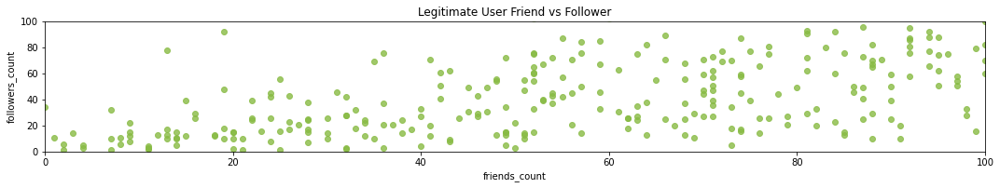

In [41]:
plt.figure(figsize=(15,5))
plt.subplot(2,1,1)
plt.title('Legitimate User Friend vs Follower')
sns.regplot(legit_users.friends_count,legit_users.followers_count, color='#88BB44', label='Bots')
plt.xlim(0, 100)
plt.ylim(0, 100)
plt.tight_layout()

# BOT USER GROUP1

C:\ProgramData\Anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


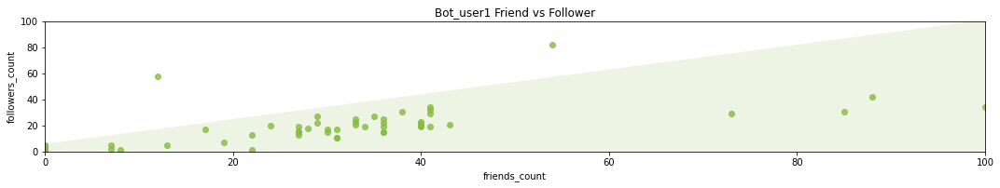

In [42]:
plt.figure(figsize=(15,5))
plt.subplot(2,1,1)
plt.title('Bot_user1 Friend vs Follower')
sns.regplot(bot_user1.friends_count,bot_user1.followers_count, color='#88BB44', label='Bots')
plt.xlim(0, 100)
plt.ylim(0, 100)
plt.tight_layout()

# BOT USER GROUP2

C:\ProgramData\Anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


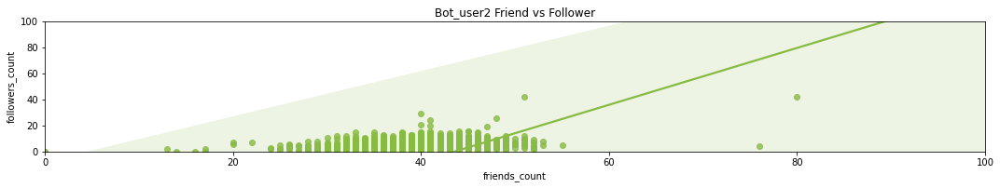

In [43]:
plt.figure(figsize=(15,5))
plt.subplot(2,1,1)
plt.title('Bot_user2 Friend vs Follower')
sns.regplot(bot_user2.friends_count,bot_user2.followers_count, color='#88BB44', label='Bots')
plt.xlim(0, 100)
plt.ylim(0, 100)
plt.tight_layout()

# BOT USER GROUP3

C:\ProgramData\Anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


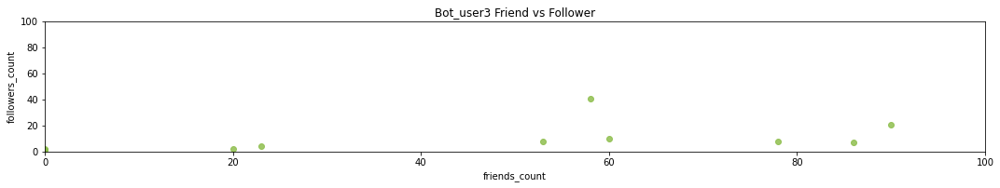

In [44]:
plt.figure(figsize=(15,5))
plt.subplot(2,1,1)
plt.title('Bot_user3 Friend vs Follower')
sns.regplot(bot_user3.friends_count,bot_user3.followers_count, color='#88BB44', label='Bots')
plt.xlim(0, 100)
plt.ylim(0, 100)
plt.tight_layout()  

# PLOTTING LCS CURVE OF EACH GROUP

# LEGIT

In [46]:
col_list = ["num_of_strings", "lcs_length"]
df = pd.read_csv('C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/legit_b3_type_lcs', usecols = col_list)
print(df.head())

   num_of_strings  lcs_length
0               2          17
1               3          16
2               4          16
3               5          16
4               6          16


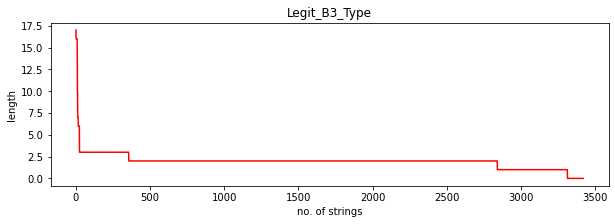

In [47]:
plt.figure(figsize=(10, 3))
x=df['num_of_strings']
y=df['lcs_length']
plt.plot(x, y, label='Bar',color='red')
plt.xlabel('no. of strings')
plt.ylabel('length')
plt.title("Legit_B3_Type")   
plt.show()

In [48]:
col_list = ["num_of_strings", "lcs_length"]
df = pd.read_csv('C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/legit_b3_content_lcs', usecols = col_list)
print(df.head())

   num_of_strings  lcs_length
0               2           4
1               3           2
2               4           2
3               5           1
4               6           1


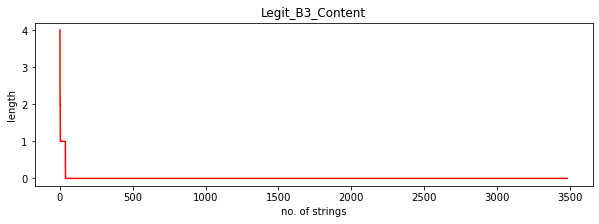

In [49]:
plt.figure(figsize=(10, 3))
x=df['num_of_strings']
y=df['lcs_length']
plt.plot(x, y, label='Bar',color='red')
plt.xlabel('no. of strings')
plt.ylabel('length')
plt.title("Legit_B3_Content")   
plt.show()

In [50]:
col_list = ["num_of_strings", "lcs_length"]
df = pd.read_csv('C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/legit_b6_content_lcs', usecols = col_list)
print(df.head())

   num_of_strings  lcs_length
0               2           4
1               3           2
2               4           2
3               5           1
4               6           1


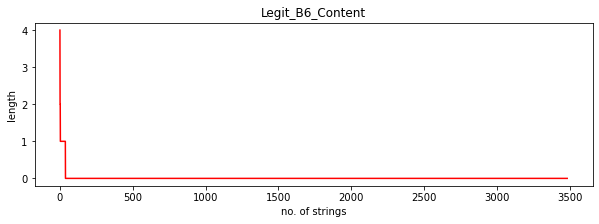

In [51]:
plt.figure(figsize=(10, 3))
x=df['num_of_strings']
y=df['lcs_length']
plt.plot(x, y, label='Bar',color='red')
plt.xlabel('no. of strings')
plt.ylabel('length')
plt.title("Legit_B6_Content")   
plt.show()

# BOT1

In [52]:
col_list = ["num_of_strings", "lcs_length"]
df = pd.read_csv('C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot1_b3_type_lcs', usecols = col_list)
print(df.head())

   num_of_strings  lcs_length
0               2         477
1               3         477
2               4         477
3               5         477
4               6         477


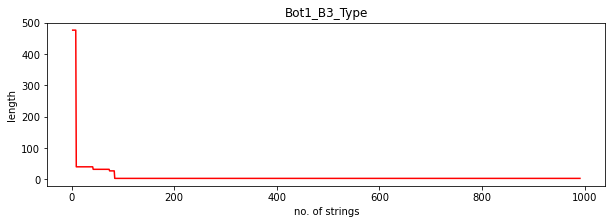

In [53]:
plt.figure(figsize=(10, 3))
x=df['num_of_strings']
y=df['lcs_length']
plt.plot(x, y, label='Bar',color='red')
plt.xlabel('no. of strings')
plt.ylabel('length')
plt.title("Bot1_B3_Type")   
plt.show()

In [54]:
col_list = ["num_of_strings", "lcs_length"]
df = pd.read_csv('C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot1_b3_content_lcs', usecols = col_list)
print(df.head())

   num_of_strings  lcs_length
0               2          94
1               3          76
2               4           2
3               5           2
4               6           2


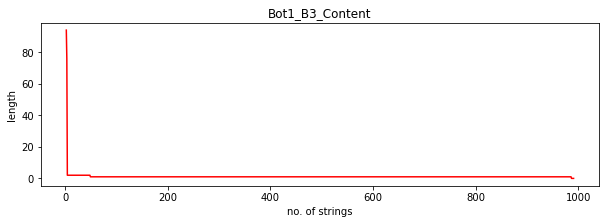

In [55]:
plt.figure(figsize=(10, 3))
x=df['num_of_strings']
y=df['lcs_length']
plt.plot(x, y, label='Bar',color='red')
plt.xlabel('no. of strings')
plt.ylabel('length')
plt.title("Bot1_B3_Content")   
plt.show()

In [56]:
col_list = ["num_of_strings", "lcs_length"]
df = pd.read_csv('C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot1_b6_content_lcs', usecols = col_list)
print(df.head())

   num_of_strings  lcs_length
0               2          94
1               3          73
2               4           1
3               5           1
4               6           1


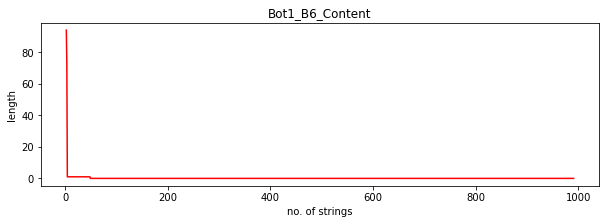

In [57]:
plt.figure(figsize=(10, 3))
x=df['num_of_strings']
y=df['lcs_length']
plt.plot(x, y, label='Bar',color='red')
plt.xlabel('no. of strings')
plt.ylabel('length')
plt.title("Bot1_B6_Content")   
plt.show()

# BOT2

In [58]:
col_list = ["num_of_strings", "lcs_length"]
df = pd.read_csv('C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot2_b3_type_lcs', usecols = col_list)
print(df.head())

   num_of_strings  lcs_length
0               2         135
1               3          36
2               4          16
3               5          14
4               6          14


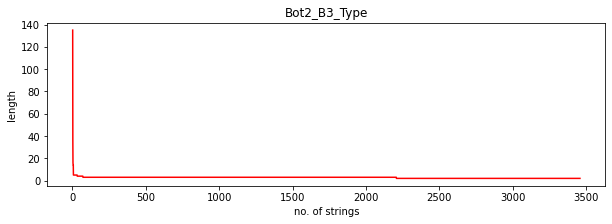

In [59]:
plt.figure(figsize=(10, 3))
x=df['num_of_strings']
y=df['lcs_length']
plt.plot(x, y, label='Bar',color='red')
plt.xlabel('no. of strings')
plt.ylabel('length')
plt.title("Bot2_B3_Type")   
plt.show()

In [60]:
col_list = ["num_of_strings", "lcs_length"]
df = pd.read_csv('C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot2_b3_content_lcs', usecols = col_list)
print(df.head())

   num_of_strings  lcs_length
0               2          23
1               3          14
2               4          14
3               5          14
4               6           2


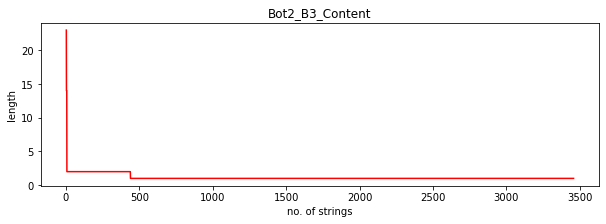

In [61]:
plt.figure(figsize=(10, 3))
x=df['num_of_strings']
y=df['lcs_length']
plt.plot(x, y, label='Bar',color='red')
plt.xlabel('no. of strings')
plt.ylabel('length')
plt.title("Bot2_B3_Content")   
plt.show()

In [63]:
col_list = ["num_of_strings", "lcs_length"]
df = pd.read_csv('C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot2_b6_content_lcs', usecols = col_list)
print(df.head())

   num_of_strings  lcs_length
0               2          22
1               3           1
2               4           1
3               5           1
4               6           1


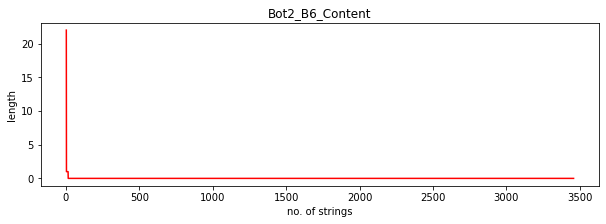

In [64]:
plt.figure(figsize=(10, 3))
x=df['num_of_strings']
y=df['lcs_length']
plt.plot(x, y, label='Bar',color='red')
plt.xlabel('no. of strings')
plt.ylabel('length')
plt.title("Bot2_B6_Content")   
plt.show()

# BOT3

In [65]:
col_list = ["num_of_strings", "lcs_length"]
df = pd.read_csv('C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot3_b3_type_lcs', usecols = col_list)
print(df.head())

   num_of_strings  lcs_length
0               2        3250
1               3        3250
2               4        3250
3               5        3250
4               6        3250


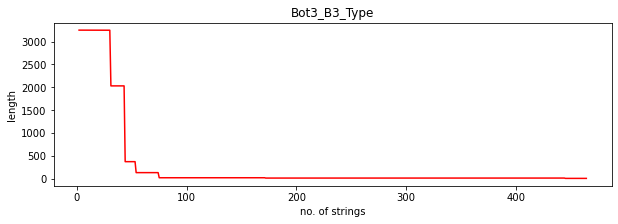

In [66]:
plt.figure(figsize=(10, 3))
x=df['num_of_strings']
y=df['lcs_length']
plt.plot(x, y, label='Bar',color='red')
plt.xlabel('no. of strings')
plt.ylabel('length')
plt.title("Bot3_B3_Type")   
plt.show()

In [67]:
col_list = ["num_of_strings", "lcs_length"]
df = pd.read_csv('C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot3_b3_content_lcs', usecols = col_list)
print(df.head())

   num_of_strings  lcs_length
0               2          21
1               3          17
2               4          16
3               5          12
4               6          11


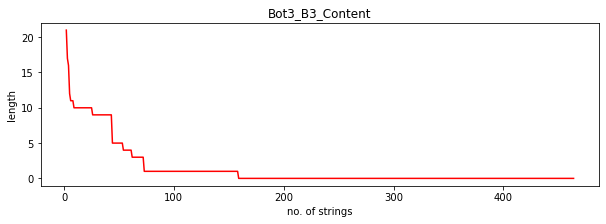

In [68]:
plt.figure(figsize=(10, 3))
x=df['num_of_strings']
y=df['lcs_length']
plt.plot(x, y, label='Bar',color='red')
plt.xlabel('no. of strings')
plt.ylabel('length')
plt.title("Bot3_B3_Content")   
plt.show()

In [69]:
col_list = ["num_of_strings", "lcs_length"]
df = pd.read_csv('C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot3_b6_content_lcs', usecols = col_list)
print(df.head())

   num_of_strings  lcs_length
0               2          21
1               3          17
2               4          16
3               5          12
4               6          11


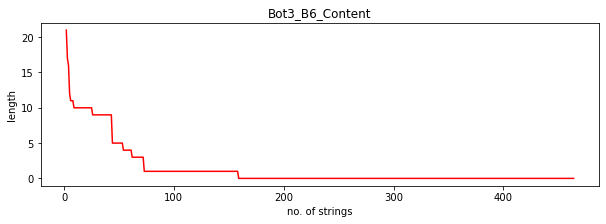

In [70]:
plt.figure(figsize=(10, 3))
x=df['num_of_strings']
y=df['lcs_length']
plt.plot(x, y, label='Bar',color='red')
plt.xlabel('no. of strings')
plt.ylabel('length')
plt.title("Bot3_B6_Content")   
plt.show()

# AREA UNDER CURVE CALCULATION

In [71]:
def calculate_auc(x_range, a, b, c):
    t1 = x_range[0]
    t2 = x_range[len(x_range)-1]
    print("t1 = ",t1)
    print("t2 = ",t2)
    auc = (a/(1-b)) * (pow(t2, 1-b) - pow(t1, 1-b)) + c * (t2 - t1)
    return auc

# LEGITIMATE USERS

In [72]:
#user_b3_lcs
col_list = ['num_of_strings']
source_file_path = "C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/legit_b3_type_lcs"
df = pd.read_csv(source_file_path, usecols = col_list)
x_range = df['num_of_strings']

a = 30.58216252
b = 0.58492169
c = 1.35090249

user_b3_lcs_auc = calculate_auc(x_range, a,b,c)


#user_content_b3_lcs
col_list = ['num_of_strings']
source_file_path = "C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/legit_b3_content_lcs"
df = pd.read_csv(source_file_path, usecols = col_list)
x_range = df['num_of_strings']

a = 6.66004816
b = 0.83897044
c = -0.01912371

user_content_b3_lcs_auc = calculate_auc(x_range, a,b,c)



#user_content_b6_lcs
col_list = ['num_of_strings']
source_file_path = "C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/legit_b6_content_lcs"
df = pd.read_csv(source_file_path, usecols = col_list)
x_range = df['num_of_strings']

a = 6.66004816
b = 0.83897044
c = -0.01912371

user_content_b6_lcs_auc = calculate_auc(x_range, a,b,c)

t1 =  2
t2 =  3418
t1 =  2
t2 =  3479
t1 =  2
t2 =  3479


# BOT_USER1

In [73]:
# bot1 b3 LCSs
col_list = ['num_of_strings']
source_file_path = "C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot1_b3_type_lcs"
df = pd.read_csv(source_file_path, usecols = col_list)
x_range = df['num_of_strings']

a = 1.26673412*1000
b = 9.10666138/10
c = -2.89101426

bot1_b3_lcs_auc = calculate_auc(x_range, a,b,c)

# bot1_content_b3_lcs
col_list = ['num_of_strings']
source_file_path = "C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot1_b3_content_lcs"
df = pd.read_csv(source_file_path, usecols = col_list)
x_range = df['num_of_strings']

a = 477.33106927
b = 2.25318785
c = 0.98916567

bot1_content_b3_lcs_auc = calculate_auc(x_range, a,b,c)

#bot1_content_b6_lcs
col_list = ['num_of_strings']
source_file_path = "C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot1_b6_content_lcs"
df = pd.read_csv(source_file_path, usecols = col_list)
x_range = df['num_of_strings']

a = 2.36681544*100
b = 9.11458069*10
c = 2.14141497/10

bot1_content_b6_lcs_auc = calculate_auc(x_range, a,b,c)

t1 =  2
t2 =  991
t1 =  2
t2 =  991
t1 =  2
t2 =  991


# BOT_USER2

In [74]:
#bot2_b3_lcs
col_list = ['num_of_strings']
source_file_path = "C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot2_b3_type_lcs"
df = pd.read_csv(source_file_path, usecols = col_list)
x_range = df['num_of_strings']

a = 252.35969492
b = 80.3845435
c = 2.72222221

bot2_b3_lcs_auc = calculate_auc(x_range, a,b,c)


#bot2_content_b3_lcs
col_list = ['num_of_strings']
source_file_path = "C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot2_b3_content_lcs"
df = pd.read_csv(source_file_path, usecols = col_list)
x_range = df['num_of_strings']

a = 40.25927765
b = 1.02371112
c = 1.06153093

bot2_content_b3_lcs_auc = calculate_auc(x_range, a,b,c)


#bot2_content_b6_lcs
col_list = ['num_of_strings']
source_file_path = "C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot2_b6_content_lcs"
df = pd.read_csv(source_file_path, usecols = col_list)
x_range = df['num_of_strings']

a = 2.83572771*1000
b = 7.01078904
c = 3.04038695/1000

bot2_content_b6_lcs_auc = calculate_auc(x_range, a,b,c)

t1 =  2
t2 =  3457
t1 =  2
t2 =  3457
t1 =  2
t2 =  3457


# BOT_USER3

In [75]:
#bot3_b3_lcs
col_list = ['num_of_strings']
source_file_path = "C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot3_b3_type_lcs"
df = pd.read_csv(source_file_path, usecols = col_list)
x_range = df['num_of_strings']

a = 8.68028893*1000
b = 3.35658518/10
c = -1.34485178*1000

bot3_b3_lcs_auc = calculate_auc(x_range, a,b,c)


#bot3_content_b3_lcs
col_list = ['num_of_strings']
source_file_path = "C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot3_b3_content_lcs"
df = pd.read_csv(source_file_path, usecols = col_list)
x_range = df['num_of_strings']

a = 34.90371667
b = 0.31338239
c = -5.93285711

bot3_content_b3_lcs_auc = calculate_auc(x_range, a,b,c)


#bot3_content_b6_lcs
col_list = ['num_of_strings']
source_file_path = "C:/Users/HP/Desktop/2nd Sem Mtech NITK/web and social/WSC_PROJECT_SEM2/bot3_b6_content_lcs"
df = pd.read_csv(source_file_path, usecols = col_list)
x_range = df['num_of_strings']

a = 34.90371667
b = 0.31338239
c = -5.93285711

bot3_content_b6_lcs_auc = calculate_auc(x_range, a,b,c)

t1 =  2
t2 =  464
t1 =  2
t2 =  464
t1 =  2
t2 =  464


# AVERAGE AREA UNDER CURVE(AUC)

Higher value of AUC describes there is very high similarity between the users.

In [76]:
print('Type B3 Bot1',bot1_b3_lcs_auc)
print('Type B3 Bot2',bot2_b3_lcs_auc)
print('Type B3 Bot3',bot3_b3_lcs_auc)
print('Type B3 User',user_b3_lcs_auc)

print('Content B3 Bot1',bot1_content_b3_lcs_auc)
print('Content B3 Bot2',bot2_content_b3_lcs_auc)
print('Content B3 Bot3',bot3_content_b3_lcs_auc)
print('Content B3 User',user_content_b3_lcs_auc)

print('Content B6 Bot1',bot1_content_b6_lcs_auc)
print('Content B6 Bot2',bot2_content_b6_lcs_auc)
print('Content B6 Bot3',bot3_content_b6_lcs_auc)
print('Content B6 User',user_content_b6_lcs_auc)

avg_bot1_auc = (bot1_b3_lcs_auc + bot1_content_b3_lcs_auc + bot1_content_b6_lcs_auc)/3
avg_bot2_auc = (bot2_b3_lcs_auc + bot2_content_b3_lcs_auc + bot2_content_b6_lcs_auc)/3
avg_bot3_auc = (bot3_b3_lcs_auc + bot3_content_b3_lcs_auc + bot3_content_b6_lcs_auc)/3
avg_user_auc = (user_b3_lcs_auc + user_content_b3_lcs_auc + user_content_b6_lcs_auc)/3

print('Avg Bot1',avg_bot1_auc)
print('Avg Bot2',avg_bot2_auc)
print('Avg Bot3',avg_bot3_auc)
print('User',avg_user_auc)

Type B3 Bot1 8316.76358488591
Type B3 Bot2 9405.27773555
Type B3 Bot3 129978.02972955676
Type B3 User 6674.834538264662
Content B3 Bot1 1138.010335588981
Content B3 Bot2 3938.207749136785
Content B3 Bot3 620.9782983987793
Content B3 User 41.0263719810484
Content B6 Bot1 211.785940533
Content B6 Bot2 17.82106834183358
Content B6 Bot3 620.9782983987793
Content B6 User 41.0263719810484
Avg Bot1 3222.1866203359637
Avg Bot2 4453.7688510095395
Avg Bot3 43739.99544211811
User 2252.2957607422527


# FRIENDS FREQUENCY OF EACH GROUP

# LEGITIMATE USERS

Text(0.5, 1.0, 'Legitimate Friend Frequency')

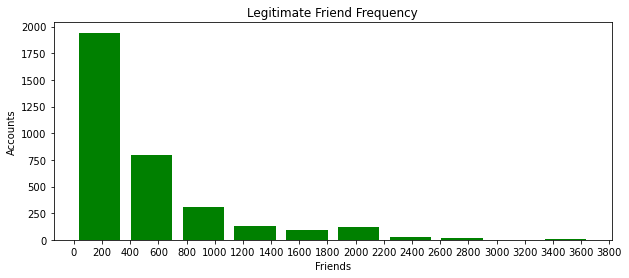

In [79]:
df = pd.read_csv("users_legit.csv", usecols=['id','friends_count'])
max_len = len(df)
range_max = max_len+200
range = (0, range_max)
bins = 10
plt.figure(figsize=[10,4])
plt.hist(df['friends_count'], bins, range, color = 'green', histtype = 'bar', rwidth = 0.8)
plt.xlabel('Friends')
plt.xticks(np.arange(0, 4000, step=200))
plt.ylabel('Accounts')
plt.title("Legitimate Friend Frequency")

# BOT_USER1

Text(0.5, 1.0, 'Bot User Group 1 Friends Frequency')

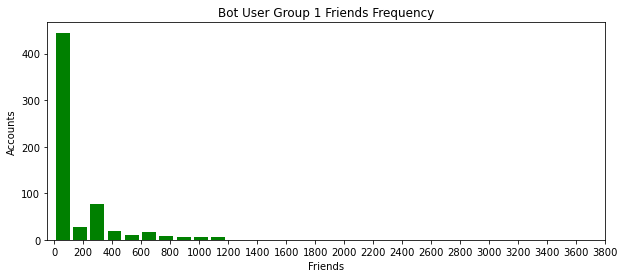

In [80]:
df = pd.read_csv("users_bot1.csv", usecols=['id','friends_count'])
max_len = len(df)
range_max = max_len+200
range = (0, range_max)
bins = 10
plt.figure(figsize=[10,4])
plt.hist(df['friends_count'], bins, range, color = 'green', histtype = 'bar', rwidth = 0.8)
plt.xlabel('Friends')
plt.xticks(np.arange(0, 4000, step=200))
plt.ylabel('Accounts')
plt.title("Bot User Group 1 Friends Frequency")

# BOT_USER2

Text(0.5, 1.0, 'Bot User Group 2 Friends Frequency')

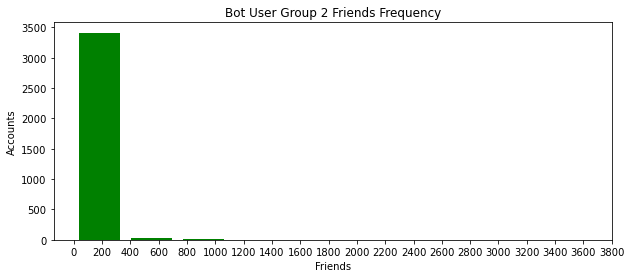

In [82]:
df = pd.read_csv("users_bot2.csv", usecols=['id','friends_count'])
max_len = len(df)
range_max = max_len+200
range = (0, range_max)
bins = 10
plt.figure(figsize=[10,4])
plt.hist(df['friends_count'], bins, range, color = 'green', histtype = 'bar', rwidth = 0.8)
plt.xlabel('Friends')
plt.xticks(np.arange(0, 4000, step=200))
plt.ylabel('Accounts')
plt.title("Bot User Group 2 Friends Frequency")

# BOT_USER3

Text(0.5, 1.0, 'Bot User Group 3 Friends Frequency')

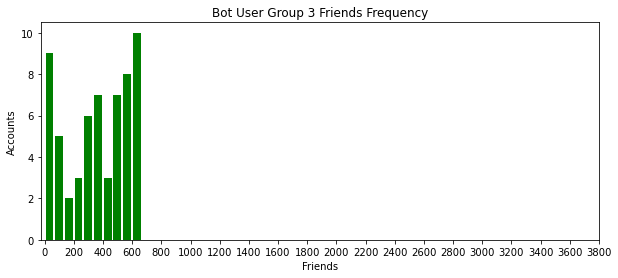

In [86]:
df = pd.read_csv("users_bot3.csv", usecols=['id','friends_count'])
max_len = len(df)
range_max = max_len+200
range = (0, range_max)
bins = 10
plt.figure(figsize=[10,4])
plt.hist(df['friends_count'], bins, range, color = 'green', histtype = 'bar', rwidth = 0.8)
plt.xlabel('Friends')
plt.xticks(np.arange(0, 4000, step=200))
plt.ylabel('Accounts')
plt.title("Bot User Group 3 Friends Frequency")

# FOLLOWER FREQUENCY OF EACH GROUP

# LEGITIMATE USER

Text(0.5, 1.0, 'Legitimate Follower Frequency')

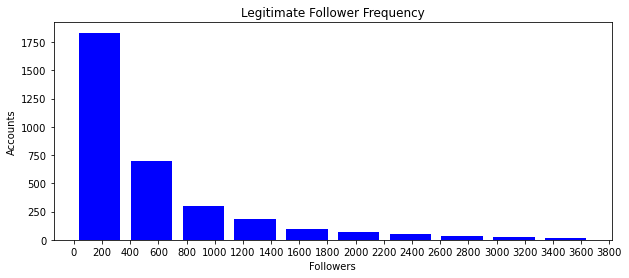

In [88]:
df = pd.read_csv("users_legit.csv", usecols=['id','followers_count'])
max_len = len(df)
range_max = max_len+200
range = (0, range_max)
bins = 10
plt.figure(figsize=[10,4])
plt.hist(df['followers_count'], bins, range, color = 'blue', histtype = 'bar', rwidth = 0.8)
plt.xlabel('Followers')
plt.xticks(np.arange(0, 4000, step=200))
plt.ylabel('Accounts')
plt.title("Legitimate Follower Frequency")

# BOT_USER1

Text(0.5, 1.0, 'Bot User Group 1 Follower Frequency')

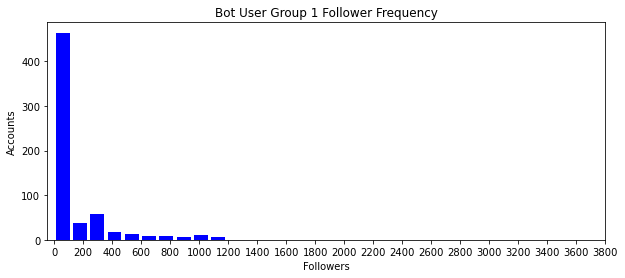

In [89]:
df = pd.read_csv("users_bot1.csv", usecols=['id','followers_count'])
max_len = len(df)
range_max = max_len+200
range = (0, range_max)
bins = 10
plt.figure(figsize=[10,4])
plt.hist(df['followers_count'], bins, range, color = 'blue', histtype = 'bar', rwidth = 0.8)
plt.xlabel('Followers')
plt.xticks(np.arange(0, 4000, step=200))
plt.ylabel('Accounts')
plt.title("Bot User Group 1 Follower Frequency")

# BOT_USER2

Text(0.5, 1.0, 'Bot User Group 2 Follower Frequency')

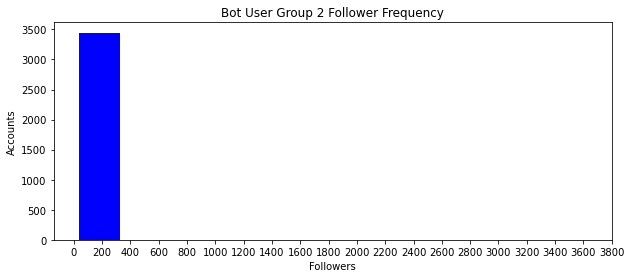

In [90]:
df = pd.read_csv("users_bot2.csv", usecols=['id','followers_count'])
max_len = len(df)
range_max = max_len+200
range = (0, range_max)
bins = 10
plt.figure(figsize=[10,4])
plt.hist(df['followers_count'], bins, range, color = 'blue', histtype = 'bar', rwidth = 0.8)
plt.xlabel('Followers')
plt.xticks(np.arange(0, 4000, step=200))
plt.ylabel('Accounts')
plt.title("Bot User Group 2 Follower Frequency")

# BOT_USER3

Text(0.5, 1.0, 'Bot User Group 3 Follower Frequency')

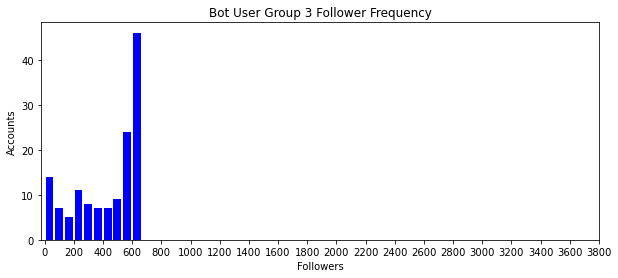

In [91]:
df = pd.read_csv("users_bot3.csv", usecols=['id','followers_count'])
max_len = len(df)
range_max = max_len+200
range = (0, range_max)
bins = 10
plt.figure(figsize=[10,4])
plt.hist(df['followers_count'], bins, range, color = 'blue', histtype = 'bar', rwidth = 0.8)
plt.xlabel('Followers')
plt.xticks(np.arange(0, 4000, step=200))
plt.ylabel('Accounts')
plt.title("Bot User Group 3 Follower Frequency")

# BOT DETECTION USING MACHINE LEARNING AND DEEP LEARNING TECHNIQUES

# DEEP LEARNING

In [93]:
import pandas as pd
import numpy as np
import math
from keras import backend as K
from keras.layers import Embedding, Dense, LSTM, Dense, Input, concatenate
from keras.models import Model
#from keras.utils import plot_model
from keras.utils.vis_utils import plot_model
from keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import cross_validate

# READ AND PREPROCESS DATASET

In [94]:
bot_accounts = pd.concat([pd.read_csv('users_bot1.csv'), pd.read_csv('users_bot2.csv'), pd.read_csv('users_bot3.csv')]).reset_index(drop=True)
clean_accounts = pd.read_csv('users_legit.csv')
from dateutil.parser import parse
requiredColumns = ['screen_name', 'created_at', 'updated', 'location', 'verified', 'statuses_count', 'friends_count','followers_count', 'favourites_count', 'default_profile_image', 'profile_use_background_image', 'protected', 'default_profile']
bot_accounts = bot_accounts[requiredColumns]
clean_accounts = clean_accounts[requiredColumns]
def clean_df(df):
    df['created_at'] = pd.to_datetime(df['created_at'])
    df['updated'] = pd.to_datetime(df['updated'])
    df['age'] = (df['updated'].apply(pd.to_datetime) - df['created_at'].apply(pd.to_datetime).astype('datetime64[ns]')).astype('timedelta64[D]').astype(int)
    df['has_location'] = df['location'].apply(lambda x: 0 if x==x else 1)
    df['has_avatar'] = df['default_profile_image'].apply(lambda x: 1 if x==x else 0)
    df['has_background'] = df['profile_use_background_image'].apply(lambda x: 1 if x==x else 0)
    df['is_verified']=df['verified'].apply(lambda x: 1 if x==x else 0)
    df['is_protected']=df['protected'].apply(lambda x: 1 if x==x else 0)
    df['profile_modified'] = df['default_profile'].apply(lambda x: 0 if x==x else 1)
    df = df.rename(index=str, columns={"screen_name": "username", "statuses_count": "total_tweets", "friends_count": "total_following", "followers_count": "total_followers", "favourites_count": "total_likes"})
    return df[['username', 'age', 'has_location', 'is_verified', 'total_tweets', 'total_following', 'total_followers', 'total_likes', 'has_avatar', 'has_background', 'is_protected', 'profile_modified']]

bot_accounts = clean_df(bot_accounts)
clean_accounts = clean_df(clean_accounts)

C:\Users\HP\AppData\Local\Temp\ipykernel_7984\3978864655.py:10: FutureWarning: Using .astype to convert from timezone-aware dtype to timezone-naive dtype is deprecated and will raise in a future version.  Use obj.tz_localize(None) or obj.tz_convert('UTC').tz_localize(None) instead
  df['age'] = (df['updated'].apply(pd.to_datetime) - df['created_at'].apply(pd.to_datetime).astype('datetime64[ns]')).astype('timedelta64[D]').astype(int)
C:\Users\HP\AppData\Local\Temp\ipykernel_7984\3978864655.py:10: FutureWarning: Using .astype to convert from timezone-aware dtype to timezone-naive dtype is deprecated and will raise in a future version.  Use obj.tz_localize(None) or obj.tz_convert('UTC').tz_localize(None) instead
  df['age'] = (df['updated'].apply(pd.to_datetime) - df['created_at'].apply(pd.to_datetime).astype('datetime64[ns]')).astype('timedelta64[D]').astype(int)


In [95]:
print(bot_accounts)

             username   age  has_location  is_verified  total_tweets  \
0           davideb66  2555             1            0          1299   
1        ElisaDospina  2521             0            0         18665   
2          Vladimir65  2497             0            0         22987   
3      RafielaMorales  2435             0            0          7975   
4         FabrizioC_c  2413             0            0         20218   
...               ...   ...           ...          ...           ...   
4907   AldridgeBizOpp   728             0            0           106   
4908    DLBusinessOpp   728             0            0           173   
4909  LFCareerOptions   709             0            0           137   
4910      RickChou_TD   709             0            0           170   
4911    CKSmallBizOpp   704             0            0            65   

      total_following  total_followers  total_likes  has_avatar  \
0                  40               22            1           1   
1

# SHUFFLEING THE DATASET

In [96]:
bot_accounts['BotOrNot'] = 1
clean_accounts['BotOrNot'] = 0

combined_df = pd.concat([bot_accounts, clean_accounts])

new_df = combined_df.sample(frac=1).reset_index(drop=True)

C:\Users\HP\AppData\Local\Temp\ipykernel_7984\2650708538.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  clean_accounts['BotOrNot'] = 0


In [97]:
print(new_df)

             username   age  has_location  is_verified  total_tweets  \
0      GrimmrHalfVibe  1465             1            0         10883   
1      NedaPassantino   734             1            0            36   
2           ashkaul33  2455             0            0          1503   
3       JazminLungren   807             1            0            66   
4         yanni_stark   990             0            0         30048   
...               ...   ...           ...          ...           ...   
8381        EngSamir7   935             1            0         48449   
8382         JasslynZ  1042             1            0          5497   
8383   BerthaBarreiro   749             1            0            62   
8384  Danielle_Renee7  1457             0            0          3094   
8385       GillzReyes  1738             0            0         17939   

      total_following  total_followers  total_likes  has_avatar  \
0                1877              654            1           0   
1

In [98]:
training_df = new_df.drop('username', axis=1)[:int(combined_df.shape[0] * 0.6)]
test_df = new_df.drop('username', axis=1)[int(combined_df.shape[0] * 0.6):]

columns_to_standardize = ['age', 'total_tweets', 'total_following', 'total_followers', 'total_likes']

training_df_mean = training_df[columns_to_standardize].mean()
training_df_std = training_df[columns_to_standardize].std()

training_df[columns_to_standardize] = (training_df[columns_to_standardize] - training_df_mean)/training_df_std
test_df[columns_to_standardize] = (test_df[columns_to_standardize] - training_df_mean)/training_df_std

In [99]:
X_train = training_df.drop(['BotOrNot', 'is_protected'], axis=1).values
y_train = training_df['BotOrNot'].values.reshape(-1,1)

X_test = test_df.drop(['BotOrNot', 'is_protected'], axis=1).values
y_test = test_df['BotOrNot'].values.reshape(-1,1)

# MULTILAYER PERCEPTRON MODEL

In [101]:
X = combined_df.drop(['BotOrNot', 'is_protected','username'], axis=1).values
Y = combined_df['BotOrNot'].values.reshape(-1,1)
model = MLPClassifier(random_state=1, max_iter=300)
scoring = ['accuracy','precision','recall','f1_weighted']
#results = cross_val_score(model, X, Y, cv=kfold, scoring=scoring)
results = cross_validate(model, X, Y.flatten(), scoring=scoring)
#print("Accuracy: %.3f (%.3f)") % (results.mean(), results.std())
print("Accuracy=",results["test_accuracy"].mean(),results["test_accuracy"].std())
print("F1_score=",results["test_f1_weighted"].mean(),results["test_f1_weighted"].std())
print("Precision=",results["test_precision"].mean(),results["test_precision"].std())
print("Recall=",results["test_recall"].mean(),results["test_recall"].std())

Accuracy= 0.8867212792012525 0.10186918100014955
F1_score= 0.8862982556213875 0.1022888073953763
Precision= 0.9358569488975332 0.038224901887074475
Recall= 0.8637978009045837 0.16982662960405193


# LSTM BASED DEEP NEURAL NETWORK

In [102]:
def recall_m(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    recall = true_positives / (possible_positives + K.epsilon())
    return recall

def precision_m(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
    precision = true_positives / (predicted_positives + K.epsilon())
    return precision

def f1_m(y_true, y_pred):
    precision = precision_m(y_true, y_pred)
    recall = recall_m(y_true, y_pred)
    return 2*((precision*recall)/(precision+recall+K.epsilon()))

In [103]:
inp = Input(shape=[10])

another = Dense(500, activation='relu')(inp)
another = Dense(300, activation='relu')(another)
another = Dense(200, activation='relu')(another)
another = Dense(1, activation='sigmoid')(another)

mod = Model(inp, another)
mod.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy',f1_m,precision_m, recall_m])

In [104]:
training = mod.fit(x=X_train, y=y_train, batch_size=64, epochs=100, validation_data=(X_test, y_test))

Epoch 1/100
79/79 [==============================] - 3s 9ms/step - loss: 0.2346 - accuracy: 0.9123 - f1_m: 0.9258 - precision_m: 0.9029 - recall_m: 0.9538 - val_loss: 0.1617 - val_accuracy: 0.9607 - val_f1_m: 0.9660 - val_precision_m: 0.9592 - val_recall_m: 0.9735
Epoch 2/100
79/79 [==============================] - 0s 5ms/step - loss: 0.1176 - accuracy: 0.9654 - f1_m: 0.9703 - precision_m: 0.9670 - recall_m: 0.9745 - val_loss: 0.1246 - val_accuracy: 0.9741 - val_f1_m: 0.9776 - val_precision_m: 0.9906 - val_recall_m: 0.9655
Epoch 3/100
79/79 [==============================] - 0s 5ms/step - loss: 0.1077 - accuracy: 0.9678 - f1_m: 0.9722 - precision_m: 0.9724 - recall_m: 0.9729 - val_loss: 0.1099 - val_accuracy: 0.9723 - val_f1_m: 0.9759 - val_precision_m: 0.9814 - val_recall_m: 0.9711
Epoch 4/100
79/79 [==============================] - 0s 5ms/step - loss: 0.0931 - accuracy: 0.9710 - f1_m: 0.9753 - precision_m: 0.9782 - recall_m: 0.9732 - val_loss: 0.0950 - val_accuracy: 0.9729 - val_f1

Epoch 32/100
79/79 [==============================] - 0s 5ms/step - loss: 0.0490 - accuracy: 0.9839 - f1_m: 0.9858 - precision_m: 0.9916 - recall_m: 0.9805 - val_loss: 0.1341 - val_accuracy: 0.9765 - val_f1_m: 0.9798 - val_precision_m: 0.9860 - val_recall_m: 0.9740
Epoch 33/100
79/79 [==============================] - 0s 5ms/step - loss: 0.0575 - accuracy: 0.9817 - f1_m: 0.9846 - precision_m: 0.9905 - recall_m: 0.9793 - val_loss: 0.1308 - val_accuracy: 0.9776 - val_f1_m: 0.9808 - val_precision_m: 0.9949 - val_recall_m: 0.9675
Epoch 34/100
79/79 [==============================] - 0s 5ms/step - loss: 0.0532 - accuracy: 0.9829 - f1_m: 0.9851 - precision_m: 0.9903 - recall_m: 0.9804 - val_loss: 0.1323 - val_accuracy: 0.9803 - val_f1_m: 0.9831 - val_precision_m: 0.9942 - val_recall_m: 0.9725
Epoch 35/100
79/79 [==============================] - 0s 4ms/step - loss: 0.0527 - accuracy: 0.9833 - f1_m: 0.9856 - precision_m: 0.9917 - recall_m: 0.9800 - val_loss: 0.1392 - val_accuracy: 0.9729 - va

Epoch 63/100
79/79 [==============================] - 0s 5ms/step - loss: 0.0330 - accuracy: 0.9873 - f1_m: 0.9890 - precision_m: 0.9949 - recall_m: 0.9835 - val_loss: 0.2740 - val_accuracy: 0.9806 - val_f1_m: 0.9835 - val_precision_m: 0.9877 - val_recall_m: 0.9796
Epoch 64/100
79/79 [==============================] - 0s 5ms/step - loss: 0.0321 - accuracy: 0.9881 - f1_m: 0.9896 - precision_m: 0.9937 - recall_m: 0.9860 - val_loss: 0.2646 - val_accuracy: 0.9797 - val_f1_m: 0.9828 - val_precision_m: 0.9864 - val_recall_m: 0.9798
Epoch 65/100
79/79 [==============================] - 0s 5ms/step - loss: 0.0329 - accuracy: 0.9863 - f1_m: 0.9882 - precision_m: 0.9937 - recall_m: 0.9830 - val_loss: 0.3518 - val_accuracy: 0.9681 - val_f1_m: 0.9718 - val_precision_m: 0.9963 - val_recall_m: 0.9491
Epoch 66/100
79/79 [==============================] - 0s 5ms/step - loss: 0.0385 - accuracy: 0.9841 - f1_m: 0.9863 - precision_m: 0.9914 - recall_m: 0.9818 - val_loss: 0.3324 - val_accuracy: 0.9806 - va

Epoch 94/100
79/79 [==============================] - 0s 5ms/step - loss: 0.0285 - accuracy: 0.9899 - f1_m: 0.9913 - precision_m: 0.9939 - recall_m: 0.9890 - val_loss: 0.6248 - val_accuracy: 0.9812 - val_f1_m: 0.9839 - val_precision_m: 0.9903 - val_recall_m: 0.9780
Epoch 95/100
79/79 [==============================] - 0s 5ms/step - loss: 0.0225 - accuracy: 0.9903 - f1_m: 0.9914 - precision_m: 0.9948 - recall_m: 0.9883 - val_loss: 0.6264 - val_accuracy: 0.9744 - val_f1_m: 0.9784 - val_precision_m: 0.9775 - val_recall_m: 0.9797
Epoch 96/100
79/79 [==============================] - 0s 5ms/step - loss: 0.0224 - accuracy: 0.9905 - f1_m: 0.9917 - precision_m: 0.9943 - recall_m: 0.9894 - val_loss: 0.6457 - val_accuracy: 0.9756 - val_f1_m: 0.9791 - val_precision_m: 0.9898 - val_recall_m: 0.9692
Epoch 97/100
79/79 [==============================] - 0s 5ms/step - loss: 0.0269 - accuracy: 0.9891 - f1_m: 0.9906 - precision_m: 0.9950 - recall_m: 0.9865 - val_loss: 0.6296 - val_accuracy: 0.9744 - va

# MACHINE LEARNING TECHNIQUES

In [107]:
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.tree import DecisionTreeClassifier

# DECISION TREE

In [108]:
dt = DecisionTreeClassifier(criterion='entropy', min_samples_leaf=1, min_samples_split=20)

dt = dt.fit(X_train, y_train)
y_pred_train = dt.predict(X_train)
y_pred_test = dt.predict(X_test)

print("Trainig Accuracy: %.5f" %accuracy_score(y_train, y_pred_train))
print("Test Accuracy: %.5f" %accuracy_score(y_test, y_pred_test))

Trainig Accuracy: 0.99046
Test Accuracy: 0.97914


# CONFUSION MATRIX

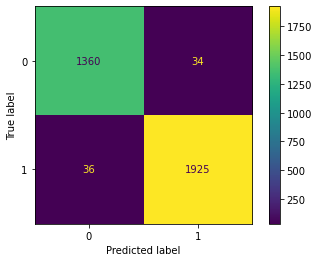

In [110]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
cm = confusion_matrix(y_test, y_pred_test)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=dt.classes_)
disp.plot()
plt.show()

# F1_SCORE

In [111]:
f1_score(y_test, y_pred_test, average='macro')

0.978526625704045

# RECALL SCORE

In [112]:
from sklearn.metrics import recall_score
recall_score(y_test, y_pred_test, average='macro')

0.9786258877377148

# RANDOM FOREST

In [118]:
from sklearn.ensemble import RandomForestClassifier

regressor = RandomForestClassifier(n_estimators=5, random_state=0)
regressor = regressor.fit(X_train, y_train)
y_pred_train = regressor.predict(X_train)
y_pred_test1 = regressor.predict(X_test)
print("Trainig Accuracy: %.5f" %accuracy_score(y_train, y_pred_train))
print("Test Accuracy: %.5f" %accuracy_score(y_test, y_pred_test1))

Trainig Accuracy: 0.99702
Test Accuracy: 0.98361


C:\Users\HP\AppData\Local\Temp\ipykernel_7984\1569029907.py:4: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  regressor = regressor.fit(X_train, y_train)


# CONFUSION MATRIX

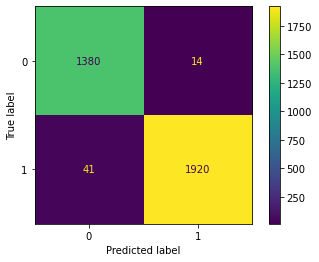

In [119]:
cm = confusion_matrix(y_test, y_pred_test1)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=regressor.classes_)
disp.plot()
plt.show()

# F1_SCORE

In [120]:
f1_score(y_test, y_pred_test1, average='macro')

0.9831705721002242

# RECALL SCORE

In [121]:
recall_score(y_test, y_pred_test1, average='macro')

0.9845246291200651